In [1]:
import torch.nn as nn
import numpy as np
import pandas as pd
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader
from torch.nn.utils import clip_grad_norm_
torch.autograd.set_detect_anomaly(True)
import websocket, json, pprint, talib, numpy
import websockets
from binance.client import Client
from binance.enums import *
import joblib
import robin_stocks as rs
import config
import asyncio
import nest_asyncio
import time
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC

### Import and reorganize the data

In [3]:
data = pd.read_csv('./data/data_1m.csv')
data = data.iloc[:43000]
print(len(data))
dataLast = data.iloc[-12900:]
dataLast = dataLast.drop(axis=1, columns=['labels'])
data = data.iloc[:30101]
#labels = data.loc[:, "labels"]
close = data.loc[:, "closes"]
close = close.iloc[1:]
data = data.iloc[:-1]
data = data.drop(["labels"], axis=1)
print(len(data), len(close))
print(len(dataLast))

43000
30100 30100
12900


In [4]:
data = data.to_numpy()
close = close.to_numpy()
#extra = np.shape(data)[0] % 32
#data = data[extra:, :]
data = torch.tensor(data)
data = data.to(torch.float)
#close = close[extra:]
close = torch.tensor(close)
close = close.to(torch.float)
data, X_test, close, y_test = train_test_split(data, close, test_size=0.5, shuffle = False)
print(len(data), len(X_test), len(close), len(y_test))
class Dataset():
    def __init__(self, array, labels):
        self.array = array
        self.labels = labels

    def __len__(self):
        return self.array.shape[0]

    def __getitem__(self, idx):
        return self.array[idx, :], self.labels[idx]


15050 15050 15050 15050


# Model Creation

## RNN

In [5]:
batch_size = 1 
fulldata = Dataset(data, close)
dataloader = DataLoader(fulldata, batch_size)
loss_function = nn.MSELoss()

testdata = Dataset(X_test, y_test)
testdataloader = DataLoader(testdata, batch_size)

pred_array_rnn = np.zeros(len(data))
pred_array_lstm = np.zeros(len(data))

In [6]:
class RNNModel(torch.nn.Module):
    def __init__(self, input_size, HL_size, num_layers = 1):
        super(RNNModel, self).__init__()
        self.rnn = torch.nn.RNN(input_size=input_size,
                                hidden_size=HL_size,
                                num_layers=num_layers)
        
        self.linear = torch.nn.Linear(HL_size , 12)
        self.linear2 = torch.nn.Linear(12, 1)
        self.num_layers = num_layers
        self.hidden_size = HL_size
        
    def forward(self, inputs, hidden):
        out, hidden = self.rnn(inputs, hidden)
        pred = F.relu(self.linear(out))
        pred = self.linear2(pred)

        #hidden = hidden.view(-1, 1, self.hidden_size)
        return pred, hidden
    
    def init_hidden(self, batch = 1):
        hidden = torch.randn(self.num_layers, batch, self.hidden_size)
        return hidden

def rnn_train():
    model = RNNModel(np.shape(data)[1], HL_size = 24, num_layers = 1)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.005)
    hidden = model.init_hidden(batch_size)
    total_loss = 0
    for batch_idx, (batch, truth) in enumerate(dataloader):
        
        hidden = hidden.detach()

        batch = np.reshape(batch, (1, -1, 11))
        pred, hidden = model.forward(batch, hidden)

        pred = torch.squeeze(pred, 0)
        pred = torch.squeeze(pred, 1)
        #print(pred)
        pred_array_rnn[batch_idx] = pred.item()
        single_loss = loss_function(pred, truth)
        single_loss.backward(retain_graph=True)
        clip_grad_norm_(model.parameters(), 5)
        optimizer.step()
        optimizer.zero_grad()
        total_loss = total_loss + single_loss.item()
        if batch_idx % 100 == 0:
            print(batch_idx)
            print(total_loss)
            #print(hidden)
            total_loss = 0
            
    '''
    for name, param in model.named_parameters():
                if param.requires_grad:
                    print(name, param.data)
    '''
    return model, hidden


In [ ]:
trained_model_rnn, final_hidden_rnn = rnn_train()

In [ ]:
data2 = pd.read_csv('./data/data_1m.csv')
data2 = data2.iloc[15050: 30100]
truth_array_rnn = data2.loc[:, "closes"].to_numpy()
close_numpy_rnn = close.numpy()
plt.plot(close_numpy_rnn)
plt.plot(pred_array_rnn)
plt.show()

In [ ]:
hidden_rnn = final_hidden_rnn
total_batches = 0
total_error = 0

optimizer_rnn = torch.optim.Adam(trained_model.parameters(), lr=0.01)

    
for batch_idx, (batch, truth) in enumerate(testdataloader):
    optimizer_rnn.zero_grad()
    hidden_rnn = hidden_rnn.detach()
    batch = np.reshape(batch, (1, -1, 11))
    pred, hidden_rnn = trained_model_rnn.forward(batch, hidden_rnn)
    pred = torch.squeeze(pred, 0)
    pred = torch.squeeze(pred, 1)
    single_loss = loss_function(pred, truth)
    single_loss.backward(retain_graph=True)
    clip_grad_norm_(trained_model_rnn.parameters(), 5)
    optimizer_rnn.step()
    total_batches += 1
    if (pred < truth_array_rnn[batch_idx] and truth > truth_array_rnn[batch_idx]) or \
        (pred > truth_array_rnn[batch_idx] and truth < truth_array_rnn[batch_idx]):
            total_error +=1
    if batch_idx % 100 == 0:
            print(batch_idx)
                                                                
        
print('######\n', total_error)
print(total_batches)

## LSTM

In [7]:
class LSTM(nn.Module):
    def __init__(self, hidden_size = 24, input_size=11, output_size=1, num_layers = 1):
        super().__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size = input_size, hidden_size = hidden_size, num_layers = num_layers)
        self.linear = nn.Linear(self.hidden_size, 12)
        self.linear2 = nn.Linear(12, output_size)
        
    def forward(self, input_seq, hidden):
        lstm_out, hidden = self.lstm(input_seq, hidden)
        predictions = F.relu(self.linear(lstm_out))
        predictions = self.linear2(predictions)
        return predictions, hidden
    
    def init_hidden(self, batch = 1):
        hidden = (torch.randn(self.num_layers, batch, self.hidden_size),
                 torch.randn(self.num_layers, batch, self.hidden_size))
        
        return hidden

def lstm_train():
    model = LSTM()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    hidden = model.init_hidden(batch_size)
    total_loss = 0
    for batch_idx, (batch, truth) in enumerate(dataloader):
        optimizer.zero_grad()
        hidden = tuple([h.detach() for h in hidden])
        batch = np.reshape(batch, (1, -1, 11))
        
        y_pred, hidden = model(batch, hidden)
        #truth = torch.squeeze(truth)

        y_pred = torch.squeeze(y_pred, 0)
        y_pred = torch.squeeze(y_pred, 1)
        #print(y_pred)
        pred_array_lstm[batch_idx] = y_pred.item()
        single_loss = loss_function(y_pred, truth)
        single_loss.backward()
        optimizer.step()
        total_loss += single_loss.item()
        if batch_idx % 100 == 0:
            #for name, param in model.named_parameters():
                #if param.requires_grad:
                    #print(name, param.data)
            print(total_loss)
            total_loss = 0


    return model, hidden

In [ ]:
trained_model_lstm, final_hidden_lstm = lstm_train()

In [ ]:
data2 = pd.read_csv('./data/data_1m.csv')
data2 = data2.iloc[15050: 30100]
truth_array_lstm = data2.loc[:, "closes"].to_numpy()
close_numpy_lstm = close.numpy()
plt.plot(pred_array_lstm)
plt.plot(close_numpy_lstm)
plt.show()

In [ ]:
hidden_lstm = final_hidden_lstm
total_batches = 0
total_error = 0

optimizer_lstm = torch.optim.Adam(trained_model.parameters(), lr=0.01)

for batch_idx, (batch, truth) in enumerate(testdataloader):
    optimizer_lstm.zero_grad()
    hidden_lstm = tuple([h.detach() for h in hidden_lstm])
    batch = np.reshape(batch, (1, -1, 11))
    pred, hidden_lstm = trained_model_lstm.forward(batch, hidden_lstm)
    pred = torch.squeeze(pred, 0)
    pred = torch.squeeze(pred, 1)
    single_loss = loss_function(pred, truth)
    single_loss.backward(retain_graph=True)
    clip_grad_norm_(trained_model_lstm.parameters(), 5)
    optimizer_lstm.step()
    total_batches += 1
    if (pred < truth_array_lstm[batch_idx] and truth > truth_array_lstm[batch_idx]) or \
        (pred > truth_array_lstm[batch_idx] and truth < truth_array_lstm[batch_idx]):
            total_error +=1
    if batch_idx % 100 == 0:
            print(batch_idx)
                                                                
        
print('######\n', total_error)
print(total_batches)

## CNN

In [38]:
data_len = 43000
num_days = 56
data_cnn = pd.read_csv('./data/data_1m.csv').iloc[:data_len].drop(["labels"], axis=1)
x = np.zeros((data_len - num_days, 11, num_days))
y = data_cnn.loc[:, "closes"].iloc[num_days:].to_numpy()


for i in range(data_len - num_days):
    #x[i,:] = data_cnn.iloc[i:i + num_days].to_numpy().flatten()
    x[i,:,:] = data_cnn.iloc[i:i + num_days].to_numpy().T

x = torch.tensor(x)
x = x.to(torch.float)
y = torch.tensor(y)
y = y.to(torch.float)
x, x_t, y, y_t = train_test_split(x, y, test_size=0.3, shuffle = False) 

In [39]:
batch_size_cnn = 50
cnn_train = Dataset(x, y)
cnn_train_dataloader = DataLoader(cnn_train, batch_size_cnn, shuffle = True)

cnn_test = Dataset(x_t, y_t)
cnn_test_dataloader = DataLoader(cnn_test, 5)

loss_function = nn.MSELoss()

In [40]:
class CNN(nn.Module):
    def __init__(self, num_days, input_channels=11):
        super().__init__()
        self.conv1 = nn.Conv1d(input_channels, out_channels = 22, kernel_size=3, stride=1, padding=1)
        self.pool = nn.MaxPool1d(2)
        self.conv2 = nn.Conv1d(in_channels = 22, out_channels = 44, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(616, 300)
        self.fc2 = nn.Linear(300, 150)
        self.fc3 = nn.Linear(150, 75)
        self.fc4 = nn.Linear(75, 1)
        
    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = self.pool(x)
        x = F.relu(self.conv2(x))
        x = self.pool(x)
        x = torch.flatten(x, 1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = self.fc4(x)
        return x


In [41]:
num_epochs = 4
loss_array = np.zeros((602 * num_epochs))

def cnn_train():
    model = CNN(num_days)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
    total_loss = 0
    for i in range(num_epochs):
        print(i)
        for batch_idx, (batch, truth) in enumerate(cnn_train_dataloader):

            pred = model.forward(batch)
            pred = torch.squeeze(pred, 1)
            loss = loss_function(pred, truth)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            loss_array[i * 602 + batch_idx] = loss.item()
            '''
            total_loss = total_loss + loss.item()
            if batch_idx % 100 == 0:
                print(batch_idx)
                print(total_loss)
                total_loss = 0
            '''
        
            
    return model
            

0
1
2
3


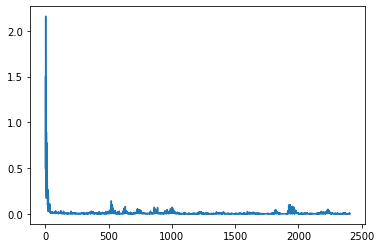

In [42]:
cnn_model = cnn_train()
plt.plot(loss_array)
plt.show()

## SVM

In [ ]:
data_new = pd.read_csv('./data/data_1m.csv').iloc[:30100]
labels = data_new.loc[:, "labels"]
labels_train = labels[:15050]
labels_test = labels[15050:]
data_new = data_new.drop(axis=1, columns=['labels'])
clf = make_pipeline(StandardScaler(), SVC(kernel = 'linear', C = 1000, gamma='auto'))
clf.fit(data_new[:15050], labels_train)
clf.score(data_new[15050:], labels_test)

## Export Models

In [ ]:
#SVM
joblib.dump(clf, './data/svc_1m')

In [ ]:
#LSTM
torch.save(trained_model_lstm.state_dict(), '1m_LSTM')
joblib.dump(hidden_lstm, './data/1m_LSTM_hidden')

In [ ]:
#RNN
torch.save(trained_model_rnn.state_dict(), '1m_RNN')
joblib.dump(hidden_rnn, './data/1m_RNN_hidden')

In [43]:
#CNN
joblib.dump(cnn_model, './data/1m_CNN')

['1m_CNN']

## Live Prediction

In [9]:
trained_rnn_model = RNNModel(np.shape(data)[1], HL_size = 24, num_layers = 1)
trained_rnn_model.load_state_dict(torch.load('./data/1m_RNN'))
trained_rnn_model.eval()
hidden_rnn = joblib.load('./data/1m_RNN_hidden')
optimizer_rnn = torch.optim.Adam(trained_rnn_model.parameters(), lr=0.01)

trained_lstm_model = LSTM()
trained_lstm_model.load_state_dict(torch.load('./data/1m_LSTM'))
trained_lstm_model.eval()

hidden_lstm = joblib.load('./data/1m_LSTM_hidden')

optimizer_lstm = torch.optim.Adam(trained_lstm_model.parameters(), lr=0.01)

trained_svc = joblib.load('./data/svc_1m')

In [11]:
SOCKET = "wss://stream.binance.com:9443/ws/ethusdt@kline_1m"
RSI_PERIOD = 14
in_position = False
client = Client(config.KEY, config.SECRET, tld='us')
scaler = joblib.load('./data/standard_scaler_1m.save')

The code below is used to trade live market data. It uses a Binance websocket to get 1-minute candle stick data. However, this will NOT be able to run unless you set up your own Binance key and secret, which I did not include in the submission. 

In [ ]:
nest_asyncio.apply()
currMilli = round(time.time() * 1000)
df_history = pd.DataFrame(data={"time": [], "opens": [], "highs": [], "lows": [], "closes": [], "volumes": [], "qavs": [], "numTrades": [], "tbbavs": [], "tbqavs": [], "rsis": [],"obvs": [], "money": [], "trueAfter": [], "predictionBefore": [], "action": [], "correct": [], "diff": []})


async def call_api():
    global currMilli, df_history
    
    currCandles = client.get_klines(symbol='ETHUSDT', 
                                    interval=Client.KLINE_INTERVAL_1MINUTE, 
                                    startTime = (currMilli - 900000), 
                                    endTime = (currMilli),
                                    limit = 14)
    opens = [float(c[1]) for c in currCandles]
    closes = [float(c[4]) for c in currCandles]
    volumes = [float(c[5]) for c in currCandles]
    highs = [float(c[2]) for c in currCandles]
    lows = [float(c[3]) for c in currCandles]
    qavs = [float(c[7]) for c in currCandles]
    numTrades = [float(c[8]) for c in currCandles]
    tbbavs = [float(c[9]) for c in currCandles]
    tbqavs = [float(c[10]) for c in currCandles]

    closes.reverse()
    volumes.reverse()

    rsis = []
    obvs = []
    scaled_df = None
    hidden_squeeze = torch.squeeze(hidden, 1)
    countBuy = 0
    countDontBuy = 0
    correctBuy = 0
    correctDontBuy = 0
    boughtPrev = False
    closePrev = float(0)
    money = float(0)
    action = ""
    
    async with websockets.connect(SOCKET) as websocket:
        
        while(1):
            response = await websocket.recv()

            json_message = json.loads(response)

            #print(json_message)
            candle = json_message['k']

            is_candle_closed = candle['x']
            close = float(candle['c'])
            open_ = float(candle['o'])
            high = float(candle['h'])
            low = float(candle['l'])
            vol = float(candle['v'])
            qav = float(candle['q'])
            numTrade = float(candle['n'])
            tbbav = float(candle['V'])
            tbqav = float(candle['Q'])
            time = candle['t']

            if is_candle_closed:
                print("\n######################\ncandle closed at {}".format(close))
                closes.insert(0, close)
                volumes.insert(0, vol)
                opens.append(float(open_))
                highs.append(float(high))
                lows.append(float(low))
                qavs.append(float(qav))
                numTrades.append(float(numTrade))
                tbbavs.append(float(tbbav))
                tbqavs.append(float(tbqav))

                if(countDontBuy + countBuy > 0):
                    df = pd.DataFrame(data={"opens": [opens[-1]], "highs": [highs[-1]], "lows": [lows[-1]], "closes": [closes[0]], "volumes": [volumes[0]], "qavs": [qavs[-1]], "numTrades": [numTrades[-1]], "tbbavs": [tbbavs[-1]], "tbqavs": [tbqavs[-1]], "rsis": [1],"obvs": [1]})
                    scaled_df = scaler.transform(df)
                    scaled_df = pd.DataFrame(scaled_df, columns = df.columns)
                    data = scaled_df.to_numpy()
                    truePred = data[0][3]
                    
                    print("\nBack Propogate... \n")

                    hidden_squeeze = hidden_squeeze.detach()
                    pred =  torch.squeeze(pred, 1)
                    pred =  torch.squeeze(pred, 0)
                    truePred = torch.tensor(truePred)
                    truePred = truePred.to(torch.float)

                    single_loss = loss_function(pred, truePred)
                    single_loss.backward()
                    clip_grad_norm_(trained_model.parameters(), 5)
                    optimizer.step()
                    optimizer.zero_grad()
                    
                    prediction = float(pred.item())
                    print("CORRECT?: ", float(truePred.item()), prediction, closePrev)

                    if(truePred > closePrev and prediction > closePrev):
                        correctBuy += 1
                        scaled_df['correct'] = [1]
                    elif(truePred < closePrev and prediction < closePrev):
                        correctDontBuy += 1
                        scaled_df['correct'] = [1]
                    else:
                        scaled_df['correct'] = [0]
                    print("COUNTBUY: ", countBuy , "CORRECTBUY: ", correctBuy, "COUNTDONTBUY: ", countDontBuy, "CORRECTDONTBUY: ", correctDontBuy)

                    scaled_df['action'] = [action]
                    scaled_df['diff'] = [float(truePred.item()) - float(pred.item())] 
                    scaled_df['time'] = [time]
                    scaled_df['money'] = [money]
                    scaled_df['trueAfter'] = [float(truePred.item())]
                    scaled_df['predictionBefore'] = [float(pred.item())]
                    df_history = df_history.append(scaled_df, ignore_index = True)
                    df_history.to_csv("./data/datahistroy_1m_2.csv", sep=',',index=False)
                    
                if(boughtPrev):
                    change = close - closes[1]
                    money += change
                    print('NEW PRICE: ', close, 'BOUGHT PRICE: ', closePrev, 'CHANGE: ', change, 'MONEY: ', money)
                    boughtPrev = False

                if len(closes) > RSI_PERIOD: 
                    np_closes = numpy.array(closes[:15])
                    np_vols = numpy.array(volumes[:15])
                    rsi = talib.RSI(np_closes, RSI_PERIOD)
                    obv = talib.OBV(np_closes, np_vols)
                    last_rsi = rsi[-1]
                    last_obv = obv[-1]

                    df = pd.DataFrame(data={"opens": [opens[-1]], "highs": [highs[-1]], "lows": [lows[-1]], "closes": [closes[0]], "volumes": [volumes[0]], "qavs": [qavs[-1]], "numTrades": [numTrades[-1]], "tbbavs": [tbbavs[-1]], "tbqavs": [tbqavs[-1]], "rsis": [last_rsi],"obvs": [last_obv]})
                    scaled_df = scaler.transform(df)
                    scaled_df = pd.DataFrame(scaled_df, columns = df.columns)

                    data = scaled_df.to_numpy()

                    curr_close = float(data[0][3])
                    print('Current Close Scaled: ', curr_close)

                    data = torch.tensor(data)
                    data = data.to(torch.float)
                    print(data, np.shape(data), np.shape(hidden_squeeze))

                    pred, hidden_squeeze = trained_model(data, hidden_squeeze)
                    print('PREDICTION', pred)
                    prediction = float(pred.item())
                    
                    if(prediction > curr_close):
                        countBuy += 1
                        action = "BUY"
                        print("BUY AT: ", closes[0], 'TIME: ', time)
                        boughtPrev = True
                    else:
                        action = "SELL"
                        countDontBuy += 1
                        print("DONT BUY")
                    closePrev = curr_close
                        
asyncio.get_event_loop().run_until_complete(call_api())


# Past Data Prediction

## SVM

In [ ]:
df_history_past = pd.DataFrame(data={"time": [], "opens": [], "highs": [], "lows": [], "closes": [], "volumes": [], "qavs": [], "numTrades": [], "tbbavs": [], "tbqavs": [], "rsis": [],"obvs": [], "money": [], "trueAfter": [], "predictionBefore": [], "action": [], "correct": [], "diff": []})
invertedData = scaler.inverse_transform(dataLast)


hidden_squeeze = torch.squeeze(hidden_rnn, 1)
countBuy = 0
countDontBuy = 0
correctBuy = 0
correctDontBuy = 0
boughtPrev = False
closePrev = float(0)
money = float(0)
action = ""


for i in range(len(dataLast)):
    curr_df = dataLast.iloc[i]
    currData = np.array(dataLast.iloc[i].to_numpy())
    curr_close = currData[3]
    
    if(countDontBuy + countBuy > 0):
        prevData = np.array(dataLast.iloc[i-1].to_numpy())
        prev_close = prevData[3]
        
        truePred = curr_close


        prediction = float(pred.item())
        #print("CORRECT?: ", float(truePred.item()), prediction, closePrev)

        if(truePred > closePrev and prediction > closePrev):
            correctBuy += 1
            curr_df['correct'] = [1]
        elif(truePred < closePrev and prediction < closePrev):
            correctDontBuy += 1
            curr_df['correct'] = [1]
        else:
            curr_df['correct'] = [0]
        print("COUNTBUY: ", countBuy , "CORRECTBUY: ", correctBuy, "COUNTDONTBUY: ", countDontBuy, "CORRECTDONTBUY: ", correctDontBuy)

        curr_df['action'] = action
        curr_df['diff'] = float(prediction - curr_close)
        curr_df['time'] = time
        curr_df['money'] = float(money)
        curr_df['trueAfter'] = float(curr_close)
        curr_df['predictionBefore'] = int(prediction)
        df_history_past = df_history_past.append(curr_df, ignore_index = True)

    if(boughtPrev):
        print(invertedData[i][3], invertedData[i][3])
        change = invertedData[i][3] - invertedData[i-1][3]
        money += change
        print('NEW PRICE: ', close, 'BOUGHT PRICE: ', closePrev, 'CHANGE: ', change, 'MONEY: ', money)
        boughtPrev = False
    
    
    
    prediction = int(clf.predict(np.expand_dims(currData, axis=0)))
    print("PREDICTION", prediction)
    
    #print('PREDICTION', pred)
    
    if(prediction == 1):
        countBuy += 1
        action = "BUY"
        print("BUY AT: ", curr_close, 'TIME: ', time)
        boughtPrev = True
    else:
        action = "DONT BUY"
        countDontBuy += 1
        print("DONT BUY")
    closePrev = curr_close

    
df_history_past.to_csv("./data/datahistory_1m_svc.csv", sep=',',index=False)


/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  1 CORRECTDONTBUY:  1
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  2 CORRECTDONTBUY:  1
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  3 CORRECTDONTBUY:  1
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  4 CORRECTDONTBUY:  2
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  5 CORRECTDONTBUY:  3
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  6 CORRECTDONTBUY:  3
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  7 CORRECTDONTBUY:  4
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  8 CORRECTDONTBUY:  4
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  9 CORRECTDONTBUY:  5
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  10 CORRECTDONTBUY:  5
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  11 CORRECTDONTBUY:  6
PREDICTION 0
DONT BUY
COUNTBUY:  0 CORRECTBUY:  0 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2776.5 2776.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6085168593473024 CHANGE:  -2.449999999999818 MONEY:  -7.519999999999982
PREDICTION 1
BUY AT:  0.5997492053874662 TIME:  <module 'time' (built-in)>
COUNTBUY:  4 CORRECTBUY:  0 COUNTDONTBUY:  19 CORRECTDONTBUY:  13
2777.99 2777.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5997492053874662 CHANGE:  1.4899999999997817 MONEY:  -6.0300000000002
PREDICTION 1
BUY AT:  0.6050813704487539 TIME:  <module 'time' (built-in)>
COUNTBUY:  5 CORRECTBUY:  0 COUNTDONTBUY:  19 CORRECTDONTBUY:  13
2779.86 2779.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6050813704487539 CHANGE:  1.8700000000003456 MONEY:  -4.1599999999998545
PREDICTION 1
BUY AT:  0.6117734165323857 TIME:  <module 'time' (built-in)>
COUNTBUY:  6 CORRECTBUY:  0 COUNTDONTBUY:  19 CORRECTDONTBUY:  13
2782.35 2782.35
NEW PRICE:  tensor([2.80

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  35 CORRECTDONTBUY:  18
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  36 CORRECTDONTBUY:  18
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  37 CORRECTDONTBUY:  19
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  38 CORRECTDONTBUY:  19
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  39 CORRECTDONTBUY:  20
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  40 CORRECTDONTBUY:  21
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  41 CORRECTDONTBUY:  21
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  42 CORRECTDONTBUY:  21
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  43 CORRECTDONTBUY:  22
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  44 CORRECTDONTBUY:  23
PREDICTION 0
DONT BUY
COUNTBUY:  10 CORRECTBUY:  0 COUNTDONTBUY:  45 CORRECTDONTBUY:  23
PREDICTION 0
DONT BUY

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 1
BUY AT:  0.7868759913302688 TIME:  <module 'time' (built-in)>
COUNTBUY:  15 CORRECTBUY:  0 COUNTDONTBUY:  54 CORRECTDONTBUY:  29
2827.65 2827.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7868759913302688 CHANGE:  -1.1399999999998727 MONEY:  1.5900000000001455
PREDICTION 0
DONT BUY
COUNTBUY:  15 CORRECTBUY:  0 COUNTDONTBUY:  55 CORRECTDONTBUY:  29
PREDICTION 0
DONT BUY
COUNTBUY:  15 CORRECTBUY:  0 COUNTDONTBUY:  56 CORRECTDONTBUY:  30
PREDICTION 0
DONT BUY
COUNTBUY:  15 CORRECTBUY:  0 COUNTDONTBUY:  57 CORRECTDONTBUY:  30
PREDICTION 1
BUY AT:  0.7920292246780913 TIME:  <module 'time' (built-in)>
COUNTBUY:  16 CORRECTBUY:  0 COUNTDONTBUY:  57 CORRECTDONTBUY:  30
2832.44 2832.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7920292246780913 CHANGE:  2.2100000000000364 MONEY:  3.800000000000182
PREDICTION 0
DONT BUY
COUNTBUY:  16 CORRECTBUY:  0 COUNTDONTBUY:  58 CORRECTDONTBUY:  30


/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  32 CORRECTBUY:  0 COUNTDONTBUY:  71 CORRECTDONTBUY:  44
PREDICTION 0
DONT BUY
COUNTBUY:  32 CORRECTBUY:  0 COUNTDONTBUY:  72 CORRECTDONTBUY:  44
PREDICTION 0
DONT BUY
COUNTBUY:  32 CORRECTBUY:  0 COUNTDONTBUY:  73 CORRECTDONTBUY:  45
PREDICTION 0
DONT BUY
COUNTBUY:  32 CORRECTBUY:  0 COUNTDONTBUY:  74 CORRECTDONTBUY:  45
PREDICTION 0
DONT BUY
COUNTBUY:  32 CORRECTBUY:  0 COUNTDONTBUY:  75 CORRECTDONTBUY:  46
PREDICTION 0
DONT BUY
COUNTBUY:  32 CORRECTBUY:  0 COUNTDONTBUY:  76 CORRECTDONTBUY:  47
PREDICTION 0
DONT BUY
COUNTBUY:  32 CORRECTBUY:  0 COUNTDONTBUY:  77 CORRECTDONTBUY:  48
PREDICTION 0
DONT BUY
COUNTBUY:  32 CORRECTBUY:  0 COUNTDONTBUY:  78 CORRECTDONTBUY:  49
PREDICTION 1
BUY AT:  0.7456501245476892 TIME:  <module 'time' (built-in)>
COUNTBUY:  33 CORRECTBUY:  0 COUNTDONTBUY:  78 CORRECTDONTBUY:  50
2817.0 2817.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7456501245476892 CHANGE:  -0.26999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2810.32 2810.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7245719687013881 CHANGE:  -1.0599999999999454 MONEY:  -2.669999999999618
PREDICTION 1
BUY AT:  0.7207786163759079 TIME:  <module 'time' (built-in)>
COUNTBUY:  47 CORRECTBUY:  0 COUNTDONTBUY:  78 CORRECTDONTBUY:  59
2807.21 2807.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7207786163759079 CHANGE:  -3.1100000000001273 MONEY:  -5.779999999999745
PREDICTION 1
BUY AT:  0.7096490637983187 TIME:  <module 'time' (built-in)>
COUNTBUY:  48 CORRECTBUY:  0 COUNTDONTBUY:  78 CORRECTDONTBUY:  60
2807.09 2807.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7096490637983187 CHANGE:  -0.11999999999989086 MONEY:  -5.899999999999636
PREDICTION 1
BUY AT:  0.7092196276860006 TIME:  <module 'time' (built-in)>
COUNTBUY:  49 CORRECTBUY:  0 COUNTDONTBUY:  78 CORRECTDONTBUY:  61
2803.4 2803.4
NEW PRICE:  tens

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  60 CORRECTBUY:  0 COUNTDONTBUY:  87 CORRECTDONTBUY:  72
PREDICTION 0
DONT BUY
COUNTBUY:  60 CORRECTBUY:  0 COUNTDONTBUY:  88 CORRECTDONTBUY:  72
PREDICTION 0
DONT BUY
COUNTBUY:  60 CORRECTBUY:  0 COUNTDONTBUY:  89 CORRECTDONTBUY:  73
PREDICTION 0
DONT BUY
COUNTBUY:  60 CORRECTBUY:  0 COUNTDONTBUY:  90 CORRECTDONTBUY:  73
PREDICTION 0
DONT BUY
COUNTBUY:  60 CORRECTBUY:  0 COUNTDONTBUY:  91 CORRECTDONTBUY:  73
PREDICTION 0
DONT BUY
COUNTBUY:  60 CORRECTBUY:  0 COUNTDONTBUY:  92 CORRECTDONTBUY:  73
PREDICTION 1
BUY AT:  0.7169136913650397 TIME:  <module 'time' (built-in)>
COUNTBUY:  61 CORRECTBUY:  0 COUNTDONTBUY:  92 CORRECTDONTBUY:  74
2808.29 2808.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7169136913650397 CHANGE:  -0.9499999999998181 MONEY:  -1.8499999999994543
PREDICTION 0
DONT BUY
COUNTBUY:  61 CORRECTBUY:  0 COUNTDONTBUY:  93 CORRECTDONTBUY:  74
PREDICTION 1
BUY AT:  0.7137644932080384 TIME:  <modu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  67 CORRECTBUY:  0 COUNTDONTBUY:  101 CORRECTDONTBUY:  79
PREDICTION 0
DONT BUY
COUNTBUY:  67 CORRECTBUY:  0 COUNTDONTBUY:  102 CORRECTDONTBUY:  79
PREDICTION 1
BUY AT:  0.7272917307460713 TIME:  <module 'time' (built-in)>
COUNTBUY:  68 CORRECTBUY:  0 COUNTDONTBUY:  102 CORRECTDONTBUY:  79
2824.94 2824.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7272917307460713 CHANGE:  12.800000000000182 MONEY:  10.1200000000008
PREDICTION 0
DONT BUY
COUNTBUY:  68 CORRECTBUY:  0 COUNTDONTBUY:  103 CORRECTDONTBUY:  79
PREDICTION 0
DONT BUY
COUNTBUY:  68 CORRECTBUY:  0 COUNTDONTBUY:  104 CORRECTDONTBUY:  80
PREDICTION 0
DONT BUY
COUNTBUY:  68 CORRECTBUY:  0 COUNTDONTBUY:  105 CORRECTDONTBUY:  80
PREDICTION 0
DONT BUY
COUNTBUY:  68 CORRECTBUY:  0 COUNTDONTBUY:  106 CORRECTDONTBUY:  81
PREDICTION 0
DONT BUY
COUNTBUY:  68 CORRECTBUY:  0 COUNTDONTBUY:  107 CORRECTDONTBUY:  81
PREDICTION 0
DONT BUY
COUNTBUY:  68 CORRECTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2829.57 2829.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7948921320935489 CHANGE:  -1.4600000000000364 MONEY:  10.480000000000928
PREDICTION 0
DONT BUY
COUNTBUY:  70 CORRECTBUY:  0 COUNTDONTBUY:  120 CORRECTDONTBUY:  89
PREDICTION 1
BUY AT:  0.7831899980328688 TIME:  <module 'time' (built-in)>
COUNTBUY:  71 CORRECTBUY:  0 COUNTDONTBUY:  120 CORRECTDONTBUY:  90
2827.52 2827.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7831899980328688 CHANGE:  -0.24000000000023647 MONEY:  10.240000000000691
PREDICTION 1
BUY AT:  0.7823311258082309 TIME:  <module 'time' (built-in)>
COUNTBUY:  72 CORRECTBUY:  0 COUNTDONTBUY:  120 CORRECTDONTBUY:  90
2827.52 2827.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7823311258082309 CHANGE:  0.0 MONEY:  10.240000000000691
PREDICTION 1
BUY AT:  0.7823311258082309 TIME:  <module 'time' (built-in)>
COUNTBUY:  73 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  76 CORRECTBUY:  0 COUNTDONTBUY:  137 CORRECTDONTBUY:  99
PREDICTION 0
DONT BUY
COUNTBUY:  76 CORRECTBUY:  0 COUNTDONTBUY:  138 CORRECTDONTBUY:  100
PREDICTION 0
DONT BUY
COUNTBUY:  76 CORRECTBUY:  0 COUNTDONTBUY:  139 CORRECTDONTBUY:  101
PREDICTION 1
BUY AT:  0.8069879159238531 TIME:  <module 'time' (built-in)>
COUNTBUY:  77 CORRECTBUY:  0 COUNTDONTBUY:  139 CORRECTDONTBUY:  101
2836.85 2836.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.8069879159238531 CHANGE:  2.4400000000000546 MONEY:  12.680000000000746
PREDICTION 1
BUY AT:  0.815719783540997 TIME:  <module 'time' (built-in)>
COUNTBUY:  78 CORRECTBUY:  0 COUNTDONTBUY:  139 CORRECTDONTBUY:  102
2830.7 2830.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.815719783540997 CHANGE:  -6.150000000000091 MONEY:  6.530000000000655
PREDICTION 0
DONT BUY
COUNTBUY:  78 CORRECTBUY:  0 COUNTDONTBUY:  140 CORRECTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2804.15 2804.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6936525686144522 CHANGE:  1.4100000000003092 MONEY:  -18.439999999999145
PREDICTION 1
BUY AT:  0.6986984429341961 TIME:  <module 'time' (built-in)>
COUNTBUY:  96 CORRECTBUY:  0 COUNTDONTBUY:  140 CORRECTDONTBUY:  114
2803.87 2803.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6986984429341961 CHANGE:  -0.2800000000002001 MONEY:  -18.719999999999345
PREDICTION 1
BUY AT:  0.6976964253387855 TIME:  <module 'time' (built-in)>
COUNTBUY:  97 CORRECTBUY:  0 COUNTDONTBUY:  140 CORRECTDONTBUY:  114
2808.73 2808.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6976964253387855 CHANGE:  4.860000000000127 MONEY:  -13.859999999999218
PREDICTION 1
BUY AT:  0.7150885878876867 TIME:  <module 'time' (built-in)>
COUNTBUY:  98 CORRECTBUY:  0 COUNTDONTBUY:  140 CORRECTDONTBUY:  115
2807.78 2807.78
NEW PRICE

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  122 CORRECTBUY:  0 COUNTDONTBUY:  157 CORRECTDONTBUY:  136
PREDICTION 0
DONT BUY
COUNTBUY:  122 CORRECTBUY:  0 COUNTDONTBUY:  158 CORRECTDONTBUY:  137
PREDICTION 1
BUY AT:  0.6071211919822675 TIME:  <module 'time' (built-in)>
COUNTBUY:  123 CORRECTBUY:  0 COUNTDONTBUY:  158 CORRECTDONTBUY:  137
2781.79 2781.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6071211919822675 CHANGE:  3.230000000000018 MONEY:  -3.959999999999127
PREDICTION 1
BUY AT:  0.6186801806721749 TIME:  <module 'time' (built-in)>
COUNTBUY:  124 CORRECTBUY:  0 COUNTDONTBUY:  158 CORRECTDONTBUY:  138
2780.55 2780.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6186801806721749 CHANGE:  -1.2399999999997817 MONEY:  -5.199999999998909
PREDICTION 0
DONT BUY
COUNTBUY:  124 CORRECTBUY:  0 COUNTDONTBUY:  159 CORRECTDONTBUY:  139
PREDICTION 1
BUY AT:  0.6086957910607691 TIME:  <module 'time' (built-in)>

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2766.19 2766.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5513660700662444 CHANGE:  3.2100000000000364 MONEY:  -20.909999999998945
PREDICTION 1
BUY AT:  0.5628534860707654 TIME:  <module 'time' (built-in)>
COUNTBUY:  140 CORRECTBUY:  0 COUNTDONTBUY:  161 CORRECTDONTBUY:  147
2772.12 2772.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5628534860707654 CHANGE:  5.929999999999836 MONEY:  -14.979999999999109
PREDICTION 1
BUY AT:  0.5840747872878392 TIME:  <module 'time' (built-in)>
COUNTBUY:  141 CORRECTBUY:  0 COUNTDONTBUY:  161 CORRECTDONTBUY:  148
2771.54 2771.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5840747872878392 CHANGE:  -0.5799999999999272 MONEY:  -15.559999999999036
PREDICTION 1
BUY AT:  0.5819991794116331 TIME:  <module 'time' (built-in)>
COUNTBUY:  142 CORRECTBUY:  0 COUNTDONTBUY:  161 CORRECTDONTBUY:  148
2771.99 2771.99
NEW PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  152 CORRECTBUY:  0 COUNTDONTBUY:  172 CORRECTDONTBUY:  160
PREDICTION 1
BUY AT:  0.5752355606426167 TIME:  <module 'time' (built-in)>
COUNTBUY:  153 CORRECTBUY:  0 COUNTDONTBUY:  172 CORRECTDONTBUY:  160
2770.29 2770.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5752355606426167 CHANGE:  0.6399999999998727 MONEY:  -3.6999999999993634
PREDICTION 0
DONT BUY
COUNTBUY:  153 CORRECTBUY:  0 COUNTDONTBUY:  173 CORRECTDONTBUY:  161
PREDICTION 0
DONT BUY
COUNTBUY:  153 CORRECTBUY:  0 COUNTDONTBUY:  174 CORRECTDONTBUY:  161
PREDICTION 1
BUY AT:  0.5982461789943511 TIME:  <module 'time' (built-in)>
COUNTBUY:  154 CORRECTBUY:  0 COUNTDONTBUY:  174 CORRECTDONTBUY:  162
2774.67 2774.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5982461789943511 CHANGE:  -1.4099999999998545 MONEY:  -5.109999999999218
PREDICTION 1
BUY AT:  0.5932003046746088 TIME:  <module 'time' (built-in

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  159 CORRECTBUY:  0 COUNTDONTBUY:  188 CORRECTDONTBUY:  170
PREDICTION 0
DONT BUY
COUNTBUY:  159 CORRECTBUY:  0 COUNTDONTBUY:  189 CORRECTDONTBUY:  170
PREDICTION 0
DONT BUY
COUNTBUY:  159 CORRECTBUY:  0 COUNTDONTBUY:  190 CORRECTDONTBUY:  171
PREDICTION 0
DONT BUY
COUNTBUY:  159 CORRECTBUY:  0 COUNTDONTBUY:  191 CORRECTDONTBUY:  171
PREDICTION 1
BUY AT:  0.6227240373965082 TIME:  <module 'time' (built-in)>
COUNTBUY:  160 CORRECTBUY:  0 COUNTDONTBUY:  191 CORRECTDONTBUY:  172
2781.93 2781.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6227240373965082 CHANGE:  -0.9900000000002365 MONEY:  2.5600000000004
PREDICTION 0
DONT BUY
COUNTBUY:  160 CORRECTBUY:  0 COUNTDONTBUY:  192 CORRECTDONTBUY:  173
PREDICTION 1
BUY AT:  0.6164256410825022 TIME:  <module 'time' (built-in)>
COUNTBUY:  161 CORRECTBUY:  0 COUNTDONTBUY:  192 CORRECTDONTBUY:  173
2781.16 2781.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  169 CORRECTBUY:  0 COUNTDONTBUY:  202 CORRECTDONTBUY:  182
PREDICTION 0
DONT BUY
COUNTBUY:  169 CORRECTBUY:  0 COUNTDONTBUY:  203 CORRECTDONTBUY:  183
PREDICTION 0
DONT BUY
COUNTBUY:  169 CORRECTBUY:  0 COUNTDONTBUY:  204 CORRECTDONTBUY:  183
PREDICTION 1
BUY AT:  0.6125965024143296 TIME:  <module 'time' (built-in)>
COUNTBUY:  170 CORRECTBUY:  0 COUNTDONTBUY:  204 CORRECTDONTBUY:  183
2781.86 2781.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6125965024143296 CHANGE:  1.7699999999999818 MONEY:  3.4000000000005457
PREDICTION 1
BUY AT:  0.618930685071028 TIME:  <module 'time' (built-in)>
COUNTBUY:  171 CORRECTBUY:  0 COUNTDONTBUY:  204 CORRECTDONTBUY:  184
2778.16 2778.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.618930685071028 CHANGE:  -3.700000000000273 MONEY:  -0.29999999999972715
PREDICTION 1
BUY AT:  0.6056897382745388 TIME:  <module 'time' (built-in)>

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  0.5931287319892224 TIME:  <module 'time' (built-in)>
COUNTBUY:  182 CORRECTBUY:  0 COUNTDONTBUY:  212 CORRECTDONTBUY:  192
2769.99 2769.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5931287319892224 CHANGE:  -4.660000000000309 MONEY:  4.869999999999891
PREDICTION 1
BUY AT:  0.5764522962941848 TIME:  <module 'time' (built-in)>
COUNTBUY:  183 CORRECTBUY:  0 COUNTDONTBUY:  212 CORRECTDONTBUY:  192
2772.87 2772.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5764522962941848 CHANGE:  2.880000000000109 MONEY:  7.75
PREDICTION 1
BUY AT:  0.5867587629898301 TIME:  <module 'time' (built-in)>
COUNTBUY:  184 CORRECTBUY:  0 COUNTDONTBUY:  212 CORRECTDONTBUY:  192
2773.94 2773.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5867587629898301 CHANGE:  1.0700000000001637 MONEY:  8.820000000000164
PREDICTION 1
BUY AT:  0.5905879016580042 T

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2773.09 2773.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.585542027338262 CHANGE:  0.5599999999999454 MONEY:  12.19000000000051
PREDICTION 1
BUY AT:  0.5875460625290816 TIME:  <module 'time' (built-in)>
COUNTBUY:  202 CORRECTBUY:  0 COUNTDONTBUY:  214 CORRECTDONTBUY:  202
2766.06 2766.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5875460625290816 CHANGE:  -7.0300000000002 MONEY:  5.160000000000309
PREDICTION 0
DONT BUY
COUNTBUY:  202 CORRECTBUY:  0 COUNTDONTBUY:  215 CORRECTDONTBUY:  202
PREDICTION 1
BUY AT:  0.5707980541486576 TIME:  <module 'time' (built-in)>
COUNTBUY:  203 CORRECTBUY:  0 COUNTDONTBUY:  215 CORRECTDONTBUY:  202
2769.08 2769.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5707980541486576 CHANGE:  0.6700000000000728 MONEY:  5.830000000000382
PREDICTION 1
BUY AT:  0.573195739109103 TIME:  <module 'time' (built-in)>
COUNTBUY: 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  214 CORRECTBUY:  0 COUNTDONTBUY:  224 CORRECTDONTBUY:  212
PREDICTION 0
DONT BUY
COUNTBUY:  214 CORRECTBUY:  0 COUNTDONTBUY:  225 CORRECTDONTBUY:  213
PREDICTION 0
DONT BUY
COUNTBUY:  214 CORRECTBUY:  0 COUNTDONTBUY:  226 CORRECTDONTBUY:  214
PREDICTION 1
BUY AT:  0.5318267269557508 TIME:  <module 'time' (built-in)>
COUNTBUY:  215 CORRECTBUY:  0 COUNTDONTBUY:  226 CORRECTDONTBUY:  215
2753.06 2753.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5318267269557508 CHANGE:  -4.460000000000036 MONEY:  -3.169999999999618
PREDICTION 1
BUY AT:  0.5158660181145783 TIME:  <module 'time' (built-in)>
COUNTBUY:  216 CORRECTBUY:  0 COUNTDONTBUY:  226 CORRECTDONTBUY:  216
2750.46 2750.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5158660181145783 CHANGE:  -2.599999999999909 MONEY:  -5.769999999999527
PREDICTION 1
BUY AT:  0.5065615690143437 TIME:  <module 'time' (built-in)>

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2733.21 2733.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4252549984153664 CHANGE:  5.470000000000255 MONEY:  -23.019999999999527
PREDICTION 1
BUY AT:  0.4448301278685539 TIME:  <module 'time' (built-in)>
COUNTBUY:  235 CORRECTBUY:  0 COUNTDONTBUY:  226 CORRECTDONTBUY:  225
2735.23 2735.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4448301278685539 CHANGE:  2.019999999999982 MONEY:  -20.999999999999545
PREDICTION 1
BUY AT:  0.4520589690925826 TIME:  <module 'time' (built-in)>
COUNTBUY:  236 CORRECTBUY:  0 COUNTDONTBUY:  226 CORRECTDONTBUY:  225
2736.81 2736.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4520589690925826 CHANGE:  1.5799999999999272 MONEY:  -19.419999999999618
PREDICTION 1
BUY AT:  0.4577132112381097 TIME:  <module 'time' (built-in)>
COUNTBUY:  237 CORRECTBUY:  0 COUNTDONTBUY:  226 CORRECTDONTBUY:  226
2733.48 2733.48
NEW PRIC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2721.3 2721.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.412658205787356 CHANGE:  -2.919999999999618 MONEY:  -18.459999999999127
PREDICTION 1
BUY AT:  0.4022085937209397 TIME:  <module 'time' (built-in)>
COUNTBUY:  248 CORRECTBUY:  0 COUNTDONTBUY:  235 CORRECTDONTBUY:  238
2721.71 2721.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4022085937209397 CHANGE:  0.4099999999998545 MONEY:  -18.049999999999272
PREDICTION 1
BUY AT:  0.4036758337713608 TIME:  <module 'time' (built-in)>
COUNTBUY:  249 CORRECTBUY:  0 COUNTDONTBUY:  235 CORRECTDONTBUY:  238
2723.88 2723.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4036758337713608 CHANGE:  2.1700000000000728 MONEY:  -15.8799999999992
PREDICTION 1
BUY AT:  0.4114414701357879 TIME:  <module 'time' (built-in)>
COUNTBUY:  250 CORRECTBUY:  0 COUNTDONTBUY:  235 CORRECTDONTBUY:  239
2718.83 2718.83
NEW PRICE: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  262 CORRECTBUY:  0 COUNTDONTBUY:  243 CORRECTDONTBUY:  248
PREDICTION 0
DONT BUY
COUNTBUY:  262 CORRECTBUY:  0 COUNTDONTBUY:  244 CORRECTDONTBUY:  248
PREDICTION 1
BUY AT:  0.4257202208703786 TIME:  <module 'time' (built-in)>
COUNTBUY:  263 CORRECTBUY:  0 COUNTDONTBUY:  244 CORRECTDONTBUY:  249
2725.03 2725.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4257202208703786 CHANGE:  -2.8399999999996908 MONEY:  -14.429999999998472
PREDICTION 0
DONT BUY
COUNTBUY:  263 CORRECTBUY:  0 COUNTDONTBUY:  245 CORRECTDONTBUY:  250
PREDICTION 0
DONT BUY
COUNTBUY:  263 CORRECTBUY:  0 COUNTDONTBUY:  246 CORRECTDONTBUY:  251
PREDICTION 0
DONT BUY
COUNTBUY:  263 CORRECTBUY:  0 COUNTDONTBUY:  247 CORRECTDONTBUY:  251
PREDICTION 1
BUY AT:  0.3881803473852005 TIME:  <module 'time' (built-in)>
COUNTBUY:  264 CORRECTBUY:  0 COUNTDONTBUY:  247 CORRECTDONTBUY:  252
2713.47 2713.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

 278 CORRECTBUY:  0 COUNTDONTBUY:  247 CORRECTDONTBUY:  259
2705.74 2705.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3300275405087319 CHANGE:  4.609999999999673 MONEY:  -26.0699999999988
PREDICTION 1
BUY AT:  0.3465250444903012 TIME:  <module 'time' (built-in)>
COUNTBUY:  279 CORRECTBUY:  0 COUNTDONTBUY:  247 CORRECTDONTBUY:  259
2709.28 2709.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3465250444903012 CHANGE:  3.5400000000004184 MONEY:  -22.52999999999838
PREDICTION 1
BUY AT:  0.3591934098036995 TIME:  <module 'time' (built-in)>
COUNTBUY:  280 CORRECTBUY:  0 COUNTDONTBUY:  247 CORRECTDONTBUY:  260
2704.43 2704.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3591934098036995 CHANGE:  -4.850000000000364 MONEY:  -27.379999999998745
PREDICTION 1
BUY AT:  0.3418370335974907 TIME:  <module 'time' (built-in)>
COUNTBUY:  281 CORRECTBUY:  0 COUNTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2701.19 2701.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.340870802344774 CHANGE:  -2.9699999999998 MONEY:  -14.619999999998527
PREDICTION 1
BUY AT:  0.330242258564891 TIME:  <module 'time' (built-in)>
COUNTBUY:  290 CORRECTBUY:  0 COUNTDONTBUY:  257 CORRECTDONTBUY:  271
2699.61 2699.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.330242258564891 CHANGE:  -1.5799999999999272 MONEY:  -16.199999999998454
PREDICTION 1
BUY AT:  0.3245880164193638 TIME:  <module 'time' (built-in)>
COUNTBUY:  291 CORRECTBUY:  0 COUNTDONTBUY:  257 CORRECTDONTBUY:  271
2699.88 2699.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3245880164193638 CHANGE:  0.2699999999999818 MONEY:  -15.929999999998472
PREDICTION 1
BUY AT:  0.3255542476720805 TIME:  <module 'time' (built-in)>
COUNTBUY:  292 CORRECTBUY:  0 COUNTDONTBUY:  257 CORRECTDONTBUY:  272
2699.34 2699.34
NEW PRICE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  306 CORRECTBUY:  0 COUNTDONTBUY:  262 CORRECTDONTBUY:  283
PREDICTION 0
DONT BUY
COUNTBUY:  306 CORRECTBUY:  0 COUNTDONTBUY:  263 CORRECTDONTBUY:  284
PREDICTION 0
DONT BUY
COUNTBUY:  306 CORRECTBUY:  0 COUNTDONTBUY:  264 CORRECTDONTBUY:  285
PREDICTION 0
DONT BUY
COUNTBUY:  306 CORRECTBUY:  0 COUNTDONTBUY:  265 CORRECTDONTBUY:  286
PREDICTION 0
DONT BUY
COUNTBUY:  306 CORRECTBUY:  0 COUNTDONTBUY:  266 CORRECTDONTBUY:  286
PREDICTION 1
BUY AT:  0.3029014927472779 TIME:  <module 'time' (built-in)>
COUNTBUY:  307 CORRECTBUY:  0 COUNTDONTBUY:  266 CORRECTDONTBUY:  286
2696.65 2696.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3029014927472779 CHANGE:  3.099999999999909 MONEY:  -18.929999999998472
PREDICTION 0
DONT BUY
COUNTBUY:  307 CORRECTBUY:  0 COUNTDONTBUY:  267 CORRECTDONTBUY:  287
PREDICTION 0
DONT BUY
COUNTBUY:  307 CORRECTBUY:  0 COUNTDONTBUY:  268 CORRECTDONTBUY:  287
PREDICTION 1
BUY AT:  0.3002533

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  313 CORRECTBUY:  0 COUNTDONTBUY:  277 CORRECTDONTBUY:  293
PREDICTION 0
DONT BUY
COUNTBUY:  313 CORRECTBUY:  0 COUNTDONTBUY:  278 CORRECTDONTBUY:  293
PREDICTION 1
BUY AT:  0.3716112707182432 TIME:  <module 'time' (built-in)>
COUNTBUY:  314 CORRECTBUY:  0 COUNTDONTBUY:  278 CORRECTDONTBUY:  293
2721.53 2721.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3716112707182432 CHANGE:  8.7800000000002 MONEY:  5.780000000001564
PREDICTION 0
DONT BUY
COUNTBUY:  314 CORRECTBUY:  0 COUNTDONTBUY:  279 CORRECTDONTBUY:  293
PREDICTION 0
DONT BUY
COUNTBUY:  314 CORRECTBUY:  0 COUNTDONTBUY:  280 CORRECTDONTBUY:  294
PREDICTION 0
DONT BUY
COUNTBUY:  314 CORRECTBUY:  0 COUNTDONTBUY:  281 CORRECTDONTBUY:  295
PREDICTION 0
DONT BUY
COUNTBUY:  314 CORRECTBUY:  0 COUNTDONTBUY:  282 CORRECTDONTBUY:  295
PREDICTION 0
DONT BUY
COUNTBUY:  314 CORRECTBUY:  0 COUNTDONTBUY:  283 CORRECTDONTBUY:  295
PREDICTION 0
DONT BUY
COUNTBUY:  31

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  296 CORRECTDONTBUY:  302
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  297 CORRECTDONTBUY:  303
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  298 CORRECTDONTBUY:  304
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  299 CORRECTDONTBUY:  304
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  300 CORRECTDONTBUY:  304
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  301 CORRECTDONTBUY:  305
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  302 CORRECTDONTBUY:  306
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  303 CORRECTDONTBUY:  306
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  304 CORRECTDONTBUY:  307
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  305 CORRECTDONTBUY:  307
PREDICTION 0
DONT BUY
COUNTBUY:  317 CORRECTBUY:  0 COUNTDONTBUY:  306 CORRECTDO

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4047494240521578 CHANGE:  -1.0300000000002 MONEY:  20.570000000001528
PREDICTION 1
BUY AT:  0.4010634307547563 TIME:  <module 'time' (built-in)>
COUNTBUY:  328 CORRECTBUY:  0 COUNTDONTBUY:  307 CORRECTDONTBUY:  314
2717.97 2717.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4010634307547563 CHANGE:  -3.0100000000002183 MONEY:  17.56000000000131
PREDICTION 1
BUY AT:  0.3902917416040989 TIME:  <module 'time' (built-in)>
COUNTBUY:  329 CORRECTBUY:  0 COUNTDONTBUY:  307 CORRECTDONTBUY:  314
2719.09 2719.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3902917416040989 CHANGE:  1.1200000000003456 MONEY:  18.680000000001655
PREDICTION 1
BUY AT:  0.3942998119857398 TIME:  <module 'time' (built-in)>
COUNTBUY:  330 CORRECTBUY:  0 COUNTDONTBUY:  307 CORRECTDONTBUY:  315
2718.34 2718.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2713.43 2713.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3616984537922237 CHANGE:  3.449999999999818 MONEY:  10.830000000001291
PREDICTION 1
BUY AT:  0.374044742021381 TIME:  <module 'time' (built-in)>
COUNTBUY:  347 CORRECTBUY:  0 COUNTDONTBUY:  308 CORRECTDONTBUY:  327
2713.13 2713.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.374044742021381 CHANGE:  -0.29999999999972715 MONEY:  10.530000000001564
PREDICTION 0
DONT BUY
COUNTBUY:  347 CORRECTBUY:  0 COUNTDONTBUY:  309 CORRECTDONTBUY:  327
PREDICTION 1
BUY AT:  0.393691444159955 TIME:  <module 'time' (built-in)>
COUNTBUY:  348 CORRECTBUY:  0 COUNTDONTBUY:  309 CORRECTDONTBUY:  328
2716.53 2716.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.393691444159955 CHANGE:  -2.3899999999998727 MONEY:  8.140000000001692
PREDICTION 0
DONT BUY
COUNTBUY:  348 CORRECTBUY:  0 COUNTDONTBUY:  310 CORRECTDON

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2672.54 2672.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2162269707443189 CHANGE:  3.2100000000000364 MONEY:  -4.609999999998308
PREDICTION 1
BUY AT:  0.2277143867488399 TIME:  <module 'time' (built-in)>
COUNTBUY:  359 CORRECTBUY:  0 COUNTDONTBUY:  318 CORRECTDONTBUY:  339
2655.65 2655.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2277143867488399 CHANGE:  -16.889999999999873 MONEY:  -21.49999999999818
PREDICTION 1
BUY AT:  0.1672712539400062 TIME:  <module 'time' (built-in)>
COUNTBUY:  360 CORRECTBUY:  0 COUNTDONTBUY:  318 CORRECTDONTBUY:  339
2656.23 2656.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1672712539400062 CHANGE:  0.5799999999999272 MONEY:  -20.919999999998254
PREDICTION 1
BUY AT:  0.1693468618162122 TIME:  <module 'time' (built-in)>
COUNTBUY:  361 CORRECTBUY:  0 COUNTDONTBUY:  318 CORRECTDONTBUY:  339
2657.88 2657.88
NEW PRI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2619.8 2619.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0015089145850502 CHANGE:  10.470000000000255 MONEY:  -53.96999999999798
PREDICTION 1
BUY AT:  0.0389772153848435 TIME:  <module 'time' (built-in)>
COUNTBUY:  375 CORRECTBUY:  0 COUNTDONTBUY:  324 CORRECTDONTBUY:  349
2629.21 2629.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0389772153848435 CHANGE:  9.409999999999854 MONEY:  -44.559999999998126
PREDICTION 1
BUY AT:  0.0726521638591549 TIME:  <module 'time' (built-in)>
COUNTBUY:  376 CORRECTBUY:  0 COUNTDONTBUY:  324 CORRECTDONTBUY:  350
2616.19 2616.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0726521638591549 CHANGE:  -13.019999999999982 MONEY:  -57.57999999999811
PREDICTION 0
DONT BUY
COUNTBUY:  376 CORRECTBUY:  0 COUNTDONTBUY:  325 CORRECTDONTBUY:  350
PREDICTION 1
BUY AT:  0.0415180457160616 TIME:  <module 'time' (built-in)>
COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  387 CORRECTBUY:  0 COUNTDONTBUY:  333 CORRECTDONTBUY:  361
PREDICTION 0
DONT BUY
COUNTBUY:  387 CORRECTBUY:  0 COUNTDONTBUY:  334 CORRECTDONTBUY:  361
PREDICTION 1
BUY AT:  -0.0336332739396823 TIME:  <module 'time' (built-in)>
COUNTBUY:  388 CORRECTBUY:  0 COUNTDONTBUY:  334 CORRECTDONTBUY:  362
2594.82 2594.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0336332739396823 CHANGE:  -4.690000000000055 MONEY:  -65.04999999999882
PREDICTION 0
DONT BUY
COUNTBUY:  388 CORRECTBUY:  0 COUNTDONTBUY:  335 CORRECTDONTBUY:  363
PREDICTION 1
BUY AT:  -0.0735708323853074 TIME:  <module 'time' (built-in)>
COUNTBUY:  389 CORRECTBUY:  0 COUNTDONTBUY:  335 CORRECTDONTBUY:  363
2594.81 2594.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0735708323853074 CHANGE:  6.460000000000036 MONEY:  -58.58999999999878
PREDICTION 1
BUY AT:  -0.0504528550054927 TIME:  <module 'time' (built-

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  398 CORRECTBUY:  0 COUNTDONTBUY:  342 CORRECTDONTBUY:  370
PREDICTION 0
DONT BUY
COUNTBUY:  398 CORRECTBUY:  0 COUNTDONTBUY:  343 CORRECTDONTBUY:  371
PREDICTION 0
DONT BUY
COUNTBUY:  398 CORRECTBUY:  0 COUNTDONTBUY:  344 CORRECTDONTBUY:  371
PREDICTION 1
BUY AT:  -0.0116604595260509 TIME:  <module 'time' (built-in)>
COUNTBUY:  399 CORRECTBUY:  0 COUNTDONTBUY:  344 CORRECTDONTBUY:  371
2609.63 2609.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0116604595260509 CHANGE:  3.980000000000018 MONEY:  -33.39999999999827
PREDICTION 1
BUY AT:  0.0025825048658472 TIME:  <module 'time' (built-in)>
COUNTBUY:  400 CORRECTBUY:  0 COUNTDONTBUY:  344 CORRECTDONTBUY:  371
2616.68 2616.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0025825048658472 CHANGE:  7.049999999999727 MONEY:  -26.349999999998545
PREDICTION 1
BUY AT:  0.0278118764645603 TIME:  <module 'time' (built-in)

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  403 CORRECTBUY:  0 COUNTDONTBUY:  359 CORRECTDONTBUY:  379
PREDICTION 0
DONT BUY
COUNTBUY:  403 CORRECTBUY:  0 COUNTDONTBUY:  360 CORRECTDONTBUY:  380
PREDICTION 0
DONT BUY
COUNTBUY:  403 CORRECTBUY:  0 COUNTDONTBUY:  361 CORRECTDONTBUY:  380
PREDICTION 0
DONT BUY
COUNTBUY:  403 CORRECTBUY:  0 COUNTDONTBUY:  362 CORRECTDONTBUY:  381
PREDICTION 0
DONT BUY
COUNTBUY:  403 CORRECTBUY:  0 COUNTDONTBUY:  363 CORRECTDONTBUY:  381
PREDICTION 1
BUY AT:  0.0567988140460628 TIME:  <module 'time' (built-in)>
COUNTBUY:  404 CORRECTBUY:  0 COUNTDONTBUY:  363 CORRECTDONTBUY:  382
2622.67 2622.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0567988140460628 CHANGE:  -2.1100000000001273 MONEY:  -28.40999999999849
PREDICTION 1
BUY AT:  0.0492478957377948 TIME:  <module 'time' (built-in)>
COUNTBUY:  405 CORRECTBUY:  0 COUNTDONTBUY:  363 CORRECTDONTBUY:  382
2625.87 2625.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  410 CORRECTBUY:  0 COUNTDONTBUY:  375 CORRECTDONTBUY:  392
PREDICTION 1
BUY AT:  0.0375457616771147 TIME:  <module 'time' (built-in)>
COUNTBUY:  411 CORRECTBUY:  0 COUNTDONTBUY:  375 CORRECTDONTBUY:  392
2621.32 2621.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0375457616771147 CHANGE:  1.9200000000000728 MONEY:  -17.019999999998618
PREDICTION 0
DONT BUY
COUNTBUY:  411 CORRECTBUY:  0 COUNTDONTBUY:  376 CORRECTDONTBUY:  392
PREDICTION 0
DONT BUY
COUNTBUY:  411 CORRECTBUY:  0 COUNTDONTBUY:  377 CORRECTDONTBUY:  393
PREDICTION 0
DONT BUY
COUNTBUY:  411 CORRECTBUY:  0 COUNTDONTBUY:  378 CORRECTDONTBUY:  394
PREDICTION 1
BUY AT:  0.027167722296083 TIME:  <module 'time' (built-in)>
COUNTBUY:  412 CORRECTBUY:  0 COUNTDONTBUY:  378 CORRECTDONTBUY:  394
2619.6 2619.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.027167722296083 CHANGE:  3.099999999999909 MONEY:  -13.9

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2609.63 2609.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0014373418996638 CHANGE:  0.3200000000001637 MONEY:  -15.659999999998945
PREDICTION 1
BUY AT:  0.0025825048658472 TIME:  <module 'time' (built-in)>
COUNTBUY:  421 CORRECTBUY:  0 COUNTDONTBUY:  385 CORRECTDONTBUY:  404
2610.92 2610.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0025825048658472 CHANGE:  1.2899999999999636 MONEY:  -14.369999999998981
PREDICTION 1
BUY AT:  0.0071989430732713 TIME:  <module 'time' (built-in)>
COUNTBUY:  422 CORRECTBUY:  0 COUNTDONTBUY:  385 CORRECTDONTBUY:  405
2610.12 2610.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0071989430732713 CHANGE:  -0.8000000000001819 MONEY:  -15.169999999999163
PREDICTION 1
BUY AT:  0.0043360356578138 TIME:  <module 'time' (built-in)>
COUNTBUY:  423 CORRECTBUY:  0 COUNTDONTBUY:  385 CORRECTDONTBUY:  406
2601.24 2601.24
NEW P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2598.18 2598.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0158474616211569 CHANGE:  -6.300000000000182 MONEY:  -17.24999999999909
PREDICTION 0
DONT BUY
COUNTBUY:  434 CORRECTBUY:  0 COUNTDONTBUY:  393 CORRECTDONTBUY:  416
PREDICTION 0
DONT BUY
COUNTBUY:  434 CORRECTBUY:  0 COUNTDONTBUY:  394 CORRECTDONTBUY:  416
PREDICTION 1
BUY AT:  -0.0468384343934775 TIME:  <module 'time' (built-in)>
COUNTBUY:  435 CORRECTBUY:  0 COUNTDONTBUY:  394 CORRECTDONTBUY:  417
2594.11 2594.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0468384343934775 CHANGE:  -1.7100000000000364 MONEY:  -18.959999999999127
PREDICTION 1
BUY AT:  -0.0529578989940168 TIME:  <module 'time' (built-in)>
COUNTBUY:  436 CORRECTBUY:  0 COUNTDONTBUY:  394 CORRECTDONTBUY:  417
2600.42 2600.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0529578989940168 CHANGE:  6.309999999999945 MONEY: 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  450 CORRECTBUY:  0 COUNTDONTBUY:  399 CORRECTDONTBUY:  426
PREDICTION 0
DONT BUY
COUNTBUY:  450 CORRECTBUY:  0 COUNTDONTBUY:  400 CORRECTDONTBUY:  427
PREDICTION 0
DONT BUY
COUNTBUY:  450 CORRECTBUY:  0 COUNTDONTBUY:  401 CORRECTDONTBUY:  427
PREDICTION 1
BUY AT:  -0.0241141067832886 TIME:  <module 'time' (built-in)>
COUNTBUY:  451 CORRECTBUY:  0 COUNTDONTBUY:  401 CORRECTDONTBUY:  427
2603.01 2603.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0241141067832886 CHANGE:  0.8400000000001455 MONEY:  -16.50999999999931
PREDICTION 0
DONT BUY
COUNTBUY:  451 CORRECTBUY:  0 COUNTDONTBUY:  402 CORRECTDONTBUY:  428
PREDICTION 0
DONT BUY
COUNTBUY:  451 CORRECTBUY:  0 COUNTDONTBUY:  403 CORRECTDONTBUY:  428
PREDICTION 1
BUY AT:  0.0047296854274395 TIME:  <module 'time' (built-in)>
COUNTBUY:  452 CORRECTBUY:  0 COUNTDONTBUY:  403 CORRECTDONTBUY:  429
2609.64 2609.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  455 CORRECTBUY:  0 COUNTDONTBUY:  416 CORRECTDONTBUY:  436
PREDICTION 1
BUY AT:  -0.0519916677413002 TIME:  <module 'time' (built-in)>
COUNTBUY:  456 CORRECTBUY:  0 COUNTDONTBUY:  416 CORRECTDONTBUY:  437
2583.39 2583.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0519916677413002 CHANGE:  -10.990000000000236 MONEY:  -23.70999999999958
PREDICTION 1
BUY AT:  -0.0913208583611404 TIME:  <module 'time' (built-in)>
COUNTBUY:  457 CORRECTBUY:  0 COUNTDONTBUY:  416 CORRECTDONTBUY:  437
2585.96 2585.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0913208583611404 CHANGE:  2.5700000000001637 MONEY:  -21.139999999999418
PREDICTION 1
BUY AT:  -0.0821237682889845 TIME:  <module 'time' (built-in)>
COUNTBUY:  458 CORRECTBUY:  0 COUNTDONTBUY:  416 CORRECTDONTBUY:  438
2582.74 2582.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1208445910830399 CHANGE:  2.4100000000003092 MONEY:  -29.549999999999272
PREDICTION 1
BUY AT:  -0.1122200824939748 TIME:  <module 'time' (built-in)>
COUNTBUY:  476 CORRECTBUY:  0 COUNTDONTBUY:  416 CORRECTDONTBUY:  446
2580.95 2580.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1122200824939748 CHANGE:  3.399999999999636 MONEY:  -26.149999999999636
PREDICTION 0
DONT BUY
COUNTBUY:  476 CORRECTBUY:  0 COUNTDONTBUY:  417 CORRECTDONTBUY:  446
PREDICTION 0
DONT BUY
COUNTBUY:  476 CORRECTBUY:  0 COUNTDONTBUY:  418 CORRECTDONTBUY:  446
PREDICTION 0
DONT BUY
COUNTBUY:  476 CORRECTBUY:  0 COUNTDONTBUY:  419 CORRECTDONTBUY:  447
PREDICTION 0
DONT BUY
COUNTBUY:  476 CORRECTBUY:  0 COUNTDONTBUY:  420 CORRECTDONTBUY:  448
PREDICTION 0
DONT BUY
COUNTBUY:  476 CORRECTBUY:  0 COUNTDONTBUY:  421 CORRECTDONTBUY:  448
PREDICTION 0
DONT BUY
COUNTBUY:  476 CORRECTBUY:  0 COUNTDO

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  435 CORRECTDONTBUY:  455
PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  436 CORRECTDONTBUY:  456
PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  437 CORRECTDONTBUY:  456
PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  438 CORRECTDONTBUY:  457
PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  439 CORRECTDONTBUY:  457
PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  440 CORRECTDONTBUY:  457
PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  441 CORRECTDONTBUY:  457
PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  442 CORRECTDONTBUY:  457
PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  443 CORRECTDONTBUY:  458
PREDICTION 0
DONT BUY
COUNTBUY:  479 CORRECTBUY:  0 COUNTDONTBUY:  444 CORRECTDONTBUY:  458
PREDICTION 1
BUY AT:  0.0181495639373938 TIME:  <module 'time' (built-in)>
COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2602.96 2602.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0337764193104567 CHANGE:  3.4900000000002365 MONEY:  -21.469999999999345
PREDICTION 1
BUY AT:  -0.021286985710525 TIME:  <module 'time' (built-in)>
COUNTBUY:  483 CORRECTBUY:  0 COUNTDONTBUY:  451 CORRECTDONTBUY:  466
2599.39 2599.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.021286985710525 CHANGE:  -3.5700000000001637 MONEY:  -25.03999999999951
PREDICTION 0
DONT BUY
COUNTBUY:  483 CORRECTBUY:  0 COUNTDONTBUY:  452 CORRECTDONTBUY:  467
PREDICTION 1
BUY AT:  -0.0362814632989808 TIME:  <module 'time' (built-in)>
COUNTBUY:  484 CORRECTBUY:  0 COUNTDONTBUY:  452 CORRECTDONTBUY:  468
2597.89 2597.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0362814632989808 CHANGE:  -0.8800000000001091 MONEY:  -25.919999999999618
PREDICTION 1
BUY AT:  -0.0394306614559838 TIME:  <module 'time' (built-

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2593.03 2593.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.047196297820411 CHANGE:  -2.6899999999996 MONEY:  -25.459999999999127
PREDICTION 1
BUY AT:  -0.0568228240048834 TIME:  <module 'time' (built-in)>
COUNTBUY:  498 CORRECTBUY:  0 COUNTDONTBUY:  454 CORRECTDONTBUY:  476
2601.65 2601.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0568228240048834 CHANGE:  8.61999999999989 MONEY:  -16.839999999999236
PREDICTION 1
BUY AT:  -0.0259749966033355 TIME:  <module 'time' (built-in)>
COUNTBUY:  499 CORRECTBUY:  0 COUNTDONTBUY:  454 CORRECTDONTBUY:  476
2604.83 2604.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0259749966033355 CHANGE:  3.1799999999998363 MONEY:  -13.6599999999994
PREDICTION 0
DONT BUY
COUNTBUY:  499 CORRECTBUY:  0 COUNTDONTBUY:  455 CORRECTDONTBUY:  476
PREDICTION 0
DONT BUY
COUNTBUY:  499 CORRECTBUY:  0 COUNTDONTBUY:  456 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2598.03 2598.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0216806354801508 CHANGE:  -4.819999999999709 MONEY:  -14.589999999999236
PREDICTION 1
BUY AT:  -0.0389296526582777 TIME:  <module 'time' (built-in)>
COUNTBUY:  508 CORRECTBUY:  0 COUNTDONTBUY:  466 CORRECTDONTBUY:  489
2597.96 2597.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0389296526582777 CHANGE:  -0.07000000000016371 MONEY:  -14.6599999999994
PREDICTION 1
BUY AT:  -0.0391801570571307 TIME:  <module 'time' (built-in)>
COUNTBUY:  509 CORRECTBUY:  0 COUNTDONTBUY:  466 CORRECTDONTBUY:  489
2600.68 2600.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0391801570571307 CHANGE:  2.7199999999998 MONEY:  -11.9399999999996
PREDICTION 1
BUY AT:  -0.0294462718445779 TIME:  <module 'time' (built-in)>
COUNTBUY:  510 CORRECTBUY:  0 COUNTDONTBUY:  466 CORRECTDONTBUY:  489
2604.4 2604.4
NEW PRI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2592.22 2592.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0519558813986078 CHANGE:  -2.1700000000000728 MONEY:  -12.099999999999909
PREDICTION 1
BUY AT:  -0.059721517763035 TIME:  <module 'time' (built-in)>
COUNTBUY:  525 CORRECTBUY:  0 COUNTDONTBUY:  469 CORRECTDONTBUY:  499
2584.87 2584.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.059721517763035 CHANGE:  -7.349999999999909 MONEY:  -19.449999999999818
PREDICTION 1
BUY AT:  -0.086024479642545 TIME:  <module 'time' (built-in)>
COUNTBUY:  526 CORRECTBUY:  0 COUNTDONTBUY:  469 CORRECTDONTBUY:  499
2585.89 2585.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.086024479642545 CHANGE:  1.0199999999999818 MONEY:  -18.429999999999836
PREDICTION 1
BUY AT:  -0.0823742726878375 TIME:  <module 'time' (built-in)>
COUNTBUY:  527 CORRECTBUY:  0 COUNTDONTBUY:  469 CORRECTDONTBUY:  499
2586.2 2586.2
NEW P

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2482.73 2482.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4272830435650082 CHANGE:  -6.7800000000002 MONEY:  -111.75999999999976
PREDICTION 1
BUY AT:  -0.4515461839110063 TIME:  <module 'time' (built-in)>
COUNTBUY:  545 CORRECTBUY:  0 COUNTDONTBUY:  470 CORRECTDONTBUY:  516
2462.01 2462.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4515461839110063 CHANGE:  -20.7199999999998 MONEY:  -132.47999999999956
PREDICTION 0
DONT BUY
COUNTBUY:  545 CORRECTBUY:  0 COUNTDONTBUY:  471 CORRECTDONTBUY:  517
PREDICTION 1
BUY AT:  -0.536252457065838 TIME:  <module 'time' (built-in)>
COUNTBUY:  546 CORRECTBUY:  0 COUNTDONTBUY:  471 CORRECTDONTBUY:  517
2474.38 2474.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.536252457065838 CHANGE:  15.320000000000164 MONEY:  -117.1599999999994
PREDICTION 1
BUY AT:  -0.4814277800598375 TIME:  <module 'time' (built-in)>


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2464.77 2464.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4905175111039131 CHANGE:  -7.070000000000164 MONEY:  -127.80999999999949
PREDICTION 1
BUY AT:  -0.5158184553880142 TIME:  <module 'time' (built-in)>
COUNTBUY:  561 CORRECTBUY:  0 COUNTDONTBUY:  475 CORRECTDONTBUY:  526
2465.04 2465.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5158184553880142 CHANGE:  0.2699999999999818 MONEY:  -127.53999999999951
PREDICTION 1
BUY AT:  -0.5148522241352975 TIME:  <module 'time' (built-in)>
COUNTBUY:  562 CORRECTBUY:  0 COUNTDONTBUY:  475 CORRECTDONTBUY:  527
2458.02 2458.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5148522241352975 CHANGE:  -7.019999999999982 MONEY:  -134.5599999999995
PREDICTION 1
BUY AT:  -0.5399742367059319 TIME:  <module 'time' (built-in)>
COUNTBUY:  563 CORRECTBUY:  0 COUNTDONTBUY:  475 CORRECTDONTBUY:  528
2457.59 2457.59
N

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2465.36 2465.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5130986933433294 CHANGE:  -0.17000000000007276 MONEY:  -126.68999999999915
PREDICTION 1
BUY AT:  -0.5137070611691142 TIME:  <module 'time' (built-in)>
COUNTBUY:  578 CORRECTBUY:  5 COUNTDONTBUY:  480 CORRECTDONTBUY:  533
2462.2 2462.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5137070611691142 CHANGE:  -3.1600000000003092 MONEY:  -129.84999999999945
PREDICTION 0
DONT BUY
COUNTBUY:  578 CORRECTBUY:  5 COUNTDONTBUY:  481 CORRECTDONTBUY:  533
PREDICTION 1
BUY AT:  -0.5022912178499795 TIME:  <module 'time' (built-in)>
COUNTBUY:  579 CORRECTBUY:  5 COUNTDONTBUY:  481 CORRECTDONTBUY:  533
2471.23 2471.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5022912178499795 CHANGE:  2.6799999999998363 MONEY:  -127.16999999999962
PREDICTION 0
DONT BUY
COUNTBUY:  579 CORRECTBUY:  5 COUNTDONTBUY:  48

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  579 CORRECTBUY:  5 COUNTDONTBUY:  503 CORRECTDONTBUY:  543
PREDICTION 0
DONT BUY
COUNTBUY:  579 CORRECTBUY:  5 COUNTDONTBUY:  504 CORRECTDONTBUY:  544
PREDICTION 0
DONT BUY
COUNTBUY:  579 CORRECTBUY:  5 COUNTDONTBUY:  505 CORRECTDONTBUY:  545
PREDICTION 0
DONT BUY
COUNTBUY:  579 CORRECTBUY:  5 COUNTDONTBUY:  506 CORRECTDONTBUY:  545
PREDICTION 1
BUY AT:  -0.4097119493026419 TIME:  <module 'time' (built-in)>
COUNTBUY:  580 CORRECTBUY:  5 COUNTDONTBUY:  506 CORRECTDONTBUY:  546
2490.69 2490.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4097119493026419 CHANGE:  -3.730000000000018 MONEY:  -130.89999999999964
PREDICTION 0
DONT BUY
COUNTBUY:  580 CORRECTBUY:  5 COUNTDONTBUY:  507 CORRECTDONTBUY:  546
PREDICTION 1
BUY AT:  -0.3591816334198278 TIME:  <module 'time' (built-in)>
COUNTBUY:  581 CORRECTBUY:  5 COUNTDONTBUY:  507 CORRECTDONTBUY:  546
2510.98 2510.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  583 CORRECTBUY:  5 COUNTDONTBUY:  523 CORRECTDONTBUY:  555
PREDICTION 0
DONT BUY
COUNTBUY:  583 CORRECTBUY:  5 COUNTDONTBUY:  524 CORRECTDONTBUY:  556
PREDICTION 1
BUY AT:  -0.3685934415481428 TIME:  <module 'time' (built-in)>
COUNTBUY:  584 CORRECTBUY:  5 COUNTDONTBUY:  524 CORRECTDONTBUY:  556
2509.36 2509.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3685934415481428 CHANGE:  3.450000000000273 MONEY:  -121.32999999999947
PREDICTION 1
BUY AT:  -0.3562471533189839 TIME:  <module 'time' (built-in)>
COUNTBUY:  585 CORRECTBUY:  5 COUNTDONTBUY:  524 CORRECTDONTBUY:  557
2505.43 2505.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3562471533189839 CHANGE:  -3.930000000000291 MONEY:  -125.25999999999976
PREDICTION 1
BUY AT:  -0.3703111859974169 TIME:  <module 'time' (built-in)>
COUNTBUY:  586 CORRECTBUY:  5 COUNTDONTBUY:  524 CORRECTDONTBUY:  558
2505.26 2505.26

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.382800619597347 TIME:  <module 'time' (built-in)>
COUNTBUY:  600 CORRECTBUY:  5 COUNTDONTBUY:  528 CORRECTDONTBUY:  568
2500.78 2500.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.382800619597347 CHANGE:  -1.1599999999998545 MONEY:  -140.25999999999976
PREDICTION 0
DONT BUY
COUNTBUY:  600 CORRECTBUY:  5 COUNTDONTBUY:  529 CORRECTDONTBUY:  568
PREDICTION 1
BUY AT:  -0.3562471533189839 TIME:  <module 'time' (built-in)>
COUNTBUY:  601 CORRECTBUY:  5 COUNTDONTBUY:  529 CORRECTDONTBUY:  568
2513.34 2513.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3562471533189839 CHANGE:  3.980000000000018 MONEY:  -136.27999999999975
PREDICTION 1
BUY AT:  -0.3420041889270856 TIME:  <module 'time' (built-in)>
COUNTBUY:  602 CORRECTBUY:  5 COUNTDONTBUY:  529 CORRECTDONTBUY:  569
2507.68 2507.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  605 CORRECTBUY:  5 COUNTDONTBUY:  546 CORRECTDONTBUY:  582
PREDICTION 1
BUY AT:  -0.3663389019584701 TIME:  <module 'time' (built-in)>
COUNTBUY:  606 CORRECTBUY:  5 COUNTDONTBUY:  546 CORRECTDONTBUY:  582
2507.75 2507.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3663389019584701 CHANGE:  1.2100000000000364 MONEY:  -146.3400000000006
PREDICTION 0
DONT BUY
COUNTBUY:  606 CORRECTBUY:  5 COUNTDONTBUY:  547 CORRECTDONTBUY:  583
PREDICTION 0
DONT BUY
COUNTBUY:  606 CORRECTBUY:  5 COUNTDONTBUY:  548 CORRECTDONTBUY:  584
PREDICTION 1
BUY AT:  -0.3768958730529668 TIME:  <module 'time' (built-in)>
COUNTBUY:  607 CORRECTBUY:  5 COUNTDONTBUY:  548 CORRECTDONTBUY:  585
2502.2 2502.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3768958730529668 CHANGE:  -1.3900000000003274 MONEY:  -147.73000000000093
PREDICTION 1
BUY AT:  -0.3818701746873243 TIME:  <module 'time' (built

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2473.11 2473.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4947402995417131 CHANGE:  2.450000000000273 MONEY:  -179.73000000000093
PREDICTION 1
BUY AT:  -0.4859726455818753 TIME:  <module 'time' (built-in)>
COUNTBUY:  620 CORRECTBUY:  5 COUNTDONTBUY:  553 CORRECTDONTBUY:  597
2464.4 2464.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4859726455818753 CHANGE:  -8.710000000000036 MONEY:  -188.44000000000096
PREDICTION 1
BUY AT:  -0.5171425500676626 TIME:  <module 'time' (built-in)>
COUNTBUY:  621 CORRECTBUY:  5 COUNTDONTBUY:  553 CORRECTDONTBUY:  598
2463.51 2463.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5171425500676626 CHANGE:  -0.8899999999998727 MONEY:  -189.33000000000084
PREDICTION 1
BUY AT:  -0.520327534567358 TIME:  <module 'time' (built-in)>
COUNTBUY:  622 CORRECTBUY:  5 COUNTDONTBUY:  553 CORRECTDONTBUY:  599
2459.88 2459.88
NEW

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  633 CORRECTBUY:  6 COUNTDONTBUY:  560 CORRECTDONTBUY:  605
PREDICTION 0
DONT BUY
COUNTBUY:  633 CORRECTBUY:  6 COUNTDONTBUY:  561 CORRECTDONTBUY:  606
PREDICTION 0
DONT BUY
COUNTBUY:  633 CORRECTBUY:  6 COUNTDONTBUY:  562 CORRECTDONTBUY:  607
PREDICTION 0
DONT BUY
COUNTBUY:  633 CORRECTBUY:  6 COUNTDONTBUY:  563 CORRECTDONTBUY:  607
PREDICTION 1
BUY AT:  -0.4122169932911677 TIME:  <module 'time' (built-in)>
COUNTBUY:  634 CORRECTBUY:  6 COUNTDONTBUY:  563 CORRECTDONTBUY:  608
2490.69 2490.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4122169932911677 CHANGE:  -3.0299999999997453 MONEY:  -181.34000000000106
PREDICTION 0
DONT BUY
COUNTBUY:  634 CORRECTBUY:  6 COUNTDONTBUY:  564 CORRECTDONTBUY:  609
PREDICTION 0
DONT BUY
COUNTBUY:  634 CORRECTBUY:  6 COUNTDONTBUY:  565 CORRECTDONTBUY:  609
PREDICTION 1
BUY AT:  -0.399512841635077 TIME:  <module 'time' (built-in)>
COUNTBUY:  635 CORRECTBUY:  6 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2489.04 2489.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4019820992809088 CHANGE:  -7.539999999999964 MONEY:  -191.5900000000006
PREDICTION 0
DONT BUY
COUNTBUY:  637 CORRECTBUY:  6 COUNTDONTBUY:  579 CORRECTDONTBUY:  617
PREDICTION 1
BUY AT:  -0.4191237574309569 TIME:  <module 'time' (built-in)>
COUNTBUY:  638 CORRECTBUY:  6 COUNTDONTBUY:  579 CORRECTDONTBUY:  618
2485.0 2485.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4191237574309569 CHANGE:  -6.789999999999964 MONEY:  -198.38000000000056
PREDICTION 1
BUY AT:  -0.4434226841196474 TIME:  <module 'time' (built-in)>
COUNTBUY:  639 CORRECTBUY:  6 COUNTDONTBUY:  579 CORRECTDONTBUY:  618
2485.05 2485.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4434226841196474 CHANGE:  0.0500000000001819 MONEY:  -198.33000000000038
PREDICTION 1
BUY AT:  -0.4432437524061807 TIME:  <module 'time' (built-in

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4302533100085461 CHANGE:  1.4600000000000364 MONEY:  -183.8700000000008
PREDICTION 1
BUY AT:  -0.4250285039753371 TIME:  <module 'time' (built-in)>
COUNTBUY:  656 CORRECTBUY:  6 COUNTDONTBUY:  581 CORRECTDONTBUY:  629
2486.6 2486.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4250285039753371 CHANGE:  -3.5399999999999636 MONEY:  -187.41000000000076
PREDICTION 0
DONT BUY
COUNTBUY:  656 CORRECTBUY:  6 COUNTDONTBUY:  582 CORRECTDONTBUY:  630
PREDICTION 0
DONT BUY
COUNTBUY:  656 CORRECTBUY:  6 COUNTDONTBUY:  583 CORRECTDONTBUY:  630
PREDICTION 1
BUY AT:  -0.4192311164590356 TIME:  <module 'time' (built-in)>
COUNTBUY:  657 CORRECTBUY:  6 COUNTDONTBUY:  583 CORRECTDONTBUY:  630
2494.61 2494.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4192311164590356 CHANGE:  2.849999999999909 MONEY:  -184.56000000000085
PREDICTIO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2477.81 2477.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4687236284037485 CHANGE:  -0.11999999999989086 MONEY:  -184.14000000000124
PREDICTION 1
BUY AT:  -0.4691530645160666 TIME:  <module 'time' (built-in)>
COUNTBUY:  668 CORRECTBUY:  6 COUNTDONTBUY:  592 CORRECTDONTBUY:  641
2480.26 2480.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4691530645160666 CHANGE:  2.450000000000273 MONEY:  -181.69000000000096
PREDICTION 1
BUY AT:  -0.4603854105562288 TIME:  <module 'time' (built-in)>
COUNTBUY:  669 CORRECTBUY:  6 COUNTDONTBUY:  592 CORRECTDONTBUY:  642
2470.64 2470.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4603854105562288 CHANGE:  -9.620000000000346 MONEY:  -191.3100000000013
PREDICTION 1
BUY AT:  -0.4948118722270995 TIME:  <module 'time' (built-in)>
COUNTBUY:  670 CORRECTBUY:  6 COUNTDONTBUY:  592 CORRECTDONTBUY:  643
2469.24 2469.24


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

 8 COUNTDONTBUY:  596 CORRECTDONTBUY:  650
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  597 CORRECTDONTBUY:  651
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  598 CORRECTDONTBUY:  652
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  599 CORRECTDONTBUY:  653
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  600 CORRECTDONTBUY:  653
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  601 CORRECTDONTBUY:  654
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  602 CORRECTDONTBUY:  654
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  603 CORRECTDONTBUY:  654
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  604 CORRECTDONTBUY:  654
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  605 CORRECTDONTBUY:  654
PREDICTION 0
DONT BUY
COUNTBUY:  683 CORRECTBUY:  8 COUNTDONTBUY:  606 CORRECTDONTBUY:  654
PREDICTION 0
DONT BUY
COUNTBUY:  683 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.3802240029234365 TIME:  <module 'time' (built-in)>
COUNTBUY:  684 CORRECTBUY:  8 COUNTDONTBUY:  618 CORRECTDONTBUY:  660
2507.82 2507.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3802240029234365 CHANGE:  5.160000000000309 MONEY:  -171.14000000000078
PREDICTION 1
BUY AT:  -0.3617582500937383 TIME:  <module 'time' (built-in)>
COUNTBUY:  685 CORRECTBUY:  8 COUNTDONTBUY:  618 CORRECTDONTBUY:  660
2507.84 2507.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3617582500937383 CHANGE:  0.01999999999998181 MONEY:  -171.1200000000008
PREDICTION 0
DONT BUY
COUNTBUY:  685 CORRECTBUY:  8 COUNTDONTBUY:  619 CORRECTDONTBUY:  660
PREDICTION 1
BUY AT:  -0.3457975412525658 TIME:  <module 'time' (built-in)>
COUNTBUY:  686 CORRECTBUY:  8 COUNTDONTBUY:  619 CORRECTDONTBUY:  661
2511.23 2511.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2508.1 2508.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3734603841544183 CHANGE:  3.549999999999727 MONEY:  -167.8000000000011
PREDICTION 1
BUY AT:  -0.3607562324983293 TIME:  <module 'time' (built-in)>
COUNTBUY:  699 CORRECTBUY:  8 COUNTDONTBUY:  624 CORRECTDONTBUY:  671
2515.19 2515.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3607562324983293 CHANGE:  7.0900000000001455 MONEY:  -160.71000000000095
PREDICTION 1
BUY AT:  -0.3353837155288418 TIME:  <module 'time' (built-in)>
COUNTBUY:  700 CORRECTBUY:  8 COUNTDONTBUY:  624 CORRECTDONTBUY:  671
2519.38 2519.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3353837155288418 CHANGE:  4.190000000000055 MONEY:  -156.5200000000009
PREDICTION 1
BUY AT:  -0.320389237940386 TIME:  <module 'time' (built-in)>
COUNTBUY:  701 CORRECTBUY:  8 COUNTDONTBUY:  624 CORRECTDONTBUY:  672
2518.73 2518.73
NEW PRI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2546.36 2546.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.231889612460074 CHANGE:  2.25 MONEY:  -147.36000000000104
PREDICTION 1
BUY AT:  -0.2238376853541015 TIME:  <module 'time' (built-in)>
COUNTBUY:  704 CORRECTBUY:  8 COUNTDONTBUY:  641 CORRECTDONTBUY:  679
2546.66 2546.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2238376853541015 CHANGE:  0.29999999999972715 MONEY:  -147.0600000000013
PREDICTION 1
BUY AT:  -0.2227640950733061 TIME:  <module 'time' (built-in)>
COUNTBUY:  705 CORRECTBUY:  8 COUNTDONTBUY:  641 CORRECTDONTBUY:  680
2542.32 2542.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2227640950733061 CHANGE:  -4.339999999999691 MONEY:  -151.400000000001
PREDICTION 0
DONT BUY
COUNTBUY:  705 CORRECTBUY:  8 COUNTDONTBUY:  642 CORRECTDONTBUY:  680
PREDICTION 0
DONT BUY
COUNTBUY:  705 CORRECTBUY:  8 COUNTDONTBUY:  643 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2535.44 2535.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2477071759304738 CHANGE:  -4.25 MONEY:  -158.13000000000102
PREDICTION 1
BUY AT:  -0.2629163715750887 TIME:  <module 'time' (built-in)>
COUNTBUY:  715 CORRECTBUY:  8 COUNTDONTBUY:  653 CORRECTDONTBUY:  692
2542.12 2542.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2629163715750887 CHANGE:  6.679999999999836 MONEY:  -151.45000000000118
PREDICTION 1
BUY AT:  -0.239011094656024 TIME:  <module 'time' (built-in)>
COUNTBUY:  716 CORRECTBUY:  8 COUNTDONTBUY:  653 CORRECTDONTBUY:  692
2545.26 2545.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.239011094656024 CHANGE:  3.1400000000003274 MONEY:  -148.31000000000085
PREDICTION 1
BUY AT:  -0.2277741830503544 TIME:  <module 'time' (built-in)>
COUNTBUY:  717 CORRECTBUY:  8 COUNTDONTBUY:  653 CORRECTDONTBUY:  693
2540.57 2540.57
NEW PRICE:  tens

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2508.93 2508.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3471216359322159 CHANGE:  -2.980000000000018 MONEY:  -180.72000000000116
PREDICTION 1
BUY AT:  -0.357785966054793 TIME:  <module 'time' (built-in)>
COUNTBUY:  734 CORRECTBUY:  8 COUNTDONTBUY:  654 CORRECTDONTBUY:  704
2508.09 2508.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.357785966054793 CHANGE:  -0.8399999999996908 MONEY:  -181.56000000000085
PREDICTION 1
BUY AT:  -0.3607920188410216 TIME:  <module 'time' (built-in)>
COUNTBUY:  735 CORRECTBUY:  8 COUNTDONTBUY:  654 CORRECTDONTBUY:  704
2512.19 2512.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3607920188410216 CHANGE:  4.099999999999909 MONEY:  -177.46000000000095
PREDICTION 1
BUY AT:  -0.3461196183368052 TIME:  <module 'time' (built-in)>
COUNTBUY:  736 CORRECTBUY:  8 COUNTDONTBUY:  654 CORRECTDONTBUY:  705
2509.44 2509.44
NE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2508.5 2508.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3685934415481428 CHANGE:  2.5900000000001455 MONEY:  -176.41000000000076
PREDICTION 1
BUY AT:  -0.3593247787906005 TIME:  <module 'time' (built-in)>
COUNTBUY:  751 CORRECTBUY:  8 COUNTDONTBUY:  656 CORRECTDONTBUY:  712
2508.65 2508.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3593247787906005 CHANGE:  0.15000000000009095 MONEY:  -176.26000000000067
PREDICTION 1
BUY AT:  -0.358787983650202 TIME:  <module 'time' (built-in)>
COUNTBUY:  752 CORRECTBUY:  8 COUNTDONTBUY:  656 CORRECTDONTBUY:  713
2504.87 2504.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.358787983650202 CHANGE:  -3.7800000000002 MONEY:  -180.04000000000087
PREDICTION 0
DONT BUY
COUNTBUY:  752 CORRECTBUY:  8 COUNTDONTBUY:  657 CORRECTDONTBUY:  713
PREDICTION 1
BUY AT:  -0.3432924972640417 TIME:  <module 'time' (built-in)>

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2502.22 2502.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3914251281864104 CHANGE:  2.6899999999996 MONEY:  -178.7700000000009
PREDICTION 1
BUY AT:  -0.381798602001938 TIME:  <module 'time' (built-in)>
COUNTBUY:  768 CORRECTBUY:  8 COUNTDONTBUY:  660 CORRECTDONTBUY:  722
2500.09 2500.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.381798602001938 CHANGE:  -2.1299999999996544 MONEY:  -180.90000000000055
PREDICTION 0
DONT BUY
COUNTBUY:  768 CORRECTBUY:  8 COUNTDONTBUY:  661 CORRECTDONTBUY:  722
PREDICTION 1
BUY AT:  -0.3753570603171592 TIME:  <module 'time' (built-in)>
COUNTBUY:  769 CORRECTBUY:  8 COUNTDONTBUY:  661 CORRECTDONTBUY:  723
2503.27 2503.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3753570603171592 CHANGE:  -0.75 MONEY:  -181.65000000000055
PREDICTION 0
DONT BUY
COUNTBUY:  769 CORRECTBUY:  8 COUNTDONTBUY:  662 CORRECTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4068848282298783 CHANGE:  -2.1399999999998727 MONEY:  -188.34000000000106
PREDICTION 1
BUY AT:  -0.4145431055662251 TIME:  <module 'time' (built-in)>
COUNTBUY:  780 CORRECTBUY:  8 COUNTDONTBUY:  668 CORRECTDONTBUY:  734
2496.51 2496.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4145431055662251 CHANGE:  3.4400000000000546 MONEY:  -184.900000000001
PREDICTION 1
BUY AT:  -0.4022326036797602 TIME:  <module 'time' (built-in)>
COUNTBUY:  781 CORRECTBUY:  8 COUNTDONTBUY:  668 CORRECTDONTBUY:  734
2500.87 2500.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4022326036797602 CHANGE:  4.359999999999673 MONEY:  -180.54000000000133
PREDICTION 1
BUY AT:  -0.3866297582655212 TIME:  <module 'time' (built-in)>
COUNTBUY:  782 CORRECTBUY:  8 COUNTDONTBUY:  668 CORRECTDONTBUY:  734
2512.19 2512.19
NEW PRICE:  tensor([2.8081, 2.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.332735526169545 TIME:  <module 'time' (built-in)>
COUNTBUY:  785 CORRECTBUY:  8 COUNTDONTBUY:  684 CORRECTDONTBUY:  744
2513.08 2513.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.332735526169545 CHANGE:  -2.849999999999909 MONEY:  -172.01000000000158
PREDICTION 1
BUY AT:  -0.3429346338371099 TIME:  <module 'time' (built-in)>
COUNTBUY:  786 CORRECTBUY:  8 COUNTDONTBUY:  684 CORRECTDONTBUY:  745
2502.3 2502.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3429346338371099 CHANGE:  -10.779999999999745 MONEY:  -182.79000000000133
PREDICTION 0
DONT BUY
COUNTBUY:  786 CORRECTBUY:  8 COUNTDONTBUY:  685 CORRECTDONTBUY:  746
PREDICTION 1
BUY AT:  -0.393214445321071 TIME:  <module 'time' (built-in)>
COUNTBUY:  787 CORRECTBUY:  8 COUNTDONTBUY:  685 CORRECTDONTBUY:  747
2497.96 2497.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.4011232270562709 TIME:  <module 'time' (built-in)>
COUNTBUY:  802 CORRECTBUY:  8 COUNTDONTBUY:  687 CORRECTDONTBUY:  754
2492.4 2492.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4011232270562709 CHANGE:  -4.420000000000073 MONEY:  -180.3700000000017
PREDICTION 0
DONT BUY
COUNTBUY:  802 CORRECTBUY:  8 COUNTDONTBUY:  688 CORRECTDONTBUY:  755
PREDICTION 0
DONT BUY
COUNTBUY:  802 CORRECTBUY:  8 COUNTDONTBUY:  689 CORRECTDONTBUY:  755
PREDICTION 1
BUY AT:  -0.3967930795903922 TIME:  <module 'time' (built-in)>
COUNTBUY:  803 CORRECTBUY:  8 COUNTDONTBUY:  689 CORRECTDONTBUY:  756
2488.91 2488.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3967930795903922 CHANGE:  -9.120000000000346 MONEY:  -189.49000000000206
PREDICTION 0
DONT BUY
COUNTBUY:  803 CORRECTBUY:  8 COUNTDONTBUY:  690 CORRECTDONTBUY:  757
PREDICTION 0
DONT BUY
COUNTBUY:  803 CORRECTBUY:  8 COUNTDONTBUY:  691 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  696 CORRECTDONTBUY:  765
PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  697 CORRECTDONTBUY:  766
PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  698 CORRECTDONTBUY:  766
PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  699 CORRECTDONTBUY:  767
PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  700 CORRECTDONTBUY:  767
PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  701 CORRECTDONTBUY:  767
PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  702 CORRECTDONTBUY:  767
PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  703 CORRECTDONTBUY:  768
PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  704 CORRECTDONTBUY:  769
PREDICTION 0
DONT BUY
COUNTBUY:  813 CORRECTBUY:  8 COUNTDONTBUY:  705 CORRECTDONTBUY:  769
PREDICTION 1
BUY AT:  -0.365086379964208 TIME:  <module 'time' (built-in)>
COUNT

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

 824 CORRECTBUY:  8 COUNTDONTBUY:  706 CORRECTDONTBUY:  775
2510.51 2510.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3362783740961721 CHANGE:  -4.429999999999836 MONEY:  -192.44000000000187
PREDICTION 0
DONT BUY
COUNTBUY:  824 CORRECTBUY:  8 COUNTDONTBUY:  707 CORRECTDONTBUY:  775
PREDICTION 1
BUY AT:  -0.3520959375665718 TIME:  <module 'time' (built-in)>
COUNTBUY:  825 CORRECTBUY:  8 COUNTDONTBUY:  707 CORRECTDONTBUY:  775
2514.94 2514.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3520959375665718 CHANGE:  4.420000000000073 MONEY:  -188.0200000000018
PREDICTION 1
BUY AT:  -0.3362783740961721 TIME:  <module 'time' (built-in)>
COUNTBUY:  826 CORRECTBUY:  8 COUNTDONTBUY:  707 CORRECTDONTBUY:  775
2516.37 2516.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3362783740961721 CHANGE:  1.4299999999998363 MONEY:  -186.59000000000196
PREDICTION 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  827 CORRECTBUY:  8 COUNTDONTBUY:  726 CORRECTDONTBUY:  786
PREDICTION 0
DONT BUY
COUNTBUY:  827 CORRECTBUY:  8 COUNTDONTBUY:  727 CORRECTDONTBUY:  786
PREDICTION 1
BUY AT:  -0.3106195663851392 TIME:  <module 'time' (built-in)>
COUNTBUY:  828 CORRECTBUY:  8 COUNTDONTBUY:  727 CORRECTDONTBUY:  787
2518.58 2518.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3106195663851392 CHANGE:  -3.5300000000002 MONEY:  -191.19000000000187
PREDICTION 0
DONT BUY
COUNTBUY:  828 CORRECTBUY:  8 COUNTDONTBUY:  728 CORRECTDONTBUY:  787
PREDICTION 1
BUY AT:  -0.3212838965077163 TIME:  <module 'time' (built-in)>
COUNTBUY:  829 CORRECTBUY:  8 COUNTDONTBUY:  728 CORRECTDONTBUY:  787
2521.2 2521.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3212838965077163 CHANGE:  2.069999999999709 MONEY:  -189.12000000000216
PREDICTION 1
BUY AT:  -0.3138761235702226 TIME:  <module 'time' (built-in

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2520.77 2520.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3184925617776468 CHANGE:  0.8600000000001273 MONEY:  -182.53000000000202
PREDICTION 1
BUY AT:  -0.3154149363060301 TIME:  <module 'time' (built-in)>
COUNTBUY:  842 CORRECTBUY:  8 COUNTDONTBUY:  734 CORRECTDONTBUY:  794
2514.35 2514.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3154149363060301 CHANGE:  -6.420000000000073 MONEY:  -188.9500000000021
PREDICTION 0
DONT BUY
COUNTBUY:  842 CORRECTBUY:  8 COUNTDONTBUY:  735 CORRECTDONTBUY:  794
PREDICTION 1
BUY AT:  -0.3383897683150721 TIME:  <module 'time' (built-in)>
COUNTBUY:  843 CORRECTBUY:  8 COUNTDONTBUY:  735 CORRECTDONTBUY:  794
2515.67 2515.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3383897683150721 CHANGE:  1.3200000000001637 MONEY:  -187.63000000000193
PREDICTION 1
BUY AT:  -0.3336659710795676 TIME:  <module 'time' (built-

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2505.03 2505.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3659094658461519 CHANGE:  -1.6299999999996544 MONEY:  -198.2700000000018
PREDICTION 1
BUY AT:  -0.3717426397051441 TIME:  <module 'time' (built-in)>
COUNTBUY:  862 CORRECTBUY:  8 COUNTDONTBUY:  735 CORRECTDONTBUY:  804
2499.34 2499.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3717426397051441 CHANGE:  -5.690000000000055 MONEY:  -203.96000000000186
PREDICTION 1
BUY AT:  -0.3921050686975816 TIME:  <module 'time' (built-in)>
COUNTBUY:  863 CORRECTBUY:  8 COUNTDONTBUY:  735 CORRECTDONTBUY:  804
2501.9 2501.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3921050686975816 CHANGE:  2.5599999999999454 MONEY:  -201.4000000000019
PREDICTION 1
BUY AT:  -0.3829437649681197 TIME:  <module 'time' (built-in)>
COUNTBUY:  864 CORRECTBUY:  8 COUNTDONTBUY:  735 CORRECTDONTBUY:  805
2501.33 2501.33
NEW

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4215930150767887 CHANGE:  3.930000000000291 MONEY:  -203.7700000000018
PREDICTION 1
BUY AT:  -0.4075289823983556 TIME:  <module 'time' (built-in)>
COUNTBUY:  878 CORRECTBUY:  8 COUNTDONTBUY:  739 CORRECTDONTBUY:  815
2493.32 2493.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4075289823983556 CHANGE:  -1.7100000000000364 MONEY:  -205.48000000000184
PREDICTION 1
BUY AT:  -0.4136484469988948 TIME:  <module 'time' (built-in)>
COUNTBUY:  879 CORRECTBUY:  8 COUNTDONTBUY:  739 CORRECTDONTBUY:  816
2487.55 2487.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4136484469988948 CHANGE:  -5.769999999999982 MONEY:  -211.25000000000182
PREDICTION 1
BUY AT:  -0.4342971667328778 TIME:  <module 'time' (built-in)>
COUNTBUY:  880 CORRECTBUY:  8 COUNTDONTBUY:  739 CORRECTDONTBUY:  816
2490.28 2490.28
NEW PRICE:  tensor([2.8081, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2474.82 2474.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.508875904905531 CHANGE:  8.110000000000127 MONEY:  -223.98000000000184
PREDICTION 1
BUY AT:  -0.479853180981336 TIME:  <module 'time' (built-in)>
COUNTBUY:  900 CORRECTBUY:  8 COUNTDONTBUY:  739 CORRECTDONTBUY:  827
2481.69 2481.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.479853180981336 CHANGE:  6.869999999999891 MONEY:  -217.11000000000195
PREDICTION 1
BUY AT:  -0.4552679635511001 TIME:  <module 'time' (built-in)>
COUNTBUY:  901 CORRECTBUY:  8 COUNTDONTBUY:  739 CORRECTDONTBUY:  827
2485.41 2485.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4552679635511001 CHANGE:  3.7199999999998 MONEY:  -213.39000000000215
PREDICTION 1
BUY AT:  -0.4419554440692262 TIME:  <module 'time' (built-in)>
COUNTBUY:  902 CORRECTBUY:  8 COUNTDONTBUY:  739 CORRECTDONTBUY:  827
2487.2 2487.2
NEW PRICE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2470.18 2470.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4946329405136327 CHANGE:  -0.5100000000002183 MONEY:  -228.62000000000216
PREDICTION 1
BUY AT:  -0.4964580439909873 TIME:  <module 'time' (built-in)>
COUNTBUY:  920 CORRECTBUY:  8 COUNTDONTBUY:  739 CORRECTDONTBUY:  837
2474.13 2474.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4964580439909873 CHANGE:  3.950000000000273 MONEY:  -224.6700000000019
PREDICTION 1
BUY AT:  -0.4823224386271678 TIME:  <module 'time' (built-in)>
COUNTBUY:  921 CORRECTBUY:  8 COUNTDONTBUY:  739 CORRECTDONTBUY:  838
2472.63 2472.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4823224386271678 CHANGE:  -1.5 MONEY:  -226.1700000000019
PREDICTION 1
BUY AT:  -0.4876903900311495 TIME:  <module 'time' (built-in)>
COUNTBUY:  922 CORRECTBUY:  8 COUNTDONTBUY:  739 CORRECTDONTBUY:  839
2466.7 2466.7
NEW PRICE:  tensor

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2391.09 2391.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7976359040970543 CHANGE:  5.070000000000164 MONEY:  -303.9400000000019
PREDICTION 1
BUY AT:  -0.7794922283515956 TIME:  <module 'time' (built-in)>
COUNTBUY:  939 CORRECTBUY:  12 COUNTDONTBUY:  741 CORRECTDONTBUY:  842
2385.71 2385.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7794922283515956 CHANGE:  -5.380000000000109 MONEY:  -309.320000000002
PREDICTION 1
BUY AT:  -0.7987452807205437 TIME:  <module 'time' (built-in)>
COUNTBUY:  940 CORRECTBUY:  13 COUNTDONTBUY:  741 CORRECTDONTBUY:  842
2393.61 2393.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7987452807205437 CHANGE:  7.900000000000091 MONEY:  -301.4200000000019
PREDICTION 1
BUY AT:  -0.7704740699929064 TIME:  <module 'time' (built-in)>
COUNTBUY:  941 CORRECTBUY:  14 COUNTDONTBUY:  741 CORRECTDONTBUY:  842
2399.31 2399.31
NEW

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.7472845199277053 TIME:  <module 'time' (built-in)>
COUNTBUY:  955 CORRECTBUY:  23 COUNTDONTBUY:  745 CORRECTDONTBUY:  842
2400.88 2400.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7472845199277053 CHANGE:  0.7899999999999636 MONEY:  -319.06000000000176
PREDICTION 1
BUY AT:  -0.7444573988549417 TIME:  <module 'time' (built-in)>
COUNTBUY:  956 CORRECTBUY:  23 COUNTDONTBUY:  745 CORRECTDONTBUY:  842
2396.56 2396.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7444573988549417 CHANGE:  -4.320000000000164 MONEY:  -323.3800000000019
PREDICTION 0
DONT BUY
COUNTBUY:  956 CORRECTBUY:  24 COUNTDONTBUY:  746 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  956 CORRECTBUY:  24 COUNTDONTBUY:  747 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  956 CORRECTBUY:  25 COUNTDONTBUY:  748 CORRECTDONTBUY:  842
PREDICTION 1
BUY AT:  -0.7587361495895338 TIME:  <module 'time' 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2369.04 2369.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8684570762869196 CHANGE:  2.8099999999999454 MONEY:  -343.55000000000155
PREDICTION 1
BUY AT:  -0.8584011139901274 TIME:  <module 'time' (built-in)>
COUNTBUY:  971 CORRECTBUY:  33 COUNTDONTBUY:  752 CORRECTDONTBUY:  842
2373.43 2373.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8584011139901274 CHANGE:  4.389999999999873 MONEY:  -339.1600000000017
PREDICTION 1
BUY AT:  -0.842690909547808 TIME:  <module 'time' (built-in)>
COUNTBUY:  972 CORRECTBUY:  33 COUNTDONTBUY:  752 CORRECTDONTBUY:  842
2362.04 2362.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.842690909547808 CHANGE:  -11.389999999999873 MONEY:  -350.55000000000155
PREDICTION 1
BUY AT:  -0.8834515538753754 TIME:  <module 'time' (built-in)>
COUNTBUY:  973 CORRECTBUY:  33 COUNTDONTBUY:  752 CORRECTDONTBUY:  842
2358.46 2358.46


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.9137267997938324 TIME:  <module 'time' (built-in)>
COUNTBUY:  985 CORRECTBUY:  38 COUNTDONTBUY:  759 CORRECTDONTBUY:  842
2341.04 2341.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9137267997938324 CHANGE:  -12.539999999999964 MONEY:  -360.0300000000025
PREDICTION 0
DONT BUY
COUNTBUY:  985 CORRECTBUY:  39 COUNTDONTBUY:  760 CORRECTDONTBUY:  842
PREDICTION 1
BUY AT:  -0.930367449146176 TIME:  <module 'time' (built-in)>
COUNTBUY:  986 CORRECTBUY:  39 COUNTDONTBUY:  760 CORRECTDONTBUY:  842
2336.12 2336.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.930367449146176 CHANGE:  -12.809999999999945 MONEY:  -372.8400000000024
PREDICTION 1
BUY AT:  -0.9762097541361796 TIME:  <module 'time' (built-in)>
COUNTBUY:  987 CORRECTBUY:  39 COUNTDONTBUY:  760 CORRECTDONTBUY:  842
2333.56 2333.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2346.52 2346.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.909003002558328 CHANGE:  -8.38000000000011 MONEY:  -376.6200000000017
PREDICTION 0
DONT BUY
COUNTBUY:  1002 CORRECTBUY:  51 COUNTDONTBUY:  764 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1002 CORRECTBUY:  51 COUNTDONTBUY:  765 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1002 CORRECTBUY:  52 COUNTDONTBUY:  766 CORRECTDONTBUY:  842
PREDICTION 1
BUY AT:  -1.0095268391835597 TIME:  <module 'time' (built-in)>
COUNTBUY:  1003 CORRECTBUY:  53 COUNTDONTBUY:  766 CORRECTDONTBUY:  842
2335.89 2335.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0095268391835597 CHANGE:  9.079999999999927 MONEY:  -367.5400000000018
PREDICTION 1
BUY AT:  -0.9770328400181236 TIME:  <module 'time' (built-in)>
COUNTBUY:  1004 CORRECTBUY:  54 COUNTDONTBUY:  766 CORRECTDONTBUY:  842
2346.16 2346.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1010 CORRECTBUY:  62 COUNTDONTBUY:  778 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1010 CORRECTBUY:  62 COUNTDONTBUY:  779 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1010 CORRECTBUY:  63 COUNTDONTBUY:  780 CORRECTDONTBUY:  842
PREDICTION 1
BUY AT:  -0.7851464704971227 TIME:  <module 'time' (built-in)>
COUNTBUY:  1011 CORRECTBUY:  64 COUNTDONTBUY:  780 CORRECTDONTBUY:  842
2397.09 2397.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7851464704971227 CHANGE:  7.579999999999927 MONEY:  -320.7600000000016
PREDICTION 0
DONT BUY
COUNTBUY:  1011 CORRECTBUY:  65 COUNTDONTBUY:  781 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1011 CORRECTBUY:  66 COUNTDONTBUY:  782 CORRECTDONTBUY:  842
PREDICTION 1
BUY AT:  -0.7120707587175863 TIME:  <module 'time' (built-in)>
COUNTBUY:  1012 CORRECTBUY:  67 COUNTDONTBUY:  782 CORRECTDONTBUY:  842
2413.0 2413.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.89

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6543116016107419 CHANGE:  -2.930000000000291 MONEY:  -320.7500000000018
PREDICTION 0
DONT BUY
COUNTBUY:  1014 CORRECTBUY:  76 COUNTDONTBUY:  795 CORRECTDONTBUY:  842
PREDICTION 1
BUY AT:  -0.6374920205449331 TIME:  <module 'time' (built-in)>
COUNTBUY:  1015 CORRECTBUY:  76 COUNTDONTBUY:  795 CORRECTDONTBUY:  842
2421.55 2421.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6374920205449331 CHANGE:  -9.2199999999998 MONEY:  -329.9700000000016
PREDICTION 0
DONT BUY
COUNTBUY:  1015 CORRECTBUY:  76 COUNTDONTBUY:  796 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1015 CORRECTBUY:  76 COUNTDONTBUY:  797 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1015 CORRECTBUY:  76 COUNTDONTBUY:  798 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1015 CORRECTBUY:  76 COUNTDONTBUY:  799 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1015 CORRECTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2410.39 2410.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7048419174935576 CHANGE:  -1.5599999999999454 MONEY:  -323.6900000000019
PREDICTION 0
DONT BUY
COUNTBUY:  1029 CORRECTBUY:  85 COUNTDONTBUY:  802 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1029 CORRECTBUY:  85 COUNTDONTBUY:  803 CORRECTDONTBUY:  842
PREDICTION 1
BUY AT:  -0.7418807821810312 TIME:  <module 'time' (built-in)>
COUNTBUY:  1030 CORRECTBUY:  85 COUNTDONTBUY:  803 CORRECTDONTBUY:  842
2394.88 2394.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7418807821810312 CHANGE:  -6.7199999999998 MONEY:  -330.4100000000017
PREDICTION 1
BUY AT:  -0.7659292044708685 TIME:  <module 'time' (built-in)>
COUNTBUY:  1031 CORRECTBUY:  85 COUNTDONTBUY:  803 CORRECTDONTBUY:  842
2388.0 2388.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7659292044708685 CHANGE:  -6.880000000000109 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1045 CORRECTBUY:  94 COUNTDONTBUY:  807 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1045 CORRECTBUY:  94 COUNTDONTBUY:  808 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1045 CORRECTBUY:  95 COUNTDONTBUY:  809 CORRECTDONTBUY:  842
PREDICTION 1
BUY AT:  -0.7227350888401634 TIME:  <module 'time' (built-in)>
COUNTBUY:  1046 CORRECTBUY:  95 COUNTDONTBUY:  809 CORRECTDONTBUY:  842
2401.05 2401.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7227350888401634 CHANGE:  -5.899999999999636 MONEY:  -334.9100000000012
PREDICTION 0
DONT BUY
COUNTBUY:  1046 CORRECTBUY:  95 COUNTDONTBUY:  810 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1046 CORRECTBUY:  96 COUNTDONTBUY:  811 CORRECTDONTBUY:  842
PREDICTION 1
BUY AT:  -0.7482865375231159 TIME:  <module 'time' (built-in)>
COUNTBUY:  1047 CORRECTBUY:  97 COUNTDONTBUY:  811 CORRECTDONTBUY:  842
2400.35 2400.35
NEW PRICE:  tensor([2.8081, 2.7923, 2

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2395.18 2395.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7730864730095108 CHANGE:  2.299999999999727 MONEY:  -335.8600000000015
PREDICTION 1
BUY AT:  -0.7648556141900732 TIME:  <module 'time' (built-in)>
COUNTBUY:  1059 CORRECTBUY:  107 COUNTDONTBUY:  816 CORRECTDONTBUY:  842
2399.21 2399.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7648556141900732 CHANGE:  4.0300000000002 MONEY:  -331.8300000000013
PREDICTION 1
BUY AT:  -0.7504337180847083 TIME:  <module 'time' (built-in)>
COUNTBUY:  1060 CORRECTBUY:  107 COUNTDONTBUY:  816 CORRECTDONTBUY:  842
2397.62 2397.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7504337180847083 CHANGE:  -1.5900000000001455 MONEY:  -333.42000000000144
PREDICTION 1
BUY AT:  -0.7561237465729294 TIME:  <module 'time' (built-in)>
COUNTBUY:  1061 CORRECTBUY:  108 COUNTDONTBUY:  816 CORRECTDONTBUY:  842
2398.66 2398

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7511494449385718 CHANGE:  3.399999999999636 MONEY:  -325.7200000000016
PREDICTION 1
BUY AT:  -0.7389820884228813 TIME:  <module 'time' (built-in)>
COUNTBUY:  1074 CORRECTBUY:  117 COUNTDONTBUY:  822 CORRECTDONTBUY:  842
2400.99 2400.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7389820884228813 CHANGE:  -1.4200000000000728 MONEY:  -327.1400000000017
PREDICTION 1
BUY AT:  -0.7440637490853175 TIME:  <module 'time' (built-in)>
COUNTBUY:  1075 CORRECTBUY:  118 COUNTDONTBUY:  822 CORRECTDONTBUY:  842
2401.92 2401.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7440637490853175 CHANGE:  0.930000000000291 MONEY:  -326.2100000000014
PREDICTION 1
BUY AT:  -0.7407356192148478 TIME:  <module 'time' (built-in)>
COUNTBUY:  1076 CORRECTBUY:  119 COUNTDONTBUY:  822 CORRECTDONTBUY:  842
2402.69 2402.69
NEW PRICE:  tensor([2.8

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  134 COUNTDONTBUY:  841 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  134 COUNTDONTBUY:  842 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  134 COUNTDONTBUY:  843 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  135 COUNTDONTBUY:  844 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  135 COUNTDONTBUY:  845 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  136 COUNTDONTBUY:  846 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  137 COUNTDONTBUY:  847 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  138 COUNTDONTBUY:  848 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  139 COUNTDONTBUY:  849 CORRECTDONTBUY:  842
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY:  139 COUNTDONTBUY:  850 CORRECTDONTBUY:  843
PREDICTION 0
DONT BUY
COUNTBUY:  1078 CORRECTBUY: 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2452.9 2452.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5707862777647874 CHANGE:  3.4900000000002365 MONEY:  -318.2400000000016
PREDICTION 1
BUY AT:  -0.5582968441648558 TIME:  <module 'time' (built-in)>
COUNTBUY:  1085 CORRECTBUY:  147 COUNTDONTBUY:  857 CORRECTDONTBUY:  844
2450.4 2450.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5582968441648558 CHANGE:  -2.5 MONEY:  -320.7400000000016
PREDICTION 1
BUY AT:  -0.5672434298381587 TIME:  <module 'time' (built-in)>
COUNTBUY:  1086 CORRECTBUY:  148 COUNTDONTBUY:  857 CORRECTDONTBUY:  844
2453.31 2453.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5672434298381587 CHANGE:  2.9099999999998545 MONEY:  -317.83000000000175
PREDICTION 1
BUY AT:  -0.5568296041144346 TIME:  <module 'time' (built-in)>
COUNTBUY:  1087 CORRECTBUY:  148 COUNTDONTBUY:  857 CORRECTDONTBUY:  844
2452.35 2452.35
NEW PRICE: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2468.38 2468.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4959212488505888 CHANGE:  -1.949999999999818 MONEY:  -311.670000000001
PREDICTION 0
DONT BUY
COUNTBUY:  1098 CORRECTBUY:  152 COUNTDONTBUY:  866 CORRECTDONTBUY:  850
PREDICTION 0
DONT BUY
COUNTBUY:  1098 CORRECTBUY:  152 COUNTDONTBUY:  867 CORRECTDONTBUY:  850
PREDICTION 0
DONT BUY
COUNTBUY:  1098 CORRECTBUY:  152 COUNTDONTBUY:  868 CORRECTDONTBUY:  850
PREDICTION 0
DONT BUY
COUNTBUY:  1098 CORRECTBUY:  152 COUNTDONTBUY:  869 CORRECTDONTBUY:  851
PREDICTION 0
DONT BUY
COUNTBUY:  1098 CORRECTBUY:  152 COUNTDONTBUY:  870 CORRECTDONTBUY:  851
PREDICTION 0
DONT BUY
COUNTBUY:  1098 CORRECTBUY:  152 COUNTDONTBUY:  871 CORRECTDONTBUY:  852
PREDICTION 0
DONT BUY
COUNTBUY:  1098 CORRECTBUY:  152 COUNTDONTBUY:  872 CORRECTDONTBUY:  853
PREDICTION 0
DONT BUY
COUNTBUY:  1098 CORRECTBUY:  152 COUNTDONTBUY:  873 CORRECTDONTBUY:  854
PREDICTION 0
DONT BUY
COUNTBUY:  1098 CORRECTBUY:  152 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4709781679934195 CHANGE:  -5.050000000000182 MONEY:  -309.0400000000009
PREDICTION 0
DONT BUY
COUNTBUY:  1104 CORRECTBUY:  152 COUNTDONTBUY:  883 CORRECTDONTBUY:  861
PREDICTION 1
BUY AT:  -0.4720875446169105 TIME:  <module 'time' (built-in)>
COUNTBUY:  1105 CORRECTBUY:  152 COUNTDONTBUY:  883 CORRECTDONTBUY:  862
2474.71 2474.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4720875446169105 CHANGE:  -2.2799999999997453 MONEY:  -311.3200000000006
PREDICTION 0
DONT BUY
COUNTBUY:  1105 CORRECTBUY:  152 COUNTDONTBUY:  884 CORRECTDONTBUY:  863
PREDICTION 0
DONT BUY
COUNTBUY:  1105 CORRECTBUY:  152 COUNTDONTBUY:  885 CORRECTDONTBUY:  864
PREDICTION 0
DONT BUY
COUNTBUY:  1105 CORRECTBUY:  152 COUNTDONTBUY:  886 CORRECTDONTBUY:  865
PREDICTION 1
BUY AT:  -0.4997146011760691 TIME:  <module 'time' (built-in)>
COUNTBUY:  1106 CORRECTBUY:  152 COUNTDONTBUY:  886 CORRECTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  893 CORRECTDONTBUY:  870
PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  894 CORRECTDONTBUY:  871
PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  895 CORRECTDONTBUY:  872
PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  896 CORRECTDONTBUY:  872
PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  897 CORRECTDONTBUY:  873
PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  898 CORRECTDONTBUY:  873
PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  899 CORRECTDONTBUY:  873
PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  900 CORRECTDONTBUY:  874
PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  901 CORRECTDONTBUY:  875
PREDICTION 0
DONT BUY
COUNTBUY:  1115 CORRECTBUY:  152 COUNTDONTBUY:  902 CORRECTDONTBUY:  876
PREDICTION 1
BUY AT:  -0.4667195932129288 TIME:  <

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1121 CORRECTBUY:  152 COUNTDONTBUY:  909 CORRECTDONTBUY:  880
PREDICTION 0
DONT BUY
COUNTBUY:  1121 CORRECTBUY:  152 COUNTDONTBUY:  910 CORRECTDONTBUY:  881
PREDICTION 0
DONT BUY
COUNTBUY:  1121 CORRECTBUY:  152 COUNTDONTBUY:  911 CORRECTDONTBUY:  882
PREDICTION 0
DONT BUY
COUNTBUY:  1121 CORRECTBUY:  152 COUNTDONTBUY:  912 CORRECTDONTBUY:  883
PREDICTION 0
DONT BUY
COUNTBUY:  1121 CORRECTBUY:  152 COUNTDONTBUY:  913 CORRECTDONTBUY:  883
PREDICTION 0
DONT BUY
COUNTBUY:  1121 CORRECTBUY:  152 COUNTDONTBUY:  914 CORRECTDONTBUY:  884
PREDICTION 0
DONT BUY
COUNTBUY:  1121 CORRECTBUY:  152 COUNTDONTBUY:  915 CORRECTDONTBUY:  885
PREDICTION 0
DONT BUY
COUNTBUY:  1121 CORRECTBUY:  152 COUNTDONTBUY:  916 CORRECTDONTBUY:  885
PREDICTION 1
BUY AT:  -0.4166187134424328 TIME:  <module 'time' (built-in)>
COUNTBUY:  1122 CORRECTBUY:  152 COUNTDONTBUY:  916 CORRECTDONTBUY:  885
2496.88 2496.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2499.61 2499.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4016600221966693 CHANGE:  2.9400000000000546 MONEY:  -273.3100000000004
PREDICTION 0
DONT BUY
COUNTBUY:  1129 CORRECTBUY:  152 COUNTDONTBUY:  923 CORRECTDONTBUY:  892
PREDICTION 0
DONT BUY
COUNTBUY:  1129 CORRECTBUY:  152 COUNTDONTBUY:  924 CORRECTDONTBUY:  892
PREDICTION 1
BUY AT:  -0.3493046028365006 TIME:  <module 'time' (built-in)>
COUNTBUY:  1130 CORRECTBUY:  152 COUNTDONTBUY:  924 CORRECTDONTBUY:  893
2510.52 2510.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3493046028365006 CHANGE:  -0.7800000000002001 MONEY:  -274.0900000000006
PREDICTION 0
DONT BUY
COUNTBUY:  1130 CORRECTBUY:  152 COUNTDONTBUY:  925 CORRECTDONTBUY:  893
PREDICTION 0
DONT BUY
COUNTBUY:  1130 CORRECTBUY:  152 COUNTDONTBUY:  926 CORRECTDONTBUY:  893
PREDICTION 0
DONT BUY
COUNTBUY:  1130 CORRECTBUY:  152 COUNTDONTBUY:  927 CORRECTDONTBUY:  893
PREDICTION 0


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  943 CORRECTDONTBUY:  902
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  944 CORRECTDONTBUY:  902
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  945 CORRECTDONTBUY:  903
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  946 CORRECTDONTBUY:  903
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  947 CORRECTDONTBUY:  903
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  948 CORRECTDONTBUY:  903
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  949 CORRECTDONTBUY:  904
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  950 CORRECTDONTBUY:  905
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  951 CORRECTDONTBUY:  906
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY:  152 COUNTDONTBUY:  952 CORRECTDONTBUY:  906
PREDICTION 0
DONT BUY
COUNTBUY:  1131 CORRECTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2525.13 2525.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3060389145204091 CHANGE:  1.7400000000002365 MONEY:  -275.3400000000006
PREDICTION 1
BUY AT:  -0.2998120908917894 TIME:  <module 'time' (built-in)>
COUNTBUY:  1136 CORRECTBUY:  152 COUNTDONTBUY:  958 CORRECTDONTBUY:  912
2525.16 2525.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2998120908917894 CHANGE:  0.02999999999974534 MONEY:  -275.31000000000085
PREDICTION 1
BUY AT:  -0.2997047318637107 TIME:  <module 'time' (built-in)>
COUNTBUY:  1137 CORRECTBUY:  152 COUNTDONTBUY:  958 CORRECTDONTBUY:  913
2519.54 2519.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2997047318637107 CHANGE:  -5.619999999999891 MONEY:  -280.93000000000075
PREDICTION 1
BUY AT:  -0.3198166564572952 TIME:  <module 'time' (built-in)>
COUNTBUY:  1138 CORRECTBUY:  152 COUNTDONTBUY:  958 CORRECTDONTBUY:  913
2523.41

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2517.65 2517.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3265802752263117 CHANGE:  0.0 MONEY:  -277.69000000000096
PREDICTION 1
BUY AT:  -0.3265802752263117 TIME:  <module 'time' (built-in)>
COUNTBUY:  1153 CORRECTBUY:  152 COUNTDONTBUY:  960 CORRECTDONTBUY:  920
2518.51 2518.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3265802752263117 CHANGE:  0.8600000000001273 MONEY:  -276.83000000000084
PREDICTION 1
BUY AT:  -0.323502649754695 TIME:  <module 'time' (built-in)>
COUNTBUY:  1154 CORRECTBUY:  152 COUNTDONTBUY:  960 CORRECTDONTBUY:  920
2524.28 2524.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.323502649754695 CHANGE:  5.769999999999982 MONEY:  -271.06000000000085
PREDICTION 1
BUY AT:  -0.3028539300207121 TIME:  <module 'time' (built-in)>
COUNTBUY:  1155 CORRECTBUY:  152 COUNTDONTBUY:  960 CORRECTDONTBUY:  920
2525.83 2525.83
NEW PRICE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

 1168 CORRECTBUY:  152 COUNTDONTBUY:  964 CORRECTDONTBUY:  927
2515.28 2515.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3483025852410916 CHANGE:  3.700000000000273 MONEY:  -267.12000000000126
PREDICTION 1
BUY AT:  -0.3350616384446024 TIME:  <module 'time' (built-in)>
COUNTBUY:  1169 CORRECTBUY:  152 COUNTDONTBUY:  964 CORRECTDONTBUY:  927
2516.81 2516.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3350616384446024 CHANGE:  1.5299999999997453 MONEY:  -265.5900000000015
PREDICTION 1
BUY AT:  -0.329586328012542 TIME:  <module 'time' (built-in)>
COUNTBUY:  1170 CORRECTBUY:  152 COUNTDONTBUY:  964 CORRECTDONTBUY:  927
2522.76 2522.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.329586328012542 CHANGE:  5.950000000000273 MONEY:  -259.64000000000124
PREDICTION 1
BUY AT:  -0.3082934541100802 TIME:  <module 'time' (built-in)>
COUNTBUY:  1171 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2526.07 2526.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3102617029582075 CHANGE:  3.8600000000001273 MONEY:  -251.73000000000093
PREDICTION 1
BUY AT:  -0.2964481746786274 TIME:  <module 'time' (built-in)>
COUNTBUY:  1178 CORRECTBUY:  152 COUNTDONTBUY:  975 CORRECTDONTBUY:  938
2524.02 2524.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2964481746786274 CHANGE:  -2.050000000000182 MONEY:  -253.7800000000011
PREDICTION 1
BUY AT:  -0.3037843749307364 TIME:  <module 'time' (built-in)>
COUNTBUY:  1179 CORRECTBUY:  152 COUNTDONTBUY:  975 CORRECTDONTBUY:  938
2525.8 2525.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3037843749307364 CHANGE:  1.7800000000002 MONEY:  -252.0000000000009
PREDICTION 1
BUY AT:  -0.297414405931344 TIME:  <module 'time' (built-in)>
COUNTBUY:  1180 CORRECTBUY:  152 COUNTDONTBUY:  975 CORRECTDONTBUY:  938
2528.88 2528.88

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  984 CORRECTDONTBUY:  946
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  985 CORRECTDONTBUY:  947
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  986 CORRECTDONTBUY:  948
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  987 CORRECTDONTBUY:  949
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  988 CORRECTDONTBUY:  949
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  989 CORRECTDONTBUY:  949
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  990 CORRECTDONTBUY:  950
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  991 CORRECTDONTBUY:  951
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  992 CORRECTDONTBUY:  952
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY:  152 COUNTDONTBUY:  993 CORRECTDONTBUY:  953
PREDICTION 0
DONT BUY
COUNTBUY:  1191 CORRECTBUY: 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2525.17 2525.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.30582419646425 CHANGE:  1.7200000000002547 MONEY:  -239.2100000000014
PREDICTION 1
BUY AT:  -0.2996689455210167 TIME:  <module 'time' (built-in)>
COUNTBUY:  1204 CORRECTBUY:  152 COUNTDONTBUY:  994 CORRECTDONTBUY:  960
2515.13 2515.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2996689455210167 CHANGE:  -10.039999999999964 MONEY:  -249.25000000000136
PREDICTION 1
BUY AT:  -0.3355984335850009 TIME:  <module 'time' (built-in)>
COUNTBUY:  1205 CORRECTBUY:  152 COUNTDONTBUY:  994 CORRECTDONTBUY:  960
2518.99 2518.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3355984335850009 CHANGE:  3.8599999999996726 MONEY:  -245.3900000000017
PREDICTION 1
BUY AT:  -0.3217849053054225 TIME:  <module 'time' (built-in)>
COUNTBUY:  1206 CORRECTBUY:  152 COUNTDONTBUY:  994 CORRECTDONTBUY:  961
2514.75 25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1218 CORRECTBUY:  152 COUNTDONTBUY:  1000 CORRECTDONTBUY:  967
PREDICTION 0
DONT BUY
COUNTBUY:  1218 CORRECTBUY:  152 COUNTDONTBUY:  1001 CORRECTDONTBUY:  967
PREDICTION 0
DONT BUY
COUNTBUY:  1218 CORRECTBUY:  152 COUNTDONTBUY:  1002 CORRECTDONTBUY:  968
PREDICTION 0
DONT BUY
COUNTBUY:  1218 CORRECTBUY:  152 COUNTDONTBUY:  1003 CORRECTDONTBUY:  969
PREDICTION 0
DONT BUY
COUNTBUY:  1218 CORRECTBUY:  152 COUNTDONTBUY:  1004 CORRECTDONTBUY:  969
PREDICTION 0
DONT BUY
COUNTBUY:  1218 CORRECTBUY:  152 COUNTDONTBUY:  1005 CORRECTDONTBUY:  970
PREDICTION 0
DONT BUY
COUNTBUY:  1218 CORRECTBUY:  152 COUNTDONTBUY:  1006 CORRECTDONTBUY:  971
PREDICTION 0
DONT BUY
COUNTBUY:  1218 CORRECTBUY:  152 COUNTDONTBUY:  1007 CORRECTDONTBUY:  971
PREDICTION 1
BUY AT:  -0.3008141084872001 TIME:  <module 'time' (built-in)>
COUNTBUY:  1219 CORRECTBUY:  152 COUNTDONTBUY:  1007 CORRECTDONTBUY:  972
2522.2 2522.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2518.27 2518.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3263655571701526 CHANGE:  0.5599999999999454 MONEY:  -244.38000000000147
PREDICTION 1
BUY AT:  -0.324361521979333 TIME:  <module 'time' (built-in)>
COUNTBUY:  1233 CORRECTBUY:  152 COUNTDONTBUY:  1007 CORRECTDONTBUY:  978
2523.03 2523.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.324361521979333 CHANGE:  4.760000000000218 MONEY:  -239.62000000000126
PREDICTION 0
DONT BUY
COUNTBUY:  1233 CORRECTBUY:  152 COUNTDONTBUY:  1008 CORRECTDONTBUY:  979
PREDICTION 0
DONT BUY
COUNTBUY:  1233 CORRECTBUY:  152 COUNTDONTBUY:  1009 CORRECTDONTBUY:  980
PREDICTION 0
DONT BUY
COUNTBUY:  1233 CORRECTBUY:  152 COUNTDONTBUY:  1010 CORRECTDONTBUY:  981
PREDICTION 1
BUY AT:  -0.3439366514325189 TIME:  <module 'time' (built-in)>
COUNTBUY:  1234 CORRECTBUY:  152 COUNTDONTBUY:  1010 CORRECTDONTBUY:  982
2510.07 2510.07
NEW PRICE:  tensor([2.8081, 2.7923,

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  1246 CORRECTBUY:  152 COUNTDONTBUY:  1014 CORRECTDONTBUY:  991
PREDICTION 1
BUY AT:  -0.4017315948820557 TIME:  <module 'time' (built-in)>
COUNTBUY:  1247 CORRECTBUY:  152 COUNTDONTBUY:  1014 CORRECTDONTBUY:  992
2495.52 2495.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4017315948820557 CHANGE:  -1.1300000000001091 MONEY:  -237.8400000000015
PREDICTION 1
BUY AT:  -0.405775451606389 TIME:  <module 'time' (built-in)>
COUNTBUY:  1248 CORRECTBUY:  152 COUNTDONTBUY:  1014 CORRECTDONTBUY:  993
2484.88 2484.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.405775451606389 CHANGE:  -10.639999999999873 MONEY:  -248.48000000000138
PREDICTION 0
DONT BUY
COUNTBUY:  1248 CORRECTBUY:  152 COUNTDONTBUY:  1015 CORRECTDONTBUY:  993
PREDICTION 1
BUY AT:  -0.4233465458687553 TIME:  <module 'time' (built-in)>
COUNTBUY:  1249 CORRECTBUY:  152 COUNTDONTBUY:  1015 CORRECTDONTBUY: 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2477.68 2477.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4769544872231861 CHANGE:  2.049999999999727 MONEY:  -261.4100000000017
PREDICTION 1
BUY AT:  -0.4696182869710787 TIME:  <module 'time' (built-in)>
COUNTBUY:  1266 CORRECTBUY:  152 COUNTDONTBUY:  1015 CORRECTDONTBUY:  1003
2475.6 2475.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4696182869710787 CHANGE:  -2.0799999999999272 MONEY:  -263.4900000000016
PREDICTION 1
BUY AT:  -0.4770618462512664 TIME:  <module 'time' (built-in)>
COUNTBUY:  1267 CORRECTBUY:  152 COUNTDONTBUY:  1015 CORRECTDONTBUY:  1004
2472.1 2472.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4770618462512664 CHANGE:  -3.5 MONEY:  -266.9900000000016
PREDICTION 1
BUY AT:  -0.4895870661938905 TIME:  <module 'time' (built-in)>
COUNTBUY:  1268 CORRECTBUY:  152 COUNTDONTBUY:  1015 CORRECTDONTBUY:  1005
2469.5 2469.5
NEW PRIC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.5199338847977338 TIME:  <module 'time' (built-in)>
COUNTBUY:  1278 CORRECTBUY:  152 COUNTDONTBUY:  1024 CORRECTDONTBUY:  1014
2465.05 2465.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5199338847977338 CHANGE:  1.430000000000291 MONEY:  -262.15000000000146
PREDICTION 1
BUY AT:  -0.5148164377926036 TIME:  <module 'time' (built-in)>
COUNTBUY:  1279 CORRECTBUY:  152 COUNTDONTBUY:  1024 CORRECTDONTBUY:  1015
2459.13 2459.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5148164377926036 CHANGE:  -5.920000000000073 MONEY:  -268.0700000000015
PREDICTION 1
BUY AT:  -0.536001952666985 TIME:  <module 'time' (built-in)>
COUNTBUY:  1280 CORRECTBUY:  152 COUNTDONTBUY:  1024 CORRECTDONTBUY:  1015
2462.39 2462.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.536001952666985 CHANGE:  3.2599999999997635 MONEY:  -264.81000000000176
PREDI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2456.85 2456.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5229757239266565 CHANGE:  -5.920000000000073 MONEY:  -272.6300000000015
PREDICTION 1
BUY AT:  -0.544161238801038 TIME:  <module 'time' (built-in)>
COUNTBUY:  1298 CORRECTBUY:  156 COUNTDONTBUY:  1025 CORRECTDONTBUY:  1023
2466.08 2466.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.544161238801038 CHANGE:  9.230000000000018 MONEY:  -263.40000000000146
PREDICTION 1
BUY AT:  -0.5111304444952037 TIME:  <module 'time' (built-in)>
COUNTBUY:  1299 CORRECTBUY:  156 COUNTDONTBUY:  1025 CORRECTDONTBUY:  1024
2465.88 2465.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5111304444952037 CHANGE:  -0.1999999999998181 MONEY:  -263.6000000000013
PREDICTION 1
BUY AT:  -0.5118461713490673 TIME:  <module 'time' (built-in)>
COUNTBUY:  1300 CORRECTBUY:  156 COUNTDONTBUY:  1025 CORRECTDONTBUY:  1025
2464.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2467.91 2467.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5045815437823463 CHANGE:  0.0 MONEY:  -267.5600000000013
PREDICTION 0
DONT BUY
COUNTBUY:  1311 CORRECTBUY:  156 COUNTDONTBUY:  1033 CORRECTDONTBUY:  1033
PREDICTION 0
DONT BUY
COUNTBUY:  1311 CORRECTBUY:  156 COUNTDONTBUY:  1034 CORRECTDONTBUY:  1034
PREDICTION 1
BUY AT:  -0.5353220121558138 TIME:  <module 'time' (built-in)>
COUNTBUY:  1312 CORRECTBUY:  156 COUNTDONTBUY:  1034 CORRECTDONTBUY:  1035
2456.84 2456.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5353220121558138 CHANGE:  -2.480000000000018 MONEY:  -270.0400000000013
PREDICTION 1
BUY AT:  -0.5441970251437303 TIME:  <module 'time' (built-in)>
COUNTBUY:  1313 CORRECTBUY:  156 COUNTDONTBUY:  1034 CORRECTDONTBUY:  1035
2458.63 2458.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5441970251437303 CHANGE:  1.7899999999999636 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2440.64 2440.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6171295915524956 CHANGE:  4.179999999999836 MONEY:  -286.2400000000016
PREDICTION 1
BUY AT:  -0.6021709003067338 TIME:  <module 'time' (built-in)>
COUNTBUY:  1330 CORRECTBUY:  161 COUNTDONTBUY:  1034 CORRECTDONTBUY:  1039
2443.55 2443.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6021709003067338 CHANGE:  2.9100000000003092 MONEY:  -283.3300000000013
PREDICTION 1
BUY AT:  -0.5917570745830082 TIME:  <module 'time' (built-in)>
COUNTBUY:  1331 CORRECTBUY:  161 COUNTDONTBUY:  1034 CORRECTDONTBUY:  1039
2438.57 2438.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5917570745830082 CHANGE:  -4.980000000000018 MONEY:  -288.3100000000013
PREDICTION 1
BUY AT:  -0.6095786732442275 TIME:  <module 'time' (built-in)>
COUNTBUY:  1332 CORRECTBUY:  161 COUNTDONTBUY:  1034 CORRECTDONTBUY:  1039
2438.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.6016341051663353 TIME:  <module 'time' (built-in)>
COUNTBUY:  1349 CORRECTBUY:  170 COUNTDONTBUY:  1035 CORRECTDONTBUY:  1039
2437.73 2437.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6016341051663353 CHANGE:  -3.0599999999999454 MONEY:  -287.92000000000144
PREDICTION 1
BUY AT:  -0.6125847260304578 TIME:  <module 'time' (built-in)>
COUNTBUY:  1350 CORRECTBUY:  170 COUNTDONTBUY:  1035 CORRECTDONTBUY:  1039
2433.69 2433.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6125847260304578 CHANGE:  -4.039999999999964 MONEY:  -291.9600000000014
PREDICTION 0
DONT BUY
COUNTBUY:  1350 CORRECTBUY:  170 COUNTDONTBUY:  1036 CORRECTDONTBUY:  1039
PREDICTION 1
BUY AT:  -0.6327324369667362 TIME:  <module 'time' (built-in)>
COUNTBUY:  1351 CORRECTBUY:  171 COUNTDONTBUY:  1036 CORRECTDONTBUY:  1039
2432.33 2432.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.61

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2430.46 2430.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6313725559443938 CHANGE:  -2.019999999999982 MONEY:  -288.0500000000011
PREDICTION 1
BUY AT:  -0.6386013971684225 TIME:  <module 'time' (built-in)>
COUNTBUY:  1368 CORRECTBUY:  180 COUNTDONTBUY:  1037 CORRECTDONTBUY:  1039
2427.11 2427.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6386013971684225 CHANGE:  -3.349999999999909 MONEY:  -291.400000000001
PREDICTION 1
BUY AT:  -0.650589821970648 TIME:  <module 'time' (built-in)>
COUNTBUY:  1369 CORRECTBUY:  180 COUNTDONTBUY:  1037 CORRECTDONTBUY:  1039
2421.99 2421.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.650589821970648 CHANGE:  -5.120000000000346 MONEY:  -296.52000000000135
PREDICTION 1
BUY AT:  -0.6689124294295735 TIME:  <module 'time' (built-in)>
COUNTBUY:  1370 CORRECTBUY:  180 COUNTDONTBUY:  1037 CORRECTDONTBUY:  1039
2419.2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1384 CORRECTBUY:  189 COUNTDONTBUY:  1041 CORRECTDONTBUY:  1041
PREDICTION 0
DONT BUY
COUNTBUY:  1384 CORRECTBUY:  189 COUNTDONTBUY:  1042 CORRECTDONTBUY:  1042
PREDICTION 0
DONT BUY
COUNTBUY:  1384 CORRECTBUY:  189 COUNTDONTBUY:  1043 CORRECTDONTBUY:  1043
PREDICTION 0
DONT BUY
COUNTBUY:  1384 CORRECTBUY:  190 COUNTDONTBUY:  1044 CORRECTDONTBUY:  1043
PREDICTION 0
DONT BUY
COUNTBUY:  1384 CORRECTBUY:  190 COUNTDONTBUY:  1045 CORRECTDONTBUY:  1043
PREDICTION 0
DONT BUY
COUNTBUY:  1384 CORRECTBUY:  190 COUNTDONTBUY:  1046 CORRECTDONTBUY:  1043
PREDICTION 0
DONT BUY
COUNTBUY:  1384 CORRECTBUY:  190 COUNTDONTBUY:  1047 CORRECTDONTBUY:  1043
PREDICTION 0
DONT BUY
COUNTBUY:  1384 CORRECTBUY:  190 COUNTDONTBUY:  1048 CORRECTDONTBUY:  1043
PREDICTION 0
DONT BUY
COUNTBUY:  1384 CORRECTBUY:  191 COUNTDONTBUY:  1049 CORRECTDONTBUY:  1043
PREDICTION 1
BUY AT:  -0.5627343506588148 TIME:  <module 'time' (built-in)>
COUNTBUY:  1385 CORRECTBUY:  191 COUNTDONTBUY:  104

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1052 CORRECTDONTBUY:  1045
PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1053 CORRECTDONTBUY:  1045
PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1054 CORRECTDONTBUY:  1045
PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1055 CORRECTDONTBUY:  1045
PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1056 CORRECTDONTBUY:  1045
PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1057 CORRECTDONTBUY:  1045
PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1058 CORRECTDONTBUY:  1046
PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1059 CORRECTDONTBUY:  1047
PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1060 CORRECTDONTBUY:  1048
PREDICTION 0
DONT BUY
COUNTBUY:  1395 CORRECTBUY:  199 COUNTDONTBUY:  1061 CORRECTDONTBUY:  1048
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2449.31 2449.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5695695421132178 CHANGE:  -0.44000000000005457 MONEY:  -257.0500000000011
PREDICTION 1
BUY AT:  -0.5711441411917192 TIME:  <module 'time' (built-in)>
COUNTBUY:  1405 CORRECTBUY:  200 COUNTDONTBUY:  1065 CORRECTDONTBUY:  1055
2449.14 2449.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5711441411917192 CHANGE:  -0.17000000000007276 MONEY:  -257.22000000000116
PREDICTION 1
BUY AT:  -0.5717525090175041 TIME:  <module 'time' (built-in)>
COUNTBUY:  1406 CORRECTBUY:  201 COUNTDONTBUY:  1065 CORRECTDONTBUY:  1055
2452.6 2452.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5717525090175041 CHANGE:  3.4600000000000364 MONEY:  -253.76000000000113
PREDICTION 1
BUY AT:  -0.5593704344456528 TIME:  <module 'time' (built-in)>
COUNTBUY:  1407 CORRECTBUY:  201 COUNTDONTBUY:  1065 CORRECTDONTBUY:  1055


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.5571158948559801 TIME:  <module 'time' (built-in)>
COUNTBUY:  1418 CORRECTBUY:  206 COUNTDONTBUY:  1074 CORRECTDONTBUY:  1061
2457.5 2457.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5571158948559801 CHANGE:  4.269999999999982 MONEY:  -240.96000000000095
PREDICTION 1
BUY AT:  -0.5418351265259789 TIME:  <module 'time' (built-in)>
COUNTBUY:  1419 CORRECTBUY:  206 COUNTDONTBUY:  1074 CORRECTDONTBUY:  1062
2454.91 2454.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5418351265259789 CHANGE:  -2.5900000000001455 MONEY:  -243.5500000000011
PREDICTION 1
BUY AT:  -0.5511037892835211 TIME:  <module 'time' (built-in)>
COUNTBUY:  1420 CORRECTBUY:  207 COUNTDONTBUY:  1074 CORRECTDONTBUY:  1062
2462.41 2462.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5511037892835211 CHANGE:  7.5 MONEY:  -236.0500000000011
PREDICTION 1
BUY AT:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2421.68 2421.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6494088726617723 CHANGE:  -5.760000000000218 MONEY:  -268.0600000000004
PREDICTION 1
BUY AT:  -0.6700218060530628 TIME:  <module 'time' (built-in)>
COUNTBUY:  1436 CORRECTBUY:  212 COUNTDONTBUY:  1077 CORRECTDONTBUY:  1066
2418.45 2418.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6700218060530628 CHANGE:  -3.230000000000018 MONEY:  -271.2900000000004
PREDICTION 1
BUY AT:  -0.6815807947429702 TIME:  <module 'time' (built-in)>
COUNTBUY:  1437 CORRECTBUY:  213 COUNTDONTBUY:  1077 CORRECTDONTBUY:  1066
2418.85 2418.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6815807947429702 CHANGE:  0.40000000000009095 MONEY:  -270.8900000000003
PREDICTION 1
BUY AT:  -0.6801493410352414 TIME:  <module 'time' (built-in)>
COUNTBUY:  1438 CORRECTBUY:  213 COUNTDONTBUY:  1077 CORRECTDONTBUY:  1066
241

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  1449 CORRECTBUY:  225 COUNTDONTBUY:  1085 CORRECTDONTBUY:  1066
PREDICTION 0
DONT BUY
COUNTBUY:  1449 CORRECTBUY:  225 COUNTDONTBUY:  1086 CORRECTDONTBUY:  1066
PREDICTION 0
DONT BUY
COUNTBUY:  1449 CORRECTBUY:  225 COUNTDONTBUY:  1087 CORRECTDONTBUY:  1066
PREDICTION 0
DONT BUY
COUNTBUY:  1449 CORRECTBUY:  225 COUNTDONTBUY:  1088 CORRECTDONTBUY:  1066
PREDICTION 0
DONT BUY
COUNTBUY:  1449 CORRECTBUY:  225 COUNTDONTBUY:  1089 CORRECTDONTBUY:  1066
PREDICTION 0
DONT BUY
COUNTBUY:  1449 CORRECTBUY:  226 COUNTDONTBUY:  1090 CORRECTDONTBUY:  1066
PREDICTION 1
BUY AT:  -0.645365015937439 TIME:  <module 'time' (built-in)>
COUNTBUY:  1450 CORRECTBUY:  227 COUNTDONTBUY:  1090 CORRECTDONTBUY:  1066
2430.46 2430.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.645365015937439 CHANGE:  1.8899999999998727 MONEY:  -261.88000000000056
PREDICTION 1
BUY AT:  -0.6386013971684225 TIME:  <module 'time' (built-in)>
COUNTBUY:  

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1102 CORRECTDONTBUY:  1067
PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1103 CORRECTDONTBUY:  1068
PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1104 CORRECTDONTBUY:  1068
PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1105 CORRECTDONTBUY:  1068
PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1106 CORRECTDONTBUY:  1068
PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1107 CORRECTDONTBUY:  1069
PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1108 CORRECTDONTBUY:  1069
PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1109 CORRECTDONTBUY:  1070
PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1110 CORRECTDONTBUY:  1071
PREDICTION 0
DONT BUY
COUNTBUY:  1455 CORRECTBUY:  237 COUNTDONTBUY:  1111 CORRECTDONTBUY:  1072
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1456 CORRECTBUY:  237 COUNTDONTBUY:  1124 CORRECTDONTBUY:  1078
PREDICTION 0
DONT BUY
COUNTBUY:  1456 CORRECTBUY:  237 COUNTDONTBUY:  1125 CORRECTDONTBUY:  1078
PREDICTION 1
BUY AT:  -0.447538113529367 TIME:  <module 'time' (built-in)>
COUNTBUY:  1457 CORRECTBUY:  237 COUNTDONTBUY:  1125 CORRECTDONTBUY:  1079
2478.48 2478.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.447538113529367 CHANGE:  -5.369999999999891 MONEY:  -253.23000000000093
PREDICTION 0
DONT BUY
COUNTBUY:  1457 CORRECTBUY:  237 COUNTDONTBUY:  1126 CORRECTDONTBUY:  1079
PREDICTION 1
BUY AT:  -0.4487906355236291 TIME:  <module 'time' (built-in)>
COUNTBUY:  1458 CORRECTBUY:  237 COUNTDONTBUY:  1126 CORRECTDONTBUY:  1080
2477.86 2477.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4487906355236291 CHANGE:  -5.639999999999873 MONEY:  -258.8700000000008
PREDICTION 0
DONT BUY
COUNTBUY:  1458 CORRECTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2469.74 2469.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.479674249267871 CHANGE:  -5.130000000000109 MONEY:  -269.400000000001
PREDICTION 1
BUY AT:  -0.4980326430694888 TIME:  <module 'time' (built-in)>
COUNTBUY:  1472 CORRECTBUY:  237 COUNTDONTBUY:  1130 CORRECTDONTBUY:  1090
2470.75 2470.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4980326430694888 CHANGE:  1.0100000000002183 MONEY:  -268.3900000000008
PREDICTION 1
BUY AT:  -0.4944182224574737 TIME:  <module 'time' (built-in)>
COUNTBUY:  1473 CORRECTBUY:  237 COUNTDONTBUY:  1130 CORRECTDONTBUY:  1090
2472.66 2472.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4944182224574737 CHANGE:  1.9099999999998545 MONEY:  -266.4800000000009
PREDICTION 1
BUY AT:  -0.4875830310030708 TIME:  <module 'time' (built-in)>
COUNTBUY:  1474 CORRECTBUY:  237 COUNTDONTBUY:  1130 CORRECTDONTBUY:  1091
2470.5

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2471.02 2471.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.49527709468211 CHANGE:  0.5099999999997635 MONEY:  -269.5100000000011
PREDICTION 1
BUY AT:  -0.4934519912047571 TIME:  <module 'time' (built-in)>
COUNTBUY:  1491 CORRECTBUY:  237 COUNTDONTBUY:  1131 CORRECTDONTBUY:  1099
2469.77 2469.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4934519912047571 CHANGE:  -1.25 MONEY:  -270.7600000000011
PREDICTION 1
BUY AT:  -0.4979252840414085 TIME:  <module 'time' (built-in)>
COUNTBUY:  1492 CORRECTBUY:  237 COUNTDONTBUY:  1131 CORRECTDONTBUY:  1099
2472.58 2472.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4979252840414085 CHANGE:  2.8099999999999454 MONEY:  -267.9500000000012
PREDICTION 1
BUY AT:  -0.4878693217446163 TIME:  <module 'time' (built-in)>
COUNTBUY:  1493 CORRECTBUY:  237 COUNTDONTBUY:  1131 CORRECTDONTBUY:  1099
2473.61 2473.61
NEW

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1144 CORRECTDONTBUY:  1107
PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1145 CORRECTDONTBUY:  1108
PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1146 CORRECTDONTBUY:  1108
PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1147 CORRECTDONTBUY:  1109
PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1148 CORRECTDONTBUY:  1110
PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1149 CORRECTDONTBUY:  1111
PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1150 CORRECTDONTBUY:  1111
PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1151 CORRECTDONTBUY:  1112
PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1152 CORRECTDONTBUY:  1112
PREDICTION 0
DONT BUY
COUNTBUY:  1497 CORRECTBUY:  237 COUNTDONTBUY:  1153 CORRECTDONTBUY:  1113
PREDICTION 0
DONT BUY
COUNTBUY

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1162 CORRECTDONTBUY:  1115
PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1163 CORRECTDONTBUY:  1115
PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1164 CORRECTDONTBUY:  1115
PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1165 CORRECTDONTBUY:  1115
PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1166 CORRECTDONTBUY:  1116
PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1167 CORRECTDONTBUY:  1117
PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1168 CORRECTDONTBUY:  1118
PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1169 CORRECTDONTBUY:  1118
PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1170 CORRECTDONTBUY:  1119
PREDICTION 0
DONT BUY
COUNTBUY:  1498 CORRECTBUY:  237 COUNTDONTBUY:  1171 CORRECTDONTBUY:  1120
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2539.4 2539.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2751195144334732 CHANGE:  7.369999999999891 MONEY:  -262.5100000000016
PREDICTION 1
BUY AT:  -0.2487449798685768 TIME:  <module 'time' (built-in)>
COUNTBUY:  1505 CORRECTBUY:  237 COUNTDONTBUY:  1175 CORRECTDONTBUY:  1125
2529.61 2529.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2487449798685768 CHANGE:  -9.789999999999964 MONEY:  -272.30000000000155
PREDICTION 0
DONT BUY
COUNTBUY:  1505 CORRECTBUY:  237 COUNTDONTBUY:  1176 CORRECTDONTBUY:  1126
PREDICTION 1
BUY AT:  -0.2893266924826791 TIME:  <module 'time' (built-in)>
COUNTBUY:  1506 CORRECTBUY:  237 COUNTDONTBUY:  1176 CORRECTDONTBUY:  1126
2536.31 2536.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2893266924826791 CHANGE:  8.25 MONEY:  -264.05000000000155
PREDICTION 1
BUY AT:  -0.2598029597607796 TIME:  <module 'time' (built-in

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2517.94 2517.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3337017574222616 CHANGE:  2.2800000000002 MONEY:  -280.7600000000016
PREDICTION 1
BUY AT:  -0.3255424712882087 TIME:  <module 'time' (built-in)>
COUNTBUY:  1522 CORRECTBUY:  237 COUNTDONTBUY:  1178 CORRECTDONTBUY:  1137
2515.67 2515.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3255424712882087 CHANGE:  -2.269999999999982 MONEY:  -283.03000000000156
PREDICTION 1
BUY AT:  -0.3336659710795676 TIME:  <module 'time' (built-in)>
COUNTBUY:  1523 CORRECTBUY:  237 COUNTDONTBUY:  1178 CORRECTDONTBUY:  1138
2513.73 2513.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3336659710795676 CHANGE:  -1.9400000000000546 MONEY:  -284.9700000000016
PREDICTION 1
BUY AT:  -0.3406085215620508 TIME:  <module 'time' (built-in)>
COUNTBUY:  1524 CORRECTBUY:  237 COUNTDONTBUY:  1178 CORRECTDONTBUY:  1138
2513.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1533 CORRECTBUY:  237 COUNTDONTBUY:  1188 CORRECTDONTBUY:  1145
PREDICTION 0
DONT BUY
COUNTBUY:  1533 CORRECTBUY:  237 COUNTDONTBUY:  1189 CORRECTDONTBUY:  1146
PREDICTION 0
DONT BUY
COUNTBUY:  1533 CORRECTBUY:  237 COUNTDONTBUY:  1190 CORRECTDONTBUY:  1147
PREDICTION 1
BUY AT:  -0.3091881126774105 TIME:  <module 'time' (built-in)>
COUNTBUY:  1534 CORRECTBUY:  237 COUNTDONTBUY:  1190 CORRECTDONTBUY:  1148
2521.58 2521.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3091881126774105 CHANGE:  -0.930000000000291 MONEY:  -273.1600000000021
PREDICTION 0
DONT BUY
COUNTBUY:  1534 CORRECTBUY:  237 COUNTDONTBUY:  1191 CORRECTDONTBUY:  1149
PREDICTION 1
BUY AT:  -0.3228584955862178 TIME:  <module 'time' (built-in)>
COUNTBUY:  1535 CORRECTBUY:  237 COUNTDONTBUY:  1191 CORRECTDONTBUY:  1149
2520.4 2520.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3228584955862178 CHANG

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2491.97 2491.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.420376279425219 CHANGE:  0.5299999999997453 MONEY:  -299.8800000000024
PREDICTION 1
BUY AT:  -0.4184796032624797 TIME:  <module 'time' (built-in)>
COUNTBUY:  1552 CORRECTBUY:  237 COUNTDONTBUY:  1191 CORRECTDONTBUY:  1158
2490.91 2490.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4184796032624797 CHANGE:  -1.0599999999999454 MONEY:  -300.9400000000023
PREDICTION 1
BUY AT:  -0.4222729555879599 TIME:  <module 'time' (built-in)>
COUNTBUY:  1553 CORRECTBUY:  237 COUNTDONTBUY:  1191 CORRECTDONTBUY:  1158
2497.94 2497.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4222729555879599 CHANGE:  7.0300000000002 MONEY:  -293.9100000000021
PREDICTION 1
BUY AT:  -0.3971151566746316 TIME:  <module 'time' (built-in)>
COUNTBUY:  1554 CORRECTBUY:  237 COUNTDONTBUY:  1191 CORRECTDONTBUY:  1158
2507.74

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2486.48 2486.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4119307025496206 CHANGE:  -7.320000000000164 MONEY:  -292.3600000000024
PREDICTION 1
BUY AT:  -0.438126305401052 TIME:  <module 'time' (built-in)>
COUNTBUY:  1567 CORRECTBUY:  237 COUNTDONTBUY:  1198 CORRECTDONTBUY:  1168
2493.01 2493.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.438126305401052 CHANGE:  6.5300000000002 MONEY:  -285.8300000000022
PREDICTION 1
BUY AT:  -0.4147578236223842 TIME:  <module 'time' (built-in)>
COUNTBUY:  1568 CORRECTBUY:  237 COUNTDONTBUY:  1198 CORRECTDONTBUY:  1168
2495.3 2495.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4147578236223842 CHANGE:  2.2899999999999636 MONEY:  -283.54000000000224
PREDICTION 1
BUY AT:  -0.4065627511456389 TIME:  <module 'time' (built-in)>
COUNTBUY:  1569 CORRECTBUY:  237 COUNTDONTBUY:  1198 CORRECTDONTBUY:  1168
2496.67 24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2489.5 2489.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4310048232051037 CHANGE:  1.0300000000002 MONEY:  -283.6000000000022
PREDICTION 0
DONT BUY
COUNTBUY:  1584 CORRECTBUY:  237 COUNTDONTBUY:  1202 CORRECTDONTBUY:  1178
PREDICTION 0
DONT BUY
COUNTBUY:  1584 CORRECTBUY:  237 COUNTDONTBUY:  1203 CORRECTDONTBUY:  1179
PREDICTION 0
DONT BUY
COUNTBUY:  1584 CORRECTBUY:  237 COUNTDONTBUY:  1204 CORRECTDONTBUY:  1180
PREDICTION 1
BUY AT:  -0.480712053205974 TIME:  <module 'time' (built-in)>
COUNTBUY:  1585 CORRECTBUY:  237 COUNTDONTBUY:  1204 CORRECTDONTBUY:  1180
2479.09 2479.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.480712053205974 CHANGE:  4.510000000000218 MONEY:  -279.09000000000196
PREDICTION 1
BUY AT:  -0.4645724126513348 TIME:  <module 'time' (built-in)>
COUNTBUY:  1586 CORRECTBUY:  237 COUNTDONTBUY:  1204 CORRECTDONTBUY:  1180
2481.5 2481.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2478.64 2478.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.468365764976815 CHANGE:  0.6099999999996726 MONEY:  -265.57000000000244
PREDICTION 1
BUY AT:  -0.4661827980725303 TIME:  <module 'time' (built-in)>
COUNTBUY:  1600 CORRECTBUY:  237 COUNTDONTBUY:  1207 CORRECTDONTBUY:  1191
2476.59 2476.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4661827980725303 CHANGE:  -2.049999999999727 MONEY:  -267.62000000000216
PREDICTION 1
BUY AT:  -0.4735189983246377 TIME:  <module 'time' (built-in)>
COUNTBUY:  1601 CORRECTBUY:  237 COUNTDONTBUY:  1207 CORRECTDONTBUY:  1191
2485.91 2485.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4735189983246377 CHANGE:  9.319999999999709 MONEY:  -258.30000000000246
PREDICTION 1
BUY AT:  -0.4401661269345657 TIME:  <module 'time' (built-in)>
COUNTBUY:  1602 CORRECTBUY:  237 COUNTDONTBUY:  1207 CORRECTDONTBUY:  1191
248

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.4184080305770933 TIME:  <module 'time' (built-in)>
COUNTBUY:  1607 CORRECTBUY:  237 COUNTDONTBUY:  1223 CORRECTDONTBUY:  1202
2496.8 2496.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4184080305770933 CHANGE:  4.8100000000004 MONEY:  -244.29000000000224
PREDICTION 1
BUY AT:  -0.4011947997416572 TIME:  <module 'time' (built-in)>
COUNTBUY:  1608 CORRECTBUY:  237 COUNTDONTBUY:  1223 CORRECTDONTBUY:  1203
2496.57 2496.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4011947997416572 CHANGE:  -0.2300000000000182 MONEY:  -244.52000000000226
PREDICTION 1
BUY AT:  -0.4020178856236012 TIME:  <module 'time' (built-in)>
COUNTBUY:  1609 CORRECTBUY:  237 COUNTDONTBUY:  1223 CORRECTDONTBUY:  1203
2498.05 2498.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4020178856236012 CHANGE:  1.4800000000000182 MONEY:  -243.04000000000224
PREDI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2485.55 2485.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4369811424348687 CHANGE:  -1.25 MONEY:  -254.4600000000023
PREDICTION 1
BUY AT:  -0.4414544352715201 TIME:  <module 'time' (built-in)>
COUNTBUY:  1627 CORRECTBUY:  237 COUNTDONTBUY:  1225 CORRECTDONTBUY:  1213
2478.73 2478.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4414544352715201 CHANGE:  -6.820000000000164 MONEY:  -261.2800000000025
PREDICTION 1
BUY AT:  -0.4658607209882909 TIME:  <module 'time' (built-in)>
COUNTBUY:  1628 CORRECTBUY:  237 COUNTDONTBUY:  1225 CORRECTDONTBUY:  1214
2476.71 2476.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4658607209882909 CHANGE:  -2.019999999999982 MONEY:  -263.30000000000246
PREDICTION 1
BUY AT:  -0.4730895622123195 TIME:  <module 'time' (built-in)>
COUNTBUY:  1629 CORRECTBUY:  237 COUNTDONTBUY:  1225 CORRECTDONTBUY:  1215
2474.71 2474.71


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2489.67 2489.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4547669547533957 CHANGE:  7.8400000000001455 MONEY:  -260.6300000000024
PREDICTION 1
BUY AT:  -0.4267104620819174 TIME:  <module 'time' (built-in)>
COUNTBUY:  1645 CORRECTBUY:  237 COUNTDONTBUY:  1227 CORRECTDONTBUY:  1221
2485.71 2485.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4267104620819174 CHANGE:  -3.9600000000000364 MONEY:  -264.5900000000024
PREDICTION 0
DONT BUY
COUNTBUY:  1645 CORRECTBUY:  237 COUNTDONTBUY:  1228 CORRECTDONTBUY:  1222
PREDICTION 0
DONT BUY
COUNTBUY:  1645 CORRECTBUY:  237 COUNTDONTBUY:  1229 CORRECTDONTBUY:  1222
PREDICTION 1
BUY AT:  -0.4334025081655475 TIME:  <module 'time' (built-in)>
COUNTBUY:  1646 CORRECTBUY:  237 COUNTDONTBUY:  1229 CORRECTDONTBUY:  1223
2487.17 2487.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4334025081655475 CHANGE:  -0.630

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1249 CORRECTDONTBUY:  1232
PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1250 CORRECTDONTBUY:  1233
PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1251 CORRECTDONTBUY:  1233
PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1252 CORRECTDONTBUY:  1234
PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1253 CORRECTDONTBUY:  1235
PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1254 CORRECTDONTBUY:  1236
PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1255 CORRECTDONTBUY:  1236
PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1256 CORRECTDONTBUY:  1236
PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1257 CORRECTDONTBUY:  1237
PREDICTION 0
DONT BUY
COUNTBUY:  1647 CORRECTBUY:  237 COUNTDONTBUY:  1258 CORRECTDONTBUY:  1238
PREDICTION 1
BUY AT:  -0.37396

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2491.96 2491.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4321857725139794 CHANGE:  3.8200000000001637 MONEY:  -272.58000000000266
PREDICTION 1
BUY AT:  -0.4185153896051721 TIME:  <module 'time' (built-in)>
COUNTBUY:  1661 CORRECTBUY:  237 COUNTDONTBUY:  1258 CORRECTDONTBUY:  1246
2491.37 2491.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4185153896051721 CHANGE:  -0.5900000000001455 MONEY:  -273.1700000000028
PREDICTION 1
BUY AT:  -0.4206267838240721 TIME:  <module 'time' (built-in)>
COUNTBUY:  1662 CORRECTBUY:  237 COUNTDONTBUY:  1258 CORRECTDONTBUY:  1246
2491.58 2491.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4206267838240721 CHANGE:  0.21000000000003638 MONEY:  -272.96000000000276
PREDICTION 1
BUY AT:  -0.4198752706275145 TIME:  <module 'time' (built-in)>
COUNTBUY:  1663 CORRECTBUY:  237 COUNTDONTBUY:  1258 CORRECTDONTBUY:  1246


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1668 CORRECTBUY:  237 COUNTDONTBUY:  1271 CORRECTDONTBUY:  1253
PREDICTION 0
DONT BUY
COUNTBUY:  1668 CORRECTBUY:  237 COUNTDONTBUY:  1272 CORRECTDONTBUY:  1254
PREDICTION 0
DONT BUY
COUNTBUY:  1668 CORRECTBUY:  237 COUNTDONTBUY:  1273 CORRECTDONTBUY:  1255
PREDICTION 1
BUY AT:  -0.4062048877187071 TIME:  <module 'time' (built-in)>
COUNTBUY:  1669 CORRECTBUY:  237 COUNTDONTBUY:  1273 CORRECTDONTBUY:  1255
2498.46 2498.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4062048877187071 CHANGE:  3.0599999999999454 MONEY:  -255.59000000000287
PREDICTION 1
BUY AT:  -0.3952542668545846 TIME:  <module 'time' (built-in)>
COUNTBUY:  1670 CORRECTBUY:  237 COUNTDONTBUY:  1273 CORRECTDONTBUY:  1255
2502.38 2502.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3952542668545846 CHANGE:  3.9200000000000728 MONEY:  -251.6700000000028
PREDICTION 1
BUY AT:  -0.3812260205188455 TI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1278 CORRECTDONTBUY:  1263
PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1279 CORRECTDONTBUY:  1263
PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1280 CORRECTDONTBUY:  1263
PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1281 CORRECTDONTBUY:  1264
PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1282 CORRECTDONTBUY:  1264
PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1283 CORRECTDONTBUY:  1265
PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1284 CORRECTDONTBUY:  1265
PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1285 CORRECTDONTBUY:  1265
PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1286 CORRECTDONTBUY:  1265
PREDICTION 0
DONT BUY
COUNTBUY:  1682 CORRECTBUY:  237 COUNTDONTBUY:  1287 CORRECTDONTBUY:  1265
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2560.4 2560.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1645755018541435 CHANGE:  -2.519999999999982 MONEY:  -245.9100000000035
PREDICTION 1
BUY AT:  -0.1735936602128328 TIME:  <module 'time' (built-in)>
COUNTBUY:  1688 CORRECTBUY:  237 COUNTDONTBUY:  1296 CORRECTDONTBUY:  1274
2559.36 2559.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1735936602128328 CHANGE:  -1.0399999999999636 MONEY:  -246.95000000000346
PREDICTION 1
BUY AT:  -0.1773154398529266 TIME:  <module 'time' (built-in)>
COUNTBUY:  1689 CORRECTBUY:  237 COUNTDONTBUY:  1296 CORRECTDONTBUY:  1275
2555.74 2555.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1773154398529266 CHANGE:  -3.6200000000003456 MONEY:  -250.5700000000038
PREDICTION 1
BUY AT:  -0.1902700959078704 TIME:  <module 'time' (built-in)>
COUNTBUY:  1690 CORRECTBUY:  237 COUNTDONTBUY:  1296 CORRECTDONTBUY:  1275
255

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2546.96 2546.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2109188156418533 CHANGE:  -3.0099999999997635 MONEY:  -261.0400000000036
PREDICTION 1
BUY AT:  -0.2216905047925091 TIME:  <module 'time' (built-in)>
COUNTBUY:  1708 CORRECTBUY:  237 COUNTDONTBUY:  1297 CORRECTDONTBUY:  1285
2541.04 2541.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2216905047925091 CHANGE:  -5.920000000000073 MONEY:  -266.9600000000037
PREDICTION 1
BUY AT:  -0.2428760196668906 TIME:  <module 'time' (built-in)>
COUNTBUY:  1709 CORRECTBUY:  237 COUNTDONTBUY:  1297 CORRECTDONTBUY:  1286
2537.64 2537.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2428760196668906 CHANGE:  -3.400000000000091 MONEY:  -270.36000000000377
PREDICTION 1
BUY AT:  -0.2550433761825828 TIME:  <module 'time' (built-in)>
COUNTBUY:  1710 CORRECTBUY:  237 COUNTDONTBUY:  1297 CORRECTDONTBUY:  1286
25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2531.8 2531.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2917959501285109 CHANGE:  4.430000000000291 MONEY:  -276.20000000000346
PREDICTION 1
BUY AT:  -0.2759426003154172 TIME:  <module 'time' (built-in)>
COUNTBUY:  1728 CORRECTBUY:  237 COUNTDONTBUY:  1297 CORRECTDONTBUY:  1295
2533.49 2533.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2759426003154172 CHANGE:  1.6899999999995998 MONEY:  -274.51000000000386
PREDICTION 1
BUY AT:  -0.2698947084002658 TIME:  <module 'time' (built-in)>
COUNTBUY:  1729 CORRECTBUY:  237 COUNTDONTBUY:  1297 CORRECTDONTBUY:  1296
2530.83 2530.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2698947084002658 CHANGE:  -2.6599999999998545 MONEY:  -277.1700000000037
PREDICTION 1
BUY AT:  -0.2794138755566596 TIME:  <module 'time' (built-in)>
COUNTBUY:  1730 CORRECTBUY:  237 COUNTDONTBUY:  1297 CORRECTDONTBUY:  1297
2529

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2530.66 2530.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2819547058878777 CHANGE:  0.5399999999999636 MONEY:  -267.0800000000031
PREDICTION 1
BUY AT:  -0.2800222433824444 TIME:  <module 'time' (built-in)>
COUNTBUY:  1740 CORRECTBUY:  237 COUNTDONTBUY:  1305 CORRECTDONTBUY:  1306
2537.01 2537.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2800222433824444 CHANGE:  6.350000000000364 MONEY:  -260.73000000000275
PREDICTION 1
BUY AT:  -0.2572979157722539 TIME:  <module 'time' (built-in)>
COUNTBUY:  1741 CORRECTBUY:  237 COUNTDONTBUY:  1305 CORRECTDONTBUY:  1307
2535.38 2535.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2572979157722539 CHANGE:  -1.6300000000001091 MONEY:  -262.36000000000286
PREDICTION 1
BUY AT:  -0.2631310896312477 TIME:  <module 'time' (built-in)>
COUNTBUY:  1742 CORRECTBUY:  237 COUNTDONTBUY:  1305 CORRECTDONTBUY:  1308
25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2523.18 2523.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3132319694017437 CHANGE:  1.7999999999997272 MONEY:  -269.76000000000295
PREDICTION 1
BUY AT:  -0.3067904277169667 TIME:  <module 'time' (built-in)>
COUNTBUY:  1759 CORRECTBUY:  237 COUNTDONTBUY:  1306 CORRECTDONTBUY:  1317
2522.2 2522.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3067904277169667 CHANGE:  -0.9800000000000182 MONEY:  -270.74000000000296
PREDICTION 1
BUY AT:  -0.3102974893009014 TIME:  <module 'time' (built-in)>
COUNTBUY:  1760 CORRECTBUY:  237 COUNTDONTBUY:  1306 CORRECTDONTBUY:  1318
2522.16 2522.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3102974893009014 CHANGE:  -0.03999999999996362 MONEY:  -270.78000000000293
PREDICTION 1
BUY AT:  -0.3104406346716742 TIME:  <module 'time' (built-in)>
COUNTBUY:  1761 CORRECTBUY:  237 COUNTDONTBUY:  1306 CORRECTDONTBUY:  1318


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1314 CORRECTDONTBUY:  1326
PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1315 CORRECTDONTBUY:  1326
PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1316 CORRECTDONTBUY:  1326
PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1317 CORRECTDONTBUY:  1327
PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1318 CORRECTDONTBUY:  1328
PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1319 CORRECTDONTBUY:  1329
PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1320 CORRECTDONTBUY:  1329
PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1321 CORRECTDONTBUY:  1330
PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1322 CORRECTDONTBUY:  1331
PREDICTION 0
DONT BUY
COUNTBUY:  1772 CORRECTBUY:  237 COUNTDONTBUY:  1323 CORRECTDONTBUY:  1332
PREDICTION 0
DONT BUY
COUNTBUY

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2510.74 2510.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3603267963860111 CHANGE:  2.519999999999982 MONEY:  -279.85000000000264
PREDICTION 1
BUY AT:  -0.3513086380273219 TIME:  <module 'time' (built-in)>
COUNTBUY:  1785 CORRECTBUY:  237 COUNTDONTBUY:  1324 CORRECTDONTBUY:  1339
2517.09 2517.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3513086380273219 CHANGE:  6.350000000000364 MONEY:  -273.5000000000023
PREDICTION 1
BUY AT:  -0.3285843104171313 TIME:  <module 'time' (built-in)>
COUNTBUY:  1786 CORRECTBUY:  237 COUNTDONTBUY:  1324 CORRECTDONTBUY:  1339
2518.1 2518.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3285843104171313 CHANGE:  1.0099999999997635 MONEY:  -272.4900000000025
PREDICTION 1
BUY AT:  -0.3249698898051178 TIME:  <module 'time' (built-in)>
COUNTBUY:  1787 CORRECTBUY:  237 COUNTDONTBUY:  1324 CORRECTDONTBUY:  1340
2511.96

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1799 CORRECTBUY:  237 COUNTDONTBUY:  1331 CORRECTDONTBUY:  1350
PREDICTION 0
DONT BUY
COUNTBUY:  1799 CORRECTBUY:  237 COUNTDONTBUY:  1332 CORRECTDONTBUY:  1351
PREDICTION 0
DONT BUY
COUNTBUY:  1799 CORRECTBUY:  237 COUNTDONTBUY:  1333 CORRECTDONTBUY:  1352
PREDICTION 0
DONT BUY
COUNTBUY:  1799 CORRECTBUY:  237 COUNTDONTBUY:  1334 CORRECTDONTBUY:  1352
PREDICTION 1
BUY AT:  -0.5377196971162592 TIME:  <module 'time' (built-in)>
COUNTBUY:  1800 CORRECTBUY:  237 COUNTDONTBUY:  1334 CORRECTDONTBUY:  1353
2452.32 2452.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5377196971162592 CHANGE:  -6.329999999999927 MONEY:  -275.0600000000027
PREDICTION 1
BUY AT:  -0.5603724520410618 TIME:  <module 'time' (built-in)>
COUNTBUY:  1801 CORRECTBUY:  238 COUNTDONTBUY:  1334 CORRECTDONTBUY:  1353
2457.78 2457.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5603724520410618 CHA

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1342 CORRECTDONTBUY:  1361
PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1343 CORRECTDONTBUY:  1362
PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1344 CORRECTDONTBUY:  1362
PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1345 CORRECTDONTBUY:  1362
PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1346 CORRECTDONTBUY:  1362
PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1347 CORRECTDONTBUY:  1363
PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1348 CORRECTDONTBUY:  1363
PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1349 CORRECTDONTBUY:  1363
PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1350 CORRECTDONTBUY:  1363
PREDICTION 0
DONT BUY
COUNTBUY:  1810 CORRECTBUY:  238 COUNTDONTBUY:  1351 CORRECTDONTBUY:  1364
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.170086598628898 TIME:  <module 'time' (built-in)>
COUNTBUY:  1814 CORRECTBUY:  238 COUNTDONTBUY:  1362 CORRECTDONTBUY:  1369
2564.47 2564.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.170086598628898 CHANGE:  3.0899999999996908 MONEY:  -226.37000000000307
PREDICTION 1
BUY AT:  -0.1590286187366967 TIME:  <module 'time' (built-in)>
COUNTBUY:  1815 CORRECTBUY:  238 COUNTDONTBUY:  1362 CORRECTDONTBUY:  1369
2571.77 2571.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1590286187366967 CHANGE:  7.300000000000182 MONEY:  -219.0700000000029
PREDICTION 1
BUY AT:  -0.1329045885706517 TIME:  <module 'time' (built-in)>
COUNTBUY:  1816 CORRECTBUY:  238 COUNTDONTBUY:  1362 CORRECTDONTBUY:  1369
2575.22 2575.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1329045885706517 CHANGE:  3.449999999999818 MONEY:  -215.62000000000307
PREDIC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1820 CORRECTBUY:  238 COUNTDONTBUY:  1378 CORRECTDONTBUY:  1379
PREDICTION 0
DONT BUY
COUNTBUY:  1820 CORRECTBUY:  238 COUNTDONTBUY:  1379 CORRECTDONTBUY:  1379
PREDICTION 1
BUY AT:  -0.1209877364538126 TIME:  <module 'time' (built-in)>
COUNTBUY:  1821 CORRECTBUY:  238 COUNTDONTBUY:  1379 CORRECTDONTBUY:  1380
2574.41 2574.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1209877364538126 CHANGE:  -0.6900000000000546 MONEY:  -212.1400000000035
PREDICTION 0
DONT BUY
COUNTBUY:  1821 CORRECTBUY:  238 COUNTDONTBUY:  1380 CORRECTDONTBUY:  1380
PREDICTION 0
DONT BUY
COUNTBUY:  1821 CORRECTBUY:  238 COUNTDONTBUY:  1381 CORRECTDONTBUY:  1381
PREDICTION 0
DONT BUY
COUNTBUY:  1821 CORRECTBUY:  238 COUNTDONTBUY:  1382 CORRECTDONTBUY:  1381
PREDICTION 0
DONT BUY
COUNTBUY:  1821 CORRECTBUY:  238 COUNTDONTBUY:  1383 CORRECTDONTBUY:  1382
PREDICTION 0
DONT BUY
COUNTBUY:  1821 CORRECTBUY:  238 COUNTDONTBUY:  1384 CORRECTDON

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2576.22 2576.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1333698110256639 CHANGE:  4.579999999999927 MONEY:  -202.1400000000035
PREDICTION 1
BUY AT:  -0.1169796660721733 TIME:  <module 'time' (built-in)>
COUNTBUY:  1831 CORRECTBUY:  238 COUNTDONTBUY:  1389 CORRECTDONTBUY:  1390
2574.66 2574.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1169796660721733 CHANGE:  -1.5599999999999454 MONEY:  -203.70000000000346
PREDICTION 1
BUY AT:  -0.1225623355323141 TIME:  <module 'time' (built-in)>
COUNTBUY:  1832 CORRECTBUY:  238 COUNTDONTBUY:  1389 CORRECTDONTBUY:  1390
2578.7 2578.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1225623355323141 CHANGE:  4.039999999999964 MONEY:  -199.6600000000035
PREDICTION 1
BUY AT:  -0.1081046530842568 TIME:  <module 'time' (built-in)>
COUNTBUY:  1833 CORRECTBUY:  238 COUNTDONTBUY:  1389 CORRECTDONTBUY:  1390
2580.3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1404 CORRECTDONTBUY:  1401
PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1405 CORRECTDONTBUY:  1401
PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1406 CORRECTDONTBUY:  1401
PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1407 CORRECTDONTBUY:  1402
PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1408 CORRECTDONTBUY:  1403
PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1409 CORRECTDONTBUY:  1403
PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1410 CORRECTDONTBUY:  1404
PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1411 CORRECTDONTBUY:  1405
PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1412 CORRECTDONTBUY:  1406
PREDICTION 0
DONT BUY
COUNTBUY:  1838 CORRECTBUY:  238 COUNTDONTBUY:  1413 CORRECTDONTBUY:  1406
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2604.34 2604.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.035923599872049 CHANGE:  5.470000000000255 MONEY:  -162.0100000000034
PREDICTION 1
BUY AT:  -0.0163484704188614 TIME:  <module 'time' (built-in)>
COUNTBUY:  1848 CORRECTBUY:  238 COUNTDONTBUY:  1417 CORRECTDONTBUY:  1412
2605.75 2605.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0163484704188614 CHANGE:  1.4099999999998545 MONEY:  -160.60000000000355
PREDICTION 0
DONT BUY
COUNTBUY:  1848 CORRECTBUY:  238 COUNTDONTBUY:  1418 CORRECTDONTBUY:  1413
PREDICTION 0
DONT BUY
COUNTBUY:  1848 CORRECTBUY:  238 COUNTDONTBUY:  1419 CORRECTDONTBUY:  1413
PREDICTION 1
BUY AT:  -0.0100500741048571 TIME:  <module 'time' (built-in)>
COUNTBUY:  1849 CORRECTBUY:  238 COUNTDONTBUY:  1419 CORRECTDONTBUY:  1414
2605.19 2605.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0100500741048571 CHANGE:  -0.90999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1851 CORRECTBUY:  238 COUNTDONTBUY:  1436 CORRECTDONTBUY:  1424
PREDICTION 1
BUY AT:  -0.0291599811030309 TIME:  <module 'time' (built-in)>
COUNTBUY:  1852 CORRECTBUY:  238 COUNTDONTBUY:  1436 CORRECTDONTBUY:  1425
2590.59 2590.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0291599811030309 CHANGE:  -10.170000000000073 MONEY:  -170.3300000000031
PREDICTION 1
BUY AT:  -0.0655546916220272 TIME:  <module 'time' (built-in)>
COUNTBUY:  1853 CORRECTBUY:  238 COUNTDONTBUY:  1436 CORRECTDONTBUY:  1426
2584.67 2584.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0655546916220272 CHANGE:  -5.920000000000073 MONEY:  -176.25000000000318
PREDICTION 1
BUY AT:  -0.0867402064964086 TIME:  <module 'time' (built-in)>
COUNTBUY:  1854 CORRECTBUY:  238 COUNTDONTBUY:  1436 CORRECTDONTBUY:  1426
2587.79 2587.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.61

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.095149997029313 TIME:  <module 'time' (built-in)>
COUNTBUY:  1868 CORRECTBUY:  238 COUNTDONTBUY:  1440 CORRECTDONTBUY:  1437
2582.76 2582.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.095149997029313 CHANGE:  0.44000000000005457 MONEY:  -174.39000000000306
PREDICTION 1
BUY AT:  -0.0935753979508115 TIME:  <module 'time' (built-in)>
COUNTBUY:  1869 CORRECTBUY:  238 COUNTDONTBUY:  1440 CORRECTDONTBUY:  1437
2583.29 2583.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0935753979508115 CHANGE:  0.5299999999997453 MONEY:  -173.8600000000033
PREDICTION 1
BUY AT:  -0.0916787217880722 TIME:  <module 'time' (built-in)>
COUNTBUY:  1870 CORRECTBUY:  238 COUNTDONTBUY:  1440 CORRECTDONTBUY:  1438
2581.3 2581.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0916787217880722 CHANGE:  -1.9899999999997817 MONEY:  -175.8500000000031
PREDI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.0576459098868273 TIME:  <module 'time' (built-in)>
COUNTBUY:  1880 CORRECTBUY:  238 COUNTDONTBUY:  1449 CORRECTDONTBUY:  1448
2591.12 2591.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0576459098868273 CHANGE:  -1.680000000000291 MONEY:  -172.00000000000364
PREDICTION 0
DONT BUY
COUNTBUY:  1880 CORRECTBUY:  238 COUNTDONTBUY:  1450 CORRECTDONTBUY:  1448
PREDICTION 0
DONT BUY
COUNTBUY:  1880 CORRECTBUY:  238 COUNTDONTBUY:  1451 CORRECTDONTBUY:  1448
PREDICTION 0
DONT BUY
COUNTBUY:  1880 CORRECTBUY:  238 COUNTDONTBUY:  1452 CORRECTDONTBUY:  1449
PREDICTION 0
DONT BUY
COUNTBUY:  1880 CORRECTBUY:  238 COUNTDONTBUY:  1453 CORRECTDONTBUY:  1450
PREDICTION 0
DONT BUY
COUNTBUY:  1880 CORRECTBUY:  238 COUNTDONTBUY:  1454 CORRECTDONTBUY:  1451
PREDICTION 0
DONT BUY
COUNTBUY:  1880 CORRECTBUY:  238 COUNTDONTBUY:  1455 CORRECTDONTBUY:  1452
PREDICTION 1
BUY AT:  -0.0598646631338077 TIME:  <module 'time' (built-in)>
COUNTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2578.85 2578.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0914997900746055 CHANGE:  -4.4900000000002365 MONEY:  -181.55000000000337
PREDICTION 1
BUY AT:  -0.1075678579438583 TIME:  <module 'time' (built-in)>
COUNTBUY:  1894 CORRECTBUY:  238 COUNTDONTBUY:  1457 CORRECTDONTBUY:  1463
2575.55 2575.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1075678579438583 CHANGE:  -3.299999999999727 MONEY:  -184.8500000000031
PREDICTION 1
BUY AT:  -0.1193773510326171 TIME:  <module 'time' (built-in)>
COUNTBUY:  1895 CORRECTBUY:  238 COUNTDONTBUY:  1457 CORRECTDONTBUY:  1464
2570.34 2570.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1193773510326171 CHANGE:  -5.210000000000036 MONEY:  -190.06000000000313
PREDICTION 1
BUY AT:  -0.1380220355757804 TIME:  <module 'time' (built-in)>
COUNTBUY:  1896 CORRECTBUY:  238 COUNTDONTBUY:  1457 CORRECTDONTBUY:  1464
2

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  1909 CORRECTBUY:  238 COUNTDONTBUY:  1463 CORRECTDONTBUY:  1475
PREDICTION 0
DONT BUY
COUNTBUY:  1909 CORRECTBUY:  238 COUNTDONTBUY:  1464 CORRECTDONTBUY:  1476
PREDICTION 0
DONT BUY
COUNTBUY:  1909 CORRECTBUY:  238 COUNTDONTBUY:  1465 CORRECTDONTBUY:  1476
PREDICTION 1
BUY AT:  -0.1273577054532033 TIME:  <module 'time' (built-in)>
COUNTBUY:  1910 CORRECTBUY:  238 COUNTDONTBUY:  1465 CORRECTDONTBUY:  1477
2570.59 2570.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1273577054532033 CHANGE:  -2.730000000000018 MONEY:  -183.37000000000307
PREDICTION 0
DONT BUY
COUNTBUY:  1910 CORRECTBUY:  238 COUNTDONTBUY:  1466 CORRECTDONTBUY:  1478
PREDICTION 0
DONT BUY
COUNTBUY:  1910 CORRECTBUY:  238 COUNTDONTBUY:  1467 CORRECTDONTBUY:  1479
PREDICTION 1
BUY AT:  -0.1653628013933951 TIME:  <module 'time' (built-in)>
COUNTBUY:  1911 CORRECTBUY:  238 COUNTDONTBUY:  1467 CORRECTDONTBUY:  1480
2561.03 2561.03
NEW PRICE:  ten

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2553.78 2553.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1764923539709827 CHANGE:  -5.809999999999945 MONEY:  -191.16000000000258
PREDICTION 0
DONT BUY
COUNTBUY:  1923 CORRECTBUY:  238 COUNTDONTBUY:  1471 CORRECTDONTBUY:  1488
PREDICTION 1
BUY AT:  -0.1766354993417554 TIME:  <module 'time' (built-in)>
COUNTBUY:  1924 CORRECTBUY:  238 COUNTDONTBUY:  1471 CORRECTDONTBUY:  1488
2560.53 2560.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1766354993417554 CHANGE:  0.9800000000000182 MONEY:  -190.18000000000256
PREDICTION 0
DONT BUY
COUNTBUY:  1924 CORRECTBUY:  238 COUNTDONTBUY:  1472 CORRECTDONTBUY:  1489
PREDICTION 1
BUY AT:  -0.1768860037406084 TIME:  <module 'time' (built-in)>
COUNTBUY:  1925 CORRECTBUY:  238 COUNTDONTBUY:  1472 CORRECTDONTBUY:  1489
2562.77 2562.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1768860037406084 CHANGE:  3.289

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2564.33 2564.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1555215571527619 CHANGE:  -1.1199999999998909 MONEY:  -182.0100000000025
PREDICTION 1
BUY AT:  -0.1595296275344012 TIME:  <module 'time' (built-in)>
COUNTBUY:  1930 CORRECTBUY:  238 COUNTDONTBUY:  1487 CORRECTDONTBUY:  1500
2566.12 2566.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1595296275344012 CHANGE:  1.7899999999999636 MONEY:  -180.22000000000253
PREDICTION 1
BUY AT:  -0.1531238721923165 TIME:  <module 'time' (built-in)>
COUNTBUY:  1931 CORRECTBUY:  238 COUNTDONTBUY:  1487 CORRECTDONTBUY:  1501
2563.86 2563.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1531238721923165 CHANGE:  -2.2599999999997635 MONEY:  -182.4800000000023
PREDICTION 0
DONT BUY
COUNTBUY:  1931 CORRECTBUY:  238 COUNTDONTBUY:  1488 CORRECTDONTBUY:  1502
PREDICTION 0
DONT BUY
COUNTBUY:  1931 CORRECTBUY:  238 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.1667226824157359 TIME:  <module 'time' (built-in)>
COUNTBUY:  1945 CORRECTBUY:  238 COUNTDONTBUY:  1493 CORRECTDONTBUY:  1511
2561.37 2561.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1667226824157359 CHANGE:  -0.9500000000002728 MONEY:  -175.5400000000027
PREDICTION 1
BUY AT:  -0.170122384971592 TIME:  <module 'time' (built-in)>
COUNTBUY:  1946 CORRECTBUY:  238 COUNTDONTBUY:  1493 CORRECTDONTBUY:  1511
2564.78 2564.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.170122384971592 CHANGE:  3.4100000000003092 MONEY:  -172.13000000000238
PREDICTION 0
DONT BUY
COUNTBUY:  1946 CORRECTBUY:  238 COUNTDONTBUY:  1494 CORRECTDONTBUY:  1512
PREDICTION 0
DONT BUY
COUNTBUY:  1946 CORRECTBUY:  238 COUNTDONTBUY:  1495 CORRECTDONTBUY:  1513
PREDICTION 0
DONT BUY
COUNTBUY:  1946 CORRECTBUY:  238 COUNTDONTBUY:  1496 CORRECTDONTBUY:  1513
PREDICTION 0
DONT BUY
COUNTBUY:  1946 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1954 CORRECTBUY:  238 COUNTDONTBUY:  1506 CORRECTDONTBUY:  1523
PREDICTION 0
DONT BUY
COUNTBUY:  1954 CORRECTBUY:  238 COUNTDONTBUY:  1507 CORRECTDONTBUY:  1523
PREDICTION 1
BUY AT:  -0.1930972169806339 TIME:  <module 'time' (built-in)>
COUNTBUY:  1955 CORRECTBUY:  238 COUNTDONTBUY:  1507 CORRECTDONTBUY:  1524
2553.05 2553.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1930972169806339 CHANGE:  -1.8999999999996362 MONEY:  -166.3300000000022
PREDICTION 1
BUY AT:  -0.1998966220923428 TIME:  <module 'time' (built-in)>
COUNTBUY:  1956 CORRECTBUY:  238 COUNTDONTBUY:  1507 CORRECTDONTBUY:  1525
2550.99 2550.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1998966220923428 CHANGE:  -2.0600000000004 MONEY:  -168.3900000000026
PREDICTION 1
BUY AT:  -0.2072686086871458 TIME:  <module 'time' (built-in)>
COUNTBUY:  1957 CORRECTBUY:  238 COUNTDONTBUY:  1507 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1511 CORRECTDONTBUY:  1532
PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1512 CORRECTDONTBUY:  1533
PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1513 CORRECTDONTBUY:  1534
PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1514 CORRECTDONTBUY:  1535
PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1515 CORRECTDONTBUY:  1536
PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1516 CORRECTDONTBUY:  1537
PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1517 CORRECTDONTBUY:  1538
PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1518 CORRECTDONTBUY:  1538
PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1519 CORRECTDONTBUY:  1539
PREDICTION 0
DONT BUY
COUNTBUY:  1970 CORRECTBUY:  238 COUNTDONTBUY:  1520 CORRECTDONTBUY:  1539
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.1663648189888041 TIME:  <module 'time' (built-in)>
COUNTBUY:  1980 CORRECTBUY:  238 COUNTDONTBUY:  1524 CORRECTDONTBUY:  1546
2564.95 2564.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1663648189888041 CHANGE:  2.5299999999997453 MONEY:  -159.63000000000284
PREDICTION 1
BUY AT:  -0.1573108742874225 TIME:  <module 'time' (built-in)>
COUNTBUY:  1981 CORRECTBUY:  238 COUNTDONTBUY:  1524 CORRECTDONTBUY:  1547
2564.35 2564.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1573108742874225 CHANGE:  -0.599999999999909 MONEY:  -160.23000000000275
PREDICTION 1
BUY AT:  -0.1594580548490149 TIME:  <module 'time' (built-in)>
COUNTBUY:  1982 CORRECTBUY:  238 COUNTDONTBUY:  1524 CORRECTDONTBUY:  1548
2561.33 2561.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1594580548490149 CHANGE:  -3.019999999999982 MONEY:  -163.25000000000273
P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2564.41 2564.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1644323564833708 CHANGE:  1.449999999999818 MONEY:  -161.2700000000027
PREDICTION 1
BUY AT:  -0.1592433367928558 TIME:  <module 'time' (built-in)>
COUNTBUY:  1992 CORRECTBUY:  238 COUNTDONTBUY:  1534 CORRECTDONTBUY:  1557
2564.41 2564.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1592433367928558 CHANGE:  0.0 MONEY:  -161.2700000000027
PREDICTION 1
BUY AT:  -0.1592433367928558 TIME:  <module 'time' (built-in)>
COUNTBUY:  1993 CORRECTBUY:  238 COUNTDONTBUY:  1534 CORRECTDONTBUY:  1557
2566.71 2566.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1592433367928558 CHANGE:  2.300000000000182 MONEY:  -158.97000000000253
PREDICTION 1
BUY AT:  -0.1510124779734165 TIME:  <module 'time' (built-in)>
COUNTBUY:  1994 CORRECTBUY:  238 COUNTDONTBUY:  1534 CORRECTDONTBUY:  1558
2565.97 2565.97
NEW 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  1998 CORRECTBUY:  238 COUNTDONTBUY:  1550 CORRECTDONTBUY:  1564
PREDICTION 0
DONT BUY
COUNTBUY:  1998 CORRECTBUY:  238 COUNTDONTBUY:  1551 CORRECTDONTBUY:  1564
PREDICTION 0
DONT BUY
COUNTBUY:  1998 CORRECTBUY:  238 COUNTDONTBUY:  1552 CORRECTDONTBUY:  1564
PREDICTION 0
DONT BUY
COUNTBUY:  1998 CORRECTBUY:  238 COUNTDONTBUY:  1553 CORRECTDONTBUY:  1565
PREDICTION 0
DONT BUY
COUNTBUY:  1998 CORRECTBUY:  238 COUNTDONTBUY:  1554 CORRECTDONTBUY:  1565
PREDICTION 1
BUY AT:  -0.091249285675754 TIME:  <module 'time' (built-in)>
COUNTBUY:  1999 CORRECTBUY:  238 COUNTDONTBUY:  1554 CORRECTDONTBUY:  1565
2586.35 2586.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.091249285675754 CHANGE:  2.9400000000000546 MONEY:  -150.1100000000024
PREDICTION 0
DONT BUY
COUNTBUY:  1999 CORRECTBUY:  238 COUNTDONTBUY:  1555 CORRECTDONTBUY:  1566
PREDICTION 0
DONT BUY
COUNTBUY:  1999 CORRECTBUY:  238 COUNTDONTBUY:  1556 CORRECTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2586.25 2586.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1003032303771356 CHANGE:  5.369999999999891 MONEY:  -140.46000000000276
PREDICTION 1
BUY AT:  -0.0810859643508815 TIME:  <module 'time' (built-in)>
COUNTBUY:  2009 CORRECTBUY:  238 COUNTDONTBUY:  1561 CORRECTDONTBUY:  1575
2589.21 2589.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0810859643508815 CHANGE:  2.9600000000000364 MONEY:  -137.50000000000273
PREDICTION 0
DONT BUY
COUNTBUY:  2009 CORRECTBUY:  238 COUNTDONTBUY:  1562 CORRECTDONTBUY:  1576
PREDICTION 0
DONT BUY
COUNTBUY:  2009 CORRECTBUY:  238 COUNTDONTBUY:  1563 CORRECTDONTBUY:  1576
PREDICTION 0
DONT BUY
COUNTBUY:  2009 CORRECTBUY:  238 COUNTDONTBUY:  1564 CORRECTDONTBUY:  1576
PREDICTION 0
DONT BUY
COUNTBUY:  2009 CORRECTBUY:  238 COUNTDONTBUY:  1565 CORRECTDONTBUY:  1576
PREDICTION 0
DONT BUY
COUNTBUY:  2009 CORRECTBUY:  238 COUNTDONTBUY:  1566 CORRECTDONTBUY:  1577
P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2598.0 2598.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0166347611604069 CHANGE:  -6.260000000000218 MONEY:  -143.76000000000295
PREDICTION 0
DONT BUY
COUNTBUY:  2010 CORRECTBUY:  238 COUNTDONTBUY:  1583 CORRECTDONTBUY:  1586
PREDICTION 1
BUY AT:  -0.0247582609517674 TIME:  <module 'time' (built-in)>
COUNTBUY:  2011 CORRECTBUY:  238 COUNTDONTBUY:  1583 CORRECTDONTBUY:  1587
2599.39 2599.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0247582609517674 CHANGE:  -2.599999999999909 MONEY:  -146.36000000000286
PREDICTION 1
BUY AT:  -0.0340627100520021 TIME:  <module 'time' (built-in)>
COUNTBUY:  2012 CORRECTBUY:  238 COUNTDONTBUY:  1583 CORRECTDONTBUY:  1587
2606.8 2606.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0340627100520021 CHANGE:  7.410000000000309 MONEY:  -138.95000000000255
PREDICTION 1
BUY AT:  -0.0075450301163313 TIME:  <module 'ti

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2603.38 2603.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0145233669415085 CHANGE:  -1.4699999999998 MONEY:  -141.62000000000262
PREDICTION 1
BUY AT:  -0.0197839593174099 TIME:  <module 'time' (built-in)>
COUNTBUY:  2029 CORRECTBUY:  238 COUNTDONTBUY:  1585 CORRECTDONTBUY:  1597
2597.89 2597.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0197839593174099 CHANGE:  -5.4900000000002365 MONEY:  -147.11000000000286
PREDICTION 0
DONT BUY
COUNTBUY:  2029 CORRECTBUY:  238 COUNTDONTBUY:  1586 CORRECTDONTBUY:  1597
PREDICTION 1
BUY AT:  -0.0343490007935475 TIME:  <module 'time' (built-in)>
COUNTBUY:  2030 CORRECTBUY:  238 COUNTDONTBUY:  1586 CORRECTDONTBUY:  1597
2603.87 2603.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0343490007935475 CHANGE:  4.559999999999945 MONEY:  -142.5500000000029
PREDICTION 1
BUY AT:  -0.0180304285254433 TIME:  <module '

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2604.64 2604.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0043242592739436 CHANGE:  -3.0599999999999454 MONEY:  -138.04000000000315
PREDICTION 0
DONT BUY
COUNTBUY:  2045 CORRECTBUY:  238 COUNTDONTBUY:  1589 CORRECTDONTBUY:  1605
PREDICTION 0
DONT BUY
COUNTBUY:  2045 CORRECTBUY:  238 COUNTDONTBUY:  1590 CORRECTDONTBUY:  1606
PREDICTION 0
DONT BUY
COUNTBUY:  2045 CORRECTBUY:  238 COUNTDONTBUY:  1591 CORRECTDONTBUY:  1606
PREDICTION 0
DONT BUY
COUNTBUY:  2045 CORRECTBUY:  238 COUNTDONTBUY:  1592 CORRECTDONTBUY:  1606
PREDICTION 0
DONT BUY
COUNTBUY:  2045 CORRECTBUY:  238 COUNTDONTBUY:  1593 CORRECTDONTBUY:  1607
PREDICTION 0
DONT BUY
COUNTBUY:  2045 CORRECTBUY:  238 COUNTDONTBUY:  1594 CORRECTDONTBUY:  1608
PREDICTION 0
DONT BUY
COUNTBUY:  2045 CORRECTBUY:  238 COUNTDONTBUY:  1595 CORRECTDONTBUY:  1609
PREDICTION 0
DONT BUY
COUNTBUY:  2045 CORRECTBUY:  238 COUNTDONTBUY:  1596 CORRECTDONTBUY:  1609
PREDICTION 1
BUY AT:  -0.0266549371145067

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2599.34 2599.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0195334549185584 CHANGE:  -4.109999999999673 MONEY:  -150.13000000000284
PREDICTION 0
DONT BUY
COUNTBUY:  2053 CORRECTBUY:  238 COUNTDONTBUY:  1603 CORRECTDONTBUY:  1616
PREDICTION 1
BUY AT:  -0.0284800405918613 TIME:  <module 'time' (built-in)>
COUNTBUY:  2054 CORRECTBUY:  238 COUNTDONTBUY:  1603 CORRECTDONTBUY:  1617
2600.27 2600.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0284800405918613 CHANGE:  -0.6799999999998363 MONEY:  -150.81000000000267
PREDICTION 1
BUY AT:  -0.0309135118949991 TIME:  <module 'time' (built-in)>
COUNTBUY:  2055 CORRECTBUY:  238 COUNTDONTBUY:  1603 CORRECTDONTBUY:  1617
2601.11 2601.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0309135118949991 CHANGE:  0.8400000000001455 MONEY:  -149.97000000000253
PREDICTION 1
BUY AT:  -0.0279074591087688 TIME:  <modu

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  2064 CORRECTBUY:  238 COUNTDONTBUY:  1613 CORRECTDONTBUY:  1627
PREDICTION 1
BUY AT:  -0.0085470477117419 TIME:  <module 'time' (built-in)>
COUNTBUY:  2065 CORRECTBUY:  238 COUNTDONTBUY:  1613 CORRECTDONTBUY:  1627
2609.71 2609.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0085470477117419 CHANGE:  3.1900000000000546 MONEY:  -139.59000000000242
PREDICTION 0
DONT BUY
COUNTBUY:  2065 CORRECTBUY:  238 COUNTDONTBUY:  1614 CORRECTDONTBUY:  1628
PREDICTION 0
DONT BUY
COUNTBUY:  2065 CORRECTBUY:  238 COUNTDONTBUY:  1615 CORRECTDONTBUY:  1629
PREDICTION 0
DONT BUY
COUNTBUY:  2065 CORRECTBUY:  238 COUNTDONTBUY:  1616 CORRECTDONTBUY:  1629
PREDICTION 1
BUY AT:  0.0397287285814011 TIME:  <module 'time' (built-in)>
COUNTBUY:  2066 CORRECTBUY:  238 COUNTDONTBUY:  1616 CORRECTDONTBUY:  1630
2610.41 2610.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0397287285814011 CHAN

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2586.73 2586.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0666282819028242 CHANGE:  -3.5599999999999454 MONEY:  -153.25000000000318
PREDICTION 1
BUY AT:  -0.0793682199016073 TIME:  <module 'time' (built-in)>
COUNTBUY:  2078 CORRECTBUY:  238 COUNTDONTBUY:  1620 CORRECTDONTBUY:  1640
2583.18 2583.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0793682199016073 CHANGE:  -3.550000000000182 MONEY:  -156.80000000000337
PREDICTION 1
BUY AT:  -0.092072371557698 TIME:  <module 'time' (built-in)>
COUNTBUY:  2079 CORRECTBUY:  238 COUNTDONTBUY:  1620 CORRECTDONTBUY:  1641
2579.67 2579.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.092072371557698 CHANGE:  -3.5099999999997635 MONEY:  -160.31000000000313
PREDICTION 1
BUY AT:  -0.1046333778430144 TIME:  <module 'time' (built-in)>
COUNTBUY:  2080 CORRECTBUY:  238 COUNTDONTBUY:  1620 CORRECTDONTBUY:  1642
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2094 CORRECTBUY:  238 COUNTDONTBUY:  1623 CORRECTDONTBUY:  1648
PREDICTION 1
BUY AT:  -0.0856666162156133 TIME:  <module 'time' (built-in)>
COUNTBUY:  2095 CORRECTBUY:  238 COUNTDONTBUY:  1623 CORRECTDONTBUY:  1649
2584.57 2584.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0856666162156133 CHANGE:  -0.3999999999996362 MONEY:  -159.94000000000278
PREDICTION 0
DONT BUY
COUNTBUY:  2095 CORRECTBUY:  238 COUNTDONTBUY:  1624 CORRECTDONTBUY:  1649
PREDICTION 1
BUY AT:  -0.0744654909526377 TIME:  <module 'time' (built-in)>
COUNTBUY:  2096 CORRECTBUY:  238 COUNTDONTBUY:  1624 CORRECTDONTBUY:  1650
2583.66 2583.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0744654909526377 CHANGE:  -4.440000000000055 MONEY:  -164.38000000000284
PREDICTION 0
DONT BUY
COUNTBUY:  2096 CORRECTBUY:  238 COUNTDONTBUY:  1625 CORRECTDONTBUY:  1650
PREDICTION 1
BUY AT:  -0.0852729664459875 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1637 CORRECTDONTBUY:  1658
PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1638 CORRECTDONTBUY:  1659
PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1639 CORRECTDONTBUY:  1659
PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1640 CORRECTDONTBUY:  1659
PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1641 CORRECTDONTBUY:  1659
PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1642 CORRECTDONTBUY:  1660
PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1643 CORRECTDONTBUY:  1661
PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1644 CORRECTDONTBUY:  1662
PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1645 CORRECTDONTBUY:  1662
PREDICTION 0
DONT BUY
COUNTBUY:  2101 CORRECTBUY:  238 COUNTDONTBUY:  1646 CORRECTDONTBUY:  1663
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.0688470351498029 TIME:  <module 'time' (built-in)>
COUNTBUY:  2108 CORRECTBUY:  238 COUNTDONTBUY:  1652 CORRECTDONTBUY:  1673
2588.36 2588.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0688470351498029 CHANGE:  -1.3099999999999454 MONEY:  -163.12000000000262
PREDICTION 1
BUY AT:  -0.0735350460426134 TIME:  <module 'time' (built-in)>
COUNTBUY:  2109 CORRECTBUY:  238 COUNTDONTBUY:  1652 CORRECTDONTBUY:  1673
2588.52 2588.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0735350460426134 CHANGE:  0.15999999999985448 MONEY:  -162.96000000000276
PREDICTION 1
BUY AT:  -0.0729624645595225 TIME:  <module 'time' (built-in)>
COUNTBUY:  2110 CORRECTBUY:  238 COUNTDONTBUY:  1652 CORRECTDONTBUY:  1673
2588.84 2588.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0729624645595225 CHANGE:  0.3200000000001637 MONEY:  -162.6400000000026


/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2568.19 2568.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1276082098520564 CHANGE:  -5.059999999999945 MONEY:  -170.72000000000253
PREDICTION 1
BUY AT:  -0.1457160992548211 TIME:  <module 'time' (built-in)>
COUNTBUY:  2125 CORRECTBUY:  238 COUNTDONTBUY:  1654 CORRECTDONTBUY:  1682
2570.95 2570.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1457160992548211 CHANGE:  2.7599999999997635 MONEY:  -167.96000000000276
PREDICTION 1
BUY AT:  -0.1358390686714956 TIME:  <module 'time' (built-in)>
COUNTBUY:  2126 CORRECTBUY:  238 COUNTDONTBUY:  1654 CORRECTDONTBUY:  1682
2571.16 2571.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1358390686714956 CHANGE:  0.21000000000003638 MONEY:  -167.75000000000273
PREDICTION 1
BUY AT:  -0.1350875554749381 TIME:  <module 'time' (built-in)>
COUNTBUY:  2127 CORRECTBUY:  238 COUNTDONTBUY:  1654 CORRECTDONTBUY:  1682


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.1453940221705817 TIME:  <module 'time' (built-in)>
COUNTBUY:  2142 CORRECTBUY:  238 COUNTDONTBUY:  1656 CORRECTDONTBUY:  1689
2570.7 2570.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1453940221705817 CHANGE:  2.419999999999618 MONEY:  -166.3000000000029
PREDICTION 1
BUY AT:  -0.1367337272388259 TIME:  <module 'time' (built-in)>
COUNTBUY:  2143 CORRECTBUY:  238 COUNTDONTBUY:  1656 CORRECTDONTBUY:  1690
2568.82 2568.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1367337272388259 CHANGE:  -1.8799999999996544 MONEY:  -168.18000000000256
PREDICTION 1
BUY AT:  -0.1434615596651484 TIME:  <module 'time' (built-in)>
COUNTBUY:  2144 CORRECTBUY:  238 COUNTDONTBUY:  1656 CORRECTDONTBUY:  1690
2570.83 2570.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1434615596651484 CHANGE:  2.0099999999997635 MONEY:  -166.1700000000028
PREDI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.1689772220054086 TIME:  <module 'time' (built-in)>
COUNTBUY:  2153 CORRECTBUY:  238 COUNTDONTBUY:  1665 CORRECTDONTBUY:  1700
2561.69 2561.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1689772220054086 CHANGE:  0.0 MONEY:  -166.42000000000235
PREDICTION 1
BUY AT:  -0.1689772220054086 TIME:  <module 'time' (built-in)>
COUNTBUY:  2154 CORRECTBUY:  238 COUNTDONTBUY:  1665 CORRECTDONTBUY:  1700
2568.2 2568.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1689772220054086 CHANGE:  6.5099999999997635 MONEY:  -159.91000000000258
PREDICTION 1
BUY AT:  -0.1456803129121288 TIME:  <module 'time' (built-in)>
COUNTBUY:  2155 CORRECTBUY:  238 COUNTDONTBUY:  1665 CORRECTDONTBUY:  1700
2568.57 2568.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1456803129121288 CHANGE:  0.3700000000003456 MONEY:  -159.54000000000224
PREDICTION 1
BUY A

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2572.3 2572.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.131723639261776 CHANGE:  0.20000000000027285 MONEY:  -160.04000000000133
PREDICTION 0
DONT BUY
COUNTBUY:  2166 CORRECTBUY:  238 COUNTDONTBUY:  1674 CORRECTDONTBUY:  1708
PREDICTION 0
DONT BUY
COUNTBUY:  2166 CORRECTBUY:  238 COUNTDONTBUY:  1675 CORRECTDONTBUY:  1709
PREDICTION 1
BUY AT:  -0.1486863656983574 TIME:  <module 'time' (built-in)>
COUNTBUY:  2167 CORRECTBUY:  238 COUNTDONTBUY:  1675 CORRECTDONTBUY:  1709
2570.64 2570.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1486863656983574 CHANGE:  3.2799999999997453 MONEY:  -156.76000000000158
PREDICTION 1
BUY AT:  -0.136948445294985 TIME:  <module 'time' (built-in)>
COUNTBUY:  2168 CORRECTBUY:  238 COUNTDONTBUY:  1675 CORRECTDONTBUY:  1709
2571.47 2571.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.136948445294985 CHANGE:  0.8299999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2169 CORRECTBUY:  238 COUNTDONTBUY:  1693 CORRECTDONTBUY:  1718
PREDICTION 0
DONT BUY
COUNTBUY:  2169 CORRECTBUY:  238 COUNTDONTBUY:  1694 CORRECTDONTBUY:  1719
PREDICTION 0
DONT BUY
COUNTBUY:  2169 CORRECTBUY:  238 COUNTDONTBUY:  1695 CORRECTDONTBUY:  1720
PREDICTION 1
BUY AT:  -0.0981918361582373 TIME:  <module 'time' (built-in)>
COUNTBUY:  2170 CORRECTBUY:  238 COUNTDONTBUY:  1695 CORRECTDONTBUY:  1720
2582.58 2582.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0981918361582373 CHANGE:  1.1100000000001273 MONEY:  -154.7100000000014
PREDICTION 1
BUY AT:  -0.0942195521192903 TIME:  <module 'time' (built-in)>
COUNTBUY:  2171 CORRECTBUY:  238 COUNTDONTBUY:  1695 CORRECTDONTBUY:  1720
2584.76 2584.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0942195521192903 CHANGE:  2.180000000000291 MONEY:  -152.5300000000011
PREDICTION 1
BUY AT:  -0.0864181294121692 TIME

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2578.43 2578.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1122916551793611 CHANGE:  0.8999999999996362 MONEY:  -158.8600000000015
PREDICTION 1
BUY AT:  -0.1090708843369734 TIME:  <module 'time' (built-in)>
COUNTBUY:  2186 CORRECTBUY:  238 COUNTDONTBUY:  1695 CORRECTDONTBUY:  1727
2578.26 2578.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1090708843369734 CHANGE:  -0.169999999999618 MONEY:  -159.0300000000011
PREDICTION 1
BUY AT:  -0.1096792521627566 TIME:  <module 'time' (built-in)>
COUNTBUY:  2187 CORRECTBUY:  238 COUNTDONTBUY:  1695 CORRECTDONTBUY:  1728
2577.51 2577.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1096792521627566 CHANGE:  -0.75 MONEY:  -159.7800000000011
PREDICTION 1
BUY AT:  -0.1123632278647475 TIME:  <module 'time' (built-in)>
COUNTBUY:  2188 CORRECTBUY:  238 COUNTDONTBUY:  1695 CORRECTDONTBUY:  1729
2576.9 2576.9
NEW

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2565.81 2565.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.154412180529271 CHANGE:  0.04999999999972715 MONEY:  -171.48000000000138
PREDICTION 1
BUY AT:  -0.1542332488158059 TIME:  <module 'time' (built-in)>
COUNTBUY:  2206 CORRECTBUY:  238 COUNTDONTBUY:  1695 CORRECTDONTBUY:  1739
2566.53 2566.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1542332488158059 CHANGE:  0.7200000000002547 MONEY:  -170.76000000000113
PREDICTION 1
BUY AT:  -0.1516566321418937 TIME:  <module 'time' (built-in)>
COUNTBUY:  2207 CORRECTBUY:  238 COUNTDONTBUY:  1695 CORRECTDONTBUY:  1739
2567.97 2567.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1516566321418937 CHANGE:  1.4399999999995998 MONEY:  -169.32000000000153
PREDICTION 1
BUY AT:  -0.1465033987940727 TIME:  <module 'time' (built-in)>
COUNTBUY:  2208 CORRECTBUY:  238 COUNTDONTBUY:  1695 CORRECTDONTBUY:  1740
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2214 CORRECTBUY:  238 COUNTDONTBUY:  1708 CORRECTDONTBUY:  1749
PREDICTION 0
DONT BUY
COUNTBUY:  2214 CORRECTBUY:  238 COUNTDONTBUY:  1709 CORRECTDONTBUY:  1750
PREDICTION 1
BUY AT:  -0.1403839341935334 TIME:  <module 'time' (built-in)>
COUNTBUY:  2215 CORRECTBUY:  238 COUNTDONTBUY:  1709 CORRECTDONTBUY:  1751
2567.67 2567.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1403839341935334 CHANGE:  -2.0099999999997635 MONEY:  -168.51000000000158
PREDICTION 1
BUY AT:  -0.1475769890748681 TIME:  <module 'time' (built-in)>
COUNTBUY:  2216 CORRECTBUY:  238 COUNTDONTBUY:  1709 CORRECTDONTBUY:  1752
2564.75 2564.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1475769890748681 CHANGE:  -2.9200000000000728 MONEY:  -171.43000000000166
PREDICTION 1
BUY AT:  -0.1580266011412861 TIME:  <module 'time' (built-in)>
COUNTBUY:  2217 CORRECTBUY:  238 COUNTDONTBUY:  1709 CORRECTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2554.86 2554.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.187872410947425 CHANGE:  -1.5499999999997272 MONEY:  -181.32000000000153
PREDICTION 1
BUY AT:  -0.1934192940648718 TIME:  <module 'time' (built-in)>
COUNTBUY:  2230 CORRECTBUY:  238 COUNTDONTBUY:  1709 CORRECTDONTBUY:  1759
2555.68 2555.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1934192940648718 CHANGE:  0.819999999999709 MONEY:  -180.50000000000182
PREDICTION 1
BUY AT:  -0.1904848139640295 TIME:  <module 'time' (built-in)>
COUNTBUY:  2231 CORRECTBUY:  238 COUNTDONTBUY:  1709 CORRECTDONTBUY:  1760
2552.54 2552.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1904848139640295 CHANGE:  -3.1399999999998727 MONEY:  -183.6400000000017
PREDICTION 1
BUY AT:  -0.2017217255696974 TIME:  <module 'time' (built-in)>
COUNTBUY:  2232 CORRECTBUY:  238 COUNTDONTBUY:  1709 CORRECTDONTBUY:  1761
25

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  2247 CORRECTBUY:  238 COUNTDONTBUY:  1713 CORRECTDONTBUY:  1770
PREDICTION 0
DONT BUY
COUNTBUY:  2247 CORRECTBUY:  238 COUNTDONTBUY:  1714 CORRECTDONTBUY:  1771
PREDICTION 0
DONT BUY
COUNTBUY:  2247 CORRECTBUY:  238 COUNTDONTBUY:  1715 CORRECTDONTBUY:  1771
PREDICTION 1
BUY AT:  -0.2250186346629772 TIME:  <module 'time' (built-in)>
COUNTBUY:  2248 CORRECTBUY:  238 COUNTDONTBUY:  1715 CORRECTDONTBUY:  1772
2545.4 2545.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2250186346629772 CHANGE:  -0.6300000000001091 MONEY:  -186.18000000000166
PREDICTION 0
DONT BUY
COUNTBUY:  2248 CORRECTBUY:  238 COUNTDONTBUY:  1716 CORRECTDONTBUY:  1773
PREDICTION 1
BUY AT:  -0.2392615990548754 TIME:  <module 'time' (built-in)>
COUNTBUY:  2249 CORRECTBUY:  238 COUNTDONTBUY:  1716 CORRECTDONTBUY:  1773
2547.09 2547.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2392615990548754 CHA

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2548.05 2548.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2051572144682458 CHANGE:  -3.5299999999997453 MONEY:  -178.00000000000182
PREDICTION 0
DONT BUY
COUNTBUY:  2254 CORRECTBUY:  238 COUNTDONTBUY:  1729 CORRECTDONTBUY:  1784
PREDICTION 1
BUY AT:  -0.236935486779818 TIME:  <module 'time' (built-in)>
COUNTBUY:  2255 CORRECTBUY:  238 COUNTDONTBUY:  1729 CORRECTDONTBUY:  1784
2542.92 2542.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.236935486779818 CHANGE:  0.22000000000025466 MONEY:  -177.78000000000156
PREDICTION 1
BUY AT:  -0.2361481872405664 TIME:  <module 'time' (built-in)>
COUNTBUY:  2256 CORRECTBUY:  238 COUNTDONTBUY:  1729 CORRECTDONTBUY:  1785
2529.57 2529.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2361481872405664 CHANGE:  -13.349999999999909 MONEY:  -191.13000000000147
PREDICTION 0
DONT BUY
COUNTBUY:  2256 CORRECTBUY:  238

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  2270 CORRECTBUY:  238 COUNTDONTBUY:  1734 CORRECTDONTBUY:  1792
PREDICTION 1
BUY AT:  -0.2601608231877114 TIME:  <module 'time' (built-in)>
COUNTBUY:  2271 CORRECTBUY:  238 COUNTDONTBUY:  1734 CORRECTDONTBUY:  1793
2534.92 2534.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2601608231877114 CHANGE:  -1.2899999999999636 MONEY:  -186.43000000000166
PREDICTION 0
DONT BUY
COUNTBUY:  2271 CORRECTBUY:  238 COUNTDONTBUY:  1735 CORRECTDONTBUY:  1793
PREDICTION 0
DONT BUY
COUNTBUY:  2271 CORRECTBUY:  238 COUNTDONTBUY:  1736 CORRECTDONTBUY:  1793
PREDICTION 0
DONT BUY
COUNTBUY:  2271 CORRECTBUY:  238 COUNTDONTBUY:  1737 CORRECTDONTBUY:  1794
PREDICTION 0
DONT BUY
COUNTBUY:  2271 CORRECTBUY:  238 COUNTDONTBUY:  1738 CORRECTDONTBUY:  1794
PREDICTION 1
BUY AT:  -0.2624869354627705 TIME:  <module 'time' (built-in)>
COUNTBUY:  2272 CORRECTBUY:  238 COUNTDONTBUY:  1738 CORRECTDONTBUY:  1794
2537.97 2537.97
NEW PRICE:  te

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2281 CORRECTBUY:  238 COUNTDONTBUY:  1744 CORRECTDONTBUY:  1802
PREDICTION 1
BUY AT:  -0.253611922474854 TIME:  <module 'time' (built-in)>
COUNTBUY:  2282 CORRECTBUY:  238 COUNTDONTBUY:  1744 CORRECTDONTBUY:  1803
2532.51 2532.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.253611922474854 CHANGE:  -5.529999999999745 MONEY:  -191.59000000000106
PREDICTION 0
DONT BUY
COUNTBUY:  2282 CORRECTBUY:  238 COUNTDONTBUY:  1745 CORRECTDONTBUY:  1804
PREDICTION 1
BUY AT:  -0.277624558421999 TIME:  <module 'time' (built-in)>
COUNTBUY:  2283 CORRECTBUY:  238 COUNTDONTBUY:  1745 CORRECTDONTBUY:  1804
2531.67 2531.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.277624558421999 CHANGE:  0.3400000000001455 MONEY:  -191.2500000000009
PREDICTION 1
BUY AT:  -0.2764078227704293 TIME:  <module 'time' (built-in)>
COUNTBUY:  2284 CORRECTBUY:  238 COUNTDONTBUY:  1745 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.2870721528930064 TIME:  <module 'time' (built-in)>
COUNTBUY:  2294 CORRECTBUY:  238 COUNTDONTBUY:  1751 CORRECTDONTBUY:  1813
2532.1 2532.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2870721528930064 CHANGE:  3.4099999999998545 MONEY:  -176.65000000000146
PREDICTION 1
BUY AT:  -0.2748690100346218 TIME:  <module 'time' (built-in)>
COUNTBUY:  2295 CORRECTBUY:  238 COUNTDONTBUY:  1751 CORRECTDONTBUY:  1813
2533.37 2533.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2748690100346218 CHANGE:  1.2699999999999818 MONEY:  -175.38000000000147
PREDICTION 0
DONT BUY
COUNTBUY:  2295 CORRECTBUY:  238 COUNTDONTBUY:  1752 CORRECTDONTBUY:  1813
PREDICTION 0
DONT BUY
COUNTBUY:  2295 CORRECTBUY:  238 COUNTDONTBUY:  1753 CORRECTDONTBUY:  1813
PREDICTION 0
DONT BUY
COUNTBUY:  2295 CORRECTBUY:  238 COUNTDONTBUY:  1754 CORRECTDONTBUY:  1814
PREDICTION 0
DONT BUY
COUNTBUY:  2295 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.2732944109561203 TIME:  <module 'time' (built-in)>
COUNTBUY:  2298 CORRECTBUY:  238 COUNTDONTBUY:  1770 CORRECTDONTBUY:  1825
2534.18 2534.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2732944109561203 CHANGE:  1.6399999999998727 MONEY:  -173.0200000000018
PREDICTION 1
BUY AT:  -0.2674254507544341 TIME:  <module 'time' (built-in)>
COUNTBUY:  2299 CORRECTBUY:  238 COUNTDONTBUY:  1770 CORRECTDONTBUY:  1826
2530.25 2530.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2674254507544341 CHANGE:  -3.9299999999998363 MONEY:  -176.95000000000164
PREDICTION 1
BUY AT:  -0.2814894834328656 TIME:  <module 'time' (built-in)>
COUNTBUY:  2300 CORRECTBUY:  238 COUNTDONTBUY:  1770 CORRECTDONTBUY:  1826
2530.4 2530.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2814894834328656 CHANGE:  0.15000000000009095 MONEY:  -176.80000000000155
PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2532.82 2532.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2715766665068461 CHANGE:  -0.1999999999998181 MONEY:  -176.76000000000158
PREDICTION 1
BUY AT:  -0.2722923933607097 TIME:  <module 'time' (built-in)>
COUNTBUY:  2315 CORRECTBUY:  238 COUNTDONTBUY:  1773 CORRECTDONTBUY:  1835
2536.11 2536.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2722923933607097 CHANGE:  3.2899999999999636 MONEY:  -173.47000000000162
PREDICTION 1
BUY AT:  -0.2605186866146432 TIME:  <module 'time' (built-in)>
COUNTBUY:  2316 CORRECTBUY:  238 COUNTDONTBUY:  1773 CORRECTDONTBUY:  1835
2540.38 2540.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2605186866146432 CHANGE:  4.269999999999982 MONEY:  -169.20000000000164
PREDICTION 1
BUY AT:  -0.245237918284642 TIME:  <module 'time' (built-in)>
COUNTBUY:  2317 CORRECTBUY:  238 COUNTDONTBUY:  1773 CORRECTDONTBUY:  1835
25

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  2321 CORRECTBUY:  238 COUNTDONTBUY:  1787 CORRECTDONTBUY:  1845
PREDICTION 0
DONT BUY
COUNTBUY:  2321 CORRECTBUY:  238 COUNTDONTBUY:  1788 CORRECTDONTBUY:  1845
PREDICTION 0
DONT BUY
COUNTBUY:  2321 CORRECTBUY:  238 COUNTDONTBUY:  1789 CORRECTDONTBUY:  1846
PREDICTION 1
BUY AT:  -0.2490670569528162 TIME:  <module 'time' (built-in)>
COUNTBUY:  2322 CORRECTBUY:  238 COUNTDONTBUY:  1789 CORRECTDONTBUY:  1846
2541.78 2541.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2490670569528162 CHANGE:  2.4700000000002547 MONEY:  -163.07000000000153
PREDICTION 1
BUY AT:  -0.2402278303075921 TIME:  <module 'time' (built-in)>
COUNTBUY:  2323 CORRECTBUY:  238 COUNTDONTBUY:  1789 CORRECTDONTBUY:  1846
2541.84 2541.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2402278303075921 CHANGE:  0.05999999999994543 MONEY:  -163.01000000000158
PREDICTION 1
BUY AT:  -0.240013112251433 T

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2540.37 2540.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2566179752610843 CHANGE:  3.1700000000000728 MONEY:  -161.23000000000184
PREDICTION 1
BUY AT:  -0.245273704627336 TIME:  <module 'time' (built-in)>
COUNTBUY:  2339 CORRECTBUY:  238 COUNTDONTBUY:  1790 CORRECTDONTBUY:  1855
2542.25 2542.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.245273704627336 CHANGE:  1.8800000000001091 MONEY:  -159.35000000000173
PREDICTION 1
BUY AT:  -0.2385458722010118 TIME:  <module 'time' (built-in)>
COUNTBUY:  2340 CORRECTBUY:  238 COUNTDONTBUY:  1790 CORRECTDONTBUY:  1855
2544.94 2544.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2385458722010118 CHANGE:  2.6900000000000546 MONEY:  -156.66000000000167
PREDICTION 1
BUY AT:  -0.2289193460165378 TIME:  <module 'time' (built-in)>
COUNTBUY:  2341 CORRECTBUY:  238 COUNTDONTBUY:  1790 CORRECTDONTBUY:  1855
254

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2520373233963525 CHANGE:  -5.0900000000001455 MONEY:  -169.82000000000244
PREDICTION 1
BUY AT:  -0.2702525718271976 TIME:  <module 'time' (built-in)>
COUNTBUY:  2347 CORRECTBUY:  238 COUNTDONTBUY:  1804 CORRECTDONTBUY:  1864
2536.02 2536.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2702525718271976 CHANGE:  2.630000000000109 MONEY:  -167.19000000000233
PREDICTION 1
BUY AT:  -0.2608407636988826 TIME:  <module 'time' (built-in)>
COUNTBUY:  2348 CORRECTBUY:  238 COUNTDONTBUY:  1804 CORRECTDONTBUY:  1864
2538.41 2538.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2608407636988826 CHANGE:  2.3899999999998727 MONEY:  -164.80000000000246
PREDICTION 1
BUY AT:  -0.2522878277952056 TIME:  <module 'time' (built-in)>
COUNTBUY:  2349 CORRECTBUY:  238 COUNTDONTBUY:  1804 CORRECTDONTBUY:  1865
2535.5 2535.5
NEW PRICE:  ten

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2360 CORRECTBUY:  238 COUNTDONTBUY:  1809 CORRECTDONTBUY:  1868
PREDICTION 0
DONT BUY
COUNTBUY:  2360 CORRECTBUY:  238 COUNTDONTBUY:  1810 CORRECTDONTBUY:  1869
PREDICTION 0
DONT BUY
COUNTBUY:  2360 CORRECTBUY:  238 COUNTDONTBUY:  1811 CORRECTDONTBUY:  1869
PREDICTION 0
DONT BUY
COUNTBUY:  2360 CORRECTBUY:  238 COUNTDONTBUY:  1812 CORRECTDONTBUY:  1870
PREDICTION 0
DONT BUY
COUNTBUY:  2360 CORRECTBUY:  238 COUNTDONTBUY:  1813 CORRECTDONTBUY:  1871
PREDICTION 1
BUY AT:  -0.2463472949081313 TIME:  <module 'time' (built-in)>
COUNTBUY:  2361 CORRECTBUY:  238 COUNTDONTBUY:  1813 CORRECTDONTBUY:  1872
2539.32 2539.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2463472949081313 CHANGE:  -0.75 MONEY:  -159.2400000000025
PREDICTION 0
DONT BUY
COUNTBUY:  2361 CORRECTBUY:  238 COUNTDONTBUY:  1814 CORRECTDONTBUY:  1872
PREDICTION 1
BUY AT:  -0.2363629052967255 TIME:  <module 'time' (built-in)>
COUNTBUY:  2362 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3294431826417692 CHANGE:  -0.569999999999709 MONEY:  -185.30000000000246
PREDICTION 1
BUY AT:  -0.3314830041752812 TIME:  <module 'time' (built-in)>
COUNTBUY:  2374 CORRECTBUY:  238 COUNTDONTBUY:  1815 CORRECTDONTBUY:  1880
2512.76 2512.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3314830041752812 CHANGE:  -3.519999999999982 MONEY:  -188.82000000000244
PREDICTION 1
BUY AT:  -0.3440797968032916 TIME:  <module 'time' (built-in)>
COUNTBUY:  2375 CORRECTBUY:  238 COUNTDONTBUY:  1815 CORRECTDONTBUY:  1881
2509.27 2509.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3440797968032916 CHANGE:  -3.4900000000002365 MONEY:  -192.31000000000267
PREDICTION 1
BUY AT:  -0.3565692304032233 TIME:  <module 'time' (built-in)>
COUNTBUY:  2376 CORRECTBUY:  238 COUNTDONTBUY:  1815 CORRECTDONTBUY:  1881
2510.17 2510.17
NEW PRICE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.3472289949602946 TIME:  <module 'time' (built-in)>
COUNTBUY:  2390 CORRECTBUY:  238 COUNTDONTBUY:  1819 CORRECTDONTBUY:  1891
2509.47 2509.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3472289949602946 CHANGE:  -2.4100000000003092 MONEY:  -194.09000000000333
PREDICTION 1
BUY AT:  -0.3558535035493597 TIME:  <module 'time' (built-in)>
COUNTBUY:  2391 CORRECTBUY:  238 COUNTDONTBUY:  1819 CORRECTDONTBUY:  1892
2508.93 2508.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3558535035493597 CHANGE:  -0.5399999999999636 MONEY:  -194.6300000000033
PREDICTION 1
BUY AT:  -0.357785966054793 TIME:  <module 'time' (built-in)>
COUNTBUY:  2392 CORRECTBUY:  238 COUNTDONTBUY:  1819 CORRECTDONTBUY:  1893
2507.5 2507.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.357785966054793 CHANGE:  -1.4299999999998363 MONEY:  -196.06000000000313
PRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.3660168248742306 TIME:  <module 'time' (built-in)>
COUNTBUY:  2410 CORRECTBUY:  238 COUNTDONTBUY:  1819 CORRECTDONTBUY:  1903
2511.77 2511.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3660168248742306 CHANGE:  5.139999999999873 MONEY:  -191.79000000000315
PREDICTION 1
BUY AT:  -0.3476226447299204 TIME:  <module 'time' (built-in)>
COUNTBUY:  2411 CORRECTBUY:  238 COUNTDONTBUY:  1819 CORRECTDONTBUY:  1904
2509.01 2509.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3476226447299204 CHANGE:  -2.7599999999997635 MONEY:  -194.5500000000029
PREDICTION 0
DONT BUY
COUNTBUY:  2411 CORRECTBUY:  238 COUNTDONTBUY:  1820 CORRECTDONTBUY:  1904
PREDICTION 0
DONT BUY
COUNTBUY:  2411 CORRECTBUY:  238 COUNTDONTBUY:  1821 CORRECTDONTBUY:  1904
PREDICTION 0
DONT BUY
COUNTBUY:  2411 CORRECTBUY:  238 COUNTDONTBUY:  1822 CORRECTDONTBUY:  1905
PREDICTION 0
DONT BUY
COUNTBUY:  2411 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1838 CORRECTDONTBUY:  1910
PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1839 CORRECTDONTBUY:  1910
PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1840 CORRECTDONTBUY:  1910
PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1841 CORRECTDONTBUY:  1910
PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1842 CORRECTDONTBUY:  1910
PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1843 CORRECTDONTBUY:  1911
PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1844 CORRECTDONTBUY:  1911
PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1845 CORRECTDONTBUY:  1912
PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1846 CORRECTDONTBUY:  1913
PREDICTION 0
DONT BUY
COUNTBUY:  2413 CORRECTBUY:  238 COUNTDONTBUY:  1847 CORRECTDONTBUY:  1913
PREDICTION 0
DONT BUY
COUNTBUY

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  2414 CORRECTBUY:  238 COUNTDONTBUY:  1860 CORRECTDONTBUY:  1921
PREDICTION 0
DONT BUY
COUNTBUY:  2414 CORRECTBUY:  238 COUNTDONTBUY:  1861 CORRECTDONTBUY:  1921
PREDICTION 0
DONT BUY
COUNTBUY:  2414 CORRECTBUY:  238 COUNTDONTBUY:  1862 CORRECTDONTBUY:  1922
PREDICTION 0
DONT BUY
COUNTBUY:  2414 CORRECTBUY:  238 COUNTDONTBUY:  1863 CORRECTDONTBUY:  1923
PREDICTION 0
DONT BUY
COUNTBUY:  2414 CORRECTBUY:  238 COUNTDONTBUY:  1864 CORRECTDONTBUY:  1923
PREDICTION 0
DONT BUY
COUNTBUY:  2414 CORRECTBUY:  238 COUNTDONTBUY:  1865 CORRECTDONTBUY:  1924
PREDICTION 0
DONT BUY
COUNTBUY:  2414 CORRECTBUY:  238 COUNTDONTBUY:  1866 CORRECTDONTBUY:  1925
PREDICTION 0
DONT BUY
COUNTBUY:  2414 CORRECTBUY:  238 COUNTDONTBUY:  1867 CORRECTDONTBUY:  1925
PREDICTION 1
BUY AT:  -0.0831257858843951 TIME:  <module 'time' (built-in)>
COUNTBUY:  2415 CORRECTBUY:  238 COUNTDONTBUY:  1867 CORRECTDONTBUY:  1926
2582.56 2582.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2420 CORRECTBUY:  238 COUNTDONTBUY:  1877 CORRECTDONTBUY:  1933
PREDICTION 0
DONT BUY
COUNTBUY:  2420 CORRECTBUY:  238 COUNTDONTBUY:  1878 CORRECTDONTBUY:  1934
PREDICTION 0
DONT BUY
COUNTBUY:  2420 CORRECTBUY:  238 COUNTDONTBUY:  1879 CORRECTDONTBUY:  1935
PREDICTION 0
DONT BUY
COUNTBUY:  2420 CORRECTBUY:  238 COUNTDONTBUY:  1880 CORRECTDONTBUY:  1935
PREDICTION 1
BUY AT:  -0.0529578989940168 TIME:  <module 'time' (built-in)>
COUNTBUY:  2421 CORRECTBUY:  238 COUNTDONTBUY:  1880 CORRECTDONTBUY:  1936
2589.87 2589.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0529578989940168 CHANGE:  -4.2400000000002365 MONEY:  -165.87000000000307
PREDICTION 1
BUY AT:  -0.0681313082959393 TIME:  <module 'time' (built-in)>
COUNTBUY:  2422 CORRECTBUY:  238 COUNTDONTBUY:  1880 CORRECTDONTBUY:  1936
2592.11 2592.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0681313082959393 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2581.94 2581.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.088100087518751 CHANGE:  -2.349999999999909 MONEY:  -168.12000000000307
PREDICTION 1
BUY AT:  -0.0965098780516554 TIME:  <module 'time' (built-in)>
COUNTBUY:  2438 CORRECTBUY:  238 COUNTDONTBUY:  1881 CORRECTDONTBUY:  1944
2577.17 2577.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0965098780516554 CHANGE:  -4.769999999999982 MONEY:  -172.89000000000306
PREDICTION 1
BUY AT:  -0.1135799635163172 TIME:  <module 'time' (built-in)>
COUNTBUY:  2439 CORRECTBUY:  238 COUNTDONTBUY:  1881 CORRECTDONTBUY:  1944
2580.57 2580.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1135799635163172 CHANGE:  3.400000000000091 MONEY:  -169.49000000000296
PREDICTION 1
BUY AT:  -0.101412607000625 TIME:  <module 'time' (built-in)>
COUNTBUY:  2440 CORRECTBUY:  238 COUNTDONTBUY:  1881 CORRECTDONTBUY:  1945
2577

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2579.7 2579.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1003390167198296 CHANGE:  -1.1700000000000728 MONEY:  -163.79000000000315
PREDICTION 1
BUY AT:  -0.1045260188149356 TIME:  <module 'time' (built-in)>
COUNTBUY:  2453 CORRECTBUY:  238 COUNTDONTBUY:  1888 CORRECTDONTBUY:  1956
2580.57 2580.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1045260188149356 CHANGE:  0.8700000000003456 MONEY:  -162.9200000000028
PREDICTION 1
BUY AT:  -0.101412607000625 TIME:  <module 'time' (built-in)>
COUNTBUY:  2454 CORRECTBUY:  238 COUNTDONTBUY:  1888 CORRECTDONTBUY:  1957
2575.27 2575.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.101412607000625 CHANGE:  -5.300000000000182 MONEY:  -168.22000000000298
PREDICTION 0
DONT BUY
COUNTBUY:  2454 CORRECTBUY:  238 COUNTDONTBUY:  1889 CORRECTDONTBUY:  1958
PREDICTION 1
BUY AT:  -0.1206298730268808 TIME:  <module 't

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2566.26 2566.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1577045240570467 CHANGE:  1.4200000000000728 MONEY:  -177.16000000000258
PREDICTION 1
BUY AT:  -0.1526228633946104 TIME:  <module 'time' (built-in)>
COUNTBUY:  2473 CORRECTBUY:  238 COUNTDONTBUY:  1889 CORRECTDONTBUY:  1968
2565.58 2565.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1526228633946104 CHANGE:  -0.680000000000291 MONEY:  -177.84000000000287
PREDICTION 1
BUY AT:  -0.1550563346977498 TIME:  <module 'time' (built-in)>
COUNTBUY:  2474 CORRECTBUY:  238 COUNTDONTBUY:  1889 CORRECTDONTBUY:  1969
2565.39 2565.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1550563346977498 CHANGE:  -0.19000000000005457 MONEY:  -178.03000000000293
PREDICTION 1
BUY AT:  -0.155736275208921 TIME:  <module 'time' (built-in)>
COUNTBUY:  2475 CORRECTBUY:  238 COUNTDONTBUY:  1889 CORRECTDONTBUY:  1969


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.1487221520410514 TIME:  <module 'time' (built-in)>
COUNTBUY:  2485 CORRECTBUY:  238 COUNTDONTBUY:  1899 CORRECTDONTBUY:  1979
2564.97 2564.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1487221520410514 CHANGE:  -2.380000000000109 MONEY:  -176.06000000000313
PREDICTION 1
BUY AT:  -0.1572393016020362 TIME:  <module 'time' (built-in)>
COUNTBUY:  2486 CORRECTBUY:  238 COUNTDONTBUY:  1899 CORRECTDONTBUY:  1979
2568.41 2568.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1572393016020362 CHANGE:  3.4400000000000546 MONEY:  -172.62000000000307
PREDICTION 1
BUY AT:  -0.1449287997155712 TIME:  <module 'time' (built-in)>
COUNTBUY:  2487 CORRECTBUY:  238 COUNTDONTBUY:  1899 CORRECTDONTBUY:  1980
2566.88 2566.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1449287997155712 CHANGE:  -1.5299999999997453 MONEY:  -174.15000000000282


/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2543.13 2543.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2206884871971001 CHANGE:  -4.109999999999673 MONEY:  -197.90000000000282
PREDICTION 1
BUY AT:  -0.2353966740440088 TIME:  <module 'time' (built-in)>
COUNTBUY:  2506 CORRECTBUY:  238 COUNTDONTBUY:  1899 CORRECTDONTBUY:  1990
2544.27 2544.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2353966740440088 CHANGE:  1.1399999999998727 MONEY:  -196.76000000000295
PREDICTION 1
BUY AT:  -0.2313170309769832 TIME:  <module 'time' (built-in)>
COUNTBUY:  2507 CORRECTBUY:  238 COUNTDONTBUY:  1899 CORRECTDONTBUY:  1990
2546.05 2546.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2313170309769832 CHANGE:  1.7800000000002 MONEY:  -194.98000000000275
PREDICTION 1
BUY AT:  -0.2249470619775908 TIME:  <module 'time' (built-in)>
COUNTBUY:  2508 CORRECTBUY:  238 COUNTDONTBUY:  1899 CORRECTDONTBUY:  1991
2544

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1901 CORRECTDONTBUY:  2000
PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1902 CORRECTDONTBUY:  2000
PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1903 CORRECTDONTBUY:  2001
PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1904 CORRECTDONTBUY:  2001
PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1905 CORRECTDONTBUY:  2001
PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1906 CORRECTDONTBUY:  2001
PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1907 CORRECTDONTBUY:  2002
PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1908 CORRECTDONTBUY:  2003
PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1909 CORRECTDONTBUY:  2004
PREDICTION 0
DONT BUY
COUNTBUY:  2525 CORRECTBUY:  238 COUNTDONTBUY:  1910 CORRECTDONTBUY:  2005
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2536.14 2536.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2672465190409674 CHANGE:  1.9099999999998545 MONEY:  -196.62000000000307
PREDICTION 1
BUY AT:  -0.2604113275865645 TIME:  <module 'time' (built-in)>
COUNTBUY:  2530 CORRECTBUY:  238 COUNTDONTBUY:  1920 CORRECTDONTBUY:  2014
2537.67 2537.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2604113275865645 CHANGE:  1.5300000000002 MONEY:  -195.09000000000287
PREDICTION 1
BUY AT:  -0.2549360171545025 TIME:  <module 'time' (built-in)>
COUNTBUY:  2531 CORRECTBUY:  238 COUNTDONTBUY:  1920 CORRECTDONTBUY:  2014
2539.25 2539.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2549360171545025 CHANGE:  1.5799999999999272 MONEY:  -193.51000000000295
PREDICTION 1
BUY AT:  -0.2492817750089753 TIME:  <module 'time' (built-in)>
COUNTBUY:  2532 CORRECTBUY:  238 COUNTDONTBUY:  1920 CORRECTDONTBUY:  2014
2541

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2538.91 2538.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2645267569962841 CHANGE:  3.9200000000000728 MONEY:  -198.96000000000322
PREDICTION 1
BUY AT:  -0.250498510660545 TIME:  <module 'time' (built-in)>
COUNTBUY:  2550 CORRECTBUY:  238 COUNTDONTBUY:  1921 CORRECTDONTBUY:  2021
2539.81 2539.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.250498510660545 CHANGE:  0.900000000000091 MONEY:  -198.06000000000313
PREDICTION 0
DONT BUY
COUNTBUY:  2550 CORRECTBUY:  238 COUNTDONTBUY:  1922 CORRECTDONTBUY:  2021
PREDICTION 0
DONT BUY
COUNTBUY:  2550 CORRECTBUY:  238 COUNTDONTBUY:  1923 CORRECTDONTBUY:  2021
PREDICTION 0
DONT BUY
COUNTBUY:  2550 CORRECTBUY:  238 COUNTDONTBUY:  1924 CORRECTDONTBUY:  2021
PREDICTION 0
DONT BUY
COUNTBUY:  2550 CORRECTBUY:  238 COUNTDONTBUY:  1925 CORRECTDONTBUY:  2021
PREDICTION 0
DONT BUY
COUNTBUY:  2550 CORRECTBUY:  238 COUNTDONTBUY:  1926 CORRECTDONTBUY:  2021
PRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2552 CORRECTBUY:  238 COUNTDONTBUY:  1942 CORRECTDONTBUY:  2031
PREDICTION 0
DONT BUY
COUNTBUY:  2552 CORRECTBUY:  238 COUNTDONTBUY:  1943 CORRECTDONTBUY:  2031
PREDICTION 0
DONT BUY
COUNTBUY:  2552 CORRECTBUY:  238 COUNTDONTBUY:  1944 CORRECTDONTBUY:  2032
PREDICTION 0
DONT BUY
COUNTBUY:  2552 CORRECTBUY:  238 COUNTDONTBUY:  1945 CORRECTDONTBUY:  2033
PREDICTION 0
DONT BUY
COUNTBUY:  2552 CORRECTBUY:  238 COUNTDONTBUY:  1946 CORRECTDONTBUY:  2034
PREDICTION 0
DONT BUY
COUNTBUY:  2552 CORRECTBUY:  238 COUNTDONTBUY:  1947 CORRECTDONTBUY:  2034
PREDICTION 1
BUY AT:  -0.3096533351324226 TIME:  <module 'time' (built-in)>
COUNTBUY:  2553 CORRECTBUY:  238 COUNTDONTBUY:  1947 CORRECTDONTBUY:  2034
2524.09 2524.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3096533351324226 CHANGE:  1.7100000000000364 MONEY:  -196.3900000000026
PREDICTION 1
BUY AT:  -0.3035338705318833 TIME:  <module 'time' (built-in)>
COUNTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.3239320858670148 TIME:  <module 'time' (built-in)>
COUNTBUY:  2567 CORRECTBUY:  238 COUNTDONTBUY:  1949 CORRECTDONTBUY:  2044
2516.13 2516.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3239320858670148 CHANGE:  -2.2599999999997635 MONEY:  -198.3900000000026
PREDICTION 1
BUY AT:  -0.3320197993156797 TIME:  <module 'time' (built-in)>
COUNTBUY:  2568 CORRECTBUY:  238 COUNTDONTBUY:  1949 CORRECTDONTBUY:  2044
2523.02 2523.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3320197993156797 CHANGE:  6.889999999999873 MONEY:  -191.50000000000273
PREDICTION 1
BUY AT:  -0.3073630092000575 TIME:  <module 'time' (built-in)>
COUNTBUY:  2569 CORRECTBUY:  238 COUNTDONTBUY:  1949 CORRECTDONTBUY:  2045
2521.19 2521.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3073630092000575 CHANGE:  -1.8299999999999272 MONEY:  -193.33000000000266
P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2583 CORRECTBUY:  238 COUNTDONTBUY:  1955 CORRECTDONTBUY:  2057
PREDICTION 1
BUY AT:  -0.3572133845717005 TIME:  <module 'time' (built-in)>
COUNTBUY:  2584 CORRECTBUY:  238 COUNTDONTBUY:  1955 CORRECTDONTBUY:  2058
2508.81 2508.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3572133845717005 CHANGE:  -0.2800000000002001 MONEY:  -202.15000000000282
PREDICTION 1
BUY AT:  -0.3582154021671111 TIME:  <module 'time' (built-in)>
COUNTBUY:  2585 CORRECTBUY:  238 COUNTDONTBUY:  1955 CORRECTDONTBUY:  2058
2518.65 2518.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3582154021671111 CHANGE:  9.840000000000146 MONEY:  -192.31000000000267
PREDICTION 1
BUY AT:  -0.3230016409569906 TIME:  <module 'time' (built-in)>
COUNTBUY:  2586 CORRECTBUY:  238 COUNTDONTBUY:  1955 CORRECTDONTBUY:  2059
2517.75 2517.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.61

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2524.58 2524.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3011361855714379 CHANGE:  -0.18000000000029104 MONEY:  -181.94000000000278
PREDICTION 0
DONT BUY
COUNTBUY:  2593 CORRECTBUY:  238 COUNTDONTBUY:  1968 CORRECTDONTBUY:  2069
PREDICTION 0
DONT BUY
COUNTBUY:  2593 CORRECTBUY:  238 COUNTDONTBUY:  1969 CORRECTDONTBUY:  2070
PREDICTION 0
DONT BUY
COUNTBUY:  2593 CORRECTBUY:  238 COUNTDONTBUY:  1970 CORRECTDONTBUY:  2071
PREDICTION 0
DONT BUY
COUNTBUY:  2593 CORRECTBUY:  238 COUNTDONTBUY:  1971 CORRECTDONTBUY:  2071
PREDICTION 0
DONT BUY
COUNTBUY:  2593 CORRECTBUY:  238 COUNTDONTBUY:  1972 CORRECTDONTBUY:  2071
PREDICTION 1
BUY AT:  -0.3108342844412983 TIME:  <module 'time' (built-in)>
COUNTBUY:  2594 CORRECTBUY:  238 COUNTDONTBUY:  1972 CORRECTDONTBUY:  2072
2521.42 2521.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3108342844412983 CHANGE:  -0.6300000000001091 MONEY:  -182.570000000002

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2511.79 2511.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3245046673501057 CHANGE:  -6.440000000000055 MONEY:  -191.55000000000337
PREDICTION 1
BUY AT:  -0.347551072044534 TIME:  <module 'time' (built-in)>
COUNTBUY:  2609 CORRECTBUY:  238 COUNTDONTBUY:  1973 CORRECTDONTBUY:  2082
2514.14 2514.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.347551072044534 CHANGE:  2.349999999999909 MONEY:  -189.20000000000346
PREDICTION 1
BUY AT:  -0.3391412815116297 TIME:  <module 'time' (built-in)>
COUNTBUY:  2610 CORRECTBUY:  238 COUNTDONTBUY:  1973 CORRECTDONTBUY:  2083
2510.71 2510.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3391412815116297 CHANGE:  -3.4299999999998363 MONEY:  -192.6300000000033
PREDICTION 1
BUY AT:  -0.3514159970554006 TIME:  <module 'time' (built-in)>
COUNTBUY:  2611 CORRECTBUY:  238 COUNTDONTBUY:  1973 CORRECTDONTBUY:  2083
2512

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2502.67 2502.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3954331985680513 CHANGE:  4.260000000000218 MONEY:  -200.67000000000326
PREDICTION 1
BUY AT:  -0.3801882165807425 TIME:  <module 'time' (built-in)>
COUNTBUY:  2630 CORRECTBUY:  238 COUNTDONTBUY:  1973 CORRECTDONTBUY:  2094
2504.86 2504.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3801882165807425 CHANGE:  2.1900000000000546 MONEY:  -198.4800000000032
PREDICTION 1
BUY AT:  -0.372351007530929 TIME:  <module 'time' (built-in)>
COUNTBUY:  2631 CORRECTBUY:  238 COUNTDONTBUY:  1973 CORRECTDONTBUY:  2094
2509.01 2509.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.372351007530929 CHANGE:  4.150000000000091 MONEY:  -194.3300000000031
PREDICTION 1
BUY AT:  -0.3574996753132459 TIME:  <module 'time' (built-in)>
COUNTBUY:  2632 CORRECTBUY:  238 COUNTDONTBUY:  1973 CORRECTDONTBUY:  2094
2509.15

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2482.55 2482.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4275693343065553 CHANGE:  -6.879999999999654 MONEY:  -196.24000000000342
PREDICTION 1
BUY AT:  -0.4521903380794835 TIME:  <module 'time' (built-in)>
COUNTBUY:  2644 CORRECTBUY:  238 COUNTDONTBUY:  1981 CORRECTDONTBUY:  2104
2483.65 2483.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4521903380794835 CHANGE:  1.099999999999909 MONEY:  -195.1400000000035
PREDICTION 1
BUY AT:  -0.4482538403832306 TIME:  <module 'time' (built-in)>
COUNTBUY:  2645 CORRECTBUY:  238 COUNTDONTBUY:  1981 CORRECTDONTBUY:  2104
2484.59 2484.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4482538403832306 CHANGE:  0.9400000000000546 MONEY:  -194.20000000000346
PREDICTION 1
BUY AT:  -0.4448899241700685 TIME:  <module 'time' (built-in)>
COUNTBUY:  2646 CORRECTBUY:  238 COUNTDONTBUY:  1981 CORRECTDONTBUY:  2104
248

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2496.9 2496.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4167260724705115 CHANGE:  4.440000000000055 MONEY:  -182.0800000000031
PREDICTION 1
BUY AT:  -0.4008369363147254 TIME:  <module 'time' (built-in)>
COUNTBUY:  2660 CORRECTBUY:  238 COUNTDONTBUY:  1986 CORRECTDONTBUY:  2113
2492.37 2492.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4008369363147254 CHANGE:  -4.5300000000002 MONEY:  -186.6100000000033
PREDICTION 0
DONT BUY
COUNTBUY:  2660 CORRECTBUY:  238 COUNTDONTBUY:  1987 CORRECTDONTBUY:  2114
PREDICTION 0
DONT BUY
COUNTBUY:  2660 CORRECTBUY:  238 COUNTDONTBUY:  1988 CORRECTDONTBUY:  2115
PREDICTION 1
BUY AT:  -0.4308616778343294 TIME:  <module 'time' (built-in)>
COUNTBUY:  2661 CORRECTBUY:  238 COUNTDONTBUY:  1988 CORRECTDONTBUY:  2115
2491.97 2491.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4308616778343294 CHANGE:  3.4599999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2480.02 2480.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4553753225791805 CHANGE:  -1.6399999999998727 MONEY:  -197.7200000000039
PREDICTION 1
BUY AT:  -0.4612442827808667 TIME:  <module 'time' (built-in)>
COUNTBUY:  2675 CORRECTBUY:  238 COUNTDONTBUY:  1993 CORRECTDONTBUY:  2126
2479.53 2479.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4612442827808667 CHANGE:  -0.4899999999997817 MONEY:  -198.21000000000367
PREDICTION 1
BUY AT:  -0.4629978135728333 TIME:  <module 'time' (built-in)>
COUNTBUY:  2676 CORRECTBUY:  238 COUNTDONTBUY:  1993 CORRECTDONTBUY:  2127
2478.84 2478.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4629978135728333 CHANGE:  -0.6900000000000546 MONEY:  -198.90000000000373
PREDICTION 1
BUY AT:  -0.4654670712186651 TIME:  <module 'time' (built-in)>
COUNTBUY:  2677 CORRECTBUY:  238 COUNTDONTBUY:  1993 CORRECTDONTBUY:  2127

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2466.75 2466.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4957423171371221 CHANGE:  -3.630000000000109 MONEY:  -198.16000000000395
PREDICTION 1
BUY AT:  -0.5087327595347583 TIME:  <module 'time' (built-in)>
COUNTBUY:  2693 CORRECTBUY:  238 COUNTDONTBUY:  1996 CORRECTDONTBUY:  2139
2461.94 2461.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5087327595347583 CHANGE:  -4.809999999999945 MONEY:  -202.9700000000039
PREDICTION 1
BUY AT:  -0.5259459903701927 TIME:  <module 'time' (built-in)>
COUNTBUY:  2694 CORRECTBUY:  238 COUNTDONTBUY:  1996 CORRECTDONTBUY:  2139
2468.69 2468.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5259459903701927 CHANGE:  6.75 MONEY:  -196.2200000000039
PREDICTION 1
BUY AT:  -0.5017902090522751 TIME:  <module 'time' (built-in)>
COUNTBUY:  2695 CORRECTBUY:  238 COUNTDONTBUY:  1996 CORRECTDONTBUY:  2140
2468.32 2468.32
N

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.468401551319509 CHANGE:  -0.17000000000007276 MONEY:  -178.15000000000418
PREDICTION 0
DONT BUY
COUNTBUY:  2708 CORRECTBUY:  240 COUNTDONTBUY:  2002 CORRECTDONTBUY:  2149
PREDICTION 0
DONT BUY
COUNTBUY:  2708 CORRECTBUY:  240 COUNTDONTBUY:  2003 CORRECTDONTBUY:  2150
PREDICTION 0
DONT BUY
COUNTBUY:  2708 CORRECTBUY:  240 COUNTDONTBUY:  2004 CORRECTDONTBUY:  2151
PREDICTION 0
DONT BUY
COUNTBUY:  2708 CORRECTBUY:  240 COUNTDONTBUY:  2005 CORRECTDONTBUY:  2152
PREDICTION 0
DONT BUY
COUNTBUY:  2708 CORRECTBUY:  241 COUNTDONTBUY:  2006 CORRECTDONTBUY:  2152
PREDICTION 1
BUY AT:  -0.5375407654027942 TIME:  <module 'time' (built-in)>
COUNTBUY:  2709 CORRECTBUY:  241 COUNTDONTBUY:  2006 CORRECTDONTBUY:  2152
2467.86 2467.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5375407654027942 CHANGE:  9.16000000000031 MONEY:  -168.99000000000387
PREDICTION 1
BUY AT:  -0.5047

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2466.11 2466.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5221884243874065 CHANGE:  3.1200000000003456 MONEY:  -168.71000000000367
PREDICTION 1
BUY AT:  -0.5110230854671234 TIME:  <module 'time' (built-in)>
COUNTBUY:  2721 CORRECTBUY:  241 COUNTDONTBUY:  2011 CORRECTDONTBUY:  2158
2470.73 2470.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5110230854671234 CHANGE:  4.619999999999891 MONEY:  -164.09000000000378
PREDICTION 1
BUY AT:  -0.49448979514286 TIME:  <module 'time' (built-in)>
COUNTBUY:  2722 CORRECTBUY:  241 COUNTDONTBUY:  2011 CORRECTDONTBUY:  2159
2467.75 2467.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.49448979514286 CHANGE:  -2.980000000000018 MONEY:  -167.0700000000038
PREDICTION 0
DONT BUY
COUNTBUY:  2722 CORRECTBUY:  241 COUNTDONTBUY:  2012 CORRECTDONTBUY:  2160
PREDICTION 1
BUY AT:  -0.5146732924218309 TIME:  <module 'tim

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2468.85 2468.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5093411273605432 CHANGE:  2.269999999999982 MONEY:  -164.0100000000034
PREDICTION 1
BUY AT:  -0.5012176275691842 TIME:  <module 'time' (built-in)>
COUNTBUY:  2732 CORRECTBUY:  241 COUNTDONTBUY:  2022 CORRECTDONTBUY:  2168
2468.21 2468.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5012176275691842 CHANGE:  -0.6399999999998727 MONEY:  -164.65000000000327
PREDICTION 1
BUY AT:  -0.5035079535015493 TIME:  <module 'time' (built-in)>
COUNTBUY:  2733 CORRECTBUY:  241 COUNTDONTBUY:  2022 CORRECTDONTBUY:  2168
2469.32 2469.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5035079535015493 CHANGE:  1.1100000000001273 MONEY:  -163.54000000000315
PREDICTION 1
BUY AT:  -0.4995356694626023 TIME:  <module 'time' (built-in)>
COUNTBUY:  2734 CORRECTBUY:  241 COUNTDONTBUY:  2022 CORRECTDONTBUY:  2168
24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2465.07 2465.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5021480724792069 CHANGE:  -3.519999999999982 MONEY:  -160.70000000000346
PREDICTION 0
DONT BUY
COUNTBUY:  2750 CORRECTBUY:  241 COUNTDONTBUY:  2025 CORRECTDONTBUY:  2180
PREDICTION 1
BUY AT:  -0.5200412438258125 TIME:  <module 'time' (built-in)>
COUNTBUY:  2751 CORRECTBUY:  241 COUNTDONTBUY:  2025 CORRECTDONTBUY:  2180
2464.93 2464.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5200412438258125 CHANGE:  1.3399999999996908 MONEY:  -159.36000000000377
PREDICTION 1
BUY AT:  -0.5152458739049234 TIME:  <module 'time' (built-in)>
COUNTBUY:  2752 CORRECTBUY:  241 COUNTDONTBUY:  2025 CORRECTDONTBUY:  2181
2464.23 2464.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5152458739049234 CHANGE:  -0.6999999999998181 MONEY:  -160.06000000000358
PREDICTION 1
BUY AT:  -0.5177509178934475 TIME:  <modu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2461.59 2461.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.517214122753049 CHANGE:  -2.7899999999999636 MONEY:  -152.40000000000327
PREDICTION 1
BUY AT:  -0.5271985123644548 TIME:  <module 'time' (built-in)>
COUNTBUY:  2763 CORRECTBUY:  241 COUNTDONTBUY:  2034 CORRECTDONTBUY:  2189
2462.85 2462.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5271985123644548 CHANGE:  1.2599999999997635 MONEY:  -151.1400000000035
PREDICTION 1
BUY AT:  -0.5226894331851111 TIME:  <module 'time' (built-in)>
COUNTBUY:  2764 CORRECTBUY:  241 COUNTDONTBUY:  2034 CORRECTDONTBUY:  2189
2464.85 2464.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5226894331851111 CHANGE:  2.0 MONEY:  -149.1400000000035
PREDICTION 1
BUY AT:  -0.5155321646464688 TIME:  <module 'time' (built-in)>
COUNTBUY:  2765 CORRECTBUY:  241 COUNTDONTBUY:  2034 CORRECTDONTBUY:  2190
2459.71 2459.71
NE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2450.54 2450.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5667424210404541 CHANGE:  0.0 MONEY:  -160.95000000000346
PREDICTION 1
BUY AT:  -0.5667424210404541 TIME:  <module 'time' (built-in)>
COUNTBUY:  2783 CORRECTBUY:  245 COUNTDONTBUY:  2035 CORRECTDONTBUY:  2196
2454.14 2454.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5667424210404541 CHANGE:  3.599999999999909 MONEY:  -157.35000000000355
PREDICTION 1
BUY AT:  -0.5538593376708983 TIME:  <module 'time' (built-in)>
COUNTBUY:  2784 CORRECTBUY:  246 COUNTDONTBUY:  2035 CORRECTDONTBUY:  2196
2456.91 2456.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5538593376708983 CHANGE:  2.769999999999982 MONEY:  -154.58000000000357
PREDICTION 1
BUY AT:  -0.5439465207448788 TIME:  <module 'time' (built-in)>
COUNTBUY:  2785 CORRECTBUY:  246 COUNTDONTBUY:  2035 CORRECTDONTBUY:  2197
2456.9 2456.9
NEW 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.483002379138339 TIME:  <module 'time' (built-in)>
COUNTBUY:  2789 CORRECTBUY:  246 COUNTDONTBUY:  2051 CORRECTDONTBUY:  2206
2472.03 2472.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.483002379138339 CHANGE:  -1.9099999999998545 MONEY:  -146.85000000000355
PREDICTION 0
DONT BUY
COUNTBUY:  2789 CORRECTBUY:  246 COUNTDONTBUY:  2052 CORRECTDONTBUY:  2206
PREDICTION 1
BUY AT:  -0.4898375705927419 TIME:  <module 'time' (built-in)>
COUNTBUY:  2790 CORRECTBUY:  246 COUNTDONTBUY:  2052 CORRECTDONTBUY:  2206
2473.82 2473.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4898375705927419 CHANGE:  1.7899999999999636 MONEY:  -145.06000000000358
PREDICTION 0
DONT BUY
COUNTBUY:  2790 CORRECTBUY:  246 COUNTDONTBUY:  2053 CORRECTDONTBUY:  2206
PREDICTION 0
DONT BUY
COUNTBUY:  2790 CORRECTBUY:  246 COUNTDONTBUY:  2054 CORRECTDONTBUY:  2207
PREDICTION 0
DONT BUY
COUNTBUY:  2790 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2441.33 2441.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6009899509978581 CHANGE:  0.36000000000012733 MONEY:  -166.4400000000037
PREDICTION 1
BUY AT:  -0.599701642660902 TIME:  <module 'time' (built-in)>
COUNTBUY:  2806 CORRECTBUY:  253 COUNTDONTBUY:  2056 CORRECTDONTBUY:  2213
2441.97 2441.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.599701642660902 CHANGE:  0.6399999999998727 MONEY:  -165.80000000000382
PREDICTION 1
BUY AT:  -0.597411316728537 TIME:  <module 'time' (built-in)>
COUNTBUY:  2807 CORRECTBUY:  253 COUNTDONTBUY:  2056 CORRECTDONTBUY:  2213
2439.72 2439.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.597411316728537 CHANGE:  -2.25 MONEY:  -168.05000000000382
PREDICTION 1
BUY AT:  -0.6054632438345096 TIME:  <module 'time' (built-in)>
COUNTBUY:  2808 CORRECTBUY:  253 COUNTDONTBUY:  2056 CORRECTDONTBUY:  2213
2436.52 2436.52
NE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2821 CORRECTBUY:  263 COUNTDONTBUY:  2062 CORRECTDONTBUY:  2213
PREDICTION 1
BUY AT:  -0.6258614591696394 TIME:  <module 'time' (built-in)>
COUNTBUY:  2822 CORRECTBUY:  264 COUNTDONTBUY:  2062 CORRECTDONTBUY:  2213
2437.63 2437.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6258614591696394 CHANGE:  3.6100000000001273 MONEY:  -167.53000000000338
PREDICTION 1
BUY AT:  -0.6129425894573897 TIME:  <module 'time' (built-in)>
COUNTBUY:  2823 CORRECTBUY:  265 COUNTDONTBUY:  2062 CORRECTDONTBUY:  2213
2440.12 2440.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6129425894573897 CHANGE:  2.4899999999997817 MONEY:  -165.0400000000036
PREDICTION 1
BUY AT:  -0.6040317901267808 TIME:  <module 'time' (built-in)>
COUNTBUY:  2824 CORRECTBUY:  266 COUNTDONTBUY:  2062 CORRECTDONTBUY:  2213
2442.71 2442.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.611

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2832 CORRECTBUY:  273 COUNTDONTBUY:  2073 CORRECTDONTBUY:  2217
PREDICTION 0
DONT BUY
COUNTBUY:  2832 CORRECTBUY:  273 COUNTDONTBUY:  2074 CORRECTDONTBUY:  2217
PREDICTION 0
DONT BUY
COUNTBUY:  2832 CORRECTBUY:  273 COUNTDONTBUY:  2075 CORRECTDONTBUY:  2218
PREDICTION 0
DONT BUY
COUNTBUY:  2832 CORRECTBUY:  273 COUNTDONTBUY:  2076 CORRECTDONTBUY:  2218
PREDICTION 0
DONT BUY
COUNTBUY:  2832 CORRECTBUY:  273 COUNTDONTBUY:  2077 CORRECTDONTBUY:  2219
PREDICTION 0
DONT BUY
COUNTBUY:  2832 CORRECTBUY:  273 COUNTDONTBUY:  2078 CORRECTDONTBUY:  2220
PREDICTION 0
DONT BUY
COUNTBUY:  2832 CORRECTBUY:  273 COUNTDONTBUY:  2079 CORRECTDONTBUY:  2221
PREDICTION 0
DONT BUY
COUNTBUY:  2832 CORRECTBUY:  273 COUNTDONTBUY:  2080 CORRECTDONTBUY:  2221
PREDICTION 1
BUY AT:  -0.5049751935519704 TIME:  <module 'time' (built-in)>
COUNTBUY:  2833 CORRECTBUY:  273 COUNTDONTBUY:  2080 CORRECTDONTBUY:  2222
2466.86 2466.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.5094842727313158 TIME:  <module 'time' (built-in)>
COUNTBUY:  2845 CORRECTBUY:  274 COUNTDONTBUY:  2082 CORRECTDONTBUY:  2227
2469.28 2469.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5094842727313158 CHANGE:  2.7400000000002365 MONEY:  -143.25000000000318
PREDICTION 1
BUY AT:  -0.499678814833375 TIME:  <module 'time' (built-in)>
COUNTBUY:  2846 CORRECTBUY:  274 COUNTDONTBUY:  2082 CORRECTDONTBUY:  2227
2470.66 2470.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.499678814833375 CHANGE:  1.3799999999996544 MONEY:  -141.87000000000353
PREDICTION 1
BUY AT:  -0.4947402995417131 TIME:  <module 'time' (built-in)>
COUNTBUY:  2847 CORRECTBUY:  274 COUNTDONTBUY:  2082 CORRECTDONTBUY:  2228
2467.96 2467.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4947402995417131 CHANGE:  -2.699999999999818 MONEY:  -144.57000000000335
PRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2474.1 2474.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4749862383750605 CHANGE:  -2.0799999999999272 MONEY:  -133.49000000000342
PREDICTION 1
BUY AT:  -0.4824297976552482 TIME:  <module 'time' (built-in)>
COUNTBUY:  2855 CORRECTBUY:  274 COUNTDONTBUY:  2095 CORRECTDONTBUY:  2236
2476.96 2476.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4824297976552482 CHANGE:  2.8600000000001273 MONEY:  -130.6300000000033
PREDICTION 0
DONT BUY
COUNTBUY:  2855 CORRECTBUY:  274 COUNTDONTBUY:  2096 CORRECTDONTBUY:  2237
PREDICTION 0
DONT BUY
COUNTBUY:  2855 CORRECTBUY:  274 COUNTDONTBUY:  2097 CORRECTDONTBUY:  2238
PREDICTION 0
DONT BUY
COUNTBUY:  2855 CORRECTBUY:  274 COUNTDONTBUY:  2098 CORRECTDONTBUY:  2238
PREDICTION 1
BUY AT:  -0.4545164503545426 TIME:  <module 'time' (built-in)>
COUNTBUY:  2856 CORRECTBUY:  274 COUNTDONTBUY:  2098 CORRECTDONTBUY:  2239
2474.7 2474.7
NEW PRICE:  tensor([2.8081, 2.7

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2864 CORRECTBUY:  274 COUNTDONTBUY:  2108 CORRECTDONTBUY:  2247
PREDICTION 0
DONT BUY
COUNTBUY:  2864 CORRECTBUY:  274 COUNTDONTBUY:  2109 CORRECTDONTBUY:  2248
PREDICTION 0
DONT BUY
COUNTBUY:  2864 CORRECTBUY:  274 COUNTDONTBUY:  2110 CORRECTDONTBUY:  2248
PREDICTION 0
DONT BUY
COUNTBUY:  2864 CORRECTBUY:  274 COUNTDONTBUY:  2111 CORRECTDONTBUY:  2249
PREDICTION 0
DONT BUY
COUNTBUY:  2864 CORRECTBUY:  274 COUNTDONTBUY:  2112 CORRECTDONTBUY:  2249
PREDICTION 0
DONT BUY
COUNTBUY:  2864 CORRECTBUY:  274 COUNTDONTBUY:  2113 CORRECTDONTBUY:  2250
PREDICTION 0
DONT BUY
COUNTBUY:  2864 CORRECTBUY:  274 COUNTDONTBUY:  2114 CORRECTDONTBUY:  2250
PREDICTION 1
BUY AT:  -0.4564489128599759 TIME:  <module 'time' (built-in)>
COUNTBUY:  2865 CORRECTBUY:  274 COUNTDONTBUY:  2114 CORRECTDONTBUY:  2250
2482.22 2482.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4564489128599759 CHANGE:  0.8599999999996726 MONEY:  -135.140

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  2868 CORRECTBUY:  274 COUNTDONTBUY:  2127 CORRECTDONTBUY:  2256
PREDICTION 0
DONT BUY
COUNTBUY:  2868 CORRECTBUY:  274 COUNTDONTBUY:  2128 CORRECTDONTBUY:  2257
PREDICTION 1
BUY AT:  -0.4535860054445199 TIME:  <module 'time' (built-in)>
COUNTBUY:  2869 CORRECTBUY:  274 COUNTDONTBUY:  2128 CORRECTDONTBUY:  2257
2485.26 2485.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4535860054445199 CHANGE:  3.100000000000364 MONEY:  -126.43000000000347
PREDICTION 1
BUY AT:  -0.4424922392096231 TIME:  <module 'time' (built-in)>
COUNTBUY:  2870 CORRECTBUY:  274 COUNTDONTBUY:  2128 CORRECTDONTBUY:  2258
2484.71 2484.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4424922392096231 CHANGE:  -0.5500000000001819 MONEY:  -126.98000000000366
PREDICTION 1
BUY AT:  -0.4444604880577504 TIME:  <module 'time' (built-in)>
COUNTBUY:  2871 CORRECTBUY:  274 COUNTDONTBUY:  2128 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2488.16 2488.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4351202526148217 CHANGE:  0.8399999999996908 MONEY:  -123.53000000000384
PREDICTION 0
DONT BUY
COUNTBUY:  2888 CORRECTBUY:  274 COUNTDONTBUY:  2129 CORRECTDONTBUY:  2269
PREDICTION 0
DONT BUY
COUNTBUY:  2888 CORRECTBUY:  274 COUNTDONTBUY:  2130 CORRECTDONTBUY:  2270
PREDICTION 0
DONT BUY
COUNTBUY:  2888 CORRECTBUY:  274 COUNTDONTBUY:  2131 CORRECTDONTBUY:  2270
PREDICTION 1
BUY AT:  -0.4306827461208643 TIME:  <module 'time' (built-in)>
COUNTBUY:  2889 CORRECTBUY:  274 COUNTDONTBUY:  2131 CORRECTDONTBUY:  2270
2489.99 2489.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4306827461208643 CHANGE:  1.4299999999998363 MONEY:  -122.100000000004
PREDICTION 0
DONT BUY
COUNTBUY:  2889 CORRECTBUY:  274 COUNTDONTBUY:  2132 CORRECTDONTBUY:  2270
PREDICTION 0
DONT BUY
COUNTBUY:  2889 CORRECTBUY:  274 COUNTDONTBUY:  2133 CORRECTDONTBUY:  2271
PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2490.72 2490.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4223087419306523 CHANGE:  -0.18000000000029104 MONEY:  -119.40000000000418
PREDICTION 1
BUY AT:  -0.4229528960991311 TIME:  <module 'time' (built-in)>
COUNTBUY:  2896 CORRECTBUY:  274 COUNTDONTBUY:  2143 CORRECTDONTBUY:  2281
2484.84 2484.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4229528960991311 CHANGE:  -5.879999999999654 MONEY:  -125.28000000000384
PREDICTION 1
BUY AT:  -0.4439952656027383 TIME:  <module 'time' (built-in)>
COUNTBUY:  2897 CORRECTBUY:  274 COUNTDONTBUY:  2143 CORRECTDONTBUY:  2281
2486.22 2486.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4439952656027383 CHANGE:  1.3799999999996544 MONEY:  -123.90000000000418
PREDICTION 1
BUY AT:  -0.4390567503110763 TIME:  <module 'time' (built-in)>
COUNTBUY:  2898 CORRECTBUY:  274 COUNTDONTBUY:  2143 CORRECTDONTBUY:  2281

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 1
BUY AT:  -0.4390209639683823 TIME:  <module 'time' (built-in)>
COUNTBUY:  2914 CORRECTBUY:  274 COUNTDONTBUY:  2146 CORRECTDONTBUY:  2291
2488.22 2488.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4390209639683823 CHANGE:  1.9899999999997817 MONEY:  -122.70000000000391
PREDICTION 0
DONT BUY
COUNTBUY:  2914 CORRECTBUY:  274 COUNTDONTBUY:  2147 CORRECTDONTBUY:  2292
PREDICTION 0
DONT BUY
COUNTBUY:  2914 CORRECTBUY:  274 COUNTDONTBUY:  2148 CORRECTDONTBUY:  2292
PREDICTION 0
DONT BUY
COUNTBUY:  2914 CORRECTBUY:  274 COUNTDONTBUY:  2149 CORRECTDONTBUY:  2293
PREDICTION 0
DONT BUY
COUNTBUY:  2914 CORRECTBUY:  274 COUNTDONTBUY:  2150 CORRECTDONTBUY:  2293
PREDICTION 1
BUY AT:  -0.4427069572657838 TIME:  <module 'time' (built-in)>
COUNTBUY:  2915 CORRECTBUY:  274 COUNTDONTBUY:  2150 CORRECTDONTBUY:  2293
2485.93 2485.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4427069572657838 CH

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2475.47 2475.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4617810779212652 CHANGE:  -4.400000000000091 MONEY:  -127.60000000000355
PREDICTION 1
BUY AT:  -0.4775270687062786 TIME:  <module 'time' (built-in)>
COUNTBUY:  2927 CORRECTBUY:  274 COUNTDONTBUY:  2154 CORRECTDONTBUY:  2303
2476.27 2476.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4775270687062786 CHANGE:  0.8000000000001819 MONEY:  -126.80000000000337
PREDICTION 1
BUY AT:  -0.474664161290821 TIME:  <module 'time' (built-in)>
COUNTBUY:  2928 CORRECTBUY:  274 COUNTDONTBUY:  2154 CORRECTDONTBUY:  2303
2479.63 2479.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.474664161290821 CHANGE:  3.3600000000001273 MONEY:  -123.44000000000324
PREDICTION 1
BUY AT:  -0.4626399501459015 TIME:  <module 'time' (built-in)>
COUNTBUY:  2929 CORRECTBUY:  274 COUNTDONTBUY:  2154 CORRECTDONTBUY:  2304
247

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2158 CORRECTDONTBUY:  2314
PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2159 CORRECTDONTBUY:  2315
PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2160 CORRECTDONTBUY:  2315
PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2161 CORRECTDONTBUY:  2315
PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2162 CORRECTDONTBUY:  2316
PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2163 CORRECTDONTBUY:  2317
PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2164 CORRECTDONTBUY:  2318
PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2165 CORRECTDONTBUY:  2319
PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2166 CORRECTDONTBUY:  2320
PREDICTION 0
DONT BUY
COUNTBUY:  2944 CORRECTBUY:  276 COUNTDONTBUY:  2167 CORRECTDONTBUY:  2321
PREDICTION 0
DONT BUY
COUNTBUY

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2455.87 2455.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5504596351150423 CHANGE:  0.7799999999997453 MONEY:  -130.09000000000378
PREDICTION 1
BUY AT:  -0.5476683003849727 TIME:  <module 'time' (built-in)>
COUNTBUY:  2956 CORRECTBUY:  278 COUNTDONTBUY:  2168 CORRECTDONTBUY:  2327
2449.87 2449.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5476683003849727 CHANGE:  -6.0 MONEY:  -136.09000000000378
PREDICTION 1
BUY AT:  -0.5691401060008996 TIME:  <module 'time' (built-in)>
COUNTBUY:  2957 CORRECTBUY:  279 COUNTDONTBUY:  2168 CORRECTDONTBUY:  2327
2453.3 2453.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5691401060008996 CHANGE:  3.430000000000291 MONEY:  -132.6600000000035
PREDICTION 1
BUY AT:  -0.556865390457127 TIME:  <module 'time' (built-in)>
COUNTBUY:  2958 CORRECTBUY:  279 COUNTDONTBUY:  2168 CORRECTDONTBUY:  2327
2449.32 2449.32
NEW 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2450.91 2450.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5567222450863543 CHANGE:  -2.430000000000291 MONEY:  -137.03000000000384
PREDICTION 0
DONT BUY
COUNTBUY:  2974 CORRECTBUY:  288 COUNTDONTBUY:  2170 CORRECTDONTBUY:  2328
PREDICTION 1
BUY AT:  -0.5576884763390709 TIME:  <module 'time' (built-in)>
COUNTBUY:  2975 CORRECTBUY:  288 COUNTDONTBUY:  2170 CORRECTDONTBUY:  2328
2442.12 2442.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5576884763390709 CHANGE:  -10.950000000000273 MONEY:  -147.9800000000041
PREDICTION 0
DONT BUY
COUNTBUY:  2975 CORRECTBUY:  289 COUNTDONTBUY:  2171 CORRECTDONTBUY:  2328
PREDICTION 1
BUY AT:  -0.5933674600042037 TIME:  <module 'time' (built-in)>
COUNTBUY:  2976 CORRECTBUY:  289 COUNTDONTBUY:  2171 CORRECTDONTBUY:  2328
2434.81 2434.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5933674600042037 CHANGE:  -8.28

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2423.33 2423.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6739940900920082 CHANGE:  2.7599999999997635 MONEY:  -167.7500000000041
PREDICTION 1
BUY AT:  -0.6641170595086826 TIME:  <module 'time' (built-in)>
COUNTBUY:  2994 CORRECTBUY:  296 COUNTDONTBUY:  2171 CORRECTDONTBUY:  2328
2421.84 2421.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6641170595086826 CHANGE:  -1.4899999999997817 MONEY:  -169.24000000000387
PREDICTION 1
BUY AT:  -0.6694492245699704 TIME:  <module 'time' (built-in)>
COUNTBUY:  2995 CORRECTBUY:  296 COUNTDONTBUY:  2171 CORRECTDONTBUY:  2328
2414.45 2414.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6694492245699704 CHANGE:  -7.390000000000327 MONEY:  -176.6300000000042
PREDICTION 1
BUY AT:  -0.6958953318202548 TIME:  <module 'time' (built-in)>
COUNTBUY:  2996 CORRECTBUY:  297 COUNTDONTBUY:  2171 CORRECTDONTBUY:  2328
24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3007 CORRECTBUY:  306 COUNTDONTBUY:  2178 CORRECTDONTBUY:  2328
PREDICTION 0
DONT BUY
COUNTBUY:  3007 CORRECTBUY:  307 COUNTDONTBUY:  2179 CORRECTDONTBUY:  2328
PREDICTION 1
BUY AT:  -0.6496235907179313 TIME:  <module 'time' (built-in)>
COUNTBUY:  3008 CORRECTBUY:  307 COUNTDONTBUY:  2179 CORRECTDONTBUY:  2328
2426.21 2426.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6496235907179313 CHANGE:  -1.1700000000000728 MONEY:  -162.62000000000444
PREDICTION 1
BUY AT:  -0.6538105928130373 TIME:  <module 'time' (built-in)>
COUNTBUY:  3009 CORRECTBUY:  308 COUNTDONTBUY:  2179 CORRECTDONTBUY:  2328
2426.39 2426.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6538105928130373 CHANGE:  0.1799999999998363 MONEY:  -162.4400000000046
PREDICTION 1
BUY AT:  -0.6531664386445601 TIME:  <module 'time' (built-in)>
COUNTBUY:  3010 CORRECTBUY:  309 COUNTDONTBUY:  2179 CORRECTDONT

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2419.99 2419.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6905989531016594 CHANGE:  4.059999999999945 MONEY:  -169.8700000000049
PREDICTION 1
BUY AT:  -0.6760696979682158 TIME:  <module 'time' (built-in)>
COUNTBUY:  3023 CORRECTBUY:  318 COUNTDONTBUY:  2181 CORRECTDONTBUY:  2328
2420.43 2420.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6760696979682158 CHANGE:  0.44000000000005457 MONEY:  -169.43000000000484
PREDICTION 1
BUY AT:  -0.6744950988897143 TIME:  <module 'time' (built-in)>
COUNTBUY:  3024 CORRECTBUY:  318 COUNTDONTBUY:  2181 CORRECTDONTBUY:  2328
2413.07 2413.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6744950988897143 CHANGE:  -7.359999999999673 MONEY:  -176.7900000000045
PREDICTION 1
BUY AT:  -0.7008338471119168 TIME:  <module 'time' (built-in)>
COUNTBUY:  3025 CORRECTBUY:  319 COUNTDONTBUY:  2181 CORRECTDONTBUY:  2328
241

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.6765707067659202 TIME:  <module 'time' (built-in)>
COUNTBUY:  3040 CORRECTBUY:  329 COUNTDONTBUY:  2183 CORRECTDONTBUY:  2328
2417.18 2417.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6765707067659202 CHANGE:  -2.6700000000000728 MONEY:  -173.28000000000475
PREDICTION 0
DONT BUY
COUNTBUY:  3040 CORRECTBUY:  330 COUNTDONTBUY:  2184 CORRECTDONTBUY:  2328
PREDICTION 0
DONT BUY
COUNTBUY:  3040 CORRECTBUY:  331 COUNTDONTBUY:  2185 CORRECTDONTBUY:  2328
PREDICTION 0
DONT BUY
COUNTBUY:  3040 CORRECTBUY:  332 COUNTDONTBUY:  2186 CORRECTDONTBUY:  2328
PREDICTION 0
DONT BUY
COUNTBUY:  3040 CORRECTBUY:  333 COUNTDONTBUY:  2187 CORRECTDONTBUY:  2328
PREDICTION 0
DONT BUY
COUNTBUY:  3040 CORRECTBUY:  334 COUNTDONTBUY:  2188 CORRECTDONTBUY:  2328
PREDICTION 0
DONT BUY
COUNTBUY:  3040 CORRECTBUY:  334 COUNTDONTBUY:  2189 CORRECTDONTBUY:  2328
PREDICTION 0
DONT BUY
COUNTBUY:  3040 CORRECTBUY:  334 COUNTDONTBUY:  2190 CORRECTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2426.82 2426.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6425378948646754 CHANGE:  -2.5399999999999636 MONEY:  -179.3100000000045
PREDICTION 1
BUY AT:  -0.651627625908751 TIME:  <module 'time' (built-in)>
COUNTBUY:  3045 CORRECTBUY:  340 COUNTDONTBUY:  2200 CORRECTDONTBUY:  2328
2429.13 2429.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.651627625908751 CHANGE:  2.3099999999999454 MONEY:  -177.00000000000455
PREDICTION 1
BUY AT:  -0.6433609807466193 TIME:  <module 'time' (built-in)>
COUNTBUY:  3046 CORRECTBUY:  340 COUNTDONTBUY:  2200 CORRECTDONTBUY:  2328
2427.73 2427.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6433609807466193 CHANGE:  -1.400000000000091 MONEY:  -178.40000000000464
PREDICTION 0
DONT BUY
COUNTBUY:  3046 CORRECTBUY:  341 COUNTDONTBUY:  2201 CORRECTDONTBUY:  2328
PREDICTION 1
BUY AT:  -0.6398181328199922 TIME:  <module 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3048 CORRECTBUY:  345 COUNTDONTBUY:  2217 CORRECTDONTBUY:  2333
PREDICTION 0
DONT BUY
COUNTBUY:  3048 CORRECTBUY:  345 COUNTDONTBUY:  2218 CORRECTDONTBUY:  2333
PREDICTION 0
DONT BUY
COUNTBUY:  3048 CORRECTBUY:  345 COUNTDONTBUY:  2219 CORRECTDONTBUY:  2334
PREDICTION 0
DONT BUY
COUNTBUY:  3048 CORRECTBUY:  345 COUNTDONTBUY:  2220 CORRECTDONTBUY:  2335
PREDICTION 0
DONT BUY
COUNTBUY:  3048 CORRECTBUY:  345 COUNTDONTBUY:  2221 CORRECTDONTBUY:  2335
PREDICTION 1
BUY AT:  -0.5233335873535883 TIME:  <module 'time' (built-in)>
COUNTBUY:  3049 CORRECTBUY:  345 COUNTDONTBUY:  2221 CORRECTDONTBUY:  2336
2462.28 2462.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5233335873535883 CHANGE:  -0.38999999999987267 MONEY:  -176.33000000000447
PREDICTION 0
DONT BUY
COUNTBUY:  3049 CORRECTBUY:  345 COUNTDONTBUY:  2222 CORRECTDONTBUY:  2336
PREDICTION 0
DONT BUY
COUNTBUY:  3049 CORRECTBUY:  345 COUNTDONTBUY:  2223 CORRECTD

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2449.86 2449.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5564001680021166 CHANGE:  -3.569999999999709 MONEY:  -188.1900000000046
PREDICTION 1
BUY AT:  -0.5691758923435919 TIME:  <module 'time' (built-in)>
COUNTBUY:  3056 CORRECTBUY:  347 COUNTDONTBUY:  2231 CORRECTDONTBUY:  2345
2451.77 2451.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5691758923435919 CHANGE:  1.9099999999998545 MONEY:  -186.28000000000475
PREDICTION 1
BUY AT:  -0.5623407008891891 TIME:  <module 'time' (built-in)>
COUNTBUY:  3057 CORRECTBUY:  347 COUNTDONTBUY:  2231 CORRECTDONTBUY:  2345
2451.12 2451.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5623407008891891 CHANGE:  -0.650000000000091 MONEY:  -186.93000000000484
PREDICTION 1
BUY AT:  -0.5646668131642482 TIME:  <module 'time' (built-in)>
COUNTBUY:  3058 CORRECTBUY:  348 COUNTDONTBUY:  2231 CORRECTDONTBUY:  2345
24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3067 CORRECTBUY:  350 COUNTDONTBUY:  2240 CORRECTDONTBUY:  2352
PREDICTION 0
DONT BUY
COUNTBUY:  3067 CORRECTBUY:  350 COUNTDONTBUY:  2241 CORRECTDONTBUY:  2353
PREDICTION 0
DONT BUY
COUNTBUY:  3067 CORRECTBUY:  350 COUNTDONTBUY:  2242 CORRECTDONTBUY:  2353
PREDICTION 1
BUY AT:  -0.5281647436171715 TIME:  <module 'time' (built-in)>
COUNTBUY:  3068 CORRECTBUY:  350 COUNTDONTBUY:  2242 CORRECTDONTBUY:  2353
2462.47 2462.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5281647436171715 CHANGE:  1.1499999999996362 MONEY:  -175.01000000000522
PREDICTION 1
BUY AT:  -0.5240493142074535 TIME:  <module 'time' (built-in)>
COUNTBUY:  3069 CORRECTBUY:  350 COUNTDONTBUY:  2242 CORRECTDONTBUY:  2354
2462.21 2462.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5240493142074535 CHANGE:  -0.25999999999976353 MONEY:  -175.27000000000498
PREDICTION 0
DONT BUY
COUNTBUY:  3069 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3071 CORRECTBUY:  350 COUNTDONTBUY:  2259 CORRECTDONTBUY:  2362
PREDICTION 1
BUY AT:  -0.5185382174326975 TIME:  <module 'time' (built-in)>
COUNTBUY:  3072 CORRECTBUY:  350 COUNTDONTBUY:  2259 CORRECTDONTBUY:  2362
2466.04 2466.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5185382174326975 CHANGE:  2.0299999999997453 MONEY:  -171.5300000000052
PREDICTION 1
BUY AT:  -0.5112735898659764 TIME:  <module 'time' (built-in)>
COUNTBUY:  3073 CORRECTBUY:  350 COUNTDONTBUY:  2259 CORRECTDONTBUY:  2362
2469.18 2469.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5112735898659764 CHANGE:  3.1399999999998727 MONEY:  -168.39000000000533
PREDICTION 1
BUY AT:  -0.5000366782603085 TIME:  <module 'time' (built-in)>
COUNTBUY:  3074 CORRECTBUY:  350 COUNTDONTBUY:  2259 CORRECTDONTBUY:  2363
2467.53 2467.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.611

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2261 CORRECTDONTBUY:  2371
PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2262 CORRECTDONTBUY:  2371
PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2263 CORRECTDONTBUY:  2371
PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2264 CORRECTDONTBUY:  2372
PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2265 CORRECTDONTBUY:  2373
PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2266 CORRECTDONTBUY:  2373
PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2267 CORRECTDONTBUY:  2374
PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2268 CORRECTDONTBUY:  2374
PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2269 CORRECTDONTBUY:  2375
PREDICTION 0
DONT BUY
COUNTBUY:  3090 CORRECTBUY:  350 COUNTDONTBUY:  2270 CORRECTDONTBUY:  2376
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2477.47 2477.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4760240423131635 CHANGE:  1.5799999999999272 MONEY:  -162.0300000000052
PREDICTION 1
BUY AT:  -0.4703698001676363 TIME:  <module 'time' (built-in)>
COUNTBUY:  3096 CORRECTBUY:  350 COUNTDONTBUY:  2278 CORRECTDONTBUY:  2383
2478.83 2478.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4703698001676363 CHANGE:  1.3600000000001273 MONEY:  -160.67000000000507
PREDICTION 0
DONT BUY
COUNTBUY:  3096 CORRECTBUY:  350 COUNTDONTBUY:  2279 CORRECTDONTBUY:  2383
PREDICTION 1
BUY AT:  -0.4460350871362519 TIME:  <module 'time' (built-in)>
COUNTBUY:  3097 CORRECTBUY:  350 COUNTDONTBUY:  2279 CORRECTDONTBUY:  2384
2483.78 2483.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4460350871362519 CHANGE:  -0.4899999999997817 MONEY:  -161.16000000000486
PREDICTION 0
DONT BUY
COUNTBUY:  3097 CORRECTBUY:  350 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2476.16 2476.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4772407779647316 CHANGE:  0.6099999999996726 MONEY:  -172.6800000000053
PREDICTION 1
BUY AT:  -0.4750578110604468 TIME:  <module 'time' (built-in)>
COUNTBUY:  3102 CORRECTBUY:  350 COUNTDONTBUY:  2294 CORRECTDONTBUY:  2396
2476.49 2476.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4750578110604468 CHANGE:  0.32999999999992724 MONEY:  -172.35000000000537
PREDICTION 1
BUY AT:  -0.4738768617515711 TIME:  <module 'time' (built-in)>
COUNTBUY:  3103 CORRECTBUY:  350 COUNTDONTBUY:  2294 CORRECTDONTBUY:  2397
2476.39 2476.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4738768617515711 CHANGE:  -0.09999999999990905 MONEY:  -172.45000000000528
PREDICTION 1
BUY AT:  -0.4742347251785029 TIME:  <module 'time' (built-in)>
COUNTBUY:  3104 CORRECTBUY:  350 COUNTDONTBUY:  2294 CORRECTDONTBUY:  2397

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4717654675326711 CHANGE:  0.7699999999999818 MONEY:  -170.99000000000524
PREDICTION 1
BUY AT:  -0.4690099191452939 TIME:  <module 'time' (built-in)>
COUNTBUY:  3122 CORRECTBUY:  350 COUNTDONTBUY:  2294 CORRECTDONTBUY:  2404
2478.01 2478.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4690099191452939 CHANGE:  0.16000000000030923 MONEY:  -170.83000000000493
PREDICTION 1
BUY AT:  -0.4684373376622014 TIME:  <module 'time' (built-in)>
COUNTBUY:  3123 CORRECTBUY:  350 COUNTDONTBUY:  2294 CORRECTDONTBUY:  2404
2479.34 2479.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4684373376622014 CHANGE:  1.3299999999999272 MONEY:  -169.500000000005
PREDICTION 1
BUY AT:  -0.4636777540840045 TIME:  <module 'time' (built-in)>
COUNTBUY:  3124 CORRECTBUY:  350 COUNTDONTBUY:  2294 CORRECTDONTBUY:  2405
2475.37 2475.37
NEW PRICE:  te

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5383638512847381 CHANGE:  -7.139999999999873 MONEY:  -196.09000000000515
PREDICTION 1
BUY AT:  -0.5639152999676906 TIME:  <module 'time' (built-in)>
COUNTBUY:  3138 CORRECTBUY:  351 COUNTDONTBUY:  2299 CORRECTDONTBUY:  2417
2451.56 2451.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5639152999676906 CHANGE:  0.2300000000000182 MONEY:  -195.86000000000513
PREDICTION 1
BUY AT:  -0.5630922140857466 TIME:  <module 'time' (built-in)>
COUNTBUY:  3139 CORRECTBUY:  352 COUNTDONTBUY:  2299 CORRECTDONTBUY:  2417
2454.36 2454.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5630922140857466 CHANGE:  2.800000000000182 MONEY:  -193.06000000000495
PREDICTION 1
BUY AT:  -0.5530720381316468 TIME:  <module 'time' (built-in)>
COUNTBUY:  3140 CORRECTBUY:  352 COUNTDONTBUY:  2299 CORRECTDONTBUY:  2417
2450.7 2450.7
NEW PRICE:  tens

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2443.94 2443.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5816653259435236 CHANGE:  -2.4299999999998363 MONEY:  -203.48000000000502
PREDICTION 1
BUY AT:  -0.5903614072179734 TIME:  <module 'time' (built-in)>
COUNTBUY:  3158 CORRECTBUY:  358 COUNTDONTBUY:  2299 CORRECTDONTBUY:  2420
2444.5 2444.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5903614072179734 CHANGE:  0.5599999999999454 MONEY:  -202.92000000000507
PREDICTION 1
BUY AT:  -0.5883573720271538 TIME:  <module 'time' (built-in)>
COUNTBUY:  3159 CORRECTBUY:  358 COUNTDONTBUY:  2299 CORRECTDONTBUY:  2420
2443.28 2443.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5883573720271538 CHANGE:  -1.2199999999998 MONEY:  -204.14000000000487
PREDICTION 1
BUY AT:  -0.5927233058357249 TIME:  <module 'time' (built-in)>
COUNTBUY:  3160 CORRECTBUY:  359 COUNTDONTBUY:  2299 CORRECTDONTBUY:  2420
2445

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2442.08 2442.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6014909597955626 CHANGE:  1.25 MONEY:  -204.36000000000513
PREDICTION 1
BUY AT:  -0.5970176669589111 TIME:  <module 'time' (built-in)>
COUNTBUY:  3177 CORRECTBUY:  366 COUNTDONTBUY:  2300 CORRECTDONTBUY:  2420
2436.4 2436.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5970176669589111 CHANGE:  -5.679999999999836 MONEY:  -210.04000000000497
PREDICTION 1
BUY AT:  -0.6173443096086547 TIME:  <module 'time' (built-in)>
COUNTBUY:  3178 CORRECTBUY:  367 COUNTDONTBUY:  2300 CORRECTDONTBUY:  2420
2437.82 2437.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6173443096086547 CHANGE:  1.4200000000000728 MONEY:  -208.6200000000049
PREDICTION 1
BUY AT:  -0.6122626489462184 TIME:  <module 'time' (built-in)>
COUNTBUY:  3179 CORRECTBUY:  368 COUNTDONTBUY:  2300 CORRECTDONTBUY:  2420
2443.18 2443.18
NE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2430.13 2430.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6351301219271817 CHANGE:  -1.2999999999997272 MONEY:  -216.31000000000495
PREDICTION 1
BUY AT:  -0.6397823464772981 TIME:  <module 'time' (built-in)>
COUNTBUY:  3198 CORRECTBUY:  376 COUNTDONTBUY:  2300 CORRECTDONTBUY:  2420
2423.35 2423.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6397823464772981 CHANGE:  -6.7800000000002 MONEY:  -223.09000000000515
PREDICTION 1
BUY AT:  -0.6640454868232962 TIME:  <module 'time' (built-in)>
COUNTBUY:  3199 CORRECTBUY:  376 COUNTDONTBUY:  2300 CORRECTDONTBUY:  2420
2420.88 2420.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6640454868232962 CHANGE:  -2.4699999999998 MONEY:  -225.56000000000495
PREDICTION 1
BUY AT:  -0.6728847134685187 TIME:  <module 'time' (built-in)>
COUNTBUY:  3200 CORRECTBUY:  376 COUNTDONTBUY:  2300 CORRECTDONTBUY:  2420
2420

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  386 COUNTDONTBUY:  2306 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  387 COUNTDONTBUY:  2307 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  387 COUNTDONTBUY:  2308 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  388 COUNTDONTBUY:  2309 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  388 COUNTDONTBUY:  2310 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  389 COUNTDONTBUY:  2311 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  390 COUNTDONTBUY:  2312 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  391 COUNTDONTBUY:  2313 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  392 COUNTDONTBUY:  2314 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY:  3213 CORRECTBUY:  392 COUNTDONTBUY:  2315 CORRECTDONTBUY:  2420
PREDICTION 0
DONT BUY
COUNTBUY

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2436.83 2436.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6077535697668746 CHANGE:  -2.25 MONEY:  -219.64000000000533
PREDICTION 1
BUY AT:  -0.6158054968728471 TIME:  <module 'time' (built-in)>
COUNTBUY:  3218 CORRECTBUY:  397 COUNTDONTBUY:  2325 CORRECTDONTBUY:  2420
2431.12 2431.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6158054968728471 CHANGE:  -5.710000000000036 MONEY:  -225.35000000000537
PREDICTION 1
BUY AT:  -0.6362394985506711 TIME:  <module 'time' (built-in)>
COUNTBUY:  3219 CORRECTBUY:  398 COUNTDONTBUY:  2325 CORRECTDONTBUY:  2420
2436.66 2436.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6362394985506711 CHANGE:  5.539999999999964 MONEY:  -219.8100000000054
PREDICTION 1
BUY AT:  -0.616413864698632 TIME:  <module 'time' (built-in)>
COUNTBUY:  3220 CORRECTBUY:  398 COUNTDONTBUY:  2325 CORRECTDONTBUY:  2420
2435.94 2435.94
N

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  3229 CORRECTBUY:  408 COUNTDONTBUY:  2336 CORRECTDONTBUY:  2422
PREDICTION 0
DONT BUY
COUNTBUY:  3229 CORRECTBUY:  408 COUNTDONTBUY:  2337 CORRECTDONTBUY:  2423
PREDICTION 0
DONT BUY
COUNTBUY:  3229 CORRECTBUY:  408 COUNTDONTBUY:  2338 CORRECTDONTBUY:  2424
PREDICTION 0
DONT BUY
COUNTBUY:  3229 CORRECTBUY:  408 COUNTDONTBUY:  2339 CORRECTDONTBUY:  2424
PREDICTION 0
DONT BUY
COUNTBUY:  3229 CORRECTBUY:  408 COUNTDONTBUY:  2340 CORRECTDONTBUY:  2424
PREDICTION 0
DONT BUY
COUNTBUY:  3229 CORRECTBUY:  409 COUNTDONTBUY:  2341 CORRECTDONTBUY:  2424
PREDICTION 0
DONT BUY
COUNTBUY:  3229 CORRECTBUY:  409 COUNTDONTBUY:  2342 CORRECTDONTBUY:  2424
PREDICTION 0
DONT BUY
COUNTBUY:  3229 CORRECTBUY:  409 COUNTDONTBUY:  2343 CORRECTDONTBUY:  2424
PREDICTION 0
DONT BUY
COUNTBUY:  3229 CORRECTBUY:  410 COUNTDONTBUY:  2344 CORRECTDONTBUY:  2424
PREDICTION 1
BUY AT:  -0.5572232538840605 TIME:  <module 'time' (built-in)>
COUNTBUY:  3230 CORRECTBUY:  410 COUNTDONTBUY:  234

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  3235 CORRECTBUY:  413 COUNTDONTBUY:  2353 CORRECTDONTBUY:  2430
PREDICTION 0
DONT BUY
COUNTBUY:  3235 CORRECTBUY:  414 COUNTDONTBUY:  2354 CORRECTDONTBUY:  2430
PREDICTION 0
DONT BUY
COUNTBUY:  3235 CORRECTBUY:  415 COUNTDONTBUY:  2355 CORRECTDONTBUY:  2430
PREDICTION 0
DONT BUY
COUNTBUY:  3235 CORRECTBUY:  415 COUNTDONTBUY:  2356 CORRECTDONTBUY:  2431
PREDICTION 0
DONT BUY
COUNTBUY:  3235 CORRECTBUY:  415 COUNTDONTBUY:  2357 CORRECTDONTBUY:  2432
PREDICTION 0
DONT BUY
COUNTBUY:  3235 CORRECTBUY:  415 COUNTDONTBUY:  2358 CORRECTDONTBUY:  2432
PREDICTION 1
BUY AT:  -0.571287286562492 TIME:  <module 'time' (built-in)>
COUNTBUY:  3236 CORRECTBUY:  416 COUNTDONTBUY:  2358 CORRECTDONTBUY:  2432
2451.92 2451.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.571287286562492 CHANGE:  2.650000000000091 MONEY:  -207.61000000000513
PREDICTION 1
BUY AT:  -0.5618039057487906 TIME:  <module 'time' (built-in)>
COUNTBUY:  3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5661698395573633 CHANGE:  -2.699999999999818 MONEY:  -211.5300000000052
PREDICTION 1
BUY AT:  -0.5758321520845298 TIME:  <module 'time' (built-in)>
COUNTBUY:  3250 CORRECTBUY:  421 COUNTDONTBUY:  2358 CORRECTDONTBUY:  2432
2448.0 2448.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5758321520845298 CHANGE:  0.0 MONEY:  -211.5300000000052
PREDICTION 1
BUY AT:  -0.5758321520845298 TIME:  <module 'time' (built-in)>
COUNTBUY:  3251 CORRECTBUY:  421 COUNTDONTBUY:  2358 CORRECTDONTBUY:  2432
2447.57 2447.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5758321520845298 CHANGE:  -0.4299999999998363 MONEY:  -211.96000000000504
PREDICTION 1
BUY AT:  -0.5773709648203372 TIME:  <module 'time' (built-in)>
COUNTBUY:  3252 CORRECTBUY:  421 COUNTDONTBUY:  2358 CORRECTDONTBUY:  2432
2444.69 2444.69
NEW PRICE:  tensor([2.8081, 2.7

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3265 CORRECTBUY:  432 COUNTDONTBUY:  2362 CORRECTDONTBUY:  2433
PREDICTION 0
DONT BUY
COUNTBUY:  3265 CORRECTBUY:  433 COUNTDONTBUY:  2363 CORRECTDONTBUY:  2433
PREDICTION 0
DONT BUY
COUNTBUY:  3265 CORRECTBUY:  433 COUNTDONTBUY:  2364 CORRECTDONTBUY:  2434
PREDICTION 0
DONT BUY
COUNTBUY:  3265 CORRECTBUY:  433 COUNTDONTBUY:  2365 CORRECTDONTBUY:  2435
PREDICTION 0
DONT BUY
COUNTBUY:  3265 CORRECTBUY:  433 COUNTDONTBUY:  2366 CORRECTDONTBUY:  2436
PREDICTION 0
DONT BUY
COUNTBUY:  3265 CORRECTBUY:  434 COUNTDONTBUY:  2367 CORRECTDONTBUY:  2436
PREDICTION 0
DONT BUY
COUNTBUY:  3265 CORRECTBUY:  434 COUNTDONTBUY:  2368 CORRECTDONTBUY:  2437
PREDICTION 0
DONT BUY
COUNTBUY:  3265 CORRECTBUY:  434 COUNTDONTBUY:  2369 CORRECTDONTBUY:  2437
PREDICTION 0
DONT BUY
COUNTBUY:  3265 CORRECTBUY:  434 COUNTDONTBUY:  2370 CORRECTDONTBUY:  2437
PREDICTION 1
BUY AT:  -0.5648815312204072 TIME:  <module 'time' (built-in)>
COUNTBUY:  3266 CORRECTBUY:  435 COUNTDONTBUY:  237

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  3269 CORRECTBUY:  436 COUNTDONTBUY:  2380 CORRECTDONTBUY:  2443
PREDICTION 0
DONT BUY
COUNTBUY:  3269 CORRECTBUY:  436 COUNTDONTBUY:  2381 CORRECTDONTBUY:  2443
PREDICTION 0
DONT BUY
COUNTBUY:  3269 CORRECTBUY:  436 COUNTDONTBUY:  2382 CORRECTDONTBUY:  2444
PREDICTION 0
DONT BUY
COUNTBUY:  3269 CORRECTBUY:  436 COUNTDONTBUY:  2383 CORRECTDONTBUY:  2444
PREDICTION 0
DONT BUY
COUNTBUY:  3269 CORRECTBUY:  436 COUNTDONTBUY:  2384 CORRECTDONTBUY:  2445
PREDICTION 0
DONT BUY
COUNTBUY:  3269 CORRECTBUY:  436 COUNTDONTBUY:  2385 CORRECTDONTBUY:  2445
PREDICTION 1
BUY AT:  -0.503686885215016 TIME:  <module 'time' (built-in)>
COUNTBUY:  3270 CORRECTBUY:  436 COUNTDONTBUY:  2385 CORRECTDONTBUY:  2446
2466.44 2466.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.503686885215016 CHANGE:  -1.7199999999998 MONEY:  -188.49000000000478
PREDICTION 0
DONT BUY
COUNTBUY:  3270 CORRECTBUY:  436 COUNTDONTBUY:  2386 CORRECTDONTBUY

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2455.14 2455.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5435528709752531 CHANGE:  -1.8800000000001091 MONEY:  -199.24000000000478
PREDICTION 1
BUY AT:  -0.5502807034015772 TIME:  <module 'time' (built-in)>
COUNTBUY:  3284 CORRECTBUY:  438 COUNTDONTBUY:  2386 CORRECTDONTBUY:  2455
2451.54 2451.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5502807034015772 CHANGE:  -3.599999999999909 MONEY:  -202.8400000000047
PREDICTION 1
BUY AT:  -0.563163786771133 TIME:  <module 'time' (built-in)>
COUNTBUY:  3285 CORRECTBUY:  439 COUNTDONTBUY:  2386 CORRECTDONTBUY:  2455
2456.15 2456.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.563163786771133 CHANGE:  4.610000000000127 MONEY:  -198.23000000000457
PREDICTION 1
BUY AT:  -0.5466662827895621 TIME:  <module 'time' (built-in)>
COUNTBUY:  3286 CORRECTBUY:  439 COUNTDONTBUY:  2386 CORRECTDONTBUY:  2455
2459

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 1
BUY AT:  -0.5259102040275004 TIME:  <module 'time' (built-in)>
COUNTBUY:  3292 CORRECTBUY:  439 COUNTDONTBUY:  2400 CORRECTDONTBUY:  2467
2469.64 2469.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5259102040275004 CHANGE:  7.690000000000055 MONEY:  -183.02000000000453
PREDICTION 1
BUY AT:  -0.4983905064964206 TIME:  <module 'time' (built-in)>
COUNTBUY:  3293 CORRECTBUY:  439 COUNTDONTBUY:  2400 CORRECTDONTBUY:  2467
2473.09 2473.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4983905064964206 CHANGE:  3.450000000000273 MONEY:  -179.57000000000426
PREDICTION 1
BUY AT:  -0.4860442182672617 TIME:  <module 'time' (built-in)>
COUNTBUY:  3294 CORRECTBUY:  439 COUNTDONTBUY:  2400 CORRECTDONTBUY:  2467
2473.43 2473.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4860442182672617 CHANGE:  0.33999999999969077 MONEY:  -179.23000000000457
PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3302 CORRECTBUY:  439 COUNTDONTBUY:  2413 CORRECTDONTBUY:  2476
PREDICTION 0
DONT BUY
COUNTBUY:  3302 CORRECTBUY:  439 COUNTDONTBUY:  2414 CORRECTDONTBUY:  2477
PREDICTION 0
DONT BUY
COUNTBUY:  3302 CORRECTBUY:  439 COUNTDONTBUY:  2415 CORRECTDONTBUY:  2477
PREDICTION 0
DONT BUY
COUNTBUY:  3302 CORRECTBUY:  439 COUNTDONTBUY:  2416 CORRECTDONTBUY:  2477
PREDICTION 0
DONT BUY
COUNTBUY:  3302 CORRECTBUY:  439 COUNTDONTBUY:  2417 CORRECTDONTBUY:  2478
PREDICTION 0
DONT BUY
COUNTBUY:  3302 CORRECTBUY:  439 COUNTDONTBUY:  2418 CORRECTDONTBUY:  2478
PREDICTION 0
DONT BUY
COUNTBUY:  3302 CORRECTBUY:  439 COUNTDONTBUY:  2419 CORRECTDONTBUY:  2479
PREDICTION 0
DONT BUY
COUNTBUY:  3302 CORRECTBUY:  439 COUNTDONTBUY:  2420 CORRECTDONTBUY:  2480
PREDICTION 0
DONT BUY
COUNTBUY:  3302 CORRECTBUY:  439 COUNTDONTBUY:  2421 CORRECTDONTBUY:  2480
PREDICTION 1
BUY AT:  -0.492414187266654 TIME:  <module 'time' (built-in)>
COUNTBUY:  3303 CORRECTBUY:  439 COUNTDONTBUY:  2421

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3314 CORRECTBUY:  439 COUNTDONTBUY:  2422 CORRECTDONTBUY:  2486
PREDICTION 1
BUY AT:  -0.4879766807726949 TIME:  <module 'time' (built-in)>
COUNTBUY:  3315 CORRECTBUY:  439 COUNTDONTBUY:  2422 CORRECTDONTBUY:  2487
2472.52 2472.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4879766807726949 CHANGE:  -0.03000000000020009 MONEY:  -170.47000000000435
PREDICTION 1
BUY AT:  -0.4880840398007753 TIME:  <module 'time' (built-in)>
COUNTBUY:  3316 CORRECTBUY:  439 COUNTDONTBUY:  2422 CORRECTDONTBUY:  2487
2472.52 2472.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4880840398007753 CHANGE:  0.0 MONEY:  -170.47000000000435
PREDICTION 1
BUY AT:  -0.4880840398007753 TIME:  <module 'time' (built-in)>
COUNTBUY:  3317 CORRECTBUY:  439 COUNTDONTBUY:  2422 CORRECTDONTBUY:  2488
2471.5 2471.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2462.03 2462.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5146732924218309 CHANGE:  -3.0599999999999454 MONEY:  -181.0300000000043
PREDICTION 1
BUY AT:  -0.5256239132859534 TIME:  <module 'time' (built-in)>
COUNTBUY:  3332 CORRECTBUY:  439 COUNTDONTBUY:  2424 CORRECTDONTBUY:  2495
2465.0 2465.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5256239132859534 CHANGE:  2.9699999999998 MONEY:  -178.0600000000045
PREDICTION 1
BUY AT:  -0.5149953695060703 TIME:  <module 'time' (built-in)>
COUNTBUY:  3333 CORRECTBUY:  439 COUNTDONTBUY:  2424 CORRECTDONTBUY:  2496
2464.92 2464.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5149953695060703 CHANGE:  -0.07999999999992724 MONEY:  -178.14000000000442
PREDICTION 1
BUY AT:  -0.5152816602476157 TIME:  <module 'time' (built-in)>
COUNTBUY:  3334 CORRECTBUY:  439 COUNTDONTBUY:  2424 CORRECTDONTBUY:  2497
2461.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3350 CORRECTBUY:  439 COUNTDONTBUY:  2427 CORRECTDONTBUY:  2505
PREDICTION 0
DONT BUY
COUNTBUY:  3350 CORRECTBUY:  439 COUNTDONTBUY:  2428 CORRECTDONTBUY:  2505
PREDICTION 0
DONT BUY
COUNTBUY:  3350 CORRECTBUY:  439 COUNTDONTBUY:  2429 CORRECTDONTBUY:  2505
PREDICTION 1
BUY AT:  -0.4998219602041494 TIME:  <module 'time' (built-in)>
COUNTBUY:  3351 CORRECTBUY:  439 COUNTDONTBUY:  2429 CORRECTDONTBUY:  2506
2468.14 2468.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4998219602041494 CHANGE:  -1.099999999999909 MONEY:  -177.15000000000418
PREDICTION 0
DONT BUY
COUNTBUY:  3351 CORRECTBUY:  439 COUNTDONTBUY:  2430 CORRECTDONTBUY:  2507
PREDICTION 0
DONT BUY
COUNTBUY:  3351 CORRECTBUY:  439 COUNTDONTBUY:  2431 CORRECTDONTBUY:  2508
PREDICTION 0
DONT BUY
COUNTBUY:  3351 CORRECTBUY:  439 COUNTDONTBUY:  2432 CORRECTDONTBUY:  2509
PREDICTION 0
DONT BUY
COUNTBUY:  3351 CORRECTBUY:  439 COUNTDONTBUY:  2433 CORRECTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5272700850498412 CHANGE:  -0.4600000000000364 MONEY:  -176.44000000000415
PREDICTION 1
BUY AT:  -0.5289162568137291 TIME:  <module 'time' (built-in)>
COUNTBUY:  3359 CORRECTBUY:  439 COUNTDONTBUY:  2440 CORRECTDONTBUY:  2518
2457.84 2457.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5289162568137291 CHANGE:  -3.269999999999982 MONEY:  -179.71000000000413
PREDICTION 1
BUY AT:  -0.5406183908744091 TIME:  <module 'time' (built-in)>
COUNTBUY:  3360 CORRECTBUY:  439 COUNTDONTBUY:  2440 CORRECTDONTBUY:  2519
2453.46 2453.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5406183908744091 CHANGE:  -4.380000000000109 MONEY:  -184.09000000000424
PREDICTION 1
BUY AT:  -0.5562928089740361 TIME:  <module 'time' (built-in)>
COUNTBUY:  3361 CORRECTBUY:  439 COUNTDONTBUY:  2440 CORRECTDONTBUY:  2519
2453.21 2453.21
NEW PRICE:  

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2451.71 2451.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5567222450863543 CHANGE:  -1.6300000000001091 MONEY:  -185.84000000000424
PREDICTION 1
BUY AT:  -0.5625554189453481 TIME:  <module 'time' (built-in)>
COUNTBUY:  3379 CORRECTBUY:  447 COUNTDONTBUY:  2440 CORRECTDONTBUY:  2522
2451.94 2451.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5625554189453481 CHANGE:  0.2300000000000182 MONEY:  -185.61000000000422
PREDICTION 1
BUY AT:  -0.5617323330634042 TIME:  <module 'time' (built-in)>
COUNTBUY:  3380 CORRECTBUY:  448 COUNTDONTBUY:  2440 CORRECTDONTBUY:  2522
2455.49 2455.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5617323330634042 CHANGE:  3.549999999999727 MONEY:  -182.0600000000045
PREDICTION 1
BUY AT:  -0.5490281814073151 TIME:  <module 'time' (built-in)>
COUNTBUY:  3381 CORRECTBUY:  449 COUNTDONTBUY:  2440 CORRECTDONTBUY:  2522
24

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2457.99 2457.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5620544101476437 CHANGE:  6.139999999999873 MONEY:  -174.94000000000415
PREDICTION 1
BUY AT:  -0.5400815957340123 TIME:  <module 'time' (built-in)>
COUNTBUY:  3392 CORRECTBUY:  450 COUNTDONTBUY:  2447 CORRECTDONTBUY:  2531
2454.91 2454.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5400815957340123 CHANGE:  -3.0799999999999272 MONEY:  -178.02000000000407
PREDICTION 1
BUY AT:  -0.5511037892835211 TIME:  <module 'time' (built-in)>
COUNTBUY:  3393 CORRECTBUY:  451 COUNTDONTBUY:  2447 CORRECTDONTBUY:  2531
2458.94 2458.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5511037892835211 CHANGE:  4.0300000000002 MONEY:  -173.99000000000387
PREDICTION 1
BUY AT:  -0.5366818931781562 TIME:  <module 'time' (built-in)>
COUNTBUY:  3394 CORRECTBUY:  451 COUNTDONTBUY:  2447 CORRECTDONTBUY:  2532
2457

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2461.33 2461.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5261249220836595 CHANGE:  -0.5599999999999454 MONEY:  -166.9500000000039
PREDICTION 1
BUY AT:  -0.5281289572744792 TIME:  <module 'time' (built-in)>
COUNTBUY:  3407 CORRECTBUY:  452 COUNTDONTBUY:  2453 CORRECTDONTBUY:  2541
2464.58 2464.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5281289572744792 CHANGE:  3.25 MONEY:  -163.7000000000039
PREDICTION 1
BUY AT:  -0.5164983958991854 TIME:  <module 'time' (built-in)>
COUNTBUY:  3408 CORRECTBUY:  452 COUNTDONTBUY:  2453 CORRECTDONTBUY:  2541
2465.94 2465.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5164983958991854 CHANGE:  1.3600000000001273 MONEY:  -162.34000000000378
PREDICTION 0
DONT BUY
COUNTBUY:  3408 CORRECTBUY:  452 COUNTDONTBUY:  2454 CORRECTDONTBUY:  2541
PREDICTION 0
DONT BUY
COUNTBUY:  3408 CORRECTBUY:  452 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

 3415 CORRECTBUY:  452 COUNTDONTBUY:  2467 CORRECTDONTBUY:  2553
2469.55 2469.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4904459384185268 CHANGE:  -2.3099999999999454 MONEY:  -157.5700000000038
PREDICTION 0
DONT BUY
COUNTBUY:  3415 CORRECTBUY:  452 COUNTDONTBUY:  2468 CORRECTDONTBUY:  2553
PREDICTION 1
BUY AT:  -0.4958854625078948 TIME:  <module 'time' (built-in)>
COUNTBUY:  3416 CORRECTBUY:  452 COUNTDONTBUY:  2468 CORRECTDONTBUY:  2554
2468.47 2468.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4958854625078948 CHANGE:  -1.8700000000003456 MONEY:  -159.44000000000415
PREDICTION 1
BUY AT:  -0.5025775085915266 TIME:  <module 'time' (built-in)>
COUNTBUY:  3417 CORRECTBUY:  452 COUNTDONTBUY:  2468 CORRECTDONTBUY:  2554
2468.95 2468.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5025775085915266 CHANGE:  0.4800000000000182 MONEY:  -158.9600

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2474.35 2474.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4802468307509618 CHANGE:  -0.36000000000012733 MONEY:  -152.87000000000398
PREDICTION 1
BUY AT:  -0.4815351390879179 TIME:  <module 'time' (built-in)>
COUNTBUY:  3422 CORRECTBUY:  452 COUNTDONTBUY:  2482 CORRECTDONTBUY:  2563
2470.82 2470.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4815351390879179 CHANGE:  -3.5299999999997453 MONEY:  -156.40000000000373
PREDICTION 1
BUY AT:  -0.4941677180586206 TIME:  <module 'time' (built-in)>
COUNTBUY:  3423 CORRECTBUY:  452 COUNTDONTBUY:  2482 CORRECTDONTBUY:  2563
2474.54 2474.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4941677180586206 CHANGE:  3.7199999999998 MONEY:  -152.68000000000393
PREDICTION 1
BUY AT:  -0.4808551985767467 TIME:  <module 'time' (built-in)>
COUNTBUY:  3424 CORRECTBUY:  452 COUNTDONTBUY:  2482 CORRECTDONTBUY:  2563
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2460.97 2460.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5260891357409655 CHANGE:  -0.930000000000291 MONEY:  -163.32000000000426
PREDICTION 1
BUY AT:  -0.5294172656114352 TIME:  <module 'time' (built-in)>
COUNTBUY:  3441 CORRECTBUY:  452 COUNTDONTBUY:  2483 CORRECTDONTBUY:  2570
2458.68 2458.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5294172656114352 CHANGE:  -2.2899999999999636 MONEY:  -165.61000000000422
PREDICTION 1
BUY AT:  -0.5376123380881805 TIME:  <module 'time' (built-in)>
COUNTBUY:  3442 CORRECTBUY:  452 COUNTDONTBUY:  2483 CORRECTDONTBUY:  2570
2458.96 2458.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5376123380881805 CHANGE:  0.2800000000002001 MONEY:  -165.33000000000402
PREDICTION 1
BUY AT:  -0.5366103204927699 TIME:  <module 'time' (built-in)>
COUNTBUY:  3443 CORRECTBUY:  452 COUNTDONTBUY:  2483 CORRECTDONTBUY:  2570


/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2458.51 2458.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5454853334806864 CHANGE:  2.0300000000002 MONEY:  -162.46000000000367
PREDICTION 1
BUY AT:  -0.5382207059139638 TIME:  <module 'time' (built-in)>
COUNTBUY:  3458 CORRECTBUY:  453 COUNTDONTBUY:  2487 CORRECTDONTBUY:  2579
2456.83 2456.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5382207059139638 CHANGE:  -1.680000000000291 MONEY:  -164.14000000000397
PREDICTION 0
DONT BUY
COUNTBUY:  3458 CORRECTBUY:  453 COUNTDONTBUY:  2488 CORRECTDONTBUY:  2580
PREDICTION 0
DONT BUY
COUNTBUY:  3458 CORRECTBUY:  453 COUNTDONTBUY:  2489 CORRECTDONTBUY:  2580
PREDICTION 1
BUY AT:  -0.5444833158852758 TIME:  <module 'time' (built-in)>
COUNTBUY:  3459 CORRECTBUY:  453 COUNTDONTBUY:  2489 CORRECTDONTBUY:  2581
2452.86 2452.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5444833158852758 CHANGE:  -3.90000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.6229269790687955 TIME:  <module 'time' (built-in)>
COUNTBUY:  3475 CORRECTBUY:  457 COUNTDONTBUY:  2489 CORRECTDONTBUY:  2581
2434.4 2434.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6229269790687955 CHANGE:  -0.44000000000005457 MONEY:  -186.5000000000041
PREDICTION 1
BUY AT:  -0.624501578147297 TIME:  <module 'time' (built-in)>
COUNTBUY:  3476 CORRECTBUY:  457 COUNTDONTBUY:  2489 CORRECTDONTBUY:  2581
2433.2 2433.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.624501578147297 CHANGE:  -1.2000000000002728 MONEY:  -187.70000000000437
PREDICTION 1
BUY AT:  -0.6287959392704833 TIME:  <module 'time' (built-in)>
COUNTBUY:  3477 CORRECTBUY:  458 COUNTDONTBUY:  2489 CORRECTDONTBUY:  2581
2438.49 2438.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6287959392704833 CHANGE:  5.289999999999964 MONEY:  -182.4100000000044
PREDICT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2418.2 2418.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.676928570192852 CHANGE:  -1.550000000000182 MONEY:  -210.37000000000444
PREDICTION 1
BUY AT:  -0.6824754533103005 TIME:  <module 'time' (built-in)>
COUNTBUY:  3494 CORRECTBUY:  463 COUNTDONTBUY:  2490 CORRECTDONTBUY:  2581
2413.85 2413.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6824754533103005 CHANGE:  -4.349999999999909 MONEY:  -214.72000000000435
PREDICTION 1
BUY AT:  -0.6980425123818471 TIME:  <module 'time' (built-in)>
COUNTBUY:  3495 CORRECTBUY:  464 COUNTDONTBUY:  2490 CORRECTDONTBUY:  2581
2418.49 2418.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6980425123818471 CHANGE:  4.639999999999873 MONEY:  -210.08000000000447
PREDICTION 1
BUY AT:  -0.6814376493721975 TIME:  <module 'time' (built-in)>
COUNTBUY:  3496 CORRECTBUY:  464 COUNTDONTBUY:  2490 CORRECTDONTBUY:  2581
2418.

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 1
BUY AT:  -0.6742803808335552 TIME:  <module 'time' (built-in)>
COUNTBUY:  3509 CORRECTBUY:  474 COUNTDONTBUY:  2496 CORRECTDONTBUY:  2581
2421.39 2421.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6742803808335552 CHANGE:  0.900000000000091 MONEY:  -202.18000000000393
PREDICTION 1
BUY AT:  -0.6710596099911659 TIME:  <module 'time' (built-in)>
COUNTBUY:  3510 CORRECTBUY:  475 COUNTDONTBUY:  2496 CORRECTDONTBUY:  2581
2423.24 2423.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6710596099911659 CHANGE:  1.849999999999909 MONEY:  -200.33000000000402
PREDICTION 1
BUY AT:  -0.6644391365929221 TIME:  <module 'time' (built-in)>
COUNTBUY:  3511 CORRECTBUY:  475 COUNTDONTBUY:  2496 CORRECTDONTBUY:  2581
2420.49 2420.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6644391365929221 CHANGE:  -2.75 MONEY:  -203.08000000000402
PREDICTION 1
BUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3524 CORRECTBUY:  485 COUNTDONTBUY:  2501 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3524 CORRECTBUY:  486 COUNTDONTBUY:  2502 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3524 CORRECTBUY:  486 COUNTDONTBUY:  2503 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3524 CORRECTBUY:  486 COUNTDONTBUY:  2504 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3524 CORRECTBUY:  487 COUNTDONTBUY:  2505 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3524 CORRECTBUY:  487 COUNTDONTBUY:  2506 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3524 CORRECTBUY:  488 COUNTDONTBUY:  2507 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6585701763912342 TIME:  <module 'time' (built-in)>
COUNTBUY:  3525 CORRECTBUY:  488 COUNTDONTBUY:  2507 CORRECTDONTBUY:  2581
2424.44 2424.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6585701763912342 CHANGE:  -0.44000000000005457 MONEY:  -192.0

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2396.15 2396.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7815320498851092 CHANGE:  5.630000000000109 MONEY:  -212.89000000000397
PREDICTION 1
BUY AT:  -0.7613843389488307 TIME:  <module 'time' (built-in)>
COUNTBUY:  3536 CORRECTBUY:  494 COUNTDONTBUY:  2511 CORRECTDONTBUY:  2581
2394.09 2394.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7613843389488307 CHANGE:  -2.0599999999999454 MONEY:  -214.9500000000039
PREDICTION 1
BUY AT:  -0.7687563255436322 TIME:  <module 'time' (built-in)>
COUNTBUY:  3537 CORRECTBUY:  495 COUNTDONTBUY:  2511 CORRECTDONTBUY:  2581
2402.07 2402.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7687563255436322 CHANGE:  7.980000000000018 MONEY:  -206.9700000000039
PREDICTION 1
BUY AT:  -0.7401988240744493 TIME:  <module 'time' (built-in)>
COUNTBUY:  3538 CORRECTBUY:  495 COUNTDONTBUY:  2511 CORRECTDONTBUY:  2581
2389

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2378.94 2378.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8356767863799385 CHANGE:  3.550000000000182 MONEY:  -230.100000000004
PREDICTION 1
BUY AT:  -0.8229726347238477 TIME:  <module 'time' (built-in)>
COUNTBUY:  3556 CORRECTBUY:  505 COUNTDONTBUY:  2511 CORRECTDONTBUY:  2581
2382.89 2382.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8229726347238477 CHANGE:  3.949999999999818 MONEY:  -226.15000000000418
PREDICTION 1
BUY AT:  -0.8088370293600299 TIME:  <module 'time' (built-in)>
COUNTBUY:  3557 CORRECTBUY:  506 COUNTDONTBUY:  2511 CORRECTDONTBUY:  2581
2384.31 2384.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8088370293600299 CHANGE:  1.4200000000000728 MONEY:  -224.7300000000041
PREDICTION 1
BUY AT:  -0.8037553686975936 TIME:  <module 'time' (built-in)>
COUNTBUY:  3558 CORRECTBUY:  506 COUNTDONTBUY:  2511 CORRECTDONTBUY:  2581
2383.2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.8143481261347844 TIME:  <module 'time' (built-in)>
COUNTBUY:  3571 CORRECTBUY:  515 COUNTDONTBUY:  2515 CORRECTDONTBUY:  2581
2381.8 2381.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8143481261347844 CHANGE:  0.45000000000027285 MONEY:  -227.7200000000039
PREDICTION 1
BUY AT:  -0.8127377407135888 TIME:  <module 'time' (built-in)>
COUNTBUY:  3572 CORRECTBUY:  515 COUNTDONTBUY:  2515 CORRECTDONTBUY:  2581
2379.52 2379.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8127377407135888 CHANGE:  -2.2800000000002 MONEY:  -230.0000000000041
PREDICTION 1
BUY AT:  -0.8208970268476418 TIME:  <module 'time' (built-in)>
COUNTBUY:  3573 CORRECTBUY:  516 COUNTDONTBUY:  2515 CORRECTDONTBUY:  2581
2382.29 2382.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8208970268476418 CHANGE:  2.769999999999982 MONEY:  -227.2300000000041
PREDICTI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3575 CORRECTBUY:  528 COUNTDONTBUY:  2533 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3575 CORRECTBUY:  528 COUNTDONTBUY:  2534 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3575 CORRECTBUY:  529 COUNTDONTBUY:  2535 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7719770963860214 TIME:  <module 'time' (built-in)>
COUNTBUY:  3576 CORRECTBUY:  530 COUNTDONTBUY:  2535 CORRECTDONTBUY:  2581
2394.5 2394.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7719770963860214 CHANGE:  1.3099999999999454 MONEY:  -225.17000000000417
PREDICTION 1
BUY AT:  -0.767289085493211 TIME:  <module 'time' (built-in)>
COUNTBUY:  3577 CORRECTBUY:  531 COUNTDONTBUY:  2535 CORRECTDONTBUY:  2581
2398.41 2398.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.767289085493211 CHANGE:  3.9099999999998545 MONEY:  -221.2600000000043
PREDICTION 1
BUY AT:  -0.7532966255001659 TIME: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3585 CORRECTBUY:  540 COUNTDONTBUY:  2543 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3585 CORRECTBUY:  540 COUNTDONTBUY:  2544 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3585 CORRECTBUY:  540 COUNTDONTBUY:  2545 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3585 CORRECTBUY:  541 COUNTDONTBUY:  2546 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7438848173718509 TIME:  <module 'time' (built-in)>
COUNTBUY:  3586 CORRECTBUY:  542 COUNTDONTBUY:  2546 CORRECTDONTBUY:  2581
2404.93 2404.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7438848173718509 CHANGE:  3.8899999999998727 MONEY:  -217.43000000000438
PREDICTION 1
BUY AT:  -0.729963930064192 TIME:  <module 'time' (built-in)>
COUNTBUY:  3587 CORRECTBUY:  543 COUNTDONTBUY:  2546 CORRECTDONTBUY:  2581
2405.8 2405.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.729963930064192 CHANGE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2396.65 2396.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7666449313247338 CHANGE:  1.9700000000002547 MONEY:  -218.9400000000037
PREDICTION 1
BUY AT:  -0.7595950218141702 TIME:  <module 'time' (built-in)>
COUNTBUY:  3599 CORRECTBUY:  550 COUNTDONTBUY:  2550 CORRECTDONTBUY:  2581
2398.97 2398.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7595950218141702 CHANGE:  2.319999999999709 MONEY:  -216.62000000000398
PREDICTION 1
BUY AT:  -0.7512925903093461 TIME:  <module 'time' (built-in)>
COUNTBUY:  3600 CORRECTBUY:  551 COUNTDONTBUY:  2550 CORRECTDONTBUY:  2581
2401.62 2401.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7512925903093461 CHANGE:  2.650000000000091 MONEY:  -213.9700000000039
PREDICTION 1
BUY AT:  -0.7418092094956448 TIME:  <module 'time' (built-in)>
COUNTBUY:  3601 CORRECTBUY:  551 COUNTDONTBUY:  2550 CORRECTDONTBUY:  2581
2401.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.751042085910493 CHANGE:  -2.2100000000000364 MONEY:  -218.76000000000386
PREDICTION 1
BUY AT:  -0.758950867645693 TIME:  <module 'time' (built-in)>
COUNTBUY:  3617 CORRECTBUY:  559 COUNTDONTBUY:  2550 CORRECTDONTBUY:  2581
2393.64 2393.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.758950867645693 CHANGE:  -3.1900000000000546 MONEY:  -221.9500000000039
PREDICTION 1
BUY AT:  -0.7703667109648276 TIME:  <module 'time' (built-in)>
COUNTBUY:  3618 CORRECTBUY:  559 COUNTDONTBUY:  2550 CORRECTDONTBUY:  2581
2391.64 2391.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7703667109648276 CHANGE:  -2.0 MONEY:  -223.9500000000039
PREDICTION 1
BUY AT:  -0.7775239795034699 TIME:  <module 'time' (built-in)>
COUNTBUY:  3619 CORRECTBUY:  559 COUNTDONTBUY:  2550 CORRECTDONTBUY:  2581
2382.7 2382.7
NEW PRICE:  tensor([2.8081, 2.79

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3632 CORRECTBUY:  569 COUNTDONTBUY:  2554 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3632 CORRECTBUY:  570 COUNTDONTBUY:  2555 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3632 CORRECTBUY:  571 COUNTDONTBUY:  2556 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3632 CORRECTBUY:  571 COUNTDONTBUY:  2557 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3632 CORRECTBUY:  572 COUNTDONTBUY:  2558 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7429543724618265 TIME:  <module 'time' (built-in)>
COUNTBUY:  3633 CORRECTBUY:  573 COUNTDONTBUY:  2558 CORRECTDONTBUY:  2581
2402.63 2402.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7429543724618265 CHANGE:  1.3299999999999272 MONEY:  -221.5400000000036
PREDICTION 1
BUY AT:  -0.7381947888836297 TIME:  <module 'time' (built-in)>
COUNTBUY:  3634 CORRECTBUY:  573 COUNTDONTBUY:  2558 CORRECTDONTBUY:  2581
2399.87 2399.87
NEW PRICE:  tens

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.693390287831729 TIME:  <module 'time' (built-in)>
COUNTBUY:  3638 CORRECTBUY:  583 COUNTDONTBUY:  2569 CORRECTDONTBUY:  2581
2414.59 2414.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.693390287831729 CHANGE:  -0.5599999999999454 MONEY:  -213.16000000000395
PREDICTION 0
DONT BUY
COUNTBUY:  3638 CORRECTBUY:  583 COUNTDONTBUY:  2570 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3638 CORRECTBUY:  583 COUNTDONTBUY:  2571 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7104603732963908 TIME:  <module 'time' (built-in)>
COUNTBUY:  3639 CORRECTBUY:  584 COUNTDONTBUY:  2571 CORRECTDONTBUY:  2581
2413.61 2413.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7104603732963908 CHANGE:  3.230000000000018 MONEY:  -209.93000000000393
PREDICTION 1
BUY AT:  -0.6989013846064834 TIME:  <module 'time' (built-in)>
COUNTBUY:  3640 CORRECTBUY:  584 COUNTDONTBUY:  2571 CORRECTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7363338990635827 CHANGE:  1.4600000000000364 MONEY:  -219.77000000000407
PREDICTION 1
BUY AT:  -0.7311090930303737 TIME:  <module 'time' (built-in)>
COUNTBUY:  3655 CORRECTBUY:  590 COUNTDONTBUY:  2572 CORRECTDONTBUY:  2581
2406.79 2406.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7311090930303737 CHANGE:  2.1799999999998363 MONEY:  -217.59000000000424
PREDICTION 1
BUY AT:  -0.7233076703232543 TIME:  <module 'time' (built-in)>
COUNTBUY:  3656 CORRECTBUY:  591 COUNTDONTBUY:  2572 CORRECTDONTBUY:  2581
2407.31 2407.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7233076703232543 CHANGE:  0.5199999999999818 MONEY:  -217.07000000000426
PREDICTION 1
BUY AT:  -0.7214467805032073 TIME:  <module 'time' (built-in)>
COUNTBUY:  3657 CORRECTBUY:  591 COUNTDONTBUY:  2572 CORRECTDONTBUY:  2581
2404.53 2404.53
NEW PRICE:  t

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2400.37 2400.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7376579937432312 CHANGE:  -2.4100000000003092 MONEY:  -218.5100000000043
PREDICTION 1
BUY AT:  -0.7462825023322962 TIME:  <module 'time' (built-in)>
COUNTBUY:  3672 CORRECTBUY:  598 COUNTDONTBUY:  2574 CORRECTDONTBUY:  2581
2400.78 2400.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7462825023322962 CHANGE:  0.41000000000030923 MONEY:  -218.100000000004
PREDICTION 1
BUY AT:  -0.7448152622818734 TIME:  <module 'time' (built-in)>
COUNTBUY:  3673 CORRECTBUY:  598 COUNTDONTBUY:  2574 CORRECTDONTBUY:  2581
2397.11 2397.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7448152622818734 CHANGE:  -3.6700000000000728 MONEY:  -221.77000000000407
PREDICTION 1
BUY AT:  -0.7579488500502823 TIME:  <module 'time' (built-in)>
COUNTBUY:  3674 CORRECTBUY:  599 COUNTDONTBUY:  2574 CORRECTDONTBUY:  2581
2

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2393.57 2393.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7660365634989489 CHANGE:  -1.2799999999997453 MONEY:  -225.31000000000404
PREDICTION 1
BUY AT:  -0.770617215363679 TIME:  <module 'time' (built-in)>
COUNTBUY:  3692 CORRECTBUY:  607 COUNTDONTBUY:  2574 CORRECTDONTBUY:  2581
2394.62 2394.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.770617215363679 CHANGE:  1.0499999999997272 MONEY:  -224.2600000000043
PREDICTION 1
BUY AT:  -0.7668596493808928 TIME:  <module 'time' (built-in)>
COUNTBUY:  3693 CORRECTBUY:  608 COUNTDONTBUY:  2574 CORRECTDONTBUY:  2581
2397.16 2397.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7668596493808928 CHANGE:  2.5399999999999636 MONEY:  -221.72000000000435
PREDICTION 1
BUY AT:  -0.7577699183368173 TIME:  <module 'time' (built-in)>
COUNTBUY:  3694 CORRECTBUY:  609 COUNTDONTBUY:  2574 CORRECTDONTBUY:  2581
239

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2398.04 2398.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7611338345499793 CHANGE:  1.8200000000001637 MONEY:  -211.5300000000043
PREDICTION 1
BUY AT:  -0.7546207201798142 TIME:  <module 'time' (built-in)>
COUNTBUY:  3703 CORRECTBUY:  615 COUNTDONTBUY:  2583 CORRECTDONTBUY:  2581
2397.65 2397.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7546207201798142 CHANGE:  -0.38999999999987267 MONEY:  -211.92000000000417
PREDICTION 1
BUY AT:  -0.756016387544849 TIME:  <module 'time' (built-in)>
COUNTBUY:  3704 CORRECTBUY:  616 COUNTDONTBUY:  2583 CORRECTDONTBUY:  2581
2402.68 2402.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.756016387544849 CHANGE:  5.029999999999745 MONEY:  -206.89000000000442
PREDICTION 1
BUY AT:  -0.7380158571701646 TIME:  <module 'time' (built-in)>
COUNTBUY:  3705 CORRECTBUY:  617 COUNTDONTBUY:  2583 CORRECTDONTBUY:  2581
240

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2400.2 2400.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7438490310291568 CHANGE:  -0.8500000000003638 MONEY:  -202.27000000000407
PREDICTION 1
BUY AT:  -0.7468908701580811 TIME:  <module 'time' (built-in)>
COUNTBUY:  3718 CORRECTBUY:  625 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2398.21 2398.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7468908701580811 CHANGE:  -1.9899999999997817 MONEY:  -204.26000000000386
PREDICTION 1
BUY AT:  -0.7540123523540294 TIME:  <module 'time' (built-in)>
COUNTBUY:  3719 CORRECTBUY:  626 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2399.07 2399.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7540123523540294 CHANGE:  0.8600000000001273 MONEY:  -203.40000000000373
PREDICTION 1
BUY AT:  -0.7509347268824127 TIME:  <module 'time' (built-in)>
COUNTBUY:  3720 CORRECTBUY:  626 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2378.28 2378.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8302372622905704 CHANGE:  1.3700000000003456 MONEY:  -224.1900000000037
PREDICTION 1
BUY AT:  -0.8253345333415992 TIME:  <module 'time' (built-in)>
COUNTBUY:  3737 CORRECTBUY:  631 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2379.83 2379.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8253345333415992 CHANGE:  1.5499999999997272 MONEY:  -222.64000000000397
PREDICTION 1
BUY AT:  -0.8197876502241525 TIME:  <module 'time' (built-in)>
COUNTBUY:  3738 CORRECTBUY:  632 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2381.11 2381.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8197876502241525 CHANGE:  1.2800000000002 MONEY:  -221.36000000000377
PREDICTION 1
BUY AT:  -0.8152069983594207 TIME:  <module 'time' (built-in)>
COUNTBUY:  3739 CORRECTBUY:  633 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2385.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2371.6 2371.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8456253896486503 CHANGE:  -1.0100000000002183 MONEY:  -230.87000000000398
PREDICTION 1
BUY AT:  -0.8492398102606655 TIME:  <module 'time' (built-in)>
COUNTBUY:  3756 CORRECTBUY:  638 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2363.89 2363.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8492398102606655 CHANGE:  -7.710000000000036 MONEY:  -238.58000000000402
PREDICTION 1
BUY AT:  -0.8768310804771317 TIME:  <module 'time' (built-in)>
COUNTBUY:  3757 CORRECTBUY:  638 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2358.11 2358.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8768310804771317 CHANGE:  -5.779999999999745 MONEY:  -244.36000000000377
PREDICTION 1
BUY AT:  -0.8975155865538069 TIME:  <module 'time' (built-in)>
COUNTBUY:  3758 CORRECTBUY:  638 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
23

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2334.96 2334.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9911326590392492 CHANGE:  3.0100000000002183 MONEY:  -267.51000000000386
PREDICTION 1
BUY AT:  -0.9803609698885918 TIME:  <module 'time' (built-in)>
COUNTBUY:  3775 CORRECTBUY:  644 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2339.98 2339.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9803609698885918 CHANGE:  5.019999999999982 MONEY:  -262.4900000000039
PREDICTION 1
BUY AT:  -0.9623962258565996 TIME:  <module 'time' (built-in)>
COUNTBUY:  3776 CORRECTBUY:  645 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2342.14 2342.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9623962258565996 CHANGE:  2.1599999999998545 MONEY:  -260.330000000004
PREDICTION 1
BUY AT:  -0.9546663758348666 TIME:  <module 'time' (built-in)>
COUNTBUY:  3777 CORRECTBUY:  646 COUNTDONTBUY:  2589 CORRECTDONTBUY:  2581
2344.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

 3786 CORRECTBUY:  655 COUNTDONTBUY:  2597 CORRECTDONTBUY:  2581
2346.86 2346.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9519824001328756 CHANGE:  3.9700000000002547 MONEY:  -263.350000000004
PREDICTION 1
BUY AT:  -0.9377752220836698 TIME:  <module 'time' (built-in)>
COUNTBUY:  3787 CORRECTBUY:  656 COUNTDONTBUY:  2597 CORRECTDONTBUY:  2581
2349.82 2349.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9377752220836698 CHANGE:  2.9600000000000364 MONEY:  -260.39000000000397
PREDICTION 1
BUY AT:  -0.9271824646464792 TIME:  <module 'time' (built-in)>
COUNTBUY:  3788 CORRECTBUY:  657 COUNTDONTBUY:  2597 CORRECTDONTBUY:  2581
2353.26 2353.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9271824646464792 CHANGE:  3.4400000000000546 MONEY:  -256.9500000000039
PREDICTION 0
DONT BUY
COUNTBUY:  3788 CORRECTBUY:  658 COUNTDONTBUY:  2598 CORRECTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  669 COUNTDONTBUY:  2610 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  669 COUNTDONTBUY:  2611 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  670 COUNTDONTBUY:  2612 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  670 COUNTDONTBUY:  2613 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  670 COUNTDONTBUY:  2614 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  671 COUNTDONTBUY:  2615 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  671 COUNTDONTBUY:  2616 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  672 COUNTDONTBUY:  2617 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  672 COUNTDONTBUY:  2618 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3793 CORRECTBUY:  672 COUNTDONTBUY:  2619 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2362.32 2362.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8866007520323784 CHANGE:  1.1600000000003092 MONEY:  -266.13000000000375
PREDICTION 1
BUY AT:  -0.8824495362799648 TIME:  <module 'time' (built-in)>
COUNTBUY:  3801 CORRECTBUY:  678 COUNTDONTBUY:  2623 CORRECTDONTBUY:  2581
2364.7 2364.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8824495362799648 CHANGE:  2.3799999999996544 MONEY:  -263.7500000000041
PREDICTION 1
BUY AT:  -0.8739323867189818 TIME:  <module 'time' (built-in)>
COUNTBUY:  3802 CORRECTBUY:  678 COUNTDONTBUY:  2623 CORRECTDONTBUY:  2581
2363.88 2363.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8739323867189818 CHANGE:  -0.819999999999709 MONEY:  -264.5700000000038
PREDICTION 1
BUY AT:  -0.8768668668198241 TIME:  <module 'time' (built-in)>
COUNTBUY:  3803 CORRECTBUY:  679 COUNTDONTBUY:  2623 CORRECTDONTBUY:  2581
2364.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.879192979094883 CHANGE:  -3.3099999999999454 MONEY:  -269.8200000000038
PREDICTION 1
BUY AT:  -0.8910382585263359 TIME:  <module 'time' (built-in)>
COUNTBUY:  3818 CORRECTBUY:  685 COUNTDONTBUY:  2624 CORRECTDONTBUY:  2581
2358.27 2358.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8910382585263359 CHANGE:  -1.650000000000091 MONEY:  -271.4700000000039
PREDICTION 1
BUY AT:  -0.8969430050707161 TIME:  <module 'time' (built-in)>
COUNTBUY:  3819 CORRECTBUY:  685 COUNTDONTBUY:  2624 CORRECTDONTBUY:  2581
2355.38 2355.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8969430050707161 CHANGE:  -2.8899999999998727 MONEY:  -274.36000000000377
PREDICTION 1
BUY AT:  -0.9072852581090536 TIME:  <module 'time' (built-in)>
COUNTBUY:  3820 CORRECTBUY:  686 COUNTDONTBUY:  2624 CORRECTDONTBUY:  2581
2356.05 2356.05
NEW PRICE:  te

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2326.01 2326.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9817924235963206 CHANGE:  -8.549999999999727 MONEY:  -303.73000000000366
PREDICTION 1
BUY AT:  -1.0123897465990153 TIME:  <module 'time' (built-in)>
COUNTBUY:  3837 CORRECTBUY:  691 COUNTDONTBUY:  2624 CORRECTDONTBUY:  2581
2322.46 2322.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0123897465990153 CHANGE:  -3.550000000000182 MONEY:  -307.28000000000384
PREDICTION 1
BUY AT:  -1.025093898255106 TIME:  <module 'time' (built-in)>
COUNTBUY:  3838 CORRECTBUY:  692 COUNTDONTBUY:  2624 CORRECTDONTBUY:  2581
2329.69 2329.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.025093898255106 CHANGE:  7.230000000000018 MONEY:  -300.0500000000038
PREDICTION 1
BUY AT:  -0.9992203724879142 TIME:  <module 'time' (built-in)>
COUNTBUY:  3839 CORRECTBUY:  693 COUNTDONTBUY:  2624 CORRECTDONTBUY:  2581
2332.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2341.19 2341.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.959103882328824 CHANGE:  0.2899999999999636 MONEY:  -291.3400000000038
PREDICTION 0
DONT BUY
COUNTBUY:  3853 CORRECTBUY:  702 COUNTDONTBUY:  2628 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3853 CORRECTBUY:  703 COUNTDONTBUY:  2629 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3853 CORRECTBUY:  703 COUNTDONTBUY:  2630 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3853 CORRECTBUY:  704 COUNTDONTBUY:  2631 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3853 CORRECTBUY:  705 COUNTDONTBUY:  2632 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3853 CORRECTBUY:  706 COUNTDONTBUY:  2633 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3853 CORRECTBUY:  707 COUNTDONTBUY:  2634 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3853 CORRECTBUY:  707 COUNTDONTBUY:  2635 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3853 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2342.65 2342.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9340176561008836 CHANGE:  -5.2599999999997635 MONEY:  -307.43000000000393
PREDICTION 1
BUY AT:  -0.952841272357512 TIME:  <module 'time' (built-in)>
COUNTBUY:  3858 CORRECTBUY:  713 COUNTDONTBUY:  2645 CORRECTDONTBUY:  2581
2339.98 2339.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.952841272357512 CHANGE:  -2.6700000000000728 MONEY:  -310.100000000004
PREDICTION 1
BUY AT:  -0.9623962258565996 TIME:  <module 'time' (built-in)>
COUNTBUY:  3859 CORRECTBUY:  714 COUNTDONTBUY:  2645 CORRECTDONTBUY:  2581
2351.08 2351.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9623962258565996 CHANGE:  11.099999999999909 MONEY:  -299.0000000000041
PREDICTION 1
BUY AT:  -0.9226733854671352 TIME:  <module 'time' (built-in)>
COUNTBUY:  3860 CORRECTBUY:  715 COUNTDONTBUY:  2645 CORRECTDONTBUY:  2581
2359

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2335.4 2335.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9826512958209568 CHANGE:  1.0799999999999272 MONEY:  -318.41000000000395
PREDICTION 1
BUY AT:  -0.9787863708100902 TIME:  <module 'time' (built-in)>
COUNTBUY:  3875 CORRECTBUY:  722 COUNTDONTBUY:  2648 CORRECTDONTBUY:  2581
2336.78 2336.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9787863708100902 CHANGE:  1.3800000000001091 MONEY:  -317.03000000000384
PREDICTION 1
BUY AT:  -0.9738478555184268 TIME:  <module 'time' (built-in)>
COUNTBUY:  3876 CORRECTBUY:  722 COUNTDONTBUY:  2648 CORRECTDONTBUY:  2581
2331.07 2331.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9738478555184268 CHANGE:  -5.710000000000036 MONEY:  -322.7400000000039
PREDICTION 1
BUY AT:  -0.9942818571962506 TIME:  <module 'time' (built-in)>
COUNTBUY:  3877 CORRECTBUY:  723 COUNTDONTBUY:  2648 CORRECTDONTBUY:  2581
2334

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  3888 CORRECTBUY:  730 COUNTDONTBUY:  2654 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3888 CORRECTBUY:  731 COUNTDONTBUY:  2655 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3888 CORRECTBUY:  731 COUNTDONTBUY:  2656 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3888 CORRECTBUY:  732 COUNTDONTBUY:  2657 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.9842974675848448 TIME:  <module 'time' (built-in)>
COUNTBUY:  3889 CORRECTBUY:  733 COUNTDONTBUY:  2657 CORRECTDONTBUY:  2581
2338.98 2338.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9842974675848448 CHANGE:  5.119999999999891 MONEY:  -301.79000000000406
PREDICTION 1
BUY AT:  -0.9659748601259208 TIME:  <module 'time' (built-in)>
COUNTBUY:  3890 CORRECTBUY:  734 COUNTDONTBUY:  2657 CORRECTDONTBUY:  2581
2346.32 2346.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9659748601259208 CHA

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2336.32 2336.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.987876101854166 CHANGE:  3.4600000000000364 MONEY:  -303.22000000000435
PREDICTION 1
BUY AT:  -0.9754940272823146 TIME:  <module 'time' (built-in)>
COUNTBUY:  3902 CORRECTBUY:  742 COUNTDONTBUY:  2662 CORRECTDONTBUY:  2581
2341.44 2341.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9754940272823146 CHANGE:  5.119999999999891 MONEY:  -298.10000000000446
PREDICTION 1
BUY AT:  -0.9571714198233908 TIME:  <module 'time' (built-in)>
COUNTBUY:  3903 CORRECTBUY:  743 COUNTDONTBUY:  2662 CORRECTDONTBUY:  2581
2345.63 2345.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9571714198233908 CHANGE:  4.190000000000055 MONEY:  -293.9100000000044
PREDICTION 1
BUY AT:  -0.9421769422349348 TIME:  <module 'time' (built-in)>
COUNTBUY:  3904 CORRECTBUY:  743 COUNTDONTBUY:  2662 CORRECTDONTBUY:  2581
2342.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2336.05 2336.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9787863708100902 CHANGE:  0.650000000000091 MONEY:  -307.0200000000041
PREDICTION 1
BUY AT:  -0.9764602585350312 TIME:  <module 'time' (built-in)>
COUNTBUY:  3917 CORRECTBUY:  753 COUNTDONTBUY:  2667 CORRECTDONTBUY:  2581
2337.96 2337.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9764602585350312 CHANGE:  1.9099999999998545 MONEY:  -305.1100000000042
PREDICTION 1
BUY AT:  -0.9696250670806285 TIME:  <module 'time' (built-in)>
COUNTBUY:  3918 CORRECTBUY:  753 COUNTDONTBUY:  2667 CORRECTDONTBUY:  2581
2335.06 2335.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9696250670806285 CHANGE:  -2.900000000000091 MONEY:  -308.0100000000043
PREDICTION 1
BUY AT:  -0.98000310646166 TIME:  <module 'time' (built-in)>
COUNTBUY:  3919 CORRECTBUY:  754 COUNTDONTBUY:  2667 CORRECTDONTBUY:  2581
2335.93

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2303.96 2303.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0766262317333308 CHANGE:  -4.099999999999909 MONEY:  -339.1100000000042
PREDICTION 1
BUY AT:  -1.0912986322375473 TIME:  <module 'time' (built-in)>
COUNTBUY:  3936 CORRECTBUY:  761 COUNTDONTBUY:  2667 CORRECTDONTBUY:  2581
2307.41 2307.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0912986322375473 CHANGE:  3.449999999999818 MONEY:  -335.6600000000044
PREDICTION 1
BUY AT:  -1.07895234400839 TIME:  <module 'time' (built-in)>
COUNTBUY:  3937 CORRECTBUY:  762 COUNTDONTBUY:  2667 CORRECTDONTBUY:  2581
2308.1 2308.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.07895234400839 CHANGE:  0.6900000000000546 MONEY:  -334.97000000000435
PREDICTION 1
BUY AT:  -1.076483086362558 TIME:  <module 'time' (built-in)>
COUNTBUY:  3938 CORRECTBUY:  763 COUNTDONTBUY:  2667 CORRECTDONTBUY:  2581
2309.51 230

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

 2670 CORRECTDONTBUY:  2581
2302.37 2302.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.112090497342303 CHANGE:  4.2199999999998 MONEY:  -338.28000000000475
PREDICTION 1
BUY AT:  -1.0969886607257684 TIME:  <module 'time' (built-in)>
COUNTBUY:  3953 CORRECTBUY:  770 COUNTDONTBUY:  2670 CORRECTDONTBUY:  2581
2302.63 2302.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0969886607257684 CHANGE:  0.2600000000002183 MONEY:  -338.02000000000453
PREDICTION 1
BUY AT:  -1.096058215815744 TIME:  <module 'time' (built-in)>
COUNTBUY:  3954 CORRECTBUY:  770 COUNTDONTBUY:  2670 CORRECTDONTBUY:  2581
2299.84 2299.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.096058215815744 CHANGE:  -2.7899999999999636 MONEY:  -340.8100000000045
PREDICTION 1
BUY AT:  -1.10604260542715 TIME:  <module 'time' (built-in)>
COUNTBUY:  3955 CORRECTBUY:  770 COUNTDONTBUY:  2670 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2264.04 2264.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.2122564705406025 CHANGE:  -6.119999999999891 MONEY:  -374.46000000000504
PREDICTION 1
BUY AT:  -1.2341577122688476 TIME:  <module 'time' (built-in)>
COUNTBUY:  3969 CORRECTBUY:  774 COUNTDONTBUY:  2671 CORRECTDONTBUY:  2581
2270.11 2270.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.2341577122688476 CHANGE:  6.070000000000164 MONEY:  -368.3900000000049
PREDICTION 1
BUY AT:  -1.2124354022540678 TIME:  <module 'time' (built-in)>
COUNTBUY:  3970 CORRECTBUY:  774 COUNTDONTBUY:  2671 CORRECTDONTBUY:  2581
2265.58 2265.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.2124354022540678 CHANGE:  -4.5300000000002 MONEY:  -372.9200000000051
PREDICTION 1
BUY AT:  -1.2286466154940932 TIME:  <module 'time' (built-in)>
COUNTBUY:  3971 CORRECTBUY:  774 COUNTDONTBUY:  2671 CORRECTDONTBUY:  2581
2261.4

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -1.1916077508066196 TIME:  <module 'time' (built-in)>
COUNTBUY:  3982 CORRECTBUY:  783 COUNTDONTBUY:  2676 CORRECTDONTBUY:  2581
2281.64 2281.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1916077508066196 CHANGE:  5.710000000000036 MONEY:  -356.25000000000546
PREDICTION 1
BUY AT:  -1.1711737491287957 TIME:  <module 'time' (built-in)>
COUNTBUY:  3983 CORRECTBUY:  783 COUNTDONTBUY:  2676 CORRECTDONTBUY:  2581
2276.86 2276.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1711737491287957 CHANGE:  -4.779999999999745 MONEY:  -361.0300000000052
PREDICTION 1
BUY AT:  -1.18827962093615 TIME:  <module 'time' (built-in)>
COUNTBUY:  3984 CORRECTBUY:  784 COUNTDONTBUY:  2676 CORRECTDONTBUY:  2581
2279.12 2279.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.18827962093615 CHANGE:  2.2599999999997635 MONEY:  -358.77000000000544
PREDICT

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2281.24 2281.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1847725593522151 CHANGE:  3.399999999999636 MONEY:  -350.9400000000055
PREDICTION 1
BUY AT:  -1.1726052028365246 TIME:  <module 'time' (built-in)>
COUNTBUY:  3999 CORRECTBUY:  793 COUNTDONTBUY:  2677 CORRECTDONTBUY:  2581
2280.51 2280.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1726052028365246 CHANGE:  -0.7299999999995634 MONEY:  -351.6700000000051
PREDICTION 0
DONT BUY
COUNTBUY:  3999 CORRECTBUY:  794 COUNTDONTBUY:  2678 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3999 CORRECTBUY:  794 COUNTDONTBUY:  2679 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  3999 CORRECTBUY:  795 COUNTDONTBUY:  2680 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.138643963620666 TIME:  <module 'time' (built-in)>
COUNTBUY:  4000 CORRECTBUY:  796 COUNTDONTBUY:  2680 CORRECTDONTBUY:  2581
2298.77 2298.77
NEW PRICE:  tensor([2.8081, 2.

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2289.29 2289.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1403259217272463 CHANGE:  -0.9700000000002547 MONEY:  -340.0300000000052
PREDICTION 1
BUY AT:  -1.1437971969684886 TIME:  <module 'time' (built-in)>
COUNTBUY:  4003 CORRECTBUY:  802 COUNTDONTBUY:  2694 CORRECTDONTBUY:  2581
2288.04 2288.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1437971969684886 CHANGE:  -1.25 MONEY:  -341.2800000000052
PREDICTION 1
BUY AT:  -1.14827048980514 TIME:  <module 'time' (built-in)>
COUNTBUY:  4004 CORRECTBUY:  803 COUNTDONTBUY:  2694 CORRECTDONTBUY:  2581
2290.04 2290.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.14827048980514 CHANGE:  2.0 MONEY:  -339.2800000000052
PREDICTION 1
BUY AT:  -1.1411132212664978 TIME:  <module 'time' (built-in)>
COUNTBUY:  4005 CORRECTBUY:  803 COUNTDONTBUY:  2694 CORRECTDONTBUY:  2581
2287.99 2287.99
NEW PRICE:  tensor(

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2293.35 2293.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1689907822245094 CHANGE:  11.099999999999909 MONEY:  -331.49000000000524
PREDICTION 1
BUY AT:  -1.129267941835045 TIME:  <module 'time' (built-in)>
COUNTBUY:  4020 CORRECTBUY:  812 COUNTDONTBUY:  2697 CORRECTDONTBUY:  2581
2292.37 2292.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.129267941835045 CHANGE:  -0.9800000000000182 MONEY:  -332.47000000000526
PREDICTION 1
BUY AT:  -1.13277500341898 TIME:  <module 'time' (built-in)>
COUNTBUY:  4021 CORRECTBUY:  813 COUNTDONTBUY:  2697 CORRECTDONTBUY:  2581
2296.31 2296.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.13277500341898 CHANGE:  3.9400000000000546 MONEY:  -328.5300000000052
PREDICTION 1
BUY AT:  -1.1186751843978544 TIME:  <module 'time' (built-in)>
COUNTBUY:  4022 CORRECTBUY:  814 COUNTDONTBUY:  2697 CORRECTDONTBUY:  2581
2298.57

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2304.29 2304.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1074382727921863 CHANGE:  4.8400000000001455 MONEY:  -311.7900000000054
PREDICTION 1
BUY AT:  -1.0901176829286716 TIME:  <module 'time' (built-in)>
COUNTBUY:  4031 CORRECTBUY:  824 COUNTDONTBUY:  2706 CORRECTDONTBUY:  2581
2305.42 2305.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0901176829286716 CHANGE:  1.1300000000001091 MONEY:  -310.6600000000053
PREDICTION 1
BUY AT:  -1.0860738262043383 TIME:  <module 'time' (built-in)>
COUNTBUY:  4032 CORRECTBUY:  825 COUNTDONTBUY:  2706 CORRECTDONTBUY:  2581
2307.4 2307.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0860738262043383 CHANGE:  1.9800000000000182 MONEY:  -308.6800000000053
PREDICTION 1
BUY AT:  -1.0789881303510822 TIME:  <module 'time' (built-in)>
COUNTBUY:  4033 CORRECTBUY:  825 COUNTDONTBUY:  2706 CORRECTDONTBUY:  2581
2300.0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -1.1524932782429385 TIME:  <module 'time' (built-in)>
COUNTBUY:  4046 CORRECTBUY:  833 COUNTDONTBUY:  2711 CORRECTDONTBUY:  2581
2284.83 2284.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1524932782429385 CHANGE:  -2.0300000000002 MONEY:  -316.4400000000055
PREDICTION 1
BUY AT:  -1.1597579058096612 TIME:  <module 'time' (built-in)>
COUNTBUY:  4047 CORRECTBUY:  834 COUNTDONTBUY:  2711 CORRECTDONTBUY:  2581
2286.41 2286.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1597579058096612 CHANGE:  1.5799999999999272 MONEY:  -314.8600000000056
PREDICTION 1
BUY AT:  -1.154103663664134 TIME:  <module 'time' (built-in)>
COUNTBUY:  4048 CORRECTBUY:  835 COUNTDONTBUY:  2711 CORRECTDONTBUY:  2581
2291.1 2291.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.154103663664134 CHANGE:  4.690000000000055 MONEY:  -310.17000000000553
PREDICTION

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2278.55 2278.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.174358733628491 CHANGE:  -2.199999999999818 MONEY:  -322.72000000000526
PREDICTION 1
BUY AT:  -1.182231729020997 TIME:  <module 'time' (built-in)>
COUNTBUY:  4066 CORRECTBUY:  842 COUNTDONTBUY:  2711 CORRECTDONTBUY:  2581
2283.0 2283.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.182231729020997 CHANGE:  4.449999999999818 MONEY:  -318.27000000000544
PREDICTION 1
BUY AT:  -1.1663068065225186 TIME:  <module 'time' (built-in)>
COUNTBUY:  4067 CORRECTBUY:  842 COUNTDONTBUY:  2711 CORRECTDONTBUY:  2581
2275.55 2275.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1663068065225186 CHANGE:  -7.449999999999818 MONEY:  -325.72000000000526
PREDICTION 1
BUY AT:  -1.1929676318289604 TIME:  <module 'time' (built-in)>
COUNTBUY:  4068 CORRECTBUY:  843 COUNTDONTBUY:  2711 CORRECTDONTBUY:  2581
2278.2 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -1.1377493050533358 TIME:  <module 'time' (built-in)>
COUNTBUY:  4083 CORRECTBUY:  851 COUNTDONTBUY:  2714 CORRECTDONTBUY:  2581
2290.72 2290.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1377493050533358 CHANGE:  -0.2600000000002183 MONEY:  -312.92000000000553
PREDICTION 0
DONT BUY
COUNTBUY:  4083 CORRECTBUY:  852 COUNTDONTBUY:  2715 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.1266555388184405 TIME:  <module 'time' (built-in)>
COUNTBUY:  4084 CORRECTBUY:  852 COUNTDONTBUY:  2715 CORRECTDONTBUY:  2581
2290.77 2290.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1266555388184405 CHANGE:  -3.3099999999999454 MONEY:  -316.2300000000055
PREDICTION 0
DONT BUY
COUNTBUY:  4084 CORRECTBUY:  852 COUNTDONTBUY:  2716 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4084 CORRECTBUY:  853 COUNTDONTBUY:  2717 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.1378208777387222 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  4090 CORRECTBUY:  863 COUNTDONTBUY:  2729 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.1243652128860755 TIME:  <module 'time' (built-in)>
COUNTBUY:  4091 CORRECTBUY:  864 COUNTDONTBUY:  2729 CORRECTDONTBUY:  2581
2298.29 2298.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1243652128860755 CHANGE:  3.5700000000001637 MONEY:  -299.88000000000557
PREDICTION 1
BUY AT:  -1.1115894885445985 TIME:  <module 'time' (built-in)>
COUNTBUY:  4092 CORRECTBUY:  864 COUNTDONTBUY:  2729 CORRECTDONTBUY:  2581
2298.29 2298.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1115894885445985 CHANGE:  0.0 MONEY:  -299.88000000000557
PREDICTION 1
BUY AT:  -1.1115894885445985 TIME:  <module 'time' (built-in)>
COUNTBUY:  4093 CORRECTBUY:  864 COUNTDONTBUY:  2729 CORRECTDONTBUY:  2581
2295.84 2295.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2280.69 2280.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.18248223341985 CHANGE:  2.2100000000000364 MONEY:  -315.55000000000564
PREDICTION 1
BUY AT:  -1.1745734516846502 TIME:  <module 'time' (built-in)>
COUNTBUY:  4108 CORRECTBUY:  873 COUNTDONTBUY:  2730 CORRECTDONTBUY:  2581
2281.98 2281.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1745734516846502 CHANGE:  1.2899999999999636 MONEY:  -314.2600000000057
PREDICTION 1
BUY AT:  -1.169957013477226 TIME:  <module 'time' (built-in)>
COUNTBUY:  4109 CORRECTBUY:  874 COUNTDONTBUY:  2730 CORRECTDONTBUY:  2581
2285.82 2285.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.169957013477226 CHANGE:  3.8400000000001455 MONEY:  -310.42000000000553
PREDICTION 1
BUY AT:  -1.1562150578830324 TIME:  <module 'time' (built-in)>
COUNTBUY:  4110 CORRECTBUY:  875 COUNTDONTBUY:  2730 CORRECTDONTBUY:  2581
2286.5

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4117 CORRECTBUY:  887 COUNTDONTBUY:  2742 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4117 CORRECTBUY:  887 COUNTDONTBUY:  2743 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4117 CORRECTBUY:  887 COUNTDONTBUY:  2744 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.1158122769823968 TIME:  <module 'time' (built-in)>
COUNTBUY:  4118 CORRECTBUY:  887 COUNTDONTBUY:  2744 CORRECTDONTBUY:  2581
2293.41 2293.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1158122769823968 CHANGE:  -3.700000000000273 MONEY:  -305.2100000000055
PREDICTION 0
DONT BUY
COUNTBUY:  4118 CORRECTBUY:  888 COUNTDONTBUY:  2745 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4118 CORRECTBUY:  888 COUNTDONTBUY:  2746 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4118 CORRECTBUY:  888 COUNTDONTBUY:  2747 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.1434751198842492 TIME:  <module 'time' (built-in)>
COUNTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2288.28 2288.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1430456837719312 CHANGE:  -1.2199999999998 MONEY:  -307.07000000000517
PREDICTION 1
BUY AT:  -1.1474116175805025 TIME:  <module 'time' (built-in)>
COUNTBUY:  4133 CORRECTBUY:  896 COUNTDONTBUY:  2748 CORRECTDONTBUY:  2581
2290.76 2290.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1474116175805025 CHANGE:  2.480000000000018 MONEY:  -304.59000000000515
PREDICTION 1
BUY AT:  -1.1385366045925858 TIME:  <module 'time' (built-in)>
COUNTBUY:  4134 CORRECTBUY:  897 COUNTDONTBUY:  2748 CORRECTDONTBUY:  2581
2292.22 2292.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1385366045925858 CHANGE:  1.4599999999995816 MONEY:  -303.13000000000557
PREDICTION 1
BUY AT:  -1.1333117985593784 TIME:  <module 'time' (built-in)>
COUNTBUY:  4135 CORRECTBUY:  898 COUNTDONTBUY:  2748 CORRECTDONTBUY:  2581
2292

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  906 COUNTDONTBUY:  2754 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  907 COUNTDONTBUY:  2755 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  907 COUNTDONTBUY:  2756 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  908 COUNTDONTBUY:  2757 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  908 COUNTDONTBUY:  2758 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  909 COUNTDONTBUY:  2759 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  910 COUNTDONTBUY:  2760 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  911 COUNTDONTBUY:  2761 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  911 COUNTDONTBUY:  2762 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4147 CORRECTBUY:  912 COUNTDONTBUY:  2763 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2312.42 2312.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0609160272910114 CHANGE:  -0.02999999999974534 MONEY:  -301.33000000000493
PREDICTION 1
BUY AT:  -1.0610233863190903 TIME:  <module 'time' (built-in)>
COUNTBUY:  4149 CORRECTBUY:  919 COUNTDONTBUY:  2775 CORRECTDONTBUY:  2581
2309.99 2309.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0610233863190903 CHANGE:  -2.430000000000291 MONEY:  -303.7600000000052
PREDICTION 1
BUY AT:  -1.0697194675935418 TIME:  <module 'time' (built-in)>
COUNTBUY:  4150 CORRECTBUY:  920 COUNTDONTBUY:  2775 CORRECTDONTBUY:  2581
2315.0 2315.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0697194675935418 CHANGE:  5.010000000000218 MONEY:  -298.750000000005
PREDICTION 1
BUY AT:  -1.051790509904242 TIME:  <module 'time' (built-in)>
COUNTBUY:  4151 CORRECTBUY:  920 COUNTDONTBUY:  2775 CORRECTDONTBUY:  2581
2313.4

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  929 COUNTDONTBUY:  2780 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  930 COUNTDONTBUY:  2781 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  931 COUNTDONTBUY:  2782 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  932 COUNTDONTBUY:  2783 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  933 COUNTDONTBUY:  2784 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  933 COUNTDONTBUY:  2785 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  933 COUNTDONTBUY:  2786 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  933 COUNTDONTBUY:  2787 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  934 COUNTDONTBUY:  2788 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4164 CORRECTBUY:  935 COUNTDONTBUY:  2789 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -1.076232581963705 TIME:  <module 'time' (built-in)>
COUNTBUY:  4169 CORRECTBUY:  941 COUNTDONTBUY:  2798 CORRECTDONTBUY:  2581
2308.89 2308.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.076232581963705 CHANGE:  0.7199999999997999 MONEY:  -301.06000000000495
PREDICTION 1
BUY AT:  -1.0736559652897946 TIME:  <module 'time' (built-in)>
COUNTBUY:  4170 CORRECTBUY:  942 COUNTDONTBUY:  2798 CORRECTDONTBUY:  2581
2311.22 2311.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0736559652897946 CHANGE:  2.3299999999999272 MONEY:  -298.730000000005
PREDICTION 1
BUY AT:  -1.0653177474422766 TIME:  <module 'time' (built-in)>
COUNTBUY:  4171 CORRECTBUY:  942 COUNTDONTBUY:  2798 CORRECTDONTBUY:  2581
2307.54 2307.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0653177474422766 CHANGE:  -3.6799999999998363 MONEY:  -302.41000000000486
PRED

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4183 CORRECTBUY:  952 COUNTDONTBUY:  2805 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4183 CORRECTBUY:  952 COUNTDONTBUY:  2806 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4183 CORRECTBUY:  952 COUNTDONTBUY:  2807 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.0461004814160209 TIME:  <module 'time' (built-in)>
COUNTBUY:  4184 CORRECTBUY:  953 COUNTDONTBUY:  2807 CORRECTDONTBUY:  2581
2318.96 2318.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0461004814160209 CHANGE:  2.369999999999891 MONEY:  -285.3500000000049
PREDICTION 1
BUY AT:  -1.03761911819773 TIME:  <module 'time' (built-in)>
COUNTBUY:  4185 CORRECTBUY:  953 COUNTDONTBUY:  2807 CORRECTDONTBUY:  2581
2316.65 2316.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.03761911819773 CHANGE:  -2.3099999999999454 MONEY:  -287.66000000000486
PREDICTION 1
BUY AT:  -1.0458857633598615 TIME: 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

 4201 CORRECTBUY:  960 COUNTDONTBUY:  2807 CORRECTDONTBUY:  2581
2313.41 2313.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.06592611526806 CHANGE:  2.3599999999996726 MONEY:  -290.9000000000051
PREDICTION 1
BUY AT:  -1.057480538392463 TIME:  <module 'time' (built-in)>
COUNTBUY:  4202 CORRECTBUY:  960 COUNTDONTBUY:  2807 CORRECTDONTBUY:  2581
2313.41 2313.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.057480538392463 CHANGE:  0.0 MONEY:  -290.9000000000051
PREDICTION 1
BUY AT:  -1.057480538392463 TIME:  <module 'time' (built-in)>
COUNTBUY:  4203 CORRECTBUY:  960 COUNTDONTBUY:  2807 CORRECTDONTBUY:  2581
2309.65 2309.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.057480538392463 CHANGE:  -3.7599999999997635 MONEY:  -294.66000000000486
PREDICTION 0
DONT BUY
COUNTBUY:  4203 CORRECTBUY:  961 COUNTDONTBUY:  2808 CORRECTDONTBUY:  2581
PREDICTION 1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2311.1 2311.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.083318277816961 CHANGE:  4.9099999999998545 MONEY:  -295.980000000005
PREDICTION 1
BUY AT:  -1.0657471835545946 TIME:  <module 'time' (built-in)>
COUNTBUY:  4219 CORRECTBUY:  970 COUNTDONTBUY:  2809 CORRECTDONTBUY:  2581
2314.42 2314.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0657471835545946 CHANGE:  3.3200000000001637 MONEY:  -292.66000000000486
PREDICTION 1
BUY AT:  -1.053866117780448 TIME:  <module 'time' (built-in)>
COUNTBUY:  4220 CORRECTBUY:  971 COUNTDONTBUY:  2809 CORRECTDONTBUY:  2581
2318.77 2318.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.053866117780448 CHANGE:  4.349999999999909 MONEY:  -288.31000000000495
PREDICTION 0
DONT BUY
COUNTBUY:  4220 CORRECTBUY:  971 COUNTDONTBUY:  2810 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4220 CORRECTBUY:  972 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -1.031141790170259 TIME:  <module 'time' (built-in)>
COUNTBUY:  4221 CORRECTBUY:  981 COUNTDONTBUY:  2829 CORRECTDONTBUY:  2581
2322.73 2322.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.031141790170259 CHANGE:  1.9600000000000364 MONEY:  -286.3500000000049
PREDICTION 1
BUY AT:  -1.024127667002389 TIME:  <module 'time' (built-in)>
COUNTBUY:  4222 CORRECTBUY:  982 COUNTDONTBUY:  2829 CORRECTDONTBUY:  2581
2322.82 2322.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.024127667002389 CHANGE:  0.09000000000014552 MONEY:  -286.26000000000477
PREDICTION 1
BUY AT:  -1.02380558991815 TIME:  <module 'time' (built-in)>
COUNTBUY:  4223 CORRECTBUY:  983 COUNTDONTBUY:  2829 CORRECTDONTBUY:  2581
2324.48 2324.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.02380558991815 CHANGE:  1.6599999999998545 MONEY:  -284.6000000000049
PREDICTION

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2321.32 2321.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0224099225531151 CHANGE:  -1.8899999999998727 MONEY:  -287.08000000000493
PREDICTION 1
BUY AT:  -1.0291735413221317 TIME:  <module 'time' (built-in)>
COUNTBUY:  4239 CORRECTBUY:  990 COUNTDONTBUY:  2830 CORRECTDONTBUY:  2581
2321.12 2321.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0291735413221317 CHANGE:  -0.20000000000027285 MONEY:  -287.2800000000052
PREDICTION 1
BUY AT:  -1.029889268175997 TIME:  <module 'time' (built-in)>
COUNTBUY:  4240 CORRECTBUY:  990 COUNTDONTBUY:  2830 CORRECTDONTBUY:  2581
2319.98 2319.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.029889268175997 CHANGE:  -1.1399999999998727 MONEY:  -288.4200000000051
PREDICTION 0
DONT BUY
COUNTBUY:  4240 CORRECTBUY:  991 COUNTDONTBUY:  2831 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.0254517616820378 TIME:  <modul

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4247 CORRECTBUY:  1000 COUNTDONTBUY:  2840 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4247 CORRECTBUY:  1001 COUNTDONTBUY:  2841 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.988377110651872 TIME:  <module 'time' (built-in)>
COUNTBUY:  4248 CORRECTBUY:  1002 COUNTDONTBUY:  2841 CORRECTDONTBUY:  2581
2333.3 2333.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.988377110651872 CHANGE:  0.580000000000382 MONEY:  -278.52000000000453
PREDICTION 0
DONT BUY
COUNTBUY:  4248 CORRECTBUY:  1002 COUNTDONTBUY:  2842 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4248 CORRECTBUY:  1002 COUNTDONTBUY:  2843 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4248 CORRECTBUY:  1002 COUNTDONTBUY:  2844 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4248 CORRECTBUY:  1002 COUNTDONTBUY:  2845 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4248 CORRECTBUY:  1002 COUNTDONTBUY:  2846 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2316.35 2316.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0435238647421103 CHANGE:  -0.9600000000000364 MONEY:  -285.6400000000044
PREDICTION 1
BUY AT:  -1.0469593536406587 TIME:  <module 'time' (built-in)>
COUNTBUY:  4261 CORRECTBUY:  1007 COUNTDONTBUY:  2847 CORRECTDONTBUY:  2581
2314.83 2314.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0469593536406587 CHANGE:  -1.5199999999999818 MONEY:  -287.1600000000044
PREDICTION 1
BUY AT:  -1.0523988777300268 TIME:  <module 'time' (built-in)>
COUNTBUY:  4262 CORRECTBUY:  1008 COUNTDONTBUY:  2847 CORRECTDONTBUY:  2581
2323.01 2323.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0523988777300268 CHANGE:  8.180000000000291 MONEY:  -278.9800000000041
PREDICTION 1
BUY AT:  -1.0231256494069787 TIME:  <module 'time' (built-in)>
COUNTBUY:  4263 CORRECTBUY:  1009 COUNTDONTBUY:  2847 CORRECTDONTBUY:  2581


/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  4265 CORRECTBUY:  1020 COUNTDONTBUY:  2863 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4265 CORRECTBUY:  1021 COUNTDONTBUY:  2864 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4265 CORRECTBUY:  1021 COUNTDONTBUY:  2865 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4265 CORRECTBUY:  1022 COUNTDONTBUY:  2866 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7775955521888562 TIME:  <module 'time' (built-in)>
COUNTBUY:  4266 CORRECTBUY:  1023 COUNTDONTBUY:  2866 CORRECTDONTBUY:  2581
2391.84 2391.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7775955521888562 CHANGE:  0.22000000000025466 MONEY:  -263.07000000000426
PREDICTION 0
DONT BUY
COUNTBUY:  4266 CORRECTBUY:  1023 COUNTDONTBUY:  2867 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4266 CORRECTBUY:  1023 COUNTDONTBUY:  2868 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4266 CORRECTBUY:  1024 COUNTDONTBUY:  2869 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2384.35 2384.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.798602135349771 CHANGE:  -1.400000000000091 MONEY:  -263.3600000000047
PREDICTION 1
BUY AT:  -0.8036122233268209 TIME:  <module 'time' (built-in)>
COUNTBUY:  4274 CORRECTBUY:  1030 COUNTDONTBUY:  2874 CORRECTDONTBUY:  2581
2383.24 2383.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8036122233268209 CHANGE:  -1.1100000000001273 MONEY:  -264.4700000000048
PREDICTION 1
BUY AT:  -0.8075845073657678 TIME:  <module 'time' (built-in)>
COUNTBUY:  4275 CORRECTBUY:  1030 COUNTDONTBUY:  2874 CORRECTDONTBUY:  2581
2382.69 2382.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8075845073657678 CHANGE:  -0.5499999999997272 MONEY:  -265.02000000000453
PREDICTION 1
BUY AT:  -0.8095527562138934 TIME:  <module 'time' (built-in)>
COUNTBUY:  4276 CORRECTBUY:  1031 COUNTDONTBUY:  2874 CORRECTDONTBUY:  2581

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2373.06 2373.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.836392513233802 CHANGE:  -2.130000000000109 MONEY:  -275.77000000000453
PREDICTION 1
BUY AT:  -0.8440150042274565 TIME:  <module 'time' (built-in)>
COUNTBUY:  4292 CORRECTBUY:  1037 COUNTDONTBUY:  2875 CORRECTDONTBUY:  2581
2370.35 2370.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8440150042274565 CHANGE:  -2.7100000000000364 MONEY:  -278.48000000000457
PREDICTION 1
BUY AT:  -0.853713103097317 TIME:  <module 'time' (built-in)>
COUNTBUY:  4293 CORRECTBUY:  1038 COUNTDONTBUY:  2875 CORRECTDONTBUY:  2581
2372.42 2372.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.853713103097317 CHANGE:  2.0700000000001637 MONEY:  -276.4100000000044
PREDICTION 1
BUY AT:  -0.8463053301598216 TIME:  <module 'time' (built-in)>
COUNTBUY:  4294 CORRECTBUY:  1039 COUNTDONTBUY:  2875 CORRECTDONTBUY:  2581
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.8342453326722097 TIME:  <module 'time' (built-in)>
COUNTBUY:  4307 CORRECTBUY:  1046 COUNTDONTBUY:  2878 CORRECTDONTBUY:  2581
2377.37 2377.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8342453326722097 CHANGE:  1.5799999999999272 MONEY:  -272.56000000000495
PREDICTION 1
BUY AT:  -0.8285910905266826 TIME:  <module 'time' (built-in)>
COUNTBUY:  4308 CORRECTBUY:  1046 COUNTDONTBUY:  2878 CORRECTDONTBUY:  2581
2374.55 2374.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8285910905266826 CHANGE:  -2.819999999999709 MONEY:  -275.38000000000466
PREDICTION 0
DONT BUY
COUNTBUY:  4308 CORRECTBUY:  1047 COUNTDONTBUY:  2879 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.8329928106779476 TIME:  <module 'time' (built-in)>
COUNTBUY:  4309 CORRECTBUY:  1048 COUNTDONTBUY:  2879 CORRECTDONTBUY:  2581
2376.36 2376.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.7953097918219952 TIME:  <module 'time' (built-in)>
COUNTBUY:  4312 CORRECTBUY:  1057 COUNTDONTBUY:  2894 CORRECTDONTBUY:  2581
2383.98 2383.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7953097918219952 CHANGE:  -2.6900000000000546 MONEY:  -267.6700000000046
PREDICTION 1
BUY AT:  -0.8049363180064694 TIME:  <module 'time' (built-in)>
COUNTBUY:  4313 CORRECTBUY:  1058 COUNTDONTBUY:  2894 CORRECTDONTBUY:  2581
2384.02 2384.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8049363180064694 CHANGE:  0.03999999999996362 MONEY:  -267.63000000000466
PREDICTION 1
BUY AT:  -0.8047931726356966 TIME:  <module 'time' (built-in)>
COUNTBUY:  4314 CORRECTBUY:  1059 COUNTDONTBUY:  2894 CORRECTDONTBUY:  2581
2385.14 2385.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8047931726356966 CHANGE:  1.1199999999998909 MONEY:  -266.510000000004

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  4320 CORRECTBUY:  1072 COUNTDONTBUY:  2906 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4320 CORRECTBUY:  1072 COUNTDONTBUY:  2907 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4320 CORRECTBUY:  1072 COUNTDONTBUY:  2908 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4320 CORRECTBUY:  1073 COUNTDONTBUY:  2909 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4320 CORRECTBUY:  1074 COUNTDONTBUY:  2910 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4320 CORRECTBUY:  1075 COUNTDONTBUY:  2911 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6961816225618002 TIME:  <module 'time' (built-in)>
COUNTBUY:  4321 CORRECTBUY:  1076 COUNTDONTBUY:  2911 CORRECTDONTBUY:  2581
2417.83 2417.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6961816225618002 CHANGE:  3.4600000000000364 MONEY:  -245.65000000000418
PREDICTION 1
BUY AT:  -0.6837995479899489 TIME:  <module 'time' (built-in)>
CO

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  4323 CORRECTBUY:  1084 COUNTDONTBUY:  2924 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4323 CORRECTBUY:  1085 COUNTDONTBUY:  2925 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4323 CORRECTBUY:  1085 COUNTDONTBUY:  2926 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4323 CORRECTBUY:  1086 COUNTDONTBUY:  2927 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4323 CORRECTBUY:  1087 COUNTDONTBUY:  2928 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6074314926826352 TIME:  <module 'time' (built-in)>
COUNTBUY:  4324 CORRECTBUY:  1088 COUNTDONTBUY:  2928 CORRECTDONTBUY:  2581
2440.52 2440.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6074314926826352 CHANGE:  1.349999999999909 MONEY:  -241.68000000000438
PREDICTION 1
BUY AT:  -0.602600336419052 TIME:  <module 'time' (built-in)>
COUNTBUY:  4325 CORRECTBUY:  1088 COUNTDONTBUY:  2928 CORRECTDONTBUY:  2581
2438.35 2438.35
NEW PRICE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2438.48 2438.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6127994440866169 CHANGE:  0.8099999999999454 MONEY:  -244.8100000000045
PREDICTION 1
BUY AT:  -0.6099007503284669 TIME:  <module 'time' (built-in)>
COUNTBUY:  4338 CORRECTBUY:  1097 COUNTDONTBUY:  2930 CORRECTDONTBUY:  2581
2442.54 2442.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6099007503284669 CHANGE:  4.059999999999945 MONEY:  -240.75000000000455
PREDICTION 1
BUY AT:  -0.5953714951950233 TIME:  <module 'time' (built-in)>
COUNTBUY:  4339 CORRECTBUY:  1097 COUNTDONTBUY:  2930 CORRECTDONTBUY:  2581
2440.81 2440.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5953714951950233 CHANGE:  -1.7300000000000182 MONEY:  -242.48000000000457
PREDICTION 0
DONT BUY
COUNTBUY:  4339 CORRECTBUY:  1098 COUNTDONTBUY:  2931 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.597375530385843 TIME:  <modu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2430.48 2430.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6322672145117241 CHANGE:  -1.75 MONEY:  -243.11000000000467
PREDICTION 1
BUY AT:  -0.6385298244830361 TIME:  <module 'time' (built-in)>
COUNTBUY:  4354 CORRECTBUY:  1105 COUNTDONTBUY:  2934 CORRECTDONTBUY:  2581
2426.48 2426.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6385298244830361 CHANGE:  -4.0 MONEY:  -247.11000000000467
PREDICTION 1
BUY AT:  -0.6528443615603207 TIME:  <module 'time' (built-in)>
COUNTBUY:  4355 CORRECTBUY:  1106 COUNTDONTBUY:  2934 CORRECTDONTBUY:  2581
2430.68 2430.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6528443615603207 CHANGE:  4.199999999999818 MONEY:  -242.91000000000486
PREDICTION 1
BUY AT:  -0.6378140976291725 TIME:  <module 'time' (built-in)>
COUNTBUY:  4356 CORRECTBUY:  1107 COUNTDONTBUY:  2934 CORRECTDONTBUY:  2581
2431.27 2431.27
NEW PRICE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4363 CORRECTBUY:  1115 COUNTDONTBUY:  2945 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4363 CORRECTBUY:  1115 COUNTDONTBUY:  2946 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6181316091479062 TIME:  <module 'time' (built-in)>
COUNTBUY:  4364 CORRECTBUY:  1116 COUNTDONTBUY:  2946 CORRECTDONTBUY:  2581
2439.01 2439.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6181316091479062 CHANGE:  2.830000000000382 MONEY:  -232.3200000000038
PREDICTION 1
BUY AT:  -0.608004074165726 TIME:  <module 'time' (built-in)>
COUNTBUY:  4365 CORRECTBUY:  1117 COUNTDONTBUY:  2946 CORRECTDONTBUY:  2581
2440.27 2440.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.608004074165726 CHANGE:  1.2599999999997635 MONEY:  -231.06000000000404
PREDICTION 1
BUY AT:  -0.6034949949863823 TIME:  <module 'time' (built-in)>
COUNTBUY:  4366 CORRECTBUY:  1117 COUNTDONTBUY:  2946 CORRECTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2419.17 2419.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6687334977161068 CHANGE:  -2.869999999999891 MONEY:  -245.75000000000364
PREDICTION 1
BUY AT:  -0.6790041780690581 TIME:  <module 'time' (built-in)>
COUNTBUY:  4380 CORRECTBUY:  1123 COUNTDONTBUY:  2949 CORRECTDONTBUY:  2581
2421.14 2421.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6790041780690581 CHANGE:  1.9699999999998 MONEY:  -243.78000000000384
PREDICTION 1
BUY AT:  -0.6719542685584962 TIME:  <module 'time' (built-in)>
COUNTBUY:  4381 CORRECTBUY:  1124 COUNTDONTBUY:  2949 CORRECTDONTBUY:  2581
2421.95 2421.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6719542685584962 CHANGE:  0.8099999999999454 MONEY:  -242.9700000000039
PREDICTION 1
BUY AT:  -0.6690555748003462 TIME:  <module 'time' (built-in)>
COUNTBUY:  4382 CORRECTBUY:  1124 COUNTDONTBUY:  2949 CORRECTDONTBUY:  2581
24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2410.95 2410.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7171882057227149 CHANGE:  2.449999999999818 MONEY:  -251.34000000000378
PREDICTION 1
BUY AT:  -0.7084205517628788 TIME:  <module 'time' (built-in)>
COUNTBUY:  4399 CORRECTBUY:  1132 COUNTDONTBUY:  2950 CORRECTDONTBUY:  2581
2410.78 2410.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7084205517628788 CHANGE:  -0.169999999999618 MONEY:  -251.5100000000034
PREDICTION 1
BUY AT:  -0.709028919588662 TIME:  <module 'time' (built-in)>
COUNTBUY:  4400 CORRECTBUY:  1133 COUNTDONTBUY:  2950 CORRECTDONTBUY:  2581
2413.74 2413.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.709028919588662 CHANGE:  2.9599999999995816 MONEY:  -248.55000000000382
PREDICTION 1
BUY AT:  -0.698436162151473 TIME:  <module 'time' (built-in)>
COUNTBUY:  4401 CORRECTBUY:  1133 COUNTDONTBUY:  2950 CORRECTDONTBUY:  2581
241

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2418.45 2418.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6917799024105351 CHANGE:  2.849999999999909 MONEY:  -235.12000000000353
PREDICTION 1
BUY AT:  -0.6815807947429702 TIME:  <module 'time' (built-in)>
COUNTBUY:  4410 CORRECTBUY:  1142 COUNTDONTBUY:  2960 CORRECTDONTBUY:  2581
2427.84 2427.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6815807947429702 CHANGE:  9.390000000000327 MONEY:  -225.7300000000032
PREDICTION 1
BUY AT:  -0.6479774189540435 TIME:  <module 'time' (built-in)>
COUNTBUY:  4411 CORRECTBUY:  1143 COUNTDONTBUY:  2960 CORRECTDONTBUY:  2581
2428.94 2428.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6479774189540435 CHANGE:  1.099999999999909 MONEY:  -224.6300000000033
PREDICTION 0
DONT BUY
COUNTBUY:  4411 CORRECTBUY:  1143 COUNTDONTBUY:  2961 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4411 CORRECTBUY:  1143 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2972 CORRECTDONTBUY:  2581
2414.2 2414.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6875929003154292 CHANGE:  -2.5700000000001637 MONEY:  -234.70000000000346
PREDICTION 1
BUY AT:  -0.696789990387585 TIME:  <module 'time' (built-in)>
COUNTBUY:  4420 CORRECTBUY:  1151 COUNTDONTBUY:  2972 CORRECTDONTBUY:  2581
2413.7 2413.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.696789990387585 CHANGE:  -0.5 MONEY:  -235.20000000000346
PREDICTION 1
BUY AT:  -0.6985793075222456 TIME:  <module 'time' (built-in)>
COUNTBUY:  4421 CORRECTBUY:  1151 COUNTDONTBUY:  2972 CORRECTDONTBUY:  2581
2413.24 2413.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6985793075222456 CHANGE:  -0.4600000000000364 MONEY:  -235.6600000000035
PREDICTION 1
BUY AT:  -0.7002254792861335 TIME:  <module 'time' (built-in)>
COUNTBUY:  4422 CORRECTBUY:  1152 COUNTDONTBUY:  2972 CORRECTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2414.81 2414.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6956806137640941 CHANGE:  0.29999999999972715 MONEY:  -239.47000000000344
PREDICTION 1
BUY AT:  -0.6946070234832987 TIME:  <module 'time' (built-in)>
COUNTBUY:  4436 CORRECTBUY:  1161 COUNTDONTBUY:  2976 CORRECTDONTBUY:  2581
2410.97 2410.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6946070234832987 CHANGE:  -3.8400000000001455 MONEY:  -243.31000000000358
PREDICTION 0
DONT BUY
COUNTBUY:  4436 CORRECTBUY:  1161 COUNTDONTBUY:  2977 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4436 CORRECTBUY:  1161 COUNTDONTBUY:  2978 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7330057691931147 TIME:  <module 'time' (built-in)>
COUNTBUY:  4437 CORRECTBUY:  1162 COUNTDONTBUY:  2978 CORRECTDONTBUY:  2581
2409.35 2409.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7330057691931147 CHANGE: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2401.63 2401.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7524377532755279 CHANGE:  2.980000000000018 MONEY:  -245.7600000000034
PREDICTION 1
BUY AT:  -0.7417734231529508 TIME:  <module 'time' (built-in)>
COUNTBUY:  4454 CORRECTBUY:  1173 COUNTDONTBUY:  2978 CORRECTDONTBUY:  2581
2402.14 2402.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7417734231529508 CHANGE:  0.5099999999997635 MONEY:  -245.25000000000364
PREDICTION 1
BUY AT:  -0.7399483196755978 TIME:  <module 'time' (built-in)>
COUNTBUY:  4455 CORRECTBUY:  1174 COUNTDONTBUY:  2978 CORRECTDONTBUY:  2581
2402.31 2402.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7399483196755978 CHANGE:  0.17000000000007276 MONEY:  -245.08000000000357
PREDICTION 0
DONT BUY
COUNTBUY:  4455 CORRECTBUY:  1175 COUNTDONTBUY:  2979 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7296060666372586 TIME:  <mod

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2394.77 2394.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7567321143987142 CHANGE:  -2.6799999999998363 MONEY:  -241.64000000000397
PREDICTION 1
BUY AT:  -0.7663228542404943 TIME:  <module 'time' (built-in)>
COUNTBUY:  4470 CORRECTBUY:  1183 COUNTDONTBUY:  2983 CORRECTDONTBUY:  2581
2398.0 2398.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7663228542404943 CHANGE:  3.230000000000018 MONEY:  -238.41000000000395
PREDICTION 1
BUY AT:  -0.7547638655505869 TIME:  <module 'time' (built-in)>
COUNTBUY:  4471 CORRECTBUY:  1183 COUNTDONTBUY:  2983 CORRECTDONTBUY:  2581
2394.37 2394.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7547638655505869 CHANGE:  -3.630000000000109 MONEY:  -242.04000000000406
PREDICTION 0
DONT BUY
COUNTBUY:  4471 CORRECTBUY:  1183 COUNTDONTBUY:  2984 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4471 CORRECTBUY:  118

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2385.54 2385.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7943435605692786 CHANGE:  -1.400000000000091 MONEY:  -249.1300000000042
PREDICTION 1
BUY AT:  -0.7993536485463285 TIME:  <module 'time' (built-in)>
COUNTBUY:  4481 CORRECTBUY:  1191 COUNTDONTBUY:  2993 CORRECTDONTBUY:  2581
2382.75 2382.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7993536485463285 CHANGE:  -2.7899999999999636 MONEY:  -251.92000000000417
PREDICTION 1
BUY AT:  -0.8093380381577344 TIME:  <module 'time' (built-in)>
COUNTBUY:  4482 CORRECTBUY:  1192 COUNTDONTBUY:  2993 CORRECTDONTBUY:  2581
2384.63 2384.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8093380381577344 CHANGE:  1.8800000000001091 MONEY:  -250.04000000000406
PREDICTION 1
BUY AT:  -0.8026102057314103 TIME:  <module 'time' (built-in)>
COUNTBUY:  4483 CORRECTBUY:  1193 COUNTDONTBUY:  2993 CORRECTDONTBUY:  258

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2394.27 2394.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7850391114690439 CHANGE:  4.730000000000018 MONEY:  -238.600000000004
PREDICTION 1
BUY AT:  -0.7681121713751549 TIME:  <module 'time' (built-in)>
COUNTBUY:  4497 CORRECTBUY:  1204 COUNTDONTBUY:  2998 CORRECTDONTBUY:  2581
2395.23 2395.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7681121713751549 CHANGE:  0.9600000000000364 MONEY:  -237.64000000000397
PREDICTION 1
BUY AT:  -0.7646766824766065 TIME:  <module 'time' (built-in)>
COUNTBUY:  4498 CORRECTBUY:  1205 COUNTDONTBUY:  2998 CORRECTDONTBUY:  2581
2397.42 2397.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7646766824766065 CHANGE:  2.1900000000000546 MONEY:  -235.4500000000039
PREDICTION 0
DONT BUY
COUNTBUY:  4498 CORRECTBUY:  1205 COUNTDONTBUY:  2999 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4498 CORRECTBUY:  1206 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2395.37 2395.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7712613695321578 CHANGE:  1.9800000000000182 MONEY:  -234.94000000000415
PREDICTION 1
BUY AT:  -0.7641756736789019 TIME:  <module 'time' (built-in)>
COUNTBUY:  4506 CORRECTBUY:  1214 COUNTDONTBUY:  3011 CORRECTDONTBUY:  2581
2392.83 2392.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7641756736789019 CHANGE:  -2.5399999999999636 MONEY:  -237.4800000000041
PREDICTION 1
BUY AT:  -0.7732654047229776 TIME:  <module 'time' (built-in)>
COUNTBUY:  4507 CORRECTBUY:  1214 COUNTDONTBUY:  3011 CORRECTDONTBUY:  2581
2391.21 2391.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7732654047229776 CHANGE:  -1.6199999999998909 MONEY:  -239.100000000004
PREDICTION 1
BUY AT:  -0.7790627922392774 TIME:  <module 'time' (built-in)>
COUNTBUY:  4508 CORRECTBUY:  1215 COUNTDONTBUY:  3011 CORRECTDONTBUY:  2581

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4511 CORRECTBUY:  1224 COUNTDONTBUY:  3026 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4511 CORRECTBUY:  1225 COUNTDONTBUY:  3027 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4511 CORRECTBUY:  1225 COUNTDONTBUY:  3028 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4511 CORRECTBUY:  1225 COUNTDONTBUY:  3029 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4511 CORRECTBUY:  1225 COUNTDONTBUY:  3030 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4511 CORRECTBUY:  1226 COUNTDONTBUY:  3031 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6916367570397625 TIME:  <module 'time' (built-in)>
COUNTBUY:  4512 CORRECTBUY:  1226 COUNTDONTBUY:  3031 CORRECTDONTBUY:  2581
2412.78 2412.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6916367570397625 CHANGE:  -2.8599999999996726 MONEY:  -230.98000000000366
PREDICTION 1
BUY AT:  -0.7018716510500197 TIME:  <module 'time' (built-in)>
C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2407.42 2407.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7247749103736754 CHANGE:  1.0399999999999636 MONEY:  -236.34000000000378
PREDICTION 1
BUY AT:  -0.7210531307335815 TIME:  <module 'time' (built-in)>
COUNTBUY:  4528 CORRECTBUY:  1232 COUNTDONTBUY:  3031 CORRECTDONTBUY:  2581
2410.32 2410.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7210531307335815 CHANGE:  2.900000000000091 MONEY:  -233.4400000000037
PREDICTION 1
BUY AT:  -0.7106750913525499 TIME:  <module 'time' (built-in)>
COUNTBUY:  4529 CORRECTBUY:  1233 COUNTDONTBUY:  3031 CORRECTDONTBUY:  2581
2418.03 2418.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7106750913525499 CHANGE:  7.710000000000036 MONEY:  -225.73000000000366
PREDICTION 1
BUY AT:  -0.6830838211360837 TIME:  <module 'time' (built-in)>
COUNTBUY:  4530 CORRECTBUY:  1233 COUNTDONTBUY:  3031 CORRECTDONTBUY:  2581
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2413.04 2413.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6947501688540715 CHANGE:  -1.7300000000000182 MONEY:  -227.93000000000393
PREDICTION 1
BUY AT:  -0.7009412061399971 TIME:  <module 'time' (built-in)>
COUNTBUY:  4538 CORRECTBUY:  1245 COUNTDONTBUY:  3043 CORRECTDONTBUY:  2581
2411.88 2411.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7009412061399971 CHANGE:  -1.1599999999998545 MONEY:  -229.09000000000378
PREDICTION 1
BUY AT:  -0.7050924218924091 TIME:  <module 'time' (built-in)>
COUNTBUY:  4539 CORRECTBUY:  1245 COUNTDONTBUY:  3043 CORRECTDONTBUY:  2581
2411.79 2411.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7050924218924091 CHANGE:  -0.09000000000014552 MONEY:  -229.18000000000393
PREDICTION 1
BUY AT:  -0.7054144989766485 TIME:  <module 'time' (built-in)>
COUNTBUY:  4540 CORRECTBUY:  1246 COUNTDONTBUY:  3043 CORRECTDONTBUY: 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  4543 CORRECTBUY:  1256 COUNTDONTBUY:  3058 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4543 CORRECTBUY:  1257 COUNTDONTBUY:  3059 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4543 CORRECTBUY:  1257 COUNTDONTBUY:  3060 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4543 CORRECTBUY:  1257 COUNTDONTBUY:  3061 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4543 CORRECTBUY:  1257 COUNTDONTBUY:  3062 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4543 CORRECTBUY:  1258 COUNTDONTBUY:  3063 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6646538546490811 TIME:  <module 'time' (built-in)>
COUNTBUY:  4544 CORRECTBUY:  1258 COUNTDONTBUY:  3063 CORRECTDONTBUY:  2581
2421.68 2421.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6646538546490811 CHANGE:  -1.5 MONEY:  -224.29000000000406
PREDICTION 0
DONT BUY
COUNTBUY:  4544 CORRECTBUY:  1258 COUNTDONTBUY:  3064 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.6671946849802992 TIME:  <module 'time' (built-in)>
COUNTBUY:  4556 CORRECTBUY:  1265 COUNTDONTBUY:  3066 CORRECTDONTBUY:  2581
2422.0 2422.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6671946849802992 CHANGE:  -0.4699999999997999 MONEY:  -219.40000000000418
PREDICTION 1
BUY AT:  -0.6688766430868794 TIME:  <module 'time' (built-in)>
COUNTBUY:  4557 CORRECTBUY:  1266 COUNTDONTBUY:  3066 CORRECTDONTBUY:  2581
2423.27 2423.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6688766430868794 CHANGE:  1.2699999999999818 MONEY:  -218.1300000000042
PREDICTION 1
BUY AT:  -0.6643317775648417 TIME:  <module 'time' (built-in)>
COUNTBUY:  4558 CORRECTBUY:  1266 COUNTDONTBUY:  3066 CORRECTDONTBUY:  2581
2423.21 2423.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6643317775648417 CHANGE:  -0.05999999999994543 MONEY:  -218.1900000000041

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2420.93 2420.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6733141495808369 CHANGE:  0.169999999999618 MONEY:  -219.39000000000442
PREDICTION 1
BUY AT:  -0.6727057817550537 TIME:  <module 'time' (built-in)>
COUNTBUY:  4573 CORRECTBUY:  1279 COUNTDONTBUY:  3069 CORRECTDONTBUY:  2581
2422.43 2422.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6727057817550537 CHANGE:  1.5 MONEY:  -217.89000000000442
PREDICTION 0
DONT BUY
COUNTBUY:  4573 CORRECTBUY:  1280 COUNTDONTBUY:  3070 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4573 CORRECTBUY:  1280 COUNTDONTBUY:  3071 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4573 CORRECTBUY:  1280 COUNTDONTBUY:  3072 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6802209137206278 TIME:  <module 'time' (built-in)>
COUNTBUY:  4574 CORRECTBUY:  1280 COUNTDONTBUY:  3072 CORRECTDONTBUY:  2581
2415.36 2415.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2410.18 2410.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7176892145204194 CHANGE:  1.819999999999709 MONEY:  -226.5400000000045
PREDICTION 1
BUY AT:  -0.711176100150256 TIME:  <module 'time' (built-in)>
COUNTBUY:  4589 CORRECTBUY:  1287 COUNTDONTBUY:  3072 CORRECTDONTBUY:  2581
2409.0 2409.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.711176100150256 CHANGE:  -1.1799999999998363 MONEY:  -227.72000000000435
PREDICTION 1
BUY AT:  -0.7153988885880543 TIME:  <module 'time' (built-in)>
COUNTBUY:  4590 CORRECTBUY:  1287 COUNTDONTBUY:  3072 CORRECTDONTBUY:  2581
2408.55 2408.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7153988885880543 CHANGE:  -0.4499999999998181 MONEY:  -228.17000000000417
PREDICTION 1
BUY AT:  -0.7170092740092482 TIME:  <module 'time' (built-in)>
COUNTBUY:  4591 CORRECTBUY:  1287 COUNTDONTBUY:  3072 CORRECTDONTBUY:  2581
24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4599 CORRECTBUY:  1298 COUNTDONTBUY:  3082 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4599 CORRECTBUY:  1298 COUNTDONTBUY:  3083 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4599 CORRECTBUY:  1298 COUNTDONTBUY:  3084 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4599 CORRECTBUY:  1298 COUNTDONTBUY:  3085 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4599 CORRECTBUY:  1299 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6944996644552184 TIME:  <module 'time' (built-in)>
COUNTBUY:  4600 CORRECTBUY:  1300 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
2415.81 2415.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6944996644552184 CHANGE:  0.9699999999997999 MONEY:  -221.14000000000442
PREDICTION 1
BUY AT:  -0.6910283892139776 TIME:  <module 'time' (built-in)>
COUNTBUY:  4601 CORRECTBUY:  1301 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
2416.06 2416.06
NEW PRIC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2412.27 2412.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.713215921683768 CHANGE:  2.6599999999998545 MONEY:  -224.68000000000438
PREDICTION 1
BUY AT:  -0.7036967545273742 TIME:  <module 'time' (built-in)>
COUNTBUY:  4614 CORRECTBUY:  1308 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
2412.31 2412.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7036967545273742 CHANGE:  0.03999999999996362 MONEY:  -224.64000000000442
PREDICTION 1
BUY AT:  -0.7035536091566016 TIME:  <module 'time' (built-in)>
COUNTBUY:  4615 CORRECTBUY:  1309 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
2415.58 2415.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7035536091566016 CHANGE:  3.269999999999982 MONEY:  -221.37000000000444
PREDICTION 1
BUY AT:  -0.6918514750959215 TIME:  <module 'time' (built-in)>
COUNTBUY:  4616 CORRECTBUY:  1310 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2407.49 2407.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7215183531885937 CHANGE:  0.1999999999998181 MONEY:  -229.46000000000458
PREDICTION 1
BUY AT:  -0.72080262633473 TIME:  <module 'time' (built-in)>
COUNTBUY:  4634 CORRECTBUY:  1321 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
2408.71 2408.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.72080262633473 CHANGE:  1.2200000000002547 MONEY:  -228.24000000000433
PREDICTION 1
BUY AT:  -0.7164366925261574 TIME:  <module 'time' (built-in)>
COUNTBUY:  4635 CORRECTBUY:  1321 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
2403.88 2403.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7164366925261574 CHANGE:  -4.829999999999927 MONEY:  -233.07000000000426
PREDICTION 1
BUY AT:  -0.7337214960469782 TIME:  <module 'time' (built-in)>
COUNTBUY:  4636 CORRECTBUY:  1322 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
24

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2396.19 2396.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7474992379838643 CHANGE:  -3.8400000000001455 MONEY:  -240.7600000000043
PREDICTION 1
BUY AT:  -0.7612411935780581 TIME:  <module 'time' (built-in)>
COUNTBUY:  4653 CORRECTBUY:  1330 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
2399.4 2399.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7612411935780581 CHANGE:  3.2100000000000364 MONEY:  -237.55000000000427
PREDICTION 1
BUY AT:  -0.749753777573537 TIME:  <module 'time' (built-in)>
COUNTBUY:  4654 CORRECTBUY:  1331 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
2399.75 2399.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.749753777573537 CHANGE:  0.34999999999990905 MONEY:  -237.20000000000437
PREDICTION 1
BUY AT:  -0.7485012555792749 TIME:  <module 'time' (built-in)>
COUNTBUY:  4655 CORRECTBUY:  1332 COUNTDONTBUY:  3086 CORRECTDONTBUY:  2581
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2407.77 2407.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7207668399920361 CHANGE:  0.2699999999999818 MONEY:  -224.64000000000442
PREDICTION 1
BUY AT:  -0.7198006087393194 TIME:  <module 'time' (built-in)>
COUNTBUY:  4662 CORRECTBUY:  1342 COUNTDONTBUY:  3097 CORRECTDONTBUY:  2581
2407.77 2407.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7198006087393194 CHANGE:  0.0 MONEY:  -224.64000000000442
PREDICTION 1
BUY AT:  -0.7198006087393194 TIME:  <module 'time' (built-in)>
COUNTBUY:  4663 CORRECTBUY:  1342 COUNTDONTBUY:  3097 CORRECTDONTBUY:  2581
2407.77 2407.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7198006087393194 CHANGE:  0.0 MONEY:  -224.64000000000442
PREDICTION 1
BUY AT:  -0.7198006087393194 TIME:  <module 'time' (built-in)>
COUNTBUY:  4664 CORRECTBUY:  1342 COUNTDONTBUY:  3097 CORRECTDONTBUY:  2581
2406.71 2406.71
NEW PRICE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2403.09 2403.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7346519409570025 CHANGE:  -0.5299999999997453 MONEY:  -229.32000000000426
PREDICTION 1
BUY AT:  -0.7365486171197418 TIME:  <module 'time' (built-in)>
COUNTBUY:  4681 CORRECTBUY:  1348 COUNTDONTBUY:  3097 CORRECTDONTBUY:  2581
2404.45 2404.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7365486171197418 CHANGE:  1.3599999999996726 MONEY:  -227.96000000000458
PREDICTION 1
BUY AT:  -0.7316816745134662 TIME:  <module 'time' (built-in)>
COUNTBUY:  4682 CORRECTBUY:  1349 COUNTDONTBUY:  3097 CORRECTDONTBUY:  2581
2404.81 2404.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7316816745134662 CHANGE:  0.36000000000012733 MONEY:  -227.60000000000446
PREDICTION 1
BUY AT:  -0.7303933661765102 TIME:  <module 'time' (built-in)>
COUNTBUY:  4683 CORRECTBUY:  1349 COUNTDONTBUY:  3097 CORRECTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4686 CORRECTBUY:  1355 COUNTDONTBUY:  3112 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4686 CORRECTBUY:  1356 COUNTDONTBUY:  3113 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7168661286384755 TIME:  <module 'time' (built-in)>
COUNTBUY:  4687 CORRECTBUY:  1357 COUNTDONTBUY:  3113 CORRECTDONTBUY:  2581
2410.73 2410.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7168661286384755 CHANGE:  2.1399999999998727 MONEY:  -225.11000000000467
PREDICTION 1
BUY AT:  -0.7092078513021287 TIME:  <module 'time' (built-in)>
COUNTBUY:  4688 CORRECTBUY:  1357 COUNTDONTBUY:  3113 CORRECTDONTBUY:  2581
2406.41 2406.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7092078513021287 CHANGE:  -4.320000000000164 MONEY:  -229.43000000000484
PREDICTION 0
DONT BUY
COUNTBUY:  4688 CORRECTBUY:  1357 COUNTDONTBUY:  3114 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7267431592218

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2385.93 2385.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8120220138597253 CHANGE:  3.9299999999998363 MONEY:  -249.33000000000493
PREDICTION 1
BUY AT:  -0.7979579811812938 TIME:  <module 'time' (built-in)>
COUNTBUY:  4704 CORRECTBUY:  1363 COUNTDONTBUY:  3114 CORRECTDONTBUY:  2581
2383.42 2383.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7979579811812938 CHANGE:  -2.5099999999997635 MONEY:  -251.8400000000047
PREDICTION 1
BUY AT:  -0.806940353197289 TIME:  <module 'time' (built-in)>
COUNTBUY:  4705 CORRECTBUY:  1363 COUNTDONTBUY:  3114 CORRECTDONTBUY:  2581
2383.0 2383.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.806940353197289 CHANGE:  -0.42000000000007276 MONEY:  -252.26000000000477
PREDICTION 1
BUY AT:  -0.8084433795904041 TIME:  <module 'time' (built-in)>
COUNTBUY:  4706 CORRECTBUY:  1364 COUNTDONTBUY:  3114 CORRECTDONTBUY:  2581


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2375.84 2375.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8261218328808507 CHANGE:  -2.2199999999998 MONEY:  -261.78000000000475
PREDICTION 1
BUY AT:  -0.834066400958743 TIME:  <module 'time' (built-in)>
COUNTBUY:  4721 CORRECTBUY:  1371 COUNTDONTBUY:  3115 CORRECTDONTBUY:  2581
2374.4 2374.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.834066400958743 CHANGE:  -1.4400000000000546 MONEY:  -263.2200000000048
PREDICTION 1
BUY AT:  -0.8392196343065657 TIME:  <module 'time' (built-in)>
COUNTBUY:  4722 CORRECTBUY:  1372 COUNTDONTBUY:  3115 CORRECTDONTBUY:  2581
2377.39 2377.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8392196343065657 CHANGE:  2.9899999999997817 MONEY:  -260.230000000005
PREDICTION 1
BUY AT:  -0.8285195178412962 TIME:  <module 'time' (built-in)>
COUNTBUY:  4723 CORRECTBUY:  1372 COUNTDONTBUY:  3115 CORRECTDONTBUY:  2581
2374.3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1381 COUNTDONTBUY:  3127 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1381 COUNTDONTBUY:  3128 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1382 COUNTDONTBUY:  3129 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1382 COUNTDONTBUY:  3130 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1383 COUNTDONTBUY:  3131 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1384 COUNTDONTBUY:  3132 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1385 COUNTDONTBUY:  3133 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1385 COUNTDONTBUY:  3134 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1386 COUNTDONTBUY:  3135 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4728 CORRECTBUY:  1386 COUNTDONTBUY:  3136 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2391.34 2391.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7841444529017136 CHANGE:  1.550000000000182 MONEY:  -257.9500000000048
PREDICTION 1
BUY AT:  -0.7785975697842653 TIME:  <module 'time' (built-in)>
COUNTBUY:  4734 CORRECTBUY:  1394 COUNTDONTBUY:  3142 CORRECTDONTBUY:  2581
2393.45 2393.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7785975697842653 CHANGE:  2.1099999999996726 MONEY:  -255.84000000000515
PREDICTION 1
BUY AT:  -0.7710466514759988 TIME:  <module 'time' (built-in)>
COUNTBUY:  4735 CORRECTBUY:  1394 COUNTDONTBUY:  3142 CORRECTDONTBUY:  2581
2390.88 2390.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7710466514759988 CHANGE:  -2.569999999999709 MONEY:  -258.41000000000486
PREDICTION 0
DONT BUY
COUNTBUY:  4735 CORRECTBUY:  1394 COUNTDONTBUY:  3143 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7817825542839623 TIME:  <modu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2382.84 2382.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8003198797990452 CHANGE:  -2.4299999999998363 MONEY:  -265.18000000000484
PREDICTION 1
BUY AT:  -0.8090159610734949 TIME:  <module 'time' (built-in)>
COUNTBUY:  4751 CORRECTBUY:  1401 COUNTDONTBUY:  3145 CORRECTDONTBUY:  2581
2382.82 2382.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8090159610734949 CHANGE:  -0.01999999999998181 MONEY:  -265.2000000000048
PREDICTION 1
BUY AT:  -0.8090875337588813 TIME:  <module 'time' (built-in)>
COUNTBUY:  4752 CORRECTBUY:  1401 COUNTDONTBUY:  3145 CORRECTDONTBUY:  2581
2376.31 2376.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8090875337588813 CHANGE:  -6.510000000000218 MONEY:  -271.71000000000504
PREDICTION 1
BUY AT:  -0.8323844428521627 TIME:  <module 'time' (built-in)>
COUNTBUY:  4753 CORRECTBUY:  1401 COUNTDONTBUY:  3145 CORRECTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2365.1 2365.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8730019418089574 CHANGE:  0.13999999999987267 MONEY:  -282.9200000000051
PREDICTION 1
BUY AT:  -0.872500933011253 TIME:  <module 'time' (built-in)>
COUNTBUY:  4771 CORRECTBUY:  1409 COUNTDONTBUY:  3145 CORRECTDONTBUY:  2581
2362.72 2362.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.872500933011253 CHANGE:  -2.380000000000109 MONEY:  -285.3000000000052
PREDICTION 1
BUY AT:  -0.8810180825722377 TIME:  <module 'time' (built-in)>
COUNTBUY:  4772 CORRECTBUY:  1409 COUNTDONTBUY:  3145 CORRECTDONTBUY:  2581
2361.18 2361.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8810180825722377 CHANGE:  -1.5399999999999636 MONEY:  -286.84000000000515
PREDICTION 1
BUY AT:  -0.886529179346992 TIME:  <module 'time' (built-in)>
COUNTBUY:  4773 CORRECTBUY:  1410 COUNTDONTBUY:  3145 CORRECTDONTBUY:  2581
236

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2362.58 2362.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8992333310030811 CHANGE:  4.949999999999818 MONEY:  -283.0900000000047
PREDICTION 1
BUY AT:  -0.8815190913699421 TIME:  <module 'time' (built-in)>
COUNTBUY:  4789 CORRECTBUY:  1418 COUNTDONTBUY:  3146 CORRECTDONTBUY:  2581
2364.53 2364.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8815190913699421 CHANGE:  1.9500000000002728 MONEY:  -281.1400000000044
PREDICTION 1
BUY AT:  -0.874540754544765 TIME:  <module 'time' (built-in)>
COUNTBUY:  4790 CORRECTBUY:  1418 COUNTDONTBUY:  3146 CORRECTDONTBUY:  2581
2363.88 2363.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.874540754544765 CHANGE:  -0.650000000000091 MONEY:  -281.7900000000045
PREDICTION 1
BUY AT:  -0.8768668668198241 TIME:  <module 'time' (built-in)>
COUNTBUY:  4791 CORRECTBUY:  1418 COUNTDONTBUY:  3146 CORRECTDONTBUY:  2581
2362

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1427 COUNTDONTBUY:  3156 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1428 COUNTDONTBUY:  3157 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1429 COUNTDONTBUY:  3158 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1430 COUNTDONTBUY:  3159 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1430 COUNTDONTBUY:  3160 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1430 COUNTDONTBUY:  3161 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1430 COUNTDONTBUY:  3162 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1430 COUNTDONTBUY:  3163 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1431 COUNTDONTBUY:  3164 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1432 COUNTDONTBUY:  3165 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1440 COUNTDONTBUY:  3178 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1440 COUNTDONTBUY:  3179 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1440 COUNTDONTBUY:  3180 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1440 COUNTDONTBUY:  3181 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1441 COUNTDONTBUY:  3182 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1441 COUNTDONTBUY:  3183 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1441 COUNTDONTBUY:  3184 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4799 CORRECTBUY:  1442 COUNTDONTBUY:  3185 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7287829807553147 TIME:  <module 'time' (built-in)>
COUNTBUY:  4800 CORRECTBUY:  1442 COUNTDONTBUY:  3185 CORRECTDONTBUY:  2581
2400.97 2400.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.7588792949603066 TIME:  <module 'time' (built-in)>
COUNTBUY:  4812 CORRECTBUY:  1447 COUNTDONTBUY:  3185 CORRECTDONTBUY:  2581
2400.44 2400.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7588792949603066 CHANGE:  3.5900000000001455 MONEY:  -281.48000000000457
PREDICTION 1
BUY AT:  -0.7460319979334432 TIME:  <module 'time' (built-in)>
COUNTBUY:  4813 CORRECTBUY:  1448 COUNTDONTBUY:  3185 CORRECTDONTBUY:  2581
2406.74 2406.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7460319979334432 CHANGE:  6.299999999999727 MONEY:  -275.18000000000484
PREDICTION 1
BUY AT:  -0.7234866020367209 TIME:  <module 'time' (built-in)>
COUNTBUY:  4814 CORRECTBUY:  1448 COUNTDONTBUY:  3185 CORRECTDONTBUY:  2581
2406.01 2406.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7234866020367209 CHANGE:  -0.7299999999995634 MONEY:  -275.9100000000044

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4818 CORRECTBUY:  1455 COUNTDONTBUY:  3199 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.723916038149039 TIME:  <module 'time' (built-in)>
COUNTBUY:  4819 CORRECTBUY:  1456 COUNTDONTBUY:  3199 CORRECTDONTBUY:  2581
2406.75 2406.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.723916038149039 CHANGE:  0.13000000000010914 MONEY:  -275.48000000000457
PREDICTION 0
DONT BUY
COUNTBUY:  4819 CORRECTBUY:  1456 COUNTDONTBUY:  3200 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4819 CORRECTBUY:  1457 COUNTDONTBUY:  3201 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7178681462338862 TIME:  <module 'time' (built-in)>
COUNTBUY:  4820 CORRECTBUY:  1457 COUNTDONTBUY:  3201 CORRECTDONTBUY:  2581
2407.03 2407.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7178681462338862 CHANGE:  -1.2799999999997453 MONEY:  -276.7600000000043
PREDICTION 0
DONT BUY
COUNTBUY:  4820 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2405.0 2405.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7215183531885937 CHANGE:  -2.2899999999999636 MONEY:  -278.830000000004
PREDICTION 1
BUY AT:  -0.7297134256653389 TIME:  <module 'time' (built-in)>
COUNTBUY:  4825 CORRECTBUY:  1465 COUNTDONTBUY:  3214 CORRECTDONTBUY:  2581
2404.62 2404.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7297134256653389 CHANGE:  -0.38000000000010914 MONEY:  -279.21000000000413
PREDICTION 1
BUY AT:  -0.7310733066876813 TIME:  <module 'time' (built-in)>
COUNTBUY:  4826 CORRECTBUY:  1465 COUNTDONTBUY:  3214 CORRECTDONTBUY:  2581
2399.62 2399.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7310733066876813 CHANGE:  -5.0 MONEY:  -284.21000000000413
PREDICTION 1
BUY AT:  -0.7489664780342871 TIME:  <module 'time' (built-in)>
COUNTBUY:  4827 CORRECTBUY:  1466 COUNTDONTBUY:  3214 CORRECTDONTBUY:  2581
2402.59 2402.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.7594160901007051 TIME:  <module 'time' (built-in)>
COUNTBUY:  4843 CORRECTBUY:  1471 COUNTDONTBUY:  3214 CORRECTDONTBUY:  2581
2399.04 2399.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7594160901007051 CHANGE:  2.3400000000001455 MONEY:  -284.79000000000406
PREDICTION 1
BUY AT:  -0.751042085910493 TIME:  <module 'time' (built-in)>
COUNTBUY:  4844 CORRECTBUY:  1472 COUNTDONTBUY:  3214 CORRECTDONTBUY:  2581
2399.91 2399.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.751042085910493 CHANGE:  0.8699999999998909 MONEY:  -283.92000000000417
PREDICTION 1
BUY AT:  -0.7479286740961841 TIME:  <module 'time' (built-in)>
COUNTBUY:  4845 CORRECTBUY:  1473 COUNTDONTBUY:  3214 CORRECTDONTBUY:  2581
2402.22 2402.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7479286740961841 CHANGE:  2.3099999999999454 MONEY:  -281.6100000000042
P

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2387.49 2387.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7698299158244291 CHANGE:  -6.300000000000182 MONEY:  -287.5000000000041
PREDICTION 1
BUY AT:  -0.7923753117211529 TIME:  <module 'time' (built-in)>
COUNTBUY:  4854 CORRECTBUY:  1481 COUNTDONTBUY:  3223 CORRECTDONTBUY:  2581
2393.82 2393.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7923753117211529 CHANGE:  6.330000000000382 MONEY:  -281.1700000000037
PREDICTION 1
BUY AT:  -0.7697225567963487 TIME:  <module 'time' (built-in)>
COUNTBUY:  4855 CORRECTBUY:  1482 COUNTDONTBUY:  3223 CORRECTDONTBUY:  2581
2394.02 2394.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7697225567963487 CHANGE:  0.1999999999998181 MONEY:  -280.9700000000039
PREDICTION 1
BUY AT:  -0.7690068299424851 TIME:  <module 'time' (built-in)>
COUNTBUY:  4856 CORRECTBUY:  1482 COUNTDONTBUY:  3223 CORRECTDONTBUY:  2581
23

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8521027176761214 CHANGE:  -2.800000000000182 MONEY:  -306.9900000000039
PREDICTION 1
BUY AT:  -0.8621228936302213 TIME:  <module 'time' (built-in)>
COUNTBUY:  4872 CORRECTBUY:  1485 COUNTDONTBUY:  3223 CORRECTDONTBUY:  2581
2368.25 2368.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8621228936302213 CHANGE:  0.25 MONEY:  -306.7400000000039
PREDICTION 1
BUY AT:  -0.861228235062891 TIME:  <module 'time' (built-in)>
COUNTBUY:  4873 CORRECTBUY:  1486 COUNTDONTBUY:  3223 CORRECTDONTBUY:  2581
2368.63 2368.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.861228235062891 CHANGE:  0.38000000000010914 MONEY:  -306.36000000000377
PREDICTION 1
BUY AT:  -0.8598683540405486 TIME:  <module 'time' (built-in)>
COUNTBUY:  4874 CORRECTBUY:  1486 COUNTDONTBUY:  3223 CORRECTDONTBUY:  2581
2368.34 2368.34
NEW PRICE:  tensor([2.8081,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2358.21 2358.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8817695957687935 CHANGE:  -4.300000000000182 MONEY:  -316.78000000000384
PREDICTION 1
BUY AT:  -0.8971577231268751 TIME:  <module 'time' (built-in)>
COUNTBUY:  4890 CORRECTBUY:  1492 COUNTDONTBUY:  3223 CORRECTDONTBUY:  2581
2343.62 2343.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8971577231268751 CHANGE:  -14.590000000000146 MONEY:  -331.370000000004
PREDICTION 0
DONT BUY
COUNTBUY:  4890 CORRECTBUY:  1492 COUNTDONTBUY:  3224 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.9685514767998312 TIME:  <module 'time' (built-in)>
COUNTBUY:  4891 CORRECTBUY:  1493 COUNTDONTBUY:  3224 CORRECTDONTBUY:  2581
2345.57 2345.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9685514767998312 CHANGE:  7.309999999999945 MONEY:  -324.06000000000404
PREDICTION 1
BUY AT:  -0.942391660291094 TIME:  <modul

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4903 CORRECTBUY:  1499 COUNTDONTBUY:  3229 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4903 CORRECTBUY:  1499 COUNTDONTBUY:  3230 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4903 CORRECTBUY:  1499 COUNTDONTBUY:  3231 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.982293432394025 TIME:  <module 'time' (built-in)>
COUNTBUY:  4904 CORRECTBUY:  1500 COUNTDONTBUY:  3231 CORRECTDONTBUY:  2581
2336.73 2336.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.982293432394025 CHANGE:  2.3099999999999454 MONEY:  -327.92000000000417
PREDICTION 1
BUY AT:  -0.9740267872318934 TIME:  <module 'time' (built-in)>
COUNTBUY:  4905 CORRECTBUY:  1500 COUNTDONTBUY:  3231 CORRECTDONTBUY:  2581
2333.68 2333.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9740267872318934 CHANGE:  -3.050000000000182 MONEY:  -330.97000000000435
PREDICTION 0
DONT BUY
COUNTBUY:  4905 CO

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2339.8 2339.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9597122501546088 CHANGE:  -0.9299999999998363 MONEY:  -321.06000000000404
PREDICTION 0
DONT BUY
COUNTBUY:  4918 CORRECTBUY:  1508 COUNTDONTBUY:  3233 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4918 CORRECTBUY:  1509 COUNTDONTBUY:  3234 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4918 CORRECTBUY:  1510 COUNTDONTBUY:  3235 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4918 CORRECTBUY:  1510 COUNTDONTBUY:  3236 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4918 CORRECTBUY:  1510 COUNTDONTBUY:  3237 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4918 CORRECTBUY:  1510 COUNTDONTBUY:  3238 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4918 CORRECTBUY:  1510 COUNTDONTBUY:  3239 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4918 CORRECTBUY:  1511 COUNTDONTBUY:  3240 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.9702334349

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2329.37 2329.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9811482694278432 CHANGE:  -5.369999999999891 MONEY:  -327.6400000000044
PREDICTION 1
BUY AT:  -1.0003655354540977 TIME:  <module 'time' (built-in)>
COUNTBUY:  4928 CORRECTBUY:  1516 COUNTDONTBUY:  3243 CORRECTDONTBUY:  2581
2332.02 2332.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0003655354540977 CHANGE:  2.650000000000091 MONEY:  -324.99000000000433
PREDICTION 1
BUY AT:  -0.990882154640396 TIME:  <module 'time' (built-in)>
COUNTBUY:  4929 CORRECTBUY:  1517 COUNTDONTBUY:  3243 CORRECTDONTBUY:  2581
2332.33 2332.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.990882154640396 CHANGE:  0.30999999999994543 MONEY:  -324.6800000000044
PREDICTION 1
BUY AT:  -0.9897727780169068 TIME:  <module 'time' (built-in)>
COUNTBUY:  4930 CORRECTBUY:  1518 COUNTDONTBUY:  3243 CORRECTDONTBUY:  2581
23

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

 4941 CORRECTBUY:  1526 COUNTDONTBUY:  3248 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4941 CORRECTBUY:  1527 COUNTDONTBUY:  3249 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4941 CORRECTBUY:  1527 COUNTDONTBUY:  3250 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4941 CORRECTBUY:  1527 COUNTDONTBUY:  3251 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4941 CORRECTBUY:  1527 COUNTDONTBUY:  3252 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4941 CORRECTBUY:  1527 COUNTDONTBUY:  3253 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4941 CORRECTBUY:  1528 COUNTDONTBUY:  3254 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4941 CORRECTBUY:  1529 COUNTDONTBUY:  3255 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.9677999636032754 TIME:  <module 'time' (built-in)>
COUNTBUY:  4942 CORRECTBUY:  1529 COUNTDONTBUY:  3255 CORRECTDONTBUY:  2581
2331.72 2331.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGH

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2317.09 2317.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0084532489027624 CHANGE:  -10.019999999999982 MONEY:  -338.93000000000393
PREDICTION 1
BUY AT:  -1.0443111642813605 TIME:  <module 'time' (built-in)>
COUNTBUY:  4954 CORRECTBUY:  1533 COUNTDONTBUY:  3256 CORRECTDONTBUY:  2581
2314.13 2314.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0443111642813605 CHANGE:  -2.9600000000000364 MONEY:  -341.89000000000397
PREDICTION 1
BUY AT:  -1.054903921718551 TIME:  <module 'time' (built-in)>
COUNTBUY:  4955 CORRECTBUY:  1534 COUNTDONTBUY:  3256 CORRECTDONTBUY:  2581
2320.16 2320.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.054903921718551 CHANGE:  6.029999999999745 MONEY:  -335.8600000000042
PREDICTION 1
BUY AT:  -1.0333247570745454 TIME:  <module 'time' (built-in)>
COUNTBUY:  4956 CORRECTBUY:  1534 COUNTDONTBUY:  3256 CORRECTDONTBUY:  2581


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  4968 CORRECTBUY:  1544 COUNTDONTBUY:  3260 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4968 CORRECTBUY:  1544 COUNTDONTBUY:  3261 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  4968 CORRECTBUY:  1544 COUNTDONTBUY:  3262 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.000472894482176 TIME:  <module 'time' (built-in)>
COUNTBUY:  4969 CORRECTBUY:  1544 COUNTDONTBUY:  3262 CORRECTDONTBUY:  2581
2329.34 2329.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.000472894482176 CHANGE:  0.0 MONEY:  -328.1700000000037
PREDICTION 1
BUY AT:  -1.000472894482176 TIME:  <module 'time' (built-in)>
COUNTBUY:  4970 CORRECTBUY:  1545 COUNTDONTBUY:  3262 CORRECTDONTBUY:  2581
2330.93 2330.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.000472894482176 CHANGE:  1.5899999999996908 MONEY:  -326.580000000004
PREDICTION 1
BUY AT:  -0.9947828659939568 TIME:  <module 'ti

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2322.88 2322.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.035901373748456 CHANGE:  3.4400000000000546 MONEY:  -329.1700000000037
PREDICTION 1
BUY AT:  -1.0235908718619908 TIME:  <module 'time' (built-in)>
COUNTBUY:  4983 CORRECTBUY:  1551 COUNTDONTBUY:  3265 CORRECTDONTBUY:  2581
2322.59 2322.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0235908718619908 CHANGE:  -0.2899999999999636 MONEY:  -329.4600000000037
PREDICTION 1
BUY AT:  -1.024628675800094 TIME:  <module 'time' (built-in)>
COUNTBUY:  4984 CORRECTBUY:  1551 COUNTDONTBUY:  3265 CORRECTDONTBUY:  2581
2317.08 2317.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.024628675800094 CHANGE:  -5.510000000000218 MONEY:  -334.9700000000039
PREDICTION 1
BUY AT:  -1.044346950624054 TIME:  <module 'time' (built-in)>
COUNTBUY:  4985 CORRECTBUY:  1552 COUNTDONTBUY:  3265 CORRECTDONTBUY:  2581
2317

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2322.33 2322.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0203343146769093 CHANGE:  -1.4600000000000364 MONEY:  -329.7200000000039
PREDICTION 0
DONT BUY
COUNTBUY:  5000 CORRECTBUY:  1562 COUNTDONTBUY:  3266 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5000 CORRECTBUY:  1563 COUNTDONTBUY:  3267 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5000 CORRECTBUY:  1564 COUNTDONTBUY:  3268 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5000 CORRECTBUY:  1564 COUNTDONTBUY:  3269 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5000 CORRECTBUY:  1564 COUNTDONTBUY:  3270 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5000 CORRECTBUY:  1564 COUNTDONTBUY:  3271 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5000 CORRECTBUY:  1565 COUNTDONTBUY:  3272 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.0327163892487603 TIME:  <module 'time' (built-in)>
COUNTBUY:  5001 CORRECTBUY:  1566 COUNTDONTBUY:  3272 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5008 CORRECTBUY:  1572 COUNTDONTBUY:  3278 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5008 CORRECTBUY:  1573 COUNTDONTBUY:  3279 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5008 CORRECTBUY:  1574 COUNTDONTBUY:  3280 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5008 CORRECTBUY:  1574 COUNTDONTBUY:  3281 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5008 CORRECTBUY:  1574 COUNTDONTBUY:  3282 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5008 CORRECTBUY:  1574 COUNTDONTBUY:  3283 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5008 CORRECTBUY:  1575 COUNTDONTBUY:  3284 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -1.0133201915090395 TIME:  <module 'time' (built-in)>
COUNTBUY:  5009 CORRECTBUY:  1576 COUNTDONTBUY:  3284 CORRECTDONTBUY:  2581
2326.43 2326.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0133201915090395 CHANGE:  0.6799999999998363 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1584 COUNTDONTBUY:  3289 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1584 COUNTDONTBUY:  3290 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1585 COUNTDONTBUY:  3291 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1586 COUNTDONTBUY:  3292 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1586 COUNTDONTBUY:  3293 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1587 COUNTDONTBUY:  3294 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1588 COUNTDONTBUY:  3295 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1588 COUNTDONTBUY:  3296 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1588 COUNTDONTBUY:  3297 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5017 CORRECTBUY:  1588 COUNTDONTBUY:  3298 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.98290180021981 CHANGE:  0.0 MONEY:  -318.08000000000357
PREDICTION 1
BUY AT:  -0.98290180021981 TIME:  <module 'time' (built-in)>
COUNTBUY:  5024 CORRECTBUY:  1590 COUNTDONTBUY:  3303 CORRECTDONTBUY:  2581
2331.96 2331.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.98290180021981 CHANGE:  -2.2899999999999636 MONEY:  -320.37000000000353
PREDICTION 1
BUY AT:  -0.9910968726965552 TIME:  <module 'time' (built-in)>
COUNTBUY:  5025 CORRECTBUY:  1591 COUNTDONTBUY:  3303 CORRECTDONTBUY:  2581
2333.46 2333.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9910968726965552 CHANGE:  1.5 MONEY:  -318.87000000000353
PREDICTION 1
BUY AT:  -0.9857289212925736 TIME:  <module 'time' (built-in)>
COUNTBUY:  5026 CORRECTBUY:  1592 COUNTDONTBUY:  3303 CORRECTDONTBUY:  2581
2338.22 2338.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2338.42 2338.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9703050075917996 CHANGE:  0.650000000000091 MONEY:  -313.7400000000034
PREDICTION 1
BUY AT:  -0.9679788953167404 TIME:  <module 'time' (built-in)>
COUNTBUY:  5039 CORRECTBUY:  1600 COUNTDONTBUY:  3307 CORRECTDONTBUY:  2581
2336.14 2336.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9679788953167404 CHANGE:  -2.2800000000002 MONEY:  -316.0200000000036
PREDICTION 1
BUY AT:  -0.9761381814507936 TIME:  <module 'time' (built-in)>
COUNTBUY:  5040 CORRECTBUY:  1600 COUNTDONTBUY:  3307 CORRECTDONTBUY:  2581
2335.73 2335.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9761381814507936 CHANGE:  -0.4099999999998545 MONEY:  -316.4300000000035
PREDICTION 1
BUY AT:  -0.9776054215012144 TIME:  <module 'time' (built-in)>
COUNTBUY:  5041 CORRECTBUY:  1600 COUNTDONTBUY:  3307 CORRECTDONTBUY:  2581
233

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2329.25 2329.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0072365132511942 CHANGE:  1.800000000000182 MONEY:  -322.9100000000035
PREDICTION 1
BUY AT:  -1.0007949715664155 TIME:  <module 'time' (built-in)>
COUNTBUY:  5058 CORRECTBUY:  1609 COUNTDONTBUY:  3307 CORRECTDONTBUY:  2581
2331.07 2331.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0007949715664155 CHANGE:  1.8200000000001637 MONEY:  -321.09000000000333
PREDICTION 1
BUY AT:  -0.9942818571962506 TIME:  <module 'time' (built-in)>
COUNTBUY:  5059 CORRECTBUY:  1610 COUNTDONTBUY:  3307 CORRECTDONTBUY:  2581
2332.15 2332.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9942818571962506 CHANGE:  1.0799999999999272 MONEY:  -320.0100000000034
PREDICTION 1
BUY AT:  -0.990416932185384 TIME:  <module 'time' (built-in)>
COUNTBUY:  5060 CORRECTBUY:  1610 COUNTDONTBUY:  3307 CORRECTDONTBUY:  2581
23

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2333.71 2333.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9890212648203492 CHANGE:  1.1700000000000728 MONEY:  -318.45000000000346
PREDICTION 0
DONT BUY
COUNTBUY:  5075 CORRECTBUY:  1620 COUNTDONTBUY:  3308 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5075 CORRECTBUY:  1620 COUNTDONTBUY:  3309 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5075 CORRECTBUY:  1620 COUNTDONTBUY:  3310 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.9993993042013808 TIME:  <module 'time' (built-in)>
COUNTBUY:  5076 CORRECTBUY:  1620 COUNTDONTBUY:  3310 CORRECTDONTBUY:  2581
2328.6 2328.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9993993042013808 CHANGE:  -1.0399999999999636 MONEY:  -319.4900000000034
PREDICTION 1
BUY AT:  -1.0031210838414748 TIME:  <module 'time' (built-in)>
COUNTBUY:  5077 CORRECTBUY:  1621 COUNTDONTBUY:  3310 CORRECTDONTBUY:  2581
2329.02 2329.02
NEW PRICE:  tensor([2.80

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2333.56 2333.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9962143197016838 CHANGE:  3.0299999999997453 MONEY:  -310.22000000000344
PREDICTION 1
BUY AT:  -0.9853710578656416 TIME:  <module 'time' (built-in)>
COUNTBUY:  5090 CORRECTBUY:  1632 COUNTDONTBUY:  3313 CORRECTDONTBUY:  2581
2335.43 2335.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9853710578656416 CHANGE:  1.8699999999998909 MONEY:  -308.35000000000355
PREDICTION 1
BUY AT:  -0.9786790117820116 TIME:  <module 'time' (built-in)>
COUNTBUY:  5091 CORRECTBUY:  1632 COUNTDONTBUY:  3313 CORRECTDONTBUY:  2581
2333.12 2333.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9786790117820116 CHANGE:  -2.3099999999999454 MONEY:  -310.6600000000035
PREDICTION 0
DONT BUY
COUNTBUY:  5091 CORRECTBUY:  1633 COUNTDONTBUY:  3314 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5091 CORRECTBUY:  1

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 1
BUY AT:  -0.9328009204493138 TIME:  <module 'time' (built-in)>
COUNTBUY:  5092 CORRECTBUY:  1641 COUNTDONTBUY:  3331 CORRECTDONTBUY:  2581
2353.48 2353.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9328009204493138 CHANGE:  5.230000000000018 MONEY:  -305.4300000000035
PREDICTION 1
BUY AT:  -0.9140846632207642 TIME:  <module 'time' (built-in)>
COUNTBUY:  5093 CORRECTBUY:  1641 COUNTDONTBUY:  3331 CORRECTDONTBUY:  2581
2350.35 2350.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9140846632207642 CHANGE:  -3.130000000000109 MONEY:  -308.5600000000036
PREDICTION 1
BUY AT:  -0.9252857884837398 TIME:  <module 'time' (built-in)>
COUNTBUY:  5094 CORRECTBUY:  1641 COUNTDONTBUY:  3331 CORRECTDONTBUY:  2581
2349.64 2349.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9252857884837398 CHANGE:  -0.7100000000000364 MONEY:  -309.2700000000036
P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5106 CORRECTBUY:  1648 COUNTDONTBUY:  3336 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.912832141226502 TIME:  <module 'time' (built-in)>
COUNTBUY:  5107 CORRECTBUY:  1648 COUNTDONTBUY:  3336 CORRECTDONTBUY:  2581
2353.43 2353.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.912832141226502 CHANGE:  -0.40000000000009095 MONEY:  -307.7900000000036
PREDICTION 1
BUY AT:  -0.9142635949342308 TIME:  <module 'time' (built-in)>
COUNTBUY:  5108 CORRECTBUY:  1648 COUNTDONTBUY:  3336 CORRECTDONTBUY:  2581
2352.97 2352.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9142635949342308 CHANGE:  -0.4600000000000364 MONEY:  -308.25000000000364
PREDICTION 1
BUY AT:  -0.9159097666981189 TIME:  <module 'time' (built-in)>
COUNTBUY:  5109 CORRECTBUY:  1648 COUNTDONTBUY:  3336 CORRECTDONTBUY:  2581
2351.04 2351.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2344.03 2344.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9509088098520788 CHANGE:  0.8400000000001455 MONEY:  -320.2600000000034
PREDICTION 1
BUY AT:  -0.9479027570658484 TIME:  <module 'time' (built-in)>
COUNTBUY:  5123 CORRECTBUY:  1656 COUNTDONTBUY:  3339 CORRECTDONTBUY:  2581
2342.56 2342.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9479027570658484 CHANGE:  -1.4700000000002547 MONEY:  -321.73000000000366
PREDICTION 1
BUY AT:  -0.9531633494417514 TIME:  <module 'time' (built-in)>
COUNTBUY:  5124 CORRECTBUY:  1657 COUNTDONTBUY:  3339 CORRECTDONTBUY:  2581
2343.47 2343.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9531633494417514 CHANGE:  0.9099999999998545 MONEY:  -320.8200000000038
PREDICTION 1
BUY AT:  -0.9499067922566696 TIME:  <module 'time' (built-in)>
COUNTBUY:  5125 CORRECTBUY:  1657 COUNTDONTBUY:  3339 CORRECTDONTBUY:  2581

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5133 CORRECTBUY:  1670 COUNTDONTBUY:  3350 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5133 CORRECTBUY:  1671 COUNTDONTBUY:  3351 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5133 CORRECTBUY:  1671 COUNTDONTBUY:  3352 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5133 CORRECTBUY:  1671 COUNTDONTBUY:  3353 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5133 CORRECTBUY:  1672 COUNTDONTBUY:  3354 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.9182716653158702 TIME:  <module 'time' (built-in)>
COUNTBUY:  5134 CORRECTBUY:  1673 COUNTDONTBUY:  3354 CORRECTDONTBUY:  2581
2353.71 2353.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9182716653158702 CHANGE:  1.400000000000091 MONEY:  -311.37000000000353
PREDICTION 1
BUY AT:  -0.9132615773388204 TIME:  <module 'time' (built-in)>
COUNTBUY:  5135 CORRECTBUY:  1673 COUNTDONTBUY:  3354 CORRECTDONTBUY:  2581
2353.64 2353.64
NEW PRICE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5137 CORRECTBUY:  1681 COUNTDONTBUY:  3369 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.8796939878925876 TIME:  <module 'time' (built-in)>
COUNTBUY:  5138 CORRECTBUY:  1681 COUNTDONTBUY:  3369 CORRECTDONTBUY:  2581
2362.5 2362.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8796939878925876 CHANGE:  -0.5900000000001455 MONEY:  -301.8400000000038
PREDICTION 1
BUY AT:  -0.8818053821114876 TIME:  <module 'time' (built-in)>
COUNTBUY:  5139 CORRECTBUY:  1682 COUNTDONTBUY:  3369 CORRECTDONTBUY:  2581
2363.35 2363.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8818053821114876 CHANGE:  0.849999999999909 MONEY:  -300.9900000000039
PREDICTION 1
BUY AT:  -0.878763542982565 TIME:  <module 'time' (built-in)>
COUNTBUY:  5140 CORRECTBUY:  1682 COUNTDONTBUY:  3369 CORRECTDONTBUY:  2581
2362.11 2362.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.611

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1690 COUNTDONTBUY:  3374 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1690 COUNTDONTBUY:  3375 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1690 COUNTDONTBUY:  3376 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1691 COUNTDONTBUY:  3377 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1691 COUNTDONTBUY:  3378 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1692 COUNTDONTBUY:  3379 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1692 COUNTDONTBUY:  3380 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1693 COUNTDONTBUY:  3381 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1693 COUNTDONTBUY:  3382 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5153 CORRECTBUY:  1693 COUNTDONTBUY:  3383 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5156 CORRECTBUY:  1700 COUNTDONTBUY:  3393 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.8495261010022109 TIME:  <module 'time' (built-in)>
COUNTBUY:  5157 CORRECTBUY:  1700 COUNTDONTBUY:  3393 CORRECTDONTBUY:  2581
2370.83 2370.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8495261010022109 CHANGE:  -0.6900000000000546 MONEY:  -294.2600000000043
PREDICTION 1
BUY AT:  -0.8519953586480427 TIME:  <module 'time' (built-in)>
COUNTBUY:  5158 CORRECTBUY:  1701 COUNTDONTBUY:  3393 CORRECTDONTBUY:  2581
2371.52 2371.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8519953586480427 CHANGE:  0.6900000000000546 MONEY:  -293.57000000000426
PREDICTION 1
BUY AT:  -0.8495261010022109 TIME:  <module 'time' (built-in)>
COUNTBUY:  5159 CORRECTBUY:  1701 COUNTDONTBUY:  3393 CORRECTDONTBUY:  2581
2371.52 2371.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2369.39 2369.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8547509070354199 CHANGE:  -0.6700000000000728 MONEY:  -295.70000000000437
PREDICTION 1
BUY AT:  -0.8571485919958653 TIME:  <module 'time' (built-in)>
COUNTBUY:  5176 CORRECTBUY:  1710 COUNTDONTBUY:  3393 CORRECTDONTBUY:  2581
2370.31 2370.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8571485919958653 CHANGE:  0.9200000000000728 MONEY:  -294.7800000000043
PREDICTION 1
BUY AT:  -0.8538562484680896 TIME:  <module 'time' (built-in)>
COUNTBUY:  5177 CORRECTBUY:  1710 COUNTDONTBUY:  3393 CORRECTDONTBUY:  2581
2370.0 2370.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8538562484680896 CHANGE:  -0.30999999999994543 MONEY:  -295.09000000000424
PREDICTION 1
BUY AT:  -0.854965625091579 TIME:  <module 'time' (built-in)>
COUNTBUY:  5178 CORRECTBUY:  1711 COUNTDONTBUY:  3393 CORRECTDONTBUY:  2581

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2361.42 2361.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.892505498576757 CHANGE:  1.9099999999998545 MONEY:  -299.13000000000375
PREDICTION 1
BUY AT:  -0.8856703071223542 TIME:  <module 'time' (built-in)>
COUNTBUY:  5186 CORRECTBUY:  1719 COUNTDONTBUY:  3403 CORRECTDONTBUY:  2581
2361.39 2361.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8856703071223542 CHANGE:  -0.03000000000020009 MONEY:  -299.16000000000395
PREDICTION 1
BUY AT:  -0.8857776661504345 TIME:  <module 'time' (built-in)>
COUNTBUY:  5187 CORRECTBUY:  1719 COUNTDONTBUY:  3403 CORRECTDONTBUY:  2581
2360.79 2360.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8857776661504345 CHANGE:  -0.599999999999909 MONEY:  -299.76000000000386
PREDICTION 1
BUY AT:  -0.8879248467120269 TIME:  <module 'time' (built-in)>
COUNTBUY:  5188 CORRECTBUY:  1719 COUNTDONTBUY:  3403 CORRECTDONTBUY:  25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2356.99 2356.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.901523656935448 CHANGE:  0.0 MONEY:  -303.56000000000404
PREDICTION 1
BUY AT:  -0.901523656935448 TIME:  <module 'time' (built-in)>
COUNTBUY:  5205 CORRECTBUY:  1726 COUNTDONTBUY:  3403 CORRECTDONTBUY:  2581
2357.57 2357.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.901523656935448 CHANGE:  0.580000000000382 MONEY:  -302.98000000000366
PREDICTION 1
BUY AT:  -0.8994480490592403 TIME:  <module 'time' (built-in)>
COUNTBUY:  5206 CORRECTBUY:  1727 COUNTDONTBUY:  3403 CORRECTDONTBUY:  2581
2359.67 2359.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8994480490592403 CHANGE:  2.099999999999909 MONEY:  -300.88000000000375
PREDICTION 1
BUY AT:  -0.8919329170936662 TIME:  <module 'time' (built-in)>
COUNTBUY:  5207 CORRECTBUY:  1728 COUNTDONTBUY:  3403 CORRECTDONTBUY:  2581
2360.29 2360.29
NE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5209 CORRECTBUY:  1740 COUNTDONTBUY:  3420 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.8532478806423048 TIME:  <module 'time' (built-in)>
COUNTBUY:  5210 CORRECTBUY:  1740 COUNTDONTBUY:  3420 CORRECTDONTBUY:  2581
2369.99 2369.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8532478806423048 CHANGE:  -0.49000000000023647 MONEY:  -299.5500000000043
PREDICTION 1
BUY AT:  -0.855001411434273 TIME:  <module 'time' (built-in)>
COUNTBUY:  5211 CORRECTBUY:  1741 COUNTDONTBUY:  3420 CORRECTDONTBUY:  2581
2371.73 2371.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.855001411434273 CHANGE:  1.7400000000002365 MONEY:  -297.81000000000404
PREDICTION 1
BUY AT:  -0.8487745878056534 TIME:  <module 'time' (built-in)>
COUNTBUY:  5212 CORRECTBUY:  1741 COUNTDONTBUY:  3420 CORRECTDONTBUY:  2581
2371.73 2371.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2368.61 2368.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8714631290731499 CHANGE:  3.2200000000002547 MONEY:  -300.93000000000393
PREDICTION 1
BUY AT:  -0.8599399267259349 TIME:  <module 'time' (built-in)>
COUNTBUY:  5230 CORRECTBUY:  1748 COUNTDONTBUY:  3420 CORRECTDONTBUY:  2581
2368.49 2368.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8599399267259349 CHANGE:  -0.12000000000034561 MONEY:  -301.0500000000043
PREDICTION 1
BUY AT:  -0.8603693628382547 TIME:  <module 'time' (built-in)>
COUNTBUY:  5231 CORRECTBUY:  1749 COUNTDONTBUY:  3420 CORRECTDONTBUY:  2581
2369.15 2369.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8603693628382547 CHANGE:  0.6600000000003092 MONEY:  -300.39000000000397
PREDICTION 1
BUY AT:  -0.8580074642205017 TIME:  <module 'time' (built-in)>
COUNTBUY:  5232 CORRECTBUY:  1749 COUNTDONTBUY:  3420 CORRECTDONTBUY:  25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2359.13 2359.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.894652679138351 CHANGE:  0.22000000000025466 MONEY:  -301.0900000000038
PREDICTION 1
BUY AT:  -0.8938653795990994 TIME:  <module 'time' (built-in)>
COUNTBUY:  5249 CORRECTBUY:  1757 COUNTDONTBUY:  3422 CORRECTDONTBUY:  2581
2358.81 2358.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8938653795990994 CHANGE:  -0.3200000000001637 MONEY:  -301.41000000000395
PREDICTION 1
BUY AT:  -0.8950105425652828 TIME:  <module 'time' (built-in)>
COUNTBUY:  5250 CORRECTBUY:  1757 COUNTDONTBUY:  3422 CORRECTDONTBUY:  2581
2358.32 2358.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8950105425652828 CHANGE:  -0.4899999999997817 MONEY:  -301.90000000000373
PREDICTION 1
BUY AT:  -0.8967640733572494 TIME:  <module 'time' (built-in)>
COUNTBUY:  5251 CORRECTBUY:  1757 COUNTDONTBUY:  3422 CORRECTDONTBUY:  25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2359.55 2359.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8962988509022388 CHANGE:  1.1000000000003638 MONEY:  -302.9400000000037
PREDICTION 0
DONT BUY
COUNTBUY:  5267 CORRECTBUY:  1765 COUNTDONTBUY:  3424 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5267 CORRECTBUY:  1765 COUNTDONTBUY:  3425 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5267 CORRECTBUY:  1765 COUNTDONTBUY:  3426 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5267 CORRECTBUY:  1766 COUNTDONTBUY:  3427 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.8959052011326131 TIME:  <module 'time' (built-in)>
COUNTBUY:  5268 CORRECTBUY:  1767 COUNTDONTBUY:  3427 CORRECTDONTBUY:  2581
2360.09 2360.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8959052011326131 CHANGE:  1.5300000000002 MONEY:  -301.4100000000035
PREDICTION 1
BUY AT:  -0.890429890700551 TIME:  <module 'time' (built-in)>
COUNTBUY:  5269 CORREC

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2359.44 2359.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8927560029756101 CHANGE:  0.0 MONEY:  -294.94000000000324
PREDICTION 1
BUY AT:  -0.8927560029756101 TIME:  <module 'time' (built-in)>
COUNTBUY:  5274 CORRECTBUY:  1774 COUNTDONTBUY:  3438 CORRECTDONTBUY:  2581
2363.91 2363.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8927560029756101 CHANGE:  4.4699999999998 MONEY:  -290.47000000000344
PREDICTION 1
BUY AT:  -0.8767595077917453 TIME:  <module 'time' (built-in)>
COUNTBUY:  5275 CORRECTBUY:  1775 COUNTDONTBUY:  3438 CORRECTDONTBUY:  2581
2365.22 2365.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8767595077917453 CHANGE:  1.3099999999999454 MONEY:  -289.1600000000035
PREDICTION 1
BUY AT:  -0.8720714968989348 TIME:  <module 'time' (built-in)>
COUNTBUY:  5276 CORRECTBUY:  1775 COUNTDONTBUY:  3438 CORRECTDONTBUY:  2581
2365.22 2365.22
N

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2357.09 2357.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8952968333068282 CHANGE:  -1.6399999999998727 MONEY:  -295.3700000000031
PREDICTION 1
BUY AT:  -0.9011657935085144 TIME:  <module 'time' (built-in)>
COUNTBUY:  5290 CORRECTBUY:  1780 COUNTDONTBUY:  3441 CORRECTDONTBUY:  2581
2357.46 2357.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9011657935085144 CHANGE:  0.36999999999989086 MONEY:  -295.0000000000032
PREDICTION 1
BUY AT:  -0.899841698828866 TIME:  <module 'time' (built-in)>
COUNTBUY:  5291 CORRECTBUY:  1780 COUNTDONTBUY:  3441 CORRECTDONTBUY:  2581
2353.49 2353.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.899841698828866 CHANGE:  -3.9700000000002547 MONEY:  -298.97000000000344
PREDICTION 1
BUY AT:  -0.914048876878072 TIME:  <module 'time' (built-in)>
COUNTBUY:  5292 CORRECTBUY:  1781 COUNTDONTBUY:  3441 CORRECTDONTBUY:  2581


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2345.09 2345.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9234606850063852 CHANGE:  -5.769999999999982 MONEY:  -307.3700000000031
PREDICTION 1
BUY AT:  -0.9441094047403682 TIME:  <module 'time' (built-in)>
COUNTBUY:  5309 CORRECTBUY:  1786 COUNTDONTBUY:  3441 CORRECTDONTBUY:  2581
2346.87 2346.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9441094047403682 CHANGE:  1.7799999999997453 MONEY:  -305.59000000000333
PREDICTION 1
BUY AT:  -0.9377394357409776 TIME:  <module 'time' (built-in)>
COUNTBUY:  5310 CORRECTBUY:  1786 COUNTDONTBUY:  3441 CORRECTDONTBUY:  2581
2343.76 2343.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9377394357409776 CHANGE:  -3.1099999999996726 MONEY:  -308.700000000003
PREDICTION 1
BUY AT:  -0.948868988318565 TIME:  <module 'time' (built-in)>
COUNTBUY:  5311 CORRECTBUY:  1787 COUNTDONTBUY:  3441 CORRECTDONTBUY:  2581
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9623246531712132 CHANGE:  1.4600000000000364 MONEY:  -311.0000000000032
PREDICTION 1
BUY AT:  -0.9570998471380044 TIME:  <module 'time' (built-in)>
COUNTBUY:  5327 CORRECTBUY:  1792 COUNTDONTBUY:  3441 CORRECTDONTBUY:  2581
2341.15 2341.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9570998471380044 CHANGE:  -0.30999999999994543 MONEY:  -311.31000000000313
PREDICTION 1
BUY AT:  -0.9582092237614936 TIME:  <module 'time' (built-in)>
COUNTBUY:  5328 CORRECTBUY:  1793 COUNTDONTBUY:  3441 CORRECTDONTBUY:  2581
2343.95 2343.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9582092237614936 CHANGE:  2.799999999999727 MONEY:  -308.5100000000034
PREDICTION 1
BUY AT:  -0.9481890478073954 TIME:  <module 'time' (built-in)>
COUNTBUY:  5329 CORRECTBUY:  1793 COUNTDONTBUY:  3441 CORRECTDONTBUY:  2581
2341.01 2341.01
NEW PRICE: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2338.67 2338.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9690524855975374 CHANGE:  0.5500000000001819 MONEY:  -312.62000000000216
PREDICTION 1
BUY AT:  -0.9670842367494102 TIME:  <module 'time' (built-in)>
COUNTBUY:  5337 CORRECTBUY:  1801 COUNTDONTBUY:  3451 CORRECTDONTBUY:  2581
2338.67 2338.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9670842367494102 CHANGE:  0.0 MONEY:  -312.62000000000216
PREDICTION 1
BUY AT:  -0.9670842367494102 TIME:  <module 'time' (built-in)>
COUNTBUY:  5338 CORRECTBUY:  1801 COUNTDONTBUY:  3451 CORRECTDONTBUY:  2581
2336.38 2336.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9670842367494102 CHANGE:  -2.2899999999999636 MONEY:  -314.9100000000021
PREDICTION 1
BUY AT:  -0.9752793092261556 TIME:  <module 'time' (built-in)>
COUNTBUY:  5339 CORRECTBUY:  1802 COUNTDONTBUY:  3451 CORRECTDONTBUY:  2581
2339.06 2339.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9434294642291968 CHANGE:  1.4699999999998 MONEY:  -306.45000000000255
PREDICTION 0
DONT BUY
COUNTBUY:  5352 CORRECTBUY:  1812 COUNTDONTBUY:  3455 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5352 CORRECTBUY:  1813 COUNTDONTBUY:  3456 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5352 CORRECTBUY:  1813 COUNTDONTBUY:  3457 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5352 CORRECTBUY:  1813 COUNTDONTBUY:  3458 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5352 CORRECTBUY:  1814 COUNTDONTBUY:  3459 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.9481890478073954 TIME:  <module 'time' (built-in)>
COUNTBUY:  5353 CORRECTBUY:  1814 COUNTDONTBUY:  3459 CORRECTDONTBUY:  2581
2343.67 2343.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9481890478073954 CHANGE:  -0.27999999999974534 MONEY:  -306.7300000000023
PREDICTION 0
DONT BUY
CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2340.51 2340.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9604995496938588 CHANGE:  0.0 MONEY:  -308.4500000000021
PREDICTION 1
BUY AT:  -0.9604995496938588 TIME:  <module 'time' (built-in)>
COUNTBUY:  5367 CORRECTBUY:  1821 COUNTDONTBUY:  3461 CORRECTDONTBUY:  2581
2340.03 2340.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9604995496938588 CHANGE:  -0.4800000000000182 MONEY:  -308.9300000000021
PREDICTION 1
BUY AT:  -0.962217294143133 TIME:  <module 'time' (built-in)>
COUNTBUY:  5368 CORRECTBUY:  1822 COUNTDONTBUY:  3461 CORRECTDONTBUY:  2581
2341.1 2341.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.962217294143133 CHANGE:  1.069999999999709 MONEY:  -307.8600000000024
PREDICTION 1
BUY AT:  -0.9583881554749604 TIME:  <module 'time' (built-in)>
COUNTBUY:  5369 CORRECTBUY:  1823 COUNTDONTBUY:  3461 CORRECTDONTBUY:  2581
2342.55 2342.55
NEW 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1832 COUNTDONTBUY:  3478 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1833 COUNTDONTBUY:  3479 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1834 COUNTDONTBUY:  3480 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1835 COUNTDONTBUY:  3481 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1835 COUNTDONTBUY:  3482 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1835 COUNTDONTBUY:  3483 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1836 COUNTDONTBUY:  3484 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1837 COUNTDONTBUY:  3485 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1838 COUNTDONTBUY:  3486 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1838 COUNTDONTBUY:  3487 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1846 COUNTDONTBUY:  3501 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1846 COUNTDONTBUY:  3502 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1847 COUNTDONTBUY:  3503 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1847 COUNTDONTBUY:  3504 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1848 COUNTDONTBUY:  3505 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1849 COUNTDONTBUY:  3506 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1849 COUNTDONTBUY:  3507 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1849 COUNTDONTBUY:  3508 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1849 COUNTDONTBUY:  3509 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5371 CORRECTBUY:  1849 COUNTDONTBUY:  3510 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.7601318169545687 TIME:  <module 'time' (built-in)>
COUNTBUY:  5377 CORRECTBUY:  1856 COUNTDONTBUY:  3516 CORRECTDONTBUY:  2581
2395.97 2395.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7601318169545687 CHANGE:  -0.5300000000002001 MONEY:  -298.83000000000266
PREDICTION 1
BUY AT:  -0.7620284931173096 TIME:  <module 'time' (built-in)>
COUNTBUY:  5378 CORRECTBUY:  1857 COUNTDONTBUY:  3516 CORRECTDONTBUY:  2581
2397.09 2397.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7620284931173096 CHANGE:  1.1200000000003456 MONEY:  -297.7100000000023
PREDICTION 1
BUY AT:  -0.7580204227356687 TIME:  <module 'time' (built-in)>
COUNTBUY:  5379 CORRECTBUY:  1857 COUNTDONTBUY:  3516 CORRECTDONTBUY:  2581
2395.13 2395.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7580204227356687 CHANGE:  -1.9600000000000364 MONEY:  -299.670000000002

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2392.68 2392.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7704740699929064 CHANGE:  -0.930000000000291 MONEY:  -302.1200000000026
PREDICTION 1
BUY AT:  -0.7738021998633761 TIME:  <module 'time' (built-in)>
COUNTBUY:  5397 CORRECTBUY:  1867 COUNTDONTBUY:  3516 CORRECTDONTBUY:  2581
2394.14 2394.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7738021998633761 CHANGE:  1.4600000000000364 MONEY:  -300.6600000000026
PREDICTION 1
BUY AT:  -0.768577393830167 TIME:  <module 'time' (built-in)>
COUNTBUY:  5398 CORRECTBUY:  1867 COUNTDONTBUY:  3516 CORRECTDONTBUY:  2581
2393.91 2393.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.768577393830167 CHANGE:  -0.2300000000000182 MONEY:  -300.8900000000026
PREDICTION 1
BUY AT:  -0.769400479712111 TIME:  <module 'time' (built-in)>
COUNTBUY:  5399 CORRECTBUY:  1868 COUNTDONTBUY:  3516 CORRECTDONTBUY:  2581
239

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5400 CORRECTBUY:  1880 COUNTDONTBUY:  3534 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5400 CORRECTBUY:  1880 COUNTDONTBUY:  3535 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5400 CORRECTBUY:  1881 COUNTDONTBUY:  3536 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5400 CORRECTBUY:  1881 COUNTDONTBUY:  3537 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5400 CORRECTBUY:  1882 COUNTDONTBUY:  3538 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5400 CORRECTBUY:  1883 COUNTDONTBUY:  3539 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.7225561571266966 TIME:  <module 'time' (built-in)>
COUNTBUY:  5401 CORRECTBUY:  1884 COUNTDONTBUY:  3539 CORRECTDONTBUY:  2581
2408.18 2408.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7225561571266966 CHANGE:  1.1799999999998363 MONEY:  -295.1700000000028
PREDICTION 1
BUY AT:  -0.7183333686888983 TIME:  <module 'time' (built-in)>
COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5406 CORRECTBUY:  1891 COUNTDONTBUY:  3550 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5406 CORRECTBUY:  1892 COUNTDONTBUY:  3551 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5406 CORRECTBUY:  1892 COUNTDONTBUY:  3552 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5406 CORRECTBUY:  1893 COUNTDONTBUY:  3553 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6595006213012585 TIME:  <module 'time' (built-in)>
COUNTBUY:  5407 CORRECTBUY:  1893 COUNTDONTBUY:  3553 CORRECTDONTBUY:  2581
2424.5 2424.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6595006213012585 CHANGE:  -0.11999999999989086 MONEY:  -292.65000000000236
PREDICTION 0
DONT BUY
COUNTBUY:  5407 CORRECTBUY:  1893 COUNTDONTBUY:  3554 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5407 CORRECTBUY:  1893 COUNTDONTBUY:  3555 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5407 CORRECTBUY:  1894 COUNTDONTBUY:  3556 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5407 CORRECTBUY:  1903 COUNTDONTBUY:  3571 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6224259702710909 TIME:  <module 'time' (built-in)>
COUNTBUY:  5408 CORRECTBUY:  1904 COUNTDONTBUY:  3571 CORRECTDONTBUY:  2581
2436.1 2436.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6224259702710909 CHANGE:  1.1199999999998909 MONEY:  -291.5300000000025
PREDICTION 0
DONT BUY
COUNTBUY:  5408 CORRECTBUY:  1904 COUNTDONTBUY:  3572 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5408 CORRECTBUY:  1905 COUNTDONTBUY:  3573 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5408 CORRECTBUY:  1906 COUNTDONTBUY:  3574 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5408 CORRECTBUY:  1907 COUNTDONTBUY:  3575 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5408 CORRECTBUY:  1908 COUNTDONTBUY:  3576 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5408 CORRECTBUY:  1908 COUNTDONTBUY:  3577 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2431.92 2431.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6357027034102726 CHANGE:  0.650000000000091 MONEY:  -293.2500000000023
PREDICTION 1
BUY AT:  -0.6333765911352135 TIME:  <module 'time' (built-in)>
COUNTBUY:  5418 CORRECTBUY:  1915 COUNTDONTBUY:  3582 CORRECTDONTBUY:  2581
2435.07 2435.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6333765911352135 CHANGE:  3.150000000000091 MONEY:  -290.1000000000022
PREDICTION 1
BUY AT:  -0.6221038931868516 TIME:  <module 'time' (built-in)>
COUNTBUY:  5419 CORRECTBUY:  1915 COUNTDONTBUY:  3582 CORRECTDONTBUY:  2581
2431.99 2431.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6221038931868516 CHANGE:  -3.080000000000382 MONEY:  -293.18000000000256
PREDICTION 1
BUY AT:  -0.6331260867363621 TIME:  <module 'time' (built-in)>
COUNTBUY:  5420 CORRECTBUY:  1916 COUNTDONTBUY:  3582 CORRECTDONTBUY:  2581
24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1925 COUNTDONTBUY:  3588 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1925 COUNTDONTBUY:  3589 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1926 COUNTDONTBUY:  3590 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1926 COUNTDONTBUY:  3591 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1926 COUNTDONTBUY:  3592 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1927 COUNTDONTBUY:  3593 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1927 COUNTDONTBUY:  3594 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1927 COUNTDONTBUY:  3595 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1928 COUNTDONTBUY:  3596 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5431 CORRECTBUY:  1928 COUNTDONTBUY:  3597 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2421.48 2421.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6641170595086826 CHANGE:  -1.849999999999909 MONEY:  -300.39000000000215
PREDICTION 1
BUY AT:  -0.6707375329069264 TIME:  <module 'time' (built-in)>
COUNTBUY:  5443 CORRECTBUY:  1934 COUNTDONTBUY:  3598 CORRECTDONTBUY:  2581
2420.6 2420.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6707375329069264 CHANGE:  -0.8800000000001091 MONEY:  -301.27000000000226
PREDICTION 1
BUY AT:  -0.6738867310639294 TIME:  <module 'time' (built-in)>
COUNTBUY:  5444 CORRECTBUY:  1935 COUNTDONTBUY:  3598 CORRECTDONTBUY:  2581
2423.82 2423.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6738867310639294 CHANGE:  3.2200000000002547 MONEY:  -298.050000000002
PREDICTION 1
BUY AT:  -0.6623635287167144 TIME:  <module 'time' (built-in)>
COUNTBUY:  5445 CORRECTBUY:  1935 COUNTDONTBUY:  3598 CORRECTDONTBUY:  2581
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5453 CORRECTBUY:  1945 COUNTDONTBUY:  3608 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5453 CORRECTBUY:  1946 COUNTDONTBUY:  3609 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5453 CORRECTBUY:  1947 COUNTDONTBUY:  3610 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5453 CORRECTBUY:  1948 COUNTDONTBUY:  3611 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.6387445425391952 TIME:  <module 'time' (built-in)>
COUNTBUY:  5454 CORRECTBUY:  1949 COUNTDONTBUY:  3611 CORRECTDONTBUY:  2581
2435.27 2435.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6387445425391952 CHANGE:  4.849999999999909 MONEY:  -287.84000000000196
PREDICTION 1
BUY AT:  -0.621388166332988 TIME:  <module 'time' (built-in)>
COUNTBUY:  5455 CORRECTBUY:  1949 COUNTDONTBUY:  3611 CORRECTDONTBUY:  2581
2432.74 2432.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.621388166332988

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5462 CORRECTBUY:  1957 COUNTDONTBUY:  3620 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5462 CORRECTBUY:  1958 COUNTDONTBUY:  3621 CORRECTDONTBUY:  2581
PREDICTION 1
BUY AT:  -0.5766552379664737 TIME:  <module 'time' (built-in)>
COUNTBUY:  5463 CORRECTBUY:  1959 COUNTDONTBUY:  3621 CORRECTDONTBUY:  2581
2449.14 2449.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5766552379664737 CHANGE:  1.3699999999998909 MONEY:  -282.12000000000216
PREDICTION 0
DONT BUY
COUNTBUY:  5463 CORRECTBUY:  1960 COUNTDONTBUY:  3622 CORRECTDONTBUY:  2581
PREDICTION 0
DONT BUY
COUNTBUY:  5463 CORRECTBUY:  1960 COUNTDONTBUY:  3623 CORRECTDONTBUY:  2582
PREDICTION 0
DONT BUY
COUNTBUY:  5463 CORRECTBUY:  1961 COUNTDONTBUY:  3624 CORRECTDONTBUY:  2582
PREDICTION 0
DONT BUY
COUNTBUY:  5463 CORRECTBUY:  1961 COUNTDONTBUY:  3625 CORRECTDONTBUY:  2582
PREDICTION 0
DONT BUY
COUNTBUY:  5463 CORRECTBUY:  1961 COUNTDONTBUY:  3626 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2478.97 2478.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4641787628817106 CHANGE:  -0.2300000000000182 MONEY:  -282.3500000000022
PREDICTION 1
BUY AT:  -0.4650018487636546 TIME:  <module 'time' (built-in)>
COUNTBUY:  5465 CORRECTBUY:  1961 COUNTDONTBUY:  3639 CORRECTDONTBUY:  2592
2477.3 2477.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4650018487636546 CHANGE:  -1.669999999999618 MONEY:  -284.0200000000018
PREDICTION 1
BUY AT:  -0.4709781679934195 TIME:  <module 'time' (built-in)>
COUNTBUY:  5466 CORRECTBUY:  1961 COUNTDONTBUY:  3639 CORRECTDONTBUY:  2592
2478.23 2478.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4709781679934195 CHANGE:  0.9299999999998363 MONEY:  -283.09000000000196
PREDICTION 1
BUY AT:  -0.4676500381229515 TIME:  <module 'time' (built-in)>
COUNTBUY:  5467 CORRECTBUY:  1961 COUNTDONTBUY:  3639 CORRECTDONTBUY:  2592
2

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3654 CORRECTDONTBUY:  2600
PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3655 CORRECTDONTBUY:  2600
PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3656 CORRECTDONTBUY:  2600
PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3657 CORRECTDONTBUY:  2601
PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3658 CORRECTDONTBUY:  2602
PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3659 CORRECTDONTBUY:  2602
PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3660 CORRECTDONTBUY:  2602
PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3661 CORRECTDONTBUY:  2602
PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3662 CORRECTDONTBUY:  2603
PREDICTION 0
DONT BUY
COUNTBUY:  5471 CORRECTBUY:  1961 COUNTDONTBUY:  3663 CORRECTDONTBUY:  2603
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.3478731491287735 TIME:  <module 'time' (built-in)>
COUNTBUY:  5478 CORRECTBUY:  1961 COUNTDONTBUY:  3669 CORRECTDONTBUY:  2609
2514.55 2514.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3478731491287735 CHANGE:  2.850000000000364 MONEY:  -286.570000000002
PREDICTION 1
BUY AT:  -0.3376740414612069 TIME:  <module 'time' (built-in)>
COUNTBUY:  5479 CORRECTBUY:  1961 COUNTDONTBUY:  3669 CORRECTDONTBUY:  2610
2511.95 2511.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3376740414612069 CHANGE:  -2.600000000000364 MONEY:  -289.17000000000235
PREDICTION 1
BUY AT:  -0.3469784905614432 TIME:  <module 'time' (built-in)>
COUNTBUY:  5480 CORRECTBUY:  1961 COUNTDONTBUY:  3669 CORRECTDONTBUY:  2610
2518.55 2518.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3469784905614432 CHANGE:  6.600000000000364 MONEY:  -282.570000000002
PRED

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  5490 CORRECTBUY:  1961 COUNTDONTBUY:  3676 CORRECTDONTBUY:  2614
PREDICTION 1
BUY AT:  -0.2625227218054629 TIME:  <module 'time' (built-in)>
COUNTBUY:  5491 CORRECTBUY:  1961 COUNTDONTBUY:  3676 CORRECTDONTBUY:  2614
2537.84 2537.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2625227218054629 CHANGE:  2.2899999999999636 MONEY:  -271.7000000000021
PREDICTION 1
BUY AT:  -0.2543276493287176 TIME:  <module 'time' (built-in)>
COUNTBUY:  5492 CORRECTBUY:  1961 COUNTDONTBUY:  3676 CORRECTDONTBUY:  2615
2536.44 2536.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2543276493287176 CHANGE:  -1.400000000000091 MONEY:  -273.1000000000022
PREDICTION 0
DONT BUY
COUNTBUY:  5492 CORRECTBUY:  1961 COUNTDONTBUY:  3677 CORRECTDONTBUY:  2615
PREDICTION 0
DONT BUY
COUNTBUY:  5492 CORRECTBUY:  1961 COUNTDONTBUY:  3678 CORRECTDONTBUY:  2615
PREDICTION 0
DONT BUY
COUNTBUY:  5492 CO

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2527.97 2527.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2656003472770795 CHANGE:  -6.720000000000255 MONEY:  -282.8400000000024
PREDICTION 1
BUY AT:  -0.2896487695669185 TIME:  <module 'time' (built-in)>
COUNTBUY:  5499 CORRECTBUY:  1961 COUNTDONTBUY:  3688 CORRECTDONTBUY:  2626
2526.24 2526.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2896487695669185 CHANGE:  -1.7300000000000182 MONEY:  -284.57000000000244
PREDICTION 1
BUY AT:  -0.2958398068528441 TIME:  <module 'time' (built-in)>
COUNTBUY:  5500 CORRECTBUY:  1961 COUNTDONTBUY:  3688 CORRECTDONTBUY:  2626
2529.39 2529.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2958398068528441 CHANGE:  3.150000000000091 MONEY:  -281.42000000000235
PREDICTION 1
BUY AT:  -0.2845671089044822 TIME:  <module 'time' (built-in)>
COUNTBUY:  5501 CORRECTBUY:  1961 COUNTDONTBUY:  3688 CORRECTDONTBUY:  2627

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5515 CORRECTBUY:  1961 COUNTDONTBUY:  3691 CORRECTDONTBUY:  2637
PREDICTION 0
DONT BUY
COUNTBUY:  5515 CORRECTBUY:  1961 COUNTDONTBUY:  3692 CORRECTDONTBUY:  2637
PREDICTION 0
DONT BUY
COUNTBUY:  5515 CORRECTBUY:  1961 COUNTDONTBUY:  3693 CORRECTDONTBUY:  2637
PREDICTION 0
DONT BUY
COUNTBUY:  5515 CORRECTBUY:  1961 COUNTDONTBUY:  3694 CORRECTDONTBUY:  2637
PREDICTION 0
DONT BUY
COUNTBUY:  5515 CORRECTBUY:  1961 COUNTDONTBUY:  3695 CORRECTDONTBUY:  2638
PREDICTION 0
DONT BUY
COUNTBUY:  5515 CORRECTBUY:  1961 COUNTDONTBUY:  3696 CORRECTDONTBUY:  2638
PREDICTION 0
DONT BUY
COUNTBUY:  5515 CORRECTBUY:  1961 COUNTDONTBUY:  3697 CORRECTDONTBUY:  2639
PREDICTION 0
DONT BUY
COUNTBUY:  5515 CORRECTBUY:  1961 COUNTDONTBUY:  3698 CORRECTDONTBUY:  2639
PREDICTION 1
BUY AT:  -0.3248983171197315 TIME:  <module 'time' (built-in)>
COUNTBUY:  5516 CORRECTBUY:  1961 COUNTDONTBUY:  3698 CORRECTDONTBUY:  2639
2518.59 2518.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2517.98 2517.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3293716099563829 CHANGE:  1.1100000000001273 MONEY:  -280.800000000002
PREDICTION 1
BUY AT:  -0.325399325917436 TIME:  <module 'time' (built-in)>
COUNTBUY:  5526 CORRECTBUY:  1961 COUNTDONTBUY:  3698 CORRECTDONTBUY:  2644
2517.2 2517.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.325399325917436 CHANGE:  -0.7800000000002001 MONEY:  -281.5800000000022
PREDICTION 1
BUY AT:  -0.3281906606475072 TIME:  <module 'time' (built-in)>
COUNTBUY:  5527 CORRECTBUY:  1961 COUNTDONTBUY:  3698 CORRECTDONTBUY:  2645
2515.21 2515.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3281906606475072 CHANGE:  -1.9899999999997817 MONEY:  -283.570000000002
PREDICTION 1
BUY AT:  -0.3353121428434555 TIME:  <module 'time' (built-in)>
COUNTBUY:  5528 CORRECTBUY:  1961 COUNTDONTBUY:  3698 CORRECTDONTBUY:  2646
2514.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2512.93 2512.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3377456141465932 CHANGE:  -1.6000000000003638 MONEY:  -286.6100000000024
PREDICTION 1
BUY AT:  -0.3434714289775084 TIME:  <module 'time' (built-in)>
COUNTBUY:  5539 CORRECTBUY:  1961 COUNTDONTBUY:  3699 CORRECTDONTBUY:  2649
2516.77 2516.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3434714289775084 CHANGE:  3.8400000000001455 MONEY:  -282.77000000000226
PREDICTION 1
BUY AT:  -0.3297294733833147 TIME:  <module 'time' (built-in)>
COUNTBUY:  5540 CORRECTBUY:  1961 COUNTDONTBUY:  3699 CORRECTDONTBUY:  2649
2520.23 2520.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3297294733833147 CHANGE:  3.4600000000000364 MONEY:  -279.3100000000022
PREDICTION 1
BUY AT:  -0.3173473988114634 TIME:  <module 'time' (built-in)>
COUNTBUY:  5541 CORRECTBUY:  1961 COUNTDONTBUY:  3699 CORRECTDONTBUY:  2649

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2519.87 2519.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3157012270475755 CHANGE:  -0.8200000000001637 MONEY:  -274.4100000000021
PREDICTION 1
BUY AT:  -0.3186357071484195 TIME:  <module 'time' (built-in)>
COUNTBUY:  5546 CORRECTBUY:  1961 COUNTDONTBUY:  3711 CORRECTDONTBUY:  2659
2520.83 2520.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3186357071484195 CHANGE:  0.9600000000000364 MONEY:  -273.4500000000021
PREDICTION 1
BUY AT:  -0.315200218249871 TIME:  <module 'time' (built-in)>
COUNTBUY:  5547 CORRECTBUY:  1961 COUNTDONTBUY:  3711 CORRECTDONTBUY:  2660
2519.43 2519.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.315200218249871 CHANGE:  -1.400000000000091 MONEY:  -274.8500000000022
PREDICTION 0
DONT BUY
COUNTBUY:  5547 CORRECTBUY:  1961 COUNTDONTBUY:  3712 CORRECTDONTBUY:  2661
PREDICTION 0
DONT BUY
COUNTBUY:  5547 CORRECTBUY:  1961 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2501.89 2501.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3788641219010941 CHANGE:  -1.150000000000091 MONEY:  -279.07000000000244
PREDICTION 0
DONT BUY
COUNTBUY:  5564 CORRECTBUY:  1961 COUNTDONTBUY:  3714 CORRECTDONTBUY:  2673
PREDICTION 1
BUY AT:  -0.3846257230747015 TIME:  <module 'time' (built-in)>
COUNTBUY:  5565 CORRECTBUY:  1961 COUNTDONTBUY:  3714 CORRECTDONTBUY:  2673
2504.34 2504.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3846257230747015 CHANGE:  2.9100000000003092 MONEY:  -276.1600000000021
PREDICTION 1
BUY AT:  -0.3742118973509759 TIME:  <module 'time' (built-in)>
COUNTBUY:  5566 CORRECTBUY:  1961 COUNTDONTBUY:  3714 CORRECTDONTBUY:  2674
2503.87 2503.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3742118973509759 CHANGE:  -0.47000000000025466 MONEY:  -276.6300000000024
PREDICTION 1
BUY AT:  -0.3758938554575577 TIME:  <mo

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5569 CORRECTBUY:  1961 COUNTDONTBUY:  3726 CORRECTDONTBUY:  2681
PREDICTION 1
BUY AT:  -0.3805460800076743 TIME:  <module 'time' (built-in)>
COUNTBUY:  5570 CORRECTBUY:  1961 COUNTDONTBUY:  3726 CORRECTDONTBUY:  2682
2500.49 2500.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3805460800076743 CHANGE:  -2.080000000000382 MONEY:  -277.18000000000256
PREDICTION 1
BUY AT:  -0.3879896392878636 TIME:  <module 'time' (built-in)>
COUNTBUY:  5571 CORRECTBUY:  1961 COUNTDONTBUY:  3726 CORRECTDONTBUY:  2683
2500.21 2500.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3879896392878636 CHANGE:  -0.27999999999974534 MONEY:  -277.4600000000023
PREDICTION 1
BUY AT:  -0.3889916568832726 TIME:  <module 'time' (built-in)>
COUNTBUY:  5572 CORRECTBUY:  1961 COUNTDONTBUY:  3726 CORRECTDONTBUY:  2683
2502.0 2502.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3730 CORRECTDONTBUY:  2690
PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3731 CORRECTDONTBUY:  2691
PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3732 CORRECTDONTBUY:  2692
PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3733 CORRECTDONTBUY:  2692
PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3734 CORRECTDONTBUY:  2692
PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3735 CORRECTDONTBUY:  2692
PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3736 CORRECTDONTBUY:  2693
PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3737 CORRECTDONTBUY:  2694
PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3738 CORRECTDONTBUY:  2695
PREDICTION 0
DONT BUY
COUNTBUY:  5586 CORRECTBUY:  1961 COUNTDONTBUY:  3739 CORRECTDONTBUY:  2696
PREDICTION 1
BUY AT:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2492.87 2492.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4218435194756402 CHANGE:  1.8399999999996908 MONEY:  -283.1500000000019
PREDICTION 1
BUY AT:  -0.4152588324200904 TIME:  <module 'time' (built-in)>
COUNTBUY:  5598 CORRECTBUY:  1961 COUNTDONTBUY:  3739 CORRECTDONTBUY:  2702
2494.64 2494.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4152588324200904 CHANGE:  1.7699999999999818 MONEY:  -281.3800000000019
PREDICTION 1
BUY AT:  -0.408924649763392 TIME:  <module 'time' (built-in)>
COUNTBUY:  5599 CORRECTBUY:  1961 COUNTDONTBUY:  3739 CORRECTDONTBUY:  2702
2495.87 2495.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.408924649763392 CHANGE:  1.2300000000000182 MONEY:  -280.1500000000019
PREDICTION 1
BUY AT:  -0.4045229296121269 TIME:  <module 'time' (built-in)>
COUNTBUY:  5600 CORRECTBUY:  1961 COUNTDONTBUY:  3739 CORRECTDONTBUY:  2702
249

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5606 CORRECTBUY:  1961 COUNTDONTBUY:  3750 CORRECTDONTBUY:  2709
PREDICTION 1
BUY AT:  -0.3989760464946785 TIME:  <module 'time' (built-in)>
COUNTBUY:  5607 CORRECTBUY:  1961 COUNTDONTBUY:  3750 CORRECTDONTBUY:  2710
2494.61 2494.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3989760464946785 CHANGE:  -2.8099999999999454 MONEY:  -277.2700000000018
PREDICTION 1
BUY AT:  -0.4090320087914707 TIME:  <module 'time' (built-in)>
COUNTBUY:  5608 CORRECTBUY:  1961 COUNTDONTBUY:  3750 CORRECTDONTBUY:  2711
2493.14 2493.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4090320087914707 CHANGE:  -1.4700000000002547 MONEY:  -278.74000000000206
PREDICTION 1
BUY AT:  -0.4142926011673737 TIME:  <module 'time' (built-in)>
COUNTBUY:  5609 CORRECTBUY:  1961 COUNTDONTBUY:  3750 CORRECTDONTBUY:  2711
2496.52 2496.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211,

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2497.65 2497.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4126464294034859 CHANGE:  4.050000000000182 MONEY:  -272.4400000000019
PREDICTION 1
BUY AT:  -0.3981529606127346 TIME:  <module 'time' (built-in)>
COUNTBUY:  5625 CORRECTBUY:  1961 COUNTDONTBUY:  3752 CORRECTDONTBUY:  2719
2499.02 2499.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3981529606127346 CHANGE:  1.3699999999998909 MONEY:  -271.070000000002
PREDICTION 1
BUY AT:  -0.393250231663765 TIME:  <module 'time' (built-in)>
COUNTBUY:  5626 CORRECTBUY:  1961 COUNTDONTBUY:  3752 CORRECTDONTBUY:  2720
2498.53 2498.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.393250231663765 CHANGE:  -0.4899999999997817 MONEY:  -271.56000000000176
PREDICTION 1
BUY AT:  -0.3950037624557316 TIME:  <module 'time' (built-in)>
COUNTBUY:  5627 CORRECTBUY:  1961 COUNTDONTBUY:  3752 CORRECTDONTBUY:  2721
249

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2487.97 2487.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4354781160417552 CHANGE:  0.75 MONEY:  -282.58000000000175
PREDICTION 1
BUY AT:  -0.4327941403397643 TIME:  <module 'time' (built-in)>
COUNTBUY:  5644 CORRECTBUY:  1961 COUNTDONTBUY:  3753 CORRECTDONTBUY:  2730
2490.31 2490.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4327941403397643 CHANGE:  2.3400000000001455 MONEY:  -280.2400000000016
PREDICTION 1
BUY AT:  -0.4244201361495523 TIME:  <module 'time' (built-in)>
COUNTBUY:  5645 CORRECTBUY:  1961 COUNTDONTBUY:  3753 CORRECTDONTBUY:  2730
2490.52 2490.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4244201361495523 CHANGE:  0.21000000000003638 MONEY:  -280.03000000000156
PREDICTION 1
BUY AT:  -0.4236686229529947 TIME:  <module 'time' (built-in)>
COUNTBUY:  5646 CORRECTBUY:  1961 COUNTDONTBUY:  3753 CORRECTDONTBUY:  2730
2493.04 2493

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5652 CORRECTBUY:  1961 COUNTDONTBUY:  3766 CORRECTDONTBUY:  2740
PREDICTION 0
DONT BUY
COUNTBUY:  5652 CORRECTBUY:  1961 COUNTDONTBUY:  3767 CORRECTDONTBUY:  2741
PREDICTION 0
DONT BUY
COUNTBUY:  5652 CORRECTBUY:  1961 COUNTDONTBUY:  3768 CORRECTDONTBUY:  2742
PREDICTION 0
DONT BUY
COUNTBUY:  5652 CORRECTBUY:  1961 COUNTDONTBUY:  3769 CORRECTDONTBUY:  2743
PREDICTION 0
DONT BUY
COUNTBUY:  5652 CORRECTBUY:  1961 COUNTDONTBUY:  3770 CORRECTDONTBUY:  2744
PREDICTION 0
DONT BUY
COUNTBUY:  5652 CORRECTBUY:  1961 COUNTDONTBUY:  3771 CORRECTDONTBUY:  2745
PREDICTION 0
DONT BUY
COUNTBUY:  5652 CORRECTBUY:  1961 COUNTDONTBUY:  3772 CORRECTDONTBUY:  2746
PREDICTION 0
DONT BUY
COUNTBUY:  5652 CORRECTBUY:  1961 COUNTDONTBUY:  3773 CORRECTDONTBUY:  2747
PREDICTION 1
BUY AT:  -0.4033777666459436 TIME:  <module 'time' (built-in)>
COUNTBUY:  5653 CORRECTBUY:  1961 COUNTDONTBUY:  3773 CORRECTDONTBUY:  2747
2499.09 2499.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2501.02 2501.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3825859015411879 CHANGE:  -0.9800000000000182 MONEY:  -271.15000000000146
PREDICTION 0
DONT BUY
COUNTBUY:  5666 CORRECTBUY:  1961 COUNTDONTBUY:  3774 CORRECTDONTBUY:  2754
PREDICTION 0
DONT BUY
COUNTBUY:  5666 CORRECTBUY:  1961 COUNTDONTBUY:  3775 CORRECTDONTBUY:  2755
PREDICTION 0
DONT BUY
COUNTBUY:  5666 CORRECTBUY:  1961 COUNTDONTBUY:  3776 CORRECTDONTBUY:  2755
PREDICTION 1
BUY AT:  -0.393214445321071 TIME:  <module 'time' (built-in)>
COUNTBUY:  5667 CORRECTBUY:  1961 COUNTDONTBUY:  3776 CORRECTDONTBUY:  2755
2500.94 2500.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.393214445321071 CHANGE:  1.9099999999998545 MONEY:  -269.2400000000016
PREDICTION 0
DONT BUY
COUNTBUY:  5667 CORRECTBUY:  1961 COUNTDONTBUY:  3777 CORRECTDONTBUY:  2755
PREDICTION 0
DONT BUY
COUNTBUY:  5667 CORRECTBUY:  1961 COUNTDONTBUY:  3778 CORRECTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2496.48 2496.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3989760464946785 CHANGE:  -0.9400000000000546 MONEY:  -267.0400000000018
PREDICTION 1
BUY AT:  -0.4023399627078406 TIME:  <module 'time' (built-in)>
COUNTBUY:  5671 CORRECTBUY:  1961 COUNTDONTBUY:  3791 CORRECTDONTBUY:  2764
2498.67 2498.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4023399627078406 CHANGE:  2.1900000000000546 MONEY:  -264.8500000000017
PREDICTION 1
BUY AT:  -0.394502753658027 TIME:  <module 'time' (built-in)>
COUNTBUY:  5672 CORRECTBUY:  1961 COUNTDONTBUY:  3791 CORRECTDONTBUY:  2765
2496.79 2496.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.394502753658027 CHANGE:  -1.8800000000001091 MONEY:  -266.73000000000184
PREDICTION 1
BUY AT:  -0.4012305860843512 TIME:  <module 'time' (built-in)>
COUNTBUY:  5673 CORRECTBUY:  1961 COUNTDONTBUY:  3791 CORRECTDONTBUY:  2765


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2495.41 2495.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4067416828591056 CHANGE:  0.15999999999985448 MONEY:  -269.74000000000206
PREDICTION 1
BUY AT:  -0.4061691013760148 TIME:  <module 'time' (built-in)>
COUNTBUY:  5690 CORRECTBUY:  1961 COUNTDONTBUY:  3792 CORRECTDONTBUY:  2775
2495.41 2495.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4061691013760148 CHANGE:  0.0 MONEY:  -269.74000000000206
PREDICTION 1
BUY AT:  -0.4061691013760148 TIME:  <module 'time' (built-in)>
COUNTBUY:  5691 CORRECTBUY:  1961 COUNTDONTBUY:  3792 CORRECTDONTBUY:  2776
2494.41 2494.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4061691013760148 CHANGE:  -1.0 MONEY:  -270.74000000000206
PREDICTION 1
BUY AT:  -0.4097477356453359 TIME:  <module 'time' (built-in)>
COUNTBUY:  5692 CORRECTBUY:  1961 COUNTDONTBUY:  3792 CORRECTDONTBUY:  2776
2497.54 2497.54
NEW PRICE:

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4181217398355463 CHANGE:  0.6900000000000546 MONEY:  -275.1400000000017
PREDICTION 1
BUY AT:  -0.4156524821897145 TIME:  <module 'time' (built-in)>
COUNTBUY:  5704 CORRECTBUY:  1961 COUNTDONTBUY:  3799 CORRECTDONTBUY:  2786
2493.3 2493.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4156524821897145 CHANGE:  0.5399999999999636 MONEY:  -274.6000000000017
PREDICTION 1
BUY AT:  -0.4137200196842812 TIME:  <module 'time' (built-in)>
COUNTBUY:  5705 CORRECTBUY:  1961 COUNTDONTBUY:  3799 CORRECTDONTBUY:  2786
2493.35 2493.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4137200196842812 CHANGE:  0.04999999999972715 MONEY:  -274.550000000002
PREDICTION 1
BUY AT:  -0.4135410879708162 TIME:  <module 'time' (built-in)>
COUNTBUY:  5706 CORRECTBUY:  1961 COUNTDONTBUY:  3799 CORRECTDONTBUY:  2786
2493.77 2493.77
NEW PRICE:  ten

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2490.15 2490.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4273546162503962 CHANGE:  0.6600000000003092 MONEY:  -277.1900000000019
PREDICTION 1
BUY AT:  -0.4249927176326432 TIME:  <module 'time' (built-in)>
COUNTBUY:  5722 CORRECTBUY:  1961 COUNTDONTBUY:  3801 CORRECTDONTBUY:  2798
2488.52 2488.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4249927176326432 CHANGE:  -1.6300000000001091 MONEY:  -278.820000000002
PREDICTION 1
BUY AT:  -0.430825891491637 TIME:  <module 'time' (built-in)>
COUNTBUY:  5723 CORRECTBUY:  1961 COUNTDONTBUY:  3801 CORRECTDONTBUY:  2799
2488.35 2488.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.430825891491637 CHANGE:  -0.17000000000007276 MONEY:  -278.99000000000206
PREDICTION 1
BUY AT:  -0.4314342593174219 TIME:  <module 'time' (built-in)>
COUNTBUY:  5724 CORRECTBUY:  1961 COUNTDONTBUY:  3801 CORRECTDONTBUY:  2800


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2470.14 2470.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4813919937171452 CHANGE:  -4.25 MONEY:  -297.2000000000021
PREDICTION 1
BUY AT:  -0.49660118936176 TIME:  <module 'time' (built-in)>
COUNTBUY:  5742 CORRECTBUY:  1961 COUNTDONTBUY:  3801 CORRECTDONTBUY:  2810
2469.45 2469.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.49660118936176 CHANGE:  -0.6900000000000546 MONEY:  -297.89000000000215
PREDICTION 1
BUY AT:  -0.4990704470075918 TIME:  <module 'time' (built-in)>
COUNTBUY:  5743 CORRECTBUY:  1961 COUNTDONTBUY:  3801 CORRECTDONTBUY:  2810
2473.04 2473.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4990704470075918 CHANGE:  3.5900000000001455 MONEY:  -294.300000000002
PREDICTION 1
BUY AT:  -0.4862231499807284 TIME:  <module 'time' (built-in)>
COUNTBUY:  5744 CORRECTBUY:  1961 COUNTDONTBUY:  3801 CORRECTDONTBUY:  2811
2469.34 2469.34
N

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5752 CORRECTBUY:  1961 COUNTDONTBUY:  3811 CORRECTDONTBUY:  2820
PREDICTION 0
DONT BUY
COUNTBUY:  5752 CORRECTBUY:  1961 COUNTDONTBUY:  3812 CORRECTDONTBUY:  2821
PREDICTION 1
BUY AT:  -0.489264989109651 TIME:  <module 'time' (built-in)>
COUNTBUY:  5753 CORRECTBUY:  1961 COUNTDONTBUY:  3812 CORRECTDONTBUY:  2821
2476.35 2476.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.489264989109651 CHANGE:  4.1599999999998545 MONEY:  -284.6700000000019
PREDICTION 1
BUY AT:  -0.4743778705492756 TIME:  <module 'time' (built-in)>
COUNTBUY:  5754 CORRECTBUY:  1961 COUNTDONTBUY:  3812 CORRECTDONTBUY:  2822
2473.66 2473.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4743778705492756 CHANGE:  -2.6900000000000546 MONEY:  -287.36000000000195
PREDICTION 1
BUY AT:  -0.4840043967337497 TIME:  <module 'time' (built-in)>
COUNTBUY:  5755 CORRECTBUY:  1961 COUNTDONTBUY:  3812 CORRECTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3818 CORRECTDONTBUY:  2829
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3819 CORRECTDONTBUY:  2830
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3820 CORRECTDONTBUY:  2831
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3821 CORRECTDONTBUY:  2831
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3822 CORRECTDONTBUY:  2832
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3823 CORRECTDONTBUY:  2833
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3824 CORRECTDONTBUY:  2833
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3825 CORRECTDONTBUY:  2833
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3826 CORRECTDONTBUY:  2834
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3827 CORRECTDONTBUY:  2835
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3840 CORRECTDONTBUY:  2840
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3841 CORRECTDONTBUY:  2841
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3842 CORRECTDONTBUY:  2842
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3843 CORRECTDONTBUY:  2843
PREDICTION 0
DONT BUY
COUNTBUY:  5766 CORRECTBUY:  1961 COUNTDONTBUY:  3844 CORRECTDONTBUY:  2844
PREDICTION 1
BUY AT:  -0.4446036334285231 TIME:  <module 'time' (built-in)>
COUNTBUY:  5767 CORRECTBUY:  1961 COUNTDONTBUY:  3844 CORRECTDONTBUY:  2845
2482.52 2482.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4446036334285231 CHANGE:  -2.150000000000091 MONEY:  -277.7700000000018
PREDICTION 1
BUY AT:  -0.4522976971075639 TIME:  <module 'time' (built-in)>
COUNTBUY:  5768 CORRECTBUY:  1961 COUNTDONTBUY:  3844 CORRECTDONTBUY:  2845
2484.23 2484.23
NEW PRICE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5772 CORRECTBUY:  1961 COUNTDONTBUY:  3857 CORRECTDONTBUY:  2852
PREDICTION 0
DONT BUY
COUNTBUY:  5772 CORRECTBUY:  1961 COUNTDONTBUY:  3858 CORRECTDONTBUY:  2852
PREDICTION 1
BUY AT:  -0.4205194247959917 TIME:  <module 'time' (built-in)>
COUNTBUY:  5773 CORRECTBUY:  1961 COUNTDONTBUY:  3858 CORRECTDONTBUY:  2852
2491.42 2491.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4205194247959917 CHANGE:  0.01999999999998181 MONEY:  -274.7500000000018
PREDICTION 0
DONT BUY
COUNTBUY:  5773 CORRECTBUY:  1961 COUNTDONTBUY:  3859 CORRECTDONTBUY:  2852
PREDICTION 1
BUY AT:  -0.4121096342630874 TIME:  <module 'time' (built-in)>
COUNTBUY:  5774 CORRECTBUY:  1961 COUNTDONTBUY:  3859 CORRECTDONTBUY:  2852
2494.22 2494.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4121096342630874 CHANGE:  0.4699999999997999 MONEY:  -274.280000000002
PREDICTION 1
BUY AT:  -0.410427676156507

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5775 CORRECTBUY:  1961 COUNTDONTBUY:  3877 CORRECTDONTBUY:  2862
PREDICTION 1
BUY AT:  -0.3797587804684244 TIME:  <module 'time' (built-in)>
COUNTBUY:  5776 CORRECTBUY:  1961 COUNTDONTBUY:  3877 CORRECTDONTBUY:  2862
2504.77 2504.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3797587804684244 CHANGE:  1.9800000000000182 MONEY:  -269.20000000000164
PREDICTION 1
BUY AT:  -0.3726730846151684 TIME:  <module 'time' (built-in)>
COUNTBUY:  5777 CORRECTBUY:  1961 COUNTDONTBUY:  3877 CORRECTDONTBUY:  2863
2502.69 2502.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3726730846151684 CHANGE:  -2.0799999999999272 MONEY:  -271.28000000000156
PREDICTION 0
DONT BUY
COUNTBUY:  5777 CORRECTBUY:  1961 COUNTDONTBUY:  3878 CORRECTDONTBUY:  2864
PREDICTION 1
BUY AT:  -0.3858066723835773 TIME:  <module 'time' (built-in)>
COUNTBUY:  5778 CORRECTBUY:  1961 COUNTDONTBUY:  3878 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5793 CORRECTBUY:  1961 COUNTDONTBUY:  3881 CORRECTDONTBUY:  2873
PREDICTION 1
BUY AT:  -0.3915324872144908 TIME:  <module 'time' (built-in)>
COUNTBUY:  5794 CORRECTBUY:  1961 COUNTDONTBUY:  3881 CORRECTDONTBUY:  2873
2499.81 2499.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3915324872144908 CHANGE:  0.30999999999994543 MONEY:  -269.2300000000014
PREDICTION 1
BUY AT:  -0.3904231105910014 TIME:  <module 'time' (built-in)>
COUNTBUY:  5795 CORRECTBUY:  1961 COUNTDONTBUY:  3881 CORRECTDONTBUY:  2874
2498.8 2498.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3904231105910014 CHANGE:  -1.0099999999997635 MONEY:  -270.24000000000115
PREDICTION 0
DONT BUY
COUNTBUY:  5795 CORRECTBUY:  1961 COUNTDONTBUY:  3882 CORRECTDONTBUY:  2875
PREDICTION 0
DONT BUY
COUNTBUY:  5795 CORRECTBUY:  1961 COUNTDONTBUY:  3883 CORRECTDONTBUY:  2876
PREDICTION 1
BUY AT:  -0.43537075701367

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2492.8 2492.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4153304051054767 CHANGE:  -0.04999999999972715 MONEY:  -264.69000000000096
PREDICTION 0
DONT BUY
COUNTBUY:  5810 CORRECTBUY:  1961 COUNTDONTBUY:  3884 CORRECTDONTBUY:  2883
PREDICTION 0
DONT BUY
COUNTBUY:  5810 CORRECTBUY:  1961 COUNTDONTBUY:  3885 CORRECTDONTBUY:  2884
PREDICTION 1
BUY AT:  -0.425601085458428 TIME:  <module 'time' (built-in)>
COUNTBUY:  5811 CORRECTBUY:  1961 COUNTDONTBUY:  3885 CORRECTDONTBUY:  2885
2487.26 2487.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.425601085458428 CHANGE:  -2.7199999999998 MONEY:  -267.41000000000076
PREDICTION 1
BUY AT:  -0.4353349706709808 TIME:  <module 'time' (built-in)>
COUNTBUY:  5812 CORRECTBUY:  1961 COUNTDONTBUY:  3885 CORRECTDONTBUY:  2885
2488.36 2488.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4353349706709808 CHANGE:  1.099

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2490.82 2490.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4225950326721977 CHANGE:  0.0 MONEY:  -264.69000000000096
PREDICTION 1
BUY AT:  -0.4225950326721977 TIME:  <module 'time' (built-in)>
COUNTBUY:  5828 CORRECTBUY:  1961 COUNTDONTBUY:  3887 CORRECTDONTBUY:  2892
2491.64 2491.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4225950326721977 CHANGE:  0.819999999999709 MONEY:  -263.87000000000126
PREDICTION 1
BUY AT:  -0.4196605525713554 TIME:  <module 'time' (built-in)>
COUNTBUY:  5829 CORRECTBUY:  1961 COUNTDONTBUY:  3887 CORRECTDONTBUY:  2892
2505.19 2505.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4196605525713554 CHANGE:  13.550000000000182 MONEY:  -250.32000000000107
PREDICTION 1
BUY AT:  -0.3711700582220533 TIME:  <module 'time' (built-in)>
COUNTBUY:  5830 CORRECTBUY:  1961 COUNTDONTBUY:  3887 CORRECTDONTBUY:  2893
2501.43 2501.4

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5831 CORRECTBUY:  1961 COUNTDONTBUY:  3906 CORRECTDONTBUY:  2902
PREDICTION 1
BUY AT:  -0.3896358110517499 TIME:  <module 'time' (built-in)>
COUNTBUY:  5832 CORRECTBUY:  1961 COUNTDONTBUY:  3906 CORRECTDONTBUY:  2903
2499.27 2499.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3896358110517499 CHANGE:  -0.7600000000002183 MONEY:  -257.7400000000016
PREDICTION 1
BUY AT:  -0.3923555730964347 TIME:  <module 'time' (built-in)>
COUNTBUY:  5833 CORRECTBUY:  1961 COUNTDONTBUY:  3906 CORRECTDONTBUY:  2904
2499.26 2499.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3923555730964347 CHANGE:  -0.009999999999763531 MONEY:  -257.75000000000136
PREDICTION 1
BUY AT:  -0.392391359439127 TIME:  <module 'time' (built-in)>
COUNTBUY:  5834 CORRECTBUY:  1961 COUNTDONTBUY:  3906 CORRECTDONTBUY:  2905
2498.88 2498.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5848 CORRECTBUY:  1961 COUNTDONTBUY:  3910 CORRECTDONTBUY:  2912
PREDICTION 1
BUY AT:  -0.3916756325852635 TIME:  <module 'time' (built-in)>
COUNTBUY:  5849 CORRECTBUY:  1961 COUNTDONTBUY:  3910 CORRECTDONTBUY:  2913
2499.43 2499.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3916756325852635 CHANGE:  -0.03000000000020009 MONEY:  -254.91000000000167
PREDICTION 0
DONT BUY
COUNTBUY:  5849 CORRECTBUY:  1961 COUNTDONTBUY:  3911 CORRECTDONTBUY:  2913
PREDICTION 0
DONT BUY
COUNTBUY:  5849 CORRECTBUY:  1961 COUNTDONTBUY:  3912 CORRECTDONTBUY:  2914
PREDICTION 0
DONT BUY
COUNTBUY:  5849 CORRECTBUY:  1961 COUNTDONTBUY:  3913 CORRECTDONTBUY:  2914
PREDICTION 1
BUY AT:  -0.392462932124515 TIME:  <module 'time' (built-in)>
COUNTBUY:  5850 CORRECTBUY:  1961 COUNTDONTBUY:  3913 CORRECTDONTBUY:  2915
2496.87 2496.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.392462932124

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2493.0 2493.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4121096342630874 CHANGE:  -0.75 MONEY:  -261.1600000000017
PREDICTION 1
BUY AT:  -0.4147936099650782 TIME:  <module 'time' (built-in)>
COUNTBUY:  5866 CORRECTBUY:  1961 COUNTDONTBUY:  3914 CORRECTDONTBUY:  2922
2496.44 2496.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4147936099650782 CHANGE:  3.4400000000000546 MONEY:  -257.7200000000016
PREDICTION 1
BUY AT:  -0.4024831080786133 TIME:  <module 'time' (built-in)>
COUNTBUY:  5867 CORRECTBUY:  1961 COUNTDONTBUY:  3914 CORRECTDONTBUY:  2922
2497.03 2497.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4024831080786133 CHANGE:  0.5900000000001455 MONEY:  -257.1300000000015
PREDICTION 1
BUY AT:  -0.4003717138597133 TIME:  <module 'time' (built-in)>
COUNTBUY:  5868 CORRECTBUY:  1961 COUNTDONTBUY:  3914 CORRECTDONTBUY:  2922
2497.94 2497.94


/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4707634499372605 CHANGE:  4.710000000000036 MONEY:  -258.9100000000012
PREDICTION 1
BUY AT:  -0.4539080825287577 TIME:  <module 'time' (built-in)>
COUNTBUY:  5884 CORRECTBUY:  1961 COUNTDONTBUY:  3917 CORRECTDONTBUY:  2932
2481.94 2481.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4539080825287577 CHANGE:  -0.13000000000010914 MONEY:  -259.0400000000013
PREDICTION 1
BUY AT:  -0.4543733049837699 TIME:  <module 'time' (built-in)>
COUNTBUY:  5885 CORRECTBUY:  1961 COUNTDONTBUY:  3917 CORRECTDONTBUY:  2932
2482.41 2482.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4543733049837699 CHANGE:  0.4699999999997999 MONEY:  -258.5700000000015
PREDICTION 1
BUY AT:  -0.4526913468771896 TIME:  <module 'time' (built-in)>
COUNTBUY:  5886 CORRECTBUY:  1961 COUNTDONTBUY:  3917 CORRECTDONTBUY:  2933
2480.92 2480.92
NEW PRICE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2484.45 2484.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4453909329677746 CHANGE:  0.0 MONEY:  -259.8900000000017
PREDICTION 1
BUY AT:  -0.4453909329677746 TIME:  <module 'time' (built-in)>
COUNTBUY:  5899 CORRECTBUY:  1961 COUNTDONTBUY:  3923 CORRECTDONTBUY:  2942
2483.51 2483.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4453909329677746 CHANGE:  -0.9399999999995998 MONEY:  -260.8300000000013
PREDICTION 0
DONT BUY
COUNTBUY:  5899 CORRECTBUY:  1961 COUNTDONTBUY:  3924 CORRECTDONTBUY:  2943
PREDICTION 0
DONT BUY
COUNTBUY:  5899 CORRECTBUY:  1961 COUNTDONTBUY:  3925 CORRECTDONTBUY:  2943
PREDICTION 1
BUY AT:  -0.4490769262651745 TIME:  <module 'time' (built-in)>
COUNTBUY:  5900 CORRECTBUY:  1961 COUNTDONTBUY:  3925 CORRECTDONTBUY:  2944
2481.73 2481.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4490769262651745 CHANGE:  -1.69000000000005

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2477.87 2477.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4709781679934195 CHANGE:  0.569999999999709 MONEY:  -266.3800000000015
PREDICTION 1
BUY AT:  -0.4689383464599075 TIME:  <module 'time' (built-in)>
COUNTBUY:  5918 CORRECTBUY:  1961 COUNTDONTBUY:  3925 CORRECTDONTBUY:  2953
2477.83 2477.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4689383464599075 CHANGE:  -0.03999999999996362 MONEY:  -266.42000000000144
PREDICTION 1
BUY AT:  -0.4690814918306802 TIME:  <module 'time' (built-in)>
COUNTBUY:  5919 CORRECTBUY:  1961 COUNTDONTBUY:  3925 CORRECTDONTBUY:  2953
2479.25 2479.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4690814918306802 CHANGE:  1.4200000000000728 MONEY:  -265.00000000000136
PREDICTION 1
BUY AT:  -0.4639998311682439 TIME:  <module 'time' (built-in)>
COUNTBUY:  5920 CORRECTBUY:  1961 COUNTDONTBUY:  3925 CORRECTDONTBUY:  295

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5929 CORRECTBUY:  1961 COUNTDONTBUY:  3935 CORRECTDONTBUY:  2964
PREDICTION 0
DONT BUY
COUNTBUY:  5929 CORRECTBUY:  1961 COUNTDONTBUY:  3936 CORRECTDONTBUY:  2965
PREDICTION 0
DONT BUY
COUNTBUY:  5929 CORRECTBUY:  1961 COUNTDONTBUY:  3937 CORRECTDONTBUY:  2965
PREDICTION 1
BUY AT:  -0.4515819702537003 TIME:  <module 'time' (built-in)>
COUNTBUY:  5930 CORRECTBUY:  1961 COUNTDONTBUY:  3937 CORRECTDONTBUY:  2965
2482.96 2482.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4515819702537003 CHANGE:  0.24000000000023647 MONEY:  -256.46000000000186
PREDICTION 1
BUY AT:  -0.4507230980290624 TIME:  <module 'time' (built-in)>
COUNTBUY:  5931 CORRECTBUY:  1961 COUNTDONTBUY:  3937 CORRECTDONTBUY:  2966
2481.11 2481.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4507230980290624 CHANGE:  -1.849999999999909 MONEY:  -258.31000000000176
PREDICTION 0
DONT BUY
COUNTBUY:  5931

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2477.88 2477.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4752725291166059 CHANGE:  1.7800000000002 MONEY:  -260.2600000000016
PREDICTION 1
BUY AT:  -0.4689025601172135 TIME:  <module 'time' (built-in)>
COUNTBUY:  5942 CORRECTBUY:  1961 COUNTDONTBUY:  3944 CORRECTDONTBUY:  2974
2477.43 2477.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4689025601172135 CHANGE:  -0.45000000000027285 MONEY:  -260.71000000000186
PREDICTION 1
BUY AT:  -0.470512945538409 TIME:  <module 'time' (built-in)>
COUNTBUY:  5943 CORRECTBUY:  1961 COUNTDONTBUY:  3944 CORRECTDONTBUY:  2974
2479.5 2479.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.470512945538409 CHANGE:  2.0700000000001637 MONEY:  -258.6400000000017
PREDICTION 1
BUY AT:  -0.4631051726009136 TIME:  <module 'time' (built-in)>
COUNTBUY:  5944 CORRECTBUY:  1961 COUNTDONTBUY:  3944 CORRECTDONTBUY:  2975
2478.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2473.7 2473.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.506549792630472 CHANGE:  6.339999999999691 MONEY:  -260.9200000000019
PREDICTION 1
BUY AT:  -0.483861251362977 TIME:  <module 'time' (built-in)>
COUNTBUY:  5961 CORRECTBUY:  1961 COUNTDONTBUY:  3945 CORRECTDONTBUY:  2986
2474.94 2474.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.483861251362977 CHANGE:  1.2400000000002365 MONEY:  -259.68000000000166
PREDICTION 1
BUY AT:  -0.4794237448690179 TIME:  <module 'time' (built-in)>
COUNTBUY:  5962 CORRECTBUY:  1961 COUNTDONTBUY:  3945 CORRECTDONTBUY:  2986
2476.17 2476.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4794237448690179 CHANGE:  1.2300000000000182 MONEY:  -258.45000000000164
PREDICTION 1
BUY AT:  -0.4750220247177528 TIME:  <module 'time' (built-in)>
COUNTBUY:  5963 CORRECTBUY:  1961 COUNTDONTBUY:  3945 CORRECTDONTBUY:  2986
2477.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5970 CORRECTBUY:  1961 COUNTDONTBUY:  3958 CORRECTDONTBUY:  2997
PREDICTION 0
DONT BUY
COUNTBUY:  5970 CORRECTBUY:  1961 COUNTDONTBUY:  3959 CORRECTDONTBUY:  2998
PREDICTION 0
DONT BUY
COUNTBUY:  5970 CORRECTBUY:  1961 COUNTDONTBUY:  3960 CORRECTDONTBUY:  2998
PREDICTION 0
DONT BUY
COUNTBUY:  5970 CORRECTBUY:  1961 COUNTDONTBUY:  3961 CORRECTDONTBUY:  2999
PREDICTION 0
DONT BUY
COUNTBUY:  5970 CORRECTBUY:  1961 COUNTDONTBUY:  3962 CORRECTDONTBUY:  3000
PREDICTION 0
DONT BUY
COUNTBUY:  5970 CORRECTBUY:  1961 COUNTDONTBUY:  3963 CORRECTDONTBUY:  3000
PREDICTION 1
BUY AT:  -0.4409892128165096 TIME:  <module 'time' (built-in)>
COUNTBUY:  5971 CORRECTBUY:  1961 COUNTDONTBUY:  3963 CORRECTDONTBUY:  3001
2482.78 2482.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4409892128165096 CHANGE:  -2.899999999999636 MONEY:  -255.8700000000017
PREDICTION 0
DONT BUY
COUNTBUY:  5971 CORRECTBUY:  1961 COUNTDONTBUY:  3964 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3975 CORRECTDONTBUY:  3007
PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3976 CORRECTDONTBUY:  3008
PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3977 CORRECTDONTBUY:  3009
PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3978 CORRECTDONTBUY:  3009
PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3979 CORRECTDONTBUY:  3009
PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3980 CORRECTDONTBUY:  3010
PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3981 CORRECTDONTBUY:  3010
PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3982 CORRECTDONTBUY:  3010
PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3983 CORRECTDONTBUY:  3011
PREDICTION 0
DONT BUY
COUNTBUY:  5976 CORRECTBUY:  1961 COUNTDONTBUY:  3984 CORRECTDONTBUY:  3012
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2488.82 2488.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4295375831546809 CHANGE:  -0.05999999999994543 MONEY:  -253.0900000000015
PREDICTION 1
BUY AT:  -0.42975230121084 TIME:  <module 'time' (built-in)>
COUNTBUY:  5989 CORRECTBUY:  1961 COUNTDONTBUY:  3985 CORRECTDONTBUY:  3020
2487.26 2487.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.42975230121084 CHANGE:  -1.5599999999999454 MONEY:  -254.65000000000146
PREDICTION 1
BUY AT:  -0.4353349706709808 TIME:  <module 'time' (built-in)>
COUNTBUY:  5990 CORRECTBUY:  1961 COUNTDONTBUY:  3985 CORRECTDONTBUY:  3021
2484.25 2484.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4353349706709808 CHANGE:  -3.0100000000002183 MONEY:  -257.6600000000017
PREDICTION 1
BUY AT:  -0.4461066598216383 TIME:  <module 'time' (built-in)>
COUNTBUY:  5991 CORRECTBUY:  1961 COUNTDONTBUY:  3985 CORRECTDONTBUY:  3021


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2480.68 2480.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4588823841631153 CHANGE:  0.0 MONEY:  -261.23000000000184
PREDICTION 1
BUY AT:  -0.4588823841631153 TIME:  <module 'time' (built-in)>
COUNTBUY:  6010 CORRECTBUY:  1961 COUNTDONTBUY:  3985 CORRECTDONTBUY:  3032
2479.81 2479.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4588823841631153 CHANGE:  -0.8699999999998909 MONEY:  -262.1000000000017
PREDICTION 1
BUY AT:  -0.4619957959774243 TIME:  <module 'time' (built-in)>
COUNTBUY:  6011 CORRECTBUY:  1961 COUNTDONTBUY:  3985 CORRECTDONTBUY:  3033
2475.91 2475.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4619957959774243 CHANGE:  -3.900000000000091 MONEY:  -266.0000000000018
PREDICTION 1
BUY AT:  -0.4759524696277771 TIME:  <module 'time' (built-in)>
COUNTBUY:  6012 CORRECTBUY:  1961 COUNTDONTBUY:  3985 CORRECTDONTBUY:  3033
2476.41 2476.4

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6026 CORRECTBUY:  1961 COUNTDONTBUY:  3990 CORRECTDONTBUY:  3040
PREDICTION 0
DONT BUY
COUNTBUY:  6026 CORRECTBUY:  1961 COUNTDONTBUY:  3991 CORRECTDONTBUY:  3040
PREDICTION 0
DONT BUY
COUNTBUY:  6026 CORRECTBUY:  1961 COUNTDONTBUY:  3992 CORRECTDONTBUY:  3040
PREDICTION 0
DONT BUY
COUNTBUY:  6026 CORRECTBUY:  1961 COUNTDONTBUY:  3993 CORRECTDONTBUY:  3041
PREDICTION 0
DONT BUY
COUNTBUY:  6026 CORRECTBUY:  1961 COUNTDONTBUY:  3994 CORRECTDONTBUY:  3042
PREDICTION 0
DONT BUY
COUNTBUY:  6026 CORRECTBUY:  1961 COUNTDONTBUY:  3995 CORRECTDONTBUY:  3042
PREDICTION 1
BUY AT:  -0.4609579920393213 TIME:  <module 'time' (built-in)>
COUNTBUY:  6027 CORRECTBUY:  1961 COUNTDONTBUY:  3995 CORRECTDONTBUY:  3043
2478.28 2478.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4609579920393213 CHANGE:  -1.819999999999709 MONEY:  -260.0800000000013
PREDICTION 1
BUY AT:  -0.4674711064094847 TIME:  <module 'time' (built-in)>
COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2480.35 2480.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4603138378708424 CHANGE:  0.06999999999970896 MONEY:  -258.0100000000016
PREDICTION 1
BUY AT:  -0.460063333471991 TIME:  <module 'time' (built-in)>
COUNTBUY:  6041 CORRECTBUY:  1961 COUNTDONTBUY:  3995 CORRECTDONTBUY:  3049
2480.35 2480.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.460063333471991 CHANGE:  0.0 MONEY:  -258.0100000000016
PREDICTION 1
BUY AT:  -0.460063333471991 TIME:  <module 'time' (built-in)>
COUNTBUY:  6042 CORRECTBUY:  1961 COUNTDONTBUY:  3995 CORRECTDONTBUY:  3050
2477.42 2477.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.460063333471991 CHANGE:  -2.9299999999998363 MONEY:  -260.9400000000014
PREDICTION 0
DONT BUY
COUNTBUY:  6042 CORRECTBUY:  1961 COUNTDONTBUY:  3996 CORRECTDONTBUY:  3051
PREDICTION 1
BUY AT:  -0.4790658814420861 TIME:  <module 'time' (built-i

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  3998 CORRECTDONTBUY:  3056
PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  3999 CORRECTDONTBUY:  3057
PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  4000 CORRECTDONTBUY:  3057
PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  4001 CORRECTDONTBUY:  3058
PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  4002 CORRECTDONTBUY:  3058
PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  4003 CORRECTDONTBUY:  3058
PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  4004 CORRECTDONTBUY:  3059
PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  4005 CORRECTDONTBUY:  3059
PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  4006 CORRECTDONTBUY:  3059
PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  4007 CORRECTDONTBUY:  3060
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6055 CORRECTBUY:  1961 COUNTDONTBUY:  4020 CORRECTDONTBUY:  3067
PREDICTION 1
BUY AT:  -0.4296449421827613 TIME:  <module 'time' (built-in)>
COUNTBUY:  6056 CORRECTBUY:  1961 COUNTDONTBUY:  4020 CORRECTDONTBUY:  3067
2488.85 2488.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4296449421827613 CHANGE:  0.0 MONEY:  -252.25000000000136
PREDICTION 1
BUY AT:  -0.4296449421827613 TIME:  <module 'time' (built-in)>
COUNTBUY:  6057 CORRECTBUY:  1961 COUNTDONTBUY:  4020 CORRECTDONTBUY:  3068
2486.95 2486.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4296449421827613 CHANGE:  -1.900000000000091 MONEY:  -254.15000000000146
PREDICTION 1
BUY AT:  -0.4364443472944718 TIME:  <module 'time' (built-in)>
COUNTBUY:  6058 CORRECTBUY:  1961 COUNTDONTBUY:  4020 CORRECTDONTBUY:  3068
2486.95 2486.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4030 CORRECTDONTBUY:  3074
PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4031 CORRECTDONTBUY:  3074
PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4032 CORRECTDONTBUY:  3075
PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4033 CORRECTDONTBUY:  3075
PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4034 CORRECTDONTBUY:  3076
PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4035 CORRECTDONTBUY:  3076
PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4036 CORRECTDONTBUY:  3076
PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4037 CORRECTDONTBUY:  3077
PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4038 CORRECTDONTBUY:  3078
PREDICTION 0
DONT BUY
COUNTBUY:  6067 CORRECTBUY:  1961 COUNTDONTBUY:  4039 CORRECTDONTBUY:  3078
PREDICTION 1
BUY AT:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4048 CORRECTDONTBUY:  3084
PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4049 CORRECTDONTBUY:  3084
PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4050 CORRECTDONTBUY:  3084
PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4051 CORRECTDONTBUY:  3084
PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4052 CORRECTDONTBUY:  3084
PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4053 CORRECTDONTBUY:  3085
PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4054 CORRECTDONTBUY:  3086
PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4055 CORRECTDONTBUY:  3086
PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4056 CORRECTDONTBUY:  3086
PREDICTION 0
DONT BUY
COUNTBUY:  6072 CORRECTBUY:  1961 COUNTDONTBUY:  4057 CORRECTDONTBUY:  3087
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2555.34 2555.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.203475256361664 CHANGE:  3.2899999999999636 MONEY:  -232.9900000000007
PREDICTION 1
BUY AT:  -0.1917015496155975 TIME:  <module 'time' (built-in)>
COUNTBUY:  6076 CORRECTBUY:  1961 COUNTDONTBUY:  4068 CORRECTDONTBUY:  3094
2554.97 2554.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1917015496155975 CHANGE:  -0.3700000000003456 MONEY:  -233.36000000000104
PREDICTION 1
BUY AT:  -0.1930256442952476 TIME:  <module 'time' (built-in)>
COUNTBUY:  6077 CORRECTBUY:  1961 COUNTDONTBUY:  4068 CORRECTDONTBUY:  3095
2548.2 2548.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1930256442952476 CHANGE:  -6.769999999999982 MONEY:  -240.13000000000102
PREDICTION 1
BUY AT:  -0.2172529982985517 TIME:  <module 'time' (built-in)>
COUNTBUY:  6078 CORRECTBUY:  1961 COUNTDONTBUY:  4068 CORRECTDONTBUY:  3095
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4077 CORRECTDONTBUY:  3101
PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4078 CORRECTDONTBUY:  3102
PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4079 CORRECTDONTBUY:  3103
PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4080 CORRECTDONTBUY:  3103
PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4081 CORRECTDONTBUY:  3104
PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4082 CORRECTDONTBUY:  3104
PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4083 CORRECTDONTBUY:  3104
PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4084 CORRECTDONTBUY:  3104
PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4085 CORRECTDONTBUY:  3105
PREDICTION 0
DONT BUY
COUNTBUY:  6089 CORRECTBUY:  1961 COUNTDONTBUY:  4086 CORRECTDONTBUY:  3105
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1508693326026438 CHANGE:  0.34999999999990905 MONEY:  -232.400000000001
PREDICTION 1
BUY AT:  -0.1496168106083817 TIME:  <module 'time' (built-in)>
COUNTBUY:  6101 CORRECTBUY:  1961 COUNTDONTBUY:  4088 CORRECTDONTBUY:  3114
2564.69 2564.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1496168106083817 CHANGE:  -2.4099999999998545 MONEY:  -234.81000000000085
PREDICTION 1
BUY AT:  -0.1582413191974452 TIME:  <module 'time' (built-in)>
COUNTBUY:  6102 CORRECTBUY:  1961 COUNTDONTBUY:  4088 CORRECTDONTBUY:  3114
2570.31 2570.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1582413191974452 CHANGE:  5.619999999999891 MONEY:  -229.19000000000096
PREDICTION 1
BUY AT:  -0.1381293946038607 TIME:  <module 'time' (built-in)>
COUNTBUY:  6103 CORRECTBUY:  1961 COUNTDONTBUY:  4088 CORRECTDONTBUY:  3115
2570.06 2570.06
NEW PRICE: 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2070181042882928 CHANGE:  -0.1799999999998363 MONEY:  -236.80000000000064
PREDICTION 1
BUY AT:  -0.20766225845677 TIME:  <module 'time' (built-in)>
COUNTBUY:  6119 CORRECTBUY:  1961 COUNTDONTBUY:  4091 CORRECTDONTBUY:  3127
2551.73 2551.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.20766225845677 CHANGE:  0.849999999999909 MONEY:  -235.95000000000073
PREDICTION 1
BUY AT:  -0.2046204193278473 TIME:  <module 'time' (built-in)>
COUNTBUY:  6120 CORRECTBUY:  1961 COUNTDONTBUY:  4091 CORRECTDONTBUY:  3127
2552.53 2552.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2046204193278473 CHANGE:  0.8000000000001819 MONEY:  -235.15000000000055
PREDICTION 1
BUY AT:  -0.2017575119123898 TIME:  <module 'time' (built-in)>
COUNTBUY:  6121 CORRECTBUY:  1961 COUNTDONTBUY:  4091 CORRECTDONTBUY:  3127
2553.23 2553.23
NEW PRICE:  te

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  6132 CORRECTBUY:  1961 COUNTDONTBUY:  4100 CORRECTDONTBUY:  3137
PREDICTION 0
DONT BUY
COUNTBUY:  6132 CORRECTBUY:  1961 COUNTDONTBUY:  4101 CORRECTDONTBUY:  3138
PREDICTION 1
BUY AT:  -0.2153921084785048 TIME:  <module 'time' (built-in)>
COUNTBUY:  6133 CORRECTBUY:  1961 COUNTDONTBUY:  4101 CORRECTDONTBUY:  3138
2549.88 2549.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2153921084785048 CHANGE:  1.1600000000003092 MONEY:  -227.34000000000015
PREDICTION 1
BUY AT:  -0.2112408927260911 TIME:  <module 'time' (built-in)>
COUNTBUY:  6134 CORRECTBUY:  1961 COUNTDONTBUY:  4101 CORRECTDONTBUY:  3138
2552.28 2552.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2112408927260911 CHANGE:  2.400000000000091 MONEY:  -224.94000000000005
PREDICTION 1
BUY AT:  -0.2026521704797201 TIME:  <module 'time' (built-in)>
COUNTBUY:  6135 CORRECTBUY:  1961 COUNTDONTBUY:  4101 CORRECT

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4106 CORRECTDONTBUY:  3144
PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4107 CORRECTDONTBUY:  3144
PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4108 CORRECTDONTBUY:  3145
PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4109 CORRECTDONTBUY:  3146
PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4110 CORRECTDONTBUY:  3146
PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4111 CORRECTDONTBUY:  3146
PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4112 CORRECTDONTBUY:  3146
PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4113 CORRECTDONTBUY:  3146
PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4114 CORRECTDONTBUY:  3146
PREDICTION 0
DONT BUY
COUNTBUY:  6148 CORRECTBUY:  1961 COUNTDONTBUY:  4115 CORRECTDONTBUY:  3146
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2574.38 2574.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1088203799381203 CHANGE:  -4.119999999999891 MONEY:  -212.23000000000002
PREDICTION 0
DONT BUY
COUNTBUY:  6151 CORRECTBUY:  1961 COUNTDONTBUY:  4126 CORRECTDONTBUY:  3153
PREDICTION 1
BUY AT:  -0.1249242341500655 TIME:  <module 'time' (built-in)>
COUNTBUY:  6152 CORRECTBUY:  1961 COUNTDONTBUY:  4126 CORRECTDONTBUY:  3153
2584.11 2584.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1249242341500655 CHANGE:  10.110000000000127 MONEY:  -202.1199999999999
PREDICTION 1
BUY AT:  -0.0887442416872283 TIME:  <module 'time' (built-in)>
COUNTBUY:  6153 CORRECTBUY:  1961 COUNTDONTBUY:  4126 CORRECTDONTBUY:  3153
2588.79 2588.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0887442416872283 CHANGE:  4.679999999999836 MONEY:  -197.44000000000005
PREDICTION 1
BUY AT:  -0.0719962333068059 TIME:  <modu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2589.43 2589.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.077435757396174 CHANGE:  2.1599999999998545 MONEY:  -196.8499999999999
PREDICTION 1
BUY AT:  -0.0697059073744408 TIME:  <module 'time' (built-in)>
COUNTBUY:  6160 CORRECTBUY:  1961 COUNTDONTBUY:  4140 CORRECTDONTBUY:  3163
2584.7 2584.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0697059073744408 CHANGE:  -4.730000000000018 MONEY:  -201.57999999999993
PREDICTION 1
BUY AT:  -0.0866328474683299 TIME:  <module 'time' (built-in)>
COUNTBUY:  6161 CORRECTBUY:  1961 COUNTDONTBUY:  4140 CORRECTDONTBUY:  3164
2578.61 2578.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0866328474683299 CHANGE:  -6.089999999999691 MONEY:  -207.66999999999962
PREDICTION 1
BUY AT:  -0.1084267301684946 TIME:  <module 'time' (built-in)>
COUNTBUY:  6162 CORRECTBUY:  1961 COUNTDONTBUY:  4140 CORRECTDONTBUY:  3164
25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2571.84 2571.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.148400074956812 CHANGE:  4.400000000000091 MONEY:  -214.4399999999996
PREDICTION 1
BUY AT:  -0.1326540841717987 TIME:  <module 'time' (built-in)>
COUNTBUY:  6181 CORRECTBUY:  1961 COUNTDONTBUY:  4140 CORRECTDONTBUY:  3174
2579.32 2579.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1326540841717987 CHANGE:  7.480000000000018 MONEY:  -206.95999999999958
PREDICTION 1
BUY AT:  -0.1058858998372764 TIME:  <module 'time' (built-in)>
COUNTBUY:  6182 CORRECTBUY:  1961 COUNTDONTBUY:  4140 CORRECTDONTBUY:  3175
2576.66 2576.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1058858998372764 CHANGE:  -2.6600000000003092 MONEY:  -209.6199999999999
PREDICTION 0
DONT BUY
COUNTBUY:  6182 CORRECTBUY:  1961 COUNTDONTBUY:  4141 CORRECTDONTBUY:  3175
PREDICTION 0
DONT BUY
COUNTBUY:  6182 CORRECTBUY:  1961 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6191 CORRECTBUY:  1961 COUNTDONTBUY:  4152 CORRECTDONTBUY:  3184
PREDICTION 1
BUY AT:  -0.1507977599172574 TIME:  <module 'time' (built-in)>
COUNTBUY:  6192 CORRECTBUY:  1961 COUNTDONTBUY:  4152 CORRECTDONTBUY:  3185
2565.82 2565.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1507977599172574 CHANGE:  -0.9499999999998181 MONEY:  -205.16999999999962
PREDICTION 1
BUY AT:  -0.1541974624731119 TIME:  <module 'time' (built-in)>
COUNTBUY:  6193 CORRECTBUY:  1961 COUNTDONTBUY:  4152 CORRECTDONTBUY:  3186
2565.2 2565.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1541974624731119 CHANGE:  -0.6200000000003456 MONEY:  -205.78999999999996
PREDICTION 1
BUY AT:  -0.1564162157200922 TIME:  <module 'time' (built-in)>
COUNTBUY:  6194 CORRECTBUY:  1961 COUNTDONTBUY:  4152 CORRECTDONTBUY:  3186
2569.65 2569.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 1
BUY AT:  -0.1433184142943757 TIME:  <module 'time' (built-in)>
COUNTBUY:  6206 CORRECTBUY:  1961 COUNTDONTBUY:  4159 CORRECTDONTBUY:  3193
2569.85 2569.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1433184142943757 CHANGE:  0.9899999999997817 MONEY:  -197.88999999999987
PREDICTION 1
BUY AT:  -0.1397755663677486 TIME:  <module 'time' (built-in)>
COUNTBUY:  6207 CORRECTBUY:  1961 COUNTDONTBUY:  4159 CORRECTDONTBUY:  3193
2572.18 2572.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1397755663677486 CHANGE:  2.3299999999999272 MONEY:  -195.55999999999995
PREDICTION 1
BUY AT:  -0.1314373485202306 TIME:  <module 'time' (built-in)>
COUNTBUY:  6208 CORRECTBUY:  1961 COUNTDONTBUY:  4159 CORRECTDONTBUY:  3193
2572.27 2572.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1314373485202306 CHANGE:  0.09000000000014552 MONEY:  -195.469999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2571.1 2571.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1432826279516834 CHANGE:  2.230000000000018 MONEY:  -193.23999999999978
PREDICTION 1
BUY AT:  -0.1353022735310972 TIME:  <module 'time' (built-in)>
COUNTBUY:  6222 CORRECTBUY:  1961 COUNTDONTBUY:  4165 CORRECTDONTBUY:  3203
2569.39 2569.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1353022735310972 CHANGE:  -1.7100000000000364 MONEY:  -194.94999999999982
PREDICTION 1
BUY AT:  -0.1414217381316364 TIME:  <module 'time' (built-in)>
COUNTBUY:  6223 CORRECTBUY:  1961 COUNTDONTBUY:  4165 CORRECTDONTBUY:  3204
2567.81 2567.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1414217381316364 CHANGE:  -1.5799999999999272 MONEY:  -196.52999999999975
PREDICTION 1
BUY AT:  -0.1470759802771636 TIME:  <module 'time' (built-in)>
COUNTBUY:  6224 CORRECTBUY:  1961 COUNTDONTBUY:  4165 CORRECTDONTBUY:  3204

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2554.01 2554.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1834706907961599 CHANGE:  -3.6299999999996544 MONEY:  -207.27999999999975
PREDICTION 1
BUY AT:  -0.1964611331937944 TIME:  <module 'time' (built-in)>
COUNTBUY:  6242 CORRECTBUY:  1961 COUNTDONTBUY:  4166 CORRECTDONTBUY:  3213
2554.57 2554.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1964611331937944 CHANGE:  0.5599999999999454 MONEY:  -206.7199999999998
PREDICTION 1
BUY AT:  -0.1944570980029747 TIME:  <module 'time' (built-in)>
COUNTBUY:  6243 CORRECTBUY:  1961 COUNTDONTBUY:  4166 CORRECTDONTBUY:  3214
2553.94 2553.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1944570980029747 CHANGE:  -0.6300000000001091 MONEY:  -207.3499999999999
PREDICTION 1
BUY AT:  -0.1967116375926475 TIME:  <module 'time' (built-in)>
COUNTBUY:  6244 CORRECTBUY:  1961 COUNTDONTBUY:  4166 CORRECTDONTBUY:  321

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2538.47 2538.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2507490150593964 CHANGE:  -0.3700000000003456 MONEY:  -222.82000000000016
PREDICTION 1
BUY AT:  -0.2520731097390465 TIME:  <module 'time' (built-in)>
COUNTBUY:  6261 CORRECTBUY:  1961 COUNTDONTBUY:  4166 CORRECTDONTBUY:  3226
2537.15 2537.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2520731097390465 CHANGE:  -1.319999999999709 MONEY:  -224.13999999999987
PREDICTION 1
BUY AT:  -0.2567969069745494 TIME:  <module 'time' (built-in)>
COUNTBUY:  6262 CORRECTBUY:  1961 COUNTDONTBUY:  4166 CORRECTDONTBUY:  3227
2532.9 2532.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2567969069745494 CHANGE:  -4.25 MONEY:  -228.38999999999987
PREDICTION 1
BUY AT:  -0.2720061026191642 TIME:  <module 'time' (built-in)>
COUNTBUY:  6263 CORRECTBUY:  1961 COUNTDONTBUY:  4166 CORRECTDONTBUY:  3227
2539.51 2539

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2527.84 2527.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2852112630729594 CHANGE:  -1.3699999999998909 MONEY:  -229.3199999999997
PREDICTION 1
BUY AT:  -0.290113992021929 TIME:  <module 'time' (built-in)>
COUNTBUY:  6277 CORRECTBUY:  1961 COUNTDONTBUY:  4169 CORRECTDONTBUY:  3237
2525.8 2525.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.290113992021929 CHANGE:  -2.0399999999999636 MONEY:  -231.35999999999967
PREDICTION 1
BUY AT:  -0.297414405931344 TIME:  <module 'time' (built-in)>
COUNTBUY:  6278 CORRECTBUY:  1961 COUNTDONTBUY:  4169 CORRECTDONTBUY:  3238
2521.21 2521.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.297414405931344 CHANGE:  -4.5900000000001455 MONEY:  -235.94999999999982
PREDICTION 1
BUY AT:  -0.3138403372275286 TIME:  <module 'time' (built-in)>
COUNTBUY:  6279 CORRECTBUY:  1961 COUNTDONTBUY:  4169 CORRECTDONTBUY:  3238
25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4181 CORRECTDONTBUY:  3245
PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4182 CORRECTDONTBUY:  3246
PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4183 CORRECTDONTBUY:  3247
PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4184 CORRECTDONTBUY:  3248
PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4185 CORRECTDONTBUY:  3248
PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4186 CORRECTDONTBUY:  3248
PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4187 CORRECTDONTBUY:  3248
PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4188 CORRECTDONTBUY:  3248
PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4189 CORRECTDONTBUY:  3249
PREDICTION 0
DONT BUY
COUNTBUY:  6285 CORRECTBUY:  1961 COUNTDONTBUY:  4190 CORRECTDONTBUY:  3249
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.2664950058444098 TIME:  <module 'time' (built-in)>
COUNTBUY:  6290 CORRECTBUY:  1961 COUNTDONTBUY:  4196 CORRECTDONTBUY:  3253
2535.87 2535.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2664950058444098 CHANGE:  1.4299999999998363 MONEY:  -225.65999999999985
PREDICTION 1
BUY AT:  -0.2613775588392811 TIME:  <module 'time' (built-in)>
COUNTBUY:  6291 CORRECTBUY:  1961 COUNTDONTBUY:  4196 CORRECTDONTBUY:  3253
2538.55 2538.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2613775588392811 CHANGE:  2.680000000000291 MONEY:  -222.97999999999956
PREDICTION 1
BUY AT:  -0.2517868189974994 TIME:  <module 'time' (built-in)>
COUNTBUY:  6292 CORRECTBUY:  1961 COUNTDONTBUY:  4196 CORRECTDONTBUY:  3253
2538.86 2538.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2517868189974994 CHANGE:  0.30999999999994543 MONEY:  -222.6699999999996

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  6299 CORRECTBUY:  1961 COUNTDONTBUY:  4204 CORRECTDONTBUY:  3259
PREDICTION 1
BUY AT:  -0.2388321629425573 TIME:  <module 'time' (built-in)>
COUNTBUY:  6300 CORRECTBUY:  1961 COUNTDONTBUY:  4204 CORRECTDONTBUY:  3260
2538.82 2538.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2388321629425573 CHANGE:  -3.349999999999909 MONEY:  -222.02999999999975
PREDICTION 0
DONT BUY
COUNTBUY:  6300 CORRECTBUY:  1961 COUNTDONTBUY:  4205 CORRECTDONTBUY:  3261
PREDICTION 0
DONT BUY
COUNTBUY:  6300 CORRECTBUY:  1961 COUNTDONTBUY:  4206 CORRECTDONTBUY:  3262
PREDICTION 1
BUY AT:  -0.2581567879968918 TIME:  <module 'time' (built-in)>
COUNTBUY:  6301 CORRECTBUY:  1961 COUNTDONTBUY:  4206 CORRECTDONTBUY:  3262
2537.41 2537.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2581567879968918 CHANGE:  0.6399999999998727 MONEY:  -221.38999999999987
PREDICTION 1
BUY AT:  -0.2558664620645

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.2590514465642221 TIME:  <module 'time' (built-in)>
COUNTBUY:  6314 CORRECTBUY:  1961 COUNTDONTBUY:  4208 CORRECTDONTBUY:  3269
2535.58 2535.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2590514465642221 CHANGE:  -0.9400000000000546 MONEY:  -221.4399999999996
PREDICTION 1
BUY AT:  -0.2624153627773841 TIME:  <module 'time' (built-in)>
COUNTBUY:  6315 CORRECTBUY:  1961 COUNTDONTBUY:  4208 CORRECTDONTBUY:  3270
2535.07 2535.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2624153627773841 CHANGE:  -0.5099999999997635 MONEY:  -221.94999999999936
PREDICTION 1
BUY AT:  -0.2642404662547371 TIME:  <module 'time' (built-in)>
COUNTBUY:  6316 CORRECTBUY:  1961 COUNTDONTBUY:  4208 CORRECTDONTBUY:  3270
2536.68 2536.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2642404662547371 CHANGE:  1.6099999999996726 MONEY:  -220.339999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6320 CORRECTBUY:  1961 COUNTDONTBUY:  4222 CORRECTDONTBUY:  3278
PREDICTION 1
BUY AT:  -0.2348598789036103 TIME:  <module 'time' (built-in)>
COUNTBUY:  6321 CORRECTBUY:  1961 COUNTDONTBUY:  4222 CORRECTDONTBUY:  3278
2546.97 2546.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2348598789036103 CHANGE:  3.6899999999996 MONEY:  -215.1899999999996
PREDICTION 0
DONT BUY
COUNTBUY:  6321 CORRECTBUY:  1961 COUNTDONTBUY:  4223 CORRECTDONTBUY:  3279
PREDICTION 0
DONT BUY
COUNTBUY:  6321 CORRECTBUY:  1961 COUNTDONTBUY:  4224 CORRECTDONTBUY:  3280
PREDICTION 0
DONT BUY
COUNTBUY:  6321 CORRECTBUY:  1961 COUNTDONTBUY:  4225 CORRECTDONTBUY:  3281
PREDICTION 0
DONT BUY
COUNTBUY:  6321 CORRECTBUY:  1961 COUNTDONTBUY:  4226 CORRECTDONTBUY:  3282
PREDICTION 0
DONT BUY
COUNTBUY:  6321 CORRECTBUY:  1961 COUNTDONTBUY:  4227 CORRECTDONTBUY:  3282
PREDICTION 1
BUY AT:  -0.2425181562399588 TIME:  <module 'time' (built-in)>
COUNTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6325 CORRECTBUY:  1961 COUNTDONTBUY:  4236 CORRECTDONTBUY:  3286
PREDICTION 0
DONT BUY
COUNTBUY:  6325 CORRECTBUY:  1961 COUNTDONTBUY:  4237 CORRECTDONTBUY:  3287
PREDICTION 0
DONT BUY
COUNTBUY:  6325 CORRECTBUY:  1961 COUNTDONTBUY:  4238 CORRECTDONTBUY:  3288
PREDICTION 0
DONT BUY
COUNTBUY:  6325 CORRECTBUY:  1961 COUNTDONTBUY:  4239 CORRECTDONTBUY:  3288
PREDICTION 0
DONT BUY
COUNTBUY:  6325 CORRECTBUY:  1961 COUNTDONTBUY:  4240 CORRECTDONTBUY:  3288
PREDICTION 0
DONT BUY
COUNTBUY:  6325 CORRECTBUY:  1961 COUNTDONTBUY:  4241 CORRECTDONTBUY:  3289
PREDICTION 0
DONT BUY
COUNTBUY:  6325 CORRECTBUY:  1961 COUNTDONTBUY:  4242 CORRECTDONTBUY:  3290
PREDICTION 1
BUY AT:  -0.1774227988810069 TIME:  <module 'time' (built-in)>
COUNTBUY:  6326 CORRECTBUY:  1961 COUNTDONTBUY:  4242 CORRECTDONTBUY:  3290
2559.33 2559.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1774227988810069 CHANGE:  0.0 MONEY:  -189.9799999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2557.57 2557.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1837211951950113 CHANGE:  0.0 MONEY:  -191.73999999999933
PREDICTION 1
BUY AT:  -0.1837211951950113 TIME:  <module 'time' (built-in)>
COUNTBUY:  6339 CORRECTBUY:  1961 COUNTDONTBUY:  4242 CORRECTDONTBUY:  3294
2555.12 2555.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1837211951950113 CHANGE:  -2.450000000000273 MONEY:  -194.1899999999996
PREDICTION 1
BUY AT:  -0.1924888491548491 TIME:  <module 'time' (built-in)>
COUNTBUY:  6340 CORRECTBUY:  1961 COUNTDONTBUY:  4242 CORRECTDONTBUY:  3294
2555.12 2555.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1924888491548491 CHANGE:  0.0 MONEY:  -194.1899999999996
PREDICTION 1
BUY AT:  -0.1924888491548491 TIME:  <module 'time' (built-in)>
COUNTBUY:  6341 CORRECTBUY:  1961 COUNTDONTBUY:  4242 CORRECTDONTBUY:  3294
2561.42 2561.42
NEW PRICE:  te

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6343 CORRECTBUY:  1961 COUNTDONTBUY:  4256 CORRECTDONTBUY:  3302
PREDICTION 1
BUY AT:  -0.1659711692191783 TIME:  <module 'time' (built-in)>
COUNTBUY:  6344 CORRECTBUY:  1961 COUNTDONTBUY:  4256 CORRECTDONTBUY:  3302
2564.83 2564.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1659711692191783 CHANGE:  2.299999999999727 MONEY:  -186.49999999999955
PREDICTION 1
BUY AT:  -0.1577403103997406 TIME:  <module 'time' (built-in)>
COUNTBUY:  6345 CORRECTBUY:  1961 COUNTDONTBUY:  4256 CORRECTDONTBUY:  3302
2565.9 2565.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1577403103997406 CHANGE:  1.0700000000001637 MONEY:  -185.42999999999938
PREDICTION 0
DONT BUY
COUNTBUY:  6345 CORRECTBUY:  1961 COUNTDONTBUY:  4257 CORRECTDONTBUY:  3303
PREDICTION 0
DONT BUY
COUNTBUY:  6345 CORRECTBUY:  1961 COUNTDONTBUY:  4258 CORRECTDONTBUY:  3303
PREDICTION 1
BUY AT:  -0.1560941386358528

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2566.3 2566.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1580266011412861 CHANGE:  1.550000000000182 MONEY:  -184.26999999999907
PREDICTION 0
DONT BUY
COUNTBUY:  6348 CORRECTBUY:  1961 COUNTDONTBUY:  4272 CORRECTDONTBUY:  3313
PREDICTION 1
BUY AT:  -0.1536964536754074 TIME:  <module 'time' (built-in)>
COUNTBUY:  6349 CORRECTBUY:  1961 COUNTDONTBUY:  4272 CORRECTDONTBUY:  3314
2563.88 2563.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1536964536754074 CHANGE:  -2.0799999999999272 MONEY:  -186.349999999999
PREDICTION 1
BUY AT:  -0.1611400129555951 TIME:  <module 'time' (built-in)>
COUNTBUY:  6350 CORRECTBUY:  1961 COUNTDONTBUY:  4272 CORRECTDONTBUY:  3315
2563.77 2563.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1611400129555951 CHANGE:  -0.11000000000012733 MONEY:  -186.45999999999913
PREDICTION 1
BUY AT:  -0.1615336627252209 TIME:  <modu

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2563.94 2563.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1664006053314981 CHANGE:  1.5300000000002 MONEY:  -186.28999999999905
PREDICTION 1
BUY AT:  -0.160925294899436 TIME:  <module 'time' (built-in)>
COUNTBUY:  6369 CORRECTBUY:  1961 COUNTDONTBUY:  4272 CORRECTDONTBUY:  3324
2566.72 2566.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.160925294899436 CHANGE:  2.7799999999997453 MONEY:  -183.5099999999993
PREDICTION 0
DONT BUY
COUNTBUY:  6369 CORRECTBUY:  1961 COUNTDONTBUY:  4273 CORRECTDONTBUY:  3325
PREDICTION 0
DONT BUY
COUNTBUY:  6369 CORRECTBUY:  1961 COUNTDONTBUY:  4274 CORRECTDONTBUY:  3326
PREDICTION 0
DONT BUY
COUNTBUY:  6369 CORRECTBUY:  1961 COUNTDONTBUY:  4275 CORRECTDONTBUY:  3326
PREDICTION 1
BUY AT:  -0.1581697465120588 TIME:  <module 'time' (built-in)>
COUNTBUY:  6370 CORRECTBUY:  1961 COUNTDONTBUY:  4275 CORRECTDONTBUY:  3326
2566.14 2566.14
NEW PRICE:  tensor([2.8081, 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2560.78 2560.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1706233937692965 CHANGE:  -0.4499999999998181 MONEY:  -179.84999999999945
PREDICTION 1
BUY AT:  -0.1722337791904903 TIME:  <module 'time' (built-in)>
COUNTBUY:  6381 CORRECTBUY:  1961 COUNTDONTBUY:  4280 CORRECTDONTBUY:  3335
2559.18 2559.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1722337791904903 CHANGE:  -1.6000000000003638 MONEY:  -181.44999999999982
PREDICTION 1
BUY AT:  -0.1779595940214055 TIME:  <module 'time' (built-in)>
COUNTBUY:  6382 CORRECTBUY:  1961 COUNTDONTBUY:  4280 CORRECTDONTBUY:  3335
2560.13 2560.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1779595940214055 CHANGE:  0.9500000000002728 MONEY:  -180.49999999999955
PREDICTION 1
BUY AT:  -0.1745598914655494 TIME:  <module 'time' (built-in)>
COUNTBUY:  6383 CORRECTBUY:  1961 COUNTDONTBUY:  4280 CORRECTDONTBUY:  3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2564.08 2564.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1679036317246132 CHANGE:  2.0900000000001455 MONEY:  -178.19000000000005
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4282 CORRECTDONTBUY:  3343
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4283 CORRECTDONTBUY:  3343
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4284 CORRECTDONTBUY:  3344
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4285 CORRECTDONTBUY:  3344
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4286 CORRECTDONTBUY:  3345
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4287 CORRECTDONTBUY:  3345
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4288 CORRECTDONTBUY:  3345
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4289 CORRECTDONTBUY:  3346
PREDICTION 0
DONT BUY
COUNTBUY:  6

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4304 CORRECTDONTBUY:  3353
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4305 CORRECTDONTBUY:  3353
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4306 CORRECTDONTBUY:  3353
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4307 CORRECTDONTBUY:  3354
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4308 CORRECTDONTBUY:  3355
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4309 CORRECTDONTBUY:  3355
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4310 CORRECTDONTBUY:  3356
PREDICTION 0
DONT BUY
COUNTBUY:  6399 CORRECTBUY:  1961 COUNTDONTBUY:  4311 CORRECTDONTBUY:  3356
PREDICTION 1
BUY AT:  -0.1273577054532033 TIME:  <module 'time' (built-in)>
COUNTBUY:  6400 CORRECTBUY:  1961 COUNTDONTBUY:  4311 CORRECTDONTBUY:  3357
2572.89 2572.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6403 CORRECTBUY:  1961 COUNTDONTBUY:  4322 CORRECTDONTBUY:  3364
PREDICTION 0
DONT BUY
COUNTBUY:  6403 CORRECTBUY:  1961 COUNTDONTBUY:  4323 CORRECTDONTBUY:  3364
PREDICTION 0
DONT BUY
COUNTBUY:  6403 CORRECTBUY:  1961 COUNTDONTBUY:  4324 CORRECTDONTBUY:  3364
PREDICTION 0
DONT BUY
COUNTBUY:  6403 CORRECTBUY:  1961 COUNTDONTBUY:  4325 CORRECTDONTBUY:  3365
PREDICTION 0
DONT BUY
COUNTBUY:  6403 CORRECTBUY:  1961 COUNTDONTBUY:  4326 CORRECTDONTBUY:  3365
PREDICTION 0
DONT BUY
COUNTBUY:  6403 CORRECTBUY:  1961 COUNTDONTBUY:  4327 CORRECTDONTBUY:  3365
PREDICTION 1
BUY AT:  -0.0775431164242543 TIME:  <module 'time' (built-in)>
COUNTBUY:  6404 CORRECTBUY:  1961 COUNTDONTBUY:  4327 CORRECTDONTBUY:  3365
2589.61 2589.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0775431164242543 CHANGE:  2.3700000000003456 MONEY:  -172.1199999999999
PREDICTION 1
BUY AT:  -0.069061753205962 TIME:  <module 'time' (built-in)>
COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4336 CORRECTDONTBUY:  3371
PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4337 CORRECTDONTBUY:  3372
PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4338 CORRECTDONTBUY:  3373
PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4339 CORRECTDONTBUY:  3373
PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4340 CORRECTDONTBUY:  3373
PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4341 CORRECTDONTBUY:  3373
PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4342 CORRECTDONTBUY:  3373
PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4343 CORRECTDONTBUY:  3373
PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4344 CORRECTDONTBUY:  3374
PREDICTION 0
DONT BUY
COUNTBUY:  6410 CORRECTBUY:  1961 COUNTDONTBUY:  4345 CORRECTDONTBUY:  3374
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2609.32 2609.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0080102525713434 CHANGE:  2.650000000000091 MONEY:  -165.51999999999998
PREDICTION 1
BUY AT:  0.0014731282423578 TIME:  <module 'time' (built-in)>
COUNTBUY:  6413 CORRECTBUY:  1961 COUNTDONTBUY:  4354 CORRECTDONTBUY:  3380
2609.45 2609.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0014731282423578 CHANGE:  0.1299999999996544 MONEY:  -165.39000000000033
PREDICTION 1
BUY AT:  0.0019383506973683 TIME:  <module 'time' (built-in)>
COUNTBUY:  6414 CORRECTBUY:  1961 COUNTDONTBUY:  4354 CORRECTDONTBUY:  3381
2608.69 2608.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0019383506973683 CHANGE:  -0.7599999999997635 MONEY:  -166.1500000000001
PREDICTION 1
BUY AT:  -0.0007814113473148 TIME:  <module 'time' (built-in)>
COUNTBUY:  6415 CORRECTBUY:  1961 COUNTDONTBUY:  4354 CORRECTDONTBUY:  3381
261

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2598.4 2598.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.03148609337809 CHANGE:  -1.7100000000000364 MONEY:  -160.9699999999998
PREDICTION 1
BUY AT:  -0.0376055579786292 TIME:  <module 'time' (built-in)>
COUNTBUY:  6423 CORRECTBUY:  1961 COUNTDONTBUY:  4362 CORRECTDONTBUY:  3391
2595.49 2595.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0376055579786292 CHANGE:  -2.9100000000003092 MONEY:  -163.8800000000001
PREDICTION 1
BUY AT:  -0.0480193837023549 TIME:  <module 'time' (built-in)>
COUNTBUY:  6424 CORRECTBUY:  1961 COUNTDONTBUY:  4362 CORRECTDONTBUY:  3391
2598.06 2598.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0480193837023549 CHANGE:  2.5700000000001637 MONEY:  -161.30999999999995
PREDICTION 1
BUY AT:  -0.038822293630199 TIME:  <module 'time' (built-in)>
COUNTBUY:  6425 CORRECTBUY:  1961 COUNTDONTBUY:  4362 CORRECTDONTBUY:  3391
259

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.0576459098868273 TIME:  <module 'time' (built-in)>
COUNTBUY:  6443 CORRECTBUY:  1961 COUNTDONTBUY:  4362 CORRECTDONTBUY:  3399
2592.22 2592.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0576459098868273 CHANGE:  -0.580000000000382 MONEY:  -167.1500000000001
PREDICTION 1
BUY AT:  -0.059721517763035 TIME:  <module 'time' (built-in)>
COUNTBUY:  6444 CORRECTBUY:  1961 COUNTDONTBUY:  4362 CORRECTDONTBUY:  3400
2590.49 2590.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.059721517763035 CHANGE:  -1.7300000000000182 MONEY:  -168.8800000000001
PREDICTION 1
BUY AT:  -0.0659125550489606 TIME:  <module 'time' (built-in)>
COUNTBUY:  6445 CORRECTBUY:  1961 COUNTDONTBUY:  4362 CORRECTDONTBUY:  3400
2591.79 2591.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0659125550489606 CHANGE:  1.300000000000182 MONEY:  -167.57999999999993
PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.0805133828677906 TIME:  <module 'time' (built-in)>
COUNTBUY:  6457 CORRECTBUY:  1961 COUNTDONTBUY:  4368 CORRECTDONTBUY:  3407
2587.4 2587.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0805133828677906 CHANGE:  0.9900000000002365 MONEY:  -171.98999999999978
PREDICTION 1
BUY AT:  -0.0769705349411618 TIME:  <module 'time' (built-in)>
COUNTBUY:  6458 CORRECTBUY:  1961 COUNTDONTBUY:  4368 CORRECTDONTBUY:  3408
2585.18 2585.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0769705349411618 CHANGE:  -2.2200000000002547 MONEY:  -174.21000000000004
PREDICTION 1
BUY AT:  -0.0849151030190557 TIME:  <module 'time' (built-in)>
COUNTBUY:  6459 CORRECTBUY:  1961 COUNTDONTBUY:  4368 CORRECTDONTBUY:  3408
2585.44 2585.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0849151030190557 CHANGE:  0.2600000000002183 MONEY:  -173.94999999999982

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2577.63 2577.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1147609128251929 CHANGE:  0.7899999999999636 MONEY:  -180.6899999999996
PREDICTION 1
BUY AT:  -0.1119337917524293 TIME:  <module 'time' (built-in)>
COUNTBUY:  6477 CORRECTBUY:  1961 COUNTDONTBUY:  4369 CORRECTDONTBUY:  3421
2571.96 2571.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1119337917524293 CHANGE:  -5.670000000000073 MONEY:  -186.35999999999967
PREDICTION 1
BUY AT:  -0.1322246480594805 TIME:  <module 'time' (built-in)>
COUNTBUY:  6478 CORRECTBUY:  1961 COUNTDONTBUY:  4369 CORRECTDONTBUY:  3421
2572.1 2572.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1322246480594805 CHANGE:  0.13999999999987267 MONEY:  -186.2199999999998
PREDICTION 1
BUY AT:  -0.131723639261776 TIME:  <module 'time' (built-in)>
COUNTBUY:  6479 CORRECTBUY:  1961 COUNTDONTBUY:  4369 CORRECTDONTBUY:  3421
25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4374 CORRECTDONTBUY:  3428
PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4375 CORRECTDONTBUY:  3429
PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4376 CORRECTDONTBUY:  3429
PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4377 CORRECTDONTBUY:  3430
PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4378 CORRECTDONTBUY:  3430
PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4379 CORRECTDONTBUY:  3430
PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4380 CORRECTDONTBUY:  3431
PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4381 CORRECTDONTBUY:  3431
PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4382 CORRECTDONTBUY:  3432
PREDICTION 0
DONT BUY
COUNTBUY:  6492 CORRECTBUY:  1961 COUNTDONTBUY:  4383 CORRECTDONTBUY:  3432
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2590.7 2590.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0668429999589833 CHANGE:  0.4699999999997999 MONEY:  -177.75999999999976
PREDICTION 1
BUY AT:  -0.065161041852403 TIME:  <module 'time' (built-in)>
COUNTBUY:  6496 CORRECTBUY:  1961 COUNTDONTBUY:  4392 CORRECTDONTBUY:  3438
2592.9 2592.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.065161041852403 CHANGE:  2.200000000000273 MONEY:  -175.5599999999995
PREDICTION 1
BUY AT:  -0.0572880464598955 TIME:  <module 'time' (built-in)>
COUNTBUY:  6497 CORRECTBUY:  1961 COUNTDONTBUY:  4392 CORRECTDONTBUY:  3439
2589.02 2589.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0572880464598955 CHANGE:  -3.880000000000109 MONEY:  -179.4399999999996
PREDICTION 1
BUY AT:  -0.071173147424862 TIME:  <module 'time' (built-in)>
COUNTBUY:  6498 CORRECTBUY:  1961 COUNTDONTBUY:  4392 CORRECTDONTBUY:  3440
2583.78 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6511 CORRECTBUY:  1961 COUNTDONTBUY:  4398 CORRECTDONTBUY:  3447
PREDICTION 1
BUY AT:  -0.0588268591957047 TIME:  <module 'time' (built-in)>
COUNTBUY:  6512 CORRECTBUY:  1961 COUNTDONTBUY:  4398 CORRECTDONTBUY:  3447
2596.87 2596.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0588268591957047 CHANGE:  4.400000000000091 MONEY:  -179.4399999999987
PREDICTION 0
DONT BUY
COUNTBUY:  6512 CORRECTBUY:  1961 COUNTDONTBUY:  4399 CORRECTDONTBUY:  3447
PREDICTION 0
DONT BUY
COUNTBUY:  6512 CORRECTBUY:  1961 COUNTDONTBUY:  4400 CORRECTDONTBUY:  3448
PREDICTION 0
DONT BUY
COUNTBUY:  6512 CORRECTBUY:  1961 COUNTDONTBUY:  4401 CORRECTDONTBUY:  3449
PREDICTION 0
DONT BUY
COUNTBUY:  6512 CORRECTBUY:  1961 COUNTDONTBUY:  4402 CORRECTDONTBUY:  3450
PREDICTION 0
DONT BUY
COUNTBUY:  6512 CORRECTBUY:  1961 COUNTDONTBUY:  4403 CORRECTDONTBUY:  3451
PREDICTION 0
DONT BUY
COUNTBUY:  6512 CORRECTBUY:  1961 COUNTDONTBUY:  4404 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2582.8 2582.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0834120766259405 CHANGE:  -2.799999999999727 MONEY:  -184.72999999999865
PREDICTION 1
BUY AT:  -0.0934322525800388 TIME:  <module 'time' (built-in)>
COUNTBUY:  6523 CORRECTBUY:  1961 COUNTDONTBUY:  4407 CORRECTDONTBUY:  3459
2584.3 2584.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0934322525800388 CHANGE:  1.5 MONEY:  -183.22999999999865
PREDICTION 1
BUY AT:  -0.0880643011760571 TIME:  <module 'time' (built-in)>
COUNTBUY:  6524 CORRECTBUY:  1961 COUNTDONTBUY:  4407 CORRECTDONTBUY:  3459
2584.3 2584.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0880643011760571 CHANGE:  0.0 MONEY:  -183.22999999999865
PREDICTION 1
BUY AT:  -0.0880643011760571 TIME:  <module 'time' (built-in)>
COUNTBUY:  6525 CORRECTBUY:  1961 COUNTDONTBUY:  4407 CORRECTDONTBUY:  3459
2586.37 2586.37
NEW PRICE:  tensor

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.0844856669067359 TIME:  <module 'time' (built-in)>
COUNTBUY:  6538 CORRECTBUY:  1961 COUNTDONTBUY:  4413 CORRECTDONTBUY:  3468
2585.53 2585.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0844856669067359 CHANGE:  0.2300000000000182 MONEY:  -179.97999999999956
PREDICTION 1
BUY AT:  -0.083662581024792 TIME:  <module 'time' (built-in)>
COUNTBUY:  6539 CORRECTBUY:  1961 COUNTDONTBUY:  4413 CORRECTDONTBUY:  3469
2584.42 2584.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.083662581024792 CHANGE:  -1.1100000000001273 MONEY:  -181.0899999999997
PREDICTION 0
DONT BUY
COUNTBUY:  6539 CORRECTBUY:  1961 COUNTDONTBUY:  4414 CORRECTDONTBUY:  3469
PREDICTION 1
BUY AT:  -0.0801555194408572 TIME:  <module 'time' (built-in)>
COUNTBUY:  6540 CORRECTBUY:  1961 COUNTDONTBUY:  4414 CORRECTDONTBUY:  3469
2589.72 2589.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2589.66 2589.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0737497640987725 CHANGE:  1.3599999999996726 MONEY:  -168.1199999999999
PREDICTION 1
BUY AT:  -0.0688828214924969 TIME:  <module 'time' (built-in)>
COUNTBUY:  6551 CORRECTBUY:  1961 COUNTDONTBUY:  4421 CORRECTDONTBUY:  3475
2594.18 2594.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0688828214924969 CHANGE:  4.519999999999982 MONEY:  -163.5999999999999
PREDICTION 1
BUY AT:  -0.0527073945951654 TIME:  <module 'time' (built-in)>
COUNTBUY:  6552 CORRECTBUY:  1961 COUNTDONTBUY:  4421 CORRECTDONTBUY:  3476
2592.63 2592.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0527073945951654 CHANGE:  -1.5499999999997272 MONEY:  -165.14999999999964
PREDICTION 0
DONT BUY
COUNTBUY:  6552 CORRECTBUY:  1961 COUNTDONTBUY:  4422 CORRECTDONTBUY:  3476
PREDICTION 1
BUY AT:  -0.0518127360278351 TIME:  <modu

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0604372446168985 CHANGE:  7.210000000000036 MONEY:  -161.27999999999975
PREDICTION 1
BUY AT:  -0.034635291535093 TIME:  <module 'time' (built-in)>
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4428 CORRECTDONTBUY:  3482
2601.09 2601.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.034635291535093 CHANGE:  1.8600000000001273 MONEY:  -159.41999999999962
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4429 CORRECTDONTBUY:  3482
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4430 CORRECTDONTBUY:  3483
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4431 CORRECTDONTBUY:  3484
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4432 CORRECTDONTBUY:  3484
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4433 CORRECTDONTBUY:  3485
PREDICTION 0
DONT BUY
COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4450 CORRECTDONTBUY:  3490
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4451 CORRECTDONTBUY:  3490
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4452 CORRECTDONTBUY:  3491
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4453 CORRECTDONTBUY:  3492
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4454 CORRECTDONTBUY:  3492
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4455 CORRECTDONTBUY:  3493
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4456 CORRECTDONTBUY:  3493
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4457 CORRECTDONTBUY:  3493
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4458 CORRECTDONTBUY:  3494
PREDICTION 0
DONT BUY
COUNTBUY:  6562 CORRECTBUY:  1961 COUNTDONTBUY:  4459 CORRECTDONTBUY:  3494
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2630.59 2630.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0656738270339793 CHANGE:  3.3299999999999272 MONEY:  -156.0899999999997
PREDICTION 1
BUY AT:  0.0775906791508185 TIME:  <module 'time' (built-in)>
COUNTBUY:  6564 CORRECTBUY:  1961 COUNTDONTBUY:  4471 CORRECTDONTBUY:  3502
2630.39 2630.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0775906791508185 CHANGE:  -0.20000000000027285 MONEY:  -156.28999999999996
PREDICTION 1
BUY AT:  0.0768749522969533 TIME:  <module 'time' (built-in)>
COUNTBUY:  6565 CORRECTBUY:  1961 COUNTDONTBUY:  4471 CORRECTDONTBUY:  3503
2630.14 2630.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0768749522969533 CHANGE:  -0.25 MONEY:  -156.53999999999996
PREDICTION 1
BUY AT:  0.075980293729623 TIME:  <module 'time' (built-in)>
COUNTBUY:  6566 CORRECTBUY:  1961 COUNTDONTBUY:  4471 CORRECTDONTBUY:  3504
2628.19 2628.19
N

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0362216669974663 CHANGE:  -2.5600000000004 MONEY:  -170.21000000000004
PREDICTION 1
BUY AT:  0.0270603632680027 TIME:  <module 'time' (built-in)>
COUNTBUY:  6584 CORRECTBUY:  1961 COUNTDONTBUY:  4471 CORRECTDONTBUY:  3515
2618.3 2618.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0270603632680027 CHANGE:  1.830000000000382 MONEY:  -168.37999999999965
PREDICTION 1
BUY AT:  0.0336092639808618 TIME:  <module 'time' (built-in)>
COUNTBUY:  6585 CORRECTBUY:  1961 COUNTDONTBUY:  4471 CORRECTDONTBUY:  3515
2620.95 2620.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0336092639808618 CHANGE:  2.649999999999636 MONEY:  -165.73000000000002
PREDICTION 1
BUY AT:  0.0430926447945615 TIME:  <module 'time' (built-in)>
COUNTBUY:  6586 CORRECTBUY:  1961 COUNTDONTBUY:  4471 CORRECTDONTBUY:  3516
2620.1 2620.1
NEW PRICE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6595 CORRECTBUY:  1961 COUNTDONTBUY:  4480 CORRECTDONTBUY:  3526
PREDICTION 1
BUY AT:  0.0333587595820087 TIME:  <module 'time' (built-in)>
COUNTBUY:  6596 CORRECTBUY:  1961 COUNTDONTBUY:  4480 CORRECTDONTBUY:  3526
2618.23 2618.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0333587595820087 CHANGE:  0.0 MONEY:  -165.1500000000001
PREDICTION 1
BUY AT:  0.0333587595820087 TIME:  <module 'time' (built-in)>
COUNTBUY:  6597 CORRECTBUY:  1961 COUNTDONTBUY:  4480 CORRECTDONTBUY:  3526
2618.23 2618.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0333587595820087 CHANGE:  0.0 MONEY:  -165.1500000000001
PREDICTION 1
BUY AT:  0.0333587595820087 TIME:  <module 'time' (built-in)>
COUNTBUY:  6598 CORRECTBUY:  1961 COUNTDONTBUY:  4480 CORRECTDONTBUY:  3526
2624.23 2624.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.03335875958

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  6598 CORRECTBUY:  1961 COUNTDONTBUY:  4499 CORRECTDONTBUY:  3535
PREDICTION 0
DONT BUY
COUNTBUY:  6598 CORRECTBUY:  1961 COUNTDONTBUY:  4500 CORRECTDONTBUY:  3535
PREDICTION 0
DONT BUY
COUNTBUY:  6598 CORRECTBUY:  1961 COUNTDONTBUY:  4501 CORRECTDONTBUY:  3536
PREDICTION 0
DONT BUY
COUNTBUY:  6598 CORRECTBUY:  1961 COUNTDONTBUY:  4502 CORRECTDONTBUY:  3537
PREDICTION 0
DONT BUY
COUNTBUY:  6598 CORRECTBUY:  1961 COUNTDONTBUY:  4503 CORRECTDONTBUY:  3537
PREDICTION 1
BUY AT:  0.0751572078476791 TIME:  <module 'time' (built-in)>
COUNTBUY:  6599 CORRECTBUY:  1961 COUNTDONTBUY:  4503 CORRECTDONTBUY:  3538
2629.89 2629.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0751572078476791 CHANGE:  -0.01999999999998181 MONEY:  -159.17000000000007
PREDICTION 0
DONT BUY
COUNTBUY:  6599 CORRECTBUY:  1961 COUNTDONTBUY:  4504 CORRECTDONTBUY:  3539
PREDICTION 1
BUY AT:  0.0742983356230428 TIME:  <module 'time' (built-in)>
COU

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2615.42 2615.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0256289095602755 CHANGE:  -0.650000000000091 MONEY:  -171.9000000000001
PREDICTION 1
BUY AT:  0.0233027972852165 TIME:  <module 'time' (built-in)>
COUNTBUY:  6613 CORRECTBUY:  1961 COUNTDONTBUY:  4505 CORRECTDONTBUY:  3546
2616.74 2616.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0233027972852165 CHANGE:  1.319999999999709 MONEY:  -170.58000000000038
PREDICTION 1
BUY AT:  0.0280265945207193 TIME:  <module 'time' (built-in)>
COUNTBUY:  6614 CORRECTBUY:  1961 COUNTDONTBUY:  4505 CORRECTDONTBUY:  3546
2616.81 2616.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0280265945207193 CHANGE:  0.07000000000016371 MONEY:  -170.51000000000022
PREDICTION 1
BUY AT:  0.0282770989195724 TIME:  <module 'time' (built-in)>
COUNTBUY:  6615 CORRECTBUY:  1961 COUNTDONTBUY:  4505 CORRECTDONTBUY:  3547
2613.

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2606.67 2606.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0128056224922343 CHANGE:  1.3400000000001455 MONEY:  -175.76999999999998
PREDICTION 1
BUY AT:  -0.0080102525713434 TIME:  <module 'time' (built-in)>
COUNTBUY:  6632 CORRECTBUY:  1961 COUNTDONTBUY:  4506 CORRECTDONTBUY:  3556
2606.37 2606.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0080102525713434 CHANGE:  -0.3000000000001819 MONEY:  -176.07000000000016
PREDICTION 1
BUY AT:  -0.0090838428521404 TIME:  <module 'time' (built-in)>
COUNTBUY:  6633 CORRECTBUY:  1961 COUNTDONTBUY:  4506 CORRECTDONTBUY:  3556
2607.98 2607.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0090838428521404 CHANGE:  1.6100000000001273 MONEY:  -174.46000000000004
PREDICTION 1
BUY AT:  -0.0033222416785329 TIME:  <module 'time' (built-in)>
COUNTBUY:  6634 CORRECTBUY:  1961 COUNTDONTBUY:  4506 CORRECTDONTBUY:  35

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2607.04 2607.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.006686157891695 CHANGE:  0.0 MONEY:  -180.8699999999999
PREDICTION 0
DONT BUY
COUNTBUY:  6649 CORRECTBUY:  1961 COUNTDONTBUY:  4509 CORRECTDONTBUY:  3563
PREDICTION 1
BUY AT:  -0.0013897791730996 TIME:  <module 'time' (built-in)>
COUNTBUY:  6650 CORRECTBUY:  1961 COUNTDONTBUY:  4509 CORRECTDONTBUY:  3563
2608.52 2608.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0013897791730996 CHANGE:  0.0 MONEY:  -180.8699999999999
PREDICTION 1
BUY AT:  -0.0013897791730996 TIME:  <module 'time' (built-in)>
COUNTBUY:  6651 CORRECTBUY:  1961 COUNTDONTBUY:  4509 CORRECTDONTBUY:  3563
2612.23 2612.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0013897791730996 CHANGE:  3.7100000000000364 MONEY:  -177.15999999999985
PREDICTION 0
DONT BUY
COUNTBUY:  6651 CORRECTBUY:  1961 COUNTDONTBUY:  4510 CORRECTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2611.68 2611.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0123879627637863 CHANGE:  -0.6900000000000546 MONEY:  -174.0300000000002
PREDICTION 0
DONT BUY
COUNTBUY:  6655 CORRECTBUY:  1961 COUNTDONTBUY:  4524 CORRECTDONTBUY:  3570
PREDICTION 1
BUY AT:  0.0173264780554499 TIME:  <module 'time' (built-in)>
COUNTBUY:  6656 CORRECTBUY:  1961 COUNTDONTBUY:  4524 CORRECTDONTBUY:  3570
2617.34 2617.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0173264780554499 CHANGE:  3.5900000000001455 MONEY:  -170.44000000000005
PREDICTION 1
BUY AT:  0.0301737750823133 TIME:  <module 'time' (built-in)>
COUNTBUY:  6657 CORRECTBUY:  1961 COUNTDONTBUY:  4524 CORRECTDONTBUY:  3571
2616.39 2616.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0301737750823133 CHANGE:  -0.9500000000002728 MONEY:  -171.39000000000033
PREDICTION 1
BUY AT:  0.0267740725264573 TIME:  <module 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  0.0137120574434348 TIME:  <module 'time' (built-in)>
COUNTBUY:  6663 CORRECTBUY:  1961 COUNTDONTBUY:  4536 CORRECTDONTBUY:  3581
2614.36 2614.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0137120574434348 CHANGE:  1.6200000000003456 MONEY:  -169.50999999999976
PREDICTION 1
BUY AT:  0.0195094449597363 TIME:  <module 'time' (built-in)>
COUNTBUY:  6664 CORRECTBUY:  1961 COUNTDONTBUY:  4536 CORRECTDONTBUY:  3582
2609.75 2609.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0195094449597363 CHANGE:  -4.610000000000127 MONEY:  -174.1199999999999
PREDICTION 1
BUY AT:  0.0030119409781653 TIME:  <module 'time' (built-in)>
COUNTBUY:  6665 CORRECTBUY:  1961 COUNTDONTBUY:  4536 CORRECTDONTBUY:  3582
2615.94 2615.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0030119409781653 CHANGE:  6.190000000000055 MONEY:  -167.92999999999984
PREDIC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  0.0330724688404633 TIME:  <module 'time' (built-in)>
COUNTBUY:  6674 CORRECTBUY:  1961 COUNTDONTBUY:  4546 CORRECTDONTBUY:  3588
2617.9 2617.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0330724688404633 CHANGE:  -0.25 MONEY:  -166.73999999999978
PREDICTION 0
DONT BUY
COUNTBUY:  6674 CORRECTBUY:  1961 COUNTDONTBUY:  4547 CORRECTDONTBUY:  3588
PREDICTION 0
DONT BUY
COUNTBUY:  6674 CORRECTBUY:  1961 COUNTDONTBUY:  4548 CORRECTDONTBUY:  3588
PREDICTION 0
DONT BUY
COUNTBUY:  6674 CORRECTBUY:  1961 COUNTDONTBUY:  4549 CORRECTDONTBUY:  3588
PREDICTION 0
DONT BUY
COUNTBUY:  6674 CORRECTBUY:  1961 COUNTDONTBUY:  4550 CORRECTDONTBUY:  3589
PREDICTION 0
DONT BUY
COUNTBUY:  6674 CORRECTBUY:  1961 COUNTDONTBUY:  4551 CORRECTDONTBUY:  3589
PREDICTION 1
BUY AT:  0.0281697398914937 TIME:  <module 'time' (built-in)>
COUNTBUY:  6675 CORRECTBUY:  1961 COUNTDONTBUY:  4551 CORRECTDONTBUY:  3590
2613.64 2613.64
NEW PRICE:  tensor([2.8081

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2589.91 2589.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.074322345581865 CHANGE:  1.7699999999999818 MONEY:  -193.61000000000013
PREDICTION 1
BUY AT:  -0.0679881629251666 TIME:  <module 'time' (built-in)>
COUNTBUY:  6689 CORRECTBUY:  1961 COUNTDONTBUY:  4551 CORRECTDONTBUY:  3599
2589.91 2589.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0679881629251666 CHANGE:  0.0 MONEY:  -193.61000000000013
PREDICTION 1
BUY AT:  -0.0679881629251666 TIME:  <module 'time' (built-in)>
COUNTBUY:  6690 CORRECTBUY:  1961 COUNTDONTBUY:  4551 CORRECTDONTBUY:  3600
2584.38 2584.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0679881629251666 CHANGE:  -5.529999999999745 MONEY:  -199.13999999999987
PREDICTION 1
BUY AT:  -0.0877780104345116 TIME:  <module 'time' (built-in)>
COUNTBUY:  6691 CORRECTBUY:  1961 COUNTDONTBUY:  4551 CORRECTDONTBUY:  3601
2578.56 2578.5

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2571.3 2571.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1309005533798321 CHANGE:  -1.0299999999997453 MONEY:  -212.29999999999973
PREDICTION 1
BUY AT:  -0.1345865466772319 TIME:  <module 'time' (built-in)>
COUNTBUY:  6708 CORRECTBUY:  1961 COUNTDONTBUY:  4552 CORRECTDONTBUY:  3609
2567.31 2567.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1345865466772319 CHANGE:  -3.9900000000002365 MONEY:  -216.28999999999996
PREDICTION 1
BUY AT:  -0.1488652974118242 TIME:  <module 'time' (built-in)>
COUNTBUY:  6709 CORRECTBUY:  1961 COUNTDONTBUY:  4552 CORRECTDONTBUY:  3610
2566.97 2566.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1488652974118242 CHANGE:  -0.3400000000001455 MONEY:  -216.6300000000001
PREDICTION 1
BUY AT:  -0.1500820330633939 TIME:  <module 'time' (built-in)>
COUNTBUY:  6710 CORRECTBUY:  1961 COUNTDONTBUY:  4552 CORRECTDONTBUY:  361

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4560 CORRECTDONTBUY:  3615
PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4561 CORRECTDONTBUY:  3615
PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4562 CORRECTDONTBUY:  3616
PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4563 CORRECTDONTBUY:  3617
PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4564 CORRECTDONTBUY:  3617
PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4565 CORRECTDONTBUY:  3618
PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4566 CORRECTDONTBUY:  3619
PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4567 CORRECTDONTBUY:  3620
PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4568 CORRECTDONTBUY:  3621
PREDICTION 0
DONT BUY
COUNTBUY:  6720 CORRECTBUY:  1961 COUNTDONTBUY:  4569 CORRECTDONTBUY:  3622
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2580.49 2580.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0884937372883768 CHANGE:  -3.6900000000000546 MONEY:  -211.1500000000001
PREDICTION 1
BUY AT:  -0.1016988977421721 TIME:  <module 'time' (built-in)>
COUNTBUY:  6728 CORRECTBUY:  1961 COUNTDONTBUY:  4573 CORRECTDONTBUY:  3628
2579.08 2579.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1016988977421721 CHANGE:  -1.4099999999998545 MONEY:  -212.55999999999995
PREDICTION 1
BUY AT:  -0.1067447720619143 TIME:  <module 'time' (built-in)>
COUNTBUY:  6729 CORRECTBUY:  1961 COUNTDONTBUY:  4573 CORRECTDONTBUY:  3629
2578.22 2578.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1067447720619143 CHANGE:  -0.8600000000001273 MONEY:  -213.42000000000007
PREDICTION 1
BUY AT:  -0.109822397533531 TIME:  <module 'time' (built-in)>
COUNTBUY:  6730 CORRECTBUY:  1961 COUNTDONTBUY:  4573 CORRECTDONTBUY:  36

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6741 CORRECTBUY:  1961 COUNTDONTBUY:  4581 CORRECTDONTBUY:  3638
PREDICTION 0
DONT BUY
COUNTBUY:  6741 CORRECTBUY:  1961 COUNTDONTBUY:  4582 CORRECTDONTBUY:  3639
PREDICTION 0
DONT BUY
COUNTBUY:  6741 CORRECTBUY:  1961 COUNTDONTBUY:  4583 CORRECTDONTBUY:  3640
PREDICTION 0
DONT BUY
COUNTBUY:  6741 CORRECTBUY:  1961 COUNTDONTBUY:  4584 CORRECTDONTBUY:  3640
PREDICTION 1
BUY AT:  -0.0880643011760571 TIME:  <module 'time' (built-in)>
COUNTBUY:  6742 CORRECTBUY:  1961 COUNTDONTBUY:  4584 CORRECTDONTBUY:  3640
2585.92 2585.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0880643011760571 CHANGE:  1.6199999999998909 MONEY:  -197.42999999999984
PREDICTION 1
BUY AT:  -0.0822669136597572 TIME:  <module 'time' (built-in)>
COUNTBUY:  6743 CORRECTBUY:  1961 COUNTDONTBUY:  4584 CORRECTDONTBUY:  3640
2586.66 2586.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0822669136597

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2581.55 2581.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0901041227095707 CHANGE:  -2.1799999999998363 MONEY:  -204.59999999999945
PREDICTION 1
BUY AT:  -0.0979055454166902 TIME:  <module 'time' (built-in)>
COUNTBUY:  6758 CORRECTBUY:  1961 COUNTDONTBUY:  4585 CORRECTDONTBUY:  3646
2582.23 2582.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0979055454166902 CHANGE:  0.6799999999998363 MONEY:  -203.91999999999962
PREDICTION 1
BUY AT:  -0.0954720741135524 TIME:  <module 'time' (built-in)>
COUNTBUY:  6759 CORRECTBUY:  1961 COUNTDONTBUY:  4585 CORRECTDONTBUY:  3646
2587.63 2587.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0954720741135524 CHANGE:  5.400000000000091 MONEY:  -198.51999999999953
PREDICTION 1
BUY AT:  -0.0761474490592179 TIME:  <module 'time' (built-in)>
COUNTBUY:  6760 CORRECTBUY:  1961 COUNTDONTBUY:  4585 CORRECTDONTBUY:  364

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6762 CORRECTBUY:  1961 COUNTDONTBUY:  4602 CORRECTDONTBUY:  3655
PREDICTION 1
BUY AT:  -0.0913208583611404 TIME:  <module 'time' (built-in)>
COUNTBUY:  6763 CORRECTBUY:  1961 COUNTDONTBUY:  4602 CORRECTDONTBUY:  3656
2583.31 2583.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0913208583611404 CHANGE:  -0.07999999999992724 MONEY:  -196.87999999999965
PREDICTION 1
BUY AT:  -0.0916071491026858 TIME:  <module 'time' (built-in)>
COUNTBUY:  6764 CORRECTBUY:  1961 COUNTDONTBUY:  4602 CORRECTDONTBUY:  3657
2579.69 2579.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0916071491026858 CHANGE:  -3.619999999999891 MONEY:  -200.49999999999955
PREDICTION 1
BUY AT:  -0.104561805157628 TIME:  <module 'time' (built-in)>
COUNTBUY:  6765 CORRECTBUY:  1961 COUNTDONTBUY:  4602 CORRECTDONTBUY:  3658
2579.42 2579.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6778 CORRECTBUY:  1961 COUNTDONTBUY:  4607 CORRECTDONTBUY:  3664
PREDICTION 0
DONT BUY
COUNTBUY:  6778 CORRECTBUY:  1961 COUNTDONTBUY:  4608 CORRECTDONTBUY:  3664
PREDICTION 0
DONT BUY
COUNTBUY:  6778 CORRECTBUY:  1961 COUNTDONTBUY:  4609 CORRECTDONTBUY:  3665
PREDICTION 0
DONT BUY
COUNTBUY:  6778 CORRECTBUY:  1961 COUNTDONTBUY:  4610 CORRECTDONTBUY:  3665
PREDICTION 0
DONT BUY
COUNTBUY:  6778 CORRECTBUY:  1961 COUNTDONTBUY:  4611 CORRECTDONTBUY:  3665
PREDICTION 0
DONT BUY
COUNTBUY:  6778 CORRECTBUY:  1961 COUNTDONTBUY:  4612 CORRECTDONTBUY:  3665
PREDICTION 0
DONT BUY
COUNTBUY:  6778 CORRECTBUY:  1961 COUNTDONTBUY:  4613 CORRECTDONTBUY:  3666
PREDICTION 0
DONT BUY
COUNTBUY:  6778 CORRECTBUY:  1961 COUNTDONTBUY:  4614 CORRECTDONTBUY:  3667
PREDICTION 1
BUY AT:  -0.0848793166763617 TIME:  <module 'time' (built-in)>
COUNTBUY:  6779 CORRECTBUY:  1961 COUNTDONTBUY:  4614 CORRECTDONTBUY:  3667
2585.87 2585.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2576.69 2576.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1015915387140917 CHANGE:  -3.8299999999999272 MONEY:  -201.17999999999984
PREDICTION 1
BUY AT:  -0.1152977079655914 TIME:  <module 'time' (built-in)>
COUNTBUY:  6789 CORRECTBUY:  1961 COUNTDONTBUY:  4617 CORRECTDONTBUY:  3675
2577.19 2577.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1152977079655914 CHANGE:  0.5 MONEY:  -200.67999999999984
PREDICTION 1
BUY AT:  -0.1135083908309309 TIME:  <module 'time' (built-in)>
COUNTBUY:  6790 CORRECTBUY:  1961 COUNTDONTBUY:  4617 CORRECTDONTBUY:  3676
2570.72 2570.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1135083908309309 CHANGE:  -6.470000000000255 MONEY:  -207.1500000000001
PREDICTION 1
BUY AT:  -0.1366621545534396 TIME:  <module 'time' (built-in)>
COUNTBUY:  6791 CORRECTBUY:  1961 COUNTDONTBUY:  4617 CORRECTDONTBUY:  3676
2571.56 2571.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2572.25 2572.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1313657758348442 CHANGE:  0.0500000000001819 MONEY:  -201.39999999999964
PREDICTION 1
BUY AT:  -0.1311868441213775 TIME:  <module 'time' (built-in)>
COUNTBUY:  6807 CORRECTBUY:  1961 COUNTDONTBUY:  4619 CORRECTDONTBUY:  3686
2571.34 2571.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1311868441213775 CHANGE:  -0.9099999999998545 MONEY:  -202.3099999999995
PREDICTION 0
DONT BUY
COUNTBUY:  6807 CORRECTBUY:  1961 COUNTDONTBUY:  4620 CORRECTDONTBUY:  3686
PREDICTION 0
DONT BUY
COUNTBUY:  6807 CORRECTBUY:  1961 COUNTDONTBUY:  4621 CORRECTDONTBUY:  3686
PREDICTION 0
DONT BUY
COUNTBUY:  6807 CORRECTBUY:  1961 COUNTDONTBUY:  4622 CORRECTDONTBUY:  3686
PREDICTION 0
DONT BUY
COUNTBUY:  6807 CORRECTBUY:  1961 COUNTDONTBUY:  4623 CORRECTDONTBUY:  3687
PREDICTION 0
DONT BUY
COUNTBUY:  6807 CORRECTBUY:  1961 COUNTDONTBUY:  4624 CORRECTDONTBUY: 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  6809 CORRECTBUY:  1961 COUNTDONTBUY:  4638 CORRECTDONTBUY:  3694
PREDICTION 0
DONT BUY
COUNTBUY:  6809 CORRECTBUY:  1961 COUNTDONTBUY:  4639 CORRECTDONTBUY:  3695
PREDICTION 0
DONT BUY
COUNTBUY:  6809 CORRECTBUY:  1961 COUNTDONTBUY:  4640 CORRECTDONTBUY:  3695
PREDICTION 0
DONT BUY
COUNTBUY:  6809 CORRECTBUY:  1961 COUNTDONTBUY:  4641 CORRECTDONTBUY:  3695
PREDICTION 0
DONT BUY
COUNTBUY:  6809 CORRECTBUY:  1961 COUNTDONTBUY:  4642 CORRECTDONTBUY:  3696
PREDICTION 0
DONT BUY
COUNTBUY:  6809 CORRECTBUY:  1961 COUNTDONTBUY:  4643 CORRECTDONTBUY:  3696
PREDICTION 1
BUY AT:  -0.0343847871362399 TIME:  <module 'time' (built-in)>
COUNTBUY:  6810 CORRECTBUY:  1961 COUNTDONTBUY:  4643 CORRECTDONTBUY:  3697
2596.47 2596.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0343847871362399 CHANGE:  -2.830000000000382 MONEY:  -193.6199999999999
PREDICTION 0
DONT BUY
COUNTBUY:  6810 CORRECTBUY:  1961 COUNTDONTBUY:  4644 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2583.44 2583.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0789745701319815 CHANGE:  -3.400000000000091 MONEY:  -201.69000000000005
PREDICTION 1
BUY AT:  -0.0911419266476737 TIME:  <module 'time' (built-in)>
COUNTBUY:  6821 CORRECTBUY:  1961 COUNTDONTBUY:  4648 CORRECTDONTBUY:  3705
2585.35 2585.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0911419266476737 CHANGE:  1.9099999999998545 MONEY:  -199.7800000000002
PREDICTION 1
BUY AT:  -0.0843067351932708 TIME:  <module 'time' (built-in)>
COUNTBUY:  6822 CORRECTBUY:  1961 COUNTDONTBUY:  4648 CORRECTDONTBUY:  3705
2585.35 2585.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0843067351932708 CHANGE:  0.0 MONEY:  -199.7800000000002
PREDICTION 1
BUY AT:  -0.0843067351932708 TIME:  <module 'time' (built-in)>
COUNTBUY:  6823 CORRECTBUY:  1961 COUNTDONTBUY:  4648 CORRECTDONTBUY:  3706
2583.34 2583.34

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4651 CORRECTDONTBUY:  3715
PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4652 CORRECTDONTBUY:  3716
PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4653 CORRECTDONTBUY:  3717
PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4654 CORRECTDONTBUY:  3717
PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4655 CORRECTDONTBUY:  3717
PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4656 CORRECTDONTBUY:  3717
PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4657 CORRECTDONTBUY:  3718
PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4658 CORRECTDONTBUY:  3719
PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4659 CORRECTDONTBUY:  3720
PREDICTION 0
DONT BUY
COUNTBUY:  6837 CORRECTBUY:  1961 COUNTDONTBUY:  4660 CORRECTDONTBUY:  3721
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2583.3 2583.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0928954574396419 CHANGE:  0.3500000000003638 MONEY:  -190.13999999999987
PREDICTION 1
BUY AT:  -0.0916429354453782 TIME:  <module 'time' (built-in)>
COUNTBUY:  6845 CORRECTBUY:  1961 COUNTDONTBUY:  4662 CORRECTDONTBUY:  3724
2584.3 2584.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0916429354453782 CHANGE:  1.0 MONEY:  -189.13999999999987
PREDICTION 1
BUY AT:  -0.0880643011760571 TIME:  <module 'time' (built-in)>
COUNTBUY:  6846 CORRECTBUY:  1961 COUNTDONTBUY:  4662 CORRECTDONTBUY:  3725
2582.05 2582.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0880643011760571 CHANGE:  -2.25 MONEY:  -191.38999999999987
PREDICTION 1
BUY AT:  -0.0961162282820296 TIME:  <module 'time' (built-in)>
COUNTBUY:  6847 CORRECTBUY:  1961 COUNTDONTBUY:  4662 CORRECTDONTBUY:  3725
2584.47 2584.47
NEW PRICE:  te

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6857 CORRECTBUY:  1961 COUNTDONTBUY:  4667 CORRECTDONTBUY:  3731
PREDICTION 0
DONT BUY
COUNTBUY:  6857 CORRECTBUY:  1961 COUNTDONTBUY:  4668 CORRECTDONTBUY:  3732
PREDICTION 0
DONT BUY
COUNTBUY:  6857 CORRECTBUY:  1961 COUNTDONTBUY:  4669 CORRECTDONTBUY:  3733
PREDICTION 0
DONT BUY
COUNTBUY:  6857 CORRECTBUY:  1961 COUNTDONTBUY:  4670 CORRECTDONTBUY:  3734
PREDICTION 1
BUY AT:  -0.077650475452333 TIME:  <module 'time' (built-in)>
COUNTBUY:  6858 CORRECTBUY:  1961 COUNTDONTBUY:  4670 CORRECTDONTBUY:  3735
2586.55 2586.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.077650475452333 CHANGE:  -0.6599999999998545 MONEY:  -183.11999999999944
PREDICTION 1
BUY AT:  -0.0800123740700845 TIME:  <module 'time' (built-in)>
COUNTBUY:  6859 CORRECTBUY:  1961 COUNTDONTBUY:  4670 CORRECTDONTBUY:  3736
2585.53 2585.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.08001237407008

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2583.62 2583.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0870264972379541 CHANGE:  -0.9700000000002547 MONEY:  -186.15999999999985
PREDICTION 1
BUY AT:  -0.0904977724791965 TIME:  <module 'time' (built-in)>
COUNTBUY:  6873 CORRECTBUY:  1961 COUNTDONTBUY:  4672 CORRECTDONTBUY:  3742
2583.62 2583.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0904977724791965 CHANGE:  0.0 MONEY:  -186.15999999999985
PREDICTION 1
BUY AT:  -0.0904977724791965 TIME:  <module 'time' (built-in)>
COUNTBUY:  6874 CORRECTBUY:  1961 COUNTDONTBUY:  4672 CORRECTDONTBUY:  3742
2585.61 2585.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0904977724791965 CHANGE:  1.9900000000002365 MONEY:  -184.16999999999962
PREDICTION 1
BUY AT:  -0.0833762902832466 TIME:  <module 'time' (built-in)>
COUNTBUY:  6875 CORRECTBUY:  1961 COUNTDONTBUY:  4672 CORRECTDONTBUY:  3742
2587.56 2587

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2574.11 2574.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1256757473466231 CHANGE:  0.3200000000001637 MONEY:  -185.48999999999978
PREDICTION 1
BUY AT:  -0.1245305843804397 TIME:  <module 'time' (built-in)>
COUNTBUY:  6887 CORRECTBUY:  1961 COUNTDONTBUY:  4677 CORRECTDONTBUY:  3751
2574.51 2574.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1245305843804397 CHANGE:  0.40000000000009095 MONEY:  -185.0899999999997
PREDICTION 1
BUY AT:  -0.1230991306727109 TIME:  <module 'time' (built-in)>
COUNTBUY:  6888 CORRECTBUY:  1961 COUNTDONTBUY:  4677 CORRECTDONTBUY:  3752
2573.33 2573.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1230991306727109 CHANGE:  -1.180000000000291 MONEY:  -186.26999999999998
PREDICTION 1
BUY AT:  -0.1273219191105109 TIME:  <module 'time' (built-in)>
COUNTBUY:  6889 CORRECTBUY:  1961 COUNTDONTBUY:  4677 CORRECTDONTBUY:  375

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

2546.76 2546.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2213326413655773 CHANGE:  -0.29999999999972715 MONEY:  -212.8399999999997
PREDICTION 1
BUY AT:  -0.2224062316463727 TIME:  <module 'time' (built-in)>
COUNTBUY:  6904 CORRECTBUY:  1961 COUNTDONTBUY:  4677 CORRECTDONTBUY:  3764
2547.82 2547.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2224062316463727 CHANGE:  1.0599999999999454 MONEY:  -211.77999999999975
PREDICTION 1
BUY AT:  -0.2186128793208925 TIME:  <module 'time' (built-in)>
COUNTBUY:  6905 CORRECTBUY:  1961 COUNTDONTBUY:  4677 CORRECTDONTBUY:  3764
2548.1 2548.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2186128793208925 CHANGE:  0.27999999999974534 MONEY:  -211.5
PREDICTION 1
BUY AT:  -0.2176108617254835 TIME:  <module 'time' (built-in)>
COUNTBUY:  6906 CORRECTBUY:  1961 COUNTDONTBUY:  4677 CORRECTDONTBUY:  3764
2552.41 255

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6920 CORRECTBUY:  1961 COUNTDONTBUY:  4681 CORRECTDONTBUY:  3773
PREDICTION 0
DONT BUY
COUNTBUY:  6920 CORRECTBUY:  1961 COUNTDONTBUY:  4682 CORRECTDONTBUY:  3773
PREDICTION 0
DONT BUY
COUNTBUY:  6920 CORRECTBUY:  1961 COUNTDONTBUY:  4683 CORRECTDONTBUY:  3774
PREDICTION 0
DONT BUY
COUNTBUY:  6920 CORRECTBUY:  1961 COUNTDONTBUY:  4684 CORRECTDONTBUY:  3774
PREDICTION 0
DONT BUY
COUNTBUY:  6920 CORRECTBUY:  1961 COUNTDONTBUY:  4685 CORRECTDONTBUY:  3774
PREDICTION 0
DONT BUY
COUNTBUY:  6920 CORRECTBUY:  1961 COUNTDONTBUY:  4686 CORRECTDONTBUY:  3775
PREDICTION 0
DONT BUY
COUNTBUY:  6920 CORRECTBUY:  1961 COUNTDONTBUY:  4687 CORRECTDONTBUY:  3776
PREDICTION 0
DONT BUY
COUNTBUY:  6920 CORRECTBUY:  1961 COUNTDONTBUY:  4688 CORRECTDONTBUY:  3776
PREDICTION 1
BUY AT:  -0.2070181042882928 TIME:  <module 'time' (built-in)>
COUNTBUY:  6921 CORRECTBUY:  1961 COUNTDONTBUY:  4688 CORRECTDONTBUY:  3777
2545.55 2545.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2538.2 2538.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2687853317767749 CHANGE:  4.399999999999636 MONEY:  -219.3699999999999
PREDICTION 1
BUY AT:  -0.2530393409917632 TIME:  <module 'time' (built-in)>
COUNTBUY:  6931 CORRECTBUY:  1961 COUNTDONTBUY:  4690 CORRECTDONTBUY:  3784
2537.45 2537.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2530393409917632 CHANGE:  -0.75 MONEY:  -220.1199999999999
PREDICTION 1
BUY AT:  -0.255723316693754 TIME:  <module 'time' (built-in)>
COUNTBUY:  6932 CORRECTBUY:  1961 COUNTDONTBUY:  4690 CORRECTDONTBUY:  3784
2539.48 2539.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.255723316693754 CHANGE:  2.0300000000002 MONEY:  -218.0899999999997
PREDICTION 1
BUY AT:  -0.2484586891270313 TIME:  <module 'time' (built-in)>
COUNTBUY:  6933 CORRECTBUY:  1961 COUNTDONTBUY:  4690 CORRECTDONTBUY:  3784
2542.99 2542.99
NEW PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6941 CORRECTBUY:  1961 COUNTDONTBUY:  4697 CORRECTDONTBUY:  3792
PREDICTION 0
DONT BUY
COUNTBUY:  6941 CORRECTBUY:  1961 COUNTDONTBUY:  4698 CORRECTDONTBUY:  3792
PREDICTION 1
BUY AT:  -0.214175372826935 TIME:  <module 'time' (built-in)>
COUNTBUY:  6942 CORRECTBUY:  1961 COUNTDONTBUY:  4698 CORRECTDONTBUY:  3793
2547.55 2547.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.214175372826935 CHANGE:  -1.5099999999997635 MONEY:  -210.38999999999942
PREDICTION 0
DONT BUY
COUNTBUY:  6942 CORRECTBUY:  1961 COUNTDONTBUY:  4699 CORRECTDONTBUY:  3793
PREDICTION 0
DONT BUY
COUNTBUY:  6942 CORRECTBUY:  1961 COUNTDONTBUY:  4700 CORRECTDONTBUY:  3794
PREDICTION 0
DONT BUY
COUNTBUY:  6942 CORRECTBUY:  1961 COUNTDONTBUY:  4701 CORRECTDONTBUY:  3795
PREDICTION 0
DONT BUY
COUNTBUY:  6942 CORRECTBUY:  1961 COUNTDONTBUY:  4702 CORRECTDONTBUY:  3795
PREDICTION 1
BUY AT:  -0.20977365267567 TIME:  <module 'time' (built-in)>
COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2547.26 2547.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2255554298033757 CHANGE:  1.3800000000001091 MONEY:  -209.23999999999933
PREDICTION 1
BUY AT:  -0.2206169145117121 TIME:  <module 'time' (built-in)>
COUNTBUY:  6950 CORRECTBUY:  1961 COUNTDONTBUY:  4707 CORRECTDONTBUY:  3803
2543.41 2543.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2206169145117121 CHANGE:  -3.850000000000364 MONEY:  -213.0899999999997
PREDICTION 1
BUY AT:  -0.2343946564485998 TIME:  <module 'time' (built-in)>
COUNTBUY:  6951 CORRECTBUY:  1961 COUNTDONTBUY:  4707 CORRECTDONTBUY:  3804
2541.5 2541.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2343946564485998 CHANGE:  -1.9099999999998545 MONEY:  -214.99999999999955
PREDICTION 1
BUY AT:  -0.2412298479030027 TIME:  <module 'time' (built-in)>
COUNTBUY:  6952 CORRECTBUY:  1961 COUNTDONTBUY:  4707 CORRECTDONTBUY:  3804


/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4715 CORRECTDONTBUY:  3809
PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4716 CORRECTDONTBUY:  3810
PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4717 CORRECTDONTBUY:  3811
PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4718 CORRECTDONTBUY:  3811
PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4719 CORRECTDONTBUY:  3812
PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4720 CORRECTDONTBUY:  3813
PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4721 CORRECTDONTBUY:  3814
PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4722 CORRECTDONTBUY:  3814
PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4723 CORRECTDONTBUY:  3814
PREDICTION 0
DONT BUY
COUNTBUY:  6960 CORRECTBUY:  1961 COUNTDONTBUY:  4724 CORRECTDONTBUY:  3814
PREDICTION 0
DONT BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 0
DONT BUY
COUNTBUY:  6962 CORRECTBUY:  1961 COUNTDONTBUY:  4735 CORRECTDONTBUY:  3820
PREDICTION 1
BUY AT:  -0.2004334172327413 TIME:  <module 'time' (built-in)>
COUNTBUY:  6963 CORRECTBUY:  1961 COUNTDONTBUY:  4735 CORRECTDONTBUY:  3820
2553.2 2553.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2004334172327413 CHANGE:  0.29999999999972715 MONEY:  -208.95999999999958
PREDICTION 1
BUY AT:  -0.1993598269519459 TIME:  <module 'time' (built-in)>
COUNTBUY:  6964 CORRECTBUY:  1961 COUNTDONTBUY:  4735 CORRECTDONTBUY:  3821
2551.27 2551.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1993598269519459 CHANGE:  -1.9299999999998363 MONEY:  -210.88999999999942
PREDICTION 1
BUY AT:  -0.2062665910917352 TIME:  <module 'time' (built-in)>
COUNTBUY:  6965 CORRECTBUY:  1961 COUNTDONTBUY:  4735 CORRECTDONTBUY:  3821
2552.74 2552.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 1
BUY AT:  -0.1975705098172854 TIME:  <module 'time' (built-in)>
COUNTBUY:  6976 CORRECTBUY:  1961 COUNTDONTBUY:  4741 CORRECTDONTBUY:  3828
2554.94 2554.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1975705098172854 CHANGE:  1.2400000000002365 MONEY:  -204.32999999999902
PREDICTION 0
DONT BUY
COUNTBUY:  6976 CORRECTBUY:  1961 COUNTDONTBUY:  4742 CORRECTDONTBUY:  3829
PREDICTION 0
DONT BUY
COUNTBUY:  6976 CORRECTBUY:  1961 COUNTDONTBUY:  4743 CORRECTDONTBUY:  3829
PREDICTION 0
DONT BUY
COUNTBUY:  6976 CORRECTBUY:  1961 COUNTDONTBUY:  4744 CORRECTDONTBUY:  3829
PREDICTION 0
DONT BUY
COUNTBUY:  6976 CORRECTBUY:  1961 COUNTDONTBUY:  4745 CORRECTDONTBUY:  3830
PREDICTION 0
DONT BUY
COUNTBUY:  6976 CORRECTBUY:  1961 COUNTDONTBUY:  4746 CORRECTDONTBUY:  3830
PREDICTION 0
DONT BUY
COUNTBUY:  6976 CORRECTBUY:  1961 COUNTDONTBUY:  4747 CORRECTDONTBUY:  3831
PREDICTION 0
DONT BUY
COUNTBUY:  6976 CORRECTBUY:  1961 COUNTDONTBUY:  4748 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2567.52 2567.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2000755538058095 CHANGE:  14.519999999999982 MONEY:  -186.86999999999898
PREDICTION 1
BUY AT:  -0.1481137842152666 TIME:  <module 'time' (built-in)>
COUNTBUY:  6984 CORRECTBUY:  1961 COUNTDONTBUY:  4755 CORRECTDONTBUY:  3837
2568.62 2568.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1481137842152666 CHANGE:  1.099999999999909 MONEY:  -185.76999999999907
PREDICTION 0
DONT BUY
COUNTBUY:  6984 CORRECTBUY:  1961 COUNTDONTBUY:  4756 CORRECTDONTBUY:  3838
PREDICTION 0
DONT BUY
COUNTBUY:  6984 CORRECTBUY:  1961 COUNTDONTBUY:  4757 CORRECTDONTBUY:  3838
PREDICTION 0
DONT BUY
COUNTBUY:  6984 CORRECTBUY:  1961 COUNTDONTBUY:  4758 CORRECTDONTBUY:  3839
PREDICTION 0
DONT BUY
COUNTBUY:  6984 CORRECTBUY:  1961 COUNTDONTBUY:  4759 CORRECTDONTBUY:  3839
PREDICTION 0
DONT BUY
COUNTBUY:  6984 CORRECTBUY:  1961 COUNTDONTBUY:  4760 CORRECTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2559.16 2559.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1684046405223177 CHANGE:  -2.6900000000000546 MONEY:  -187.7499999999991
PREDICTION 1
BUY AT:  -0.1780311667067918 TIME:  <module 'time' (built-in)>
COUNTBUY:  6991 CORRECTBUY:  1961 COUNTDONTBUY:  4769 CORRECTDONTBUY:  3849
2557.6 2557.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1780311667067918 CHANGE:  -1.5599999999999454 MONEY:  -189.30999999999904
PREDICTION 1
BUY AT:  -0.1836138361669326 TIME:  <module 'time' (built-in)>
COUNTBUY:  6992 CORRECTBUY:  1961 COUNTDONTBUY:  4769 CORRECTDONTBUY:  3849
2558.15 2558.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1836138361669326 CHANGE:  0.5500000000001819 MONEY:  -188.75999999999885
PREDICTION 1
BUY AT:  -0.1816455873188053 TIME:  <module 'time' (built-in)>
COUNTBUY:  6993 CORRECTBUY:  1961 COUNTDONTBUY:  4769 CORRECTDONTBUY:  3850

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2563.49 2563.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1786037481898827 CHANGE:  4.489999999999782 MONEY:  -183.2599999999993
PREDICTION 1
BUY AT:  -0.1625356803206315 TIME:  <module 'time' (built-in)>
COUNTBUY:  7009 CORRECTBUY:  1961 COUNTDONTBUY:  4772 CORRECTDONTBUY:  3856
2566.01 2566.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1625356803206315 CHANGE:  2.5200000000004366 MONEY:  -180.73999999999887
PREDICTION 0
DONT BUY
COUNTBUY:  7009 CORRECTBUY:  1961 COUNTDONTBUY:  4773 CORRECTDONTBUY:  3857
PREDICTION 0
DONT BUY
COUNTBUY:  7009 CORRECTBUY:  1961 COUNTDONTBUY:  4774 CORRECTDONTBUY:  3857
PREDICTION 0
DONT BUY
COUNTBUY:  7009 CORRECTBUY:  1961 COUNTDONTBUY:  4775 CORRECTDONTBUY:  3858
PREDICTION 0
DONT BUY
COUNTBUY:  7009 CORRECTBUY:  1961 COUNTDONTBUY:  4776 CORRECTDONTBUY:  3858
PREDICTION 1
BUY AT:  -0.161998885180233 TIME:  <module 'time' (built-in)>
COUNTBUY:  7010 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2598.96 2598.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0377844896920959 CHANGE:  0.6100000000001273 MONEY:  -177.52999999999884
PREDICTION 1
BUY AT:  -0.0356015227878096 TIME:  <module 'time' (built-in)>
COUNTBUY:  7017 CORRECTBUY:  1961 COUNTDONTBUY:  4785 CORRECTDONTBUY:  3864
2600.05 2600.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0356015227878096 CHANGE:  1.0900000000001455 MONEY:  -176.4399999999987
PREDICTION 1
BUY AT:  -0.031700811434249 TIME:  <module 'time' (built-in)>
COUNTBUY:  7018 CORRECTBUY:  1961 COUNTDONTBUY:  4785 CORRECTDONTBUY:  3865
2599.52 2599.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.031700811434249 CHANGE:  -0.5300000000002001 MONEY:  -176.9699999999989
PREDICTION 1
BUY AT:  -0.03359748759699 TIME:  <module 'time' (built-in)>
COUNTBUY:  7019 CORRECTBUY:  1961 COUNTDONTBUY:  4785 CORRECTDONTBUY:  3866
259

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2593.96 2593.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0668787863016772 CHANGE:  3.7400000000002365 MONEY:  -182.52999999999884
PREDICTION 1
BUY AT:  -0.0534946941344153 TIME:  <module 'time' (built-in)>
COUNTBUY:  7037 CORRECTBUY:  1961 COUNTDONTBUY:  4785 CORRECTDONTBUY:  3874
2595.39 2595.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0534946941344153 CHANGE:  1.4299999999998363 MONEY:  -181.099999999999
PREDICTION 1
BUY AT:  -0.0483772471292867 TIME:  <module 'time' (built-in)>
COUNTBUY:  7038 CORRECTBUY:  1961 COUNTDONTBUY:  4785 CORRECTDONTBUY:  3875
2593.32 2593.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0483772471292867 CHANGE:  -2.069999999999709 MONEY:  -183.1699999999987
PREDICTION 1
BUY AT:  -0.0557850200667804 TIME:  <module 'time' (built-in)>
COUNTBUY:  7039 CORRECTBUY:  1961 COUNTDONTBUY:  4785 CORRECTDONTBUY:  3876
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2576.65 2576.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1371273770084501 CHANGE:  6.059999999999945 MONEY:  -201.98999999999887
PREDICTION 1
BUY AT:  -0.1154408533363641 TIME:  <module 'time' (built-in)>
COUNTBUY:  7055 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3884
2577.67 2577.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1154408533363641 CHANGE:  1.0199999999999818 MONEY:  -200.9699999999989
PREDICTION 1
BUY AT:  -0.1117906463816566 TIME:  <module 'time' (built-in)>
COUNTBUY:  7056 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3885
2577.05 2577.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1117906463816566 CHANGE:  -0.6199999999998909 MONEY:  -201.58999999999878
PREDICTION 1
BUY AT:  -0.1140093996286353 TIME:  <module 'time' (built-in)>
COUNTBUY:  7057 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3886

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2564.74 2564.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1601737817028785 CHANGE:  0.5899999999996908 MONEY:  -213.89999999999918
PREDICTION 1
BUY AT:  -0.1580623874839801 TIME:  <module 'time' (built-in)>
COUNTBUY:  7075 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3896
2565.4 2565.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1580623874839801 CHANGE:  0.6600000000003092 MONEY:  -213.23999999999887
PREDICTION 1
BUY AT:  -0.155700488866227 TIME:  <module 'time' (built-in)>
COUNTBUY:  7076 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3897
2559.51 2559.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.155700488866227 CHANGE:  -5.889999999999873 MONEY:  -219.12999999999874
PREDICTION 1
BUY AT:  -0.1767786447125281 TIME:  <module 'time' (built-in)>
COUNTBUY:  7077 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3898
25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2543.35 2543.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2465977993069844 CHANGE:  3.349999999999909 MONEY:  -235.28999999999905
PREDICTION 1
BUY AT:  -0.2346093745047589 TIME:  <module 'time' (built-in)>
COUNTBUY:  7095 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3908
2542.81 2542.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2346093745047589 CHANGE:  -0.5399999999999636 MONEY:  -235.82999999999902
PREDICTION 1
BUY AT:  -0.2365418370101922 TIME:  <module 'time' (built-in)>
COUNTBUY:  7096 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3908
2543.01 2543.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2365418370101922 CHANGE:  0.20000000000027285 MONEY:  -235.62999999999874
PREDICTION 1
BUY AT:  -0.235826110156327 TIME:  <module 'time' (built-in)>
COUNTBUY:  7097 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  390

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.3241825902658662 TIME:  <module 'time' (built-in)>
COUNTBUY:  7115 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3921
2518.14 2518.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3241825902658662 CHANGE:  -0.18000000000029104 MONEY:  -260.4999999999991
PREDICTION 1
BUY AT:  -0.3248267444343451 TIME:  <module 'time' (built-in)>
COUNTBUY:  7116 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3922
2515.72 2515.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3248267444343451 CHANGE:  -2.4200000000000728 MONEY:  -262.91999999999916
PREDICTION 1
BUY AT:  -0.3334870393661026 TIME:  <module 'time' (built-in)>
COUNTBUY:  7117 CORRECTBUY:  1961 COUNTDONTBUY:  4786 CORRECTDONTBUY:  3923
2515.15 2515.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3334870393661026 CHANGE:  -0.569999999999709 MONEY:  -263.48999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2530.32 2530.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2830640825113671 CHANGE:  0.5100000000002183 MONEY:  -251.60999999999876
PREDICTION 0
DONT BUY
COUNTBUY:  7131 CORRECTBUY:  1961 COUNTDONTBUY:  4791 CORRECTDONTBUY:  3930
PREDICTION 0
DONT BUY
COUNTBUY:  7131 CORRECTBUY:  1961 COUNTDONTBUY:  4792 CORRECTDONTBUY:  3930
PREDICTION 0
DONT BUY
COUNTBUY:  7131 CORRECTBUY:  1961 COUNTDONTBUY:  4793 CORRECTDONTBUY:  3930
PREDICTION 0
DONT BUY
COUNTBUY:  7131 CORRECTBUY:  1961 COUNTDONTBUY:  4794 CORRECTDONTBUY:  3930
PREDICTION 0
DONT BUY
COUNTBUY:  7131 CORRECTBUY:  1961 COUNTDONTBUY:  4795 CORRECTDONTBUY:  3930
PREDICTION 0
DONT BUY
COUNTBUY:  7131 CORRECTBUY:  1961 COUNTDONTBUY:  4796 CORRECTDONTBUY:  3931
PREDICTION 0
DONT BUY
COUNTBUY:  7131 CORRECTBUY:  1961 COUNTDONTBUY:  4797 CORRECTDONTBUY:  3932
PREDICTION 0
DONT BUY
COUNTBUY:  7131 CORRECTBUY:  1961 COUNTDONTBUY:  4798 CORRECTDONTBUY:  3932
PREDICTION 0
DONT BUY
COUNTBUY:  7

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

2532.9 2532.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2736880607257461 CHANGE:  0.47000000000025466 MONEY:  -251.35999999999876
PREDICTION 1
BUY AT:  -0.2720061026191642 TIME:  <module 'time' (built-in)>
COUNTBUY:  7138 CORRECTBUY:  1961 COUNTDONTBUY:  4806 CORRECTDONTBUY:  3941
2532.19 2532.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2720061026191642 CHANGE:  -0.7100000000000364 MONEY:  -252.0699999999988
PREDICTION 1
BUY AT:  -0.2745469329503824 TIME:  <module 'time' (built-in)>
COUNTBUY:  7139 CORRECTBUY:  1961 COUNTDONTBUY:  4806 CORRECTDONTBUY:  3942
2529.09 2529.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2745469329503824 CHANGE:  -3.099999999999909 MONEY:  -255.1699999999987
PREDICTION 1
BUY AT:  -0.2856406991852776 TIME:  <module 'time' (built-in)>
COUNTBUY:  7140 CORRECTBUY:  1961 COUNTDONTBUY:  4806 CORRECTDONTBUY:  3943


/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  7157 CORRECTBUY:  1961 COUNTDONTBUY:  4808 CORRECTDONTBUY:  3950
PREDICTION 0
DONT BUY
COUNTBUY:  7157 CORRECTBUY:  1961 COUNTDONTBUY:  4809 CORRECTDONTBUY:  3950
PREDICTION 0
DONT BUY
COUNTBUY:  7157 CORRECTBUY:  1961 COUNTDONTBUY:  4810 CORRECTDONTBUY:  3951
PREDICTION 0
DONT BUY
COUNTBUY:  7157 CORRECTBUY:  1961 COUNTDONTBUY:  4811 CORRECTDONTBUY:  3952
PREDICTION 0
DONT BUY
COUNTBUY:  7157 CORRECTBUY:  1961 COUNTDONTBUY:  4812 CORRECTDONTBUY:  3952
PREDICTION 1
BUY AT:  -0.2855691264998912 TIME:  <module 'time' (built-in)>
COUNTBUY:  7158 CORRECTBUY:  1961 COUNTDONTBUY:  4812 CORRECTDONTBUY:  3952
2532.54 2532.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2855691264998912 CHANGE:  3.4299999999998363 MONEY:  -252.68999999999915
PREDICTION 1
BUY AT:  -0.2732944109561203 TIME:  <module 'time' (built-in)>
COUNTBUY:  7159 CORRECTBUY:  1961 COUNTDONTBUY:  4812 CORRECTDONTBUY:  3952
2533.42 2533.42
NEW PRIC

/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserW

PREDICTION 0
DONT BUY
COUNTBUY:  7161 CORRECTBUY:  1961 COUNTDONTBUY:  4825 CORRECTDONTBUY:  3955
PREDICTION 1
BUY AT:  -0.2761573183715778 TIME:  <module 'time' (built-in)>
COUNTBUY:  7162 CORRECTBUY:  1961 COUNTDONTBUY:  4825 CORRECTDONTBUY:  3955
2531.74 2531.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2761573183715778 CHANGE:  0.0 MONEY:  -250.18999999999915
PREDICTION 0
DONT BUY
COUNTBUY:  7162 CORRECTBUY:  1961 COUNTDONTBUY:  4826 CORRECTDONTBUY:  3955
PREDICTION 0
DONT BUY
COUNTBUY:  7162 CORRECTBUY:  1961 COUNTDONTBUY:  4827 CORRECTDONTBUY:  3955
PREDICTION 1
BUY AT:  -0.2761573183715778 TIME:  <module 'time' (built-in)>
COUNTBUY:  7163 CORRECTBUY:  1961 COUNTDONTBUY:  4827 CORRECTDONTBUY:  3956
2531.41 2531.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2761573183715778 CHANGE:  -0.32999999999992724 MONEY:  -250.51999999999907
PREDICTION 1
BUY AT:  -0.2773382676804536 TIME:  <m

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

PREDICTION 1
BUY AT:  -0.2794496618993519 TIME:  <module 'time' (built-in)>
COUNTBUY:  7169 CORRECTBUY:  1961 COUNTDONTBUY:  4839 CORRECTDONTBUY:  3965
2530.7 2530.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2794496618993519 CHANGE:  -0.12000000000034561 MONEY:  -241.46999999999935
PREDICTION 1
BUY AT:  -0.2798790980116717 TIME:  <module 'time' (built-in)>
COUNTBUY:  7170 CORRECTBUY:  1961 COUNTDONTBUY:  4839 CORRECTDONTBUY:  3965
2530.7 2530.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2798790980116717 CHANGE:  0.0 MONEY:  -241.46999999999935
PREDICTION 1
BUY AT:  -0.2798790980116717 TIME:  <module 'time' (built-in)>
COUNTBUY:  7171 CORRECTBUY:  1961 COUNTDONTBUY:  4839 CORRECTDONTBUY:  3965
2530.7 2530.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2798790980116717 CHANGE:  0.0 MONEY:  -241.46999999999935
PREDICTION 1
BUY AT:  -0.2798790

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/397063340.py:47: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/opt/homebrew/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3970

                             time     opens     highs      lows    closes  \
0      <module 'time' (built-in)>  0.606161  0.592560  0.609364  0.603650   
1      <module 'time' (built-in)>  0.605016  0.614092  0.617669  0.618000   
2      <module 'time' (built-in)>  0.618508  0.611302  0.631165  0.624943   
3      <module 'time' (built-in)>  0.622229  0.608620  0.625724  0.615066   
4      <module 'time' (built-in)>  0.610706  0.603040  0.623361  0.613420   
...                           ...       ...       ...       ...       ...   
12894  <module 'time' (built-in)> -0.555028 -0.567311 -0.543449 -0.555720   
12895  <module 'time' (built-in)> -0.560217 -0.573213 -0.547960 -0.560229   
12896  <module 'time' (built-in)> -0.558213 -0.571210 -0.545919 -0.558189   
12897  <module 'time' (built-in)> -0.555207 -0.563555 -0.542912 -0.551641   
12898  <module 'time' (built-in)> -0.562758 -0.567275 -0.552935 -0.554253   

        volumes      qavs  numTrades    tbbavs    tbqavs      rsis      obv

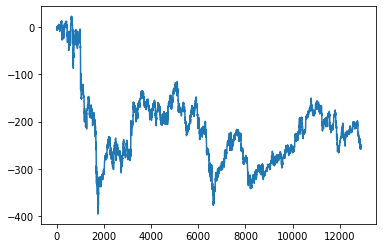

In [67]:
data1 = pd.read_csv('datahistory_1m_svc.csv')
print(data1)

plt.plot(data1['money'])

## RNN

In [87]:
df_history_past = pd.DataFrame(data={"time": [], "opens": [], "highs": [], "lows": [], "closes": [], "volumes": [], "qavs": [], "numTrades": [], "tbbavs": [], "tbqavs": [], "rsis": [],"obvs": [], "money": [], "trueAfter": [], "predictionBefore": [], "action": [], "correct": [], "diff": []})
invertedData = scaler.inverse_transform(dataLast)


hidden_squeeze = torch.squeeze(hidden_rnn, 1)
countBuy = 0
countDontBuy = 0
correctBuy = 0
correctDontBuy = 0
boughtPrev = False
closePrev = float(0)
money = float(0)
action = ""


for i in range(len(dataLast)):
    curr_df = dataLast.iloc[i]
    currData = np.array(dataLast.iloc[i].to_numpy())
    curr_close = currData[3]
    
    if(countDontBuy + countBuy > 0):
        prevData = np.array(dataLast.iloc[i-1].to_numpy())
        prev_close = prevData[3]
        
        truePred = curr_close

        print("\nBack Propogate... \n")

        hidden_squeeze = hidden_squeeze.detach()
        pred =  torch.squeeze(pred, 1)
        pred =  torch.squeeze(pred, 0)
        truePred = torch.tensor(truePred)
        truePred = truePred.to(torch.float)

        single_loss = loss_function(pred, truePred)
        single_loss.backward()
        clip_grad_norm_(trained_rnn_model.parameters(), 5)
        optimizer_rnn.step()
        optimizer_rnn.zero_grad()

        prediction = float(pred.item())
        #print("CORRECT?: ", float(truePred.item()), prediction, closePrev)

        if(truePred > closePrev and prediction > closePrev):
            correctBuy += 1
            curr_df['correct'] = [1]
        elif(truePred < closePrev and prediction < closePrev):
            correctDontBuy += 1
            curr_df['correct'] = [1]
        else:
            curr_df['correct'] = [0]
        print("COUNTBUY: ", countBuy , "CORRECTBUY: ", correctBuy, "COUNTDONTBUY: ", countDontBuy, "CORRECTDONTBUY: ", correctDontBuy)

        curr_df['action'] = action
        curr_df['diff'] = float(prediction - curr_close)
        curr_df['time'] = time
        curr_df['money'] = float(money)
        curr_df['trueAfter'] = float(curr_close)
        curr_df['predictionBefore'] = float(prediction)
        df_history_past = df_history_past.append(curr_df, ignore_index = True)

    if(boughtPrev):
        print(invertedData[i][3], invertedData[i][3])
        change = invertedData[i][3] - invertedData[i-1][3]
        money += change
        print('NEW PRICE: ', close, 'BOUGHT PRICE: ', closePrev, 'CHANGE: ', change, 'MONEY: ', money)
        boughtPrev = False
    
    
    data = torch.tensor(currData)
    data = data.to(torch.float)
    data = data[None]
    pred, hidden_squeeze = trained_rnn_model(data, hidden_squeeze)
    
    #print('PREDICTION', pred)
    prediction = float(pred.item())
    
    if(prediction > curr_close):
        countBuy += 1
        action = "BUY"
        print("BUY AT: ", curr_close, 'TIME: ', time)
        boughtPrev = True
    else:
        action = "DONT BUY"
        countDontBuy += 1
        print("DONT BUY")
    closePrev = curr_close

    
df_history_past.to_csv("./data/datahistory_1m_rnn.csv", sep=',',index=False)


DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  1 CORRECTDONTBUY:  1
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  2 CORRECTDONTBUY:  1
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  3 CORRECTDONTBUY:  1
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  4 CORRECTDONTBUY:  2
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  5 CORRECTDONTBUY:  3
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  6 CORRECTDONTBUY:  3
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  7 CORRECTDONTBUY:  4
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  8 CORRECTDONTBUY:  4
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  9 CORRECTDONTBUY:  5
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 COUNTDONTBUY:  10 CORRECTDONTBUY:  5
DONT BUY

Back Propogate... 

COUNTBUY:  0 CORRECTBUY:  0 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2782.04 2782.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6228671827672809 CHANGE:  -0.9200000000000728 MONEY:  -1.5399999999999636
BUY AT:  0.6195748392395052 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5 CORRECTBUY:  1 COUNTDONTBUY:  11 CORRECTDONTBUY:  6
2782.86 2782.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6195748392395052 CHANGE:  0.8200000000001637 MONEY:  -0.7199999999997999
DONT BUY

Back Propogate... 

COUNTBUY:  5 CORRECTBUY:  1 COUNTDONTBUY:  12 CORRECTDONTBUY:  6
DONT BUY

Back Propogate... 

COUNTBUY:  5 CORRECTBUY:  1 COUNTDONTBUY:  13 CORRECTDONTBUY:  6
DONT BUY

Back Propogate... 

COUNTBUY:  5 CORRECTBUY:  1 COUNTDONTBUY:  14 CORRECTDONTBUY:  7
DONT BUY

Back Propogate... 

COUNTBUY:  5 CORRECTBUY:  1 COUNTDONTBUY:  15 CORRECTDONTBUY:  7
DONT BUY

Back Propogate... 

COUNTBUY:  5 CORRECTBUY:  1 COUNTDONTBUY:  16 CORRECTDONTBUY:  8
DONT BUY

Back

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2789.87 2789.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6256585174973505 CHANGE:  6.130000000000109 MONEY:  6.800000000000182
BUY AT:  0.6475955455682895 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  11 CORRECTBUY:  4 COUNTDONTBUY:  20 CORRECTDONTBUY:  9
2788.33 2788.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6475955455682895 CHANGE:  -1.5399999999999636 MONEY:  5.260000000000218
BUY AT:  0.6420844487935351 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  12 CORRECTBUY:  5 COUNTDONTBUY:  20 CORRECTDONTBUY:  9
2788.74 2788.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6420844487935351 CHANGE:  0.4099999999998545 MONEY:  5.670000000000073
BUY AT:  0.6435516888439562 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  13 CORRECTBUY:  5 COUNTDONTBUY:  20 CORRECTDONTBUY:  9
2785.67 2785.67


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2831.04 2831.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7870907093864278 CHANGE:  2.1900000000000546 MONEY:  12.400000000000091
BUY AT:  0.7949279184362413 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  19 CORRECTBUY:  10 COUNTDONTBUY:  27 CORRECTDONTBUY:  10
2835.0 2835.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7949279184362413 CHANGE:  3.9600000000000364 MONEY:  16.360000000000127
BUY AT:  0.8090993101427532 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  20 CORRECTBUY:  10 COUNTDONTBUY:  27 CORRECTDONTBUY:  10
2831.54 2831.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.8090993101427532 CHANGE:  -3.4600000000000364 MONEY:  12.900000000000091
BUY AT:  0.7967172355709019 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  21 CORRECTBUY:  11 COUNTDONTBUY:  27 CORRECTDONTBUY:  10
2834.08 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7878422225829853 CHANGE:  1.9900000000002365 MONEY:  19.93000000000029
BUY AT:  0.7949637047789353 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  26 CORRECTBUY:  14 COUNTDONTBUY:  34 CORRECTDONTBUY:  14
2826.97 2826.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7949637047789353 CHANGE:  -4.080000000000382 MONEY:  15.849999999999909
BUY AT:  0.7803628769601036 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  27 CORRECTBUY:  15 COUNTDONTBUY:  34 CORRECTDONTBUY:  14
2827.56 2827.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7803628769601036 CHANGE:  0.5900000000001455 MONEY:  16.440000000000055
BUY AT:  0.7824742711790036 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  28 CORRECTBUY:  15 COUNTDONTBUY:  34 CORRECTDONTBUY:  14
2825.03 2825.03
NEW PRICE:  tensor([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7999380064132913 CHANGE:  1.2699999999999818 MONEY:  19.44000000000051
BUY AT:  0.804482871935329 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  33 CORRECTBUY:  20 COUNTDONTBUY:  42 CORRECTDONTBUY:  18
2833.82 2833.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.804482871935329 CHANGE:  0.11000000000012733 MONEY:  19.550000000000637
BUY AT:  0.8048765217049548 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  34 CORRECTBUY:  20 COUNTDONTBUY:  42 CORRECTDONTBUY:  18
2829.69 2829.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.8048765217049548 CHANGE:  -4.130000000000109 MONEY:  15.420000000000528
BUY AT:  0.7900967621726581 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  35 CORRECTBUY:  20 COUNTDONTBUY:  42 CORRECTDONTBUY:  18
2825.46 2825.46
NEW PRICE:  tensor([2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  39 CORRECTBUY:  22 COUNTDONTBUY:  48 CORRECTDONTBUY:  23
DONT BUY

Back Propogate... 

COUNTBUY:  39 CORRECTBUY:  22 COUNTDONTBUY:  49 CORRECTDONTBUY:  23
DONT BUY

Back Propogate... 

COUNTBUY:  39 CORRECTBUY:  22 COUNTDONTBUY:  50 CORRECTDONTBUY:  23
DONT BUY

Back Propogate... 

COUNTBUY:  39 CORRECTBUY:  22 COUNTDONTBUY:  51 CORRECTDONTBUY:  23
DONT BUY

Back Propogate... 

COUNTBUY:  39 CORRECTBUY:  22 COUNTDONTBUY:  52 CORRECTDONTBUY:  23
DONT BUY

Back Propogate... 

COUNTBUY:  39 CORRECTBUY:  22 COUNTDONTBUY:  53 CORRECTDONTBUY:  24
DONT BUY

Back Propogate... 

COUNTBUY:  39 CORRECTBUY:  22 COUNTDONTBUY:  54 CORRECTDONTBUY:  25
BUY AT:  0.7562786683275723 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  40 CORRECTBUY:  23 COUNTDONTBUY:  54 CORRECTDONTBUY:  25
2821.83 2821.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7562786683275723 CHANGE:  1.5900000000001455 MONEY:  17

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2826.76 2826.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.779396645707387 CHANGE:  0.06000000000040018 MONEY:  21.320000000001073
BUY AT:  0.7796113637635477 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  47 CORRECTBUY:  27 COUNTDONTBUY:  55 CORRECTDONTBUY:  25
2823.31 2823.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7796113637635477 CHANGE:  -3.450000000000273 MONEY:  17.8700000000008
BUY AT:  0.7672650755343888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  48 CORRECTBUY:  28 COUNTDONTBUY:  55 CORRECTDONTBUY:  25
2824.81 2824.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7672650755343888 CHANGE:  1.5 MONEY:  19.3700000000008
BUY AT:  0.7726330269383705 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  49 CORRECTBUY:  29 COUNTDONTBUY:  55 CORRECTDONTBUY:  25
2825.46 2825.46
NEW PRICE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  61 CORRECTDONTBUY:  29
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  62 CORRECTDONTBUY:  29
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  63 CORRECTDONTBUY:  30
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  64 CORRECTDONTBUY:  31
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  65 CORRECTDONTBUY:  31
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  66 CORRECTDONTBUY:  32
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  67 CORRECTDONTBUY:  32
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  68 CORRECTDONTBUY:  32
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  69 CORRECTDONTBUY:  33
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  29 COUNTDONTBUY:  70 CORRECTDONTBUY:  34
BUY AT:  0.709649063

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2807.06 2807.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6967301940860688 CHANGE:  3.4600000000000364 MONEY:  7.8500000000008185
DONT BUY

Back Propogate... 

COUNTBUY:  60 CORRECTBUY:  31 COUNTDONTBUY:  71 CORRECTDONTBUY:  34
DONT BUY

Back Propogate... 

COUNTBUY:  60 CORRECTBUY:  31 COUNTDONTBUY:  72 CORRECTDONTBUY:  34
DONT BUY

Back Propogate... 

COUNTBUY:  60 CORRECTBUY:  31 COUNTDONTBUY:  73 CORRECTDONTBUY:  35
DONT BUY

Back Propogate... 

COUNTBUY:  60 CORRECTBUY:  31 COUNTDONTBUY:  74 CORRECTDONTBUY:  35
DONT BUY

Back Propogate... 

COUNTBUY:  60 CORRECTBUY:  31 COUNTDONTBUY:  75 CORRECTDONTBUY:  36
DONT BUY

Back Propogate... 

COUNTBUY:  60 CORRECTBUY:  31 COUNTDONTBUY:  76 CORRECTDONTBUY:  36
DONT BUY

Back Propogate... 

COUNTBUY:  60 CORRECTBUY:  31 COUNTDONTBUY:  77 CORRECTDONTBUY:  36
DONT BUY

Back Propogate... 

COUNTBUY:  60 CORRECTBUY:  31 COUNTDONTBUY:  78 CORRECTDONTBUY:  37
DONT BUY

Back Propogate... 

COUNTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2809.3 2809.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7240351735609896 CHANGE:  -1.9299999999998363 MONEY:  10.410000000001219
BUY AT:  0.7171284094212004 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  64 CORRECTBUY:  32 COUNTDONTBUY:  83 CORRECTDONTBUY:  41
2808.06 2808.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7171284094212004 CHANGE:  -1.2400000000002365 MONEY:  9.170000000000982
BUY AT:  0.7126909029272414 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  65 CORRECTBUY:  33 COUNTDONTBUY:  83 CORRECTDONTBUY:  41
2808.64 2808.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7126909029272414 CHANGE:  0.5799999999999272 MONEY:  9.75000000000091
DONT BUY

Back Propogate... 

COUNTBUY:  65 CORRECTBUY:  33 COUNTDONTBUY:  84 CORRECTDONTBUY:  42
DONT BUY

Back Propogate... 

COUNTBUY:  65 CORRECTBUY:  33 COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  0.7160906054830974 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  70 CORRECTBUY:  37 COUNTDONTBUY:  92 CORRECTDONTBUY:  44
2810.05 2810.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7160906054830974 CHANGE:  1.0399999999999636 MONEY:  10.380000000001019
BUY AT:  0.7198123851231912 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  71 CORRECTBUY:  37 COUNTDONTBUY:  92 CORRECTDONTBUY:  44
2809.67 2809.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7198123851231912 CHANGE:  -0.38000000000010914 MONEY:  10.00000000000091
BUY AT:  0.7184525041008488 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  72 CORRECTBUY:  37 COUNTDONTBUY:  92 CORRECTDONTBUY:  44
2809.36 2809.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7184525041008488 CHANGE:  -0.30999999999994543 MONEY:  9.690000000000964
BUY A

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2829.03 2829.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7912061387961474 CHANGE:  -0.9699999999997999 MONEY:  6.070000000001073
BUY AT:  0.7877348635549066 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  77 CORRECTBUY:  39 COUNTDONTBUY:  101 CORRECTDONTBUY:  47
2829.38 2829.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7877348635549066 CHANGE:  0.34999999999990905 MONEY:  6.420000000000982
BUY AT:  0.7889873855491687 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  78 CORRECTBUY:  39 COUNTDONTBUY:  101 CORRECTDONTBUY:  47
2825.56 2825.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7889873855491687 CHANGE:  -3.8200000000001637 MONEY:  2.6000000000008185
BUY AT:  0.7753170026403614 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  79 CORRECTBUY:  40 COUNTDONTBUY:  101 CORRECTDONTBUY:  47
282

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)


2826.1 2826.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7542030604513663 CHANGE:  6.440000000000055 MONEY:  3.140000000000782
DONT BUY

Back Propogate... 

COUNTBUY:  83 CORRECTBUY:  42 COUNTDONTBUY:  102 CORRECTDONTBUY:  48
DONT BUY

Back Propogate... 

COUNTBUY:  83 CORRECTBUY:  42 COUNTDONTBUY:  103 CORRECTDONTBUY:  48
DONT BUY

Back Propogate... 

COUNTBUY:  83 CORRECTBUY:  42 COUNTDONTBUY:  104 CORRECTDONTBUY:  48
DONT BUY

Back Propogate... 

COUNTBUY:  83 CORRECTBUY:  42 COUNTDONTBUY:  105 CORRECTDONTBUY:  48
DONT BUY

Back Propogate... 

COUNTBUY:  83 CORRECTBUY:  42 COUNTDONTBUY:  106 CORRECTDONTBUY:  49
DONT BUY

Back Propogate... 

COUNTBUY:  83 CORRECTBUY:  42 COUNTDONTBUY:  107 CORRECTDONTBUY:  50
DONT BUY

Back Propogate... 

COUNTBUY:  83 CORRECTBUY:  42 COUNTDONTBUY:  108 CORRECTDONTBUY:  51
DONT BUY

Back Propogate... 

COUNTBUY:  83 CORRECTBUY:  42 COUNTDONTBUY:  109 CORRECTDONTBUY:  51
BUY AT:  0.7823311258082309 TIME

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  90 CORRECTBUY:  47 COUNTDONTBUY:  111 CORRECTDONTBUY:  51
BUY AT:  0.8439909942686343 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  91 CORRECTBUY:  47 COUNTDONTBUY:  111 CORRECTDONTBUY:  51
2839.08 2839.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.8439909942686343 CHANGE:  -5.670000000000073 MONEY:  7.310000000000855
DONT BUY

Back Propogate... 

COUNTBUY:  91 CORRECTBUY:  47 COUNTDONTBUY:  112 CORRECTDONTBUY:  52
BUY AT:  0.8114969951031986 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  92 CORRECTBUY:  47 COUNTDONTBUY:  112 CORRECTDONTBUY:  52
2833.63 2833.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.8114969951031986 CHANGE:  -2.0399999999999636 MONEY:  5.270000000000891
BUY AT:  0.8041965811937836 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  93 CORRECTBUY:  48 COUNTDONTBUY:  112 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2836.85 2836.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.8069879159238531 CHANGE:  2.4400000000000546 MONEY:  15.280000000000655
BUY AT:  0.815719783540997 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  101 CORRECTBUY:  53 COUNTDONTBUY:  116 CORRECTDONTBUY:  56
2830.7 2830.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.815719783540997 CHANGE:  -6.150000000000091 MONEY:  9.130000000000564
BUY AT:  0.7937111827846716 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  102 CORRECTBUY:  53 COUNTDONTBUY:  116 CORRECTDONTBUY:  56
2829.12 2829.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7937111827846716 CHANGE:  -1.5799999999999272 MONEY:  7.550000000000637
BUY AT:  0.7880569406391444 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  103 CORRECTBUY:  53 COUNTDONTBUY:  116 CORRECTDONTBUY:  56
2828.5

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  0.6653813578868165 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  110 CORRECTBUY:  57 COUNTDONTBUY:  122 CORRECTDONTBUY:  62
2801.38 2801.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6653813578868165 CHANGE:  6.539999999999964 MONEY:  7.800000000001091
DONT BUY

Back Propogate... 

COUNTBUY:  110 CORRECTBUY:  57 COUNTDONTBUY:  123 CORRECTDONTBUY:  62
BUY AT:  0.6912190973113145 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  111 CORRECTBUY:  58 COUNTDONTBUY:  123 CORRECTDONTBUY:  62
2802.74 2802.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6912190973113145 CHANGE:  0.6799999999998363 MONEY:  8.480000000000928
BUY AT:  0.6936525686144522 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  112 CORRECTBUY:  59 COUNTDONTBUY:  123 CORRECTDONTBUY:  62
2804.15 2804.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  116 CORRECTBUY:  61 COUNTDONTBUY:  132 CORRECTDONTBUY:  67
2808.5 2808.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6994857424734461 CHANGE:  4.130000000000109 MONEY:  13.4300000000012
BUY AT:  0.7142655020057428 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  117 CORRECTBUY:  61 COUNTDONTBUY:  132 CORRECTDONTBUY:  67
2807.18 2807.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7142655020057428 CHANGE:  -1.3200000000001637 MONEY:  12.110000000001037
BUY AT:  0.7095417047702384 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  118 CORRECTBUY:  61 COUNTDONTBUY:  132 CORRECTDONTBUY:  67
2804.18 2804.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7095417047702384 CHANGE:  -3.0 MONEY:  9.110000000001037
BUY AT:  0.6988058019622749 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  119 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2775.92 2775.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5951685535227345 CHANGE:  0.7000000000002728 MONEY:  0.9000000000014552
BUY AT:  0.5976735975112601 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  129 CORRECTBUY:  68 COUNTDONTBUY:  135 CORRECTDONTBUY:  70
2783.43 2783.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5976735975112601 CHANGE:  7.5099999999997635 MONEY:  8.410000000001219
BUY AT:  0.6245491408738612 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  130 CORRECTBUY:  69 COUNTDONTBUY:  135 CORRECTDONTBUY:  70
2785.07 2785.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6245491408738612 CHANGE:  1.6400000000003274 MONEY:  10.050000000001546
DONT BUY

Back Propogate... 

COUNTBUY:  130 CORRECTBUY:  69 COUNTDONTBUY:  136 CORRECTDONTBUY:  70
DONT BUY

Back Propogate... 

COUNTBUY:  130 CORRECTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2778.56 2778.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6152804781163205 CHANGE:  -2.2800000000002 MONEY:  7.770000000001346
BUY AT:  0.6071211919822675 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  132 CORRECTBUY:  70 COUNTDONTBUY:  149 CORRECTDONTBUY:  77
2781.79 2781.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6071211919822675 CHANGE:  3.230000000000018 MONEY:  11.000000000001364
BUY AT:  0.6186801806721749 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  133 CORRECTBUY:  70 COUNTDONTBUY:  149 CORRECTDONTBUY:  77
2780.55 2780.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6186801806721749 CHANGE:  -1.2399999999997817 MONEY:  9.760000000001583
BUY AT:  0.6142426741782175 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  134 CORRECTBUY:  70 COUNTDONTBUY:  149 CORRECTDONTBUY:  77
2779.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2773.75 2773.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5922698597645845 CHANGE:  -0.6599999999998545 MONEY:  2.9600000000014006
BUY AT:  0.5899079611468331 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  147 CORRECTBUY:  77 COUNTDONTBUY:  149 CORRECTDONTBUY:  77
2774.78 2774.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5899079611468331 CHANGE:  1.0300000000002 MONEY:  3.9900000000016007
BUY AT:  0.5935939544442346 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  148 CORRECTBUY:  77 COUNTDONTBUY:  149 CORRECTDONTBUY:  77
2765.76 2765.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5935939544442346 CHANGE:  -9.019999999999982 MONEY:  -5.029999999998381
BUY AT:  0.5613146733349579 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  149 CORRECTBUY:  78 COUNTDONTBUY:  149 CORRECTDONTBUY:  77
276

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2763.61 2763.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5626745543572987 CHANGE:  -2.5299999999997453 MONEY:  -10.389999999998508
BUY AT:  0.5536206096559171 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  161 CORRECTBUY:  82 COUNTDONTBUY:  150 CORRECTDONTBUY:  77
2764.6 2764.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5536206096559171 CHANGE:  0.9899999999997817 MONEY:  -9.399999999998727
BUY AT:  0.5571634575825443 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  162 CORRECTBUY:  83 COUNTDONTBUY:  150 CORRECTDONTBUY:  77
2769.7 2769.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5571634575825443 CHANGE:  5.099999999999909 MONEY:  -4.299999999998818
BUY AT:  0.5754144923560818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  163 CORRECTBUY:  84 COUNTDONTBUY:  150 CORRECTDONTBUY:  77
2775

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  170 CORRECTBUY:  87 COUNTDONTBUY:  156 CORRECTDONTBUY:  80
2769.64 2769.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5775258865749817 CHANGE:  -0.650000000000091 MONEY:  -1.1399999999985084
BUY AT:  0.5751997742999228 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  156 CORRECTDONTBUY:  80
2776.08 2776.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5751997742999228 CHANGE:  6.440000000000055 MONEY:  5.300000000001546
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  157 CORRECTDONTBUY:  81
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  158 CORRECTDONTBUY:  82
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  159 CORRECTDONTBUY:  82
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  160 CORRECTDONTBUY:  82
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  172 CORRECTDONTBUY:  87
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  173 CORRECTDONTBUY:  88
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  174 CORRECTDONTBUY:  88
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  175 CORRECTDONTBUY:  88
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  176 CORRECTDONTBUY:  89
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  177 CORRECTDONTBUY:  89
DONT BUY

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  88 COUNTDONTBUY:  178 CORRECTDONTBUY:  90
BUY AT:  0.614743682975922 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  172 CORRECTBUY:  89 COUNTDONTBUY:  178 CORRECTDONTBUY:  90
2782.92 2782.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.614743682975922 CHANGE:  2.2300000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2785.5 2785.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6212567973460871 CHANGE:  2.9899999999997817 MONEY:  10.110000000001492
DONT BUY

Back Propogate... 

COUNTBUY:  180 CORRECTBUY:  92 COUNTDONTBUY:  179 CORRECTDONTBUY:  90
DONT BUY

Back Propogate... 

COUNTBUY:  180 CORRECTBUY:  92 COUNTDONTBUY:  180 CORRECTDONTBUY:  91
BUY AT:  0.6315990503844248 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  181 CORRECTBUY:  92 COUNTDONTBUY:  180 CORRECTDONTBUY:  91
2784.02 2784.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6315990503844248 CHANGE:  -1.3800000000001091 MONEY:  8.730000000001382
BUY AT:  0.6266605350927611 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  182 CORRECTBUY:  92 COUNTDONTBUY:  180 CORRECTDONTBUY:  91
2782.14 2782.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6266605350927611 CHANGE:  -1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2780.09 2780.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6125965024143296 CHANGE:  0.0 MONEY:  4.800000000001546
BUY AT:  0.6125965024143296 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  194 CORRECTBUY:  97 COUNTDONTBUY:  180 CORRECTDONTBUY:  91
2781.86 2781.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6125965024143296 CHANGE:  1.7699999999999818 MONEY:  6.570000000001528
BUY AT:  0.618930685071028 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  195 CORRECTBUY:  97 COUNTDONTBUY:  180 CORRECTDONTBUY:  91
2778.16 2778.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.618930685071028 CHANGE:  -3.700000000000273 MONEY:  2.870000000001255
BUY AT:  0.6056897382745388 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  196 CORRECTBUY:  98 COUNTDONTBUY:  180 CORRECTDONTBUY:  91
2780.09 2780.09
NEW P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  205 CORRECTBUY:  105 COUNTDONTBUY:  183 CORRECTDONTBUY:  93
DONT BUY

Back Propogate... 

COUNTBUY:  205 CORRECTBUY:  105 COUNTDONTBUY:  184 CORRECTDONTBUY:  94
DONT BUY

Back Propogate... 

COUNTBUY:  205 CORRECTBUY:  105 COUNTDONTBUY:  185 CORRECTDONTBUY:  94
DONT BUY

Back Propogate... 

COUNTBUY:  205 CORRECTBUY:  105 COUNTDONTBUY:  186 CORRECTDONTBUY:  95
BUY AT:  0.6105208945381236 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  206 CORRECTBUY:  105 COUNTDONTBUY:  186 CORRECTDONTBUY:  95
2775.5 2775.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6105208945381236 CHANGE:  -4.010000000000218 MONEY:  21.040000000001783
BUY AT:  0.5961705711181451 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  207 CORRECTBUY:  105 COUNTDONTBUY:  186 CORRECTDONTBUY:  95
2774.65 2774.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.59

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  0.5787784085692439 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  217 CORRECTBUY:  110 COUNTDONTBUY:  186 CORRECTDONTBUY:  95
2769.6 2769.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5787784085692439 CHANGE:  -1.0399999999999636 MONEY:  15.140000000001692
BUY AT:  0.57505662892915 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  218 CORRECTBUY:  110 COUNTDONTBUY:  186 CORRECTDONTBUY:  95
2765.51 2765.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.57505662892915 CHANGE:  -4.089999999999691 MONEY:  11.050000000002001
BUY AT:  0.5604200147676276 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  219 CORRECTBUY:  110 COUNTDONTBUY:  186 CORRECTDONTBUY:  95
2761.95 2761.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5604200147676276 CHANGE:  -3.5600000000004 MONEY:  7.490000000001601
BUY AT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  0.5623882636157532 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  227 CORRECTBUY:  115 COUNTDONTBUY:  190 CORRECTDONTBUY:  96
2768.41 2768.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5623882636157532 CHANGE:  2.349999999999909 MONEY:  14.440000000001874
DONT BUY

Back Propogate... 

COUNTBUY:  227 CORRECTBUY:  115 COUNTDONTBUY:  191 CORRECTDONTBUY:  96
DONT BUY

Back Propogate... 

COUNTBUY:  227 CORRECTBUY:  115 COUNTDONTBUY:  192 CORRECTDONTBUY:  97
BUY AT:  0.5527975237739732 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  228 CORRECTBUY:  115 COUNTDONTBUY:  192 CORRECTDONTBUY:  97
2762.04 2762.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5527975237739732 CHANGE:  -1.3400000000001455 MONEY:  13.100000000001728
BUY AT:  0.5480021538530824 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  229 CORRECTBUY:  115 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  234 CORRECTBUY:  119 COUNTDONTBUY:  198 CORRECTDONTBUY:  100
DONT BUY

Back Propogate... 

COUNTBUY:  234 CORRECTBUY:  119 COUNTDONTBUY:  199 CORRECTDONTBUY:  101
DONT BUY

Back Propogate... 

COUNTBUY:  234 CORRECTBUY:  119 COUNTDONTBUY:  200 CORRECTDONTBUY:  102
BUY AT:  0.5536206096559171 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  235 CORRECTBUY:  120 COUNTDONTBUY:  200 CORRECTDONTBUY:  102
2763.75 2763.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5536206096559171 CHANGE:  0.13999999999987267 MONEY:  23.410000000001673
BUY AT:  0.5541216184536216 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  236 CORRECTBUY:  121 COUNTDONTBUY:  200 CORRECTDONTBUY:  102
2764.99 2764.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5541216184536216 CHANGE:  1.2399999999997817 MONEY:  24.650000000001455
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4933921949032425 CHANGE:  -8.070000000000164 MONEY:  -1.2599999999983993
BUY AT:  0.4645126163498203 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  245 CORRECTBUY:  123 COUNTDONTBUY:  202 CORRECTDONTBUY:  103
2738.97 2738.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4645126163498203 CHANGE:  0.25999999999976353 MONEY:  -0.9999999999986358
BUY AT:  0.4654430612598429 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  246 CORRECTBUY:  123 COUNTDONTBUY:  202 CORRECTDONTBUY:  103
2736.09 2736.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4654430612598429 CHANGE:  -2.8799999999996544 MONEY:  -3.87999999999829
BUY AT:  0.4551365945641993 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  247 CORRECTBUY:  124 COUNTDONTBUY:  202 CORRECTDONTBUY:  103
2738.55 2738.55
NEW 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  258 CORRECTBUY:  130 COUNTDONTBUY:  202 CORRECTDONTBUY:  103
2733.21 2733.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4252549984153664 CHANGE:  5.470000000000255 MONEY:  -6.759999999998399
BUY AT:  0.4448301278685539 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  259 CORRECTBUY:  131 COUNTDONTBUY:  202 CORRECTDONTBUY:  103
2735.23 2735.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4448301278685539 CHANGE:  2.019999999999982 MONEY:  -4.7399999999984175
BUY AT:  0.4520589690925826 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  260 CORRECTBUY:  132 COUNTDONTBUY:  202 CORRECTDONTBUY:  103
2736.81 2736.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4520589690925826 CHANGE:  1.5799999999999272 MONEY:  -3.1599999999984902
DONT BUY

Back Propogate... 

COUNTBUY:  260 CORRECTBUY:  132 COUNTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2731.07 2731.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4233225359099331 CHANGE:  3.8700000000003456 MONEY:  6.230000000001837
DONT BUY

Back Propogate... 

COUNTBUY:  262 CORRECTBUY:  134 COUNTDONTBUY:  215 CORRECTDONTBUY:  113
DONT BUY

Back Propogate... 

COUNTBUY:  262 CORRECTBUY:  134 COUNTDONTBUY:  216 CORRECTDONTBUY:  114
BUY AT:  0.4268295974938679 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  263 CORRECTBUY:  134 COUNTDONTBUY:  216 CORRECTDONTBUY:  114
2723.12 2723.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4268295974938679 CHANGE:  -5.059999999999945 MONEY:  1.1700000000018917
BUY AT:  0.4087217080911031 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  264 CORRECTBUY:  135 COUNTDONTBUY:  216 CORRECTDONTBUY:  114
2723.44 2723.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4087217080911031 CH

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  274 CORRECTBUY:  141 COUNTDONTBUY:  218 CORRECTDONTBUY:  116
BUY AT:  0.4119424789334925 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  275 CORRECTBUY:  142 COUNTDONTBUY:  218 CORRECTDONTBUY:  116
2726.46 2726.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4119424789334925 CHANGE:  2.4400000000000546 MONEY:  7.310000000002219
DONT BUY

Back Propogate... 

COUNTBUY:  275 CORRECTBUY:  142 COUNTDONTBUY:  219 CORRECTDONTBUY:  116
DONT BUY

Back Propogate... 

COUNTBUY:  275 CORRECTBUY:  142 COUNTDONTBUY:  220 CORRECTDONTBUY:  116
DONT BUY

Back Propogate... 

COUNTBUY:  275 CORRECTBUY:  142 COUNTDONTBUY:  221 CORRECTDONTBUY:  117
DONT BUY

Back Propogate... 

COUNTBUY:  275 CORRECTBUY:  142 COUNTDONTBUY:  222 CORRECTDONTBUY:  117
DONT BUY

Back Propogate... 

COUNTBUY:  275 CORRECTBUY:  142 COUNTDONTBUY:  223 CORRECTDONTBUY:  118
DONT BUY

Back Propogate... 

COUNTBUY:  275 CORRECTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  276 CORRECTBUY:  143 COUNTDONTBUY:  231 CORRECTDONTBUY:  122
DONT BUY

Back Propogate... 

COUNTBUY:  276 CORRECTBUY:  143 COUNTDONTBUY:  232 CORRECTDONTBUY:  123
BUY AT:  0.4049641421083169 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  277 CORRECTBUY:  143 COUNTDONTBUY:  232 CORRECTDONTBUY:  123
2716.2 2716.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4049641421083169 CHANGE:  -5.870000000000346 MONEY:  5.12000000000171
BUY AT:  0.3839575589474005 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  278 CORRECTBUY:  144 COUNTDONTBUY:  232 CORRECTDONTBUY:  123
2717.38 2717.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3839575589474005 CHANGE:  1.180000000000291 MONEY:  6.300000000002001
BUY AT:  0.3881803473852005 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  279 CORRECTBUY:  144 COUNTDONTBUY:  23

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2695.0 2695.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2906625635461993 CHANGE:  4.869999999999891 MONEY:  -16.07999999999811
BUY AT:  0.3080905124377929 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  149 COUNTDONTBUY:  232 CORRECTDONTBUY:  123
2699.46 2699.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3080905124377929 CHANGE:  4.460000000000036 MONEY:  -11.619999999998072
BUY AT:  0.3240512212789653 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  291 CORRECTBUY:  150 COUNTDONTBUY:  232 CORRECTDONTBUY:  123
2703.81 2703.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3240512212789653 CHANGE:  4.349999999999909 MONEY:  -7.269999999998163
BUY AT:  0.339618280350512 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  292 CORRECTBUY:  150 COUNTDONTBUY:  232 CORRECTDONTBUY:  123


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  293 CORRECTBUY:  151 COUNTDONTBUY:  244 CORRECTDONTBUY:  127
DONT BUY

Back Propogate... 

COUNTBUY:  293 CORRECTBUY:  151 COUNTDONTBUY:  245 CORRECTDONTBUY:  128
DONT BUY

Back Propogate... 

COUNTBUY:  293 CORRECTBUY:  151 COUNTDONTBUY:  246 CORRECTDONTBUY:  129
DONT BUY

Back Propogate... 

COUNTBUY:  293 CORRECTBUY:  151 COUNTDONTBUY:  247 CORRECTDONTBUY:  130
DONT BUY

Back Propogate... 

COUNTBUY:  293 CORRECTBUY:  151 COUNTDONTBUY:  248 CORRECTDONTBUY:  130
DONT BUY

Back Propogate... 

COUNTBUY:  293 CORRECTBUY:  151 COUNTDONTBUY:  249 CORRECTDONTBUY:  131
BUY AT:  0.3381152539573969 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  294 CORRECTBUY:  151 COUNTDONTBUY:  249 CORRECTDONTBUY:  131
2697.72 2697.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3381152539573969 CHANGE:  -5.670000000000073 MONEY:  -11.0099999999984
BUY AT:  0.3178243976503457 TIME:  <module 'time' (bui

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  302 CORRECTBUY:  153 COUNTDONTBUY:  249 CORRECTDONTBUY:  131
2687.34 2687.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.285366184827604 CHANGE:  -1.3099999999999454 MONEY:  -21.389999999998054
BUY AT:  0.2806781739347935 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  303 CORRECTBUY:  154 COUNTDONTBUY:  249 CORRECTDONTBUY:  131
2689.51 2689.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2806781739347935 CHANGE:  2.1700000000000728 MONEY:  -19.21999999999798
BUY AT:  0.2884438102992206 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  304 CORRECTBUY:  154 COUNTDONTBUY:  249 CORRECTDONTBUY:  131
2685.83 2685.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2884438102992206 CHANGE:  -3.680000000000291 MONEY:  -22.899999999998272
BUY AT:  0.2752744361881177 TIME:  <module 'time' (built-in)>

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  250 CORRECTDONTBUY:  131
DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  251 CORRECTDONTBUY:  132
DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  252 CORRECTDONTBUY:  132
DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  253 CORRECTDONTBUY:  132
DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  254 CORRECTDONTBUY:  133
DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  255 CORRECTDONTBUY:  134
DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  256 CORRECTDONTBUY:  135
DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  257 CORRECTDONTBUY:  135
DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  258 CORRECTDONTBUY:  135
DONT BUY

Back Propogate... 

COUNTBUY:  315 CORRECTBUY:  158 COUNTDONTBUY:  259 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  265 CORRECTDONTBUY:  139
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  266 CORRECTDONTBUY:  140
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  267 CORRECTDONTBUY:  140
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  268 CORRECTDONTBUY:  140
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  269 CORRECTDONTBUY:  140
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  270 CORRECTDONTBUY:  140
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  271 CORRECTDONTBUY:  140
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  272 CORRECTDONTBUY:  140
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  273 CORRECTDONTBUY:  141
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  274 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  281 CORRECTDONTBUY:  144
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  282 CORRECTDONTBUY:  145
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  283 CORRECTDONTBUY:  145
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  284 CORRECTDONTBUY:  145
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  285 CORRECTDONTBUY:  146
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  286 CORRECTDONTBUY:  147
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  287 CORRECTDONTBUY:  147
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  288 CORRECTDONTBUY:  148
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  289 CORRECTDONTBUY:  148
DONT BUY

Back Propogate... 

COUNTBUY:  316 CORRECTBUY:  159 COUNTDONTBUY:  290 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  294 CORRECTDONTBUY:  151
DONT BUY

Back Propogate... 

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  295 CORRECTDONTBUY:  151
DONT BUY

Back Propogate... 

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  296 CORRECTDONTBUY:  152
DONT BUY

Back Propogate... 

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  297 CORRECTDONTBUY:  153
DONT BUY

Back Propogate... 

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  298 CORRECTDONTBUY:  153
DONT BUY

Back Propogate... 

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  299 CORRECTDONTBUY:  153
DONT BUY

Back Propogate... 

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  300 CORRECTDONTBUY:  154
DONT BUY

Back Propogate... 

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  301 CORRECTDONTBUY:  155
DONT BUY

Back Propogate... 

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  302 CORRECTDONTBUY:  155
DONT BUY

Back Propogate... 

COUNTBUY:  318 CORRECTBUY:  161 COUNTDONTBUY:  303 CORRECTDONTBUY:  156
BUY AT:  0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  0.3995604043616412 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  323 CORRECTBUY:  164 COUNTDONTBUY:  304 CORRECTDONTBUY:  156
2722.98 2722.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3995604043616412 CHANGE:  2.4200000000000728 MONEY:  0.28000000000156433
BUY AT:  0.4082206992933986 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  324 CORRECTBUY:  164 COUNTDONTBUY:  304 CORRECTDONTBUY:  156
2719.0 2719.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4082206992933986 CHANGE:  -3.980000000000018 MONEY:  -3.699999999998454
BUY AT:  0.3939777349015004 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  325 CORRECTBUY:  164 COUNTDONTBUY:  304 CORRECTDONTBUY:  156
2716.56 2716.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3939777349015004 CHANGE:  -2.4400000000000546 MONEY:  -6.13999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2712.12 2712.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3727206473417326 CHANGE:  -0.9400000000000546 MONEY:  -10.579999999998563
BUY AT:  0.3693567311285705 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  338 CORRECTBUY:  168 COUNTDONTBUY:  304 CORRECTDONTBUY:  156
2710.26 2710.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3693567311285705 CHANGE:  -1.8599999999996726 MONEY:  -12.439999999998236
BUY AT:  0.3627004713876344 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  339 CORRECTBUY:  169 COUNTDONTBUY:  304 CORRECTDONTBUY:  156
2712.37 2712.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3627004713876344 CHANGE:  2.1099999999996726 MONEY:  -10.329999999998563
BUY AT:  0.3702513896959008 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  340 CORRECTBUY:  170 COUNTDONTBUY:  304 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  350 CORRECTBUY:  174 COUNTDONTBUY:  307 CORRECTDONTBUY:  158
DONT BUY

Back Propogate... 

COUNTBUY:  350 CORRECTBUY:  174 COUNTDONTBUY:  308 CORRECTDONTBUY:  159
DONT BUY

Back Propogate... 

COUNTBUY:  350 CORRECTBUY:  174 COUNTDONTBUY:  309 CORRECTDONTBUY:  160
BUY AT:  0.3589786917475389 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  351 CORRECTBUY:  175 COUNTDONTBUY:  309 CORRECTDONTBUY:  160
2713.1 2713.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3589786917475389 CHANGE:  3.880000000000109 MONEY:  -5.389999999998508
DONT BUY

Back Propogate... 

COUNTBUY:  351 CORRECTBUY:  175 COUNTDONTBUY:  310 CORRECTDONTBUY:  161
BUY AT:  0.3620205308764632 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  352 CORRECTBUY:  175 COUNTDONTBUY:  310 CORRECTDONTBUY:  161
2706.56 2706.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2642.05 2642.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1506306045876626 CHANGE:  -8.949999999999818 MONEY:  -73.40999999999849
BUY AT:  0.1186018278772389 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  363 CORRECTBUY:  180 COUNTDONTBUY:  310 CORRECTDONTBUY:  161
2654.51 2654.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1186018278772389 CHANGE:  12.460000000000036 MONEY:  -60.949999999998454
BUY AT:  0.1631916108729806 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  364 CORRECTBUY:  181 COUNTDONTBUY:  310 CORRECTDONTBUY:  161
2661.74 2661.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1631916108729806 CHANGE:  7.229999999999563 MONEY:  -53.71999999999889
BUY AT:  0.1890651366401708 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  365 CORRECTBUY:  182 COUNTDONTBUY:  310 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2637.88 2637.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1339183825499325 CHANGE:  -8.449999999999818 MONEY:  -69.5699999999988
DONT BUY

Back Propogate... 

COUNTBUY:  375 CORRECTBUY:  188 COUNTDONTBUY:  313 CORRECTDONTBUY:  164
BUY AT:  0.0921557206269545 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  376 CORRECTBUY:  189 COUNTDONTBUY:  313 CORRECTDONTBUY:  164
2636.83 2636.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0921557206269545 CHANGE:  2.1700000000000728 MONEY:  -67.39999999999873
BUY AT:  0.0999213569913817 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  377 CORRECTBUY:  190 COUNTDONTBUY:  313 CORRECTDONTBUY:  164
2637.59 2637.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0999213569913817 CHANGE:  0.7600000000002183 MONEY:  -66.63999999999851
BUY AT:  0.1026411190360665 TIME:  <module 'time'

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  384 CORRECTBUY:  193 COUNTDONTBUY:  318 CORRECTDONTBUY:  166
BUY AT:  -0.0061135764086041 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  385 CORRECTBUY:  194 COUNTDONTBUY:  318 CORRECTDONTBUY:  166
2608.2 2608.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0061135764086041 CHANGE:  1.0 MONEY:  -93.89999999999873
BUY AT:  -0.002534942139283 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  386 CORRECTBUY:  194 COUNTDONTBUY:  318 CORRECTDONTBUY:  166
2591.69 2591.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.002534942139283 CHANGE:  -16.509999999999764 MONEY:  -110.40999999999849
BUY AT:  -0.0616181939257743 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  387 CORRECTBUY:  194 COUNTDONTBUY:  318 CORRECTDONTBUY:  166
2583.27 2583.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2606.45 2606.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0179946421827493 CHANGE:  2.569999999999709 MONEY:  -100.07999999999902
BUY AT:  -0.008797552110595 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  392 CORRECTBUY:  198 COUNTDONTBUY:  326 CORRECTDONTBUY:  171
2607.98 2607.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.008797552110595 CHANGE:  1.5300000000002 MONEY:  -98.54999999999882
BUY AT:  -0.0033222416785329 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  393 CORRECTBUY:  198 COUNTDONTBUY:  326 CORRECTDONTBUY:  171
2607.84 2607.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0033222416785329 CHANGE:  -0.13999999999987267 MONEY:  -98.68999999999869
BUY AT:  -0.0038232504762374 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  394 CORRECTBUY:  198 COUNTDONTBUY:  326 CORRECTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  402 CORRECTBUY:  202 COUNTDONTBUY:  330 CORRECTDONTBUY:  171
DONT BUY

Back Propogate... 

COUNTBUY:  402 CORRECTBUY:  202 COUNTDONTBUY:  331 CORRECTDONTBUY:  172
DONT BUY

Back Propogate... 

COUNTBUY:  402 CORRECTBUY:  202 COUNTDONTBUY:  332 CORRECTDONTBUY:  172
DONT BUY

Back Propogate... 

COUNTBUY:  402 CORRECTBUY:  202 COUNTDONTBUY:  333 CORRECTDONTBUY:  172
DONT BUY

Back Propogate... 

COUNTBUY:  402 CORRECTBUY:  202 COUNTDONTBUY:  334 CORRECTDONTBUY:  173
DONT BUY

Back Propogate... 

COUNTBUY:  402 CORRECTBUY:  202 COUNTDONTBUY:  335 CORRECTDONTBUY:  174
BUY AT:  -0.0034296007066133 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  403 CORRECTBUY:  203 COUNTDONTBUY:  335 CORRECTDONTBUY:  174
2612.16 2612.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0034296007066133 CHANGE:  4.210000000000036 MONEY:  -95.76999999999862
BUY AT:  0.0116364495672288 TIME:  <module 'time' (b

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  0.0302095614250057 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  410 CORRECTBUY:  206 COUNTDONTBUY:  337 CORRECTDONTBUY:  174
2617.21 2617.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0302095614250057 CHANGE:  -0.13999999999987267 MONEY:  -91.38999999999851
DONT BUY

Back Propogate... 

COUNTBUY:  410 CORRECTBUY:  206 COUNTDONTBUY:  338 CORRECTDONTBUY:  174
DONT BUY

Back Propogate... 

COUNTBUY:  410 CORRECTBUY:  206 COUNTDONTBUY:  339 CORRECTDONTBUY:  174
DONT BUY

Back Propogate... 

COUNTBUY:  410 CORRECTBUY:  206 COUNTDONTBUY:  340 CORRECTDONTBUY:  174
DONT BUY

Back Propogate... 

COUNTBUY:  410 CORRECTBUY:  206 COUNTDONTBUY:  341 CORRECTDONTBUY:  175
DONT BUY

Back Propogate... 

COUNTBUY:  410 CORRECTBUY:  206 COUNTDONTBUY:  342 CORRECTDONTBUY:  175
DONT BUY

Back Propogate... 

COUNTBUY:  410 CORRECTBUY:  206 COUNTDONTBUY:  343 CORRECTDONTBUY:  176
DONT BUY

Back Propogate... 

COUNTBUY:  410 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0683935890786626 CHANGE:  2.4099999999998545 MONEY:  -87.23999999999887
BUY AT:  0.077018097667726 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  416 CORRECTBUY:  210 COUNTDONTBUY:  346 CORRECTDONTBUY:  179
2632.53 2632.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.077018097667726 CHANGE:  2.100000000000364 MONEY:  -85.13999999999851
BUY AT:  0.0845332296333017 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  417 CORRECTBUY:  210 COUNTDONTBUY:  346 CORRECTDONTBUY:  179
2629.55 2629.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0845332296333017 CHANGE:  -2.980000000000018 MONEY:  -88.11999999999853
BUY AT:  0.0738688995107246 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  418 CORRECTBUY:  211 COUNTDONTBUY:  346 CORRECTDONTBUY:  179
2631.47 2631.47
NEW PRICE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2623.46 2623.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0610573888265536 CHANGE:  -2.5099999999997635 MONEY:  -94.20999999999867
BUY AT:  0.0520750168105583 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  430 CORRECTBUY:  217 COUNTDONTBUY:  346 CORRECTDONTBUY:  179
2617.85 2617.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0520750168105583 CHANGE:  -5.610000000000127 MONEY:  -99.8199999999988
BUY AT:  0.0319988785596663 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  431 CORRECTBUY:  217 COUNTDONTBUY:  346 CORRECTDONTBUY:  179
2616.48 2616.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0319988785596663 CHANGE:  -1.3699999999998909 MONEY:  -101.18999999999869
BUY AT:  0.0270961496106967 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  432 CORRECTBUY:  217 COUNTDONTBUY:  346 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2616.5 2616.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0405876008060373 CHANGE:  -3.75 MONEY:  -92.13999999999851
BUY AT:  0.027167722296083 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  438 CORRECTBUY:  221 COUNTDONTBUY:  352 CORRECTDONTBUY:  183
2619.6 2619.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.027167722296083 CHANGE:  3.099999999999909 MONEY:  -89.0399999999986
BUY AT:  0.0382614885309783 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  222 COUNTDONTBUY:  352 CORRECTDONTBUY:  183
2625.03 2625.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0382614885309783 CHANGE:  5.430000000000291 MONEY:  -83.60999999999831
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  222 COUNTDONTBUY:  353 CORRECTDONTBUY:  184
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  222 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2609.56 2609.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0151077248084712 CHANGE:  -3.5700000000001637 MONEY:  -92.69999999999845
BUY AT:  0.0023320004669941 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  446 CORRECTBUY:  224 COUNTDONTBUY:  358 CORRECTDONTBUY:  188
2609.31 2609.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0023320004669941 CHANGE:  -0.25 MONEY:  -92.94999999999845
BUY AT:  0.0014373418996638 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  447 CORRECTBUY:  225 COUNTDONTBUY:  358 CORRECTDONTBUY:  188
2609.63 2609.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0014373418996638 CHANGE:  0.3200000000001637 MONEY:  -92.62999999999829
BUY AT:  0.0025825048658472 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  448 CORRECTBUY:  226 COUNTDONTBUY:  358 CORRECTDONTBUY:  188
2610.92

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  456 CORRECTBUY:  231 COUNTDONTBUY:  361 CORRECTDONTBUY:  189
DONT BUY

Back Propogate... 

COUNTBUY:  456 CORRECTBUY:  231 COUNTDONTBUY:  362 CORRECTDONTBUY:  190
DONT BUY

Back Propogate... 

COUNTBUY:  456 CORRECTBUY:  231 COUNTDONTBUY:  363 CORRECTDONTBUY:  191
DONT BUY

Back Propogate... 

COUNTBUY:  456 CORRECTBUY:  231 COUNTDONTBUY:  364 CORRECTDONTBUY:  192
DONT BUY

Back Propogate... 

COUNTBUY:  456 CORRECTBUY:  231 COUNTDONTBUY:  365 CORRECTDONTBUY:  193
BUY AT:  -0.0279790317941552 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  457 CORRECTBUY:  231 COUNTDONTBUY:  365 CORRECTDONTBUY:  193
2596.06 2596.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0279790317941552 CHANGE:  -5.0300000000002 MONEY:  -95.0399999999986
BUY AT:  -0.0459795621688412 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  458 CORRECTBUY:  231 COUNTDONTBUY:  365 CORRECTDONTBUY:  193
2594.0 2594.0
NEW PRICE:  tens

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2602.22 2602.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0303767167546006 CHANGE:  1.7999999999997272 MONEY:  -82.57999999999856
DONT BUY

Back Propogate... 

COUNTBUY:  465 CORRECTBUY:  236 COUNTDONTBUY:  367 CORRECTDONTBUY:  195
BUY AT:  -0.0341342827373884 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  466 CORRECTBUY:  236 COUNTDONTBUY:  367 CORRECTDONTBUY:  195
2593.97 2593.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0341342827373884 CHANGE:  -5.400000000000091 MONEY:  -87.97999999999865
BUY AT:  -0.053458907791723 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  467 CORRECTBUY:  236 COUNTDONTBUY:  367 CORRECTDONTBUY:  195
2585.06 2585.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.053458907791723 CHANGE:  -8.909999999999854 MONEY:  -96.88999999999851
BUY AT:  -0.0853445391313738 TIME:  <module '

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  372 CORRECTDONTBUY:  199
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  373 CORRECTDONTBUY:  199
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  374 CORRECTDONTBUY:  199
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  375 CORRECTDONTBUY:  200
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  376 CORRECTDONTBUY:  200
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  377 CORRECTDONTBUY:  200
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  378 CORRECTDONTBUY:  201
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  379 CORRECTDONTBUY:  201
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  380 CORRECTDONTBUY:  202
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  381 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  389 CORRECTDONTBUY:  205
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  390 CORRECTDONTBUY:  206
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  391 CORRECTDONTBUY:  206
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  392 CORRECTDONTBUY:  206
DONT BUY

Back Propogate... 

COUNTBUY:  475 CORRECTBUY:  242 COUNTDONTBUY:  393 CORRECTDONTBUY:  207
BUY AT:  0.0055527713093835 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  476 CORRECTBUY:  242 COUNTDONTBUY:  393 CORRECTDONTBUY:  207
2603.49 2603.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0055527713093835 CHANGE:  -6.970000000000255 MONEY:  -87.52999999999838
BUY AT:  -0.0193903095477857 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  477 CORRECTBUY:  242 COUNTDONTBUY:  393 CORRECTDONTBUY:  207

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2561.61 2561.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1507261872318711 CHANGE:  -5.179999999999836 MONEY:  -129.40999999999804
BUY AT:  -0.169263512746954 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  487 CORRECTBUY:  246 COUNTDONTBUY:  393 CORRECTDONTBUY:  207
2568.29 2568.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.169263512746954 CHANGE:  6.679999999999836 MONEY:  -122.7299999999982
BUY AT:  -0.1453582358278894 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  488 CORRECTBUY:  247 COUNTDONTBUY:  393 CORRECTDONTBUY:  207
2573.68 2573.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1453582358278894 CHANGE:  5.389999999999873 MONEY:  -117.33999999999833
BUY AT:  -0.1260693971162489 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  489 CORRECTBUY:  247 COUNTDONTBUY:  393 CORRECTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  398 CORRECTDONTBUY:  208
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  399 CORRECTDONTBUY:  209
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  400 CORRECTDONTBUY:  209
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  401 CORRECTDONTBUY:  210
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  402 CORRECTDONTBUY:  211
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  403 CORRECTDONTBUY:  211
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  404 CORRECTDONTBUY:  211
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  405 CORRECTDONTBUY:  211
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  406 CORRECTDONTBUY:  211
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  407 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  415 CORRECTDONTBUY:  214
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  416 CORRECTDONTBUY:  215
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  417 CORRECTDONTBUY:  216
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  418 CORRECTDONTBUY:  217
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  419 CORRECTDONTBUY:  217
DONT BUY

Back Propogate... 

COUNTBUY:  497 CORRECTBUY:  252 COUNTDONTBUY:  420 CORRECTDONTBUY:  218
BUY AT:  -0.0537094121905744 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  498 CORRECTBUY:  253 COUNTDONTBUY:  420 CORRECTDONTBUY:  218
2597.81 2597.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0537094121905744 CHANGE:  3.9099999999998545 MONEY:  -111.96999999999844
DONT BUY

Back Propogate... 

COUNTBUY:  498 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0032148826504526 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  500 CORRECTBUY:  254 COUNTDONTBUY:  429 CORRECTDONTBUY:  223
2607.36 2607.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0032148826504526 CHANGE:  -0.650000000000091 MONEY:  -109.87999999999829
BUY AT:  -0.0055409949255117 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  501 CORRECTBUY:  254 COUNTDONTBUY:  429 CORRECTDONTBUY:  223
2603.86 2603.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0055409949255117 CHANGE:  -3.5 MONEY:  -113.37999999999829
BUY AT:  -0.0180662148681357 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  502 CORRECTBUY:  254 COUNTDONTBUY:  429 CORRECTDONTBUY:  223
2596.8 2596.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0180662148681357 CHANGE:  -7.059999999999945 MONEY:  -120.43999999999824
BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2596.41 2596.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0528505399659381 CHANGE:  2.269999999999982 MONEY:  -120.82999999999856
BUY AT:  -0.0447270401745792 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  515 CORRECTBUY:  260 COUNTDONTBUY:  429 CORRECTDONTBUY:  223
2592.41 2592.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0447270401745792 CHANGE:  -4.0 MONEY:  -124.82999999999856
BUY AT:  -0.0590415772518637 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  516 CORRECTBUY:  260 COUNTDONTBUY:  429 CORRECTDONTBUY:  223
2592.4 2592.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0590415772518637 CHANGE:  -0.009999999999763531 MONEY:  -124.83999999999833
BUY AT:  -0.0590773635945561 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  517 CORRECTBUY:  261 COUNTDONTBUY:  429 CORRECTDONTBUY:  223


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  521 CORRECTBUY:  264 COUNTDONTBUY:  437 CORRECTDONTBUY:  226
DONT BUY

Back Propogate... 

COUNTBUY:  521 CORRECTBUY:  264 COUNTDONTBUY:  438 CORRECTDONTBUY:  227
DONT BUY

Back Propogate... 

COUNTBUY:  521 CORRECTBUY:  264 COUNTDONTBUY:  439 CORRECTDONTBUY:  228
DONT BUY

Back Propogate... 

COUNTBUY:  521 CORRECTBUY:  264 COUNTDONTBUY:  440 CORRECTDONTBUY:  228
DONT BUY

Back Propogate... 

COUNTBUY:  521 CORRECTBUY:  264 COUNTDONTBUY:  441 CORRECTDONTBUY:  228
DONT BUY

Back Propogate... 

COUNTBUY:  521 CORRECTBUY:  264 COUNTDONTBUY:  442 CORRECTDONTBUY:  229
DONT BUY

Back Propogate... 

COUNTBUY:  521 CORRECTBUY:  264 COUNTDONTBUY:  443 CORRECTDONTBUY:  230
DONT BUY

Back Propogate... 

COUNTBUY:  521 CORRECTBUY:  264 COUNTDONTBUY:  444 CORRECTDONTBUY:  231
DONT BUY

Back Propogate... 

COUNTBUY:  521 CORRECTBUY:  264 COUNTDONTBUY:  445 CORRECTDONTBUY:  232
BUY AT:  -0.0407547561356322 TIME:  <module 'time' (built-in)>

Back Propogate... 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0476257339327291 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  527 CORRECTBUY:  266 COUNTDONTBUY:  445 CORRECTDONTBUY:  232
2602.85 2602.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0476257339327291 CHANGE:  7.25 MONEY:  -100.0399999999986
BUY AT:  -0.0216806354801508 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  528 CORRECTBUY:  266 COUNTDONTBUY:  445 CORRECTDONTBUY:  232
2598.03 2598.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0216806354801508 CHANGE:  -4.819999999999709 MONEY:  -104.85999999999831
BUY AT:  -0.0389296526582777 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  529 CORRECTBUY:  266 COUNTDONTBUY:  445 CORRECTDONTBUY:  232
2597.96 2597.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0389296526582777 CHANGE:  -0.07000000000016371 MONEY:  -104.92999999999847

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2576.3 2576.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0938616886923585 CHANGE:  -6.379999999999654 MONEY:  -114.9799999999982
BUY AT:  -0.1166933753306262 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  551 CORRECTBUY:  278 COUNTDONTBUY:  449 CORRECTDONTBUY:  235
2578.84 2578.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1166933753306262 CHANGE:  2.5399999999999636 MONEY:  -112.43999999999824
BUY AT:  -0.1076036442865506 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  552 CORRECTBUY:  278 COUNTDONTBUY:  449 CORRECTDONTBUY:  235
2577.85 2577.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1076036442865506 CHANGE:  -0.9900000000002365 MONEY:  -113.42999999999847
BUY AT:  -0.1111464922131794 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  553 CORRECTBUY:  278 COUNTDONTBUY:  449 CORRECTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  564 CORRECTBUY:  279 COUNTDONTBUY:  449 CORRECTDONTBUY:  235
2489.51 2489.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4037356300728754 CHANGE:  -6.579999999999927 MONEY:  -201.76999999999816
BUY AT:  -0.4272830435650082 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  565 CORRECTBUY:  279 COUNTDONTBUY:  449 CORRECTDONTBUY:  235
2482.73 2482.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4272830435650082 CHANGE:  -6.7800000000002 MONEY:  -208.54999999999836
BUY AT:  -0.4515461839110063 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  566 CORRECTBUY:  279 COUNTDONTBUY:  449 CORRECTDONTBUY:  235
2462.01 2462.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4515461839110063 CHANGE:  -20.7199999999998 MONEY:  -229.26999999999816
BUY AT:  -0.5256954859713397 TIME:  <module 'time' (built-in)>

Back Prop

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2494.19 2494.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.410749753240745 CHANGE:  0.05999999999994543 MONEY:  -197.08999999999833
DONT BUY

Back Propogate... 

COUNTBUY:  577 CORRECTBUY:  286 COUNTDONTBUY:  450 CORRECTDONTBUY:  236
DONT BUY

Back Propogate... 

COUNTBUY:  577 CORRECTBUY:  286 COUNTDONTBUY:  451 CORRECTDONTBUY:  237
BUY AT:  -0.4653954985332788 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  578 CORRECTBUY:  287 COUNTDONTBUY:  451 CORRECTDONTBUY:  237
2479.95 2479.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4653954985332788 CHANGE:  1.0899999999996908 MONEY:  -195.99999999999864
DONT BUY

Back Propogate... 

COUNTBUY:  578 CORRECTBUY:  287 COUNTDONTBUY:  452 CORRECTDONTBUY:  237
DONT BUY

Back Propogate... 

COUNTBUY:  578 CORRECTBUY:  287 COUNTDONTBUY:  453 CORRECTDONTBUY:  237
DONT BUY

Back Propogate... 

COUNTBUY:  578 CORRECTBUY:  287 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  581 CORRECTBUY:  289 COUNTDONTBUY:  460 CORRECTDONTBUY:  242
DONT BUY

Back Propogate... 

COUNTBUY:  581 CORRECTBUY:  289 COUNTDONTBUY:  461 CORRECTDONTBUY:  243
DONT BUY

Back Propogate... 

COUNTBUY:  581 CORRECTBUY:  289 COUNTDONTBUY:  462 CORRECTDONTBUY:  244
DONT BUY

Back Propogate... 

COUNTBUY:  581 CORRECTBUY:  289 COUNTDONTBUY:  463 CORRECTDONTBUY:  244
DONT BUY

Back Propogate... 

COUNTBUY:  581 CORRECTBUY:  289 COUNTDONTBUY:  464 CORRECTDONTBUY:  245
BUY AT:  -0.5653109673327253 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  582 CORRECTBUY:  289 COUNTDONTBUY:  464 CORRECTDONTBUY:  245
2448.25 2448.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5653109673327253 CHANGE:  -2.6900000000000546 MONEY:  -185.99999999999864
BUY AT:  -0.5749374935171995 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  583 CORRECTBUY:  289 COUNTDONTBUY:  464 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  467 CORRECTDONTBUY:  246
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  468 CORRECTDONTBUY:  247
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  469 CORRECTDONTBUY:  248
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  470 CORRECTDONTBUY:  248
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  471 CORRECTDONTBUY:  248
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  472 CORRECTDONTBUY:  248
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  473 CORRECTDONTBUY:  249
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  474 CORRECTDONTBUY:  249
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  475 CORRECTDONTBUY:  250
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  476 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  483 CORRECTDONTBUY:  253
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  484 CORRECTDONTBUY:  253
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  485 CORRECTDONTBUY:  254
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  486 CORRECTDONTBUY:  254
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  487 CORRECTDONTBUY:  254
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  488 CORRECTDONTBUY:  254
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  489 CORRECTDONTBUY:  255
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  490 CORRECTDONTBUY:  256
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  491 CORRECTDONTBUY:  257
DONT BUY

Back Propogate... 

COUNTBUY:  589 CORRECTBUY:  293 COUNTDONTBUY:  492 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2508.54 2508.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4230602551272099 CHANGE:  17.84999999999991 MONEY:  -150.31999999999834
DONT BUY

Back Propogate... 

COUNTBUY:  591 CORRECTBUY:  295 COUNTDONTBUY:  497 CORRECTDONTBUY:  261
DONT BUY

Back Propogate... 

COUNTBUY:  591 CORRECTBUY:  295 COUNTDONTBUY:  498 CORRECTDONTBUY:  262
DONT BUY

Back Propogate... 

COUNTBUY:  591 CORRECTBUY:  295 COUNTDONTBUY:  499 CORRECTDONTBUY:  262
DONT BUY

Back Propogate... 

COUNTBUY:  591 CORRECTBUY:  295 COUNTDONTBUY:  500 CORRECTDONTBUY:  262
DONT BUY

Back Propogate... 

COUNTBUY:  591 CORRECTBUY:  295 COUNTDONTBUY:  501 CORRECTDONTBUY:  262
DONT BUY

Back Propogate... 

COUNTBUY:  591 CORRECTBUY:  295 COUNTDONTBUY:  502 CORRECTDONTBUY:  262
DONT BUY

Back Propogate... 

COUNTBUY:  591 CORRECTBUY:  295 COUNTDONTBUY:  503 CORRECTDONTBUY:  262
DONT BUY

Back Propogate... 

COUNTBUY:  591 CORRECTBUY:  295 COUNTDONTBUY:  504 CORRECTDONTBUY:  262
DON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2514.71 2514.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3508076292296158 CHANGE:  3.8299999999999272 MONEY:  -148.1099999999983
BUY AT:  -0.3371014599781161 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  595 CORRECTBUY:  297 COUNTDONTBUY:  509 CORRECTDONTBUY:  266
2514.56 2514.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3371014599781161 CHANGE:  -0.15000000000009095 MONEY:  -148.2599999999984
BUY AT:  -0.3376382551185145 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  596 CORRECTBUY:  297 COUNTDONTBUY:  509 CORRECTDONTBUY:  266
2514.51 2514.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3376382551185145 CHANGE:  -0.04999999999972715 MONEY:  -148.30999999999813
BUY AT:  -0.3378171868319796 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  597 CORRECTBUY:  297 COUNTDONTBUY:  509 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  609 CORRECTBUY:  302 COUNTDONTBUY:  509 CORRECTDONTBUY:  266
2502.29 2502.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3822638244569485 CHANGE:  0.1999999999998181 MONEY:  -160.52999999999838
BUY AT:  -0.3815480976030849 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  610 CORRECTBUY:  302 COUNTDONTBUY:  509 CORRECTDONTBUY:  266
2500.56 2500.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3815480976030849 CHANGE:  -1.7300000000000182 MONEY:  -162.2599999999984
BUY AT:  -0.3877391348890106 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  611 CORRECTBUY:  303 COUNTDONTBUY:  509 CORRECTDONTBUY:  266
2505.63 2505.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3877391348890106 CHANGE:  5.070000000000164 MONEY:  -157.18999999999824
BUY AT:  -0.3695954591435518 TIME:  <module 'time' (built-in)>

Back Pr

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  618 CORRECTBUY:  306 COUNTDONTBUY:  515 CORRECTDONTBUY:  269
DONT BUY

Back Propogate... 

COUNTBUY:  618 CORRECTBUY:  306 COUNTDONTBUY:  516 CORRECTDONTBUY:  269
DONT BUY

Back Propogate... 

COUNTBUY:  618 CORRECTBUY:  306 COUNTDONTBUY:  517 CORRECTDONTBUY:  270
DONT BUY

Back Propogate... 

COUNTBUY:  618 CORRECTBUY:  306 COUNTDONTBUY:  518 CORRECTDONTBUY:  271
DONT BUY

Back Propogate... 

COUNTBUY:  618 CORRECTBUY:  306 COUNTDONTBUY:  519 CORRECTDONTBUY:  272
DONT BUY

Back Propogate... 

COUNTBUY:  618 CORRECTBUY:  306 COUNTDONTBUY:  520 CORRECTDONTBUY:  273
BUY AT:  -0.3988329011239058 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  619 CORRECTBUY:  307 COUNTDONTBUY:  520 CORRECTDONTBUY:  273
2508.13 2508.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3988329011239058 CHANGE:  10.670000000000073 MONEY:  -150.20999999999822
DONT BUY

Back Propogate... 

COUNTBUY:  619 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3899221017932969 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  623 CORRECTBUY:  310 COUNTDONTBUY:  525 CORRECTDONTBUY:  278
2503.38 2503.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3899221017932969 CHANGE:  3.430000000000291 MONEY:  -144.5999999999981
DONT BUY

Back Propogate... 

COUNTBUY:  623 CORRECTBUY:  310 COUNTDONTBUY:  526 CORRECTDONTBUY:  279
BUY AT:  -0.3824069698277212 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  624 CORRECTBUY:  310 COUNTDONTBUY:  526 CORRECTDONTBUY:  279
2501.97 2501.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3824069698277212 CHANGE:  -0.08000000000038199 MONEY:  -144.67999999999847
BUY AT:  -0.3826932605692683 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  625 CORRECTBUY:  311 COUNTDONTBUY:  526 CORRECTDONTBUY:  279
2506.54 2506.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3922840004110484 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  632 CORRECTBUY:  312 COUNTDONTBUY:  530 CORRECTDONTBUY:  282
2496.51 2496.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3922840004110484 CHANGE:  -2.7799999999997453 MONEY:  -145.7999999999979
BUY AT:  -0.4022326036797602 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  633 CORRECTBUY:  312 COUNTDONTBUY:  530 CORRECTDONTBUY:  282
2494.88 2494.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4022326036797602 CHANGE:  -1.6300000000001091 MONEY:  -147.42999999999802
BUY AT:  -0.4080657775387541 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  634 CORRECTBUY:  312 COUNTDONTBUY:  530 CORRECTDONTBUY:  282
2488.35 2488.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4080657775387541 CHANGE:  -6.5300000000002 MONEY:  -153.95

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2459.88 2459.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.520327534567358 CHANGE:  -3.630000000000109 MONEY:  -182.42999999999802
BUY AT:  -0.5333179769649942 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  646 CORRECTBUY:  316 COUNTDONTBUY:  530 CORRECTDONTBUY:  282
2457.16 2457.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5333179769649942 CHANGE:  -2.7200000000002547 MONEY:  -185.14999999999827
BUY AT:  -0.5430518621775485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  647 CORRECTBUY:  316 COUNTDONTBUY:  530 CORRECTDONTBUY:  282
2452.35 2452.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5430518621775485 CHANGE:  -4.809999999999945 MONEY:  -189.95999999999822
BUY AT:  -0.5602650930129831 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  648 CORRECTBUY:  317 COUNTDONTBUY:  530 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  538 CORRECTDONTBUY:  283
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  539 CORRECTDONTBUY:  284
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  540 CORRECTDONTBUY:  284
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  541 CORRECTDONTBUY:  285
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  542 CORRECTDONTBUY:  286
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  543 CORRECTDONTBUY:  287
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  544 CORRECTDONTBUY:  287
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  545 CORRECTDONTBUY:  288
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  546 CORRECTDONTBUY:  289
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  547 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  554 CORRECTDONTBUY:  292
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  555 CORRECTDONTBUY:  292
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  556 CORRECTDONTBUY:  293
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  557 CORRECTDONTBUY:  293
DONT BUY

Back Propogate... 

COUNTBUY:  652 CORRECTBUY:  320 COUNTDONTBUY:  558 CORRECTDONTBUY:  294
BUY AT:  -0.4046302886402056 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  653 CORRECTBUY:  321 COUNTDONTBUY:  558 CORRECTDONTBUY:  294
2496.66 2496.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4046302886402056 CHANGE:  0.819999999999709 MONEY:  -169.2599999999984
BUY AT:  -0.4016958085393634 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  654 CORRECTBUY:  321 COUNTDONTBUY:  558 CORRECTDONTBUY:  29

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2486.38 2486.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4217361604475614 CHANGE:  -4.679999999999836 MONEY:  -179.53999999999814
BUY AT:  -0.4384841688279838 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  663 CORRECTBUY:  326 COUNTDONTBUY:  558 CORRECTDONTBUY:  294
2488.82 2488.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4384841688279838 CHANGE:  2.4400000000000546 MONEY:  -177.0999999999981
BUY AT:  -0.42975230121084 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  664 CORRECTBUY:  326 COUNTDONTBUY:  558 CORRECTDONTBUY:  294
2486.21 2486.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.42975230121084 CHANGE:  -2.6100000000001273 MONEY:  -179.70999999999822
BUY AT:  -0.4390925366537687 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  665 CORRECTBUY:  326 COUNTDONTBUY:  558 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2478.25 2478.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4533712873883609 CHANGE:  -3.9699999999998 MONEY:  -179.74999999999818
BUY AT:  -0.4675784654375651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  675 CORRECTBUY:  331 COUNTDONTBUY:  560 CORRECTDONTBUY:  296
2488.68 2488.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4675784654375651 CHANGE:  10.429999999999836 MONEY:  -169.31999999999834
DONT BUY

Back Propogate... 

COUNTBUY:  675 CORRECTBUY:  331 COUNTDONTBUY:  561 CORRECTDONTBUY:  296
DONT BUY

Back Propogate... 

COUNTBUY:  675 CORRECTBUY:  331 COUNTDONTBUY:  562 CORRECTDONTBUY:  297
DONT BUY

Back Propogate... 

COUNTBUY:  675 CORRECTBUY:  331 COUNTDONTBUY:  563 CORRECTDONTBUY:  298
DONT BUY

Back Propogate... 

COUNTBUY:  675 CORRECTBUY:  331 COUNTDONTBUY:  564 CORRECTDONTBUY:  298
DONT BUY

Back Propogate... 

COUNTBUY:  675 CORRECTBUY:  331 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2476.34 2476.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4607432739831622 CHANGE:  -3.819999999999709 MONEY:  -173.13999999999805
BUY AT:  -0.4744136568919679 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  677 CORRECTBUY:  332 COUNTDONTBUY:  574 CORRECTDONTBUY:  304
2476.64 2476.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4744136568919679 CHANGE:  0.29999999999972715 MONEY:  -172.83999999999833
BUY AT:  -0.4733400666111726 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  678 CORRECTBUY:  333 COUNTDONTBUY:  574 CORRECTDONTBUY:  304
2478.79 2478.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4733400666111726 CHANGE:  2.150000000000091 MONEY:  -170.68999999999824
BUY AT:  -0.4656460029321318 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  679 CORRECTBUY:  334 COUNTDONTBUY:  574 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4932730594912903 CHANGE:  -4.2800000000002 MONEY:  -182.68999999999824
BUY AT:  -0.5085896141639855 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  691 CORRECTBUY:  338 COUNTDONTBUY:  574 CORRECTDONTBUY:  304
2465.17 2465.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5085896141639855 CHANGE:  -1.6199999999998909 MONEY:  -184.30999999999813
BUY AT:  -0.5143870016802854 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  692 CORRECTBUY:  338 COUNTDONTBUY:  574 CORRECTDONTBUY:  304
2462.59 2462.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5143870016802854 CHANGE:  -2.5799999999999272 MONEY:  -186.88999999999805
BUY AT:  -0.5236198780951337 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  693 CORRECTBUY:  338 COUNTDONTBUY:  574 CORRECTDONTBUY:  304
2460.98 2460.9

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  580 CORRECTDONTBUY:  305
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  581 CORRECTDONTBUY:  306
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  582 CORRECTDONTBUY:  307
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  583 CORRECTDONTBUY:  308
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  584 CORRECTDONTBUY:  308
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  585 CORRECTDONTBUY:  309
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  586 CORRECTDONTBUY:  309
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  587 CORRECTDONTBUY:  309
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  588 CORRECTDONTBUY:  309
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  589 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  596 CORRECTDONTBUY:  312
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  597 CORRECTDONTBUY:  313
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  598 CORRECTDONTBUY:  313
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  599 CORRECTDONTBUY:  313
DONT BUY

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  341 COUNTDONTBUY:  600 CORRECTDONTBUY:  314
BUY AT:  -0.3597900012456126 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  700 CORRECTBUY:  341 COUNTDONTBUY:  600 CORRECTDONTBUY:  314
2501.25 2501.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3597900012456126 CHANGE:  -7.119999999999891 MONEY:  -181.00999999999794
BUY AT:  -0.3852698772431788 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  701 CORRECTBUY:  342 COUNTDONTBUY:  600 CORRECTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2513.86 2513.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3401075127643463 CHANGE:  -0.009999999999763531 MONEY:  -168.39999999999782
BUY AT:  -0.3401432991070387 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  710 CORRECTBUY:  347 COUNTDONTBUY:  600 CORRECTDONTBUY:  314
2510.78 2510.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3401432991070387 CHANGE:  -3.0799999999999272 MONEY:  -171.47999999999774
BUY AT:  -0.3511654926565475 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  711 CORRECTBUY:  348 COUNTDONTBUY:  600 CORRECTDONTBUY:  314
2515.51 2515.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3511654926565475 CHANGE:  4.730000000000018 MONEY:  -166.74999999999773
BUY AT:  -0.3342385525626585 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  712 CORRECTBUY:  349 COUNTDONTBUY:  600 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  601 CORRECTDONTBUY:  314
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  602 CORRECTDONTBUY:  315
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  603 CORRECTDONTBUY:  315
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  604 CORRECTDONTBUY:  315
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  605 CORRECTDONTBUY:  315
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  606 CORRECTDONTBUY:  315
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  607 CORRECTDONTBUY:  315
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  608 CORRECTDONTBUY:  316
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  609 CORRECTDONTBUY:  317
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  610 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  617 CORRECTDONTBUY:  321
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  618 CORRECTDONTBUY:  321
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  619 CORRECTDONTBUY:  322
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  620 CORRECTDONTBUY:  322
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  621 CORRECTDONTBUY:  322
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  622 CORRECTDONTBUY:  322
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  623 CORRECTDONTBUY:  323
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  624 CORRECTDONTBUY:  323
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  625 CORRECTDONTBUY:  324
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  626 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  353 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
BUY AT:  -0.2175392890400971 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  724 CORRECTBUY:  353 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2545.21 2545.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2175392890400971 CHANGE:  -2.9099999999998545 MONEY:  -169.97999999999774
BUY AT:  -0.2279531147638211 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  725 CORRECTBUY:  353 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2542.43 2542.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2279531147638211 CHANGE:  -2.7800000000002 MONEY:  -172.75999999999794
BUY AT:  -0.2379017180325346 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  726 CORRECTBUY:  353 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2542.17 2542.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2535.44 2535.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2477071759304738 CHANGE:  -4.25 MONEY:  -179.74999999999773
BUY AT:  -0.2629163715750887 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  736 CORRECTBUY:  358 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2542.12 2542.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2629163715750887 CHANGE:  6.679999999999836 MONEY:  -173.0699999999979
BUY AT:  -0.239011094656024 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  737 CORRECTBUY:  359 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2545.26 2545.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.239011094656024 CHANGE:  3.1400000000003274 MONEY:  -169.92999999999756
BUY AT:  -0.2277741830503544 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  738 CORRECTBUY:  359 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
254

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  749 CORRECTBUY:  365 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2531.87 2531.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2808095429216944 CHANGE:  1.4299999999998363 MONEY:  -183.3199999999979
BUY AT:  -0.2756920959165657 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  750 CORRECTBUY:  365 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2527.78 2527.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2756920959165657 CHANGE:  -4.089999999999691 MONEY:  -187.40999999999758
BUY AT:  -0.2903287100780881 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  751 CORRECTBUY:  365 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2522.28 2522.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2903287100780881 CHANGE:  -5.5 MONEY:  -192.90999999999758
BUY AT:  -0.3100111985593544 TIME:  <module 'time' (built-in)>

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2502.13 2502.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3635475672283988 CHANGE:  -5.190000000000055 MONEY:  -213.05999999999767
BUY AT:  -0.3821206790861758 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  764 CORRECTBUY:  370 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2505.67 2505.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3821206790861758 CHANGE:  3.5399999999999636 MONEY:  -209.5199999999977
BUY AT:  -0.3694523137727791 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  765 CORRECTBUY:  371 COUNTDONTBUY:  632 CORRECTDONTBUY:  327
2506.51 2506.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3694523137727791 CHANGE:  0.8400000000001455 MONEY:  -208.67999999999756
BUY AT:  -0.3664462609865488 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  766 CORRECTBUY:  372 COUNTDONTBUY:  632 CORRECTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  766 CORRECTBUY:  372 COUNTDONTBUY:  646 CORRECTDONTBUY:  335
BUY AT:  -0.4142568148246797 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  767 CORRECTBUY:  373 COUNTDONTBUY:  646 CORRECTDONTBUY:  335
2494.29 2494.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4142568148246797 CHANGE:  1.1399999999998727 MONEY:  -204.7899999999977
BUY AT:  -0.4101771717576541 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  768 CORRECTBUY:  374 COUNTDONTBUY:  646 CORRECTDONTBUY:  335
2496.47 2496.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4101771717576541 CHANGE:  2.1799999999998363 MONEY:  -202.60999999999785
BUY AT:  -0.4023757490505346 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  769 CORRECTBUY:  374 COUNTDONTBUY:  646 CORRECTDONTBUY:  335
2489.34 2489.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  774 CORRECTBUY:  379 COUNTDONTBUY:  654 CORRECTDONTBUY:  340
DONT BUY

Back Propogate... 

COUNTBUY:  774 CORRECTBUY:  379 COUNTDONTBUY:  655 CORRECTDONTBUY:  340
DONT BUY

Back Propogate... 

COUNTBUY:  774 CORRECTBUY:  379 COUNTDONTBUY:  656 CORRECTDONTBUY:  341
DONT BUY

Back Propogate... 

COUNTBUY:  774 CORRECTBUY:  379 COUNTDONTBUY:  657 CORRECTDONTBUY:  341
DONT BUY

Back Propogate... 

COUNTBUY:  774 CORRECTBUY:  379 COUNTDONTBUY:  658 CORRECTDONTBUY:  342
DONT BUY

Back Propogate... 

COUNTBUY:  774 CORRECTBUY:  379 COUNTDONTBUY:  659 CORRECTDONTBUY:  343
DONT BUY

Back Propogate... 

COUNTBUY:  774 CORRECTBUY:  379 COUNTDONTBUY:  660 CORRECTDONTBUY:  344
BUY AT:  -0.4071711189714238 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  775 CORRECTBUY:  379 COUNTDONTBUY:  660 CORRECTDONTBUY:  344
2494.69 2494.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4071711189714238 CHAN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2494.8 2494.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4074931960556632 CHANGE:  -0.23999999999978172 MONEY:  -190.24999999999773
BUY AT:  -0.4083520682802995 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  783 CORRECTBUY:  384 COUNTDONTBUY:  661 CORRECTDONTBUY:  345
2496.03 2496.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4083520682802995 CHANGE:  1.2300000000000182 MONEY:  -189.0199999999977
BUY AT:  -0.4039503481290344 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  784 CORRECTBUY:  384 COUNTDONTBUY:  661 CORRECTDONTBUY:  345
2495.23 2495.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4039503481290344 CHANGE:  -0.8000000000001819 MONEY:  -189.8199999999979
BUY AT:  -0.406813255544492 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  785 CORRECTBUY:  384 COUNTDONTBUY:  661 CORRECTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  788 CORRECTBUY:  386 COUNTDONTBUY:  671 CORRECTDONTBUY:  350
DONT BUY

Back Propogate... 

COUNTBUY:  788 CORRECTBUY:  386 COUNTDONTBUY:  672 CORRECTDONTBUY:  351
DONT BUY

Back Propogate... 

COUNTBUY:  788 CORRECTBUY:  386 COUNTDONTBUY:  673 CORRECTDONTBUY:  351
DONT BUY

Back Propogate... 

COUNTBUY:  788 CORRECTBUY:  386 COUNTDONTBUY:  674 CORRECTDONTBUY:  351
DONT BUY

Back Propogate... 

COUNTBUY:  788 CORRECTBUY:  386 COUNTDONTBUY:  675 CORRECTDONTBUY:  351
DONT BUY

Back Propogate... 

COUNTBUY:  788 CORRECTBUY:  386 COUNTDONTBUY:  676 CORRECTDONTBUY:  352
DONT BUY

Back Propogate... 

COUNTBUY:  788 CORRECTBUY:  386 COUNTDONTBUY:  677 CORRECTDONTBUY:  353
DONT BUY

Back Propogate... 

COUNTBUY:  788 CORRECTBUY:  386 COUNTDONTBUY:  678 CORRECTDONTBUY:  353
DONT BUY

Back Propogate... 

COUNTBUY:  788 CORRECTBUY:  386 COUNTDONTBUY:  679 CORRECTDONTBUY:  354
BUY AT:  -0.3345248433042055 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  789 CORRECTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.385090945529712 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  795 CORRECTBUY:  388 COUNTDONTBUY:  679 CORRECTDONTBUY:  354
2488.21 2488.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.385090945529712 CHANGE:  -13.090000000000146 MONEY:  -211.39999999999782
BUY AT:  -0.4319352681151264 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  796 CORRECTBUY:  388 COUNTDONTBUY:  679 CORRECTDONTBUY:  354
2479.5 2479.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4319352681151264 CHANGE:  -8.710000000000036 MONEY:  -220.10999999999785
BUY AT:  -0.4631051726009136 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  797 CORRECTBUY:  389 COUNTDONTBUY:  679 CORRECTDONTBUY:  354
2487.06 2487.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4631051726009136 CHANGE:  7.559999999999945 MONEY:  -212.54999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  806 CORRECTBUY:  397 COUNTDONTBUY:  681 CORRECTDONTBUY:  356
DONT BUY

Back Propogate... 

COUNTBUY:  806 CORRECTBUY:  397 COUNTDONTBUY:  682 CORRECTDONTBUY:  357
DONT BUY

Back Propogate... 

COUNTBUY:  806 CORRECTBUY:  397 COUNTDONTBUY:  683 CORRECTDONTBUY:  358
BUY AT:  -0.4169407905266706 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  807 CORRECTBUY:  397 COUNTDONTBUY:  683 CORRECTDONTBUY:  358
2491.32 2491.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4169407905266706 CHANGE:  -1.0799999999999272 MONEY:  -196.7999999999979
BUY AT:  -0.4208057155375371 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  808 CORRECTBUY:  398 COUNTDONTBUY:  683 CORRECTDONTBUY:  358
2498.03 2498.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4208057155375371 CHANGE:  6.710000000000036 MONEY:  -190.08999999999787
DONT BUY

Back Prop

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  815 CORRECTBUY:  401 COUNTDONTBUY:  686 CORRECTDONTBUY:  360
DONT BUY

Back Propogate... 

COUNTBUY:  815 CORRECTBUY:  401 COUNTDONTBUY:  687 CORRECTDONTBUY:  360
DONT BUY

Back Propogate... 

COUNTBUY:  815 CORRECTBUY:  401 COUNTDONTBUY:  688 CORRECTDONTBUY:  361
DONT BUY

Back Propogate... 

COUNTBUY:  815 CORRECTBUY:  401 COUNTDONTBUY:  689 CORRECTDONTBUY:  362
BUY AT:  -0.4480749086697655 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  402 COUNTDONTBUY:  689 CORRECTDONTBUY:  362
2508.3 2508.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4480749086697655 CHANGE:  24.600000000000364 MONEY:  -162.58999999999742
DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  402 COUNTDONTBUY:  690 CORRECTDONTBUY:  363
DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  402 COUNTDONTBUY:  691 CORRECTDONTBUY:  363
DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  402 COUNTDONTBUY:  701 CORRECTDONTBUY:  368
DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  402 COUNTDONTBUY:  702 CORRECTDONTBUY:  368
DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  402 COUNTDONTBUY:  703 CORRECTDONTBUY:  369
BUY AT:  -0.3874886304901575 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  817 CORRECTBUY:  403 COUNTDONTBUY:  703 CORRECTDONTBUY:  369
2504.38 2504.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3874886304901575 CHANGE:  3.75 MONEY:  -158.83999999999742
BUY AT:  -0.3740687519802032 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  818 CORRECTBUY:  403 COUNTDONTBUY:  703 CORRECTDONTBUY:  369
2500.56 2500.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3740687519802032 CHANGE:  -3.8200000000001637 MONEY:  -162.65999999999758
BUY AT:  -0.3877391348890106 TI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3520959375665718 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  828 CORRECTBUY:  410 COUNTDONTBUY:  704 CORRECTDONTBUY:  370
2514.94 2514.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3520959375665718 CHANGE:  4.420000000000073 MONEY:  -143.84999999999764
DONT BUY

Back Propogate... 

COUNTBUY:  828 CORRECTBUY:  410 COUNTDONTBUY:  705 CORRECTDONTBUY:  370
DONT BUY

Back Propogate... 

COUNTBUY:  828 CORRECTBUY:  410 COUNTDONTBUY:  706 CORRECTDONTBUY:  371
BUY AT:  -0.3514517833980946 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  829 CORRECTBUY:  411 COUNTDONTBUY:  706 CORRECTDONTBUY:  371
2514.35 2514.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3514517833980946 CHANGE:  3.650000000000091 MONEY:  -140.19999999999754
DONT BUY

Back Propogate... 

COUNTBUY:  829 CORRECTBUY:  411 COUNTDONTBUY:  707 CORRECTDONTBUY:  372
DONT BUY

Back Propo

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  829 CORRECTBUY:  411 COUNTDONTBUY:  720 CORRECTDONTBUY:  377
DONT BUY

Back Propogate... 

COUNTBUY:  829 CORRECTBUY:  411 COUNTDONTBUY:  721 CORRECTDONTBUY:  378
DONT BUY

Back Propogate... 

COUNTBUY:  829 CORRECTBUY:  411 COUNTDONTBUY:  722 CORRECTDONTBUY:  379
DONT BUY

Back Propogate... 

COUNTBUY:  829 CORRECTBUY:  411 COUNTDONTBUY:  723 CORRECTDONTBUY:  380
BUY AT:  -0.3032117934476455 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  830 CORRECTBUY:  411 COUNTDONTBUY:  723 CORRECTDONTBUY:  380
2519.09 2519.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3032117934476455 CHANGE:  -5.089999999999691 MONEY:  -145.28999999999724
BUY AT:  -0.3214270418784891 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  831 CORRECTBUY:  412 COUNTDONTBUY:  723 CORRECTDONTBUY:  380
2522.11 2522.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3260434800859132 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  841 CORRECTBUY:  418 COUNTDONTBUY:  723 CORRECTDONTBUY:  380
2521.75 2521.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3260434800859132 CHANGE:  3.949999999999818 MONEY:  -142.62999999999738
BUY AT:  -0.3119078747220953 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  842 CORRECTBUY:  419 COUNTDONTBUY:  723 CORRECTDONTBUY:  380
2522.34 2522.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3119078747220953 CHANGE:  0.5900000000001455 MONEY:  -142.03999999999724
BUY AT:  -0.3097964805031953 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  843 CORRECTBUY:  420 COUNTDONTBUY:  723 CORRECTDONTBUY:  380
2524.16 2524.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3097964805031953 CHANGE:  1.819999999999709 MONEY:  -140.219

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3336659710795676 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  853 CORRECTBUY:  426 COUNTDONTBUY:  726 CORRECTDONTBUY:  381
2521.54 2521.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3336659710795676 CHANGE:  5.869999999999891 MONEY:  -137.9599999999973
DONT BUY

Back Propogate... 

COUNTBUY:  853 CORRECTBUY:  426 COUNTDONTBUY:  727 CORRECTDONTBUY:  382
BUY AT:  -0.323538436097389 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  854 CORRECTBUY:  426 COUNTDONTBUY:  727 CORRECTDONTBUY:  382
2517.3 2517.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.323538436097389 CHANGE:  -1.199999999999818 MONEY:  -139.15999999999713
BUY AT:  -0.3278327972205738 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  855 CORRECTBUY:  427 COUNTDONTBUY:  727 CORRECTDONTBUY:  382
2520.17 2520.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  865 CORRECTBUY:  432 COUNTDONTBUY:  729 CORRECTDONTBUY:  383
2503.93 2503.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3765022232833426 CHANGE:  0.2300000000000182 MONEY:  -147.5099999999975
BUY AT:  -0.3756791374013987 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  866 CORRECTBUY:  433 COUNTDONTBUY:  729 CORRECTDONTBUY:  383
2506.66 2506.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3756791374013987 CHANGE:  2.730000000000018 MONEY:  -144.77999999999747
BUY AT:  -0.3659094658461519 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  867 CORRECTBUY:  433 COUNTDONTBUY:  729 CORRECTDONTBUY:  383
2505.03 2505.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3659094658461519 CHANGE:  -1.6299999999996544 MONEY:  -146.40999999999713
BUY AT:  -0.3717426397051441 TIME:  <module 'time' (built-in)>

Back Pr

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  875 CORRECTBUY:  438 COUNTDONTBUY:  734 CORRECTDONTBUY:  386
DONT BUY

Back Propogate... 

COUNTBUY:  875 CORRECTBUY:  438 COUNTDONTBUY:  735 CORRECTDONTBUY:  387
DONT BUY

Back Propogate... 

COUNTBUY:  875 CORRECTBUY:  438 COUNTDONTBUY:  736 CORRECTDONTBUY:  388
DONT BUY

Back Propogate... 

COUNTBUY:  875 CORRECTBUY:  438 COUNTDONTBUY:  737 CORRECTDONTBUY:  389
DONT BUY

Back Propogate... 

COUNTBUY:  875 CORRECTBUY:  438 COUNTDONTBUY:  738 CORRECTDONTBUY:  390
DONT BUY

Back Propogate... 

COUNTBUY:  875 CORRECTBUY:  438 COUNTDONTBUY:  739 CORRECTDONTBUY:  391
BUY AT:  -0.4222013829025736 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  876 CORRECTBUY:  439 COUNTDONTBUY:  739 CORRECTDONTBUY:  391
2491.1 2491.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4222013829025736 CHANGE:  0.17000000000007276 MONEY:  -144.65999999999713
BUY AT:  -0.4215930150767887 TIME:  <module 'time' 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.424527495177631 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  881 CORRECTBUY:  441 COUNTDONTBUY:  739 CORRECTDONTBUY:  391
2487.07 2487.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.424527495177631 CHANGE:  -3.2100000000000364 MONEY:  -148.68999999999687
BUY AT:  -0.436014911182152 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  882 CORRECTBUY:  442 COUNTDONTBUY:  739 CORRECTDONTBUY:  391
2489.72 2489.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.436014911182152 CHANGE:  2.649999999999636 MONEY:  -146.03999999999724
BUY AT:  -0.4265315303684523 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  883 CORRECTBUY:  442 COUNTDONTBUY:  739 CORRECTDONTBUY:  391
2489.41 2489.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4265315303684523 CHANGE:  -0.30999999999994543 MONEY:  -146.349

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4536217917872123 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  894 CORRECTBUY:  446 COUNTDONTBUY:  739 CORRECTDONTBUY:  391
2478.69 2478.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4536217917872123 CHANGE:  -3.4600000000000364 MONEY:  -157.06999999999698
BUY AT:  -0.4660038663590636 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  895 CORRECTBUY:  447 COUNTDONTBUY:  739 CORRECTDONTBUY:  391
2483.3 2483.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4660038663590636 CHANGE:  4.610000000000127 MONEY:  -152.45999999999685
BUY AT:  -0.4495063623774927 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  896 CORRECTBUY:  448 COUNTDONTBUY:  739 CORRECTDONTBUY:  391
2483.37 2483.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4495063623774927 CHANGE:  0.06999999999970896 MONEY:  -152.38

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2475.64 2475.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4686878420610544 CHANGE:  -2.300000000000182 MONEY:  -153.8599999999974
BUY AT:  -0.4769187008804937 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  904 CORRECTBUY:  451 COUNTDONTBUY:  744 CORRECTDONTBUY:  394
2471.31 2471.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4769187008804937 CHANGE:  -4.329999999999927 MONEY:  -158.18999999999733
BUY AT:  -0.492414187266654 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  905 CORRECTBUY:  452 COUNTDONTBUY:  744 CORRECTDONTBUY:  394
2475.58 2475.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.492414187266654 CHANGE:  4.269999999999982 MONEY:  -153.91999999999734
BUY AT:  -0.4771334189366528 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  906 CORRECTBUY:  453 COUNTDONTBUY:  744 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2460.85 2460.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.508911691248225 CHANGE:  -5.849999999999909 MONEY:  -156.46999999999707
BUY AT:  -0.5298467017237534 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  916 CORRECTBUY:  458 COUNTDONTBUY:  747 CORRECTDONTBUY:  397
2457.5 2457.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5298467017237534 CHANGE:  -3.349999999999909 MONEY:  -159.81999999999698
BUY AT:  -0.5418351265259789 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  917 CORRECTBUY:  458 COUNTDONTBUY:  747 CORRECTDONTBUY:  397
2451.56 2451.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5418351265259789 CHANGE:  -5.940000000000055 MONEY:  -165.75999999999704
BUY AT:  -0.5630922140857466 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  918 CORRECTBUY:  458 COUNTDONTBUY:  747 CORRECTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.8182846238310373 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  943 CORRECTBUY:  467 COUNTDONTBUY:  747 CORRECTDONTBUY:  397
2391.09 2391.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8182846238310373 CHANGE:  10.840000000000146 MONEY:  -226.22999999999683
DONT BUY

Back Propogate... 

COUNTBUY:  943 CORRECTBUY:  467 COUNTDONTBUY:  748 CORRECTDONTBUY:  397
DONT BUY

Back Propogate... 

COUNTBUY:  943 CORRECTBUY:  467 COUNTDONTBUY:  749 CORRECTDONTBUY:  397
DONT BUY

Back Propogate... 

COUNTBUY:  943 CORRECTBUY:  467 COUNTDONTBUY:  750 CORRECTDONTBUY:  397
DONT BUY

Back Propogate... 

COUNTBUY:  943 CORRECTBUY:  467 COUNTDONTBUY:  751 CORRECTDONTBUY:  397
DONT BUY

Back Propogate... 

COUNTBUY:  943 CORRECTBUY:  467 COUNTDONTBUY:  752 CORRECTDONTBUY:  398
DONT BUY

Back Propogate... 

COUNTBUY:  943 CORRECTBUY:  467 COUNTDONTBUY:  753 CORRECTDONTBUY:  398
DONT BUY

Back Propogate... 

COUNTBUY:  943 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  943 CORRECTBUY:  467 COUNTDONTBUY:  764 CORRECTDONTBUY:  404
DONT BUY

Back Propogate... 

COUNTBUY:  943 CORRECTBUY:  467 COUNTDONTBUY:  765 CORRECTDONTBUY:  405
BUY AT:  -0.7974927587262816 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  944 CORRECTBUY:  468 COUNTDONTBUY:  765 CORRECTDONTBUY:  405
2389.73 2389.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7974927587262816 CHANGE:  3.6700000000000728 MONEY:  -222.55999999999676
BUY AT:  -0.7843591709578728 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  945 CORRECTBUY:  468 COUNTDONTBUY:  765 CORRECTDONTBUY:  405
2382.11 2382.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7843591709578728 CHANGE:  -7.619999999999891 MONEY:  -230.17999999999665
BUY AT:  -0.8116283640900995 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  946 CORRECTBUY:  469 COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2366.23 2366.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8352473502676188 CHANGE:  -9.2800000000002 MONEY:  -246.05999999999676
BUY AT:  -0.8684570762869196 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  957 CORRECTBUY:  473 COUNTDONTBUY:  765 CORRECTDONTBUY:  405
2369.04 2369.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8684570762869196 CHANGE:  2.8099999999999454 MONEY:  -243.24999999999682
BUY AT:  -0.8584011139901274 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  958 CORRECTBUY:  474 COUNTDONTBUY:  765 CORRECTDONTBUY:  405
2373.43 2373.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8584011139901274 CHANGE:  4.389999999999873 MONEY:  -238.85999999999694
BUY AT:  -0.842690909547808 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  959 CORRECTBUY:  474 COUNTDONTBUY:  765 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2361.97 2361.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8827716133642042 CHANGE:  -0.2600000000002183 MONEY:  -230.90999999999713
BUY AT:  -0.8837020582742285 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  969 CORRECTBUY:  478 COUNTDONTBUY:  768 CORRECTDONTBUY:  408
2372.78 2372.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8837020582742285 CHANGE:  10.8100000000004 MONEY:  -220.09999999999673
DONT BUY

Back Propogate... 

COUNTBUY:  969 CORRECTBUY:  478 COUNTDONTBUY:  769 CORRECTDONTBUY:  409
BUY AT:  -0.8820558865103406 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  970 CORRECTBUY:  478 COUNTDONTBUY:  769 CORRECTDONTBUY:  409
2352.75 2352.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8820558865103406 CHANGE:  -9.679999999999836 MONEY:  -229.77999999999656
BUY AT:  -0.9166970662373688 TIME:  <modu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2323.75 2323.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.05221994601656 CHANGE:  8.86999999999989 MONEY:  -251.27999999999656
BUY AT:  -1.020477460047682 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  982 CORRECTBUY:  483 COUNTDONTBUY:  770 CORRECTDONTBUY:  410
2328.65 2328.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.020477460047682 CHANGE:  4.900000000000091 MONEY:  -246.37999999999647
BUY AT:  -1.002942152128008 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  983 CORRECTBUY:  483 COUNTDONTBUY:  770 CORRECTDONTBUY:  410
2313.76 2313.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.002942152128008 CHANGE:  -14.889999999999873 MONEY:  -261.26999999999634
BUY AT:  -1.0562280163981994 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  984 CORRECTBUY:  484 COUNTDONTBUY:  770 CORRECTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  988 CORRECTBUY:  488 COUNTDONTBUY:  779 CORRECTDONTBUY:  415
BUY AT:  -1.0109940792339809 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  989 CORRECTBUY:  489 COUNTDONTBUY:  779 CORRECTDONTBUY:  415
2326.81 2326.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0109940792339809 CHANGE:  0.4099999999998545 MONEY:  -232.65999999999667
BUY AT:  -1.0095268391835597 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  990 CORRECTBUY:  490 COUNTDONTBUY:  779 CORRECTDONTBUY:  415
2335.89 2335.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0095268391835597 CHANGE:  9.079999999999927 MONEY:  -223.57999999999674
DONT BUY

Back Propogate... 

COUNTBUY:  990 CORRECTBUY:  490 COUNTDONTBUY:  780 CORRECTDONTBUY:  415
DONT BUY

Back Propogate... 

COUNTBUY:  990 CORRECTBUY:  490 COUNTDONTBUY:  781 CORRECTDONTBUY:  416
DONT BUY

Back Prop

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  990 CORRECTBUY:  490 COUNTDONTBUY:  794 CORRECTDONTBUY:  423
DONT BUY

Back Propogate... 

COUNTBUY:  990 CORRECTBUY:  490 COUNTDONTBUY:  795 CORRECTDONTBUY:  424
DONT BUY

Back Propogate... 

COUNTBUY:  990 CORRECTBUY:  490 COUNTDONTBUY:  796 CORRECTDONTBUY:  424
DONT BUY

Back Propogate... 

COUNTBUY:  990 CORRECTBUY:  490 COUNTDONTBUY:  797 CORRECTDONTBUY:  424
DONT BUY

Back Propogate... 

COUNTBUY:  990 CORRECTBUY:  490 COUNTDONTBUY:  798 CORRECTDONTBUY:  425
BUY AT:  -0.8381818303684626 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  991 CORRECTBUY:  490 COUNTDONTBUY:  798 CORRECTDONTBUY:  425
2365.84 2365.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8381818303684626 CHANGE:  -8.849999999999909 MONEY:  -232.42999999999665
BUY AT:  -0.8698527436519544 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  992 CORRECTBUY:  491 COUNTDONTBUY:  798 CORRECTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  992 CORRECTBUY:  491 COUNTDONTBUY:  809 CORRECTDONTBUY:  428
DONT BUY

Back Propogate... 

COUNTBUY:  992 CORRECTBUY:  491 COUNTDONTBUY:  810 CORRECTDONTBUY:  428
DONT BUY

Back Propogate... 

COUNTBUY:  992 CORRECTBUY:  491 COUNTDONTBUY:  811 CORRECTDONTBUY:  428
BUY AT:  -0.7089215605605833 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  993 CORRECTBUY:  491 COUNTDONTBUY:  811 CORRECTDONTBUY:  428
2405.72 2405.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7089215605605833 CHANGE:  -5.0900000000001455 MONEY:  -213.84999999999673
BUY AT:  -0.7271368089914284 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  994 CORRECTBUY:  492 COUNTDONTBUY:  811 CORRECTDONTBUY:  428
2417.65 2417.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7271368089914284 CHANGE:  11.930000000000291 MONEY:  -201.91999999999643
DONT BUY

Back Pr

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7320753242830904 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1000 CORRECTBUY:  493 COUNTDONTBUY:  816 CORRECTDONTBUY:  431
2403.15 2403.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7320753242830904 CHANGE:  -1.1900000000000546 MONEY:  -220.31999999999653
BUY AT:  -0.7363338990635827 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1001 CORRECTBUY:  494 COUNTDONTBUY:  816 CORRECTDONTBUY:  431
2406.71 2406.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7363338990635827 CHANGE:  3.5599999999999454 MONEY:  -216.75999999999658
BUY AT:  -0.7235939610647997 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1002 CORRECTBUY:  495 COUNTDONTBUY:  816 CORRECTDONTBUY:  431
2412.98 2412.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7235939610647997 CHANGE:  6.269999999999982 MONEY:  -21

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2411.95 2411.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7167945559530892 CHANGE:  3.3399999999996908 MONEY:  -211.5199999999968
DONT BUY

Back Propogate... 

COUNTBUY:  1013 CORRECTBUY:  501 COUNTDONTBUY:  817 CORRECTDONTBUY:  432
DONT BUY

Back Propogate... 

COUNTBUY:  1013 CORRECTBUY:  501 COUNTDONTBUY:  818 CORRECTDONTBUY:  433
BUY AT:  -0.7218762166155255 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1014 CORRECTBUY:  501 COUNTDONTBUY:  818 CORRECTDONTBUY:  433
2401.6 2401.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7218762166155255 CHANGE:  -5.5900000000001455 MONEY:  -217.10999999999694
BUY AT:  -0.7418807821810312 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1015 CORRECTBUY:  501 COUNTDONTBUY:  818 CORRECTDONTBUY:  433
2394.88 2394.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.741880782

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTBUY:  824 CORRECTDONTBUY:  436
DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTBUY:  825 CORRECTDONTBUY:  437
DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTBUY:  826 CORRECTDONTBUY:  438
DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTBUY:  827 CORRECTDONTBUY:  438
DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTBUY:  828 CORRECTDONTBUY:  439
DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTBUY:  829 CORRECTDONTBUY:  439
DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTBUY:  830 CORRECTDONTBUY:  440
DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTBUY:  831 CORRECTDONTBUY:  440
DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTBUY:  832 CORRECTDONTBUY:  441
DONT BUY

Back Propogate... 

COUNTBUY:  1021 CORRECTBUY:  505 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1023 CORRECTBUY:  507 COUNTDONTBUY:  838 CORRECTDONTBUY:  443
DONT BUY

Back Propogate... 

COUNTBUY:  1023 CORRECTBUY:  507 COUNTDONTBUY:  839 CORRECTDONTBUY:  444
DONT BUY

Back Propogate... 

COUNTBUY:  1023 CORRECTBUY:  507 COUNTDONTBUY:  840 CORRECTDONTBUY:  444
DONT BUY

Back Propogate... 

COUNTBUY:  1023 CORRECTBUY:  507 COUNTDONTBUY:  841 CORRECTDONTBUY:  445
DONT BUY

Back Propogate... 

COUNTBUY:  1023 CORRECTBUY:  507 COUNTDONTBUY:  842 CORRECTDONTBUY:  446
BUY AT:  -0.7464972203884553 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1024 CORRECTBUY:  507 COUNTDONTBUY:  842 CORRECTDONTBUY:  446
2399.96 2399.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7464972203884553 CHANGE:  -0.34999999999990905 MONEY:  -212.93999999999687
BUY AT:  -0.7477497423827174 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1025 CORRECTBUY:  507 COUNTDONTBUY:  842 CORRECTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7648556141900732 CHANGE:  4.0300000000002 MONEY:  -213.68999999999687
BUY AT:  -0.7504337180847083 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1034 CORRECTBUY:  513 COUNTDONTBUY:  842 CORRECTDONTBUY:  446
2397.62 2397.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7504337180847083 CHANGE:  -1.5900000000001455 MONEY:  -215.27999999999702
BUY AT:  -0.7561237465729294 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1035 CORRECTBUY:  514 COUNTDONTBUY:  842 CORRECTDONTBUY:  446
2398.66 2398.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7561237465729294 CHANGE:  1.0399999999999636 MONEY:  -214.23999999999705
BUY AT:  -0.7524019669328356 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1036 CORRECTBUY:  515 COUNTDONTBUY:  842 CORRECTDONTBUY:  446
2400.22 2400.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1040 CORRECTBUY:  518 COUNTDONTBUY:  851 CORRECTDONTBUY:  452
DONT BUY

Back Propogate... 

COUNTBUY:  1040 CORRECTBUY:  518 COUNTDONTBUY:  852 CORRECTDONTBUY:  453
DONT BUY

Back Propogate... 

COUNTBUY:  1040 CORRECTBUY:  518 COUNTDONTBUY:  853 CORRECTDONTBUY:  454
BUY AT:  -0.7592729447299323 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  853 CORRECTDONTBUY:  454
2399.01 2399.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7592729447299323 CHANGE:  2.2700000000004366 MONEY:  -203.42999999999665
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  854 CORRECTDONTBUY:  454
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  855 CORRECTDONTBUY:  455
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  856 CORRECTDONTBUY:  455
DONT BUY

Back Propogate... 

COUNTBUY:  10

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  861 CORRECTDONTBUY:  457
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  862 CORRECTDONTBUY:  457
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  863 CORRECTDONTBUY:  457
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  864 CORRECTDONTBUY:  457
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  865 CORRECTDONTBUY:  457
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  866 CORRECTDONTBUY:  457
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  867 CORRECTDONTBUY:  457
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  868 CORRECTDONTBUY:  458
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  869 CORRECTDONTBUY:  459
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  876 CORRECTDONTBUY:  460
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  877 CORRECTDONTBUY:  460
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  878 CORRECTDONTBUY:  461
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  879 CORRECTDONTBUY:  462
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  880 CORRECTDONTBUY:  463
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  881 CORRECTDONTBUY:  463
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  882 CORRECTDONTBUY:  464
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  883 CORRECTDONTBUY:  464
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTBUY:  884 CORRECTDONTBUY:  464
DONT BUY

Back Propogate... 

COUNTBUY:  1041 CORRECTBUY:  519 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2452.91 2452.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5634500775126784 CHANGE:  1.449999999999818 MONEY:  -200.35999999999694
BUY AT:  -0.5582610578221634 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1044 CORRECTBUY:  522 COUNTDONTBUY:  888 CORRECTDONTBUY:  466
2454.14 2454.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5582610578221634 CHANGE:  1.2300000000000182 MONEY:  -199.12999999999693
BUY AT:  -0.5538593376708983 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1045 CORRECTBUY:  523 COUNTDONTBUY:  888 CORRECTDONTBUY:  466
2459.2 2459.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5538593376708983 CHANGE:  5.059999999999945 MONEY:  -194.06999999999698
DONT BUY

Back Propogate... 

COUNTBUY:  1045 CORRECTBUY:  523 COUNTDONTBUY:  889 CORRECTDONTBUY:  467
BUY AT:  -0.5502807034015772 TIME:  <modu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2451.34 2451.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5602650930129831 CHANGE:  -1.0099999999997635 MONEY:  -197.8699999999967
BUY AT:  -0.5638795136249966 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1057 CORRECTBUY:  529 COUNTDONTBUY:  889 CORRECTDONTBUY:  467
2460.02 2460.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5638795136249966 CHANGE:  8.679999999999836 MONEY:  -189.18999999999687
DONT BUY

Back Propogate... 

COUNTBUY:  1057 CORRECTBUY:  529 COUNTDONTBUY:  890 CORRECTDONTBUY:  468
BUY AT:  -0.5579031943952301 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1058 CORRECTBUY:  530 COUNTDONTBUY:  890 CORRECTDONTBUY:  468
2456.14 2456.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5579031943952301 CHANGE:  3.1299999999996544 MONEY:  -186.05999999999722
BUY AT:  -0.546702069132256 TIME:  <mo

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTBUY:  898 CORRECTDONTBUY:  471
DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTBUY:  899 CORRECTDONTBUY:  471
DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTBUY:  900 CORRECTDONTBUY:  471
DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTBUY:  901 CORRECTDONTBUY:  472
DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTBUY:  902 CORRECTDONTBUY:  472
DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTBUY:  903 CORRECTDONTBUY:  472
DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTBUY:  904 CORRECTDONTBUY:  472
DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTBUY:  905 CORRECTDONTBUY:  473
DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTBUY:  906 CORRECTDONTBUY:  473
DONT BUY

Back Propogate... 

COUNTBUY:  1062 CORRECTBUY:  533 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2465.98 2465.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5112020171805901 CHANGE:  -0.07999999999992724 MONEY:  -189.1499999999969
BUY AT:  -0.5114883079221355 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1066 CORRECTBUY:  535 COUNTDONTBUY:  910 CORRECTDONTBUY:  477
2471.99 2471.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5114883079221355 CHANGE:  6.0099999999997635 MONEY:  -183.13999999999714
BUY AT:  -0.4899807159635163 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1067 CORRECTBUY:  536 COUNTDONTBUY:  910 CORRECTDONTBUY:  477
2475.52 2475.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4899807159635163 CHANGE:  3.5300000000002 MONEY:  -179.60999999999694
DONT BUY

Back Propogate... 

COUNTBUY:  1067 CORRECTBUY:  536 COUNTDONTBUY:  911 CORRECTDONTBUY:  477
DONT BUY

Back Propogate... 

COUNTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2469.63 2469.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4952413083394176 CHANGE:  -0.8899999999998727 MONEY:  -186.92999999999665
BUY AT:  -0.498426292839113 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1078 CORRECTBUY:  540 COUNTDONTBUY:  913 CORRECTDONTBUY:  478
2469.27 2469.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.498426292839113 CHANGE:  -0.36000000000012733 MONEY:  -187.28999999999678
BUY AT:  -0.4997146011760691 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1079 CORRECTBUY:  541 COUNTDONTBUY:  913 CORRECTDONTBUY:  478
2469.89 2469.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4997146011760691 CHANGE:  0.6199999999998909 MONEY:  -186.6699999999969
BUY AT:  -0.4974958479290903 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1080 CORRECTBUY:  541 COUNTDONTBUY:  913 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTBUY:  919 CORRECTDONTBUY:  479
DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTBUY:  920 CORRECTDONTBUY:  479
DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTBUY:  921 CORRECTDONTBUY:  479
DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTBUY:  922 CORRECTDONTBUY:  480
DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTBUY:  923 CORRECTDONTBUY:  481
DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTBUY:  924 CORRECTDONTBUY:  481
DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTBUY:  925 CORRECTDONTBUY:  482
DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTBUY:  926 CORRECTDONTBUY:  482
DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTBUY:  927 CORRECTDONTBUY:  482
DONT BUY

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  545 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTBUY:  931 CORRECTDONTBUY:  484
DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTBUY:  932 CORRECTDONTBUY:  484
DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTBUY:  933 CORRECTDONTBUY:  484
DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTBUY:  934 CORRECTDONTBUY:  484
DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTBUY:  935 CORRECTDONTBUY:  484
DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTBUY:  936 CORRECTDONTBUY:  485
DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTBUY:  937 CORRECTDONTBUY:  485
DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTBUY:  938 CORRECTDONTBUY:  486
DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTBUY:  939 CORRECTDONTBUY:  487
DONT BUY

Back Propogate... 

COUNTBUY:  1090 CORRECTBUY:  547 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2491.84 2491.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4169050041839782 CHANGE:  -0.569999999999709 MONEY:  -173.9899999999966
BUY AT:  -0.4189448257174902 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1096 CORRECTBUY:  548 COUNTDONTBUY:  940 CORRECTDONTBUY:  488
2491.3 2491.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4189448257174902 CHANGE:  -0.5399999999999636 MONEY:  -174.52999999999656
BUY AT:  -0.4208772882229235 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1097 CORRECTBUY:  549 COUNTDONTBUY:  940 CORRECTDONTBUY:  488
2492.49 2492.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4208772882229235 CHANGE:  1.1899999999995998 MONEY:  -173.33999999999696
BUY AT:  -0.4166187134424328 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1098 CORRECTBUY:  550 COUNTDONTBUY:  940 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2492.56 2492.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4154019777908631 CHANGE:  -0.2699999999999818 MONEY:  -162.55999999999676
BUY AT:  -0.4163682090435797 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1107 CORRECTBUY:  555 COUNTDONTBUY:  943 CORRECTDONTBUY:  491
2496.67 2496.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4163682090435797 CHANGE:  4.110000000000127 MONEY:  -158.44999999999663
DONT BUY

Back Propogate... 

COUNTBUY:  1107 CORRECTBUY:  555 COUNTDONTBUY:  944 CORRECTDONTBUY:  491
DONT BUY

Back Propogate... 

COUNTBUY:  1107 CORRECTBUY:  555 COUNTDONTBUY:  945 CORRECTDONTBUY:  491
DONT BUY

Back Propogate... 

COUNTBUY:  1107 CORRECTBUY:  555 COUNTDONTBUY:  946 CORRECTDONTBUY:  491
DONT BUY

Back Propogate... 

COUNTBUY:  1107 CORRECTBUY:  555 COUNTDONTBUY:  947 CORRECTDONTBUY:  492
DONT BUY

Back Propogate... 

COUNTBUY:  1107 CORRECTBUY:  555 COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1107 CORRECTBUY:  555 COUNTDONTBUY:  958 CORRECTDONTBUY:  498
DONT BUY

Back Propogate... 

COUNTBUY:  1107 CORRECTBUY:  555 COUNTDONTBUY:  959 CORRECTDONTBUY:  499
BUY AT:  -0.3501634750611385 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1108 CORRECTBUY:  556 COUNTDONTBUY:  959 CORRECTDONTBUY:  499
2517.72 2517.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3501634750611385 CHANGE:  6.6599999999998545 MONEY:  -151.78999999999678
BUY AT:  -0.3263297708274603 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1109 CORRECTBUY:  557 COUNTDONTBUY:  959 CORRECTDONTBUY:  499
2520.59 2520.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3263297708274603 CHANGE:  2.8700000000003456 MONEY:  -148.91999999999643
DONT BUY

Back Propogate... 

COUNTBUY:  1109 CORRECTBUY:  557 COUNTDONTBUY:  960 CORRECTDONTBUY:  500
BUY AT:  -0.3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1110 CORRECTBUY:  558 COUNTDONTBUY:  968 CORRECTDONTBUY:  502
DONT BUY

Back Propogate... 

COUNTBUY:  1110 CORRECTBUY:  558 COUNTDONTBUY:  969 CORRECTDONTBUY:  502
DONT BUY

Back Propogate... 

COUNTBUY:  1110 CORRECTBUY:  558 COUNTDONTBUY:  970 CORRECTDONTBUY:  503
DONT BUY

Back Propogate... 

COUNTBUY:  1110 CORRECTBUY:  558 COUNTDONTBUY:  971 CORRECTDONTBUY:  504
DONT BUY

Back Propogate... 

COUNTBUY:  1110 CORRECTBUY:  558 COUNTDONTBUY:  972 CORRECTDONTBUY:  505
BUY AT:  -0.2487091935258844 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1111 CORRECTBUY:  559 COUNTDONTBUY:  972 CORRECTDONTBUY:  505
2540.26 2540.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2487091935258844 CHANGE:  0.8500000000003638 MONEY:  -139.66999999999598
BUY AT:  -0.2456673543969601 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1112 CORRECTBUY:  559 COUNTDONTBUY:  972 CORRECTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2526.62 2526.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3147349957948589 CHANGE:  5.6599999999998545 MONEY:  -153.3099999999963
BUY AT:  -0.2944799258305017 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1120 CORRECTBUY:  562 COUNTDONTBUY:  972 CORRECTDONTBUY:  505
2523.39 2523.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2944799258305017 CHANGE:  -3.230000000000018 MONEY:  -156.53999999999633
BUY AT:  -0.3060389145204091 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1121 CORRECTBUY:  563 COUNTDONTBUY:  972 CORRECTDONTBUY:  505
2525.13 2525.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3060389145204091 CHANGE:  1.7400000000002365 MONEY:  -154.7999999999961
BUY AT:  -0.2998120908917894 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1122 CORRECTBUY:  564 COUNTDONTBUY:  972 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3130530376882787 CHANGE:  -4.649999999999636 MONEY:  -156.54999999999563
BUY AT:  -0.3296936870406207 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1133 CORRECTBUY:  569 COUNTDONTBUY:  973 CORRECTDONTBUY:  506
2516.3 2516.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3296936870406207 CHANGE:  -0.4800000000000182 MONEY:  -157.02999999999565
BUY AT:  -0.3314114314898949 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1134 CORRECTBUY:  570 COUNTDONTBUY:  973 CORRECTDONTBUY:  506
2518.78 2518.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3314114314898949 CHANGE:  2.480000000000018 MONEY:  -154.54999999999563
BUY AT:  -0.3225364185019784 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1135 CORRECTBUY:  571 COUNTDONTBUY:  973 CORRECTDONTBUY:  506
2520.02 2520.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1139 CORRECTBUY:  572 COUNTDONTBUY:  981 CORRECTDONTBUY:  509
DONT BUY

Back Propogate... 

COUNTBUY:  1139 CORRECTBUY:  572 COUNTDONTBUY:  982 CORRECTDONTBUY:  509
DONT BUY

Back Propogate... 

COUNTBUY:  1139 CORRECTBUY:  572 COUNTDONTBUY:  983 CORRECTDONTBUY:  509
DONT BUY

Back Propogate... 

COUNTBUY:  1139 CORRECTBUY:  572 COUNTDONTBUY:  984 CORRECTDONTBUY:  510
DONT BUY

Back Propogate... 

COUNTBUY:  1139 CORRECTBUY:  572 COUNTDONTBUY:  985 CORRECTDONTBUY:  510
DONT BUY

Back Propogate... 

COUNTBUY:  1139 CORRECTBUY:  572 COUNTDONTBUY:  986 CORRECTDONTBUY:  511
BUY AT:  -0.3447955236571568 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1140 CORRECTBUY:  572 COUNTDONTBUY:  986 CORRECTDONTBUY:  511
2502.59 2502.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3447955236571568 CHANGE:  -9.9699999999998 MONEY:  -165.64999999999554
BUY AT:  -0.3804745073222879 TIME:  <module '

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTBUY:  989 CORRECTDONTBUY:  511
DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTBUY:  990 CORRECTDONTBUY:  512
DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTBUY:  991 CORRECTDONTBUY:  513
DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTBUY:  992 CORRECTDONTBUY:  513
DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTBUY:  993 CORRECTDONTBUY:  513
DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTBUY:  994 CORRECTDONTBUY:  514
DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTBUY:  995 CORRECTDONTBUY:  515
DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTBUY:  996 CORRECTDONTBUY:  515
DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTBUY:  997 CORRECTDONTBUY:  516
DONT BUY

Back Propogate... 

COUNTBUY:  1146 CORRECTBUY:  577 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3123730971771075 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1149 CORRECTBUY:  578 COUNTDONTBUY:  1001 CORRECTDONTBUY:  519
2517.01 2517.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3123730971771075 CHANGE:  -4.609999999999673 MONEY:  -159.06999999999516
BUY AT:  -0.3288706011586768 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1150 CORRECTBUY:  579 COUNTDONTBUY:  1001 CORRECTDONTBUY:  519
2522.21 2522.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3288706011586768 CHANGE:  5.199999999999818 MONEY:  -153.86999999999534
BUY AT:  -0.3102617029582075 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1151 CORRECTBUY:  580 COUNTDONTBUY:  1001 CORRECTDONTBUY:  519
2526.07 2526.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3102617029582075 CHANGE:  3.8600000000001273 MONEY:  -

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2527.65 2527.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3008856811725864 CHANGE:  2.8200000000001637 MONEY:  -144.3799999999951
DONT BUY

Back Propogate... 

COUNTBUY:  1161 CORRECTBUY:  586 COUNTDONTBUY:  1005 CORRECTDONTBUY:  521
DONT BUY

Back Propogate... 

COUNTBUY:  1161 CORRECTBUY:  586 COUNTDONTBUY:  1006 CORRECTDONTBUY:  521
DONT BUY

Back Propogate... 

COUNTBUY:  1161 CORRECTBUY:  586 COUNTDONTBUY:  1007 CORRECTDONTBUY:  522
DONT BUY

Back Propogate... 

COUNTBUY:  1161 CORRECTBUY:  586 COUNTDONTBUY:  1008 CORRECTDONTBUY:  523
DONT BUY

Back Propogate... 

COUNTBUY:  1161 CORRECTBUY:  586 COUNTDONTBUY:  1009 CORRECTDONTBUY:  523
DONT BUY

Back Propogate... 

COUNTBUY:  1161 CORRECTBUY:  586 COUNTDONTBUY:  1010 CORRECTDONTBUY:  523
DONT BUY

Back Propogate... 

COUNTBUY:  1161 CORRECTBUY:  586 COUNTDONTBUY:  1011 CORRECTDONTBUY:  523
DONT BUY

Back Propogate... 

COUNTBUY:  1161 CORRECTBUY:  586 COUNTDONTBUY:  1012 CORRECTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1161 CORRECTBUY:  586 COUNTDONTBUY:  1021 CORRECTDONTBUY:  529
BUY AT:  -0.2746542919784627 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1162 CORRECTBUY:  586 COUNTDONTBUY:  1021 CORRECTDONTBUY:  529
2529.33 2529.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2746542919784627 CHANGE:  -2.8299999999999272 MONEY:  -147.20999999999503
BUY AT:  -0.2847818269606413 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1163 CORRECTBUY:  586 COUNTDONTBUY:  1021 CORRECTDONTBUY:  529
2526.41 2526.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2847818269606413 CHANGE:  -2.9200000000000728 MONEY:  -150.1299999999951
BUY AT:  -0.2952314390270593 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1164 CORRECTBUY:  586 COUNTDONTBUY:  1021 CORRECTDONTBUY:  529
2520.84 2520.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.895

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.30582419646425 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1176 CORRECTBUY:  593 COUNTDONTBUY:  1021 CORRECTDONTBUY:  529
2525.17 2525.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.30582419646425 CHANGE:  1.7200000000002547 MONEY:  -151.3699999999949
BUY AT:  -0.2996689455210167 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1177 CORRECTBUY:  593 COUNTDONTBUY:  1021 CORRECTDONTBUY:  529
2515.13 2515.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2996689455210167 CHANGE:  -10.039999999999964 MONEY:  -161.40999999999485
BUY AT:  -0.3355984335850009 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1178 CORRECTBUY:  594 COUNTDONTBUY:  1021 CORRECTDONTBUY:  529
2518.99 2518.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3355984335850009 CHANGE:  3.8599999999996726 MONEY:  -157

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 COUNTDONTBUY:  1029 CORRECTDONTBUY:  531
DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 COUNTDONTBUY:  1030 CORRECTDONTBUY:  531
DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 COUNTDONTBUY:  1031 CORRECTDONTBUY:  531
DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 COUNTDONTBUY:  1032 CORRECTDONTBUY:  532
DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 COUNTDONTBUY:  1033 CORRECTDONTBUY:  533
DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 COUNTDONTBUY:  1034 CORRECTDONTBUY:  533
DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 COUNTDONTBUY:  1035 CORRECTDONTBUY:  533
DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 COUNTDONTBUY:  1036 CORRECTDONTBUY:  534
DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 COUNTDONTBUY:  1037 CORRECTDONTBUY:  535
DONT BUY

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  597 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3123730971771075 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1189 CORRECTBUY:  600 COUNTDONTBUY:  1040 CORRECTDONTBUY:  537
2523.25 2523.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3123730971771075 CHANGE:  1.6300000000001091 MONEY:  -156.54999999999472
BUY AT:  -0.3065399233181136 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1190 CORRECTBUY:  601 COUNTDONTBUY:  1040 CORRECTDONTBUY:  537
2527.67 2527.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3065399233181136 CHANGE:  4.420000000000073 MONEY:  -152.12999999999465
BUY AT:  -0.2907223598477139 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1191 CORRECTBUY:  602 COUNTDONTBUY:  1040 CORRECTDONTBUY:  537
2529.17 2529.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2907223598477139 CHANGE:  1.5 MONEY:  -150.62999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2512.8 2512.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3351332111299888 CHANGE:  -2.4600000000000364 MONEY:  -166.99999999999454
BUY AT:  -0.3439366514325189 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1204 CORRECTBUY:  606 COUNTDONTBUY:  1040 CORRECTDONTBUY:  537
2510.07 2510.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3439366514325189 CHANGE:  -2.730000000000018 MONEY:  -169.72999999999456
BUY AT:  -0.3537063229877657 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1205 CORRECTBUY:  607 COUNTDONTBUY:  1040 CORRECTDONTBUY:  537
2515.49 2515.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3537063229877657 CHANGE:  5.419999999999618 MONEY:  -164.30999999999494
BUY AT:  -0.3343101252480465 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1206 CORRECTBUY:  607 COUNTDONTBUY:  1040 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1212 CORRECTBUY:  611 COUNTDONTBUY:  1046 CORRECTDONTBUY:  541
BUY AT:  -0.3644064394530368 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1213 CORRECTBUY:  611 COUNTDONTBUY:  1046 CORRECTDONTBUY:  541
2498.17 2498.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3644064394530368 CHANGE:  -8.909999999999854 MONEY:  -169.15999999999485
BUY AT:  -0.3962920707926876 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1214 CORRECTBUY:  611 COUNTDONTBUY:  1046 CORRECTDONTBUY:  541
2496.65 2496.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3962920707926876 CHANGE:  -1.5199999999999818 MONEY:  -170.67999999999483
BUY AT:  -0.4017315948820557 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1215 CORRECTBUY:  611 COUNTDONTBUY:  1046 CORRECTDONTBUY:  541
2495.52 2495.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.895

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a


NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.405775451606389 CHANGE:  -5.519999999999982 MONEY:  -177.32999999999493
BUY AT:  -0.4255295127730417 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1226 CORRECTBUY:  616 COUNTDONTBUY:  1046 CORRECTDONTBUY:  541
2480.4 2480.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4255295127730417 CHANGE:  -9.599999999999909 MONEY:  -186.92999999999483
BUY AT:  -0.4598844017585243 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1227 CORRECTBUY:  616 COUNTDONTBUY:  1046 CORRECTDONTBUY:  541
2471.45 2471.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4598844017585243 CHANGE:  -8.950000000000273 MONEY:  -195.8799999999951
BUY AT:  -0.4919131784689495 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1228 CORRECTBUY:  616 COUNTDONTBUY:  1046 CORRECTDONTBUY:  541

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 COUNTDONTBUY:  1048 CORRECTDONTBUY:  541
DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 COUNTDONTBUY:  1049 CORRECTDONTBUY:  541
DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 COUNTDONTBUY:  1050 CORRECTDONTBUY:  542
DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 COUNTDONTBUY:  1051 CORRECTDONTBUY:  543
DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 COUNTDONTBUY:  1052 CORRECTDONTBUY:  543
DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 COUNTDONTBUY:  1053 CORRECTDONTBUY:  543
DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 COUNTDONTBUY:  1054 CORRECTDONTBUY:  544
DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 COUNTDONTBUY:  1055 CORRECTDONTBUY:  544
DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 COUNTDONTBUY:  1056 CORRECTDONTBUY:  545
DONT BUY

Back Propogate... 

COUNTBUY:  1238 CORRECTBUY:  621 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2460.6 2460.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5314928734876412 CHANGE:  0.21000000000003638 MONEY:  -198.03999999999496
BUY AT:  -0.5307413602910837 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1256 CORRECTBUY:  630 COUNTDONTBUY:  1060 CORRECTDONTBUY:  548
2447.28 2447.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5307413602910837 CHANGE:  -13.319999999999709 MONEY:  -211.35999999999467
BUY AT:  -0.5784087687584403 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1257 CORRECTBUY:  631 COUNTDONTBUY:  1060 CORRECTDONTBUY:  548
2449.56 2449.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5784087687584403 CHANGE:  2.2799999999997453 MONEY:  -209.07999999999493
BUY AT:  -0.5702494826243889 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1258 CORRECTBUY:  632 COUNTDONTBUY:  1060 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1259 CORRECTBUY:  633 COUNTDONTBUY:  1073 CORRECTDONTBUY:  555
DONT BUY

Back Propogate... 

COUNTBUY:  1259 CORRECTBUY:  633 COUNTDONTBUY:  1074 CORRECTDONTBUY:  555
DONT BUY

Back Propogate... 

COUNTBUY:  1259 CORRECTBUY:  633 COUNTDONTBUY:  1075 CORRECTDONTBUY:  556
DONT BUY

Back Propogate... 

COUNTBUY:  1259 CORRECTBUY:  633 COUNTDONTBUY:  1076 CORRECTDONTBUY:  557
DONT BUY

Back Propogate... 

COUNTBUY:  1259 CORRECTBUY:  633 COUNTDONTBUY:  1077 CORRECTDONTBUY:  557
DONT BUY

Back Propogate... 

COUNTBUY:  1259 CORRECTBUY:  633 COUNTDONTBUY:  1078 CORRECTDONTBUY:  558
BUY AT:  -0.5238345961512928 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1260 CORRECTBUY:  634 COUNTDONTBUY:  1078 CORRECTDONTBUY:  558
2462.82 2462.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5238345961512928 CHANGE:  0.2899999999999636 MONEY:  -195.3199999999947
BUY AT:  -0.5227967922131898 TIME:  <

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5441970251437303 CHANGE:  1.7899999999999636 MONEY:  -191.27999999999474
BUY AT:  -0.5377912698016456 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1265 CORRECTBUY:  637 COUNTDONTBUY:  1083 CORRECTDONTBUY:  560
2462.66 2462.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5377912698016456 CHANGE:  4.029999999999745 MONEY:  -187.249999999995
BUY AT:  -0.5233693736962822 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1266 CORRECTBUY:  637 COUNTDONTBUY:  1083 CORRECTDONTBUY:  560
2460.51 2460.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5233693736962822 CHANGE:  -2.149999999999636 MONEY:  -189.39999999999463
BUY AT:  -0.5310634373753215 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1267 CORRECTBUY:  637 COUNTDONTBUY:  1083 CORRECTDONTBUY:  560
2459.36 245

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2436.46 2436.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6036381403571549 CHANGE:  -3.769999999999982 MONEY:  -213.44999999999482
BUY AT:  -0.6171295915524956 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1280 CORRECTBUY:  641 COUNTDONTBUY:  1083 CORRECTDONTBUY:  560
2440.64 2440.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6171295915524956 CHANGE:  4.179999999999836 MONEY:  -209.26999999999498
BUY AT:  -0.6021709003067338 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1281 CORRECTBUY:  642 COUNTDONTBUY:  1083 CORRECTDONTBUY:  560
2443.55 2443.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6021709003067338 CHANGE:  2.9100000000003092 MONEY:  -206.35999999999467
BUY AT:  -0.5917570745830082 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1282 CORRECTBUY:  642 COUNTDONTBUY:  1083 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 COUNTDONTBUY:  1086 CORRECTDONTBUY:  562
DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 COUNTDONTBUY:  1087 CORRECTDONTBUY:  562
DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 COUNTDONTBUY:  1088 CORRECTDONTBUY:  562
DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 COUNTDONTBUY:  1089 CORRECTDONTBUY:  562
DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 COUNTDONTBUY:  1090 CORRECTDONTBUY:  562
DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 COUNTDONTBUY:  1091 CORRECTDONTBUY:  563
DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 COUNTDONTBUY:  1092 CORRECTDONTBUY:  564
DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 COUNTDONTBUY:  1093 CORRECTDONTBUY:  565
DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 COUNTDONTBUY:  1094 CORRECTDONTBUY:  566
DONT BUY

Back Propogate... 

COUNTBUY:  1291 CORRECTBUY:  646 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6473332647855663 CHANGE:  -6.269999999999982 MONEY:  -212.8999999999951
BUY AT:  -0.6697713016542097 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1297 CORRECTBUY:  650 COUNTDONTBUY:  1096 CORRECTDONTBUY:  568
2426.65 2426.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6697713016542097 CHANGE:  4.900000000000091 MONEY:  -207.999999999995
BUY AT:  -0.6522359937345359 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1298 CORRECTBUY:  650 COUNTDONTBUY:  1096 CORRECTDONTBUY:  568
2425.41 2425.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6522359937345359 CHANGE:  -1.2400000000002365 MONEY:  -209.23999999999523
BUY AT:  -0.6566735002284949 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1299 CORRECTBUY:  651 COUNTDONTBUY:  1096 CORRECTDONTBUY:  568
2429.92 242

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.6786463146421263 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1307 CORRECTBUY:  655 COUNTDONTBUY:  1101 CORRECTDONTBUY:  572
2416.97 2416.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6786463146421263 CHANGE:  -2.300000000000182 MONEY:  -207.88999999999533
BUY AT:  -0.6868771734615655 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1308 CORRECTBUY:  656 COUNTDONTBUY:  1101 CORRECTDONTBUY:  572
2422.05 2422.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6868771734615655 CHANGE:  5.080000000000382 MONEY:  -202.80999999999494
BUY AT:  -0.6686977113734128 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1309 CORRECTBUY:  657 COUNTDONTBUY:  1101 CORRECTDONTBUY:  572
2423.98 2423.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6686977113734128 CHANGE:  1.9299999999998363 MONEY:  -

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1312 CORRECTBUY:  659 COUNTDONTBUY:  1112 CORRECTDONTBUY:  576
DONT BUY

Back Propogate... 

COUNTBUY:  1312 CORRECTBUY:  659 COUNTDONTBUY:  1113 CORRECTDONTBUY:  577
DONT BUY

Back Propogate... 

COUNTBUY:  1312 CORRECTBUY:  659 COUNTDONTBUY:  1114 CORRECTDONTBUY:  578
DONT BUY

Back Propogate... 

COUNTBUY:  1312 CORRECTBUY:  659 COUNTDONTBUY:  1115 CORRECTDONTBUY:  579
DONT BUY

Back Propogate... 

COUNTBUY:  1312 CORRECTBUY:  659 COUNTDONTBUY:  1116 CORRECTDONTBUY:  579
DONT BUY

Back Propogate... 

COUNTBUY:  1312 CORRECTBUY:  659 COUNTDONTBUY:  1117 CORRECTDONTBUY:  580
DONT BUY

Back Propogate... 

COUNTBUY:  1312 CORRECTBUY:  659 COUNTDONTBUY:  1118 CORRECTDONTBUY:  581
BUY AT:  -0.5688538152593542 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1313 CORRECTBUY:  659 COUNTDONTBUY:  1118 CORRECTDONTBUY:  581
2446.93 2446.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.56885

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2442.08 2442.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6014551734528686 CHANGE:  1.2399999999997817 MONEY:  -206.18999999999505
BUY AT:  -0.5970176669589111 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  662 COUNTDONTBUY:  1118 CORRECTDONTBUY:  581
2441.08 2441.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5970176669589111 CHANGE:  -1.0 MONEY:  -207.18999999999505
BUY AT:  -0.6005963012282323 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1322 CORRECTBUY:  663 COUNTDONTBUY:  1118 CORRECTDONTBUY:  581
2443.74 2443.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6005963012282323 CHANGE:  2.6599999999998545 MONEY:  -204.5299999999952
BUY AT:  -0.5910771340718386 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1323 CORRECTBUY:  664 COUNTDONTBUY:  1118 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1326 CORRECTBUY:  667 COUNTDONTBUY:  1127 CORRECTDONTBUY:  584
DONT BUY

Back Propogate... 

COUNTBUY:  1326 CORRECTBUY:  667 COUNTDONTBUY:  1128 CORRECTDONTBUY:  585
DONT BUY

Back Propogate... 

COUNTBUY:  1326 CORRECTBUY:  667 COUNTDONTBUY:  1129 CORRECTDONTBUY:  586
DONT BUY

Back Propogate... 

COUNTBUY:  1326 CORRECTBUY:  667 COUNTDONTBUY:  1130 CORRECTDONTBUY:  586
DONT BUY

Back Propogate... 

COUNTBUY:  1326 CORRECTBUY:  667 COUNTDONTBUY:  1131 CORRECTDONTBUY:  587
BUY AT:  -0.5365029614646911 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1327 CORRECTBUY:  668 COUNTDONTBUY:  1131 CORRECTDONTBUY:  587
2459.76 2459.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5365029614646911 CHANGE:  0.7700000000004366 MONEY:  -188.73999999999432
BUY AT:  -0.5337474130773123 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1328 CORRECTBUY:  668 COUNTDONTBUY:  1131 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2456.81 2456.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.544125452458344 CHANGE:  -0.0500000000001819 MONEY:  -187.20999999999503
BUY AT:  -0.5443043841718106 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1335 CORRECTBUY:  671 COUNTDONTBUY:  1132 CORRECTDONTBUY:  588
2454.41 2454.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5443043841718106 CHANGE:  -2.400000000000091 MONEY:  -189.60999999999513
BUY AT:  -0.5528931064181817 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1336 CORRECTBUY:  671 COUNTDONTBUY:  1132 CORRECTDONTBUY:  588
2449.75 2449.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5528931064181817 CHANGE:  -4.6599999999998545 MONEY:  -194.26999999999498
BUY AT:  -0.5695695421132178 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1337 CORRECTBUY:  671 COUNTDONTBUY:  1132 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 COUNTDONTBUY:  1136 CORRECTDONTBUY:  590
DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 COUNTDONTBUY:  1137 CORRECTDONTBUY:  590
DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 COUNTDONTBUY:  1138 CORRECTDONTBUY:  590
DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 COUNTDONTBUY:  1139 CORRECTDONTBUY:  590
DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 COUNTDONTBUY:  1140 CORRECTDONTBUY:  591
DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 COUNTDONTBUY:  1141 CORRECTDONTBUY:  591
DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 COUNTDONTBUY:  1142 CORRECTDONTBUY:  591
DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 COUNTDONTBUY:  1143 CORRECTDONTBUY:  592
DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 COUNTDONTBUY:  1144 CORRECTDONTBUY:  593
DONT BUY

Back Propogate... 

COUNTBUY:  1345 CORRECTBUY:  675 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1348 CORRECTBUY:  678 COUNTDONTBUY:  1149 CORRECTDONTBUY:  597
BUY AT:  -0.5384354239701244 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1349 CORRECTBUY:  678 COUNTDONTBUY:  1149 CORRECTDONTBUY:  597
2457.67 2457.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5384354239701244 CHANGE:  -0.7799999999997453 MONEY:  -171.32999999999493
BUY AT:  -0.541226758700194 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1350 CORRECTBUY:  678 COUNTDONTBUY:  1149 CORRECTDONTBUY:  597
2443.8 2443.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.541226758700194 CHANGE:  -13.86999999999989 MONEY:  -185.19999999999482
BUY AT:  -0.5908624160156779 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1351 CORRECTBUY:  678 COUNTDONTBUY:  1149 CORRECTDONTBUY:  597
2440.16 2440.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1362 CORRECTBUY:  683 COUNTDONTBUY:  1149 CORRECTDONTBUY:  597
2427.44 2427.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6290464436693347 CHANGE:  -5.690000000000055 MONEY:  -201.55999999999494
BUY AT:  -0.6494088726617723 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1363 CORRECTBUY:  683 COUNTDONTBUY:  1149 CORRECTDONTBUY:  597
2421.68 2421.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6494088726617723 CHANGE:  -5.760000000000218 MONEY:  -207.31999999999516
BUY AT:  -0.6700218060530628 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1364 CORRECTBUY:  683 COUNTDONTBUY:  1149 CORRECTDONTBUY:  597
2418.45 2418.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6700218060530628 CHANGE:  -3.230000000000018 MONEY:  -210.54999999999518
BUY AT:  -0.6815807947429702 TIME:  <module 'time' (built-in)>



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 COUNTDONTBUY:  1152 CORRECTDONTBUY:  597
DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 COUNTDONTBUY:  1153 CORRECTDONTBUY:  598
DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 COUNTDONTBUY:  1154 CORRECTDONTBUY:  598
DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 COUNTDONTBUY:  1155 CORRECTDONTBUY:  598
DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 COUNTDONTBUY:  1156 CORRECTDONTBUY:  598
DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 COUNTDONTBUY:  1157 CORRECTDONTBUY:  598
DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 COUNTDONTBUY:  1158 CORRECTDONTBUY:  598
DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 COUNTDONTBUY:  1159 CORRECTDONTBUY:  599
DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 COUNTDONTBUY:  1160 CORRECTDONTBUY:  600
DONT BUY

Back Propogate... 

COUNTBUY:  1373 CORRECTBUY:  687 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1374 CORRECTBUY:  688 COUNTDONTBUY:  1167 CORRECTDONTBUY:  604
DONT BUY

Back Propogate... 

COUNTBUY:  1374 CORRECTBUY:  688 COUNTDONTBUY:  1168 CORRECTDONTBUY:  604
DONT BUY

Back Propogate... 

COUNTBUY:  1374 CORRECTBUY:  688 COUNTDONTBUY:  1169 CORRECTDONTBUY:  605
DONT BUY

Back Propogate... 

COUNTBUY:  1374 CORRECTBUY:  688 COUNTDONTBUY:  1170 CORRECTDONTBUY:  606
DONT BUY

Back Propogate... 

COUNTBUY:  1374 CORRECTBUY:  688 COUNTDONTBUY:  1171 CORRECTDONTBUY:  607
DONT BUY

Back Propogate... 

COUNTBUY:  1374 CORRECTBUY:  688 COUNTDONTBUY:  1172 CORRECTDONTBUY:  608
BUY AT:  -0.6258256728269455 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1375 CORRECTBUY:  688 COUNTDONTBUY:  1172 CORRECTDONTBUY:  608
2433.31 2433.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6258256728269455 CHANGE:  -0.7200000000002547 MONEY:  -207.48999999999523
BUY AT:  -0.6284022895008575 TIME: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  689 COUNTDONTBUY:  1181 CORRECTDONTBUY:  609
DONT BUY

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  689 COUNTDONTBUY:  1182 CORRECTDONTBUY:  610
DONT BUY

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  689 COUNTDONTBUY:  1183 CORRECTDONTBUY:  610
DONT BUY

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  689 COUNTDONTBUY:  1184 CORRECTDONTBUY:  610
DONT BUY

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  689 COUNTDONTBUY:  1185 CORRECTDONTBUY:  610
DONT BUY

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  689 COUNTDONTBUY:  1186 CORRECTDONTBUY:  611
DONT BUY

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  689 COUNTDONTBUY:  1187 CORRECTDONTBUY:  611
DONT BUY

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  689 COUNTDONTBUY:  1188 CORRECTDONTBUY:  612
DONT BUY

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  689 COUNTDONTBUY:  1189 CORRECTDONTBUY:  613
BUY AT:  -0.525552340600567 TIME:  <module 'time' (built-in)>

B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1380 CORRECTBUY:  692 COUNTDONTBUY:  1192 CORRECTDONTBUY:  614
DONT BUY

Back Propogate... 

COUNTBUY:  1380 CORRECTBUY:  692 COUNTDONTBUY:  1193 CORRECTDONTBUY:  614
DONT BUY

Back Propogate... 

COUNTBUY:  1380 CORRECTBUY:  692 COUNTDONTBUY:  1194 CORRECTDONTBUY:  615
DONT BUY

Back Propogate... 

COUNTBUY:  1380 CORRECTBUY:  692 COUNTDONTBUY:  1195 CORRECTDONTBUY:  616
DONT BUY

Back Propogate... 

COUNTBUY:  1380 CORRECTBUY:  692 COUNTDONTBUY:  1196 CORRECTDONTBUY:  616
DONT BUY

Back Propogate... 

COUNTBUY:  1380 CORRECTBUY:  692 COUNTDONTBUY:  1197 CORRECTDONTBUY:  616
DONT BUY

Back Propogate... 

COUNTBUY:  1380 CORRECTBUY:  692 COUNTDONTBUY:  1198 CORRECTDONTBUY:  617
BUY AT:  -0.4545880230399289 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1381 CORRECTBUY:  692 COUNTDONTBUY:  1198 CORRECTDONTBUY:  617
2478.25 2478.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.45458

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2475.32 2475.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4757735379143104 CHANGE:  -0.6399999999998727 MONEY:  -197.4299999999953
BUY AT:  -0.4780638638466755 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1389 CORRECTBUY:  694 COUNTDONTBUY:  1198 CORRECTDONTBUY:  617
2473.85 2473.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4780638638466755 CHANGE:  -1.4700000000002547 MONEY:  -198.89999999999554
BUY AT:  -0.4833244562225784 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1390 CORRECTBUY:  695 COUNTDONTBUY:  1198 CORRECTDONTBUY:  617
2475.0 2475.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4833244562225784 CHANGE:  1.150000000000091 MONEY:  -197.74999999999545
BUY AT:  -0.4792090268128588 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1391 CORRECTBUY:  695 COUNTDONTBUY:  1198 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2474.87 2474.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4806404805205876 CHANGE:  0.2699999999999818 MONEY:  -193.59999999999536
BUY AT:  -0.479674249267871 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1402 CORRECTBUY:  701 COUNTDONTBUY:  1199 CORRECTDONTBUY:  618
2469.74 2469.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.479674249267871 CHANGE:  -5.130000000000109 MONEY:  -198.72999999999547
BUY AT:  -0.4980326430694888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1403 CORRECTBUY:  702 COUNTDONTBUY:  1199 CORRECTDONTBUY:  618
2470.75 2470.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4980326430694888 CHANGE:  1.0100000000002183 MONEY:  -197.71999999999525
BUY AT:  -0.4944182224574737 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1404 CORRECTBUY:  703 COUNTDONTBUY:  1199 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1406 CORRECTBUY:  704 COUNTDONTBUY:  1209 CORRECTDONTBUY:  622
BUY AT:  -0.4997503875187614 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1407 CORRECTBUY:  704 COUNTDONTBUY:  1209 CORRECTDONTBUY:  622
2466.77 2466.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4997503875187614 CHANGE:  -2.4900000000002365 MONEY:  -198.28999999999542
BUY AT:  -0.5086611868493719 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1408 CORRECTBUY:  705 COUNTDONTBUY:  1209 CORRECTDONTBUY:  622
2473.08 2473.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5086611868493719 CHANGE:  6.309999999999945 MONEY:  -191.97999999999547
DONT BUY

Back Propogate... 

COUNTBUY:  1408 CORRECTBUY:  705 COUNTDONTBUY:  1210 CORRECTDONTBUY:  623
DONT BUY

Back Propogate... 

COUNTBUY:  1408 CORRECTBUY:  705 COUNTDONTBUY:  1211 CORRECTDONTBUY:  624
BUY AT: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1220 CORRECTDONTBUY:  627
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1221 CORRECTDONTBUY:  628
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1222 CORRECTDONTBUY:  629
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1223 CORRECTDONTBUY:  630
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1224 CORRECTDONTBUY:  631
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1225 CORRECTDONTBUY:  631
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1226 CORRECTDONTBUY:  631
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1227 CORRECTDONTBUY:  632
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1228 CORRECTDONTBUY:  632
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1232 CORRECTDONTBUY:  634
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1233 CORRECTDONTBUY:  635
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1234 CORRECTDONTBUY:  636
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1235 CORRECTDONTBUY:  637
DONT BUY

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  708 COUNTDONTBUY:  1236 CORRECTDONTBUY:  637
BUY AT:  -0.3413242484159144 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1412 CORRECTBUY:  708 COUNTDONTBUY:  1236 CORRECTDONTBUY:  637
2510.22 2510.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3413242484159144 CHANGE:  -3.3100000000004 MONEY:  -190.57999999999583
BUY AT:  -0.3531695278473688 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1413 CORRECTBUY:  709 COUNTDONTBUY:  1236 CORRECTDONTBUY:  637
2510.6 2510.6


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3037843749307364 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1419 CORRECTBUY:  714 COUNTDONTBUY:  1238 CORRECTDONTBUY:  638
2526.6 2526.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3037843749307364 CHANGE:  2.5799999999999272 MONEY:  -172.7099999999955
DONT BUY

Back Propogate... 

COUNTBUY:  1419 CORRECTBUY:  714 COUNTDONTBUY:  1239 CORRECTDONTBUY:  638
DONT BUY

Back Propogate... 

COUNTBUY:  1419 CORRECTBUY:  714 COUNTDONTBUY:  1240 CORRECTDONTBUY:  638
DONT BUY

Back Propogate... 

COUNTBUY:  1419 CORRECTBUY:  714 COUNTDONTBUY:  1241 CORRECTDONTBUY:  639
BUY AT:  -0.3001341679760289 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1420 CORRECTBUY:  715 COUNTDONTBUY:  1241 CORRECTDONTBUY:  639
2526.0 2526.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3001341679760289 CHANGE:  0.9600000000000364 MONEY:  -171.74999999999545
BUY AT:  -0.2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2530.36 2530.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2769804042535201 CHANGE:  -1.150000000000091 MONEY:  -164.70999999999503
BUY AT:  -0.2810958336632398 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1426 CORRECTBUY:  719 COUNTDONTBUY:  1247 CORRECTDONTBUY:  644
2533.02 2533.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2810958336632398 CHANGE:  2.6599999999998545 MONEY:  -162.04999999999518
BUY AT:  -0.2715766665068461 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1427 CORRECTBUY:  719 COUNTDONTBUY:  1247 CORRECTDONTBUY:  644
2528.85 2528.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2715766665068461 CHANGE:  -4.170000000000073 MONEY:  -166.21999999999525
BUY AT:  -0.2864995714099155 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1428 CORRECTBUY:  719 COUNTDONTBUY:  1247 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3021024168241562 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1438 CORRECTBUY:  725 COUNTDONTBUY:  1249 CORRECTDONTBUY:  646
2523.68 2523.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3021024168241562 CHANGE:  -0.8099999999999454 MONEY:  -152.39999999999554
BUY AT:  -0.3050011105823061 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1439 CORRECTBUY:  726 COUNTDONTBUY:  1249 CORRECTDONTBUY:  646
2524.84 2524.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3050011105823061 CHANGE:  1.1600000000003092 MONEY:  -151.23999999999523
BUY AT:  -0.3008498948298925 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1440 CORRECTBUY:  727 COUNTDONTBUY:  1249 CORRECTDONTBUY:  646
2525.35 2525.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3008498948298925 CHANGE:  0.5099999999997635 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1452 CORRECTBUY:  731 COUNTDONTBUY:  1249 CORRECTDONTBUY:  646
2513.73 2513.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3336659710795676 CHANGE:  -1.9400000000000546 MONEY:  -162.34999999999536
BUY AT:  -0.3406085215620508 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1453 CORRECTBUY:  732 COUNTDONTBUY:  1249 CORRECTDONTBUY:  646
2513.81 2513.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3406085215620508 CHANGE:  0.07999999999992724 MONEY:  -162.26999999999543
BUY AT:  -0.3403222308205054 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1454 CORRECTBUY:  733 COUNTDONTBUY:  1249 CORRECTDONTBUY:  646
2514.82 2514.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3403222308205054 CHANGE:  1.0100000000002183 MONEY:  -161.25999999999522
BUY AT:  -0.3367078102084903 TIME:  <module 'time' (built-in)>

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1456 CORRECTBUY:  734 COUNTDONTBUY:  1259 CORRECTDONTBUY:  649
DONT BUY

Back Propogate... 

COUNTBUY:  1456 CORRECTBUY:  734 COUNTDONTBUY:  1260 CORRECTDONTBUY:  649
DONT BUY

Back Propogate... 

COUNTBUY:  1456 CORRECTBUY:  734 COUNTDONTBUY:  1261 CORRECTDONTBUY:  649
DONT BUY

Back Propogate... 

COUNTBUY:  1456 CORRECTBUY:  734 COUNTDONTBUY:  1262 CORRECTDONTBUY:  650
DONT BUY

Back Propogate... 

COUNTBUY:  1456 CORRECTBUY:  734 COUNTDONTBUY:  1263 CORRECTDONTBUY:  651
DONT BUY

Back Propogate... 

COUNTBUY:  1456 CORRECTBUY:  734 COUNTDONTBUY:  1264 CORRECTDONTBUY:  651
DONT BUY

Back Propogate... 

COUNTBUY:  1456 CORRECTBUY:  734 COUNTDONTBUY:  1265 CORRECTDONTBUY:  652
DONT BUY

Back Propogate... 

COUNTBUY:  1456 CORRECTBUY:  734 COUNTDONTBUY:  1266 CORRECTDONTBUY:  653
BUY AT:  -0.3017445533972228 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1457 CORRECTBUY:  734 COUNTDONTBUY:  1266 CORRECTDONTBUY:  653
2522.51 25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2508.24 2508.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3575354616559399 CHANGE:  -0.7600000000002183 MONEY:  -174.20999999999594
BUY AT:  -0.3602552237006248 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1464 CORRECTBUY:  736 COUNTDONTBUY:  1266 CORRECTDONTBUY:  653
2510.21 2510.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3602552237006248 CHANGE:  1.9700000000002547 MONEY:  -172.2399999999957
BUY AT:  -0.3532053141900612 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1465 CORRECTBUY:  737 COUNTDONTBUY:  1266 CORRECTDONTBUY:  653
2511.3 2511.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3532053141900612 CHANGE:  1.0900000000001455 MONEY:  -171.14999999999554
BUY AT:  -0.3493046028365006 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1466 CORRECTBUY:  737 COUNTDONTBUY:  1266 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4184796032624797 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1477 CORRECTBUY:  743 COUNTDONTBUY:  1266 CORRECTDONTBUY:  653
2490.91 2490.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4184796032624797 CHANGE:  -1.0599999999999454 MONEY:  -191.53999999999587
BUY AT:  -0.4222729555879599 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  744 COUNTDONTBUY:  1266 CORRECTDONTBUY:  653
2497.94 2497.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4222729555879599 CHANGE:  7.0300000000002 MONEY:  -184.50999999999567
DONT BUY

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  744 COUNTDONTBUY:  1267 CORRECTDONTBUY:  653
DONT BUY

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  744 COUNTDONTBUY:  1268 CORRECTDONTBUY:  653
DONT BUY

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  744 COUNTDONTBUY:  1269 CORRECTDONTBUY:  653
DONT BUY



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  744 COUNTDONTBUY:  1280 CORRECTDONTBUY:  659
DONT BUY

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  744 COUNTDONTBUY:  1281 CORRECTDONTBUY:  660
DONT BUY

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  744 COUNTDONTBUY:  1282 CORRECTDONTBUY:  660
DONT BUY

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  744 COUNTDONTBUY:  1283 CORRECTDONTBUY:  661
BUY AT:  -0.4156166958470221 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1479 CORRECTBUY:  744 COUNTDONTBUY:  1283 CORRECTDONTBUY:  661
2491.97 2491.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4156166958470221 CHANGE:  -0.8000000000001819 MONEY:  -185.30999999999585
BUY AT:  -0.4184796032624797 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1480 CORRECTBUY:  745 COUNTDONTBUY:  1283 CORRECTDONTBUY:  661
2493.8 2493.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.611

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4481822676978442 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1489 CORRECTBUY:  749 COUNTDONTBUY:  1283 CORRECTDONTBUY:  661
2484.45 2484.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4481822676978442 CHANGE:  0.7799999999997453 MONEY:  -192.82999999999583
BUY AT:  -0.4453909329677746 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1490 CORRECTBUY:  750 COUNTDONTBUY:  1283 CORRECTDONTBUY:  661
2485.1 2485.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4453909329677746 CHANGE:  0.650000000000091 MONEY:  -192.17999999999574
BUY AT:  -0.4430648206927156 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1491 CORRECTBUY:  751 COUNTDONTBUY:  1283 CORRECTDONTBUY:  661
2486.22 2486.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4430648206927156 CHANGE:  1.1199999999998909 MONEY:  -19

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1495 CORRECTBUY:  754 COUNTDONTBUY:  1291 CORRECTDONTBUY:  666
BUY AT:  -0.4512241068267669 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1496 CORRECTBUY:  754 COUNTDONTBUY:  1291 CORRECTDONTBUY:  666
2479.27 2479.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4512241068267669 CHANGE:  -3.550000000000182 MONEY:  -188.33999999999605
BUY AT:  -0.4639282584828576 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1497 CORRECTBUY:  754 COUNTDONTBUY:  1291 CORRECTDONTBUY:  666
2474.58 2474.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4639282584828576 CHANGE:  -4.690000000000055 MONEY:  -193.0299999999961
BUY AT:  -0.480712053205974 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1498 CORRECTBUY:  755 COUNTDONTBUY:  1291 CORRECTDONTBUY:  666
2479.09 2479.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1505 CORRECTBUY:  759 COUNTDONTBUY:  1297 CORRECTDONTBUY:  671
BUY AT:  -0.4738052890661831 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1506 CORRECTBUY:  759 COUNTDONTBUY:  1297 CORRECTDONTBUY:  671
2475.96 2475.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4738052890661831 CHANGE:  -0.5500000000001819 MONEY:  -176.37999999999602
BUY AT:  -0.4757735379143104 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1507 CORRECTBUY:  759 COUNTDONTBUY:  1297 CORRECTDONTBUY:  671
2473.05 2473.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4757735379143104 CHANGE:  -2.9099999999998545 MONEY:  -179.28999999999587
BUY AT:  -0.4861873636380344 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1508 CORRECTBUY:  760 COUNTDONTBUY:  1297 CORRECTDONTBUY:  671
2478.03 2478.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.89

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1511 CORRECTBUY:  762 COUNTDONTBUY:  1307 CORRECTDONTBUY:  675
DONT BUY

Back Propogate... 

COUNTBUY:  1511 CORRECTBUY:  762 COUNTDONTBUY:  1308 CORRECTDONTBUY:  675
DONT BUY

Back Propogate... 

COUNTBUY:  1511 CORRECTBUY:  762 COUNTDONTBUY:  1309 CORRECTDONTBUY:  676
DONT BUY

Back Propogate... 

COUNTBUY:  1511 CORRECTBUY:  762 COUNTDONTBUY:  1310 CORRECTDONTBUY:  677
DONT BUY

Back Propogate... 

COUNTBUY:  1511 CORRECTBUY:  762 COUNTDONTBUY:  1311 CORRECTDONTBUY:  678
DONT BUY

Back Propogate... 

COUNTBUY:  1511 CORRECTBUY:  762 COUNTDONTBUY:  1312 CORRECTDONTBUY:  679
DONT BUY

Back Propogate... 

COUNTBUY:  1511 CORRECTBUY:  762 COUNTDONTBUY:  1313 CORRECTDONTBUY:  679
DONT BUY

Back Propogate... 

COUNTBUY:  1511 CORRECTBUY:  762 COUNTDONTBUY:  1314 CORRECTDONTBUY:  680
BUY AT:  -0.3951111214838119 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1512 CORRECTBUY:  762 COUNTDONTBUY:  1314 CORRECTDONTBUY:  680
2495.34 24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2499.34 2499.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3967215069050058 CHANGE:  1.2899999999999636 MONEY:  -165.58999999999605
BUY AT:  -0.3921050686975816 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  767 COUNTDONTBUY:  1314 CORRECTDONTBUY:  680
2496.77 2496.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3921050686975816 CHANGE:  -2.5700000000001637 MONEY:  -168.15999999999622
BUY AT:  -0.4013021587697375 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1521 CORRECTBUY:  768 COUNTDONTBUY:  1314 CORRECTDONTBUY:  680
2497.64 2497.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4013021587697375 CHANGE:  0.8699999999998909 MONEY:  -167.28999999999633
BUY AT:  -0.3981887469554286 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1522 CORRECTBUY:  769 COUNTDONTBUY:  1314 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2482.88 2482.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.455876331376885 CHANGE:  1.3600000000001273 MONEY:  -176.9999999999959
BUY AT:  -0.4510093887706078 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1534 CORRECTBUY:  775 COUNTDONTBUY:  1315 CORRECTDONTBUY:  681
2486.25 2486.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4510093887706078 CHANGE:  3.369999999999891 MONEY:  -173.62999999999602
BUY AT:  -0.438949391282996 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1535 CORRECTBUY:  776 COUNTDONTBUY:  1315 CORRECTDONTBUY:  681
2486.8 2486.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.438949391282996 CHANGE:  0.5500000000001819 MONEY:  -173.07999999999583
BUY AT:  -0.4369811424348687 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1536 CORRECTBUY:  776 COUNTDONTBUY:  1315 CORRECTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5011460548837978 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1543 CORRECTBUY:  780 COUNTDONTBUY:  1321 CORRECTDONTBUY:  684
2473.72 2473.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5011460548837978 CHANGE:  4.849999999999909 MONEY:  -172.0799999999963
BUY AT:  -0.4837896786775906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1321 CORRECTDONTBUY:  684
2477.47 2477.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4837896786775906 CHANGE:  3.75 MONEY:  -168.3299999999963
DONT BUY

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1322 CORRECTDONTBUY:  684
DONT BUY

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1323 CORRECTDONTBUY:  685
DONT BUY

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1324 CORRECTDONTBUY:  685
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1336 CORRECTDONTBUY:  690
DONT BUY

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1337 CORRECTDONTBUY:  691
DONT BUY

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1338 CORRECTDONTBUY:  691
DONT BUY

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1339 CORRECTDONTBUY:  692
DONT BUY

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1340 CORRECTDONTBUY:  692
DONT BUY

Back Propogate... 

COUNTBUY:  1544 CORRECTBUY:  781 COUNTDONTBUY:  1341 CORRECTDONTBUY:  693
BUY AT:  -0.4136126606562025 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1545 CORRECTBUY:  782 COUNTDONTBUY:  1341 CORRECTDONTBUY:  693
2496.36 2496.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4136126606562025 CHANGE:  3.0300000000002 MONEY:  -165.2999999999961
DONT BUY

Back Propogate... 

COUNTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1545 CORRECTBUY:  782 COUNTDONTBUY:  1350 CORRECTDONTBUY:  697
DONT BUY

Back Propogate... 

COUNTBUY:  1545 CORRECTBUY:  782 COUNTDONTBUY:  1351 CORRECTDONTBUY:  698
BUY AT:  -0.3573207435997808 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1546 CORRECTBUY:  782 COUNTDONTBUY:  1351 CORRECTDONTBUY:  698
2508.18 2508.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3573207435997808 CHANGE:  -0.8800000000001091 MONEY:  -166.1799999999962
BUY AT:  -0.3604699417567839 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1547 CORRECTBUY:  783 COUNTDONTBUY:  1351 CORRECTDONTBUY:  698
2510.54 2510.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3604699417567839 CHANGE:  2.3600000000001273 MONEY:  -163.81999999999607
BUY AT:  -0.3520243648811855 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1548 CORRECTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3973656610734846 CHANGE:  4.329999999999927 MONEY:  -172.15999999999622
BUY AT:  -0.3818701746873243 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1558 CORRECTBUY:  787 COUNTDONTBUY:  1351 CORRECTDONTBUY:  698
2494.87 2494.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3818701746873243 CHANGE:  -7.329999999999927 MONEY:  -179.48999999999614
BUY AT:  -0.4081015638814481 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1559 CORRECTBUY:  787 COUNTDONTBUY:  1351 CORRECTDONTBUY:  698
2493.51 2493.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4081015638814481 CHANGE:  -1.3599999999996726 MONEY:  -180.84999999999582
BUY AT:  -0.4129685064877236 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1560 CORRECTBUY:  787 COUNTDONTBUY:  1351 CORRECTDONTBUY:  698
2492.33 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1353 CORRECTDONTBUY:  698
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1354 CORRECTDONTBUY:  699
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1355 CORRECTDONTBUY:  699
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1356 CORRECTDONTBUY:  699
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1357 CORRECTDONTBUY:  699
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1358 CORRECTDONTBUY:  700
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1359 CORRECTDONTBUY:  701
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1360 CORRECTDONTBUY:  701
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1361 CORRECTDONTBUY:  701
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1368 CORRECTDONTBUY:  704
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1369 CORRECTDONTBUY:  704
DONT BUY

Back Propogate... 

COUNTBUY:  1569 CORRECTBUY:  792 COUNTDONTBUY:  1370 CORRECTDONTBUY:  705
BUY AT:  -0.3778621043056834 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1570 CORRECTBUY:  792 COUNTDONTBUY:  1370 CORRECTDONTBUY:  705
2499.48 2499.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3778621043056834 CHANGE:  -3.8400000000001455 MONEY:  -186.61999999999625
BUY AT:  -0.3916040598998772 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1571 CORRECTBUY:  792 COUNTDONTBUY:  1370 CORRECTDONTBUY:  705
2495.4 2495.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3916040598998772 CHANGE:  -4.079999999999927 MONEY:  -190.69999999999618
BUY AT:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2499.52 2499.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3951826941691983 CHANGE:  1.0399999999999636 MONEY:  -186.5799999999963
BUY AT:  -0.3914609145291044 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1582 CORRECTBUY:  798 COUNTDONTBUY:  1370 CORRECTDONTBUY:  705
2504.1 2504.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3914609145291044 CHANGE:  4.579999999999927 MONEY:  -181.99999999999636
DONT BUY

Back Propogate... 

COUNTBUY:  1582 CORRECTBUY:  798 COUNTDONTBUY:  1371 CORRECTDONTBUY:  706
DONT BUY

Back Propogate... 

COUNTBUY:  1582 CORRECTBUY:  798 COUNTDONTBUY:  1372 CORRECTDONTBUY:  706
DONT BUY

Back Propogate... 

COUNTBUY:  1582 CORRECTBUY:  798 COUNTDONTBUY:  1373 CORRECTDONTBUY:  707
BUY AT:  -0.3868802626643726 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1373 CORRECTDONTBUY:  707
2505.55 2505

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1385 CORRECTDONTBUY:  710
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1386 CORRECTDONTBUY:  710
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1387 CORRECTDONTBUY:  710
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1388 CORRECTDONTBUY:  711
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1389 CORRECTDONTBUY:  712
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1390 CORRECTDONTBUY:  713
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1391 CORRECTDONTBUY:  713
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1392 CORRECTDONTBUY:  713
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1393 CORRECTDONTBUY:  714
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1399 CORRECTDONTBUY:  717
DONT BUY

Back Propogate... 

COUNTBUY:  1583 CORRECTBUY:  799 COUNTDONTBUY:  1400 CORRECTDONTBUY:  718
BUY AT:  -0.1735936602128328 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1584 CORRECTBUY:  799 COUNTDONTBUY:  1400 CORRECTDONTBUY:  718
2559.36 2559.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1735936602128328 CHANGE:  -1.0399999999999636 MONEY:  -178.28999999999633
BUY AT:  -0.1773154398529266 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1585 CORRECTBUY:  799 COUNTDONTBUY:  1400 CORRECTDONTBUY:  718
2555.74 2555.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1773154398529266 CHANGE:  -3.6200000000003456 MONEY:  -181.90999999999667
BUY AT:  -0.1902700959078704 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1586 CORRECTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2561.26 2561.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1715180523366268 CHANGE:  0.2800000000002001 MONEY:  -176.38999999999623
BUY AT:  -0.1705160347412161 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1594 CORRECTBUY:  806 COUNTDONTBUY:  1400 CORRECTDONTBUY:  718
2561.53 2561.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1705160347412161 CHANGE:  0.2699999999999818 MONEY:  -176.11999999999625
BUY AT:  -0.1695498034884995 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1595 CORRECTBUY:  806 COUNTDONTBUY:  1400 CORRECTDONTBUY:  718
2557.45 2557.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1695498034884995 CHANGE:  -4.080000000000382 MONEY:  -180.19999999999663
BUY AT:  -0.1841506313073311 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1596 CORRECTBUY:  806 COUNTDONTBUY:  1400 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2550433761825828 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1607 CORRECTBUY:  810 COUNTDONTBUY:  1400 CORRECTDONTBUY:  718
2539.14 2539.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2550433761825828 CHANGE:  1.5 MONEY:  -198.50999999999658
BUY AT:  -0.249675424778601 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  810 COUNTDONTBUY:  1400 CORRECTDONTBUY:  718
2533.35 2533.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.249675424778601 CHANGE:  -5.789999999999964 MONEY:  -204.29999999999654
BUY AT:  -0.2703957171979704 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1609 CORRECTBUY:  811 COUNTDONTBUY:  1400 CORRECTDONTBUY:  718
2538.15 2538.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2703957171979704 CHANGE:  4.800000000000182 MONEY:  -199.4999999999963

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2529.77 2529.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2789128667589551 CHANGE:  -1.199999999999818 MONEY:  -198.00999999999658
BUY AT:  -0.2832072278821398 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1614 CORRECTBUY:  814 COUNTDONTBUY:  1409 CORRECTDONTBUY:  724
2527.37 2527.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2832072278821398 CHANGE:  -2.400000000000091 MONEY:  -200.40999999999667
BUY AT:  -0.2917959501285109 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1615 CORRECTBUY:  815 COUNTDONTBUY:  1409 CORRECTDONTBUY:  724
2531.8 2531.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2917959501285109 CHANGE:  4.430000000000291 MONEY:  -195.97999999999638
BUY AT:  -0.2759426003154172 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1616 CORRECTBUY:  816 COUNTDONTBUY:  1409 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2538.63 2538.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2649919794512946 CHANGE:  3.769999999999982 MONEY:  -188.07999999999674
DONT BUY

Back Propogate... 

COUNTBUY:  1630 CORRECTBUY:  823 COUNTDONTBUY:  1421 CORRECTDONTBUY:  732
BUY AT:  -0.2840303137640838 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1631 CORRECTBUY:  823 COUNTDONTBUY:  1421 CORRECTDONTBUY:  732
2524.74 2524.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2840303137640838 CHANGE:  -4.800000000000182 MONEY:  -192.87999999999693
BUY AT:  -0.3012077582568259 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1632 CORRECTBUY:  824 COUNTDONTBUY:  1421 CORRECTDONTBUY:  732
2526.52 2526.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3012077582568259 CHANGE:  1.7800000000002 MONEY:  -191.09999999999673
BUY AT:  -0.2948377892574335 TIME:  <m

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3132319694017437 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1642 CORRECTBUY:  830 COUNTDONTBUY:  1422 CORRECTDONTBUY:  733
2523.18 2523.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3132319694017437 CHANGE:  1.7999999999997272 MONEY:  -189.30999999999676
DONT BUY

Back Propogate... 

COUNTBUY:  1642 CORRECTBUY:  830 COUNTDONTBUY:  1423 CORRECTDONTBUY:  734
DONT BUY

Back Propogate... 

COUNTBUY:  1642 CORRECTBUY:  830 COUNTDONTBUY:  1424 CORRECTDONTBUY:  735
DONT BUY

Back Propogate... 

COUNTBUY:  1642 CORRECTBUY:  830 COUNTDONTBUY:  1425 CORRECTDONTBUY:  735
DONT BUY

Back Propogate... 

COUNTBUY:  1642 CORRECTBUY:  830 COUNTDONTBUY:  1426 CORRECTDONTBUY:  736
DONT BUY

Back Propogate... 

COUNTBUY:  1642 CORRECTBUY:  830 COUNTDONTBUY:  1427 CORRECTDONTBUY:  737
BUY AT:  -0.3288706011586768 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1643 CORRECTBUY:  831 COUNTDONTBUY:  1427 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3253635395747436 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1644 CORRECTBUY:  832 COUNTDONTBUY:  1434 CORRECTDONTBUY:  740
2527.56 2527.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3253635395747436 CHANGE:  9.570000000000164 MONEY:  -176.35999999999694
DONT BUY

Back Propogate... 

COUNTBUY:  1644 CORRECTBUY:  832 COUNTDONTBUY:  1435 CORRECTDONTBUY:  741
DONT BUY

Back Propogate... 

COUNTBUY:  1644 CORRECTBUY:  832 COUNTDONTBUY:  1436 CORRECTDONTBUY:  741
DONT BUY

Back Propogate... 

COUNTBUY:  1644 CORRECTBUY:  832 COUNTDONTBUY:  1437 CORRECTDONTBUY:  742
DONT BUY

Back Propogate... 

COUNTBUY:  1644 CORRECTBUY:  832 COUNTDONTBUY:  1438 CORRECTDONTBUY:  742
DONT BUY

Back Propogate... 

COUNTBUY:  1644 CORRECTBUY:  832 COUNTDONTBUY:  1439 CORRECTDONTBUY:  742
DONT BUY

Back Propogate... 

COUNTBUY:  1644 CORRECTBUY:  832 COUNTDONTBUY:  1440 CORRECTDONTBUY:  742
DONT BUY

Back Propogate... 

COUNTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2519657507109661 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1645 CORRECTBUY:  832 COUNTDONTBUY:  1449 CORRECTDONTBUY:  747
2536.08 2536.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2519657507109661 CHANGE:  -2.4200000000000728 MONEY:  -178.77999999999702
BUY AT:  -0.2606260456427235 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1646 CORRECTBUY:  832 COUNTDONTBUY:  1449 CORRECTDONTBUY:  747
2530.2 2530.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2606260456427235 CHANGE:  -5.880000000000109 MONEY:  -184.65999999999713
BUY AT:  -0.2816684151463323 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1647 CORRECTBUY:  832 COUNTDONTBUY:  1449 CORRECTDONTBUY:  747
2529.79 2529.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2816684151463323 CHANGE:  -0.4099999999998545 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3296579006979283 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1657 CORRECTBUY:  837 COUNTDONTBUY:  1449 CORRECTDONTBUY:  747
2515.11 2515.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3296579006979283 CHANGE:  -1.6799999999998363 MONEY:  -199.74999999999682
BUY AT:  -0.3356700062703873 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1658 CORRECTBUY:  837 COUNTDONTBUY:  1449 CORRECTDONTBUY:  747
2508.22 2508.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3356700062703873 CHANGE:  -6.890000000000327 MONEY:  -206.63999999999714
BUY AT:  -0.3603267963860111 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1659 CORRECTBUY:  838 COUNTDONTBUY:  1449 CORRECTDONTBUY:  747
2510.74 2510.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3603267963860111 CHANGE:  2.519999999999982 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 COUNTDONTBUY:  1457 CORRECTDONTBUY:  751
DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 COUNTDONTBUY:  1458 CORRECTDONTBUY:  752
DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 COUNTDONTBUY:  1459 CORRECTDONTBUY:  752
DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 COUNTDONTBUY:  1460 CORRECTDONTBUY:  752
DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 COUNTDONTBUY:  1461 CORRECTDONTBUY:  752
DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 COUNTDONTBUY:  1462 CORRECTDONTBUY:  753
DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 COUNTDONTBUY:  1463 CORRECTDONTBUY:  754
DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 COUNTDONTBUY:  1464 CORRECTDONTBUY:  755
DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 COUNTDONTBUY:  1465 CORRECTDONTBUY:  756
DONT BUY

Back Propogate... 

COUNTBUY:  1664 CORRECTBUY:  842 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5408331089305682 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1670 CORRECTBUY:  845 COUNTDONTBUY:  1466 CORRECTDONTBUY:  757
2469.01 2469.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5408331089305682 CHANGE:  11.230000000000018 MONEY:  -246.9599999999964
BUY AT:  -0.5006450460860917 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1671 CORRECTBUY:  845 COUNTDONTBUY:  1466 CORRECTDONTBUY:  757
2461.72 2461.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5006450460860917 CHANGE:  -7.290000000000418 MONEY:  -254.24999999999682
BUY AT:  -0.5267332899094443 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1672 CORRECTBUY:  845 COUNTDONTBUY:  1466 CORRECTDONTBUY:  757
2456.4 2456.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5267332899094443 CHANGE:  -5.319999999999709 MONEY:  -25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1475 CORRECTDONTBUY:  763
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1476 CORRECTDONTBUY:  763
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1477 CORRECTDONTBUY:  763
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1478 CORRECTDONTBUY:  764
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1479 CORRECTDONTBUY:  764
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1480 CORRECTDONTBUY:  764


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1481 CORRECTDONTBUY:  764
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1482 CORRECTDONTBUY:  765
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1483 CORRECTDONTBUY:  765
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1484 CORRECTDONTBUY:  765
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1485 CORRECTDONTBUY:  765
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1486 CORRECTDONTBUY:  766
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1487 CORRECTDONTBUY:  766
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1488 CORRECTDONTBUY:  767
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1489 CORRECTDONTBUY:  767
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1491 CORRECTDONTBUY:  768
DONT BUY

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  848 COUNTDONTBUY:  1492 CORRECTDONTBUY:  768
BUY AT:  -0.2010775714012202 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1676 CORRECTBUY:  849 COUNTDONTBUY:  1492 CORRECTDONTBUY:  768
2554.29 2554.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2010775714012202 CHANGE:  1.5700000000001637 MONEY:  -217.3599999999965
BUY AT:  -0.1954591155983854 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1677 CORRECTBUY:  850 COUNTDONTBUY:  1492 CORRECTDONTBUY:  768
2557.77 2557.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1954591155983854 CHANGE:  3.480000000000018 MONEY:  -213.87999999999647
BUY AT:  -0.1830054683411477 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1678 CORRECTBUY:  851 COUNTDONTBUY:  1492 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1363042911265062 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1685 CORRECTBUY:  857 COUNTDONTBUY:  1495 CORRECTDONTBUY:  771
2572.06 2572.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1363042911265062 CHANGE:  1.2399999999997817 MONEY:  -186.799999999997
BUY AT:  -0.1318667846325487 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1686 CORRECTBUY:  857 COUNTDONTBUY:  1495 CORRECTDONTBUY:  771
2567.3 2567.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1318667846325487 CHANGE:  -4.7599999999997635 MONEY:  -191.55999999999676
BUY AT:  -0.1489010837545165 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1687 CORRECTBUY:  858 COUNTDONTBUY:  1495 CORRECTDONTBUY:  771
2567.84 2567.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1489010837545165 CHANGE:  0.5399999999999636 MONEY:  -19

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1414575244743288 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1698 CORRECTBUY:  865 COUNTDONTBUY:  1496 CORRECTDONTBUY:  772
2570.12 2570.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1414575244743288 CHANGE:  0.7399999999997817 MONEY:  -184.6699999999969
DONT BUY

Back Propogate... 

COUNTBUY:  1698 CORRECTBUY:  865 COUNTDONTBUY:  1497 CORRECTDONTBUY:  773
BUY AT:  -0.1458950309682879 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1699 CORRECTBUY:  865 COUNTDONTBUY:  1497 CORRECTDONTBUY:  773
2566.99 2566.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1458950309682879 CHANGE:  -1.150000000000091 MONEY:  -185.81999999999698
BUY AT:  -0.1500104603780075 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1700 CORRECTBUY:  866 COUNTDONTBUY:  1497 CORRECTDONTBUY:  773
2568.36 2568.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2562.1 2562.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1996103313507974 CHANGE:  8.9699999999998 MONEY:  -178.4199999999969
BUY AT:  -0.1675099819549874 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1704 CORRECTBUY:  869 COUNTDONTBUY:  1506 CORRECTDONTBUY:  780
2562.27 2562.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1675099819549874 CHANGE:  0.17000000000007276 MONEY:  -178.24999999999682
BUY AT:  -0.1669016141292026 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1705 CORRECTBUY:  870 COUNTDONTBUY:  1506 CORRECTDONTBUY:  780
2569.99 2569.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1669016141292026 CHANGE:  7.7199999999998 MONEY:  -170.52999999999702
BUY AT:  -0.1392745575700441 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1706 CORRECTBUY:  871 COUNTDONTBUY:  1506 CORRECTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1707 CORRECTBUY:  872 COUNTDONTBUY:  1516 CORRECTDONTBUY:  784
DONT BUY

Back Propogate... 

COUNTBUY:  1707 CORRECTBUY:  872 COUNTDONTBUY:  1517 CORRECTDONTBUY:  785
DONT BUY

Back Propogate... 

COUNTBUY:  1707 CORRECTBUY:  872 COUNTDONTBUY:  1518 CORRECTDONTBUY:  786
DONT BUY

Back Propogate... 

COUNTBUY:  1707 CORRECTBUY:  872 COUNTDONTBUY:  1519 CORRECTDONTBUY:  787
DONT BUY

Back Propogate... 

COUNTBUY:  1707 CORRECTBUY:  872 COUNTDONTBUY:  1520 CORRECTDONTBUY:  787
DONT BUY

Back Propogate... 

COUNTBUY:  1707 CORRECTBUY:  872 COUNTDONTBUY:  1521 CORRECTDONTBUY:  788
DONT BUY

Back Propogate... 

COUNTBUY:  1707 CORRECTBUY:  872 COUNTDONTBUY:  1522 CORRECTDONTBUY:  789
BUY AT:  -0.1168007343587066 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1708 CORRECTBUY:  872 COUNTDONTBUY:  1522 CORRECTDONTBUY:  789
2575.89 2575.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.11680

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1124348005501355 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1715 CORRECTBUY:  875 COUNTDONTBUY:  1523 CORRECTDONTBUY:  790
2574.46 2574.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1124348005501355 CHANGE:  -3.0299999999997453 MONEY:  -164.7399999999966
BUY AT:  -0.1232780623861776 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1716 CORRECTBUY:  876 COUNTDONTBUY:  1523 CORRECTDONTBUY:  790
2590.87 2590.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1232780623861776 CHANGE:  16.409999999999854 MONEY:  -148.32999999999674
DONT BUY

Back Propogate... 

COUNTBUY:  1716 CORRECTBUY:  876 COUNTDONTBUY:  1524 CORRECTDONTBUY:  790
DONT BUY

Back Propogate... 

COUNTBUY:  1716 CORRECTBUY:  876 COUNTDONTBUY:  1525 CORRECTDONTBUY:  790
DONT BUY

Back Propogate... 

COUNTBUY:  1716 CORRECTBUY:  876 COUNTDONTBUY:  1526 CORRECTDONTBUY:  790
DONT BUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2600.17 2600.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0164916157896342 CHANGE:  -4.130000000000109 MONEY:  -146.20999999999685
BUY AT:  -0.0312713753219309 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1720 CORRECTBUY:  879 COUNTDONTBUY:  1534 CORRECTDONTBUY:  795
2602.91 2602.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0312713753219309 CHANGE:  2.7399999999997817 MONEY:  -143.46999999999707
BUY AT:  -0.0214659174239917 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1721 CORRECTBUY:  880 COUNTDONTBUY:  1534 CORRECTDONTBUY:  795
2607.73 2607.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0214659174239917 CHANGE:  4.820000000000164 MONEY:  -138.6499999999969
BUY AT:  -0.0042169002458632 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1722 CORRECTBUY:  880 COUNTDONTBUY:  1534 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1733 CORRECTBUY:  886 COUNTDONTBUY:  1534 CORRECTDONTBUY:  795
2606.1 2606.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0164916157896342 CHANGE:  1.7999999999997272 MONEY:  -140.27999999999702
DONT BUY

Back Propogate... 

COUNTBUY:  1733 CORRECTBUY:  886 COUNTDONTBUY:  1535 CORRECTDONTBUY:  796
BUY AT:  -0.0133066312899388 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1734 CORRECTBUY:  887 COUNTDONTBUY:  1535 CORRECTDONTBUY:  796
2607.43 2607.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0133066312899388 CHANGE:  2.2399999999997817 MONEY:  -138.03999999999724
DONT BUY

Back Propogate... 

COUNTBUY:  1734 CORRECTBUY:  887 COUNTDONTBUY:  1536 CORRECTDONTBUY:  797
DONT BUY

Back Propogate... 

COUNTBUY:  1734 CORRECTBUY:  887 COUNTDONTBUY:  1537 CORRECTDONTBUY:  797
DONT BUY

Back Propogate... 

COUNTBUY:  1734 CORRECTBUY:  887 COUNTDONTBUY:  1538 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1734 CORRECTBUY:  887 COUNTDONTBUY:  1550 CORRECTDONTBUY:  804
BUY AT:  0.0030477273208593 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1735 CORRECTBUY:  887 COUNTDONTBUY:  1550 CORRECTDONTBUY:  804
2605.34 2605.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0030477273208593 CHANGE:  -4.420000000000073 MONEY:  -142.4599999999973
BUY AT:  -0.0127698361495403 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1736 CORRECTBUY:  887 COUNTDONTBUY:  1550 CORRECTDONTBUY:  804
2600.71 2600.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0127698361495403 CHANGE:  -4.630000000000109 MONEY:  -147.08999999999742
BUY AT:  -0.0293389128164976 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1737 CORRECTBUY:  888 COUNTDONTBUY:  1550 CORRECTDONTBUY:  804
2600.76 2600.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0798334423566194 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1749 CORRECTBUY:  892 COUNTDONTBUY:  1550 CORRECTDONTBUY:  804
2586.14 2586.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0798334423566194 CHANGE:  -0.4600000000000364 MONEY:  -161.65999999999758
BUY AT:  -0.0814796141205073 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1750 CORRECTBUY:  892 COUNTDONTBUY:  1550 CORRECTDONTBUY:  804
2586.03 2586.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0814796141205073 CHANGE:  -0.10999999999967258 MONEY:  -161.76999999999725
BUY AT:  -0.0818732638901314 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1751 CORRECTBUY:  892 COUNTDONTBUY:  1550 CORRECTDONTBUY:  804
2585.83 2585.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0818732638901314 CHANGE:  -0.20000000000027285 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 COUNTDONTBUY:  1562 CORRECTDONTBUY:  811
DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 COUNTDONTBUY:  1563 CORRECTDONTBUY:  811
DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 COUNTDONTBUY:  1564 CORRECTDONTBUY:  812
DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 COUNTDONTBUY:  1565 CORRECTDONTBUY:  812
DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 COUNTDONTBUY:  1566 CORRECTDONTBUY:  812
DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 COUNTDONTBUY:  1567 CORRECTDONTBUY:  812
DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 COUNTDONTBUY:  1568 CORRECTDONTBUY:  813
DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 COUNTDONTBUY:  1569 CORRECTDONTBUY:  814
DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 COUNTDONTBUY:  1570 CORRECTDONTBUY:  815
DONT BUY

Back Propogate... 

COUNTBUY:  1753 CORRECTBUY:  894 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1756 CORRECTBUY:  896 COUNTDONTBUY:  1575 CORRECTDONTBUY:  817
DONT BUY

Back Propogate... 

COUNTBUY:  1756 CORRECTBUY:  896 COUNTDONTBUY:  1576 CORRECTDONTBUY:  818
DONT BUY

Back Propogate... 

COUNTBUY:  1756 CORRECTBUY:  896 COUNTDONTBUY:  1577 CORRECTDONTBUY:  819
BUY AT:  -0.0486993242135245 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1757 CORRECTBUY:  896 COUNTDONTBUY:  1577 CORRECTDONTBUY:  819
2593.4 2593.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0486993242135245 CHANGE:  -1.900000000000091 MONEY:  -150.54999999999745
BUY AT:  -0.055498729325235 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1758 CORRECTBUY:  896 COUNTDONTBUY:  1577 CORRECTDONTBUY:  819
2592.18 2592.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.055498729325235 CHANGE:  -1.2200000000002547 MONEY:  -151.7699999999977
BUY AT:  -0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2581.73 2581.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0855592571875329 CHANGE:  -3.269999999999982 MONEY:  -162.21999999999753
BUY AT:  -0.097261391248213 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1770 CORRECTBUY:  900 COUNTDONTBUY:  1577 CORRECTDONTBUY:  819
2583.36 2583.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.097261391248213 CHANGE:  1.6300000000001091 MONEY:  -160.58999999999742
BUY AT:  -0.0914282173892191 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1771 CORRECTBUY:  900 COUNTDONTBUY:  1577 CORRECTDONTBUY:  819
2580.04 2580.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0914282173892191 CHANGE:  -3.3200000000001637 MONEY:  -163.90999999999758
BUY AT:  -0.1033092831633659 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1772 CORRECTBUY:  901 COUNTDONTBUY:  1577 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1465391851367651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1783 CORRECTBUY:  905 COUNTDONTBUY:  1577 CORRECTDONTBUY:  819
2565.58 2565.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1465391851367651 CHANGE:  -2.380000000000109 MONEY:  -178.36999999999762
BUY AT:  -0.1550563346977498 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1784 CORRECTBUY:  906 COUNTDONTBUY:  1577 CORRECTDONTBUY:  819
2571.49 2571.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1550563346977498 CHANGE:  5.9099999999998545 MONEY:  -172.45999999999776
DONT BUY

Back Propogate... 

COUNTBUY:  1784 CORRECTBUY:  906 COUNTDONTBUY:  1578 CORRECTDONTBUY:  820
DONT BUY

Back Propogate... 

COUNTBUY:  1784 CORRECTBUY:  906 COUNTDONTBUY:  1579 CORRECTDONTBUY:  820
DONT BUY

Back Propogate... 

COUNTBUY:  1784 CORRECTBUY:  906 COUNTDONTBUY:  1580 CORRECTDONTBUY:  820
DONT BUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1784 CORRECTBUY:  906 COUNTDONTBUY:  1592 CORRECTDONTBUY:  829
BUY AT:  -0.1564520020627846 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1785 CORRECTBUY:  906 COUNTDONTBUY:  1592 CORRECTDONTBUY:  829
2562.7 2562.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1564520020627846 CHANGE:  -2.4900000000002365 MONEY:  -174.949999999998
BUY AT:  -0.1653628013933951 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1786 CORRECTBUY:  906 COUNTDONTBUY:  1592 CORRECTDONTBUY:  829
2561.03 2561.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1653628013933951 CHANGE:  -1.669999999999618 MONEY:  -176.61999999999762
BUY AT:  -0.17133912062316 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1787 CORRECTBUY:  907 COUNTDONTBUY:  1592 CORRECTDONTBUY:  829
2569.5 2569.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ...,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2561.58 2561.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1545553259000453 CHANGE:  -4.139999999999873 MONEY:  -168.0799999999981
BUY AT:  -0.1693708717750344 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1793 CORRECTBUY:  910 COUNTDONTBUY:  1598 CORRECTDONTBUY:  833
2555.49 2555.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1693708717750344 CHANGE:  -6.0900000000001455 MONEY:  -174.16999999999825
BUY AT:  -0.1911647544752007 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1794 CORRECTBUY:  911 COUNTDONTBUY:  1598 CORRECTDONTBUY:  833
2559.59 2559.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1911647544752007 CHANGE:  4.100000000000364 MONEY:  -170.0699999999979
BUY AT:  -0.1764923539709827 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1795 CORRECTBUY:  911 COUNTDONTBUY:  1598 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1801 CORRECTBUY:  915 COUNTDONTBUY:  1605 CORRECTDONTBUY:  838
DONT BUY

Back Propogate... 

COUNTBUY:  1801 CORRECTBUY:  915 COUNTDONTBUY:  1606 CORRECTDONTBUY:  838
DONT BUY

Back Propogate... 

COUNTBUY:  1801 CORRECTBUY:  915 COUNTDONTBUY:  1607 CORRECTDONTBUY:  839
DONT BUY

Back Propogate... 

COUNTBUY:  1801 CORRECTBUY:  915 COUNTDONTBUY:  1608 CORRECTDONTBUY:  839
DONT BUY

Back Propogate... 

COUNTBUY:  1801 CORRECTBUY:  915 COUNTDONTBUY:  1609 CORRECTDONTBUY:  839
DONT BUY

Back Propogate... 

COUNTBUY:  1801 CORRECTBUY:  915 COUNTDONTBUY:  1610 CORRECTDONTBUY:  840
DONT BUY

Back Propogate... 

COUNTBUY:  1801 CORRECTBUY:  915 COUNTDONTBUY:  1611 CORRECTDONTBUY:  841
BUY AT:  -0.168261495151545 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1802 CORRECTBUY:  916 COUNTDONTBUY:  1611 CORRECTDONTBUY:  841
2563.28 2563.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.168261

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2563.16 2563.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1646470745395299 CHANGE:  0.25999999999976353 MONEY:  -156.7599999999975
BUY AT:  -0.1637166296295072 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1806 CORRECTBUY:  919 COUNTDONTBUY:  1616 CORRECTDONTBUY:  845
2560.63 2560.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1637166296295072 CHANGE:  -2.5299999999997453 MONEY:  -159.28999999999724
BUY AT:  -0.1727705743308888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1807 CORRECTBUY:  920 COUNTDONTBUY:  1616 CORRECTDONTBUY:  845
2564.37 2564.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1727705743308888 CHANGE:  3.7399999999997817 MONEY:  -155.54999999999745
DONT BUY

Back Propogate... 

COUNTBUY:  1807 CORRECTBUY:  920 COUNTDONTBUY:  1617 CORRECTDONTBUY:  846
BUY AT:  -0.198500954727308 TIME:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1815 CORRECTBUY:  925 COUNTDONTBUY:  1620 CORRECTDONTBUY:  848
DONT BUY

Back Propogate... 

COUNTBUY:  1815 CORRECTBUY:  925 COUNTDONTBUY:  1621 CORRECTDONTBUY:  849
DONT BUY

Back Propogate... 

COUNTBUY:  1815 CORRECTBUY:  925 COUNTDONTBUY:  1622 CORRECTDONTBUY:  849
DONT BUY

Back Propogate... 

COUNTBUY:  1815 CORRECTBUY:  925 COUNTDONTBUY:  1623 CORRECTDONTBUY:  850
DONT BUY

Back Propogate... 

COUNTBUY:  1815 CORRECTBUY:  925 COUNTDONTBUY:  1624 CORRECTDONTBUY:  850
DONT BUY

Back Propogate... 

COUNTBUY:  1815 CORRECTBUY:  925 COUNTDONTBUY:  1625 CORRECTDONTBUY:  851
DONT BUY

Back Propogate... 

COUNTBUY:  1815 CORRECTBUY:  925 COUNTDONTBUY:  1626 CORRECTDONTBUY:  852
BUY AT:  -0.1952801838849187 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1816 CORRECTBUY:  926 COUNTDONTBUY:  1626 CORRECTDONTBUY:  852
2554.37 2554.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.19528

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1821 CORRECTBUY:  929 COUNTDONTBUY:  1630 CORRECTDONTBUY:  853
DONT BUY

Back Propogate... 

COUNTBUY:  1821 CORRECTBUY:  929 COUNTDONTBUY:  1631 CORRECTDONTBUY:  854
DONT BUY

Back Propogate... 

COUNTBUY:  1821 CORRECTBUY:  929 COUNTDONTBUY:  1632 CORRECTDONTBUY:  854
DONT BUY

Back Propogate... 

COUNTBUY:  1821 CORRECTBUY:  929 COUNTDONTBUY:  1633 CORRECTDONTBUY:  855
DONT BUY

Back Propogate... 

COUNTBUY:  1821 CORRECTBUY:  929 COUNTDONTBUY:  1634 CORRECTDONTBUY:  856
DONT BUY

Back Propogate... 

COUNTBUY:  1821 CORRECTBUY:  929 COUNTDONTBUY:  1635 CORRECTDONTBUY:  857
DONT BUY

Back Propogate... 

COUNTBUY:  1821 CORRECTBUY:  929 COUNTDONTBUY:  1636 CORRECTDONTBUY:  858
BUY AT:  -0.1776733032798584 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1822 CORRECTBUY:  930 COUNTDONTBUY:  1636 CORRECTDONTBUY:  858
2561.84 2561.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.17767

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2553.82 2553.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1799636292122251 CHANGE:  -4.799999999999727 MONEY:  -140.05999999999767
BUY AT:  -0.1971410737049656 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1830 CORRECTBUY:  934 COUNTDONTBUY:  1637 CORRECTDONTBUY:  859
2558.9 2558.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1971410737049656 CHANGE:  5.079999999999927 MONEY:  -134.97999999999774
BUY AT:  -0.1789616116168144 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1831 CORRECTBUY:  934 COUNTDONTBUY:  1637 CORRECTDONTBUY:  859
2557.23 2557.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1789616116168144 CHANGE:  -1.6700000000000728 MONEY:  -136.64999999999782
BUY AT:  -0.184937930846581 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1832 CORRECTBUY:  935 COUNTDONTBUY:  1637 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  938 COUNTDONTBUY:  1645 CORRECTDONTBUY:  863
DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  938 COUNTDONTBUY:  1646 CORRECTDONTBUY:  864
DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  938 COUNTDONTBUY:  1647 CORRECTDONTBUY:  865
DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  938 COUNTDONTBUY:  1648 CORRECTDONTBUY:  866
DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  938 COUNTDONTBUY:  1649 CORRECTDONTBUY:  867
BUY AT:  -0.1760629178586645 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1839 CORRECTBUY:  939 COUNTDONTBUY:  1649 CORRECTDONTBUY:  867
2564.04 2564.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1760629178586645 CHANGE:  4.329999999999927 MONEY:  -132.58999999999787
BUY AT:  -0.1605674314725042 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1840 CORRECTBUY:  939 COUNTDONTBUY:  1649 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2562.48 2562.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1686909312638632 CHANGE:  0.7100000000000364 MONEY:  -134.14999999999782
BUY AT:  -0.166150100932645 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1849 CORRECTBUY:  943 COUNTDONTBUY:  1649 CORRECTDONTBUY:  867
2558.62 2558.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.166150100932645 CHANGE:  -3.8600000000001273 MONEY:  -138.00999999999794
BUY AT:  -0.1799636292122251 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1850 CORRECTBUY:  944 COUNTDONTBUY:  1649 CORRECTDONTBUY:  867
2561.7 2561.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1799636292122251 CHANGE:  3.0799999999999272 MONEY:  -134.92999999999802
BUY AT:  -0.1689414356627162 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1851 CORRECTBUY:  944 COUNTDONTBUY:  1649 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1856 CORRECTBUY:  948 COUNTDONTBUY:  1658 CORRECTDONTBUY:  873
DONT BUY

Back Propogate... 

COUNTBUY:  1856 CORRECTBUY:  948 COUNTDONTBUY:  1659 CORRECTDONTBUY:  873
DONT BUY

Back Propogate... 

COUNTBUY:  1856 CORRECTBUY:  948 COUNTDONTBUY:  1660 CORRECTDONTBUY:  874
DONT BUY

Back Propogate... 

COUNTBUY:  1856 CORRECTBUY:  948 COUNTDONTBUY:  1661 CORRECTDONTBUY:  875
DONT BUY

Back Propogate... 

COUNTBUY:  1856 CORRECTBUY:  948 COUNTDONTBUY:  1662 CORRECTDONTBUY:  876
BUY AT:  -0.1654343740787814 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1857 CORRECTBUY:  948 COUNTDONTBUY:  1662 CORRECTDONTBUY:  876
2560.62 2560.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1654343740787814 CHANGE:  -2.0599999999999454 MONEY:  -127.62999999999784
BUY AT:  -0.1728063606735828 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1858 CORRECTBUY:  948 COUNTDONTBUY:  1662 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1665 CORRECTDONTBUY:  877
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1666 CORRECTDONTBUY:  877
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1667 CORRECTDONTBUY:  878
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1668 CORRECTDONTBUY:  879
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1669 CORRECTDONTBUY:  879
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1670 CORRECTDONTBUY:  880
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1671 CORRECTDONTBUY:  880
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1672 CORRECTDONTBUY:  880
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1673 CORRECTDONTBUY:  881
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1682 CORRECTDONTBUY:  882
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1683 CORRECTDONTBUY:  883
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1684 CORRECTDONTBUY:  883
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1685 CORRECTDONTBUY:  883
DONT BUY

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  954 COUNTDONTBUY:  1686 CORRECTDONTBUY:  884
BUY AT:  -0.1141883313421021 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1866 CORRECTBUY:  955 COUNTDONTBUY:  1686 CORRECTDONTBUY:  884
2583.41 2583.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1141883313421021 CHANGE:  6.4099999999998545 MONEY:  -115.12999999999784
BUY AT:  -0.091249285675754 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1867 CORRECTBUY:  956 COUNTDONTBUY:  1686 CORRECTDONTBUY:  884
2586.35 2586.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1078183623427097 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1876 CORRECTBUY:  958 COUNTDONTBUY:  1687 CORRECTDONTBUY:  885
2581.19 2581.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1078183623427097 CHANGE:  2.4099999999998545 MONEY:  -114.62999999999784
BUY AT:  -0.0991938537536463 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1877 CORRECTBUY:  959 COUNTDONTBUY:  1687 CORRECTDONTBUY:  885
2583.95 2583.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0991938537536463 CHANGE:  2.7599999999997635 MONEY:  -111.86999999999807
BUY AT:  -0.0893168231703208 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1878 CORRECTBUY:  960 COUNTDONTBUY:  1687 CORRECTDONTBUY:  885
2588.7 2588.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0893168231703208 CHANGE:  4.75 MONEY:  -107.11999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1698 CORRECTDONTBUY:  890
DONT BUY

Back Propogate... 

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1699 CORRECTDONTBUY:  890
DONT BUY

Back Propogate... 

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1700 CORRECTDONTBUY:  891
DONT BUY

Back Propogate... 

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1701 CORRECTDONTBUY:  891
DONT BUY

Back Propogate... 

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1702 CORRECTDONTBUY:  891
DONT BUY

Back Propogate... 

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1703 CORRECTDONTBUY:  891
DONT BUY

Back Propogate... 

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1704 CORRECTDONTBUY:  892
DONT BUY

Back Propogate... 

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1705 CORRECTDONTBUY:  892
DONT BUY

Back Propogate... 

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1706 CORRECTDONTBUY:  893
DONT BUY

Back Propogate... 

COUNTBUY:  1881 CORRECTBUY:  961 COUNTDONTBUY:  1707 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2606.8 2606.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0340627100520021 CHANGE:  7.410000000000309 MONEY:  -113.47999999999774
BUY AT:  -0.0075450301163313 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1888 CORRECTBUY:  964 COUNTDONTBUY:  1708 CORRECTDONTBUY:  894
2610.03 2610.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0075450301163313 CHANGE:  3.230000000000018 MONEY:  -110.24999999999773
BUY AT:  0.004013958573576 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1889 CORRECTBUY:  964 COUNTDONTBUY:  1708 CORRECTDONTBUY:  894
2606.87 2606.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.004013958573576 CHANGE:  -3.1600000000003092 MONEY:  -113.40999999999804
BUY AT:  -0.0072945257174799 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1890 CORRECTBUY:  965 COUNTDONTBUY:  1708 CORRECTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0291241947603385 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1901 CORRECTBUY:  970 COUNTDONTBUY:  1708 CORRECTDONTBUY:  894
2601.27 2601.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0291241947603385 CHANGE:  0.5 MONEY:  -119.00999999999794
BUY AT:  -0.0273348776256779 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1902 CORRECTBUY:  970 COUNTDONTBUY:  1708 CORRECTDONTBUY:  894
2593.86 2593.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0273348776256779 CHANGE:  -7.4099999999998545 MONEY:  -126.4199999999978
BUY AT:  -0.0538525575613471 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1903 CORRECTBUY:  971 COUNTDONTBUY:  1708 CORRECTDONTBUY:  894
2600.47 2600.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0538525575613471 CHANGE:  6.609999999999673 MONEY:  -119.80999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2596.86 2596.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0635864427739015 CHANGE:  5.720000000000255 MONEY:  -114.82999999999811
DONT BUY

Back Propogate... 

COUNTBUY:  1908 CORRECTBUY:  974 COUNTDONTBUY:  1717 CORRECTDONTBUY:  900
DONT BUY

Back Propogate... 

COUNTBUY:  1908 CORRECTBUY:  974 COUNTDONTBUY:  1718 CORRECTDONTBUY:  900
DONT BUY

Back Propogate... 

COUNTBUY:  1908 CORRECTBUY:  974 COUNTDONTBUY:  1719 CORRECTDONTBUY:  900
DONT BUY

Back Propogate... 

COUNTBUY:  1908 CORRECTBUY:  974 COUNTDONTBUY:  1720 CORRECTDONTBUY:  900
DONT BUY

Back Propogate... 

COUNTBUY:  1908 CORRECTBUY:  974 COUNTDONTBUY:  1721 CORRECTDONTBUY:  901
DONT BUY

Back Propogate... 

COUNTBUY:  1908 CORRECTBUY:  974 COUNTDONTBUY:  1722 CORRECTDONTBUY:  901
DONT BUY

Back Propogate... 

COUNTBUY:  1908 CORRECTBUY:  974 COUNTDONTBUY:  1723 CORRECTDONTBUY:  901
DONT BUY

Back Propogate... 

COUNTBUY:  1908 CORRECTBUY:  974 COUNTDONTBUY:  1724 CORRECTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2601.46 2601.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0347426505631733 CHANGE:  2.2600000000002183 MONEY:  -114.33999999999787
BUY AT:  -0.0266549371145067 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1911 CORRECTBUY:  975 COUNTDONTBUY:  1731 CORRECTDONTBUY:  905
2600.87 2600.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0266549371145067 CHANGE:  -0.5900000000001455 MONEY:  -114.92999999999802
BUY AT:  -0.0287663313334067 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1912 CORRECTBUY:  976 COUNTDONTBUY:  1731 CORRECTDONTBUY:  905
2604.52 2604.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0287663313334067 CHANGE:  3.650000000000091 MONEY:  -111.27999999999793
DONT BUY

Back Propogate... 

COUNTBUY:  1912 CORRECTBUY:  976 COUNTDONTBUY:  1732 CORRECTDONTBUY:  905
DONT BUY

Back Propogate... 

COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2599.34 2599.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0195334549185584 CHANGE:  -4.109999999999673 MONEY:  -101.45999999999776
BUY AT:  -0.0342416417654672 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1919 CORRECTBUY:  982 COUNTDONTBUY:  1737 CORRECTDONTBUY:  910
2600.95 2600.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0342416417654672 CHANGE:  1.6099999999996726 MONEY:  -99.84999999999809
BUY AT:  -0.0284800405918613 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1920 CORRECTBUY:  982 COUNTDONTBUY:  1737 CORRECTDONTBUY:  910
2600.27 2600.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0284800405918613 CHANGE:  -0.6799999999998363 MONEY:  -100.52999999999793
BUY AT:  -0.0309135118949991 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1921 CORRECTBUY:  983 COUNTDONTBUY:  1737 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0320586748611824 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1926 CORRECTBUY:  986 COUNTDONTBUY:  1739 CORRECTDONTBUY:  912
2603.14 2603.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0320586748611824 CHANGE:  3.1900000000000546 MONEY:  -93.79999999999791
DONT BUY

Back Propogate... 

COUNTBUY:  1926 CORRECTBUY:  986 COUNTDONTBUY:  1740 CORRECTDONTBUY:  913
DONT BUY

Back Propogate... 

COUNTBUY:  1926 CORRECTBUY:  986 COUNTDONTBUY:  1741 CORRECTDONTBUY:  913
DONT BUY

Back Propogate... 

COUNTBUY:  1926 CORRECTBUY:  986 COUNTDONTBUY:  1742 CORRECTDONTBUY:  913
DONT BUY

Back Propogate... 

COUNTBUY:  1926 CORRECTBUY:  986 COUNTDONTBUY:  1743 CORRECTDONTBUY:  914
DONT BUY

Back Propogate... 

COUNTBUY:  1926 CORRECTBUY:  986 COUNTDONTBUY:  1744 CORRECTDONTBUY:  915
DONT BUY

Back Propogate... 

COUNTBUY:  1926 CORRECTBUY:  986 COUNTDONTBUY:  1745 CORRECTDONTBUY:  915
DONT BUY

Back Propogate... 

COUNTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1927 CORRECTBUY:  987 COUNTDONTBUY:  1751 CORRECTDONTBUY:  918
DONT BUY

Back Propogate... 

COUNTBUY:  1927 CORRECTBUY:  987 COUNTDONTBUY:  1752 CORRECTDONTBUY:  919
BUY AT:  -0.0212154130251387 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1928 CORRECTBUY:  987 COUNTDONTBUY:  1752 CORRECTDONTBUY:  919
2600.22 2600.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0212154130251387 CHANGE:  -2.7600000000002183 MONEY:  -93.95999999999822
BUY AT:  -0.0310924436084658 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1929 CORRECTBUY:  988 COUNTDONTBUY:  1752 CORRECTDONTBUY:  919
2620.01 2620.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0310924436084658 CHANGE:  19.79000000000042 MONEY:  -74.1699999999978
DONT BUY

Back Propogate... 

COUNTBUY:  1929 CORRECTBUY:  988 COUNTDONTBUY:  1753 CORRECTDONTBUY:  920
DONT BUY

Back Propogate... 

COUNTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2589.98 2589.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0741434138683983 CHANGE:  1.7899999999999636 MONEY:  -88.98999999999796
BUY AT:  -0.0677376585263135 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1940 CORRECTBUY:  992 COUNTDONTBUY:  1754 CORRECTDONTBUY:  921
2587.04 2587.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0677376585263135 CHANGE:  -2.9400000000000546 MONEY:  -91.92999999999802
BUY AT:  -0.0782588432781179 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1941 CORRECTBUY:  993 COUNTDONTBUY:  1754 CORRECTDONTBUY:  921
2588.24 2588.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0782588432781179 CHANGE:  1.199999999999818 MONEY:  -90.7299999999982
BUY AT:  -0.0739644821549332 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1942 CORRECTBUY:  994 COUNTDONTBUY:  1754 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 COUNTDONTBUY:  1762 CORRECTDONTBUY:  924
DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 COUNTDONTBUY:  1763 CORRECTDONTBUY:  924
DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 COUNTDONTBUY:  1764 CORRECTDONTBUY:  924
DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 COUNTDONTBUY:  1765 CORRECTDONTBUY:  925
DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 COUNTDONTBUY:  1766 CORRECTDONTBUY:  925
DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 COUNTDONTBUY:  1767 CORRECTDONTBUY:  925
DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 COUNTDONTBUY:  1768 CORRECTDONTBUY:  926
DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 COUNTDONTBUY:  1769 CORRECTDONTBUY:  926
DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 COUNTDONTBUY:  1770 CORRECTDONTBUY:  927
DONT BUY

Back Propogate... 

COUNTBUY:  1948 CORRECTBUY:  995 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1775 CORRECTDONTBUY:  929
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1776 CORRECTDONTBUY:  930
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1777 CORRECTDONTBUY:  931
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1778 CORRECTDONTBUY:  931
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1779 CORRECTDONTBUY:  932
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1780 CORRECTDONTBUY:  932
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1781 CORRECTDONTBUY:  933
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1782 CORRECTDONTBUY:  933
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1783 CORRECTDONTBUY:  933
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1784 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1790 CORRECTDONTBUY:  936
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1791 CORRECTDONTBUY:  936
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1792 CORRECTDONTBUY:  937
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1793 CORRECTDONTBUY:  938
DONT BUY

Back Propogate... 

COUNTBUY:  1951 CORRECTBUY:  997 COUNTDONTBUY:  1794 CORRECTDONTBUY:  939
BUY AT:  -0.0486635378708321 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1952 CORRECTBUY:  998 COUNTDONTBUY:  1794 CORRECTDONTBUY:  939
2596.23 2596.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0486635378708321 CHANGE:  0.9200000000000728 MONEY:  -88.09999999999764
BUY AT:  -0.0453711943430564 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1953 CORRECTBUY:  998 COUNTDONTBUY:  1794 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0604372446168985 CHANGE:  3.980000000000018 MONEY:  -88.32999999999765
BUY AT:  -0.0461942802250003 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1958 CORRECTBUY:  999 COUNTDONTBUY:  1794 CORRECTDONTBUY:  939
2595.34 2595.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0461942802250003 CHANGE:  -0.6599999999998545 MONEY:  -88.98999999999751
BUY AT:  -0.0485561788427518 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1959 CORRECTBUY:  1000 COUNTDONTBUY:  1794 CORRECTDONTBUY:  939
2596.07 2596.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0485561788427518 CHANGE:  0.7300000000000182 MONEY:  -88.25999999999749
BUY AT:  -0.0459437758261472 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1960 CORRECTBUY:  1000 COUNTDONTBUY:  1794 CORRECTDONTBUY:  939
2595.65 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2584.15 2584.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0874917196929662 CHANGE:  -0.30999999999994543 MONEY:  -100.17999999999756
BUY AT:  -0.0886010963164556 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1972 CORRECTBUY:  1003 COUNTDONTBUY:  1794 CORRECTDONTBUY:  939
2582.55 2582.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0886010963164556 CHANGE:  -1.599999999999909 MONEY:  -101.77999999999747
BUY AT:  -0.0943269111473691 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1973 CORRECTBUY:  1004 COUNTDONTBUY:  1794 CORRECTDONTBUY:  939
2582.73 2582.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0943269111473691 CHANGE:  0.1799999999998363 MONEY:  -101.59999999999764
BUY AT:  -0.0936827569788918 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1974 CORRECTBUY:  1005 COUNTDONTBUY:  1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1350875554749381 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1980 CORRECTBUY:  1009 COUNTDONTBUY:  1801 CORRECTDONTBUY:  942
2574.36 2574.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1350875554749381 CHANGE:  3.200000000000273 MONEY:  -99.49999999999773
BUY AT:  -0.1236359258131094 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1981 CORRECTBUY:  1010 COUNTDONTBUY:  1801 CORRECTDONTBUY:  942
2574.77 2574.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1236359258131094 CHANGE:  0.4099999999998545 MONEY:  -99.08999999999787
BUY AT:  -0.1221686857626883 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1982 CORRECTBUY:  1010 COUNTDONTBUY:  1801 CORRECTDONTBUY:  942
2569.22 2569.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1221686857626883 CHANGE:  -5.550000000000182 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1988 CORRECTBUY:  1014 COUNTDONTBUY:  1823 CORRECTDONTBUY:  953
DONT BUY

Back Propogate... 

COUNTBUY:  1988 CORRECTBUY:  1014 COUNTDONTBUY:  1824 CORRECTDONTBUY:  953
DONT BUY

Back Propogate... 

COUNTBUY:  1988 CORRECTBUY:  1014 COUNTDONTBUY:  1825 CORRECTDONTBUY:  954
BUY AT:  -0.1424953284124318 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1989 CORRECTBUY:  1014 COUNTDONTBUY:  1825 CORRECTDONTBUY:  954
2568.92 2568.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1424953284124318 CHANGE:  -0.17000000000007276 MONEY:  -104.82999999999811
BUY AT:  -0.1431036962382167 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1990 CORRECTBUY:  1015 COUNTDONTBUY:  1825 CORRECTDONTBUY:  954
2569.61 2569.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1431036962382167 CHANGE:  0.6900000000000546 MONEY:  -104.13999999999805
B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  1996 CORRECTBUY:  1018 COUNTDONTBUY:  1830 CORRECTDONTBUY:  956
DONT BUY

Back Propogate... 

COUNTBUY:  1996 CORRECTBUY:  1018 COUNTDONTBUY:  1831 CORRECTDONTBUY:  957
DONT BUY

Back Propogate... 

COUNTBUY:  1996 CORRECTBUY:  1018 COUNTDONTBUY:  1832 CORRECTDONTBUY:  958
BUY AT:  -0.1624641076352435 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1997 CORRECTBUY:  1019 COUNTDONTBUY:  1832 CORRECTDONTBUY:  958
2565.1 2565.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1624641076352435 CHANGE:  1.5899999999996908 MONEY:  -102.09999999999854
BUY AT:  -0.156774079147024 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1998 CORRECTBUY:  1020 COUNTDONTBUY:  1832 CORRECTDONTBUY:  958
2565.54 2565.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.156774079147024 CHANGE:  0.44000000000005457 MONEY:  -101.65999999999849
BUY AT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2567.36 2567.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1421016786428076 CHANGE:  -1.8399999999996908 MONEY:  -98.25999999999794
BUY AT:  -0.1486863656983574 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2001 CORRECTBUY:  1022 COUNTDONTBUY:  1841 CORRECTDONTBUY:  962
2570.64 2570.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1486863656983574 CHANGE:  3.2799999999997453 MONEY:  -94.9799999999982
BUY AT:  -0.136948445294985 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2002 CORRECTBUY:  1023 COUNTDONTBUY:  1841 CORRECTDONTBUY:  962
2571.47 2571.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.136948445294985 CHANGE:  0.8299999999999272 MONEY:  -94.14999999999827
DONT BUY

Back Propogate... 

COUNTBUY:  2002 CORRECTBUY:  1023 COUNTDONTBUY:  1842 CORRECTDONTBUY:  962
DONT BUY

Back Propogate... 

COUNTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2002 CORRECTBUY:  1023 COUNTDONTBUY:  1857 CORRECTDONTBUY:  969
BUY AT:  -0.0852013937606011 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2003 CORRECTBUY:  1024 COUNTDONTBUY:  1857 CORRECTDONTBUY:  969
2589.47 2589.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0852013937606011 CHANGE:  4.369999999999891 MONEY:  -89.77999999999838
DONT BUY

Back Propogate... 

COUNTBUY:  2003 CORRECTBUY:  1024 COUNTDONTBUY:  1858 CORRECTDONTBUY:  970
DONT BUY

Back Propogate... 

COUNTBUY:  2003 CORRECTBUY:  1024 COUNTDONTBUY:  1859 CORRECTDONTBUY:  971
BUY AT:  -0.0854876845021466 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2004 CORRECTBUY:  1024 COUNTDONTBUY:  1859 CORRECTDONTBUY:  971
2583.05 2583.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0854876845021466 CHANGE:  -1.9699999999998 MONEY:  -91.74999999999818
BUY AT: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2581.79 2581.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0976192546751448 CHANGE:  0.15999999999985448 MONEY:  -93.0099999999984
BUY AT:  -0.0970466731920539 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2015 CORRECTBUY:  1030 COUNTDONTBUY:  1859 CORRECTDONTBUY:  971
2576.86 2576.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0970466731920539 CHANGE:  -4.929999999999836 MONEY:  -97.93999999999824
BUY AT:  -0.1146893401398066 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2016 CORRECTBUY:  1031 COUNTDONTBUY:  1859 CORRECTDONTBUY:  971
2577.46 2577.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1146893401398066 CHANGE:  0.599999999999909 MONEY:  -97.33999999999833
BUY AT:  -0.1125421595782142 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2017 CORRECTBUY:  1032 COUNTDONTBUY:  1859 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2568.35 2568.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1346581193626183 CHANGE:  -2.930000000000291 MONEY:  -106.44999999999845
BUY AT:  -0.1451435177717303 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2030 CORRECTBUY:  1037 COUNTDONTBUY:  1859 CORRECTDONTBUY:  971
2570.96 2570.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1451435177717303 CHANGE:  2.6100000000001273 MONEY:  -103.83999999999833
BUY AT:  -0.1358032823288016 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2031 CORRECTBUY:  1037 COUNTDONTBUY:  1859 CORRECTDONTBUY:  971
2567.19 2567.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1358032823288016 CHANGE:  -3.769999999999982 MONEY:  -107.60999999999831
BUY AT:  -0.1492947335241423 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2032 CORRECTBUY:  1038 COUNTDONTBUY:  185

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2040 CORRECTBUY:  1040 COUNTDONTBUY:  1863 CORRECTDONTBUY:  972
BUY AT:  -0.1699792396008192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2041 CORRECTBUY:  1040 COUNTDONTBUY:  1863 CORRECTDONTBUY:  972
2559.59 2559.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1699792396008192 CHANGE:  -1.819999999999709 MONEY:  -110.85999999999785
BUY AT:  -0.1764923539709827 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2042 CORRECTBUY:  1041 COUNTDONTBUY:  1863 CORRECTDONTBUY:  972
2562.0 2562.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1764923539709827 CHANGE:  2.4099999999998545 MONEY:  -108.449999999998
BUY AT:  -0.1678678453819192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2043 CORRECTBUY:  1042 COUNTDONTBUY:  1863 CORRECTDONTBUY:  972
2567.59 2567.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2043 CORRECTBUY:  1042 COUNTDONTBUY:  1876 CORRECTDONTBUY:  979
DONT BUY

Back Propogate... 

COUNTBUY:  2043 CORRECTBUY:  1042 COUNTDONTBUY:  1877 CORRECTDONTBUY:  980
BUY AT:  -0.1373420950646092 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2044 CORRECTBUY:  1042 COUNTDONTBUY:  1877 CORRECTDONTBUY:  980
2570.53 2570.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1373420950646092 CHANGE:  0.0 MONEY:  -102.85999999999785
BUY AT:  -0.1373420950646092 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2045 CORRECTBUY:  1042 COUNTDONTBUY:  1877 CORRECTDONTBUY:  980
2570.53 2570.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1373420950646092 CHANGE:  0.0 MONEY:  -102.85999999999785
BUY AT:  -0.1373420950646092 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2046 CORRECTBUY:  1042 COUNTDONTBUY:  1877 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2561.34 2561.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1748819685497888 CHANGE:  1.300000000000182 MONEY:  -112.04999999999791
BUY AT:  -0.1702297439996707 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2057 CORRECTBUY:  1047 COUNTDONTBUY:  1877 CORRECTDONTBUY:  980
2556.56 2556.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1702297439996707 CHANGE:  -4.7800000000002 MONEY:  -116.82999999999811
BUY AT:  -0.1873356158070264 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2058 CORRECTBUY:  1048 COUNTDONTBUY:  1877 CORRECTDONTBUY:  980
2561.34 2561.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1873356158070264 CHANGE:  4.7800000000002 MONEY:  -112.04999999999791
BUY AT:  -0.1702297439996707 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2059 CORRECTBUY:  1048 COUNTDONTBUY:  1877 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2318180397746877 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2071 CORRECTBUY:  1051 COUNTDONTBUY:  1877 CORRECTDONTBUY:  980
2540.74 2540.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2318180397746877 CHANGE:  -3.3900000000003274 MONEY:  -132.64999999999827
BUY AT:  -0.2439496099476875 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2072 CORRECTBUY:  1052 COUNTDONTBUY:  1877 CORRECTDONTBUY:  980
2545.76 2545.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2439496099476875 CHANGE:  5.020000000000437 MONEY:  -127.62999999999784
DONT BUY

Back Propogate... 

COUNTBUY:  2072 CORRECTBUY:  1052 COUNTDONTBUY:  1878 CORRECTDONTBUY:  980
DONT BUY

Back Propogate... 

COUNTBUY:  2072 CORRECTBUY:  1052 COUNTDONTBUY:  1879 CORRECTDONTBUY:  981
DONT BUY

Back Propogate... 

COUNTBUY:  2072 CORRECTBUY:  1052 COUNTDONTBUY:  1880 CORRECTDONTBUY:  982
DON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2072 CORRECTBUY:  1052 COUNTDONTBUY:  1892 CORRECTDONTBUY:  987
BUY AT:  -0.2392615990548754 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2073 CORRECTBUY:  1053 COUNTDONTBUY:  1892 CORRECTDONTBUY:  987
2547.09 2547.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2392615990548754 CHANGE:  5.039999999999964 MONEY:  -122.58999999999787
DONT BUY

Back Propogate... 

COUNTBUY:  2073 CORRECTBUY:  1053 COUNTDONTBUY:  1893 CORRECTDONTBUY:  987
DONT BUY

Back Propogate... 

COUNTBUY:  2073 CORRECTBUY:  1053 COUNTDONTBUY:  1894 CORRECTDONTBUY:  988
DONT BUY

Back Propogate... 

COUNTBUY:  2073 CORRECTBUY:  1053 COUNTDONTBUY:  1895 CORRECTDONTBUY:  988
DONT BUY

Back Propogate... 

COUNTBUY:  2073 CORRECTBUY:  1053 COUNTDONTBUY:  1896 CORRECTDONTBUY:  988
DONT BUY

Back Propogate... 

COUNTBUY:  2073 CORRECTBUY:  1053 COUNTDONTBUY:  1897 CORRECTDONTBUY:  989
DONT BUY

Back Propogate... 



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2551.75 2551.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.193311935036793 CHANGE:  -3.1399999999998727 MONEY:  -122.32999999999811
BUY AT:  -0.204548846642461 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2079 CORRECTBUY:  1055 COUNTDONTBUY:  1902 CORRECTDONTBUY:  992
2551.58 2551.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.204548846642461 CHANGE:  -0.17000000000007276 MONEY:  -122.49999999999818
BUY AT:  -0.2051572144682458 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2080 CORRECTBUY:  1055 COUNTDONTBUY:  1902 CORRECTDONTBUY:  992
2548.05 2548.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2051572144682458 CHANGE:  -3.5299999999997453 MONEY:  -126.02999999999793
BUY AT:  -0.2177897934389485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2081 CORRECTBUY:  1055 COUNTDONTBUY:  19

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2532.66 2532.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2742964285515293 CHANGE:  0.3999999999996362 MONEY:  -141.41999999999825
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1903 CORRECTDONTBUY:  993
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1904 CORRECTDONTBUY:  993
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1905 CORRECTDONTBUY:  994
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1906 CORRECTDONTBUY:  994
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1907 CORRECTDONTBUY:  994
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1908 CORRECTDONTBUY:  994
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1909 CORRECTDONTBUY:  994
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1910

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1919 CORRECTDONTBUY:  999
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1062 COUNTDONTBUY:  1920 CORRECTDONTBUY:  1000
BUY AT:  -0.2695368449733324 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2094 CORRECTBUY:  1063 COUNTDONTBUY:  1920 CORRECTDONTBUY:  1000
2534.22 2534.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2695368449733324 CHANGE:  0.6299999999996544 MONEY:  -140.7899999999986
BUY AT:  -0.2672823053836614 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2095 CORRECTBUY:  1063 COUNTDONTBUY:  1920 CORRECTDONTBUY:  1000
2528.94 2528.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2672823053836614 CHANGE:  -5.279999999999745 MONEY:  -146.06999999999834
BUY AT:  -0.2861774943256761 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2096 CORRECTBUY:  1064 COUNTDONTBUY:  192

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.273401769984199 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2103 CORRECTBUY:  1069 COUNTDONTBUY:  1924 CORRECTDONTBUY:  1004
2531.33 2531.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.273401769984199 CHANGE:  -1.180000000000291 MONEY:  -132.63999999999896
BUY AT:  -0.277624558421999 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2104 CORRECTBUY:  1070 COUNTDONTBUY:  1924 CORRECTDONTBUY:  1004
2531.67 2531.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.277624558421999 CHANGE:  0.3400000000001455 MONEY:  -132.29999999999882
BUY AT:  -0.2764078227704293 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2105 CORRECTBUY:  1071 COUNTDONTBUY:  1924 CORRECTDONTBUY:  1004
2536.91 2536.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2764078227704293 CHANGE:  5.239999999999782 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1929 CORRECTDONTBUY:  1007
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1930 CORRECTDONTBUY:  1008
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1931 CORRECTDONTBUY:  1009
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1932 CORRECTDONTBUY:  1009
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1933 CORRECTDONTBUY:  1009
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1934 CORRECTDONTBUY:  1009
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1935 CORRECTDONTBUY:  1009
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1936 CORRECTDONTBUY:  1010
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1937 CORRECTDONTBUY:  1011
DONT BUY

Back Propogate... 

COUNTBUY:  2113 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1945 CORRECTDONTBUY:  1013
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1946 CORRECTDONTBUY:  1014
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1947 CORRECTDONTBUY:  1015
DONT BUY

Back Propogate... 

COUNTBUY:  2113 CORRECTBUY:  1075 COUNTDONTBUY:  1948 CORRECTDONTBUY:  1016
BUY AT:  -0.2447369094869375 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2114 CORRECTBUY:  1075 COUNTDONTBUY:  1948 CORRECTDONTBUY:  1016
2539.53 2539.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2447369094869375 CHANGE:  -0.9899999999997817 MONEY:  -125.64999999999873
BUY AT:  -0.2482797574135646 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2115 CORRECTBUY:  1075 COUNTDONTBUY:  1948 CORRECTDONTBUY:  1016
2539.22 2539.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2124 CORRECTBUY:  1080 COUNTDONTBUY:  1950 CORRECTDONTBUY:  1017
DONT BUY

Back Propogate... 

COUNTBUY:  2124 CORRECTBUY:  1080 COUNTDONTBUY:  1951 CORRECTDONTBUY:  1018
DONT BUY

Back Propogate... 

COUNTBUY:  2124 CORRECTBUY:  1080 COUNTDONTBUY:  1952 CORRECTDONTBUY:  1019
BUY AT:  -0.2559022484072191 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2125 CORRECTBUY:  1081 COUNTDONTBUY:  1952 CORRECTDONTBUY:  1019
2538.52 2538.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2559022484072191 CHANGE:  1.1199999999998909 MONEY:  -121.599999999999
DONT BUY

Back Propogate... 

COUNTBUY:  2125 CORRECTBUY:  1081 COUNTDONTBUY:  1953 CORRECTDONTBUY:  1020
DONT BUY

Back Propogate... 

COUNTBUY:  2125 CORRECTBUY:  1081 COUNTDONTBUY:  1954 CORRECTDONTBUY:  1021
BUY AT:  -0.2592303782776888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2126 CORRECTBUY:  1082 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2131 CORRECTBUY:  1085 COUNTDONTBUY:  1959 CORRECTDONTBUY:  1023
DONT BUY

Back Propogate... 

COUNTBUY:  2131 CORRECTBUY:  1085 COUNTDONTBUY:  1960 CORRECTDONTBUY:  1024
DONT BUY

Back Propogate... 

COUNTBUY:  2131 CORRECTBUY:  1085 COUNTDONTBUY:  1961 CORRECTDONTBUY:  1025
DONT BUY

Back Propogate... 

COUNTBUY:  2131 CORRECTBUY:  1085 COUNTDONTBUY:  1962 CORRECTDONTBUY:  1025
DONT BUY

Back Propogate... 

COUNTBUY:  2131 CORRECTBUY:  1085 COUNTDONTBUY:  1963 CORRECTDONTBUY:  1026
DONT BUY

Back Propogate... 

COUNTBUY:  2131 CORRECTBUY:  1085 COUNTDONTBUY:  1964 CORRECTDONTBUY:  1026
DONT BUY

Back Propogate... 

COUNTBUY:  2131 CORRECTBUY:  1085 COUNTDONTBUY:  1965 CORRECTDONTBUY:  1026
DONT BUY

Back Propogate... 

COUNTBUY:  2131 CORRECTBUY:  1085 COUNTDONTBUY:  1966 CORRECTDONTBUY:  1027
DONT BUY

Back Propogate... 

COUNTBUY:  2131 CORRECTBUY:  1085 COUNTDONTBUY:  1967 CORRECTDONTBUY:  1027
DONT BUY

Back Propogate... 

COUNTBUY:  2131 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2229072404440788 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2132 CORRECTBUY:  1086 COUNTDONTBUY:  1973 CORRECTDONTBUY:  1031
2547.3 2547.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2229072404440788 CHANGE:  0.680000000000291 MONEY:  -115.42999999999847
BUY AT:  -0.2204737691409394 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2133 CORRECTBUY:  1087 COUNTDONTBUY:  1973 CORRECTDONTBUY:  1031
2548.46 2548.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2204737691409394 CHANGE:  1.1599999999998545 MONEY:  -114.26999999999862
BUY AT:  -0.2163225533885274 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2134 CORRECTBUY:  1087 COUNTDONTBUY:  1973 CORRECTDONTBUY:  1031
2543.72 2543.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2163225533885274 CHANGE:  -4.7400000000002365 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2474924578743147 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1091 COUNTDONTBUY:  1973 CORRECTDONTBUY:  1031
2537.84 2537.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2474924578743147 CHANGE:  -1.9099999999998545 MONEY:  -124.88999999999851
BUY AT:  -0.2543276493287176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2146 CORRECTBUY:  1092 COUNTDONTBUY:  1973 CORRECTDONTBUY:  1031
2539.26 2539.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2543276493287176 CHANGE:  1.4200000000000728 MONEY:  -123.46999999999844
BUY AT:  -0.2492459886662813 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2147 CORRECTBUY:  1092 COUNTDONTBUY:  1973 CORRECTDONTBUY:  1031
2538.98 2538.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2492459886662813 CHANGE:  -0.2800000000002001 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2150 CORRECTBUY:  1095 COUNTDONTBUY:  1980 CORRECTDONTBUY:  1035
DONT BUY

Back Propogate... 

COUNTBUY:  2150 CORRECTBUY:  1095 COUNTDONTBUY:  1981 CORRECTDONTBUY:  1035
DONT BUY

Back Propogate... 

COUNTBUY:  2150 CORRECTBUY:  1095 COUNTDONTBUY:  1982 CORRECTDONTBUY:  1035
DONT BUY

Back Propogate... 

COUNTBUY:  2150 CORRECTBUY:  1095 COUNTDONTBUY:  1983 CORRECTDONTBUY:  1035
DONT BUY

Back Propogate... 

COUNTBUY:  2150 CORRECTBUY:  1095 COUNTDONTBUY:  1984 CORRECTDONTBUY:  1036
DONT BUY

Back Propogate... 

COUNTBUY:  2150 CORRECTBUY:  1095 COUNTDONTBUY:  1985 CORRECTDONTBUY:  1036
DONT BUY

Back Propogate... 

COUNTBUY:  2150 CORRECTBUY:  1095 COUNTDONTBUY:  1986 CORRECTDONTBUY:  1037
DONT BUY

Back Propogate... 

COUNTBUY:  2150 CORRECTBUY:  1095 COUNTDONTBUY:  1987 CORRECTDONTBUY:  1038
DONT BUY

Back Propogate... 

COUNTBUY:  2150 CORRECTBUY:  1095 COUNTDONTBUY:  1988 CORRECTDONTBUY:  1038
DONT BUY

Back Propogate... 

COUNTBUY:  2150 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2289193460165378 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2152 CORRECTBUY:  1097 COUNTDONTBUY:  1993 CORRECTDONTBUY:  1041
2545.17 2545.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2289193460165378 CHANGE:  0.2300000000000182 MONEY:  -115.07999999999856
BUY AT:  -0.2280962601345938 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2153 CORRECTBUY:  1097 COUNTDONTBUY:  1993 CORRECTDONTBUY:  1041
2539.47 2539.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2280962601345938 CHANGE:  -5.700000000000273 MONEY:  -120.77999999999884
BUY AT:  -0.2484944754697253 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2154 CORRECTBUY:  1098 COUNTDONTBUY:  1993 CORRECTDONTBUY:  1041
2542.55 2542.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2484944754697253 CHANGE:  3.080000000000382 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2164 CORRECTBUY:  1105 COUNTDONTBUY:  1995 CORRECTDONTBUY:  1042
DONT BUY

Back Propogate... 

COUNTBUY:  2164 CORRECTBUY:  1105 COUNTDONTBUY:  1996 CORRECTDONTBUY:  1042
DONT BUY

Back Propogate... 

COUNTBUY:  2164 CORRECTBUY:  1105 COUNTDONTBUY:  1997 CORRECTDONTBUY:  1042
DONT BUY

Back Propogate... 

COUNTBUY:  2164 CORRECTBUY:  1105 COUNTDONTBUY:  1998 CORRECTDONTBUY:  1042
DONT BUY

Back Propogate... 

COUNTBUY:  2164 CORRECTBUY:  1105 COUNTDONTBUY:  1999 CORRECTDONTBUY:  1042
DONT BUY

Back Propogate... 

COUNTBUY:  2164 CORRECTBUY:  1105 COUNTDONTBUY:  2000 CORRECTDONTBUY:  1042
DONT BUY

Back Propogate... 

COUNTBUY:  2164 CORRECTBUY:  1105 COUNTDONTBUY:  2001 CORRECTDONTBUY:  1042
DONT BUY

Back Propogate... 

COUNTBUY:  2164 CORRECTBUY:  1105 COUNTDONTBUY:  2002 CORRECTDONTBUY:  1043
DONT BUY

Back Propogate... 

COUNTBUY:  2164 CORRECTBUY:  1105 COUNTDONTBUY:  2003 CORRECTDONTBUY:  1043
DONT BUY

Back Propogate... 

COUNTBUY:  2164 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2463472949081313 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2166 CORRECTBUY:  1105 COUNTDONTBUY:  2008 CORRECTDONTBUY:  1046
2539.32 2539.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2463472949081313 CHANGE:  -0.75 MONEY:  -122.18999999999869
BUY AT:  -0.2490312706101222 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2167 CORRECTBUY:  1106 COUNTDONTBUY:  2008 CORRECTDONTBUY:  1046
2542.86 2542.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2490312706101222 CHANGE:  3.5399999999999636 MONEY:  -118.64999999999873
BUY AT:  -0.2363629052967255 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2168 CORRECTBUY:  1106 COUNTDONTBUY:  2008 CORRECTDONTBUY:  1046
2535.61 2535.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2363629052967255 CHANGE:  -7.25 MONEY:  -125.89999999999873


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2180 CORRECTBUY:  1112 COUNTDONTBUY:  2008 CORRECTDONTBUY:  1046
2516.28 2516.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3294431826417692 CHANGE:  -0.569999999999709 MONEY:  -145.22999999999865
BUY AT:  -0.3314830041752812 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2181 CORRECTBUY:  1112 COUNTDONTBUY:  2008 CORRECTDONTBUY:  1046
2512.76 2512.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3314830041752812 CHANGE:  -3.519999999999982 MONEY:  -148.74999999999864
BUY AT:  -0.3440797968032916 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2182 CORRECTBUY:  1112 COUNTDONTBUY:  2008 CORRECTDONTBUY:  1046
2509.27 2509.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3440797968032916 CHANGE:  -3.4900000000002365 MONEY:  -152.23999999999887
BUY AT:  -0.3565692304032233 TIME:  <module 'time' (built

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2185 CORRECTBUY:  1115 COUNTDONTBUY:  2017 CORRECTDONTBUY:  1051
DONT BUY

Back Propogate... 

COUNTBUY:  2185 CORRECTBUY:  1115 COUNTDONTBUY:  2018 CORRECTDONTBUY:  1052
DONT BUY

Back Propogate... 

COUNTBUY:  2185 CORRECTBUY:  1115 COUNTDONTBUY:  2019 CORRECTDONTBUY:  1053
DONT BUY

Back Propogate... 

COUNTBUY:  2185 CORRECTBUY:  1115 COUNTDONTBUY:  2020 CORRECTDONTBUY:  1053
DONT BUY

Back Propogate... 

COUNTBUY:  2185 CORRECTBUY:  1115 COUNTDONTBUY:  2021 CORRECTDONTBUY:  1054
DONT BUY

Back Propogate... 

COUNTBUY:  2185 CORRECTBUY:  1115 COUNTDONTBUY:  2022 CORRECTDONTBUY:  1055
BUY AT:  -0.3656231751046065 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2186 CORRECTBUY:  1116 COUNTDONTBUY:  2022 CORRECTDONTBUY:  1055
2511.88 2511.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3656231751046065 CHANGE:  5.140000000000327 MONEY:  -141.7599999999984
DONT BUY

Back Propogate

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2494.49 2494.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3806534390357546 CHANGE:  -8.050000000000182 MONEY:  -156.73999999999842
BUY AT:  -0.4094614449037905 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2194 CORRECTBUY:  1117 COUNTDONTBUY:  2023 CORRECTDONTBUY:  1056
2498.32 2498.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4094614449037905 CHANGE:  3.830000000000382 MONEY:  -152.90999999999804
BUY AT:  -0.3957552756522892 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2195 CORRECTBUY:  1118 COUNTDONTBUY:  2023 CORRECTDONTBUY:  1056
2499.97 2499.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3957552756522892 CHANGE:  1.6499999999996362 MONEY:  -151.2599999999984
BUY AT:  -0.3898505291079105 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2196 CORRECTBUY:  1119 COUNTDONTBUY:  202

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2197 CORRECTBUY:  1120 COUNTDONTBUY:  2033 CORRECTDONTBUY:  1062
DONT BUY

Back Propogate... 

COUNTBUY:  2197 CORRECTBUY:  1120 COUNTDONTBUY:  2034 CORRECTDONTBUY:  1062
DONT BUY

Back Propogate... 

COUNTBUY:  2197 CORRECTBUY:  1120 COUNTDONTBUY:  2035 CORRECTDONTBUY:  1062
DONT BUY

Back Propogate... 

COUNTBUY:  2197 CORRECTBUY:  1120 COUNTDONTBUY:  2036 CORRECTDONTBUY:  1063
DONT BUY

Back Propogate... 

COUNTBUY:  2197 CORRECTBUY:  1120 COUNTDONTBUY:  2037 CORRECTDONTBUY:  1063
DONT BUY

Back Propogate... 

COUNTBUY:  2197 CORRECTBUY:  1120 COUNTDONTBUY:  2038 CORRECTDONTBUY:  1063
DONT BUY

Back Propogate... 

COUNTBUY:  2197 CORRECTBUY:  1120 COUNTDONTBUY:  2039 CORRECTDONTBUY:  1064
DONT BUY

Back Propogate... 

COUNTBUY:  2197 CORRECTBUY:  1120 COUNTDONTBUY:  2040 CORRECTDONTBUY:  1065
DONT BUY

Back Propogate... 

COUNTBUY:  2197 CORRECTBUY:  1120 COUNTDONTBUY:  2041 CORRECTDONTBUY:  1065
DONT BUY

Back Propogate... 

COUNTBUY:  2197 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2198 CORRECTBUY:  1121 COUNTDONTBUY:  2047 CORRECTDONTBUY:  1067
2542.26 2542.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2505700833459314 CHANGE:  3.3700000000003456 MONEY:  -141.30999999999767
DONT BUY

Back Propogate... 

COUNTBUY:  2198 CORRECTBUY:  1121 COUNTDONTBUY:  2048 CORRECTDONTBUY:  1068
BUY AT:  -0.2446653368015511 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2199 CORRECTBUY:  1122 COUNTDONTBUY:  2048 CORRECTDONTBUY:  1068
2542.39 2542.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2446653368015511 CHANGE:  1.849999999999909 MONEY:  -139.45999999999776
BUY AT:  -0.2380448634033073 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2200 CORRECTBUY:  1123 COUNTDONTBUY:  2048 CORRECTDONTBUY:  1068
2547.23 2547.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2380448634033073 CHANGE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2564.11 2564.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1534101629338619 CHANGE:  -1.9299999999998363 MONEY:  -116.83999999999742
BUY AT:  -0.1603169270736512 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2205 CORRECTBUY:  1127 COUNTDONTBUY:  2055 CORRECTDONTBUY:  1070
2570.91 2570.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1603169270736512 CHANGE:  6.799999999999727 MONEY:  -110.03999999999769
DONT BUY

Back Propogate... 

COUNTBUY:  2205 CORRECTBUY:  1127 COUNTDONTBUY:  2056 CORRECTDONTBUY:  1071
BUY AT:  -0.1571677289166498 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2206 CORRECTBUY:  1127 COUNTDONTBUY:  2056 CORRECTDONTBUY:  1071
2564.75 2564.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1571677289166498 CHANGE:  -0.23999999999978172 MONEY:  -110.27999999999747
BUY AT:  -0.15802660114128

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2209 CORRECTBUY:  1129 COUNTDONTBUY:  2063 CORRECTDONTBUY:  1074
DONT BUY

Back Propogate... 

COUNTBUY:  2209 CORRECTBUY:  1129 COUNTDONTBUY:  2064 CORRECTDONTBUY:  1075
DONT BUY

Back Propogate... 

COUNTBUY:  2209 CORRECTBUY:  1129 COUNTDONTBUY:  2065 CORRECTDONTBUY:  1076
BUY AT:  -0.0805133828677906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2210 CORRECTBUY:  1130 COUNTDONTBUY:  2065 CORRECTDONTBUY:  1076
2587.08 2587.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0805133828677906 CHANGE:  0.6700000000000728 MONEY:  -98.11999999999762
BUY AT:  -0.0781156979073452 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2211 CORRECTBUY:  1130 COUNTDONTBUY:  2065 CORRECTDONTBUY:  1076
2584.97 2584.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0781156979073452 CHANGE:  -2.1100000000001273 MONEY:  -100.22999999999774
BUY AT:  -0.0856666162156133

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.08162275949128 CHANGE:  9.91000000000031 MONEY:  -89.18999999999733
DONT BUY

Back Propogate... 

COUNTBUY:  2221 CORRECTBUY:  1135 COUNTDONTBUY:  2066 CORRECTDONTBUY:  1077
DONT BUY

Back Propogate... 

COUNTBUY:  2221 CORRECTBUY:  1135 COUNTDONTBUY:  2067 CORRECTDONTBUY:  1077
DONT BUY

Back Propogate... 

COUNTBUY:  2221 CORRECTBUY:  1135 COUNTDONTBUY:  2068 CORRECTDONTBUY:  1078
DONT BUY

Back Propogate... 

COUNTBUY:  2221 CORRECTBUY:  1135 COUNTDONTBUY:  2069 CORRECTDONTBUY:  1079
DONT BUY

Back Propogate... 

COUNTBUY:  2221 CORRECTBUY:  1135 COUNTDONTBUY:  2070 CORRECTDONTBUY:  1080
DONT BUY

Back Propogate... 

COUNTBUY:  2221 CORRECTBUY:  1135 COUNTDONTBUY:  2071 CORRECTDONTBUY:  1080
DONT BUY

Back Propogate... 

COUNTBUY:  2221 CORRECTBUY:  1135 COUNTDONTBUY:  2072 CORRECTDONTBUY:  1080
DONT BUY

Back Propogate... 

COUNTBUY:  2221 CORRECTBUY:  1135 COUNTDONTBUY:  2073 CORRECTDONTBUY:  1081
BUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0529578989940168 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2227 CORRECTBUY:  1138 COUNTDONTBUY:  2074 CORRECTDONTBUY:  1082
2589.87 2589.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0529578989940168 CHANGE:  -4.2400000000002365 MONEY:  -86.65999999999758
BUY AT:  -0.0681313082959393 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2228 CORRECTBUY:  1139 COUNTDONTBUY:  2074 CORRECTDONTBUY:  1082
2592.11 2592.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0681313082959393 CHANGE:  2.2400000000002365 MONEY:  -84.41999999999734
BUY AT:  -0.0601151675326591 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2229 CORRECTBUY:  1140 COUNTDONTBUY:  2074 CORRECTDONTBUY:  1082
2592.69 2592.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0601151675326591 CHANGE:  0.5799999999999272 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0925375940127085 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2238 CORRECTBUY:  1146 COUNTDONTBUY:  2076 CORRECTDONTBUY:  1084
2584.82 2584.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0925375940127085 CHANGE:  1.7699999999999818 MONEY:  -88.25999999999749
BUY AT:  -0.0862034113560101 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2239 CORRECTBUY:  1147 COUNTDONTBUY:  2076 CORRECTDONTBUY:  1084
2585.11 2585.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0862034113560101 CHANGE:  0.2899999999999636 MONEY:  -87.96999999999753
BUY AT:  -0.0851656074179071 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2240 CORRECTBUY:  1147 COUNTDONTBUY:  2076 CORRECTDONTBUY:  1084
2583.05 2583.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0851656074179071 CHANGE:  -2.0599999999999454 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2575.47 2575.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.131687852919082 CHANGE:  3.3599999999996726 MONEY:  -89.45999999999776
DONT BUY

Back Propogate... 

COUNTBUY:  2249 CORRECTBUY:  1151 COUNTDONTBUY:  2080 CORRECTDONTBUY:  1088
DONT BUY

Back Propogate... 

COUNTBUY:  2249 CORRECTBUY:  1151 COUNTDONTBUY:  2081 CORRECTDONTBUY:  1088
DONT BUY

Back Propogate... 

COUNTBUY:  2249 CORRECTBUY:  1151 COUNTDONTBUY:  2082 CORRECTDONTBUY:  1088
DONT BUY

Back Propogate... 

COUNTBUY:  2249 CORRECTBUY:  1151 COUNTDONTBUY:  2083 CORRECTDONTBUY:  1088
DONT BUY

Back Propogate... 

COUNTBUY:  2249 CORRECTBUY:  1151 COUNTDONTBUY:  2084 CORRECTDONTBUY:  1088
DONT BUY

Back Propogate... 

COUNTBUY:  2249 CORRECTBUY:  1151 COUNTDONTBUY:  2085 CORRECTDONTBUY:  1088
DONT BUY

Back Propogate... 

COUNTBUY:  2249 CORRECTBUY:  1151 COUNTDONTBUY:  2086 CORRECTDONTBUY:  1089
DONT BUY

Back Propogate... 

COUNTBUY:  2249 CORRECTBUY:  1151 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2570.42 2570.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1206298730268808 CHANGE:  -4.779999999999745 MONEY:  -98.73999999999751
BUY AT:  -0.1377357448342349 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2254 CORRECTBUY:  1153 COUNTDONTBUY:  2091 CORRECTDONTBUY:  1093
2570.61 2570.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1377357448342349 CHANGE:  0.19000000000005457 MONEY:  -98.54999999999745
BUY AT:  -0.1370558043230637 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2255 CORRECTBUY:  1154 COUNTDONTBUY:  2091 CORRECTDONTBUY:  1093
2572.1 2572.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1370558043230637 CHANGE:  1.4899999999997817 MONEY:  -97.05999999999767
BUY AT:  -0.131723639261776 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2256 CORRECTBUY:  1155 COUNTDONTBUY:  2091 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2266 CORRECTBUY:  1159 COUNTDONTBUY:  2091 CORRECTDONTBUY:  1093
2566.27 2566.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1611042266129027 CHANGE:  2.380000000000109 MONEY:  -102.8899999999976
BUY AT:  -0.152587077051918 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2267 CORRECTBUY:  1160 COUNTDONTBUY:  2091 CORRECTDONTBUY:  1093
2567.55 2567.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.152587077051918 CHANGE:  1.2800000000002 MONEY:  -101.6099999999974
DONT BUY

Back Propogate... 

COUNTBUY:  2267 CORRECTBUY:  1160 COUNTDONTBUY:  2092 CORRECTDONTBUY:  1094
DONT BUY

Back Propogate... 

COUNTBUY:  2267 CORRECTBUY:  1160 COUNTDONTBUY:  2093 CORRECTDONTBUY:  1095
DONT BUY

Back Propogate... 

COUNTBUY:  2267 CORRECTBUY:  1160 COUNTDONTBUY:  2094 CORRECTDONTBUY:  1095
DONT BUY

Back Propogate... 

COUNTBUY:  2267 CORRECTBUY:  1160 COUNTDONTBUY:  2095 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2267 CORRECTBUY:  1160 COUNTDONTBUY:  2105 CORRECTDONTBUY:  1101
DONT BUY

Back Propogate... 

COUNTBUY:  2267 CORRECTBUY:  1160 COUNTDONTBUY:  2106 CORRECTDONTBUY:  1101
DONT BUY

Back Propogate... 

COUNTBUY:  2267 CORRECTBUY:  1160 COUNTDONTBUY:  2107 CORRECTDONTBUY:  1102
BUY AT:  -0.1521576409395999 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2268 CORRECTBUY:  1161 COUNTDONTBUY:  2107 CORRECTDONTBUY:  1102
2566.59 2566.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1521576409395999 CHANGE:  0.20000000000027285 MONEY:  -101.40999999999713
BUY AT:  -0.1514419140857347 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2269 CORRECTBUY:  1161 COUNTDONTBUY:  2107 CORRECTDONTBUY:  1102
2562.95 2562.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1514419140857347 CHANGE:  -3.6400000000003274 MONEY:  -105.04999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2277 CORRECTBUY:  1166 COUNTDONTBUY:  2109 CORRECTDONTBUY:  1104
2566.88 2566.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1449287997155712 CHANGE:  -1.5299999999997453 MONEY:  -95.56999999999698
BUY AT:  -0.1504041101476317 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2278 CORRECTBUY:  1166 COUNTDONTBUY:  2109 CORRECTDONTBUY:  1104
2561.37 2561.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1504041101476317 CHANGE:  -5.510000000000218 MONEY:  -101.0799999999972
BUY AT:  -0.170122384971592 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2279 CORRECTBUY:  1166 COUNTDONTBUY:  2109 CORRECTDONTBUY:  1104
2558.43 2558.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.170122384971592 CHANGE:  -2.9400000000000546 MONEY:  -104.01999999999725
BUY AT:  -0.1806435697233963 TIME:  <module 'time' (built-in

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2019722299685505 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2291 CORRECTBUY:  1174 COUNTDONTBUY:  2110 CORRECTDONTBUY:  1105
2554.77 2554.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2019722299685505 CHANGE:  2.300000000000182 MONEY:  -103.27999999999702
DONT BUY

Back Propogate... 

COUNTBUY:  2291 CORRECTBUY:  1174 COUNTDONTBUY:  2111 CORRECTDONTBUY:  1106
BUY AT:  -0.2141038001415487 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2292 CORRECTBUY:  1174 COUNTDONTBUY:  2111 CORRECTDONTBUY:  1106
2547.24 2547.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2141038001415487 CHANGE:  -1.8400000000001455 MONEY:  -105.11999999999716
BUY AT:  -0.2206884871971001 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2293 CORRECTBUY:  1174 COUNTDONTBUY:  2111 CORRECTDONTBUY:  1106
2543.13 2543.13
NEW PRICE:  tensor([2.8081, 2.7923

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2303 CORRECTBUY:  1179 COUNTDONTBUY:  2130 CORRECTDONTBUY:  1114
DONT BUY

Back Propogate... 

COUNTBUY:  2303 CORRECTBUY:  1179 COUNTDONTBUY:  2131 CORRECTDONTBUY:  1115
DONT BUY

Back Propogate... 

COUNTBUY:  2303 CORRECTBUY:  1179 COUNTDONTBUY:  2132 CORRECTDONTBUY:  1116
DONT BUY

Back Propogate... 

COUNTBUY:  2303 CORRECTBUY:  1179 COUNTDONTBUY:  2133 CORRECTDONTBUY:  1116
DONT BUY

Back Propogate... 

COUNTBUY:  2303 CORRECTBUY:  1179 COUNTDONTBUY:  2134 CORRECTDONTBUY:  1117
BUY AT:  -0.1905563866494158 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2304 CORRECTBUY:  1180 COUNTDONTBUY:  2134 CORRECTDONTBUY:  1117
2557.64 2557.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1905563866494158 CHANGE:  1.9800000000000182 MONEY:  -109.17999999999711
BUY AT:  -0.1834706907961599 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2305 CORRECTBUY:  1180 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2534.23 2534.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2660297833893977 CHANGE:  -0.3400000000001455 MONEY:  -132.58999999999696
BUY AT:  -0.2672465190409674 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2315 CORRECTBUY:  1183 COUNTDONTBUY:  2134 CORRECTDONTBUY:  1117
2536.14 2536.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2672465190409674 CHANGE:  1.9099999999998545 MONEY:  -130.6799999999971
BUY AT:  -0.2604113275865645 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2316 CORRECTBUY:  1184 COUNTDONTBUY:  2134 CORRECTDONTBUY:  1117
2537.67 2537.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2604113275865645 CHANGE:  1.5300000000002 MONEY:  -129.1499999999969
BUY AT:  -0.2549360171545025 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2317 CORRECTBUY:  1185 COUNTDONTBUY:  2134 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2324 CORRECTBUY:  1189 COUNTDONTBUY:  2140 CORRECTDONTBUY:  1121
DONT BUY

Back Propogate... 

COUNTBUY:  2324 CORRECTBUY:  1189 COUNTDONTBUY:  2141 CORRECTDONTBUY:  1121
DONT BUY

Back Propogate... 

COUNTBUY:  2324 CORRECTBUY:  1189 COUNTDONTBUY:  2142 CORRECTDONTBUY:  1121
DONT BUY

Back Propogate... 

COUNTBUY:  2324 CORRECTBUY:  1189 COUNTDONTBUY:  2143 CORRECTDONTBUY:  1121
DONT BUY

Back Propogate... 

COUNTBUY:  2324 CORRECTBUY:  1189 COUNTDONTBUY:  2144 CORRECTDONTBUY:  1121
DONT BUY

Back Propogate... 

COUNTBUY:  2324 CORRECTBUY:  1189 COUNTDONTBUY:  2145 CORRECTDONTBUY:  1121
DONT BUY

Back Propogate... 

COUNTBUY:  2324 CORRECTBUY:  1189 COUNTDONTBUY:  2146 CORRECTDONTBUY:  1121
DONT BUY

Back Propogate... 

COUNTBUY:  2324 CORRECTBUY:  1189 COUNTDONTBUY:  2147 CORRECTDONTBUY:  1121
DONT BUY

Back Propogate... 

COUNTBUY:  2324 CORRECTBUY:  1189 COUNTDONTBUY:  2148 CORRECTDONTBUY:  1121
DONT BUY

Back Propogate... 

COUNTBUY:  2324 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2330347754262574 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2325 CORRECTBUY:  1189 COUNTDONTBUY:  2156 CORRECTDONTBUY:  1124
2543.35 2543.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2330347754262574 CHANGE:  -0.44000000000005457 MONEY:  -124.45999999999685
BUY AT:  -0.2346093745047589 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2326 CORRECTBUY:  1189 COUNTDONTBUY:  2156 CORRECTDONTBUY:  1124
2540.84 2540.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2346093745047589 CHANGE:  -2.5099999999997635 MONEY:  -126.96999999999662
BUY AT:  -0.2435917465207541 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2327 CORRECTBUY:  1189 COUNTDONTBUY:  2156 CORRECTDONTBUY:  1124
2540.41 2540.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2435917465207541 CHANGE:  -0.430000000000291

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2333 CORRECTBUY:  1193 COUNTDONTBUY:  2162 CORRECTDONTBUY:  1126
DONT BUY

Back Propogate... 

COUNTBUY:  2333 CORRECTBUY:  1193 COUNTDONTBUY:  2163 CORRECTDONTBUY:  1127
BUY AT:  -0.1998608357496505 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2334 CORRECTBUY:  1193 COUNTDONTBUY:  2163 CORRECTDONTBUY:  1127
2538.65 2538.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1998608357496505 CHANGE:  -14.409999999999854 MONEY:  -130.37999999999647
BUY AT:  -0.2514289555705676 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2335 CORRECTBUY:  1193 COUNTDONTBUY:  2163 CORRECTDONTBUY:  1127
2517.0 2517.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2514289555705676 CHANGE:  -21.65000000000009 MONEY:  -152.02999999999656
BUY AT:  -0.3289063875013707 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2336 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2525.07 2525.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.30371280224535 CHANGE:  1.0300000000002 MONEY:  -143.9599999999964
BUY AT:  -0.3000268089479485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2346 CORRECTBUY:  1199 COUNTDONTBUY:  2163 CORRECTDONTBUY:  1127
2521.09 2521.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3000268089479485 CHANGE:  -3.980000000000018 MONEY:  -147.93999999999642
BUY AT:  -0.3142697733398468 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2347 CORRECTBUY:  1199 COUNTDONTBUY:  2163 CORRECTDONTBUY:  1127
2518.83 2518.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3142697733398468 CHANGE:  -2.2600000000002183 MONEY:  -150.19999999999663
BUY AT:  -0.3223574867885133 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2348 CORRECTBUY:  1199 COUNTDONTBUY:  2163 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2349 CORRECTBUY:  1200 COUNTDONTBUY:  2175 CORRECTDONTBUY:  1135
DONT BUY

Back Propogate... 

COUNTBUY:  2349 CORRECTBUY:  1200 COUNTDONTBUY:  2176 CORRECTDONTBUY:  1136
DONT BUY

Back Propogate... 

COUNTBUY:  2349 CORRECTBUY:  1200 COUNTDONTBUY:  2177 CORRECTDONTBUY:  1136
DONT BUY

Back Propogate... 

COUNTBUY:  2349 CORRECTBUY:  1200 COUNTDONTBUY:  2178 CORRECTDONTBUY:  1137
BUY AT:  -0.3380676912308327 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2350 CORRECTBUY:  1201 COUNTDONTBUY:  2178 CORRECTDONTBUY:  1137
2515.51 2515.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3380676912308327 CHANGE:  1.0700000000001637 MONEY:  -143.9299999999962
BUY AT:  -0.3342385525626585 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2351 CORRECTBUY:  1202 COUNTDONTBUY:  2178 CORRECTDONTBUY:  1137
2519.22 2519.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2509.09 2509.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3528116644204354 CHANGE:  -1.2300000000000182 MONEY:  -148.5599999999963
BUY AT:  -0.3572133845717005 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2358 CORRECTBUY:  1204 COUNTDONTBUY:  2181 CORRECTDONTBUY:  1139
2508.81 2508.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3572133845717005 CHANGE:  -0.2800000000002001 MONEY:  -148.8399999999965
BUY AT:  -0.3582154021671111 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2359 CORRECTBUY:  1205 COUNTDONTBUY:  2181 CORRECTDONTBUY:  1139
2518.65 2518.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3582154021671111 CHANGE:  9.840000000000146 MONEY:  -138.99999999999636
DONT BUY

Back Propogate... 

COUNTBUY:  2359 CORRECTBUY:  1205 COUNTDONTBUY:  2182 CORRECTDONTBUY:  1140
DONT BUY

Back Propogate... 


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2361 CORRECTBUY:  1207 COUNTDONTBUY:  2192 CORRECTDONTBUY:  1146
BUY AT:  -0.3165243129295195 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2362 CORRECTBUY:  1208 COUNTDONTBUY:  2192 CORRECTDONTBUY:  1146
2522.73 2522.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3165243129295195 CHANGE:  2.269999999999982 MONEY:  -127.79999999999654
DONT BUY

Back Propogate... 

COUNTBUY:  2362 CORRECTBUY:  1208 COUNTDONTBUY:  2193 CORRECTDONTBUY:  1146
DONT BUY

Back Propogate... 

COUNTBUY:  2362 CORRECTBUY:  1208 COUNTDONTBUY:  2194 CORRECTDONTBUY:  1147
DONT BUY

Back Propogate... 

COUNTBUY:  2362 CORRECTBUY:  1208 COUNTDONTBUY:  2195 CORRECTDONTBUY:  1147
DONT BUY

Back Propogate... 

COUNTBUY:  2362 CORRECTBUY:  1208 COUNTDONTBUY:  2196 CORRECTDONTBUY:  1147
DONT BUY

Back Propogate... 

COUNTBUY:  2362 CORRECTBUY:  1208 COUNTDONTBUY:  2197 CORRECTDONTBUY:  1148
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2521.42 2521.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3108342844412983 CHANGE:  -0.6300000000001091 MONEY:  -129.16999999999643
BUY AT:  -0.313088824030971 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2367 CORRECTBUY:  1210 COUNTDONTBUY:  2200 CORRECTDONTBUY:  1151
2519.2 2519.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.313088824030971 CHANGE:  -2.2200000000002547 MONEY:  -131.3899999999967
BUY AT:  -0.3210333921088649 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2368 CORRECTBUY:  1211 COUNTDONTBUY:  2200 CORRECTDONTBUY:  1151
2520.72 2520.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3210333921088649 CHANGE:  1.5199999999999818 MONEY:  -129.8699999999967
BUY AT:  -0.3155938680194968 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2369 CORRECTBUY:  1212 COUNTDONTBUY:  2200 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2518.78 2518.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.320210306226921 CHANGE:  -0.6499999999996362 MONEY:  -129.91999999999598
BUY AT:  -0.3225364185019784 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2376 CORRECTBUY:  1213 COUNTDONTBUY:  2204 CORRECTDONTBUY:  1153
2518.23 2518.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3225364185019784 CHANGE:  -0.5500000000001819 MONEY:  -130.46999999999616
BUY AT:  -0.3245046673501057 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2377 CORRECTBUY:  1213 COUNTDONTBUY:  2204 CORRECTDONTBUY:  1153
2511.79 2511.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3245046673501057 CHANGE:  -6.440000000000055 MONEY:  -136.90999999999622
BUY AT:  -0.347551072044534 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2378 CORRECTBUY:  1214 COUNTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3656947477899928 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2386 CORRECTBUY:  1217 COUNTDONTBUY:  2208 CORRECTDONTBUY:  1156
2502.59 2502.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3656947477899928 CHANGE:  -4.129999999999654 MONEY:  -140.69999999999618
BUY AT:  -0.3804745073222879 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2387 CORRECTBUY:  1217 COUNTDONTBUY:  2208 CORRECTDONTBUY:  1156
2497.92 2497.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3804745073222879 CHANGE:  -4.670000000000073 MONEY:  -145.36999999999625
BUY AT:  -0.3971867293600179 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2388 CORRECTBUY:  1218 COUNTDONTBUY:  2208 CORRECTDONTBUY:  1156
2501.29 2501.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3971867293600179 CHANGE:  3.369999999999891 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2393 CORRECTBUY:  1221 COUNTDONTBUY:  2216 CORRECTDONTBUY:  1158
DONT BUY

Back Propogate... 

COUNTBUY:  2393 CORRECTBUY:  1221 COUNTDONTBUY:  2217 CORRECTDONTBUY:  1158
DONT BUY

Back Propogate... 

COUNTBUY:  2393 CORRECTBUY:  1221 COUNTDONTBUY:  2218 CORRECTDONTBUY:  1158
DONT BUY

Back Propogate... 

COUNTBUY:  2393 CORRECTBUY:  1221 COUNTDONTBUY:  2219 CORRECTDONTBUY:  1159
DONT BUY

Back Propogate... 

COUNTBUY:  2393 CORRECTBUY:  1221 COUNTDONTBUY:  2220 CORRECTDONTBUY:  1160
BUY AT:  -0.36923759571662 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2394 CORRECTBUY:  1221 COUNTDONTBUY:  2220 CORRECTDONTBUY:  1160
2502.77 2502.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.36923759571662 CHANGE:  -2.9600000000000364 MONEY:  -137.21999999999616
BUY AT:  -0.3798303531538107 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2395 CORRECTBUY:  1221 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4233823322114493 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2403 CORRECTBUY:  1225 COUNTDONTBUY:  2220 CORRECTDONTBUY:  1160
2489.43 2489.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4233823322114493 CHANGE:  -1.1700000000000728 MONEY:  -150.5599999999963
BUY AT:  -0.4275693343065553 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2404 CORRECTBUY:  1225 COUNTDONTBUY:  2220 CORRECTDONTBUY:  1160
2482.55 2482.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4275693343065553 CHANGE:  -6.879999999999654 MONEY:  -157.43999999999596
BUY AT:  -0.4521903380794835 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2405 CORRECTBUY:  1226 COUNTDONTBUY:  2220 CORRECTDONTBUY:  1160
2483.65 2483.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4521903380794835 CHANGE:  1.099999999999909 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2409 CORRECTBUY:  1229 COUNTDONTBUY:  2229 CORRECTDONTBUY:  1165
BUY AT:  -0.4603854105562288 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2410 CORRECTBUY:  1229 COUNTDONTBUY:  2229 CORRECTDONTBUY:  1165
2474.57 2474.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4603854105562288 CHANGE:  -5.690000000000055 MONEY:  -156.18999999999642
BUY AT:  -0.4807478395486663 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2411 CORRECTBUY:  1230 COUNTDONTBUY:  2229 CORRECTDONTBUY:  1165
2483.46 2483.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4807478395486663 CHANGE:  8.889999999999873 MONEY:  -147.29999999999654
DONT BUY

Back Propogate... 

COUNTBUY:  2411 CORRECTBUY:  1230 COUNTDONTBUY:  2230 CORRECTDONTBUY:  1165
DONT BUY

Back Propogate... 

COUNTBUY:  2411 CORRECTBUY:  1230 COUNTDONTBUY:  2231 CORRECTDONTBUY:  1165

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2412 CORRECTBUY:  1231 COUNTDONTBUY:  2241 CORRECTDONTBUY:  1171
BUY AT:  -0.4218793058183341 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2413 CORRECTBUY:  1232 COUNTDONTBUY:  2241 CORRECTDONTBUY:  1171
2491.75 2491.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4218793058183341 CHANGE:  0.7300000000000182 MONEY:  -139.78999999999633
BUY AT:  -0.4192669028017297 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2414 CORRECTBUY:  1233 COUNTDONTBUY:  2241 CORRECTDONTBUY:  1171
2492.52 2492.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4192669028017297 CHANGE:  0.7699999999999818 MONEY:  -139.01999999999634
BUY AT:  -0.4165113544143524 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2415 CORRECTBUY:  1233 COUNTDONTBUY:  2241 CORRECTDONTBUY:  1171
2487.07 2487.07
NEW PRICE:  tensor([2.8081, 2.7923

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2480.02 2480.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4553753225791805 CHANGE:  -1.6399999999998727 MONEY:  -151.51999999999634
BUY AT:  -0.4612442827808667 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2427 CORRECTBUY:  1237 COUNTDONTBUY:  2241 CORRECTDONTBUY:  1171
2479.53 2479.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4612442827808667 CHANGE:  -0.4899999999997817 MONEY:  -152.00999999999613
BUY AT:  -0.4629978135728333 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2428 CORRECTBUY:  1237 COUNTDONTBUY:  2241 CORRECTDONTBUY:  1171
2478.84 2478.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4629978135728333 CHANGE:  -0.6900000000000546 MONEY:  -152.69999999999618
BUY AT:  -0.4654670712186651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2429 CORRECTBUY:  1238 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2437 CORRECTBUY:  1239 COUNTDONTBUY:  2246 CORRECTDONTBUY:  1174
2458.67 2458.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5288804704710367 CHANGE:  -2.449999999999818 MONEY:  -166.399999999996
BUY AT:  -0.5376481244308728 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2438 CORRECTBUY:  1240 COUNTDONTBUY:  2246 CORRECTDONTBUY:  1174
2463.44 2463.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5376481244308728 CHANGE:  4.769999999999982 MONEY:  -161.62999999999602
BUY AT:  -0.520578038966211 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2439 CORRECTBUY:  1241 COUNTDONTBUY:  2246 CORRECTDONTBUY:  1174
2464.05 2464.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.520578038966211 CHANGE:  0.6100000000001273 MONEY:  -161.0199999999959
BUY AT:  -0.5183950720619247 TIME:  <module 'time' (built-in)>



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2449.78 2449.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5552550050359332 CHANGE:  -3.9699999999998 MONEY:  -168.66999999999598
BUY AT:  -0.5694621830851374 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2444 CORRECTBUY:  1244 COUNTDONTBUY:  2256 CORRECTDONTBUY:  1181
2452.55 2452.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5694621830851374 CHANGE:  2.769999999999982 MONEY:  -165.899999999996
BUY AT:  -0.5595493661591179 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2445 CORRECTBUY:  1245 COUNTDONTBUY:  2256 CORRECTDONTBUY:  1181
2460.65 2460.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5595493661591179 CHANGE:  8.099999999999909 MONEY:  -157.7999999999961
BUY AT:  -0.5305624285776169 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2446 CORRECTBUY:  1246 COUNTDONTBUY:  2256 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2447 CORRECTBUY:  1247 COUNTDONTBUY:  2264 CORRECTDONTBUY:  1186
DONT BUY

Back Propogate... 

COUNTBUY:  2447 CORRECTBUY:  1247 COUNTDONTBUY:  2265 CORRECTDONTBUY:  1187
BUY AT:  -0.5405110318463304 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2448 CORRECTBUY:  1247 COUNTDONTBUY:  2265 CORRECTDONTBUY:  1187
2453.17 2453.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5405110318463304 CHANGE:  -4.699999999999818 MONEY:  -152.16999999999598
BUY AT:  -0.5573306129121391 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2449 CORRECTBUY:  1248 COUNTDONTBUY:  2265 CORRECTDONTBUY:  1187
2458.7 2458.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5573306129121391 CHANGE:  5.529999999999745 MONEY:  -146.63999999999623
BUY AT:  -0.5375407654027942 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2450 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5110588718098173 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2457 CORRECTBUY:  1254 COUNTDONTBUY:  2268 CORRECTDONTBUY:  1189
2467.5 2467.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5110588718098173 CHANGE:  1.400000000000091 MONEY:  -133.50999999999613
BUY AT:  -0.5060487838327674 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2458 CORRECTBUY:  1254 COUNTDONTBUY:  2268 CORRECTDONTBUY:  1189
2467.11 2467.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5060487838327674 CHANGE:  -0.38999999999987267 MONEY:  -133.899999999996
BUY AT:  -0.5074444511978022 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2459 CORRECTBUY:  1255 COUNTDONTBUY:  2268 CORRECTDONTBUY:  1189
2467.17 2467.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5074444511978022 CHANGE:  0.05999999999994543 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2465 CORRECTBUY:  1260 COUNTDONTBUY:  2275 CORRECTDONTBUY:  1192
DONT BUY

Back Propogate... 

COUNTBUY:  2465 CORRECTBUY:  1260 COUNTDONTBUY:  2276 CORRECTDONTBUY:  1193
DONT BUY

Back Propogate... 

COUNTBUY:  2465 CORRECTBUY:  1260 COUNTDONTBUY:  2277 CORRECTDONTBUY:  1193
DONT BUY

Back Propogate... 

COUNTBUY:  2465 CORRECTBUY:  1260 COUNTDONTBUY:  2278 CORRECTDONTBUY:  1194
DONT BUY

Back Propogate... 

COUNTBUY:  2465 CORRECTBUY:  1260 COUNTDONTBUY:  2279 CORRECTDONTBUY:  1194
DONT BUY

Back Propogate... 

COUNTBUY:  2465 CORRECTBUY:  1260 COUNTDONTBUY:  2280 CORRECTDONTBUY:  1195
DONT BUY

Back Propogate... 

COUNTBUY:  2465 CORRECTBUY:  1260 COUNTDONTBUY:  2281 CORRECTDONTBUY:  1196
BUY AT:  -0.503686885215016 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2466 CORRECTBUY:  1261 COUNTDONTBUY:  2281 CORRECTDONTBUY:  1196
2468.49 2468.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2468.85 2468.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5093411273605432 CHANGE:  2.269999999999982 MONEY:  -124.78999999999633
BUY AT:  -0.5012176275691842 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2473 CORRECTBUY:  1264 COUNTDONTBUY:  2281 CORRECTDONTBUY:  1196
2468.21 2468.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5012176275691842 CHANGE:  -0.6399999999998727 MONEY:  -125.4299999999962
BUY AT:  -0.5035079535015493 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2474 CORRECTBUY:  1265 COUNTDONTBUY:  2281 CORRECTDONTBUY:  1196
2469.32 2469.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5035079535015493 CHANGE:  1.1100000000001273 MONEY:  -124.31999999999607
BUY AT:  -0.4995356694626023 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2475 CORRECTBUY:  1266 COUNTDONTBUY:  22

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2460.43 2460.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5322443866841988 CHANGE:  0.25 MONEY:  -128.67999999999665
BUY AT:  -0.5313497281168685 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2484 CORRECTBUY:  1269 COUNTDONTBUY:  2284 CORRECTDONTBUY:  1199
2458.22 2458.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5313497281168685 CHANGE:  -2.2100000000000364 MONEY:  -130.8899999999967
BUY AT:  -0.5392585098520684 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2485 CORRECTBUY:  1270 COUNTDONTBUY:  2284 CORRECTDONTBUY:  1199
2460.96 2460.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5392585098520684 CHANGE:  2.7400000000002365 MONEY:  -128.14999999999645
BUY AT:  -0.5294530519541276 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2486 CORRECTBUY:  1271 COUNTDONTBUY:  2284 CORRECTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2487 CORRECTBUY:  1272 COUNTDONTBUY:  2296 CORRECTDONTBUY:  1205
BUY AT:  -0.5298109153810594 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2488 CORRECTBUY:  1272 COUNTDONTBUY:  2296 CORRECTDONTBUY:  1205
2459.79 2459.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5298109153810594 CHANGE:  -1.0700000000001637 MONEY:  -123.75999999999704
BUY AT:  -0.5336400540492335 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2489 CORRECTBUY:  1273 COUNTDONTBUY:  2296 CORRECTDONTBUY:  1205
2467.2 2467.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5336400540492335 CHANGE:  7.4099999999998545 MONEY:  -116.34999999999718
DONT BUY

Back Propogate... 

COUNTBUY:  2489 CORRECTBUY:  1273 COUNTDONTBUY:  2297 CORRECTDONTBUY:  1205
DONT BUY

Back Propogate... 

COUNTBUY:  2489 CORRECTBUY:  1273 COUNTDONTBUY:  2298 CORRECTDONTBUY:  1205

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2464.85 2464.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5226894331851111 CHANGE:  2.0 MONEY:  -117.78999999999724
BUY AT:  -0.5155321646464688 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2494 CORRECTBUY:  1275 COUNTDONTBUY:  2305 CORRECTDONTBUY:  1208
2459.71 2459.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5155321646464688 CHANGE:  -5.139999999999873 MONEY:  -122.92999999999711
BUY AT:  -0.533926344790779 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2495 CORRECTBUY:  1275 COUNTDONTBUY:  2305 CORRECTDONTBUY:  1208
2457.21 2457.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.533926344790779 CHANGE:  -2.5 MONEY:  -125.42999999999711
BUY AT:  -0.5428729304640819 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2496 CORRECTBUY:  1276 COUNTDONTBUY:  2305 CORRECTDONTBUY:  1208
2460.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2507 CORRECTBUY:  1281 COUNTDONTBUY:  2306 CORRECTDONTBUY:  1209
DONT BUY

Back Propogate... 

COUNTBUY:  2507 CORRECTBUY:  1281 COUNTDONTBUY:  2307 CORRECTDONTBUY:  1210
DONT BUY

Back Propogate... 

COUNTBUY:  2507 CORRECTBUY:  1281 COUNTDONTBUY:  2308 CORRECTDONTBUY:  1211
DONT BUY

Back Propogate... 

COUNTBUY:  2507 CORRECTBUY:  1281 COUNTDONTBUY:  2309 CORRECTDONTBUY:  1212
BUY AT:  -0.5667424210404541 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1281 COUNTDONTBUY:  2309 CORRECTDONTBUY:  1212
2450.54 2450.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5667424210404541 CHANGE:  0.0 MONEY:  -124.299999999997
DONT BUY

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1281 COUNTDONTBUY:  2310 CORRECTDONTBUY:  1212
DONT BUY

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1281 COUNTDONTBUY:  2311 CORRECTDONTBUY:  1212
DONT BUY

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1281 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1281 COUNTDONTBUY:  2321 CORRECTDONTBUY:  1216
DONT BUY

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1281 COUNTDONTBUY:  2322 CORRECTDONTBUY:  1217
DONT BUY

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1281 COUNTDONTBUY:  2323 CORRECTDONTBUY:  1217
DONT BUY

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1281 COUNTDONTBUY:  2324 CORRECTDONTBUY:  1217
DONT BUY

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1281 COUNTDONTBUY:  2325 CORRECTDONTBUY:  1218
BUY AT:  -0.5025059359061402 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2509 CORRECTBUY:  1281 COUNTDONTBUY:  2325 CORRECTDONTBUY:  1218
2465.58 2465.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5025059359061402 CHANGE:  -2.9099999999998545 MONEY:  -127.20999999999685
BUY AT:  -0.5129197616298643 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2510 CORRECTBUY:  1282 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4968159074179191 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2519 CORRECTBUY:  1286 COUNTDONTBUY:  2326 CORRECTDONTBUY:  1219
2465.26 2465.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4968159074179191 CHANGE:  -4.819999999999709 MONEY:  -120.13999999999669
BUY AT:  -0.514064924596046 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2520 CORRECTBUY:  1286 COUNTDONTBUY:  2326 CORRECTDONTBUY:  1219
2462.71 2462.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.514064924596046 CHANGE:  -2.550000000000182 MONEY:  -122.68999999999687
BUY AT:  -0.5231904419828156 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2521 CORRECTBUY:  1286 COUNTDONTBUY:  2326 CORRECTDONTBUY:  1219
2459.32 2459.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5231904419828156 CHANGE:  -3.3899999999998727 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2533 CORRECTBUY:  1290 COUNTDONTBUY:  2326 CORRECTDONTBUY:  1219
2433.94 2433.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6130857348281623 CHANGE:  -3.650000000000091 MONEY:  -151.45999999999685
BUY AT:  -0.6261477499111848 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1291 COUNTDONTBUY:  2326 CORRECTDONTBUY:  1219
2440.97 2440.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6261477499111848 CHANGE:  7.029999999999745 MONEY:  -144.4299999999971
DONT BUY

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1291 COUNTDONTBUY:  2327 CORRECTDONTBUY:  1219
DONT BUY

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1291 COUNTDONTBUY:  2328 CORRECTDONTBUY:  1219
DONT BUY

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1291 COUNTDONTBUY:  2329 CORRECTDONTBUY:  1220
DONT BUY

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1291 COUNTDONTBUY:  2330 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1291 COUNTDONTBUY:  2342 CORRECTDONTBUY:  1226
DONT BUY

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1291 COUNTDONTBUY:  2343 CORRECTDONTBUY:  1227
DONT BUY

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1291 COUNTDONTBUY:  2344 CORRECTDONTBUY:  1227
DONT BUY

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1291 COUNTDONTBUY:  2345 CORRECTDONTBUY:  1228
BUY AT:  -0.6222828249003183 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2535 CORRECTBUY:  1292 COUNTDONTBUY:  2345 CORRECTDONTBUY:  1228
2439.86 2439.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6222828249003183 CHANGE:  4.8400000000001455 MONEY:  -139.58999999999696
BUY AT:  -0.6049622350368034 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2536 CORRECTBUY:  1292 COUNTDONTBUY:  2345 CORRECTDONTBUY:  1228
2438.78 2438.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5939042551446022 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2545 CORRECTBUY:  1299 COUNTDONTBUY:  2347 CORRECTDONTBUY:  1229
2445.08 2445.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5939042551446022 CHANGE:  2.130000000000109 MONEY:  -133.62999999999693
DONT BUY

Back Propogate... 

COUNTBUY:  2545 CORRECTBUY:  1299 COUNTDONTBUY:  2348 CORRECTDONTBUY:  1229
DONT BUY

Back Propogate... 

COUNTBUY:  2545 CORRECTBUY:  1299 COUNTDONTBUY:  2349 CORRECTDONTBUY:  1229
DONT BUY

Back Propogate... 

COUNTBUY:  2545 CORRECTBUY:  1299 COUNTDONTBUY:  2350 CORRECTDONTBUY:  1230
DONT BUY

Back Propogate... 

COUNTBUY:  2545 CORRECTBUY:  1299 COUNTDONTBUY:  2351 CORRECTDONTBUY:  1230
DONT BUY

Back Propogate... 

COUNTBUY:  2545 CORRECTBUY:  1299 COUNTDONTBUY:  2352 CORRECTDONTBUY:  1230
DONT BUY

Back Propogate... 

COUNTBUY:  2545 CORRECTBUY:  1299 COUNTDONTBUY:  2353 CORRECTDONTBUY:  1231
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.507802314624734 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2546 CORRECTBUY:  1299 COUNTDONTBUY:  2361 CORRECTDONTBUY:  1234
2465.91 2465.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.507802314624734 CHANGE:  -1.1000000000003638 MONEY:  -134.7299999999973
BUY AT:  -0.5117388123209886 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2547 CORRECTBUY:  1300 COUNTDONTBUY:  2361 CORRECTDONTBUY:  1234
2467.75 2467.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5117388123209886 CHANGE:  1.8400000000001455 MONEY:  -132.88999999999714
BUY AT:  -0.5051541252654371 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2548 CORRECTBUY:  1300 COUNTDONTBUY:  2361 CORRECTDONTBUY:  1234
2465.53 2465.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5051541252654371 CHANGE:  -2.2199999999998 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2453.1 2453.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5548613552663074 CHANGE:  -0.7600000000002183 MONEY:  -147.53999999999724
BUY AT:  -0.5575811173109922 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2560 CORRECTBUY:  1302 COUNTDONTBUY:  2361 CORRECTDONTBUY:  1234
2452.88 2452.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5575811173109922 CHANGE:  -0.2199999999997999 MONEY:  -147.75999999999704
BUY AT:  -0.5583684168502422 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2561 CORRECTBUY:  1303 COUNTDONTBUY:  2361 CORRECTDONTBUY:  1234
2457.54 2457.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5583684168502422 CHANGE:  4.6599999999998545 MONEY:  -143.09999999999718
BUY AT:  -0.5416919811552061 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2562 CORRECTBUY:  1304 COUNTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2563 CORRECTBUY:  1305 COUNTDONTBUY:  2374 CORRECTDONTBUY:  1238
DONT BUY

Back Propogate... 

COUNTBUY:  2563 CORRECTBUY:  1305 COUNTDONTBUY:  2375 CORRECTDONTBUY:  1238
DONT BUY

Back Propogate... 

COUNTBUY:  2563 CORRECTBUY:  1305 COUNTDONTBUY:  2376 CORRECTDONTBUY:  1239
BUY AT:  -0.4914121696712434 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2564 CORRECTBUY:  1305 COUNTDONTBUY:  2376 CORRECTDONTBUY:  1239
2471.01 2471.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4914121696712434 CHANGE:  -0.5799999999999272 MONEY:  -137.45999999999685
BUY AT:  -0.4934877775474494 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2565 CORRECTBUY:  1305 COUNTDONTBUY:  2376 CORRECTDONTBUY:  1239
2470.87 2470.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4934877775474494 CHANGE:  -0.14000000000032742 MONEY:  -137.5999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4790300950993921 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2575 CORRECTBUY:  1307 COUNTDONTBUY:  2377 CORRECTDONTBUY:  1240
2474.75 2474.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4790300950993921 CHANGE:  -0.3000000000001819 MONEY:  -131.80999999999722
BUY AT:  -0.4801036853801891 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2576 CORRECTBUY:  1308 COUNTDONTBUY:  2377 CORRECTDONTBUY:  1240
2481.9 2481.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4801036853801891 CHANGE:  7.150000000000091 MONEY:  -124.65999999999713
DONT BUY

Back Propogate... 

COUNTBUY:  2576 CORRECTBUY:  1308 COUNTDONTBUY:  2378 CORRECTDONTBUY:  1241
BUY AT:  -0.4802826170936558 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2577 CORRECTBUY:  1308 COUNTDONTBUY:  2378 CORRECTDONTBUY:  1241
2473.54 2473.54
NEW PRICE:  tensor([2.8081, 2.7923, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1311 COUNTDONTBUY:  2385 CORRECTDONTBUY:  1244
DONT BUY

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1311 COUNTDONTBUY:  2386 CORRECTDONTBUY:  1244
DONT BUY

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1311 COUNTDONTBUY:  2387 CORRECTDONTBUY:  1245
DONT BUY

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1311 COUNTDONTBUY:  2388 CORRECTDONTBUY:  1246
DONT BUY

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1311 COUNTDONTBUY:  2389 CORRECTDONTBUY:  1246
DONT BUY

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1311 COUNTDONTBUY:  2390 CORRECTDONTBUY:  1246
DONT BUY

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1311 COUNTDONTBUY:  2391 CORRECTDONTBUY:  1247
DONT BUY

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1311 COUNTDONTBUY:  2392 CORRECTDONTBUY:  1247
DONT BUY

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1311 COUNTDONTBUY:  2393 CORRECTDONTBUY:  1248
BUY AT:  -0.4656102165894378 TIME:  <module 't

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2588 CORRECTBUY:  1316 COUNTDONTBUY:  2395 CORRECTDONTBUY:  1248
DONT BUY

Back Propogate... 

COUNTBUY:  2588 CORRECTBUY:  1316 COUNTDONTBUY:  2396 CORRECTDONTBUY:  1248
DONT BUY

Back Propogate... 

COUNTBUY:  2588 CORRECTBUY:  1316 COUNTDONTBUY:  2397 CORRECTDONTBUY:  1248
DONT BUY

Back Propogate... 

COUNTBUY:  2588 CORRECTBUY:  1316 COUNTDONTBUY:  2398 CORRECTDONTBUY:  1249
DONT BUY

Back Propogate... 

COUNTBUY:  2588 CORRECTBUY:  1316 COUNTDONTBUY:  2399 CORRECTDONTBUY:  1250
BUY AT:  -0.4376610829460399 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2589 CORRECTBUY:  1317 COUNTDONTBUY:  2399 CORRECTDONTBUY:  1250
2489.23 2489.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4376610829460399 CHANGE:  2.619999999999891 MONEY:  -112.43999999999733
DONT BUY

Back Propogate... 

COUNTBUY:  2589 CORRECTBUY:  1317 COUNTDONTBUY:  2400 CORRECTDONTBUY:  1251
BUY AT:  -0.44796754964

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2484.71 2484.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4424922392096231 CHANGE:  -0.5500000000001819 MONEY:  -111.45999999999731
BUY AT:  -0.4444604880577504 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2599 CORRECTBUY:  1321 COUNTDONTBUY:  2400 CORRECTDONTBUY:  1251
2484.09 2484.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4444604880577504 CHANGE:  -0.6199999999998909 MONEY:  -112.0799999999972
BUY AT:  -0.4466792413047291 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2600 CORRECTBUY:  1321 COUNTDONTBUY:  2400 CORRECTDONTBUY:  1251
2480.3 2480.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4466792413047291 CHANGE:  -3.7899999999999636 MONEY:  -115.86999999999716
BUY AT:  -0.4602422651854561 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2601 CORRECTBUY:  1322 COUNTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2611 CORRECTBUY:  1326 COUNTDONTBUY:  2402 CORRECTDONTBUY:  1253
DONT BUY

Back Propogate... 

COUNTBUY:  2611 CORRECTBUY:  1326 COUNTDONTBUY:  2403 CORRECTDONTBUY:  1253
DONT BUY

Back Propogate... 

COUNTBUY:  2611 CORRECTBUY:  1326 COUNTDONTBUY:  2404 CORRECTDONTBUY:  1253
DONT BUY

Back Propogate... 

COUNTBUY:  2611 CORRECTBUY:  1326 COUNTDONTBUY:  2405 CORRECTDONTBUY:  1253
DONT BUY

Back Propogate... 

COUNTBUY:  2611 CORRECTBUY:  1326 COUNTDONTBUY:  2406 CORRECTDONTBUY:  1254
DONT BUY

Back Propogate... 

COUNTBUY:  2611 CORRECTBUY:  1326 COUNTDONTBUY:  2407 CORRECTDONTBUY:  1255
DONT BUY

Back Propogate... 

COUNTBUY:  2611 CORRECTBUY:  1326 COUNTDONTBUY:  2408 CORRECTDONTBUY:  1255
DONT BUY

Back Propogate... 

COUNTBUY:  2611 CORRECTBUY:  1326 COUNTDONTBUY:  2409 CORRECTDONTBUY:  1255
DONT BUY

Back Propogate... 

COUNTBUY:  2611 CORRECTBUY:  1326 COUNTDONTBUY:  2410 CORRECTDONTBUY:  1255
DONT BUY

Back Propogate... 

COUNTBUY:  2611 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2614 CORRECTBUY:  1329 COUNTDONTBUY:  2415 CORRECTDONTBUY:  1259
2494.78 2494.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.428714497272737 CHANGE:  5.670000000000073 MONEY:  -106.09999999999718
DONT BUY

Back Propogate... 

COUNTBUY:  2614 CORRECTBUY:  1329 COUNTDONTBUY:  2416 CORRECTDONTBUY:  1260
BUY AT:  -0.4240264863799265 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2615 CORRECTBUY:  1329 COUNTDONTBUY:  2416 CORRECTDONTBUY:  1260
2489.73 2489.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4240264863799265 CHANGE:  -0.6900000000000546 MONEY:  -106.78999999999724
BUY AT:  -0.4264957440257583 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2616 CORRECTBUY:  1329 COUNTDONTBUY:  2416 CORRECTDONTBUY:  1260
2484.55 2484.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4264957440257583 CHANGE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2487.27 2487.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4331162174240021 CHANGE:  -0.6100000000001273 MONEY:  -109.24999999999727
BUY AT:  -0.4352991843282884 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2627 CORRECTBUY:  1334 COUNTDONTBUY:  2416 CORRECTDONTBUY:  1260
2486.98 2486.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4352991843282884 CHANGE:  -0.2899999999999636 MONEY:  -109.53999999999724
BUY AT:  -0.4363369882663914 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2628 CORRECTBUY:  1334 COUNTDONTBUY:  2416 CORRECTDONTBUY:  1260
2484.42 2484.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4363369882663914 CHANGE:  -2.5599999999999454 MONEY:  -112.09999999999718
BUY AT:  -0.4454982919958534 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2629 CORRECTBUY:  1334 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2634 CORRECTBUY:  1336 COUNTDONTBUY:  2424 CORRECTDONTBUY:  1263
DONT BUY

Back Propogate... 

COUNTBUY:  2634 CORRECTBUY:  1336 COUNTDONTBUY:  2425 CORRECTDONTBUY:  1263
DONT BUY

Back Propogate... 

COUNTBUY:  2634 CORRECTBUY:  1336 COUNTDONTBUY:  2426 CORRECTDONTBUY:  1263
DONT BUY

Back Propogate... 

COUNTBUY:  2634 CORRECTBUY:  1336 COUNTDONTBUY:  2427 CORRECTDONTBUY:  1264
DONT BUY

Back Propogate... 

COUNTBUY:  2634 CORRECTBUY:  1336 COUNTDONTBUY:  2428 CORRECTDONTBUY:  1264
DONT BUY

Back Propogate... 

COUNTBUY:  2634 CORRECTBUY:  1336 COUNTDONTBUY:  2429 CORRECTDONTBUY:  1265
BUY AT:  -0.4508304570571427 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2635 CORRECTBUY:  1337 COUNTDONTBUY:  2429 CORRECTDONTBUY:  1265
2485.2 2485.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4508304570571427 CHANGE:  2.269999999999982 MONEY:  -110.68999999999733
BUY AT:  -0.4427069572657

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4407029220749625 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2640 CORRECTBUY:  1340 COUNTDONTBUY:  2433 CORRECTDONTBUY:  1268
2485.37 2485.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4407029220749625 CHANGE:  -0.3900000000003274 MONEY:  -105.64999999999736
BUY AT:  -0.4420985894399989 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2641 CORRECTBUY:  1340 COUNTDONTBUY:  2433 CORRECTDONTBUY:  1268
2479.8 2479.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4420985894399989 CHANGE:  -5.569999999999709 MONEY:  -111.21999999999707
BUY AT:  -0.4620315823201167 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2642 CORRECTBUY:  1340 COUNTDONTBUY:  2433 CORRECTDONTBUY:  1268
2477.41 2477.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4620315823201167 CHANGE:  -2.3900000000003274 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5081601780516675 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2653 CORRECTBUY:  1345 COUNTDONTBUY:  2434 CORRECTDONTBUY:  1269
2469.91 2469.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5081601780516675 CHANGE:  3.0 MONEY:  -117.76999999999725
BUY AT:  -0.497424275243704 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2654 CORRECTBUY:  1346 COUNTDONTBUY:  2434 CORRECTDONTBUY:  1269
2470.39 2470.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.497424275243704 CHANGE:  0.4800000000000182 MONEY:  -117.28999999999724
DONT BUY

Back Propogate... 

COUNTBUY:  2654 CORRECTBUY:  1346 COUNTDONTBUY:  2435 CORRECTDONTBUY:  1270
DONT BUY

Back Propogate... 

COUNTBUY:  2654 CORRECTBUY:  1346 COUNTDONTBUY:  2436 CORRECTDONTBUY:  1271
BUY AT:  -0.5411909723575017 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2655 CORRECTBUY:  1346 COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2658 CORRECTBUY:  1348 COUNTDONTBUY:  2444 CORRECTDONTBUY:  1274
DONT BUY

Back Propogate... 

COUNTBUY:  2658 CORRECTBUY:  1348 COUNTDONTBUY:  2445 CORRECTDONTBUY:  1275
DONT BUY

Back Propogate... 

COUNTBUY:  2658 CORRECTBUY:  1348 COUNTDONTBUY:  2446 CORRECTDONTBUY:  1275
DONT BUY

Back Propogate... 

COUNTBUY:  2658 CORRECTBUY:  1348 COUNTDONTBUY:  2447 CORRECTDONTBUY:  1275
DONT BUY

Back Propogate... 

COUNTBUY:  2658 CORRECTBUY:  1348 COUNTDONTBUY:  2448 CORRECTDONTBUY:  1276
DONT BUY

Back Propogate... 

COUNTBUY:  2658 CORRECTBUY:  1348 COUNTDONTBUY:  2449 CORRECTDONTBUY:  1277
BUY AT:  -0.4462140188497186 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2659 CORRECTBUY:  1348 COUNTDONTBUY:  2449 CORRECTDONTBUY:  1277
2481.48 2481.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4462140188497186 CHANGE:  -2.7399999999997817 MONEY:  -114.38999999999669
BUY AT:  -0.456019476

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5352504394704274 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2668 CORRECTBUY:  1349 COUNTDONTBUY:  2449 CORRECTDONTBUY:  1277
2456.67 2456.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5352504394704274 CHANGE:  -2.6700000000000728 MONEY:  -139.19999999999663
BUY AT:  -0.5448053929695151 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2669 CORRECTBUY:  1350 COUNTDONTBUY:  2449 CORRECTDONTBUY:  1277
2457.27 2457.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5448053929695151 CHANGE:  0.599999999999909 MONEY:  -138.59999999999673
BUY AT:  -0.5426582124079228 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2670 CORRECTBUY:  1350 COUNTDONTBUY:  2449 CORRECTDONTBUY:  1277
2452.55 2452.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5426582124079228 CHANGE:  -4.7199999999998 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1353 COUNTDONTBUY:  2455 CORRECTDONTBUY:  1280
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1353 COUNTDONTBUY:  2456 CORRECTDONTBUY:  1280
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1353 COUNTDONTBUY:  2457 CORRECTDONTBUY:  1281
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1353 COUNTDONTBUY:  2458 CORRECTDONTBUY:  1282
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1353 COUNTDONTBUY:  2459 CORRECTDONTBUY:  1282
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1353 COUNTDONTBUY:  2460 CORRECTDONTBUY:  1282
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1353 COUNTDONTBUY:  2461 CORRECTDONTBUY:  1283
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1353 COUNTDONTBUY:  2462 CORRECTDONTBUY:  1284
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1353 COUNTDONTBUY:  2463 CORRECTDONTBUY:  1284
DONT BUY

Back Propogate... 

COUNTBUY:  2676 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5933674600042037 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2679 CORRECTBUY:  1355 COUNTDONTBUY:  2468 CORRECTDONTBUY:  1288
2434.81 2434.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5933674600042037 CHANGE:  -8.289999999999964 MONEY:  -147.71999999999616
BUY AT:  -0.6230343380968758 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2680 CORRECTBUY:  1356 COUNTDONTBUY:  2468 CORRECTDONTBUY:  1288
2437.01 2437.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6230343380968758 CHANGE:  2.200000000000273 MONEY:  -145.5199999999959
BUY AT:  -0.6151613427043683 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2681 CORRECTBUY:  1357 COUNTDONTBUY:  2468 CORRECTDONTBUY:  1288
2438.02 2438.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6151613427043683 CHANGE:  1.0099999999997635 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2410.32 2410.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7095657147290605 CHANGE:  -0.30999999999994543 MONEY:  -153.85999999999558
BUY AT:  -0.7106750913525499 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2698 CORRECTBUY:  1363 COUNTDONTBUY:  2481 CORRECTDONTBUY:  1295
2413.45 2413.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7106750913525499 CHANGE:  3.1299999999996544 MONEY:  -150.72999999999593
DONT BUY

Back Propogate... 

COUNTBUY:  2698 CORRECTBUY:  1363 COUNTDONTBUY:  2482 CORRECTDONTBUY:  1295
DONT BUY

Back Propogate... 

COUNTBUY:  2698 CORRECTBUY:  1363 COUNTDONTBUY:  2483 CORRECTDONTBUY:  1295
DONT BUY

Back Propogate... 

COUNTBUY:  2698 CORRECTBUY:  1363 COUNTDONTBUY:  2484 CORRECTDONTBUY:  1295
DONT BUY

Back Propogate... 

COUNTBUY:  2698 CORRECTBUY:  1363 COUNTDONTBUY:  2485 CORRECTDONTBUY:  1296
DONT BUY

Back Propogate... 

COUNTBUY:  2698 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2422.91 2422.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6538105928130373 CHANGE:  -3.300000000000182 MONEY:  -154.20999999999594
BUY AT:  -0.6656200859017978 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2705 CORRECTBUY:  1367 COUNTDONTBUY:  2490 CORRECTDONTBUY:  1299
2419.39 2419.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6656200859017978 CHANGE:  -3.519999999999982 MONEY:  -157.72999999999593
BUY AT:  -0.6782168785298082 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2706 CORRECTBUY:  1368 COUNTDONTBUY:  2490 CORRECTDONTBUY:  1299
2419.55 2419.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6782168785298082 CHANGE:  0.16000000000030923 MONEY:  -157.56999999999562
BUY AT:  -0.6776442970467157 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2707 CORRECTBUY:  1368 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7073827478247758 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2717 CORRECTBUY:  1375 COUNTDONTBUY:  2493 CORRECTDONTBUY:  1301
2408.91 2408.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7073827478247758 CHANGE:  -2.3299999999999272 MONEY:  -157.6799999999962
BUY AT:  -0.7157209656722938 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2718 CORRECTBUY:  1375 COUNTDONTBUY:  2493 CORRECTDONTBUY:  1301
2408.73 2408.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7157209656722938 CHANGE:  -0.1799999999998363 MONEY:  -157.85999999999603
BUY AT:  -0.716365119840771 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1376 COUNTDONTBUY:  2493 CORRECTDONTBUY:  1301
2410.76 2410.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.716365119840771 CHANGE:  2.0300000000002 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1376 COUNTDONTBUY:  2508 CORRECTDONTBUY:  1305
DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1376 COUNTDONTBUY:  2509 CORRECTDONTBUY:  1305
DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1376 COUNTDONTBUY:  2510 CORRECTDONTBUY:  1306
DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1376 COUNTDONTBUY:  2511 CORRECTDONTBUY:  1307
DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1376 COUNTDONTBUY:  2512 CORRECTDONTBUY:  1308
BUY AT:  -0.652915934245707 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2720 CORRECTBUY:  1376 COUNTDONTBUY:  2512 CORRECTDONTBUY:  1308
2426.4 2426.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.652915934245707 CHANGE:  -0.05999999999994543 MONEY:  -155.88999999999578
BUY AT:  -0.6531306523018662 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2721 CORRECTBUY:  1376 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2428.19 2428.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6554567645769251 CHANGE:  2.4400000000000546 MONEY:  -154.09999999999582
BUY AT:  -0.6467248969597814 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2731 CORRECTBUY:  1381 COUNTDONTBUY:  2512 CORRECTDONTBUY:  1308
2429.36 2429.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6467248969597814 CHANGE:  1.1700000000000728 MONEY:  -152.92999999999574
DONT BUY

Back Propogate... 

COUNTBUY:  2731 CORRECTBUY:  1381 COUNTDONTBUY:  2513 CORRECTDONTBUY:  1309
BUY AT:  -0.651627625908751 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2732 CORRECTBUY:  1382 COUNTDONTBUY:  2513 CORRECTDONTBUY:  1309
2429.13 2429.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.651627625908751 CHANGE:  2.3099999999999454 MONEY:  -150.6199999999958
DONT BUY

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2732 CORRECTBUY:  1382 COUNTDONTBUY:  2528 CORRECTDONTBUY:  1315
DONT BUY

Back Propogate... 

COUNTBUY:  2732 CORRECTBUY:  1382 COUNTDONTBUY:  2529 CORRECTDONTBUY:  1316
DONT BUY

Back Propogate... 

COUNTBUY:  2732 CORRECTBUY:  1382 COUNTDONTBUY:  2530 CORRECTDONTBUY:  1316
DONT BUY

Back Propogate... 

COUNTBUY:  2732 CORRECTBUY:  1382 COUNTDONTBUY:  2531 CORRECTDONTBUY:  1316
DONT BUY

Back Propogate... 

COUNTBUY:  2732 CORRECTBUY:  1382 COUNTDONTBUY:  2532 CORRECTDONTBUY:  1317
BUY AT:  -0.533675840391926 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2733 CORRECTBUY:  1383 COUNTDONTBUY:  2532 CORRECTDONTBUY:  1317
2459.91 2459.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.533675840391926 CHANGE:  0.1299999999996544 MONEY:  -150.48999999999614
BUY AT:  -0.5332106179369154 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2734 CORRECTBUY:  1384 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2464.01 2464.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5139933519106596 CHANGE:  -1.2699999999999818 MONEY:  -146.38999999999578
BUY AT:  -0.5185382174326975 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2744 CORRECTBUY:  1388 COUNTDONTBUY:  2532 CORRECTDONTBUY:  1317
2463.09 2463.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5185382174326975 CHANGE:  -0.9200000000000728 MONEY:  -147.30999999999585
BUY AT:  -0.5218305609604731 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2745 CORRECTBUY:  1388 COUNTDONTBUY:  2532 CORRECTDONTBUY:  1317
2462.33 2462.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5218305609604731 CHANGE:  -0.7600000000002183 MONEY:  -148.06999999999607
BUY AT:  -0.524550323005158 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2746 CORRECTBUY:  1389 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2534 CORRECTDONTBUY:  1319
DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2535 CORRECTDONTBUY:  1319
DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2536 CORRECTDONTBUY:  1319
DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2537 CORRECTDONTBUY:  1319
DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2538 CORRECTDONTBUY:  1319
DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2539 CORRECTDONTBUY:  1320
DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2540 CORRECTDONTBUY:  1320
DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2541 CORRECTDONTBUY:  1320
DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2542 CORRECTDONTBUY:  1320
DONT BUY

Back Propogate... 

COUNTBUY:  2757 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2550 CORRECTDONTBUY:  1326
DONT BUY

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1392 COUNTDONTBUY:  2551 CORRECTDONTBUY:  1327
BUY AT:  -0.5333179769649942 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2758 CORRECTBUY:  1393 COUNTDONTBUY:  2551 CORRECTDONTBUY:  1327
2461.32 2461.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5333179769649942 CHANGE:  1.4400000000000546 MONEY:  -153.1199999999958
BUY AT:  -0.5281647436171715 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2759 CORRECTBUY:  1394 COUNTDONTBUY:  2551 CORRECTDONTBUY:  1327
2462.47 2462.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5281647436171715 CHANGE:  1.1499999999996362 MONEY:  -151.96999999999616
BUY AT:  -0.5240493142074535 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2760 CORRECTBUY:  1394 COUNTDONTBUY:  25

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2764 CORRECTBUY:  1398 COUNTDONTBUY:  2556 CORRECTDONTBUY:  1330
BUY AT:  -0.501575490996116 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2765 CORRECTBUY:  1398 COUNTDONTBUY:  2556 CORRECTDONTBUY:  1330
2466.65 2466.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.501575490996116 CHANGE:  -2.099999999999909 MONEY:  -148.9999999999959
BUY AT:  -0.50909062296169 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2766 CORRECTBUY:  1398 COUNTDONTBUY:  2556 CORRECTDONTBUY:  1330
2466.49 2466.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.50909062296169 CHANGE:  -0.16000000000030923 MONEY:  -149.15999999999622
BUY AT:  -0.5096632044447825 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2767 CORRECTBUY:  1399 COUNTDONTBUY:  2556 CORRECTDONTBUY:  1330
2468.24 2468.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5320296686280397 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2775 CORRECTBUY:  1404 COUNTDONTBUY:  2560 CORRECTDONTBUY:  1332
2462.61 2462.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5320296686280397 CHANGE:  2.3700000000003456 MONEY:  -148.55999999999585
BUY AT:  -0.5235483054097474 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2776 CORRECTBUY:  1404 COUNTDONTBUY:  2560 CORRECTDONTBUY:  1332
2462.61 2462.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5235483054097474 CHANGE:  0.0 MONEY:  -148.55999999999585
BUY AT:  -0.5235483054097474 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2777 CORRECTBUY:  1404 COUNTDONTBUY:  2560 CORRECTDONTBUY:  1332
2461.4 2461.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5235483054097474 CHANGE:  -1.2100000000000364 MONEY:  -149.76999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2784 CORRECTBUY:  1407 COUNTDONTBUY:  2566 CORRECTDONTBUY:  1334
DONT BUY

Back Propogate... 

COUNTBUY:  2784 CORRECTBUY:  1407 COUNTDONTBUY:  2567 CORRECTDONTBUY:  1334
DONT BUY

Back Propogate... 

COUNTBUY:  2784 CORRECTBUY:  1407 COUNTDONTBUY:  2568 CORRECTDONTBUY:  1334
DONT BUY

Back Propogate... 

COUNTBUY:  2784 CORRECTBUY:  1407 COUNTDONTBUY:  2569 CORRECTDONTBUY:  1334
DONT BUY

Back Propogate... 

COUNTBUY:  2784 CORRECTBUY:  1407 COUNTDONTBUY:  2570 CORRECTDONTBUY:  1335
DONT BUY

Back Propogate... 

COUNTBUY:  2784 CORRECTBUY:  1407 COUNTDONTBUY:  2571 CORRECTDONTBUY:  1336
DONT BUY

Back Propogate... 

COUNTBUY:  2784 CORRECTBUY:  1407 COUNTDONTBUY:  2572 CORRECTDONTBUY:  1336
DONT BUY

Back Propogate... 

COUNTBUY:  2784 CORRECTBUY:  1407 COUNTDONTBUY:  2573 CORRECTDONTBUY:  1337
DONT BUY

Back Propogate... 

COUNTBUY:  2784 CORRECTBUY:  1407 COUNTDONTBUY:  2574 CORRECTDONTBUY:  1337
DONT BUY

Back Propogate... 

COUNTBUY:  2784 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2479.03 2479.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4783859409309149 CHANGE:  3.800000000000182 MONEY:  -142.13999999999578
BUY AT:  -0.4647871307074939 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2790 CORRECTBUY:  1410 COUNTDONTBUY:  2575 CORRECTDONTBUY:  1338
2478.69 2478.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4647871307074939 CHANGE:  -0.3400000000001455 MONEY:  -142.47999999999593
BUY AT:  -0.4660038663590636 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2791 CORRECTBUY:  1410 COUNTDONTBUY:  2575 CORRECTDONTBUY:  1338
2476.87 2476.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4660038663590636 CHANGE:  -1.8200000000001637 MONEY:  -144.2999999999961
BUY AT:  -0.4725169807292287 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2792 CORRECTBUY:  1411 COUNTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2806 CORRECTBUY:  1419 COUNTDONTBUY:  2587 CORRECTDONTBUY:  1348
2480.1 2480.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4532639283602805 CHANGE:  -2.150000000000091 MONEY:  -130.24999999999636
BUY AT:  -0.4609579920393213 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2807 CORRECTBUY:  1419 COUNTDONTBUY:  2587 CORRECTDONTBUY:  1348
2475.55 2475.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4609579920393213 CHANGE:  -4.549999999999727 MONEY:  -134.7999999999961
BUY AT:  -0.4772407779647316 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2808 CORRECTBUY:  1420 COUNTDONTBUY:  2587 CORRECTDONTBUY:  1348
2476.16 2476.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4772407779647316 CHANGE:  0.6099999999996726 MONEY:  -134.18999999999642
BUY AT:  -0.4750578110604468 TIME:  <module 'time' (built-in)

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4869030904918996 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2820 CORRECTBUY:  1426 COUNTDONTBUY:  2588 CORRECTDONTBUY:  1349
2469.45 2469.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4869030904918996 CHANGE:  -3.400000000000091 MONEY:  -138.37999999999647
BUY AT:  -0.4990704470075918 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2821 CORRECTBUY:  1426 COUNTDONTBUY:  2588 CORRECTDONTBUY:  1349
2468.76 2468.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4990704470075918 CHANGE:  -0.6899999999995998 MONEY:  -139.06999999999607
BUY AT:  -0.501539704653422 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2822 CORRECTBUY:  1427 COUNTDONTBUY:  2588 CORRECTDONTBUY:  1349
2471.66 2471.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.501539704653422 CHANGE:  2.899999999999636 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2822 CORRECTBUY:  1427 COUNTDONTBUY:  2599 CORRECTDONTBUY:  1352
BUY AT:  -0.4815351390879179 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2823 CORRECTBUY:  1428 COUNTDONTBUY:  2599 CORRECTDONTBUY:  1352
2476.12 2476.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4815351390879179 CHANGE:  1.7699999999999818 MONEY:  -134.39999999999645
DONT BUY

Back Propogate... 

COUNTBUY:  2823 CORRECTBUY:  1428 COUNTDONTBUY:  2600 CORRECTDONTBUY:  1353
BUY AT:  -0.4758093242570044 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2824 CORRECTBUY:  1428 COUNTDONTBUY:  2600 CORRECTDONTBUY:  1353
2469.93 2469.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4758093242570044 CHANGE:  -6.019999999999982 MONEY:  -140.41999999999643
BUY AT:  -0.4973527025583176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2825 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2458.47 2458.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5132776250567961 CHANGE:  -7.010000000000218 MONEY:  -151.87999999999647
BUY AT:  -0.5383638512847381 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2836 CORRECTBUY:  1432 COUNTDONTBUY:  2600 CORRECTDONTBUY:  1353
2451.33 2451.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5383638512847381 CHANGE:  -7.139999999999873 MONEY:  -159.01999999999634
BUY AT:  -0.5639152999676906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2837 CORRECTBUY:  1433 COUNTDONTBUY:  2600 CORRECTDONTBUY:  1353
2451.56 2451.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5639152999676906 CHANGE:  0.2300000000000182 MONEY:  -158.78999999999633
BUY AT:  -0.5630922140857466 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2838 CORRECTBUY:  1434 COUNTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2845 CORRECTBUY:  1438 COUNTDONTBUY:  2606 CORRECTDONTBUY:  1358
2450.51 2450.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5824168391400811 CHANGE:  4.350000000000364 MONEY:  -152.149999999996
DONT BUY

Back Propogate... 

COUNTBUY:  2845 CORRECTBUY:  1438 COUNTDONTBUY:  2607 CORRECTDONTBUY:  1359
DONT BUY

Back Propogate... 

COUNTBUY:  2845 CORRECTBUY:  1438 COUNTDONTBUY:  2608 CORRECTDONTBUY:  1360
DONT BUY

Back Propogate... 

COUNTBUY:  2845 CORRECTBUY:  1438 COUNTDONTBUY:  2609 CORRECTDONTBUY:  1361
DONT BUY

Back Propogate... 

COUNTBUY:  2845 CORRECTBUY:  1438 COUNTDONTBUY:  2610 CORRECTDONTBUY:  1362
BUY AT:  -0.5816653259435236 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2846 CORRECTBUY:  1438 COUNTDONTBUY:  2610 CORRECTDONTBUY:  1362
2443.94 2443.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5816653259435236 CHANGE:  -2.4299999999998363 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1444 COUNTDONTBUY:  2614 CORRECTDONTBUY:  1365
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1444 COUNTDONTBUY:  2615 CORRECTDONTBUY:  1366
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1444 COUNTDONTBUY:  2616 CORRECTDONTBUY:  1367
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1444 COUNTDONTBUY:  2617 CORRECTDONTBUY:  1368
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1444 COUNTDONTBUY:  2618 CORRECTDONTBUY:  1369
BUY AT:  -0.5924370150941793 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2854 CORRECTBUY:  1444 COUNTDONTBUY:  2618 CORRECTDONTBUY:  1369
2443.31 2443.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5924370150941793 CHANGE:  -0.0500000000001819 MONEY:  -147.13999999999578
BUY AT:  -0.5926159468076461 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2855 CORRECTBUY:  1444 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2863 CORRECTBUY:  1448 COUNTDONTBUY:  2619 CORRECTDONTBUY:  1370
2434.92 2434.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6152687017324486 CHANGE:  -2.0599999999999454 MONEY:  -150.34999999999582
BUY AT:  -0.6226406883272501 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2864 CORRECTBUY:  1448 COUNTDONTBUY:  2619 CORRECTDONTBUY:  1370
2433.2 2433.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6226406883272501 CHANGE:  -1.7200000000002547 MONEY:  -152.06999999999607
BUY AT:  -0.6287959392704833 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2865 CORRECTBUY:  1449 COUNTDONTBUY:  2619 CORRECTDONTBUY:  1370
2434.48 2434.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6287959392704833 CHANGE:  1.2800000000002 MONEY:  -150.78999999999587
BUY AT:  -0.6242152874057515 TIME:  <module 'time' (built-in)

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2873 CORRECTBUY:  1456 COUNTDONTBUY:  2624 CORRECTDONTBUY:  1375
DONT BUY

Back Propogate... 

COUNTBUY:  2873 CORRECTBUY:  1456 COUNTDONTBUY:  2625 CORRECTDONTBUY:  1376
BUY AT:  -0.6640454868232962 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2874 CORRECTBUY:  1456 COUNTDONTBUY:  2625 CORRECTDONTBUY:  1376
2420.88 2420.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6640454868232962 CHANGE:  -2.4699999999998 MONEY:  -151.32999999999493
BUY AT:  -0.6728847134685187 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2875 CORRECTBUY:  1456 COUNTDONTBUY:  2625 CORRECTDONTBUY:  1376
2420.88 2420.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6728847134685187 CHANGE:  0.0 MONEY:  -151.32999999999493
BUY AT:  -0.6728847134685187 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2876 CORRECTBUY:  1456 COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2630 CORRECTDONTBUY:  1377
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2631 CORRECTDONTBUY:  1377
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2632 CORRECTDONTBUY:  1378
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2633 CORRECTDONTBUY:  1379
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2634 CORRECTDONTBUY:  1379
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2635 CORRECTDONTBUY:  1380
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2636 CORRECTDONTBUY:  1380
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2637 CORRECTDONTBUY:  1380
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2638 CORRECTDONTBUY:  1380
DONT BUY

Back Propogate... 

COUNTBUY:  2882 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2647 CORRECTDONTBUY:  1384
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1459 COUNTDONTBUY:  2648 CORRECTDONTBUY:  1385
BUY AT:  -0.5816295396008296 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2883 CORRECTBUY:  1460 COUNTDONTBUY:  2648 CORRECTDONTBUY:  1385
2447.25 2447.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5816295396008296 CHANGE:  0.8699999999998909 MONEY:  -150.54999999999518
BUY AT:  -0.5785161277865206 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2884 CORRECTBUY:  1460 COUNTDONTBUY:  2648 CORRECTDONTBUY:  1385
2445.07 2445.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5785161277865206 CHANGE:  -2.1799999999998363 MONEY:  -152.72999999999502
BUY AT:  -0.5863175504936401 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2885 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.6362394985506711 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2896 CORRECTBUY:  1465 COUNTDONTBUY:  2648 CORRECTDONTBUY:  1385
2436.66 2436.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6362394985506711 CHANGE:  5.539999999999964 MONEY:  -161.13999999999533
BUY AT:  -0.616413864698632 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2897 CORRECTBUY:  1465 COUNTDONTBUY:  2648 CORRECTDONTBUY:  1385
2435.94 2435.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.616413864698632 CHANGE:  -0.7199999999997999 MONEY:  -161.85999999999513
BUY AT:  -0.6189904813725425 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2898 CORRECTBUY:  1465 COUNTDONTBUY:  2648 CORRECTDONTBUY:  1385
2435.72 2435.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6189904813725425 CHANGE:  -0.22000000000025466 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2899 CORRECTBUY:  1466 COUNTDONTBUY:  2660 CORRECTDONTBUY:  1390
DONT BUY

Back Propogate... 

COUNTBUY:  2899 CORRECTBUY:  1466 COUNTDONTBUY:  2661 CORRECTDONTBUY:  1390
DONT BUY

Back Propogate... 

COUNTBUY:  2899 CORRECTBUY:  1466 COUNTDONTBUY:  2662 CORRECTDONTBUY:  1390
DONT BUY

Back Propogate... 

COUNTBUY:  2899 CORRECTBUY:  1466 COUNTDONTBUY:  2663 CORRECTDONTBUY:  1390
DONT BUY

Back Propogate... 

COUNTBUY:  2899 CORRECTBUY:  1466 COUNTDONTBUY:  2664 CORRECTDONTBUY:  1390
DONT BUY

Back Propogate... 

COUNTBUY:  2899 CORRECTBUY:  1466 COUNTDONTBUY:  2665 CORRECTDONTBUY:  1391
DONT BUY

Back Propogate... 

COUNTBUY:  2899 CORRECTBUY:  1466 COUNTDONTBUY:  2666 CORRECTDONTBUY:  1392
DONT BUY

Back Propogate... 

COUNTBUY:  2899 CORRECTBUY:  1466 COUNTDONTBUY:  2667 CORRECTDONTBUY:  1393
BUY AT:  -0.5439823070875712 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2900 CORRECTBUY:  1466 COUNTDONTBUY:  2667 CORRECTDONTBUY:  1393
2454.72 2454.72
NEW PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2452.16 2452.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5572232538840605 CHANGE:  -1.0399999999999636 MONEY:  -164.39999999999554
BUY AT:  -0.5609450335241543 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2908 CORRECTBUY:  1469 COUNTDONTBUY:  2667 CORRECTDONTBUY:  1393
2454.13 2454.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5609450335241543 CHANGE:  1.9700000000002547 MONEY:  -162.4299999999953
BUY AT:  -0.5538951240135908 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2909 CORRECTBUY:  1470 COUNTDONTBUY:  2667 CORRECTDONTBUY:  1393
2458.55 2458.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5538951240135908 CHANGE:  4.420000000000073 MONEY:  -158.00999999999522
BUY AT:  -0.538077560543191 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2910 CORRECTBUY:  1470 COUNTDONTBUY:  266

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2914 CORRECTBUY:  1472 COUNTDONTBUY:  2674 CORRECTDONTBUY:  1397
2454.76 2454.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5491713267780879 CHANGE:  -0.6899999999995998 MONEY:  -158.38999999999487
BUY AT:  -0.5516405844239181 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2915 CORRECTBUY:  1473 COUNTDONTBUY:  2674 CORRECTDONTBUY:  1397
2455.67 2455.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5516405844239181 CHANGE:  0.9099999999998545 MONEY:  -157.47999999999502
BUY AT:  -0.5483840272388363 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2916 CORRECTBUY:  1474 COUNTDONTBUY:  2674 CORRECTDONTBUY:  1397
2457.1 2457.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5483840272388363 CHANGE:  1.4299999999998363 MONEY:  -156.04999999999518
BUY AT:  -0.5432665802337077 TIME:  <module 'time' (built-i

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2453.35 2453.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5696411147986041 CHANGE:  3.619999999999891 MONEY:  -159.79999999999518
DONT BUY

Back Propogate... 

COUNTBUY:  2925 CORRECTBUY:  1477 COUNTDONTBUY:  2675 CORRECTDONTBUY:  1398
DONT BUY

Back Propogate... 

COUNTBUY:  2925 CORRECTBUY:  1477 COUNTDONTBUY:  2676 CORRECTDONTBUY:  1398
DONT BUY

Back Propogate... 

COUNTBUY:  2925 CORRECTBUY:  1477 COUNTDONTBUY:  2677 CORRECTDONTBUY:  1399
BUY AT:  -0.5711441411917192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2926 CORRECTBUY:  1477 COUNTDONTBUY:  2677 CORRECTDONTBUY:  1399
2449.31 2449.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5711441411917192 CHANGE:  0.0 MONEY:  -159.79999999999518
BUY AT:  -0.5711441411917192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2927 CORRECTBUY:  1478 COUNTDONTBUY:  2677 CORRECTDONTBUY:  1399
2450.26 2450.2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2443.12 2443.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5918286472683946 CHANGE:  -0.41000000000030923 MONEY:  -163.72999999999502
BUY AT:  -0.5932958873188173 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2934 CORRECTBUY:  1480 COUNTDONTBUY:  2680 CORRECTDONTBUY:  1400
2448.34 2448.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5932958873188173 CHANGE:  5.220000000000255 MONEY:  -158.50999999999476
DONT BUY

Back Propogate... 

COUNTBUY:  2934 CORRECTBUY:  1480 COUNTDONTBUY:  2681 CORRECTDONTBUY:  1401
DONT BUY

Back Propogate... 

COUNTBUY:  2934 CORRECTBUY:  1480 COUNTDONTBUY:  2682 CORRECTDONTBUY:  1402
BUY AT:  -0.5862817641509477 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2935 CORRECTBUY:  1481 COUNTDONTBUY:  2682 CORRECTDONTBUY:  1402
2445.97 2445.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2935 CORRECTBUY:  1481 COUNTDONTBUY:  2694 CORRECTDONTBUY:  1405
DONT BUY

Back Propogate... 

COUNTBUY:  2935 CORRECTBUY:  1481 COUNTDONTBUY:  2695 CORRECTDONTBUY:  1406
DONT BUY

Back Propogate... 

COUNTBUY:  2935 CORRECTBUY:  1481 COUNTDONTBUY:  2696 CORRECTDONTBUY:  1407
BUY AT:  -0.55042384877235 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2936 CORRECTBUY:  1482 COUNTDONTBUY:  2696 CORRECTDONTBUY:  1407
2456.62 2456.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.55042384877235 CHANGE:  1.5199999999999818 MONEY:  -156.0999999999949
BUY AT:  -0.5449843246829819 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2937 CORRECTBUY:  1482 COUNTDONTBUY:  2696 CORRECTDONTBUY:  1407
2454.81 2454.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5449843246829819 CHANGE:  -1.8099999999999454 MONEY:  -157.90999999999485
BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2943 CORRECTBUY:  1485 COUNTDONTBUY:  2700 CORRECTDONTBUY:  1408
DONT BUY

Back Propogate... 

COUNTBUY:  2943 CORRECTBUY:  1485 COUNTDONTBUY:  2701 CORRECTDONTBUY:  1408
DONT BUY

Back Propogate... 

COUNTBUY:  2943 CORRECTBUY:  1485 COUNTDONTBUY:  2702 CORRECTDONTBUY:  1409
DONT BUY

Back Propogate... 

COUNTBUY:  2943 CORRECTBUY:  1485 COUNTDONTBUY:  2703 CORRECTDONTBUY:  1410
DONT BUY

Back Propogate... 

COUNTBUY:  2943 CORRECTBUY:  1485 COUNTDONTBUY:  2704 CORRECTDONTBUY:  1411
BUY AT:  -0.5132060523714097 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2944 CORRECTBUY:  1486 COUNTDONTBUY:  2704 CORRECTDONTBUY:  1411
2468.69 2468.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5132060523714097 CHANGE:  3.1900000000000546 MONEY:  -147.89999999999463
BUY AT:  -0.5017902090522751 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2945 CORRECTBUY:  1486 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5079454599955083 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2954 CORRECTBUY:  1490 COUNTDONTBUY:  2704 CORRECTDONTBUY:  1411
2465.68 2465.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5079454599955083 CHANGE:  -1.2899999999999636 MONEY:  -150.90999999999485
BUY AT:  -0.5125618982029325 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2955 CORRECTBUY:  1490 COUNTDONTBUY:  2704 CORRECTDONTBUY:  1411
2462.91 2462.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5125618982029325 CHANGE:  -2.769999999999982 MONEY:  -153.67999999999483
BUY AT:  -0.5224747151289519 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2956 CORRECTBUY:  1490 COUNTDONTBUY:  2704 CORRECTDONTBUY:  1411
2459.33 2459.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5224747151289519 CHANGE:  -3.5799999999999272 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2707 CORRECTDONTBUY:  1413
DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2708 CORRECTDONTBUY:  1413
DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2709 CORRECTDONTBUY:  1413
DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2710 CORRECTDONTBUY:  1414
DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2711 CORRECTDONTBUY:  1415
DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2712 CORRECTDONTBUY:  1415
DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2713 CORRECTDONTBUY:  1416
DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2714 CORRECTDONTBUY:  1416
DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2715 CORRECTDONTBUY:  1417
DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2966 CORRECTBUY:  1494 COUNTDONTBUY:  2719 CORRECTDONTBUY:  1420
BUY AT:  -0.4939172136597692 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2967 CORRECTBUY:  1494 COUNTDONTBUY:  2719 CORRECTDONTBUY:  1420
2468.9 2468.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4939172136597692 CHANGE:  -1.9899999999997817 MONEY:  -160.54999999999427
BUY AT:  -0.5010386958557175 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2968 CORRECTBUY:  1494 COUNTDONTBUY:  2719 CORRECTDONTBUY:  1420
2468.5 2468.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5010386958557175 CHANGE:  -0.40000000000009095 MONEY:  -160.94999999999436
BUY AT:  -0.5024701495634463 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2969 CORRECTBUY:  1495 COUNTDONTBUY:  2719 CORRECTDONTBUY:  1420
2469.89 2469.89
NEW PRICE:  tensor([2.8081, 2.7923,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2471.5 2471.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4883703305423207 CHANGE:  -0.9400000000000546 MONEY:  -157.94999999999436
BUY AT:  -0.4917342467554828 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2979 CORRECTBUY:  1500 COUNTDONTBUY:  2719 CORRECTDONTBUY:  1420
2471.45 2471.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4917342467554828 CHANGE:  -0.0500000000001819 MONEY:  -157.99999999999454
BUY AT:  -0.4919131784689495 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2980 CORRECTBUY:  1501 COUNTDONTBUY:  2719 CORRECTDONTBUY:  1420
2475.46 2475.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4919131784689495 CHANGE:  4.010000000000218 MONEY:  -153.98999999999432
DONT BUY

Back Propogate... 

COUNTBUY:  2980 CORRECTBUY:  1501 COUNTDONTBUY:  2720 CORRECTDONTBUY:  1421
DONT BUY

Back Propogate... 


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2982 CORRECTBUY:  1502 COUNTDONTBUY:  2730 CORRECTDONTBUY:  1426
DONT BUY

Back Propogate... 

COUNTBUY:  2982 CORRECTBUY:  1502 COUNTDONTBUY:  2731 CORRECTDONTBUY:  1426
DONT BUY

Back Propogate... 

COUNTBUY:  2982 CORRECTBUY:  1502 COUNTDONTBUY:  2732 CORRECTDONTBUY:  1426
DONT BUY

Back Propogate... 

COUNTBUY:  2982 CORRECTBUY:  1502 COUNTDONTBUY:  2733 CORRECTDONTBUY:  1426
DONT BUY

Back Propogate... 

COUNTBUY:  2982 CORRECTBUY:  1502 COUNTDONTBUY:  2734 CORRECTDONTBUY:  1427
DONT BUY

Back Propogate... 

COUNTBUY:  2982 CORRECTBUY:  1502 COUNTDONTBUY:  2735 CORRECTDONTBUY:  1427
DONT BUY

Back Propogate... 

COUNTBUY:  2982 CORRECTBUY:  1502 COUNTDONTBUY:  2736 CORRECTDONTBUY:  1427
DONT BUY

Back Propogate... 

COUNTBUY:  2982 CORRECTBUY:  1502 COUNTDONTBUY:  2737 CORRECTDONTBUY:  1428
BUY AT:  -0.4814993527452239 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2983 CORRECTBUY:  1503 COUNTDONTBUY:  2737 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2471.66 2471.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.501360772939957 CHANGE:  2.849999999999909 MONEY:  -152.0399999999945
BUY AT:  -0.4911616652723919 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2989 CORRECTBUY:  1506 COUNTDONTBUY:  2737 CORRECTDONTBUY:  1428
2472.41 2472.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4911616652723919 CHANGE:  0.75 MONEY:  -151.2899999999945
BUY AT:  -0.4884776895704011 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2990 CORRECTBUY:  1506 COUNTDONTBUY:  2737 CORRECTDONTBUY:  1428
2471.41 2471.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4884776895704011 CHANGE:  -1.0 MONEY:  -152.2899999999945
BUY AT:  -0.4920563238397222 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2991 CORRECTBUY:  1507 COUNTDONTBUY:  2737 CORRECTDONTBUY:  1428
2473.36

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  2995 CORRECTBUY:  1508 COUNTDONTBUY:  2744 CORRECTDONTBUY:  1432
DONT BUY

Back Propogate... 

COUNTBUY:  2995 CORRECTBUY:  1508 COUNTDONTBUY:  2745 CORRECTDONTBUY:  1433
DONT BUY

Back Propogate... 

COUNTBUY:  2995 CORRECTBUY:  1508 COUNTDONTBUY:  2746 CORRECTDONTBUY:  1434
BUY AT:  -0.4988199426087388 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2996 CORRECTBUY:  1508 COUNTDONTBUY:  2746 CORRECTDONTBUY:  1434
2466.6 2466.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4988199426087388 CHANGE:  -2.9200000000000728 MONEY:  -153.36999999999443
BUY AT:  -0.5092695546751568 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2997 CORRECTBUY:  1509 COUNTDONTBUY:  2746 CORRECTDONTBUY:  1434
2467.87 2467.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5092695546751568 CHANGE:  1.2699999999999818 MONEY:  -152.09999999999445

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2461.82 2461.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5287731114429564 CHANGE:  0.6700000000000728 MONEY:  -149.19999999999436
BUY AT:  -0.5263754264825109 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3003 CORRECTBUY:  1514 COUNTDONTBUY:  2751 CORRECTDONTBUY:  1436
2465.09 2465.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5263754264825109 CHANGE:  3.269999999999982 MONEY:  -145.92999999999438
BUY AT:  -0.5146732924218309 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3004 CORRECTBUY:  1514 COUNTDONTBUY:  2751 CORRECTDONTBUY:  1436
2462.03 2462.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5146732924218309 CHANGE:  -3.0599999999999454 MONEY:  -148.98999999999432
BUY AT:  -0.5256239132859534 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3005 CORRECTBUY:  1515 COUNTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2458.25 2458.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5374691927174078 CHANGE:  -0.4699999999997999 MONEY:  -148.84999999999445
BUY AT:  -0.539151150823988 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3013 CORRECTBUY:  1519 COUNTDONTBUY:  2755 CORRECTDONTBUY:  1438
2458.31 2458.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.539151150823988 CHANGE:  0.05999999999994543 MONEY:  -148.7899999999945
BUY AT:  -0.5389364327678289 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3014 CORRECTBUY:  1520 COUNTDONTBUY:  2755 CORRECTDONTBUY:  1438
2461.28 2461.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5389364327678289 CHANGE:  2.9700000000002547 MONEY:  -145.81999999999425
DONT BUY

Back Propogate... 

COUNTBUY:  3014 CORRECTBUY:  1520 COUNTDONTBUY:  2756 CORRECTDONTBUY:  1439
DONT BUY

Back Propogate... 


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5177509178934475 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3015 CORRECTBUY:  1520 COUNTDONTBUY:  2768 CORRECTDONTBUY:  1445
2461.18 2461.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5177509178934475 CHANGE:  -3.050000000000182 MONEY:  -148.86999999999443
BUY AT:  -0.5286657524148777 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3016 CORRECTBUY:  1520 COUNTDONTBUY:  2768 CORRECTDONTBUY:  1445
2461.11 2461.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5286657524148777 CHANGE:  -0.06999999999970896 MONEY:  -148.93999999999414
BUY AT:  -0.5289162568137291 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3017 CORRECTBUY:  1521 COUNTDONTBUY:  2768 CORRECTDONTBUY:  1445
2463.94 2463.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5289162568137291 CHANGE:  2.8299999999999272 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3023 CORRECTBUY:  1526 COUNTDONTBUY:  2773 CORRECTDONTBUY:  1449
BUY AT:  -0.5180729949776869 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3024 CORRECTBUY:  1526 COUNTDONTBUY:  2773 CORRECTDONTBUY:  1449
2461.57 2461.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5180729949776869 CHANGE:  -2.569999999999709 MONEY:  -141.6299999999942
BUY AT:  -0.5272700850498412 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3025 CORRECTBUY:  1526 COUNTDONTBUY:  2773 CORRECTDONTBUY:  1449
2461.11 2461.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5272700850498412 CHANGE:  -0.4600000000000364 MONEY:  -142.08999999999423
BUY AT:  -0.5289162568137291 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3026 CORRECTBUY:  1526 COUNTDONTBUY:  2773 CORRECTDONTBUY:  1449
2457.84 2457.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3034 CORRECTBUY:  1532 COUNTDONTBUY:  2776 CORRECTDONTBUY:  1450
DONT BUY

Back Propogate... 

COUNTBUY:  3034 CORRECTBUY:  1532 COUNTDONTBUY:  2777 CORRECTDONTBUY:  1450
DONT BUY

Back Propogate... 

COUNTBUY:  3034 CORRECTBUY:  1532 COUNTDONTBUY:  2778 CORRECTDONTBUY:  1451
DONT BUY

Back Propogate... 

COUNTBUY:  3034 CORRECTBUY:  1532 COUNTDONTBUY:  2779 CORRECTDONTBUY:  1451
DONT BUY

Back Propogate... 

COUNTBUY:  3034 CORRECTBUY:  1532 COUNTDONTBUY:  2780 CORRECTDONTBUY:  1452
BUY AT:  -0.5639152999676906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3035 CORRECTBUY:  1532 COUNTDONTBUY:  2780 CORRECTDONTBUY:  1452
2448.05 2448.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5639152999676906 CHANGE:  -3.2799999999997453 MONEY:  -145.80999999999403
BUY AT:  -0.575653220371063 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3036 CORRECTBUY:  1533 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3037 CORRECTBUY:  1534 COUNTDONTBUY:  2788 CORRECTDONTBUY:  1454
DONT BUY

Back Propogate... 

COUNTBUY:  3037 CORRECTBUY:  1534 COUNTDONTBUY:  2789 CORRECTDONTBUY:  1455
DONT BUY

Back Propogate... 

COUNTBUY:  3037 CORRECTBUY:  1534 COUNTDONTBUY:  2790 CORRECTDONTBUY:  1456
DONT BUY

Back Propogate... 

COUNTBUY:  3037 CORRECTBUY:  1534 COUNTDONTBUY:  2791 CORRECTDONTBUY:  1456
DONT BUY

Back Propogate... 

COUNTBUY:  3037 CORRECTBUY:  1534 COUNTDONTBUY:  2792 CORRECTDONTBUY:  1457
DONT BUY

Back Propogate... 

COUNTBUY:  3037 CORRECTBUY:  1534 COUNTDONTBUY:  2793 CORRECTDONTBUY:  1457
DONT BUY

Back Propogate... 

COUNTBUY:  3037 CORRECTBUY:  1534 COUNTDONTBUY:  2794 CORRECTDONTBUY:  1458
DONT BUY

Back Propogate... 

COUNTBUY:  3037 CORRECTBUY:  1534 COUNTDONTBUY:  2795 CORRECTDONTBUY:  1458
DONT BUY

Back Propogate... 

COUNTBUY:  3037 CORRECTBUY:  1534 COUNTDONTBUY:  2796 CORRECTDONTBUY:  1459
BUY AT:  -0.5376123380881805 TIME:  <module 't

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2458.94 2458.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5511037892835211 CHANGE:  4.0300000000002 MONEY:  -140.25999999999385
BUY AT:  -0.5366818931781562 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3045 CORRECTBUY:  1537 COUNTDONTBUY:  2796 CORRECTDONTBUY:  1459
2457.45 2457.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5366818931781562 CHANGE:  -1.4900000000002365 MONEY:  -141.7499999999941
BUY AT:  -0.5420140582394456 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3046 CORRECTBUY:  1538 COUNTDONTBUY:  2796 CORRECTDONTBUY:  1459
2460.99 2460.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5420140582394456 CHANGE:  3.5399999999999636 MONEY:  -138.20999999999412
DONT BUY

Back Propogate... 

COUNTBUY:  3046 CORRECTBUY:  1538 COUNTDONTBUY:  2797 CORRECTDONTBUY:  1459
DONT BUY

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1542 COUNTDONTBUY:  2806 CORRECTDONTBUY:  1465
DONT BUY

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1542 COUNTDONTBUY:  2807 CORRECTDONTBUY:  1466
DONT BUY

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1542 COUNTDONTBUY:  2808 CORRECTDONTBUY:  1467
DONT BUY

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1542 COUNTDONTBUY:  2809 CORRECTDONTBUY:  1467
DONT BUY

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1542 COUNTDONTBUY:  2810 CORRECTDONTBUY:  1467
DONT BUY

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1542 COUNTDONTBUY:  2811 CORRECTDONTBUY:  1467
DONT BUY

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1542 COUNTDONTBUY:  2812 CORRECTDONTBUY:  1468
DONT BUY

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1542 COUNTDONTBUY:  2813 CORRECTDONTBUY:  1468
DONT BUY

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1542 COUNTDONTBUY:  2814 CORRECTDONTBUY:  1469
DONT BUY

Back Propogate... 

COUNTBUY:  3051 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2470.21 2470.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4930941277778252 CHANGE:  -0.9099999999998545 MONEY:  -133.58999999999378
BUY AT:  -0.4963506849629069 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3056 CORRECTBUY:  1544 COUNTDONTBUY:  2817 CORRECTDONTBUY:  1471
2467.2 2467.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4963506849629069 CHANGE:  -3.0100000000002183 MONEY:  -136.599999999994
BUY AT:  -0.5071223741135644 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3057 CORRECTBUY:  1544 COUNTDONTBUY:  2817 CORRECTDONTBUY:  1471
2465.14 2465.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5071223741135644 CHANGE:  -2.0599999999999454 MONEY:  -138.65999999999394
BUY AT:  -0.5144943607083657 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3058 CORRECTBUY:  1544 COUNTDONTBUY:  28

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1547 COUNTDONTBUY:  2824 CORRECTDONTBUY:  1473
DONT BUY

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1547 COUNTDONTBUY:  2825 CORRECTDONTBUY:  1473
DONT BUY

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1547 COUNTDONTBUY:  2826 CORRECTDONTBUY:  1473
DONT BUY

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1547 COUNTDONTBUY:  2827 CORRECTDONTBUY:  1474
DONT BUY

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1547 COUNTDONTBUY:  2828 CORRECTDONTBUY:  1475
DONT BUY

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1547 COUNTDONTBUY:  2829 CORRECTDONTBUY:  1476
DONT BUY

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1547 COUNTDONTBUY:  2830 CORRECTDONTBUY:  1476
DONT BUY

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1547 COUNTDONTBUY:  2831 CORRECTDONTBUY:  1476
DONT BUY

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1547 COUNTDONTBUY:  2832 CORRECTDONTBUY:  1477
DONT BUY

Back Propogate... 

COUNTBUY:  3063 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3068 CORRECTBUY:  1550 COUNTDONTBUY:  2834 CORRECTDONTBUY:  1478
2474.71 2474.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4817856434867693 CHANGE:  0.4299999999998363 MONEY:  -132.9999999999941
BUY AT:  -0.4802468307509618 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3069 CORRECTBUY:  1550 COUNTDONTBUY:  2834 CORRECTDONTBUY:  1478
2474.35 2474.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4802468307509618 CHANGE:  -0.36000000000012733 MONEY:  -133.35999999999422
BUY AT:  -0.4815351390879179 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3070 CORRECTBUY:  1550 COUNTDONTBUY:  2834 CORRECTDONTBUY:  1478
2470.82 2470.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4815351390879179 CHANGE:  -3.5299999999997453 MONEY:  -136.88999999999396
BUY AT:  -0.4941677180586206 TIME:  <module 'time' (buil

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5421214172675243 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3080 CORRECTBUY:  1558 COUNTDONTBUY:  2837 CORRECTDONTBUY:  1479
2457.48 2457.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5421214172675243 CHANGE:  0.05999999999994543 MONEY:  -146.14999999999418
BUY AT:  -0.5419066992113653 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3081 CORRECTBUY:  1558 COUNTDONTBUY:  2837 CORRECTDONTBUY:  1479
2457.24 2457.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5419066992113653 CHANGE:  -0.24000000000023647 MONEY:  -146.38999999999442
BUY AT:  -0.5427655714360031 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3082 CORRECTBUY:  1559 COUNTDONTBUY:  2837 CORRECTDONTBUY:  1479
2457.71 2457.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5427655714360031 CHANGE:  0.4700000000002546

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3085 CORRECTBUY:  1561 COUNTDONTBUY:  2848 CORRECTDONTBUY:  1485
DONT BUY

Back Propogate... 

COUNTBUY:  3085 CORRECTBUY:  1561 COUNTDONTBUY:  2849 CORRECTDONTBUY:  1486
DONT BUY

Back Propogate... 

COUNTBUY:  3085 CORRECTBUY:  1561 COUNTDONTBUY:  2850 CORRECTDONTBUY:  1486
DONT BUY

Back Propogate... 

COUNTBUY:  3085 CORRECTBUY:  1561 COUNTDONTBUY:  2851 CORRECTDONTBUY:  1486
DONT BUY

Back Propogate... 

COUNTBUY:  3085 CORRECTBUY:  1561 COUNTDONTBUY:  2852 CORRECTDONTBUY:  1486
DONT BUY

Back Propogate... 

COUNTBUY:  3085 CORRECTBUY:  1561 COUNTDONTBUY:  2853 CORRECTDONTBUY:  1487
DONT BUY

Back Propogate... 

COUNTBUY:  3085 CORRECTBUY:  1561 COUNTDONTBUY:  2854 CORRECTDONTBUY:  1488
DONT BUY

Back Propogate... 

COUNTBUY:  3085 CORRECTBUY:  1561 COUNTDONTBUY:  2855 CORRECTDONTBUY:  1488
DONT BUY

Back Propogate... 

COUNTBUY:  3085 CORRECTBUY:  1561 COUNTDONTBUY:  2856 CORRECTDONTBUY:  1488
DONT BUY

Back Propogate... 

COUNTBUY:  3085 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5584399895356286 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3092 CORRECTBUY:  1563 COUNTDONTBUY:  2857 CORRECTDONTBUY:  1489
2453.85 2453.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5584399895356286 CHANGE:  0.9899999999997817 MONEY:  -147.599999999994
BUY AT:  -0.5548971416090014 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3093 CORRECTBUY:  1563 COUNTDONTBUY:  2857 CORRECTDONTBUY:  1489
2452.86 2452.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5548971416090014 CHANGE:  -0.9899999999997817 MONEY:  -148.58999999999378
BUY AT:  -0.5584399895356286 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3094 CORRECTBUY:  1564 COUNTDONTBUY:  2857 CORRECTDONTBUY:  1489
2453.76 2453.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5584399895356286 CHANGE:  0.900000000000091 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2434.84 2434.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6101870410700124 CHANGE:  -3.5599999999999454 MONEY:  -166.60999999999376
BUY AT:  -0.6229269790687955 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3107 CORRECTBUY:  1566 COUNTDONTBUY:  2857 CORRECTDONTBUY:  1489
2434.4 2434.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6229269790687955 CHANGE:  -0.44000000000005457 MONEY:  -167.04999999999382
BUY AT:  -0.624501578147297 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3108 CORRECTBUY:  1566 COUNTDONTBUY:  2857 CORRECTDONTBUY:  1489
2433.2 2433.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.624501578147297 CHANGE:  -1.2000000000002728 MONEY:  -168.2499999999941
BUY AT:  -0.6287959392704833 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3109 CORRECTBUY:  1567 COUNTDONTBUY:  2857

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2424.41 2424.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6877002593435095 CHANGE:  7.670000000000073 MONEY:  -155.28999999999405
BUY AT:  -0.6602521344978161 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3111 CORRECTBUY:  1568 COUNTDONTBUY:  2867 CORRECTDONTBUY:  1496
2421.7 2421.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6602521344978161 CHANGE:  -2.7100000000000364 MONEY:  -157.9999999999941
BUY AT:  -0.6699502333676765 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3112 CORRECTBUY:  1569 COUNTDONTBUY:  2867 CORRECTDONTBUY:  1496
2428.57 2428.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6699502333676765 CHANGE:  6.870000000000346 MONEY:  -151.12999999999374
DONT BUY

Back Propogate... 

COUNTBUY:  3112 CORRECTBUY:  1569 COUNTDONTBUY:  2868 CORRECTDONTBUY:  1497
DONT BUY

Back Propogate... 

CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3118 CORRECTBUY:  1572 COUNTDONTBUY:  2875 CORRECTDONTBUY:  1501
DONT BUY

Back Propogate... 

COUNTBUY:  3118 CORRECTBUY:  1572 COUNTDONTBUY:  2876 CORRECTDONTBUY:  1502
DONT BUY

Back Propogate... 

COUNTBUY:  3118 CORRECTBUY:  1572 COUNTDONTBUY:  2877 CORRECTDONTBUY:  1503
DONT BUY

Back Propogate... 

COUNTBUY:  3118 CORRECTBUY:  1572 COUNTDONTBUY:  2878 CORRECTDONTBUY:  1503
DONT BUY

Back Propogate... 

COUNTBUY:  3118 CORRECTBUY:  1572 COUNTDONTBUY:  2879 CORRECTDONTBUY:  1503
BUY AT:  -0.6805429908048672 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3119 CORRECTBUY:  1573 COUNTDONTBUY:  2879 CORRECTDONTBUY:  1503
2420.49 2420.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6805429908048672 CHANGE:  1.75 MONEY:  -149.15999999999394
DONT BUY

Back Propogate... 

COUNTBUY:  3119 CORRECTBUY:  1573 COUNTDONTBUY:  2880 CORRECTDONTBUY:  1503
DONT BUY

Back Propogate... 

COUNTBUY:  3119 CORRECTBUY:  1573 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.6742803808335552 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3124 CORRECTBUY:  1576 COUNTDONTBUY:  2884 CORRECTDONTBUY:  1507
2415.0 2415.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6742803808335552 CHANGE:  -5.489999999999782 MONEY:  -152.53999999999405
BUY AT:  -0.6939270829721275 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3125 CORRECTBUY:  1576 COUNTDONTBUY:  2884 CORRECTDONTBUY:  1507
2411.53 2411.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6939270829721275 CHANGE:  -3.4699999999998 MONEY:  -156.00999999999385
BUY AT:  -0.7063449438866711 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3126 CORRECTBUY:  1577 COUNTDONTBUY:  2884 CORRECTDONTBUY:  1507
2413.59 2413.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7063449438866711 CHANGE:  2.0599999999999454 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3132 CORRECTBUY:  1581 COUNTDONTBUY:  2891 CORRECTDONTBUY:  1511
DONT BUY

Back Propogate... 

COUNTBUY:  3132 CORRECTBUY:  1581 COUNTDONTBUY:  2892 CORRECTDONTBUY:  1511
DONT BUY

Back Propogate... 

COUNTBUY:  3132 CORRECTBUY:  1581 COUNTDONTBUY:  2893 CORRECTDONTBUY:  1511
DONT BUY

Back Propogate... 

COUNTBUY:  3132 CORRECTBUY:  1581 COUNTDONTBUY:  2894 CORRECTDONTBUY:  1511
DONT BUY

Back Propogate... 

COUNTBUY:  3132 CORRECTBUY:  1581 COUNTDONTBUY:  2895 CORRECTDONTBUY:  1512
DONT BUY

Back Propogate... 

COUNTBUY:  3132 CORRECTBUY:  1581 COUNTDONTBUY:  2896 CORRECTDONTBUY:  1513
DONT BUY

Back Propogate... 

COUNTBUY:  3132 CORRECTBUY:  1581 COUNTDONTBUY:  2897 CORRECTDONTBUY:  1513
DONT BUY

Back Propogate... 

COUNTBUY:  3132 CORRECTBUY:  1581 COUNTDONTBUY:  2898 CORRECTDONTBUY:  1514
BUY AT:  -0.6657990176152628 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3133 CORRECTBUY:  1582 COUNTDONTBUY:  2898 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2414.99 2414.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6939986556575138 CHANGE:  0.009999999999763531 MONEY:  -150.2199999999948
BUY AT:  -0.6939628693148215 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3141 CORRECTBUY:  1586 COUNTDONTBUY:  2898 CORRECTDONTBUY:  1514
2415.32 2415.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6939628693148215 CHANGE:  0.330000000000382 MONEY:  -149.88999999999442
BUY AT:  -0.6927819200059442 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3142 CORRECTBUY:  1586 COUNTDONTBUY:  2898 CORRECTDONTBUY:  1514
2413.29 2413.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6927819200059442 CHANGE:  -2.0300000000002 MONEY:  -151.91999999999462
BUY AT:  -0.7000465475726668 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3143 CORRECTBUY:  1586 COUNTDONTBUY:  289

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2385.64 2385.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8046500272649239 CHANGE:  1.5799999999999272 MONEY:  -167.48999999999432
BUY AT:  -0.7989957851193967 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3154 CORRECTBUY:  1592 COUNTDONTBUY:  2899 CORRECTDONTBUY:  1515
2387.44 2387.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7989957851193967 CHANGE:  1.800000000000182 MONEY:  -165.68999999999414
DONT BUY

Back Propogate... 

COUNTBUY:  3154 CORRECTBUY:  1592 COUNTDONTBUY:  2900 CORRECTDONTBUY:  1516
DONT BUY

Back Propogate... 

COUNTBUY:  3154 CORRECTBUY:  1592 COUNTDONTBUY:  2901 CORRECTDONTBUY:  1517
DONT BUY

Back Propogate... 

COUNTBUY:  3154 CORRECTBUY:  1592 COUNTDONTBUY:  2902 CORRECTDONTBUY:  1517
DONT BUY

Back Propogate... 

COUNTBUY:  3154 CORRECTBUY:  1592 COUNTDONTBUY:  2903 CORRECTDONTBUY:  1518
DONT BUY

Back Propogate... 

COUNTBUY:  3154 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2381.39 2381.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8277322183020447 CHANGE:  3.7799999999997453 MONEY:  -157.3499999999949
BUY AT:  -0.8142049807640116 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3166 CORRECTBUY:  1600 COUNTDONTBUY:  2917 CORRECTDONTBUY:  1525
2384.09 2384.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8142049807640116 CHANGE:  2.700000000000273 MONEY:  -154.64999999999463
DONT BUY

Back Propogate... 

COUNTBUY:  3166 CORRECTBUY:  1600 COUNTDONTBUY:  2918 CORRECTDONTBUY:  1526
DONT BUY

Back Propogate... 

COUNTBUY:  3166 CORRECTBUY:  1600 COUNTDONTBUY:  2919 CORRECTDONTBUY:  1527
DONT BUY

Back Propogate... 

COUNTBUY:  3166 CORRECTBUY:  1600 COUNTDONTBUY:  2920 CORRECTDONTBUY:  1527
DONT BUY

Back Propogate... 

COUNTBUY:  3166 CORRECTBUY:  1600 COUNTDONTBUY:  2921 CORRECTDONTBUY:  1528
BUY AT:  -0.8208970268476418 TIME:  <module 'time' (bu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3167 CORRECTBUY:  1601 COUNTDONTBUY:  2930 CORRECTDONTBUY:  1529
DONT BUY

Back Propogate... 

COUNTBUY:  3167 CORRECTBUY:  1601 COUNTDONTBUY:  2931 CORRECTDONTBUY:  1530
DONT BUY

Back Propogate... 

COUNTBUY:  3167 CORRECTBUY:  1601 COUNTDONTBUY:  2932 CORRECTDONTBUY:  1531
DONT BUY

Back Propogate... 

COUNTBUY:  3167 CORRECTBUY:  1601 COUNTDONTBUY:  2933 CORRECTDONTBUY:  1531
DONT BUY

Back Propogate... 

COUNTBUY:  3167 CORRECTBUY:  1601 COUNTDONTBUY:  2934 CORRECTDONTBUY:  1532
DONT BUY

Back Propogate... 

COUNTBUY:  3167 CORRECTBUY:  1601 COUNTDONTBUY:  2935 CORRECTDONTBUY:  1532
DONT BUY

Back Propogate... 

COUNTBUY:  3167 CORRECTBUY:  1601 COUNTDONTBUY:  2936 CORRECTDONTBUY:  1532
DONT BUY

Back Propogate... 

COUNTBUY:  3167 CORRECTBUY:  1601 COUNTDONTBUY:  2937 CORRECTDONTBUY:  1533
BUY AT:  -0.7531892664720855 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3168 CORRECTBUY:  1601 COUNTDONTBUY:  2937 CORRECTDONTBUY:  1533
2397.52 2397.52
NEW PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2394.5 2394.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7719770963860214 CHANGE:  1.3099999999999454 MONEY:  -155.8199999999947
BUY AT:  -0.767289085493211 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3175 CORRECTBUY:  1605 COUNTDONTBUY:  2937 CORRECTDONTBUY:  1533
2398.41 2398.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.767289085493211 CHANGE:  3.9099999999998545 MONEY:  -151.90999999999485
BUY AT:  -0.7532966255001659 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3176 CORRECTBUY:  1605 COUNTDONTBUY:  2937 CORRECTDONTBUY:  1533
2397.83 2397.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7532966255001659 CHANGE:  -0.5799999999999272 MONEY:  -152.48999999999478
BUY AT:  -0.7553722333763718 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3177 CORRECTBUY:  1606 COUNTDONTBUY:  2937 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3179 CORRECTBUY:  1607 COUNTDONTBUY:  2947 CORRECTDONTBUY:  1537
DONT BUY

Back Propogate... 

COUNTBUY:  3179 CORRECTBUY:  1607 COUNTDONTBUY:  2948 CORRECTDONTBUY:  1537
DONT BUY

Back Propogate... 

COUNTBUY:  3179 CORRECTBUY:  1607 COUNTDONTBUY:  2949 CORRECTDONTBUY:  1538
DONT BUY

Back Propogate... 

COUNTBUY:  3179 CORRECTBUY:  1607 COUNTDONTBUY:  2950 CORRECTDONTBUY:  1538
DONT BUY

Back Propogate... 

COUNTBUY:  3179 CORRECTBUY:  1607 COUNTDONTBUY:  2951 CORRECTDONTBUY:  1539
BUY AT:  -0.7505768634554809 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3180 CORRECTBUY:  1608 COUNTDONTBUY:  2951 CORRECTDONTBUY:  1539
2401.04 2401.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7505768634554809 CHANGE:  1.8699999999998909 MONEY:  -148.38999999999487
BUY AT:  -0.7438848173718509 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3181 CORRECTBUY:  1609 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3186 CORRECTBUY:  1611 COUNTDONTBUY:  2953 CORRECTDONTBUY:  1540
2399.69 2399.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7350455907266267 CHANGE:  -3.8200000000001637 MONEY:  -148.03999999999496
BUY AT:  -0.7487159736354341 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3187 CORRECTBUY:  1612 COUNTDONTBUY:  2953 CORRECTDONTBUY:  1540
2399.94 2399.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7487159736354341 CHANGE:  0.25 MONEY:  -147.78999999999496
BUY AT:  -0.7478213150681038 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3188 CORRECTBUY:  1612 COUNTDONTBUY:  2953 CORRECTDONTBUY:  1540
2399.94 2399.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7478213150681038 CHANGE:  0.0 MONEY:  -147.78999999999496
BUY AT:  -0.7478213150681038 TIME:  <module 'time' (built-in)>

Back Propogate... 

CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7677900942909155 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3197 CORRECTBUY:  1617 COUNTDONTBUY:  2957 CORRECTDONTBUY:  1542
2395.05 2395.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7677900942909155 CHANGE:  0.6900000000000546 MONEY:  -148.06999999999516
BUY AT:  -0.7653208366450837 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3198 CORRECTBUY:  1618 COUNTDONTBUY:  2957 CORRECTDONTBUY:  1542
2398.69 2398.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7653208366450837 CHANGE:  3.6399999999998727 MONEY:  -144.4299999999953
DONT BUY

Back Propogate... 

COUNTBUY:  3198 CORRECTBUY:  1618 COUNTDONTBUY:  2958 CORRECTDONTBUY:  1542
DONT BUY

Back Propogate... 

COUNTBUY:  3198 CORRECTBUY:  1618 COUNTDONTBUY:  2959 CORRECTDONTBUY:  1543
DONT BUY

Back Propogate... 

COUNTBUY:  3198 CORRECTBUY:  1618 COUNTDONTBUY:  2960 CORRECTDONTBUY:  1543

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2391.64 2391.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7703667109648276 CHANGE:  -2.0 MONEY:  -149.61999999999534
BUY AT:  -0.7775239795034699 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3201 CORRECTBUY:  1618 COUNTDONTBUY:  2968 CORRECTDONTBUY:  1547
2382.7 2382.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7775239795034699 CHANGE:  -8.940000000000055 MONEY:  -158.5599999999954
BUY AT:  -0.8095169698712011 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3202 CORRECTBUY:  1619 COUNTDONTBUY:  2968 CORRECTDONTBUY:  1547
2385.0 2385.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8095169698712011 CHANGE:  2.300000000000182 MONEY:  -156.25999999999522
BUY AT:  -0.8012861110517618 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3203 CORRECTBUY:  1620 COUNTDONTBUY:  2968 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7695436250828837 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3206 CORRECTBUY:  1622 COUNTDONTBUY:  2977 CORRECTDONTBUY:  1552
2390.78 2390.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7695436250828837 CHANGE:  -3.0899999999996908 MONEY:  -150.8399999999947
BUY AT:  -0.7806016049750849 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3207 CORRECTBUY:  1622 COUNTDONTBUY:  2977 CORRECTDONTBUY:  1552
2390.78 2390.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7806016049750849 CHANGE:  0.0 MONEY:  -150.8399999999947
BUY AT:  -0.7806016049750849 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3208 CORRECTBUY:  1623 COUNTDONTBUY:  2977 CORRECTDONTBUY:  1552
2393.54 2393.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7806016049750849 CHANGE:  2.7599999999997635 MONEY:  -148.07999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3209 CORRECTBUY:  1624 COUNTDONTBUY:  2989 CORRECTDONTBUY:  1555
DONT BUY

Back Propogate... 

COUNTBUY:  3209 CORRECTBUY:  1624 COUNTDONTBUY:  2990 CORRECTDONTBUY:  1555
DONT BUY

Back Propogate... 

COUNTBUY:  3209 CORRECTBUY:  1624 COUNTDONTBUY:  2991 CORRECTDONTBUY:  1556
BUY AT:  -0.7110687411221757 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3210 CORRECTBUY:  1625 COUNTDONTBUY:  2991 CORRECTDONTBUY:  1556
2411.9 2411.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7110687411221757 CHANGE:  1.6900000000000546 MONEY:  -142.57999999999493
BUY AT:  -0.7050208492070227 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3211 CORRECTBUY:  1625 COUNTDONTBUY:  2991 CORRECTDONTBUY:  1556
2410.93 2410.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7050208492070227 CHANGE:  -0.9700000000002547 MONEY:  -143.54999999999518

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3220 CORRECTBUY:  1629 COUNTDONTBUY:  2991 CORRECTDONTBUY:  1556
2410.41 2410.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6989013846064834 CHANGE:  -3.200000000000273 MONEY:  -144.06999999999516
BUY AT:  -0.7103530142683121 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3221 CORRECTBUY:  1630 COUNTDONTBUY:  2991 CORRECTDONTBUY:  1556
2411.25 2411.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7103530142683121 CHANGE:  0.8400000000001455 MONEY:  -143.22999999999502
BUY AT:  -0.7073469614820818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3222 CORRECTBUY:  1630 COUNTDONTBUY:  2991 CORRECTDONTBUY:  1556
2407.5 2407.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7073469614820818 CHANGE:  -3.75 MONEY:  -146.97999999999502
BUY AT:  -0.7207668399920361 TIME:  <module 'time' (built-in)>

Back Prop

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7363338990635827 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3233 CORRECTBUY:  1634 COUNTDONTBUY:  2993 CORRECTDONTBUY:  1558
2404.61 2404.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7363338990635827 CHANGE:  1.4600000000000364 MONEY:  -142.6499999999951
DONT BUY

Back Propogate... 

COUNTBUY:  3233 CORRECTBUY:  1634 COUNTDONTBUY:  2994 CORRECTDONTBUY:  1558
DONT BUY

Back Propogate... 

COUNTBUY:  3233 CORRECTBUY:  1634 COUNTDONTBUY:  2995 CORRECTDONTBUY:  1558
DONT BUY

Back Propogate... 

COUNTBUY:  3233 CORRECTBUY:  1634 COUNTDONTBUY:  2996 CORRECTDONTBUY:  1559
DONT BUY

Back Propogate... 

COUNTBUY:  3233 CORRECTBUY:  1634 COUNTDONTBUY:  2997 CORRECTDONTBUY:  1559
DONT BUY

Back Propogate... 

COUNTBUY:  3233 CORRECTBUY:  1634 COUNTDONTBUY:  2998 CORRECTDONTBUY:  1559
DONT BUY

Back Propogate... 

COUNTBUY:  3233 CORRECTBUY:  1634 COUNTDONTBUY:  2999 CORRECTDONTBUY:  1559
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.729963930064192 CHANGE:  0.0 MONEY:  -143.21999999999525
BUY AT:  -0.729963930064192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3239 CORRECTBUY:  1637 COUNTDONTBUY:  3003 CORRECTDONTBUY:  1562
2407.24 2407.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.729963930064192 CHANGE:  2.3099999999999454 MONEY:  -140.9099999999953
BUY AT:  -0.7216972849020603 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3240 CORRECTBUY:  1637 COUNTDONTBUY:  3003 CORRECTDONTBUY:  1562
2403.35 2403.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7216972849020603 CHANGE:  -3.8899999999998727 MONEY:  -144.79999999999518
BUY AT:  -0.7356181722097191 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3241 CORRECTBUY:  1637 COUNTDONTBUY:  3003 CORRECTDONTBUY:  1562
2402.78 2402.78
NEW 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3249 CORRECTBUY:  1641 COUNTDONTBUY:  3005 CORRECTDONTBUY:  1563
DONT BUY

Back Propogate... 

COUNTBUY:  3249 CORRECTBUY:  1641 COUNTDONTBUY:  3006 CORRECTDONTBUY:  1563
DONT BUY

Back Propogate... 

COUNTBUY:  3249 CORRECTBUY:  1641 COUNTDONTBUY:  3007 CORRECTDONTBUY:  1564
DONT BUY

Back Propogate... 

COUNTBUY:  3249 CORRECTBUY:  1641 COUNTDONTBUY:  3008 CORRECTDONTBUY:  1564
DONT BUY

Back Propogate... 

COUNTBUY:  3249 CORRECTBUY:  1641 COUNTDONTBUY:  3009 CORRECTDONTBUY:  1565
DONT BUY

Back Propogate... 

COUNTBUY:  3249 CORRECTBUY:  1641 COUNTDONTBUY:  3010 CORRECTDONTBUY:  1566
BUY AT:  -0.7666091449820397 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3250 CORRECTBUY:  1641 COUNTDONTBUY:  3010 CORRECTDONTBUY:  1566
2391.82 2391.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7666091449820397 CHANGE:  -2.869999999999891 MONEY:  -150.44999999999482
BUY AT:  -0.776879825334991 TIME:  <module 'time' (b

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1644 COUNTDONTBUY:  3015 CORRECTDONTBUY:  1569
DONT BUY

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1644 COUNTDONTBUY:  3016 CORRECTDONTBUY:  1570
DONT BUY

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1644 COUNTDONTBUY:  3017 CORRECTDONTBUY:  1571
DONT BUY

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1644 COUNTDONTBUY:  3018 CORRECTDONTBUY:  1571
DONT BUY

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1644 COUNTDONTBUY:  3019 CORRECTDONTBUY:  1571
DONT BUY

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1644 COUNTDONTBUY:  3020 CORRECTDONTBUY:  1572
DONT BUY

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1644 COUNTDONTBUY:  3021 CORRECTDONTBUY:  1572
DONT BUY

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1644 COUNTDONTBUY:  3022 CORRECTDONTBUY:  1573
DONT BUY

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1644 COUNTDONTBUY:  3023 CORRECTDONTBUY:  1574
DONT BUY

Back Propogate... 

COUNTBUY:  3253 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7688636845717125 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3258 CORRECTBUY:  1645 COUNTDONTBUY:  3026 CORRECTDONTBUY:  1576
2396.22 2396.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7688636845717125 CHANGE:  2.1599999999998545 MONEY:  -150.3799999999951
BUY AT:  -0.7611338345499793 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3259 CORRECTBUY:  1646 COUNTDONTBUY:  3026 CORRECTDONTBUY:  1576
2398.04 2398.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7611338345499793 CHANGE:  1.8200000000001637 MONEY:  -148.55999999999494
BUY AT:  -0.7546207201798142 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3260 CORRECTBUY:  1646 COUNTDONTBUY:  3026 CORRECTDONTBUY:  1576
2397.65 2397.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7546207201798142 CHANGE:  -0.38999999999987267 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.749789563916231 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3265 CORRECTBUY:  1649 COUNTDONTBUY:  3035 CORRECTDONTBUY:  1581
2402.55 2402.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.749789563916231 CHANGE:  3.1600000000003092 MONEY:  -138.22999999999456
DONT BUY

Back Propogate... 

COUNTBUY:  3265 CORRECTBUY:  1649 COUNTDONTBUY:  3036 CORRECTDONTBUY:  1582
DONT BUY

Back Propogate... 

COUNTBUY:  3265 CORRECTBUY:  1649 COUNTDONTBUY:  3037 CORRECTDONTBUY:  1582
DONT BUY

Back Propogate... 

COUNTBUY:  3265 CORRECTBUY:  1649 COUNTDONTBUY:  3038 CORRECTDONTBUY:  1583
BUY AT:  -0.7497179912308447 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3266 CORRECTBUY:  1650 COUNTDONTBUY:  3038 CORRECTDONTBUY:  1583
2399.78 2399.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7497179912308447 CHANGE:  0.3700000000003456 MONEY:  -137.85999999999422


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2383.85 2383.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7906217809291848 CHANGE:  -4.130000000000109 MONEY:  -153.7899999999945
BUY AT:  -0.8054015404614815 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3278 CORRECTBUY:  1653 COUNTDONTBUY:  3038 CORRECTDONTBUY:  1583
2385.01 2385.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8054015404614815 CHANGE:  1.1600000000003092 MONEY:  -152.6299999999942
BUY AT:  -0.8012503247090679 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3279 CORRECTBUY:  1653 COUNTDONTBUY:  3038 CORRECTDONTBUY:  1583
2381.67 2381.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8012503247090679 CHANGE:  -3.3400000000001455 MONEY:  -155.96999999999434
BUY AT:  -0.813202963168601 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1653 COUNTDONTBUY:  303

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3283 CORRECTBUY:  1655 COUNTDONTBUY:  3048 CORRECTDONTBUY:  1588
DONT BUY

Back Propogate... 

COUNTBUY:  3283 CORRECTBUY:  1655 COUNTDONTBUY:  3049 CORRECTDONTBUY:  1589
DONT BUY

Back Propogate... 

COUNTBUY:  3283 CORRECTBUY:  1655 COUNTDONTBUY:  3050 CORRECTDONTBUY:  1589
DONT BUY

Back Propogate... 

COUNTBUY:  3283 CORRECTBUY:  1655 COUNTDONTBUY:  3051 CORRECTDONTBUY:  1590
DONT BUY

Back Propogate... 

COUNTBUY:  3283 CORRECTBUY:  1655 COUNTDONTBUY:  3052 CORRECTDONTBUY:  1591
DONT BUY

Back Propogate... 

COUNTBUY:  3283 CORRECTBUY:  1655 COUNTDONTBUY:  3053 CORRECTDONTBUY:  1592
BUY AT:  -0.84473073108132 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3284 CORRECTBUY:  1655 COUNTDONTBUY:  3053 CORRECTDONTBUY:  1592
2368.94 2368.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.84473073108132 CHANGE:  -3.9200000000000728 MONEY:  -159.49999999999454
BUY AT:  -0.8587589774170

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2358.11 2358.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8768310804771317 CHANGE:  -5.779999999999745 MONEY:  -170.32999999999447
BUY AT:  -0.8975155865538069 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3294 CORRECTBUY:  1658 COUNTDONTBUY:  3053 CORRECTDONTBUY:  1592
2355.98 2355.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8975155865538069 CHANGE:  -2.130000000000109 MONEY:  -172.45999999999458
BUY AT:  -0.9051380775474612 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3295 CORRECTBUY:  1658 COUNTDONTBUY:  3053 CORRECTDONTBUY:  1592
2354.16 2354.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9051380775474612 CHANGE:  -1.8200000000001637 MONEY:  -174.27999999999474
BUY AT:  -0.9116511919176264 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3296 CORRECTBUY:  1658 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3056 CORRECTDONTBUY:  1593
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3057 CORRECTDONTBUY:  1594
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3058 CORRECTDONTBUY:  1595
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3059 CORRECTDONTBUY:  1596
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3060 CORRECTDONTBUY:  1596
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3061 CORRECTDONTBUY:  1596
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3062 CORRECTDONTBUY:  1596
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3063 CORRECTDONTBUY:  1596
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3064 CORRECTDONTBUY:  1596
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3071 CORRECTDONTBUY:  1599
DONT BUY

Back Propogate... 

COUNTBUY:  3303 CORRECTBUY:  1661 COUNTDONTBUY:  3072 CORRECTDONTBUY:  1600
BUY AT:  -0.933695579016644 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3304 CORRECTBUY:  1661 COUNTDONTBUY:  3072 CORRECTDONTBUY:  1600
2346.65 2346.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.933695579016644 CHANGE:  -1.349999999999909 MONEY:  -187.44999999999436
BUY AT:  -0.9385267352802272 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3305 CORRECTBUY:  1662 COUNTDONTBUY:  3072 CORRECTDONTBUY:  1600
2347.88 2347.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9385267352802272 CHANGE:  1.2300000000000182 MONEY:  -186.21999999999434
BUY AT:  -0.9341250151289624 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3306 CORRECTBUY:  1662 COUNTDONTBUY:  307

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3313 CORRECTBUY:  1667 COUNTDONTBUY:  3077 CORRECTDONTBUY:  1603
BUY AT:  -0.932407270679688 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3314 CORRECTBUY:  1668 COUNTDONTBUY:  3077 CORRECTDONTBUY:  1603
2350.34 2350.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.932407270679688 CHANGE:  1.9800000000000182 MONEY:  -178.85999999999422
DONT BUY

Back Propogate... 

COUNTBUY:  3314 CORRECTBUY:  1668 COUNTDONTBUY:  3078 CORRECTDONTBUY:  1603
DONT BUY

Back Propogate... 

COUNTBUY:  3314 CORRECTBUY:  1668 COUNTDONTBUY:  3079 CORRECTDONTBUY:  1604
BUY AT:  -0.9351986054097592 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3315 CORRECTBUY:  1669 COUNTDONTBUY:  3079 CORRECTDONTBUY:  1604
2349.84 2349.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9351986054097592 CHANGE:  2.2600000000002183 MONEY:  -176.599999999994
DO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3315 CORRECTBUY:  1669 COUNTDONTBUY:  3092 CORRECTDONTBUY:  1609
BUY AT:  -0.8550729841196594 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3316 CORRECTBUY:  1670 COUNTDONTBUY:  3092 CORRECTDONTBUY:  1609
2372.74 2372.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8550729841196594 CHANGE:  2.769999999999982 MONEY:  -173.82999999999402
BUY AT:  -0.8451601671936398 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3317 CORRECTBUY:  1670 COUNTDONTBUY:  3092 CORRECTDONTBUY:  1609
2370.4 2370.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8451601671936398 CHANGE:  -2.3399999999996908 MONEY:  -176.1699999999937
BUY AT:  -0.8535341713838502 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3318 CORRECTBUY:  1671 COUNTDONTBUY:  3092 CORRECTDONTBUY:  1609
2371.99 2371.99
NEW PRICE:  tensor([2.8081, 2.7923, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2361.16 2361.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8734313779212756 CHANGE:  -3.680000000000291 MONEY:  -185.40999999999394
BUY AT:  -0.8866007520323784 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3331 CORRECTBUY:  1676 COUNTDONTBUY:  3092 CORRECTDONTBUY:  1609
2362.32 2362.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8866007520323784 CHANGE:  1.1600000000003092 MONEY:  -184.24999999999363
BUY AT:  -0.8824495362799648 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3332 CORRECTBUY:  1677 COUNTDONTBUY:  3092 CORRECTDONTBUY:  1609
2364.7 2364.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8824495362799648 CHANGE:  2.3799999999996544 MONEY:  -181.86999999999398
DONT BUY

Back Propogate... 

COUNTBUY:  3332 CORRECTBUY:  1677 COUNTDONTBUY:  3093 CORRECTDONTBUY:  1610
DONT BUY

Back Propogate... 



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2359.15 2359.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8871733335154693 CHANGE:  -1.849999999999909 MONEY:  -183.48999999999387
BUY AT:  -0.8937938069137131 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3336 CORRECTBUY:  1679 COUNTDONTBUY:  3104 CORRECTDONTBUY:  1616
2363.23 2363.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8937938069137131 CHANGE:  4.079999999999927 MONEY:  -179.40999999999394
DONT BUY

Back Propogate... 

COUNTBUY:  3336 CORRECTBUY:  1679 COUNTDONTBUY:  3105 CORRECTDONTBUY:  1617
BUY AT:  -0.8910382585263359 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3337 CORRECTBUY:  1679 COUNTDONTBUY:  3105 CORRECTDONTBUY:  1617
2358.27 2358.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8910382585263359 CHANGE:  -1.650000000000091 MONEY:  -181.05999999999403
BUY AT:  -0.8969430050707161 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3349 CORRECTBUY:  1685 COUNTDONTBUY:  3106 CORRECTDONTBUY:  1618
DONT BUY

Back Propogate... 

COUNTBUY:  3349 CORRECTBUY:  1685 COUNTDONTBUY:  3107 CORRECTDONTBUY:  1619
BUY AT:  -0.9370952815724988 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3350 CORRECTBUY:  1685 COUNTDONTBUY:  3107 CORRECTDONTBUY:  1619
2342.25 2342.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9370952815724988 CHANGE:  -4.800000000000182 MONEY:  -192.46999999999434
BUY AT:  -0.9542727260652408 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3351 CORRECTBUY:  1685 COUNTDONTBUY:  3107 CORRECTDONTBUY:  1619
2340.15 2340.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9542727260652408 CHANGE:  -2.099999999999909 MONEY:  -194.56999999999425
BUY AT:  -0.9617878580308148 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3352 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3114 CORRECTDONTBUY:  1624
DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3115 CORRECTDONTBUY:  1625
DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3116 CORRECTDONTBUY:  1625
DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3117 CORRECTDONTBUY:  1625
DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3118 CORRECTDONTBUY:  1626
DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3119 CORRECTDONTBUY:  1627
DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3120 CORRECTDONTBUY:  1627
DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3121 CORRECTDONTBUY:  1627
DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3122 CORRECTDONTBUY:  1627
DONT BUY

Back Propogate... 

COUNTBUY:  3357 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3131 CORRECTDONTBUY:  1630
DONT BUY

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1688 COUNTDONTBUY:  3132 CORRECTDONTBUY:  1631
BUY AT:  -0.9080367713056112 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3358 CORRECTBUY:  1688 COUNTDONTBUY:  3132 CORRECTDONTBUY:  1631
2352.68 2352.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9080367713056112 CHANGE:  -2.4900000000002365 MONEY:  -201.63999999999442
BUY AT:  -0.9169475706362218 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3359 CORRECTBUY:  1689 COUNTDONTBUY:  3132 CORRECTDONTBUY:  1631
2353.69 2353.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9169475706362218 CHANGE:  1.0100000000002183 MONEY:  -200.6299999999942
BUY AT:  -0.9133331500242068 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3360 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2339.98 2339.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.952841272357512 CHANGE:  -2.6700000000000728 MONEY:  -214.33999999999423
BUY AT:  -0.9623962258565996 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3372 CORRECTBUY:  1695 COUNTDONTBUY:  3132 CORRECTDONTBUY:  1631
2351.08 2351.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9623962258565996 CHANGE:  11.099999999999909 MONEY:  -203.23999999999432
DONT BUY

Back Propogate... 

COUNTBUY:  3372 CORRECTBUY:  1695 COUNTDONTBUY:  3133 CORRECTDONTBUY:  1631
DONT BUY

Back Propogate... 

COUNTBUY:  3372 CORRECTBUY:  1695 COUNTDONTBUY:  3134 CORRECTDONTBUY:  1631
DONT BUY

Back Propogate... 

COUNTBUY:  3372 CORRECTBUY:  1695 COUNTDONTBUY:  3135 CORRECTDONTBUY:  1632
DONT BUY

Back Propogate... 

COUNTBUY:  3372 CORRECTBUY:  1695 COUNTDONTBUY:  3136 CORRECTDONTBUY:  1632
DONT BUY

Back Propogate... 

COUNTBUY:  3372 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2337.94 2337.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.956240974913368 CHANGE:  -3.7599999999997635 MONEY:  -203.91999999999416
BUY AT:  -0.9696966397660148 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3381 CORRECTBUY:  1698 COUNTDONTBUY:  3139 CORRECTDONTBUY:  1635
2337.1 2337.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9696966397660148 CHANGE:  -0.8400000000001455 MONEY:  -204.7599999999943
BUY AT:  -0.972702692552245 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3382 CORRECTBUY:  1698 COUNTDONTBUY:  3139 CORRECTDONTBUY:  1635
2334.32 2334.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.972702692552245 CHANGE:  -2.7799999999997453 MONEY:  -207.53999999999405
BUY AT:  -0.9826512958209568 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3383 CORRECTBUY:  1699 COUNTDONTBUY:  3139

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3390 CORRECTBUY:  1703 COUNTDONTBUY:  3146 CORRECTDONTBUY:  1637
DONT BUY

Back Propogate... 

COUNTBUY:  3390 CORRECTBUY:  1703 COUNTDONTBUY:  3147 CORRECTDONTBUY:  1638
DONT BUY

Back Propogate... 

COUNTBUY:  3390 CORRECTBUY:  1703 COUNTDONTBUY:  3148 CORRECTDONTBUY:  1639
DONT BUY

Back Propogate... 

COUNTBUY:  3390 CORRECTBUY:  1703 COUNTDONTBUY:  3149 CORRECTDONTBUY:  1640
DONT BUY

Back Propogate... 

COUNTBUY:  3390 CORRECTBUY:  1703 COUNTDONTBUY:  3150 CORRECTDONTBUY:  1641
DONT BUY

Back Propogate... 

COUNTBUY:  3390 CORRECTBUY:  1703 COUNTDONTBUY:  3151 CORRECTDONTBUY:  1642
BUY AT:  -0.9710923071310494 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3391 CORRECTBUY:  1703 COUNTDONTBUY:  3151 CORRECTDONTBUY:  1642
2336.28 2336.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9710923071310494 CHANGE:  -1.2699999999999818 MONEY:  -204.76999999999407
BUY AT:  -0.975637172

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3397 CORRECTBUY:  1708 COUNTDONTBUY:  3155 CORRECTDONTBUY:  1645
DONT BUY

Back Propogate... 

COUNTBUY:  3397 CORRECTBUY:  1708 COUNTDONTBUY:  3156 CORRECTDONTBUY:  1646
DONT BUY

Back Propogate... 

COUNTBUY:  3397 CORRECTBUY:  1708 COUNTDONTBUY:  3157 CORRECTDONTBUY:  1647
BUY AT:  -0.9547379485202528 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3398 CORRECTBUY:  1708 COUNTDONTBUY:  3157 CORRECTDONTBUY:  1647
2337.94 2337.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9547379485202528 CHANGE:  -4.179999999999836 MONEY:  -195.2899999999936
BUY AT:  -0.9696966397660148 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3399 CORRECTBUY:  1709 COUNTDONTBUY:  3157 CORRECTDONTBUY:  1647
2339.2 2339.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9696966397660148 CHANGE:  1.2599999999997635 MONEY:  -194.02999999999383
B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3407 CORRECTBUY:  1714 COUNTDONTBUY:  3161 CORRECTDONTBUY:  1649
DONT BUY

Back Propogate... 

COUNTBUY:  3407 CORRECTBUY:  1714 COUNTDONTBUY:  3162 CORRECTDONTBUY:  1649
DONT BUY

Back Propogate... 

COUNTBUY:  3407 CORRECTBUY:  1714 COUNTDONTBUY:  3163 CORRECTDONTBUY:  1650
DONT BUY

Back Propogate... 

COUNTBUY:  3407 CORRECTBUY:  1714 COUNTDONTBUY:  3164 CORRECTDONTBUY:  1650
DONT BUY

Back Propogate... 

COUNTBUY:  3407 CORRECTBUY:  1714 COUNTDONTBUY:  3165 CORRECTDONTBUY:  1651
DONT BUY

Back Propogate... 

COUNTBUY:  3407 CORRECTBUY:  1714 COUNTDONTBUY:  3166 CORRECTDONTBUY:  1651
DONT BUY

Back Propogate... 

COUNTBUY:  3407 CORRECTBUY:  1714 COUNTDONTBUY:  3167 CORRECTDONTBUY:  1652
DONT BUY

Back Propogate... 

COUNTBUY:  3407 CORRECTBUY:  1714 COUNTDONTBUY:  3168 CORRECTDONTBUY:  1653
BUY AT:  -0.9545232304640938 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3408 CORRECTBUY:  1715 COUNTDONTBUY:  3168 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)


BUY AT:  -0.9608931994634844 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3411 CORRECTBUY:  1716 COUNTDONTBUY:  3168 CORRECTDONTBUY:  1653
2335.41 2335.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9608931994634844 CHANGE:  -4.9900000000002365 MONEY:  -198.55999999999358
BUY AT:  -0.978750584467398 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3412 CORRECTBUY:  1717 COUNTDONTBUY:  3168 CORRECTDONTBUY:  1653
2336.0 2336.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.978750584467398 CHANGE:  0.5900000000001455 MONEY:  -197.96999999999343
BUY AT:  -0.976639190248498 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3413 CORRECTBUY:  1717 COUNTDONTBUY:  3168 CORRECTDONTBUY:  1653
2333.37 2333.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.976639190248498 CHANGE:  -2.630000000000109 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9696250670806285 CHANGE:  -2.900000000000091 MONEY:  -198.9099999999935
BUY AT:  -0.98000310646166 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3418 CORRECTBUY:  1721 COUNTDONTBUY:  3168 CORRECTDONTBUY:  1653
2335.93 2335.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.98000310646166 CHANGE:  0.8699999999998909 MONEY:  -198.0399999999936
BUY AT:  -0.976889694647351 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3419 CORRECTBUY:  1721 COUNTDONTBUY:  3168 CORRECTDONTBUY:  1653
2333.61 2333.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.976889694647351 CHANGE:  -2.319999999999709 MONEY:  -200.3599999999933
BUY AT:  -0.985192126152175 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3420 CORRECTBUY:  1721 COUNTDONTBUY:  3168 CORRECTDONTBUY:  1653
2317.83 2317

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3169 CORRECTDONTBUY:  1653
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3170 CORRECTDONTBUY:  1653
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3171 CORRECTDONTBUY:  1653
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3172 CORRECTDONTBUY:  1654
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3173 CORRECTDONTBUY:  1655
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3174 CORRECTDONTBUY:  1655
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3175 CORRECTDONTBUY:  1655
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3176 CORRECTDONTBUY:  1655
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3177 CORRECTDONTBUY:  1655
DONT BUY

Back Propogate... 

COUNTBUY:  3429 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3179 CORRECTDONTBUY:  1657
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3180 CORRECTDONTBUY:  1658
DONT BUY

Back Propogate... 

COUNTBUY:  3429 CORRECTBUY:  1724 COUNTDONTBUY:  3181 CORRECTDONTBUY:  1659
BUY AT:  -1.0985632598042698 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3430 CORRECTBUY:  1725 COUNTDONTBUY:  3181 CORRECTDONTBUY:  1659
2303.5 2303.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0985632598042698 CHANGE:  1.5700000000001637 MONEY:  -232.03999999999314
BUY AT:  -1.0929448040014351 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3431 CORRECTBUY:  1725 COUNTDONTBUY:  3181 CORRECTDONTBUY:  1659
2303.5 2303.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0929448040014351 CHANGE:  0.0 MONEY:  -232.03999999999314
BUY AT:  -1.0929448040014351 TIME:  <module 'ti

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2289.32 2289.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1191046205101725 CHANGE:  -6.869999999999891 MONEY:  -246.21999999999298
BUY AT:  -1.1436898379404083 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3438 CORRECTBUY:  1726 COUNTDONTBUY:  3181 CORRECTDONTBUY:  1659
2284.87 2284.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1436898379404083 CHANGE:  -4.450000000000273 MONEY:  -250.66999999999325
BUY AT:  -1.1596147604388884 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3439 CORRECTBUY:  1727 COUNTDONTBUY:  3181 CORRECTDONTBUY:  1659
2293.53 2293.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1596147604388884 CHANGE:  8.66000000000031 MONEY:  -242.00999999999294
BUY AT:  -1.128623787666566 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3440 CORRECTBUY:  1728 COUNTDONTBUY:  3181

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2291.35 2291.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1366399284298463 CHANGE:  0.05999999999994543 MONEY:  -232.74999999999318
DONT BUY

Back Propogate... 

COUNTBUY:  3444 CORRECTBUY:  1731 COUNTDONTBUY:  3189 CORRECTDONTBUY:  1665
BUY AT:  -1.1558214081134082 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3445 CORRECTBUY:  1731 COUNTDONTBUY:  3189 CORRECTDONTBUY:  1665
2283.78 2283.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1558214081134082 CHANGE:  -2.149999999999636 MONEY:  -234.89999999999281
BUY AT:  -1.1635154717924474 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3446 CORRECTBUY:  1732 COUNTDONTBUY:  3189 CORRECTDONTBUY:  1665
2287.84 2287.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1635154717924474 CHANGE:  4.059999999999945 MONEY:  -230.83999999999287
BUY AT:  -1.1489862166590037

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3457 CORRECTBUY:  1736 COUNTDONTBUY:  3189 CORRECTDONTBUY:  1665
2269.66 2269.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.2326904722184264 CHANGE:  5.210000000000036 MONEY:  -249.01999999999316
DONT BUY

Back Propogate... 

COUNTBUY:  3457 CORRECTBUY:  1736 COUNTDONTBUY:  3190 CORRECTDONTBUY:  1666
DONT BUY

Back Propogate... 

COUNTBUY:  3457 CORRECTBUY:  1736 COUNTDONTBUY:  3191 CORRECTDONTBUY:  1666
DONT BUY

Back Propogate... 

COUNTBUY:  3457 CORRECTBUY:  1736 COUNTDONTBUY:  3192 CORRECTDONTBUY:  1667
DONT BUY

Back Propogate... 

COUNTBUY:  3457 CORRECTBUY:  1736 COUNTDONTBUY:  3193 CORRECTDONTBUY:  1667
DONT BUY

Back Propogate... 

COUNTBUY:  3457 CORRECTBUY:  1736 COUNTDONTBUY:  3194 CORRECTDONTBUY:  1667
DONT BUY

Back Propogate... 

COUNTBUY:  3457 CORRECTBUY:  1736 COUNTDONTBUY:  3195 CORRECTDONTBUY:  1668
DONT BUY

Back Propogate... 

COUNTBUY:  3457 CORRECTBUY:  1736 COUNTDONTBUY:  3196 CORRECTDONTBUY:  1668
D

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2279.12 2279.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.18827962093615 CHANGE:  2.2599999999997635 MONEY:  -246.7599999999934
BUY AT:  -1.180191907487485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3459 CORRECTBUY:  1737 COUNTDONTBUY:  3202 CORRECTDONTBUY:  1672
2273.16 2273.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.180191907487485 CHANGE:  -5.960000000000036 MONEY:  -252.71999999999343
BUY AT:  -1.201520567732639 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3460 CORRECTBUY:  1737 COUNTDONTBUY:  3202 CORRECTDONTBUY:  1672
2266.46 2266.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.201520567732639 CHANGE:  -6.699999999999818 MONEY:  -259.41999999999325
BUY AT:  -1.22549741733709 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3461 CORRECTBUY:  1738 COUNTDONTBUY:  3202 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.1723546984376716 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3468 CORRECTBUY:  1743 COUNTDONTBUY:  3205 CORRECTDONTBUY:  1674
2275.6 2275.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1723546984376716 CHANGE:  -5.710000000000036 MONEY:  -242.32999999999356
BUY AT:  -1.192788700115495 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3469 CORRECTBUY:  1744 COUNTDONTBUY:  3205 CORRECTDONTBUY:  1674
2277.84 2277.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.192788700115495 CHANGE:  2.2400000000002365 MONEY:  -240.08999999999332
BUY AT:  -1.1847725593522151 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3470 CORRECTBUY:  1745 COUNTDONTBUY:  3205 CORRECTDONTBUY:  1674
2281.24 2281.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1847725593522151 CHANGE:  3.399999999999636 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3472 CORRECTBUY:  1746 COUNTDONTBUY:  3216 CORRECTDONTBUY:  1680
DONT BUY

Back Propogate... 

COUNTBUY:  3472 CORRECTBUY:  1746 COUNTDONTBUY:  3217 CORRECTDONTBUY:  1681
BUY AT:  -1.0945551894226289 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3473 CORRECTBUY:  1746 COUNTDONTBUY:  3217 CORRECTDONTBUY:  1681
2299.41 2299.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0945551894226289 CHANGE:  -3.6400000000003274 MONEY:  -238.17999999999392
BUY AT:  -1.107581418162959 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3474 CORRECTBUY:  1747 COUNTDONTBUY:  3217 CORRECTDONTBUY:  1681
2302.78 2302.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.107581418162959 CHANGE:  3.3700000000003456 MONEY:  -234.80999999999358
BUY AT:  -1.0955214206753456 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3475 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2284.16 2284.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1346001068963327 CHANGE:  -7.700000000000273 MONEY:  -253.42999999999392
BUY AT:  -1.1621555907701069 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3486 CORRECTBUY:  1752 COUNTDONTBUY:  3217 CORRECTDONTBUY:  1681
2287.91 2287.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1621555907701069 CHANGE:  3.75 MONEY:  -249.67999999999392
BUY AT:  -1.1487357122601525 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3487 CORRECTBUY:  1752 COUNTDONTBUY:  3217 CORRECTDONTBUY:  1681
2285.83 2285.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1487357122601525 CHANGE:  -2.0799999999999272 MONEY:  -251.75999999999385
BUY AT:  -1.15617927154034 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3488 CORRECTBUY:  1752 COUNTDONTBUY:  3217 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3490 CORRECTBUY:  1754 COUNTDONTBUY:  3227 CORRECTDONTBUY:  1686
DONT BUY

Back Propogate... 

COUNTBUY:  3490 CORRECTBUY:  1754 COUNTDONTBUY:  3228 CORRECTDONTBUY:  1686
DONT BUY

Back Propogate... 

COUNTBUY:  3490 CORRECTBUY:  1754 COUNTDONTBUY:  3229 CORRECTDONTBUY:  1686
DONT BUY

Back Propogate... 

COUNTBUY:  3490 CORRECTBUY:  1754 COUNTDONTBUY:  3230 CORRECTDONTBUY:  1686
DONT BUY

Back Propogate... 

COUNTBUY:  3490 CORRECTBUY:  1754 COUNTDONTBUY:  3231 CORRECTDONTBUY:  1686
DONT BUY

Back Propogate... 

COUNTBUY:  3490 CORRECTBUY:  1754 COUNTDONTBUY:  3232 CORRECTDONTBUY:  1687
DONT BUY

Back Propogate... 

COUNTBUY:  3490 CORRECTBUY:  1754 COUNTDONTBUY:  3233 CORRECTDONTBUY:  1688
DONT BUY

Back Propogate... 

COUNTBUY:  3490 CORRECTBUY:  1754 COUNTDONTBUY:  3234 CORRECTDONTBUY:  1688
DONT BUY

Back Propogate... 

COUNTBUY:  3490 CORRECTBUY:  1754 COUNTDONTBUY:  3235 CORRECTDONTBUY:  1689
DONT BUY

Back Propogate... 

COUNTBUY:  3490 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2290.94 2290.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1227190411221877 CHANGE:  -4.239999999999782 MONEY:  -252.80999999999403
BUY AT:  -1.1378924504241086 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3496 CORRECTBUY:  1757 COUNTDONTBUY:  3237 CORRECTDONTBUY:  1691
2293.19 2293.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1378924504241086 CHANGE:  2.25 MONEY:  -250.55999999999403
BUY AT:  -1.129840523318136 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3497 CORRECTBUY:  1758 COUNTDONTBUY:  3237 CORRECTDONTBUY:  1691
2294.15 2294.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.129840523318136 CHANGE:  0.9600000000000364 MONEY:  -249.599999999994
BUY AT:  -1.1264050344195875 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3498 CORRECTBUY:  1759 COUNTDONTBUY:  3237 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.132631858048207 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3506 CORRECTBUY:  1765 COUNTDONTBUY:  3239 CORRECTDONTBUY:  1693
2294.83 2294.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.132631858048207 CHANGE:  2.4200000000000728 MONEY:  -239.91999999999416
BUY AT:  -1.1239715631164495 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3507 CORRECTBUY:  1766 COUNTDONTBUY:  3239 CORRECTDONTBUY:  1693
2296.04 2296.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1239715631164495 CHANGE:  1.2100000000000364 MONEY:  -238.70999999999412
DONT BUY

Back Propogate... 

COUNTBUY:  3507 CORRECTBUY:  1766 COUNTDONTBUY:  3240 CORRECTDONTBUY:  1693
DONT BUY

Back Propogate... 

COUNTBUY:  3507 CORRECTBUY:  1766 COUNTDONTBUY:  3241 CORRECTDONTBUY:  1694
DONT BUY

Back Propogate... 

COUNTBUY:  3507 CORRECTBUY:  1766 COUNTDONTBUY:  3242 CORRECTDONTBUY:  1694


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2284.83 2284.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1524932782429385 CHANGE:  -2.0300000000002 MONEY:  -244.0099999999943
BUY AT:  -1.1597579058096612 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3511 CORRECTBUY:  1768 COUNTDONTBUY:  3247 CORRECTDONTBUY:  1698
2286.41 2286.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1597579058096612 CHANGE:  1.5799999999999272 MONEY:  -242.42999999999438
BUY AT:  -1.154103663664134 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3512 CORRECTBUY:  1769 COUNTDONTBUY:  3247 CORRECTDONTBUY:  1698
2291.1 2291.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.154103663664134 CHANGE:  4.690000000000055 MONEY:  -237.73999999999432
BUY AT:  -1.1373198689410176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3513 CORRECTBUY:  1770 COUNTDONTBUY:  3247 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3520 CORRECTBUY:  1773 COUNTDONTBUY:  3252 CORRECTDONTBUY:  1701
DONT BUY

Back Propogate... 

COUNTBUY:  3520 CORRECTBUY:  1773 COUNTDONTBUY:  3253 CORRECTDONTBUY:  1702
DONT BUY

Back Propogate... 

COUNTBUY:  3520 CORRECTBUY:  1773 COUNTDONTBUY:  3254 CORRECTDONTBUY:  1703
BUY AT:  -1.167666687544861 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3521 CORRECTBUY:  1773 COUNTDONTBUY:  3254 CORRECTDONTBUY:  1703
2280.75 2280.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.167666687544861 CHANGE:  -1.8699999999998909 MONEY:  -235.2599999999943
BUY AT:  -1.174358733628491 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3522 CORRECTBUY:  1773 COUNTDONTBUY:  3254 CORRECTDONTBUY:  1703
2278.55 2278.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.174358733628491 CHANGE:  -2.199999999999818 MONEY:  -237.45999999999412
BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3528 CORRECTBUY:  1777 COUNTDONTBUY:  3259 CORRECTDONTBUY:  1706
DONT BUY

Back Propogate... 

COUNTBUY:  3528 CORRECTBUY:  1777 COUNTDONTBUY:  3260 CORRECTDONTBUY:  1707
DONT BUY

Back Propogate... 

COUNTBUY:  3528 CORRECTBUY:  1777 COUNTDONTBUY:  3261 CORRECTDONTBUY:  1708
BUY AT:  -1.1711737491287957 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3529 CORRECTBUY:  1777 COUNTDONTBUY:  3261 CORRECTDONTBUY:  1708
2280.26 2280.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1711737491287957 CHANGE:  -1.3799999999996544 MONEY:  -231.70999999999367
BUY AT:  -1.1761122644204578 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3530 CORRECTBUY:  1778 COUNTDONTBUY:  3261 CORRECTDONTBUY:  1708
2284.17 2284.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1761122644204578 CHANGE:  3.9099999999998545 MONEY:  -227.79999999999382
DONT BUY

Back Propogate...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.1397891265868494 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3532 CORRECTBUY:  1780 COUNTDONTBUY:  3271 CORRECTDONTBUY:  1714
2294.32 2294.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1397891265868494 CHANGE:  3.9100000000003092 MONEY:  -222.4399999999937
DONT BUY

Back Propogate... 

COUNTBUY:  3532 CORRECTBUY:  1780 COUNTDONTBUY:  3272 CORRECTDONTBUY:  1714
DONT BUY

Back Propogate... 

COUNTBUY:  3532 CORRECTBUY:  1780 COUNTDONTBUY:  3273 CORRECTDONTBUY:  1715
DONT BUY

Back Propogate... 

COUNTBUY:  3532 CORRECTBUY:  1780 COUNTDONTBUY:  3274 CORRECTDONTBUY:  1716
BUY AT:  -1.1245083582568485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3533 CORRECTBUY:  1781 COUNTDONTBUY:  3274 CORRECTDONTBUY:  1716
2295.35 2295.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1245083582568485 CHANGE:  0.6700000000000728 MONEY:  -221.76999999999362

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3542 CORRECTBUY:  1787 COUNTDONTBUY:  3276 CORRECTDONTBUY:  1717
DONT BUY

Back Propogate... 

COUNTBUY:  3542 CORRECTBUY:  1787 COUNTDONTBUY:  3277 CORRECTDONTBUY:  1718
BUY AT:  -1.1243652128860755 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3543 CORRECTBUY:  1788 COUNTDONTBUY:  3277 CORRECTDONTBUY:  1718
2298.29 2298.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1243652128860755 CHANGE:  3.5700000000001637 MONEY:  -215.48999999999342
DONT BUY

Back Propogate... 

COUNTBUY:  3543 CORRECTBUY:  1788 COUNTDONTBUY:  3278 CORRECTDONTBUY:  1718
DONT BUY

Back Propogate... 

COUNTBUY:  3543 CORRECTBUY:  1788 COUNTDONTBUY:  3279 CORRECTDONTBUY:  1719
BUY AT:  -1.1203571425044343 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3544 CORRECTBUY:  1789 COUNTDONTBUY:  3279 CORRECTDONTBUY:  1719
2296.87 2296.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2284.67 2284.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.16118935951739 CHANGE:  0.24000000000023647 MONEY:  -218.97999999999365
BUY AT:  -1.160330487292752 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3553 CORRECTBUY:  1793 COUNTDONTBUY:  3280 CORRECTDONTBUY:  1720
2278.57 2278.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.160330487292752 CHANGE:  -6.099999999999909 MONEY:  -225.07999999999356
BUY AT:  -1.1821601563356106 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3554 CORRECTBUY:  1794 COUNTDONTBUY:  3280 CORRECTDONTBUY:  1720
2280.55 2280.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1821601563356106 CHANGE:  1.9800000000000182 MONEY:  -223.09999999999354
BUY AT:  -1.1750744604823546 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3555 CORRECTBUY:  1795 COUNTDONTBUY:  3280

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3558 CORRECTBUY:  1797 COUNTDONTBUY:  3289 CORRECTDONTBUY:  1722
DONT BUY

Back Propogate... 

COUNTBUY:  3558 CORRECTBUY:  1797 COUNTDONTBUY:  3290 CORRECTDONTBUY:  1723
DONT BUY

Back Propogate... 

COUNTBUY:  3558 CORRECTBUY:  1797 COUNTDONTBUY:  3291 CORRECTDONTBUY:  1723
DONT BUY

Back Propogate... 

COUNTBUY:  3558 CORRECTBUY:  1797 COUNTDONTBUY:  3292 CORRECTDONTBUY:  1724
DONT BUY

Back Propogate... 

COUNTBUY:  3558 CORRECTBUY:  1797 COUNTDONTBUY:  3293 CORRECTDONTBUY:  1725
BUY AT:  -1.1468748224401053 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3559 CORRECTBUY:  1798 COUNTDONTBUY:  3293 CORRECTDONTBUY:  1725
2288.51 2288.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1468748224401053 CHANGE:  0.08000000000038199 MONEY:  -221.58999999999332
BUY AT:  -1.1465885316985582 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3560 CORRECTBUY:  1798 COUNTDONTBUY:  3293 CORRECTDONTBUY:  17

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.1145239686454422 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3563 CORRECTBUY:  1800 COUNTDONTBUY:  3298 CORRECTDONTBUY:  1726
2297.11 2297.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1145239686454422 CHANGE:  -0.3599999999996726 MONEY:  -215.8499999999931
BUY AT:  -1.1158122769823968 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3564 CORRECTBUY:  1800 COUNTDONTBUY:  3298 CORRECTDONTBUY:  1726
2293.41 2293.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1158122769823968 CHANGE:  -3.700000000000273 MONEY:  -219.54999999999336
BUY AT:  -1.129053223778886 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3565 CORRECTBUY:  1801 COUNTDONTBUY:  3298 CORRECTDONTBUY:  1726
2297.22 2297.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.129053223778886 CHANGE:  3.8099999999999454 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.1279438471553966 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3573 CORRECTBUY:  1805 COUNTDONTBUY:  3302 CORRECTDONTBUY:  1728
2292.67 2292.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1279438471553966 CHANGE:  -1.0499999999997272 MONEY:  -216.98999999999296
BUY AT:  -1.1317014131381828 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3574 CORRECTBUY:  1805 COUNTDONTBUY:  3302 CORRECTDONTBUY:  1728
2292.28 2292.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1317014131381828 CHANGE:  -0.38999999999987267 MONEY:  -217.37999999999283
BUY AT:  -1.1330970805032177 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3575 CORRECTBUY:  1805 COUNTDONTBUY:  3302 CORRECTDONTBUY:  1728
2290.43 2290.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1330970805032177 CHANGE:  -1.850000000000363

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.1477336946647416 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3305 CORRECTDONTBUY:  1729
2290.29 2290.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1477336946647416 CHANGE:  2.099999999999909 MONEY:  -216.68999999999323
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3306 CORRECTDONTBUY:  1729
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3307 CORRECTDONTBUY:  1729
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3308 CORRECTDONTBUY:  1729
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3309 CORRECTDONTBUY:  1729
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3310 CORRECTDONTBUY:  1729
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3311 CORRECTDONTBUY:  1730
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3320 CORRECTDONTBUY:  1734
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3321 CORRECTDONTBUY:  1735
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3322 CORRECTDONTBUY:  1735
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3323 CORRECTDONTBUY:  1735
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3324 CORRECTDONTBUY:  1735
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3325 CORRECTDONTBUY:  1736
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3326 CORRECTDONTBUY:  1736
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3327 CORRECTDONTBUY:  1736


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3328 CORRECTDONTBUY:  1736
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3329 CORRECTDONTBUY:  1736
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3330 CORRECTDONTBUY:  1737
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3331 CORRECTDONTBUY:  1737
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1810 COUNTDONTBUY:  3332 CORRECTDONTBUY:  1738
BUY AT:  -1.0520768006457877 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3585 CORRECTBUY:  1810 COUNTDONTBUY:  3332 CORRECTDONTBUY:  1738
2313.2 2313.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0520768006457877 CHANGE:  -1.7200000000002547 MONEY:  -218.4099999999935
BUY AT:  -1.058232051589021 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3586 CORRECTBUY:  1811 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2312.45 2312.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0742285467728854 CHANGE:  3.7199999999998 MONEY:  -219.1599999999935
BUY AT:  -1.0609160272910114 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3591 CORRECTBUY:  1813 COUNTDONTBUY:  3332 CORRECTDONTBUY:  1738
2312.42 2312.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0609160272910114 CHANGE:  -0.02999999999974534 MONEY:  -219.18999999999323
BUY AT:  -1.0610233863190903 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3592 CORRECTBUY:  1813 COUNTDONTBUY:  3332 CORRECTDONTBUY:  1738
2309.99 2309.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0610233863190903 CHANGE:  -2.430000000000291 MONEY:  -221.61999999999352
BUY AT:  -1.0697194675935418 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3593 CORRECTBUY:  1814 COUNTDONTBUY:  333

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3599 CORRECTBUY:  1815 COUNTDONTBUY:  3349 CORRECTDONTBUY:  1743
DONT BUY

Back Propogate... 

COUNTBUY:  3599 CORRECTBUY:  1815 COUNTDONTBUY:  3350 CORRECTDONTBUY:  1744
DONT BUY

Back Propogate... 

COUNTBUY:  3599 CORRECTBUY:  1815 COUNTDONTBUY:  3351 CORRECTDONTBUY:  1745
BUY AT:  -1.032215380451056 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3600 CORRECTBUY:  1815 COUNTDONTBUY:  3351 CORRECTDONTBUY:  1745
2318.55 2318.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.032215380451056 CHANGE:  -1.919999999999618 MONEY:  -221.47999999999274
BUY AT:  -1.039086358248151 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3601 CORRECTBUY:  1816 COUNTDONTBUY:  3351 CORRECTDONTBUY:  1745
2320.53 2320.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.039086358248151 CHANGE:  1.9800000000000182 MONEY:  -219.49999999999272
BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.0208353234746137 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3609 CORRECTBUY:  1820 COUNTDONTBUY:  3351 CORRECTDONTBUY:  1745
2321.06 2321.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0208353234746137 CHANGE:  -2.5900000000001455 MONEY:  -218.96999999999298
BUY AT:  -1.030103986232156 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3610 CORRECTBUY:  1821 COUNTDONTBUY:  3351 CORRECTDONTBUY:  1745
2321.24 2321.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.030103986232156 CHANGE:  0.1799999999998363 MONEY:  -218.78999999999314
BUY AT:  -1.0294598320636787 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3611 CORRECTBUY:  1821 COUNTDONTBUY:  3351 CORRECTDONTBUY:  1745
2319.64 2319.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0294598320636787 CHANGE:  -1.599999999999909 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1826 COUNTDONTBUY:  3353 CORRECTDONTBUY:  1745
DONT BUY

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1826 COUNTDONTBUY:  3354 CORRECTDONTBUY:  1745
DONT BUY

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1826 COUNTDONTBUY:  3355 CORRECTDONTBUY:  1746
DONT BUY

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1826 COUNTDONTBUY:  3356 CORRECTDONTBUY:  1746
DONT BUY

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1826 COUNTDONTBUY:  3357 CORRECTDONTBUY:  1747
DONT BUY

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1826 COUNTDONTBUY:  3358 CORRECTDONTBUY:  1747
DONT BUY

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1826 COUNTDONTBUY:  3359 CORRECTDONTBUY:  1748
DONT BUY

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1826 COUNTDONTBUY:  3360 CORRECTDONTBUY:  1749
DONT BUY

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1826 COUNTDONTBUY:  3361 CORRECTDONTBUY:  1750
BUY AT:  -1.0574447520497692 TIME:  <module 't

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2316.59 2316.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0420924110343814 CHANGE:  -1.1199999999998909 MONEY:  -226.5099999999925
BUY AT:  -1.0461004814160209 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3626 CORRECTBUY:  1828 COUNTDONTBUY:  3365 CORRECTDONTBUY:  1752
2318.96 2318.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0461004814160209 CHANGE:  2.369999999999891 MONEY:  -224.1399999999926
BUY AT:  -1.03761911819773 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3627 CORRECTBUY:  1828 COUNTDONTBUY:  3365 CORRECTDONTBUY:  1752
2316.65 2316.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.03761911819773 CHANGE:  -2.3099999999999454 MONEY:  -226.44999999999254
BUY AT:  -1.0458857633598615 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3628 CORRECTBUY:  1828 COUNTDONTBUY:  3365 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2315.35 2315.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0647093796164917 CHANGE:  3.9600000000000364 MONEY:  -227.74999999999272
DONT BUY

Back Propogate... 

COUNTBUY:  3638 CORRECTBUY:  1833 COUNTDONTBUY:  3366 CORRECTDONTBUY:  1753
DONT BUY

Back Propogate... 

COUNTBUY:  3638 CORRECTBUY:  1833 COUNTDONTBUY:  3367 CORRECTDONTBUY:  1754
BUY AT:  -1.0715445710708946 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3639 CORRECTBUY:  1833 COUNTDONTBUY:  3367 CORRECTDONTBUY:  1754
2309.48 2309.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0715445710708946 CHANGE:  0.0 MONEY:  -227.74999999999272
DONT BUY

Back Propogate... 

COUNTBUY:  3639 CORRECTBUY:  1833 COUNTDONTBUY:  3368 CORRECTDONTBUY:  1754
DONT BUY

Back Propogate... 

COUNTBUY:  3639 CORRECTBUY:  1833 COUNTDONTBUY:  3369 CORRECTDONTBUY:  1754
DONT BUY

Back Propogate... 

COUNTBUY:  3639 CORRECTBUY:  1833 COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2307.74 2307.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0804911567441975 CHANGE:  0.7599999999997635 MONEY:  -227.75999999999294
DONT BUY

Back Propogate... 

COUNTBUY:  3643 CORRECTBUY:  1836 COUNTDONTBUY:  3375 CORRECTDONTBUY:  1758
BUY AT:  -1.0816005333676868 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3644 CORRECTBUY:  1837 COUNTDONTBUY:  3375 CORRECTDONTBUY:  1758
2310.53 2310.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0816005333676868 CHANGE:  3.8600000000001273 MONEY:  -223.89999999999281
DONT BUY

Back Propogate... 

COUNTBUY:  3644 CORRECTBUY:  1837 COUNTDONTBUY:  3376 CORRECTDONTBUY:  1759
DONT BUY

Back Propogate... 

COUNTBUY:  3644 CORRECTBUY:  1837 COUNTDONTBUY:  3377 CORRECTDONTBUY:  1760
DONT BUY

Back Propogate... 

COUNTBUY:  3644 CORRECTBUY:  1837 COUNTDONTBUY:  3378 CORRECTDONTBUY:  1760
DONT BUY

Back Propogate... 

COUNTBUY:  3644 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3647 CORRECTBUY:  1840 COUNTDONTBUY:  3385 CORRECTDONTBUY:  1763
DONT BUY

Back Propogate... 

COUNTBUY:  3647 CORRECTBUY:  1840 COUNTDONTBUY:  3386 CORRECTDONTBUY:  1763
DONT BUY

Back Propogate... 

COUNTBUY:  3647 CORRECTBUY:  1840 COUNTDONTBUY:  3387 CORRECTDONTBUY:  1763
DONT BUY

Back Propogate... 

COUNTBUY:  3647 CORRECTBUY:  1840 COUNTDONTBUY:  3388 CORRECTDONTBUY:  1764
DONT BUY

Back Propogate... 

COUNTBUY:  3647 CORRECTBUY:  1840 COUNTDONTBUY:  3389 CORRECTDONTBUY:  1765
DONT BUY

Back Propogate... 

COUNTBUY:  3647 CORRECTBUY:  1840 COUNTDONTBUY:  3390 CORRECTDONTBUY:  1766
BUY AT:  -1.042450274461313 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3648 CORRECTBUY:  1841 COUNTDONTBUY:  3390 CORRECTDONTBUY:  1766
2321.14 2321.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.042450274461313 CHANGE:  3.5299999999997453 MONEY:  -210.91999999999325
DONT BUY

Back Propogate

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.011924524144005 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3654 CORRECTBUY:  1844 COUNTDONTBUY:  3393 CORRECTDONTBUY:  1768
2324.72 2324.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.011924524144005 CHANGE:  -1.4200000000000728 MONEY:  -207.3799999999933
BUY AT:  -1.0170061848064411 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3655 CORRECTBUY:  1844 COUNTDONTBUY:  3393 CORRECTDONTBUY:  1768
2323.42 2323.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0170061848064411 CHANGE:  -1.2999999999997272 MONEY:  -208.67999999999302
BUY AT:  -1.0216584093565575 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3656 CORRECTBUY:  1844 COUNTDONTBUY:  3393 CORRECTDONTBUY:  1768
2320.77 2320.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0216584093565575 CHANGE:  -2.650000000000091 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.046207840444101 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3666 CORRECTBUY:  1849 COUNTDONTBUY:  3393 CORRECTDONTBUY:  1768
2317.46 2317.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.046207840444101 CHANGE:  0.900000000000091 MONEY:  -214.63999999999305
BUY AT:  -1.0429870696017118 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3667 CORRECTBUY:  1850 COUNTDONTBUY:  3393 CORRECTDONTBUY:  1768
2319.36 2319.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0429870696017118 CHANGE:  1.900000000000091 MONEY:  -212.73999999999296
BUY AT:  -1.0361876644900012 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3668 CORRECTBUY:  1850 COUNTDONTBUY:  3393 CORRECTDONTBUY:  1768
2318.26 2318.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0361876644900012 CHANGE:  -1.099999999999909 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3671 CORRECTBUY:  1851 COUNTDONTBUY:  3397 CORRECTDONTBUY:  1769
DONT BUY

Back Propogate... 

COUNTBUY:  3671 CORRECTBUY:  1851 COUNTDONTBUY:  3398 CORRECTDONTBUY:  1770
DONT BUY

Back Propogate... 

COUNTBUY:  3671 CORRECTBUY:  1851 COUNTDONTBUY:  3399 CORRECTDONTBUY:  1771
DONT BUY

Back Propogate... 

COUNTBUY:  3671 CORRECTBUY:  1851 COUNTDONTBUY:  3400 CORRECTDONTBUY:  1771
DONT BUY

Back Propogate... 

COUNTBUY:  3671 CORRECTBUY:  1851 COUNTDONTBUY:  3401 CORRECTDONTBUY:  1771
DONT BUY

Back Propogate... 

COUNTBUY:  3671 CORRECTBUY:  1851 COUNTDONTBUY:  3402 CORRECTDONTBUY:  1771
DONT BUY

Back Propogate... 

COUNTBUY:  3671 CORRECTBUY:  1851 COUNTDONTBUY:  3403 CORRECTDONTBUY:  1772
DONT BUY

Back Propogate... 

COUNTBUY:  3671 CORRECTBUY:  1851 COUNTDONTBUY:  3404 CORRECTDONTBUY:  1773
BUY AT:  -1.0316070126252712 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3672 CORRECTBUY:  1852 COUNTDONTBUY:  3404 CORRECTDONTBUY:  1773
2322.26 2322.26
NEW PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0439533008544284 CHANGE:  3.369999999999891 MONEY:  -210.46999999999298
BUY AT:  -1.0318933033668165 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3676 CORRECTBUY:  1854 COUNTDONTBUY:  3405 CORRECTDONTBUY:  1774
2325.2 2325.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0318933033668165 CHANGE:  4.639999999999873 MONEY:  -205.8299999999931
DONT BUY

Back Propogate... 

COUNTBUY:  3676 CORRECTBUY:  1854 COUNTDONTBUY:  3406 CORRECTDONTBUY:  1774
DONT BUY

Back Propogate... 

COUNTBUY:  3676 CORRECTBUY:  1854 COUNTDONTBUY:  3407 CORRECTDONTBUY:  1775
DONT BUY

Back Propogate... 

COUNTBUY:  3676 CORRECTBUY:  1854 COUNTDONTBUY:  3408 CORRECTDONTBUY:  1775
DONT BUY

Back Propogate... 

COUNTBUY:  3676 CORRECTBUY:  1854 COUNTDONTBUY:  3409 CORRECTDONTBUY:  1776
DONT BUY

Back Propogate... 

COUNTBUY:  3676 CORRECTBUY:  1854 COUNTDONTBUY:  3410 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0184734248568623 CHANGE:  -0.4899999999997817 MONEY:  -211.50999999999294
BUY AT:  -1.0202269556488288 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3680 CORRECTBUY:  1854 COUNTDONTBUY:  3415 CORRECTDONTBUY:  1778
2323.47 2323.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0202269556488288 CHANGE:  -0.3500000000003638 MONEY:  -211.8599999999933
BUY AT:  -1.0214794776430929 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3681 CORRECTBUY:  1854 COUNTDONTBUY:  3415 CORRECTDONTBUY:  1778
2322.27 2322.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0214794776430929 CHANGE:  -1.199999999999818 MONEY:  -213.05999999999312
BUY AT:  -1.0257738387662774 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3682 CORRECTBUY:  1854 COUNTDONTBUY:  3415 CORRECTDONTBUY:  1778
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3688 CORRECTBUY:  1857 COUNTDONTBUY:  3421 CORRECTDONTBUY:  1781
DONT BUY

Back Propogate... 

COUNTBUY:  3688 CORRECTBUY:  1857 COUNTDONTBUY:  3422 CORRECTDONTBUY:  1781
DONT BUY

Back Propogate... 

COUNTBUY:  3688 CORRECTBUY:  1857 COUNTDONTBUY:  3423 CORRECTDONTBUY:  1781
DONT BUY

Back Propogate... 

COUNTBUY:  3688 CORRECTBUY:  1857 COUNTDONTBUY:  3424 CORRECTDONTBUY:  1781
DONT BUY

Back Propogate... 

COUNTBUY:  3688 CORRECTBUY:  1857 COUNTDONTBUY:  3425 CORRECTDONTBUY:  1781
DONT BUY

Back Propogate... 

COUNTBUY:  3688 CORRECTBUY:  1857 COUNTDONTBUY:  3426 CORRECTDONTBUY:  1781
DONT BUY

Back Propogate... 

COUNTBUY:  3688 CORRECTBUY:  1857 COUNTDONTBUY:  3427 CORRECTDONTBUY:  1781
DONT BUY

Back Propogate... 

COUNTBUY:  3688 CORRECTBUY:  1857 COUNTDONTBUY:  3428 CORRECTDONTBUY:  1781
DONT BUY

Back Propogate... 

COUNTBUY:  3688 CORRECTBUY:  1857 COUNTDONTBUY:  3429 CORRECTDONTBUY:  1782
DONT BUY

Back Propogate... 

COUNTBUY:  3688 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2396.72 2396.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8067256351411299 CHANGE:  13.239999999999782 MONEY:  -206.19999999999345
DONT BUY

Back Propogate... 

COUNTBUY:  3689 CORRECTBUY:  1858 COUNTDONTBUY:  3436 CORRECTDONTBUY:  1786
BUY AT:  -0.7856474792948288 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3690 CORRECTBUY:  1859 COUNTDONTBUY:  3436 CORRECTDONTBUY:  1786
2392.75 2392.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7856474792948288 CHANGE:  3.380000000000109 MONEY:  -202.81999999999334
BUY AT:  -0.773551695464523 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3691 CORRECTBUY:  1859 COUNTDONTBUY:  3436 CORRECTDONTBUY:  1786
2386.02 2386.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.773551695464523 CHANGE:  -6.730000000000018 MONEY:  -209.54999999999336
BUY AT:  -0.7976359040970543 TI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.791265935097662 CHANGE:  3.9600000000000364 MONEY:  -203.80999999999312
BUY AT:  -0.7770945433911501 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3703 CORRECTBUY:  1866 COUNTDONTBUY:  3436 CORRECTDONTBUY:  1786
2389.16 2389.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7770945433911501 CHANGE:  -2.600000000000364 MONEY:  -206.4099999999935
BUY AT:  -0.7863989924913863 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3704 CORRECTBUY:  1866 COUNTDONTBUY:  3436 CORRECTDONTBUY:  1786
2387.5 2387.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7863989924913863 CHANGE:  -1.6599999999998545 MONEY:  -208.06999999999334
BUY AT:  -0.792339525378459 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3705 CORRECTBUY:  1867 COUNTDONTBUY:  3436 CORRECTDONTBUY:  1786
2388.4

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3706 CORRECTBUY:  1868 COUNTDONTBUY:  3449 CORRECTDONTBUY:  1795
DONT BUY

Back Propogate... 

COUNTBUY:  3706 CORRECTBUY:  1868 COUNTDONTBUY:  3450 CORRECTDONTBUY:  1796
DONT BUY

Back Propogate... 

COUNTBUY:  3706 CORRECTBUY:  1868 COUNTDONTBUY:  3451 CORRECTDONTBUY:  1797
DONT BUY

Back Propogate... 

COUNTBUY:  3706 CORRECTBUY:  1868 COUNTDONTBUY:  3452 CORRECTDONTBUY:  1797
DONT BUY

Back Propogate... 

COUNTBUY:  3706 CORRECTBUY:  1868 COUNTDONTBUY:  3453 CORRECTDONTBUY:  1798
BUY AT:  -0.816352161325604 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3707 CORRECTBUY:  1868 COUNTDONTBUY:  3453 CORRECTDONTBUY:  1798
2377.77 2377.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.816352161325604 CHANGE:  -3.019999999999982 MONEY:  -206.28999999999314
BUY AT:  -0.8271596368189538 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3708 CORRECTBUY:  1869 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2372.42 2372.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.853713103097317 CHANGE:  2.0700000000001637 MONEY:  -211.63999999999305
BUY AT:  -0.8463053301598216 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3716 CORRECTBUY:  1873 COUNTDONTBUY:  3453 CORRECTDONTBUY:  1798
2374.48 2374.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8463053301598216 CHANGE:  2.0599999999999454 MONEY:  -209.5799999999931
BUY AT:  -0.8389333435650203 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3717 CORRECTBUY:  1874 COUNTDONTBUY:  3453 CORRECTDONTBUY:  1798
2374.9 2374.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8389333435650203 CHANGE:  0.42000000000007276 MONEY:  -209.15999999999303
BUY AT:  -0.8374303171719051 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3718 CORRECTBUY:  1874 COUNTDONTBUY:  3453

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3720 CORRECTBUY:  1875 COUNTDONTBUY:  3465 CORRECTDONTBUY:  1805
DONT BUY

Back Propogate... 

COUNTBUY:  3720 CORRECTBUY:  1875 COUNTDONTBUY:  3466 CORRECTDONTBUY:  1806
BUY AT:  -0.8386828391661671 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3721 CORRECTBUY:  1876 COUNTDONTBUY:  3466 CORRECTDONTBUY:  1806
2376.14 2376.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8386828391661671 CHANGE:  1.5899999999996908 MONEY:  -208.32999999999356
DONT BUY

Back Propogate... 

COUNTBUY:  3721 CORRECTBUY:  1876 COUNTDONTBUY:  3467 CORRECTDONTBUY:  1806
DONT BUY

Back Propogate... 

COUNTBUY:  3721 CORRECTBUY:  1876 COUNTDONTBUY:  3468 CORRECTDONTBUY:  1806
DONT BUY

Back Propogate... 

COUNTBUY:  3721 CORRECTBUY:  1876 COUNTDONTBUY:  3469 CORRECTDONTBUY:  1806
DONT BUY

Back Propogate... 

COUNTBUY:  3721 CORRECTBUY:  1876 COUNTDONTBUY:  3470 CORRECTDONTBUY:  1807
DONT BUY

Back Propoga

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3723 CORRECTBUY:  1878 COUNTDONTBUY:  3478 CORRECTDONTBUY:  1812
BUY AT:  -0.7883314549968197 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3724 CORRECTBUY:  1879 COUNTDONTBUY:  3478 CORRECTDONTBUY:  1812
2389.33 2389.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7883314549968197 CHANGE:  0.7100000000000364 MONEY:  -198.80999999999358
BUY AT:  -0.7857906246656016 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3725 CORRECTBUY:  1879 COUNTDONTBUY:  3478 CORRECTDONTBUY:  1812
2389.13 2389.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7857906246656016 CHANGE:  -0.1999999999998181 MONEY:  -199.0099999999934
BUY AT:  -0.7865063515194651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3726 CORRECTBUY:  1879 COUNTDONTBUY:  3478 CORRECTDONTBUY:  1812
2386.53 2386.53
NEW PRICE:  tensor([2.8081, 2.7923

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1886 COUNTDONTBUY:  3481 CORRECTDONTBUY:  1812
DONT BUY

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1886 COUNTDONTBUY:  3482 CORRECTDONTBUY:  1812
DONT BUY

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1886 COUNTDONTBUY:  3483 CORRECTDONTBUY:  1812
DONT BUY

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1886 COUNTDONTBUY:  3484 CORRECTDONTBUY:  1812
DONT BUY

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1886 COUNTDONTBUY:  3485 CORRECTDONTBUY:  1812
DONT BUY

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1886 COUNTDONTBUY:  3486 CORRECTDONTBUY:  1813
DONT BUY

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1886 COUNTDONTBUY:  3487 CORRECTDONTBUY:  1814
DONT BUY

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1886 COUNTDONTBUY:  3488 CORRECTDONTBUY:  1814
DONT BUY

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1886 COUNTDONTBUY:  3489 CORRECTDONTBUY:  1815
DONT BUY

Back Propogate... 

COUNTBUY:  3735 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3741 CORRECTBUY:  1890 COUNTDONTBUY:  3490 CORRECTDONTBUY:  1816
2414.37 2414.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7031241730442834 CHANGE:  1.9400000000000546 MONEY:  -192.9199999999937
BUY AT:  -0.6961816225618002 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3742 CORRECTBUY:  1891 COUNTDONTBUY:  3490 CORRECTDONTBUY:  1816
2417.83 2417.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6961816225618002 CHANGE:  3.4600000000000364 MONEY:  -189.45999999999367
BUY AT:  -0.6837995479899489 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3743 CORRECTBUY:  1892 COUNTDONTBUY:  3490 CORRECTDONTBUY:  1816
2420.77 2420.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6837995479899489 CHANGE:  2.9400000000000546 MONEY:  -186.51999999999362
BUY AT:  -0.6732783632381446 TIME:  <module 'time' (built-i

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2438.68 2438.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6246089371753774 CHANGE:  4.309999999999945 MONEY:  -178.45999999999367
BUY AT:  -0.6091850234746033 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3747 CORRECTBUY:  1895 COUNTDONTBUY:  3501 CORRECTDONTBUY:  1822
2439.72 2439.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6091850234746033 CHANGE:  1.0399999999999636 MONEY:  -177.4199999999937
BUY AT:  -0.6054632438345096 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3748 CORRECTBUY:  1895 COUNTDONTBUY:  3501 CORRECTDONTBUY:  1822
2435.35 2435.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6054632438345096 CHANGE:  -4.369999999999891 MONEY:  -181.7899999999936
BUY AT:  -0.6211018755914426 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3749 CORRECTBUY:  1896 COUNTDONTBUY:  3501

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3761 CORRECTBUY:  1902 COUNTDONTBUY:  3501 CORRECTDONTBUY:  1822
2436.15 2436.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6233922015238076 CHANGE:  1.4400000000000546 MONEY:  -180.98999999999342
BUY AT:  -0.618238968175985 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3762 CORRECTBUY:  1903 COUNTDONTBUY:  3501 CORRECTDONTBUY:  1822
2437.97 2437.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.618238968175985 CHANGE:  1.819999999999709 MONEY:  -179.1699999999937
DONT BUY

Back Propogate... 

COUNTBUY:  3762 CORRECTBUY:  1903 COUNTDONTBUY:  3502 CORRECTDONTBUY:  1822
DONT BUY

Back Propogate... 

COUNTBUY:  3762 CORRECTBUY:  1903 COUNTDONTBUY:  3503 CORRECTDONTBUY:  1823
DONT BUY

Back Propogate... 

COUNTBUY:  3762 CORRECTBUY:  1903 COUNTDONTBUY:  3504 CORRECTDONTBUY:  1823
DONT BUY

Back Propogate... 

COUNTBUY:  3762 CORRECTBUY:  1903 COUNTDONTBUY:  3505 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.6472974784428722 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3768 CORRECTBUY:  1905 COUNTDONTBUY:  3510 CORRECTDONTBUY:  1826
2430.42 2430.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6472974784428722 CHANGE:  2.3899999999998727 MONEY:  -184.9099999999935
BUY AT:  -0.6387445425391952 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3769 CORRECTBUY:  1906 COUNTDONTBUY:  3510 CORRECTDONTBUY:  1826
2430.48 2430.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6387445425391952 CHANGE:  0.05999999999994543 MONEY:  -184.84999999999354
BUY AT:  -0.6385298244830361 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3770 CORRECTBUY:  1907 COUNTDONTBUY:  3510 CORRECTDONTBUY:  1826
2431.89 2431.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6385298244830361 CHANGE:  1.4099999999998545 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3775 CORRECTBUY:  1910 COUNTDONTBUY:  3519 CORRECTDONTBUY:  1830
DONT BUY

Back Propogate... 

COUNTBUY:  3775 CORRECTBUY:  1910 COUNTDONTBUY:  3520 CORRECTDONTBUY:  1831
DONT BUY

Back Propogate... 

COUNTBUY:  3775 CORRECTBUY:  1910 COUNTDONTBUY:  3521 CORRECTDONTBUY:  1831
DONT BUY

Back Propogate... 

COUNTBUY:  3775 CORRECTBUY:  1910 COUNTDONTBUY:  3522 CORRECTDONTBUY:  1832
DONT BUY

Back Propogate... 

COUNTBUY:  3775 CORRECTBUY:  1910 COUNTDONTBUY:  3523 CORRECTDONTBUY:  1833
DONT BUY

Back Propogate... 

COUNTBUY:  3775 CORRECTBUY:  1910 COUNTDONTBUY:  3524 CORRECTDONTBUY:  1833
DONT BUY

Back Propogate... 

COUNTBUY:  3775 CORRECTBUY:  1910 COUNTDONTBUY:  3525 CORRECTDONTBUY:  1834
DONT BUY

Back Propogate... 

COUNTBUY:  3775 CORRECTBUY:  1910 COUNTDONTBUY:  3526 CORRECTDONTBUY:  1834
DONT BUY

Back Propogate... 

COUNTBUY:  3775 CORRECTBUY:  1910 COUNTDONTBUY:  3527 CORRECTDONTBUY:  1834
DONT BUY

Back Propogate... 

COUNTBUY:  3775 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3779 CORRECTBUY:  1911 COUNTDONTBUY:  3531 CORRECTDONTBUY:  1836
2439.01 2439.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6181316091479062 CHANGE:  2.830000000000382 MONEY:  -182.29999999999382
BUY AT:  -0.608004074165726 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3780 CORRECTBUY:  1912 COUNTDONTBUY:  3531 CORRECTDONTBUY:  1836
2440.27 2440.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.608004074165726 CHANGE:  1.2599999999997635 MONEY:  -181.03999999999405
BUY AT:  -0.6034949949863823 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3781 CORRECTBUY:  1912 COUNTDONTBUY:  3531 CORRECTDONTBUY:  1836
2440.02 2440.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6034949949863823 CHANGE:  -0.25 MONEY:  -181.28999999999405
BUY AT:  -0.6043896535537125 TIME:  <module 'time' (built-in)>

Back Propo

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.6193483447994743 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3792 CORRECTBUY:  1917 COUNTDONTBUY:  3533 CORRECTDONTBUY:  1838
2429.01 2429.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6193483447994743 CHANGE:  -6.829999999999927 MONEY:  -186.89999999999372
BUY AT:  -0.6437904168589375 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3793 CORRECTBUY:  1917 COUNTDONTBUY:  3533 CORRECTDONTBUY:  1838
2423.38 2423.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6437904168589375 CHANGE:  -5.630000000000109 MONEY:  -192.52999999999383
BUY AT:  -0.6639381277952159 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3794 CORRECTBUY:  1917 COUNTDONTBUY:  3533 CORRECTDONTBUY:  1838
2422.04 2422.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6639381277952159 CHANGE:  -1.3400000000001455 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3801 CORRECTBUY:  1921 COUNTDONTBUY:  3539 CORRECTDONTBUY:  1840
DONT BUY

Back Propogate... 

COUNTBUY:  3801 CORRECTBUY:  1921 COUNTDONTBUY:  3540 CORRECTDONTBUY:  1841
DONT BUY

Back Propogate... 

COUNTBUY:  3801 CORRECTBUY:  1921 COUNTDONTBUY:  3541 CORRECTDONTBUY:  1842
BUY AT:  -0.7141463665937923 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3802 CORRECTBUY:  1921 COUNTDONTBUY:  3541 CORRECTDONTBUY:  1842
2406.72 2406.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7141463665937923 CHANGE:  -2.630000000000109 MONEY:  -196.8799999999942
BUY AT:  -0.7235581747221073 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3803 CORRECTBUY:  1921 COUNTDONTBUY:  3541 CORRECTDONTBUY:  1842
2401.11 2401.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7235581747221073 CHANGE:  -5.609999999999673 MONEY:  -202.48999999999387
BUY AT:  -0.7436343129729978 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3807 CORRECTBUY:  1924 COUNTDONTBUY:  3550 CORRECTDONTBUY:  1848
DONT BUY

Back Propogate... 

COUNTBUY:  3807 CORRECTBUY:  1924 COUNTDONTBUY:  3551 CORRECTDONTBUY:  1849
DONT BUY

Back Propogate... 

COUNTBUY:  3807 CORRECTBUY:  1924 COUNTDONTBUY:  3552 CORRECTDONTBUY:  1849
DONT BUY

Back Propogate... 

COUNTBUY:  3807 CORRECTBUY:  1924 COUNTDONTBUY:  3553 CORRECTDONTBUY:  1850
BUY AT:  -0.692567201949785 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3808 CORRECTBUY:  1924 COUNTDONTBUY:  3553 CORRECTDONTBUY:  1850
2412.82 2412.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.692567201949785 CHANGE:  -2.5599999999999454 MONEY:  -195.20999999999412
BUY AT:  -0.701728505679247 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3809 CORRECTBUY:  1925 COUNTDONTBUY:  3553 CORRECTDONTBUY:  1850
2416.56 2416.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3817 CORRECTBUY:  1930 COUNTDONTBUY:  3555 CORRECTDONTBUY:  1851
DONT BUY

Back Propogate... 

COUNTBUY:  3817 CORRECTBUY:  1930 COUNTDONTBUY:  3556 CORRECTDONTBUY:  1852
DONT BUY

Back Propogate... 

COUNTBUY:  3817 CORRECTBUY:  1930 COUNTDONTBUY:  3557 CORRECTDONTBUY:  1853
DONT BUY

Back Propogate... 

COUNTBUY:  3817 CORRECTBUY:  1930 COUNTDONTBUY:  3558 CORRECTDONTBUY:  1854
BUY AT:  -0.6708806782776991 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3818 CORRECTBUY:  1930 COUNTDONTBUY:  3558 CORRECTDONTBUY:  1854
2420.04 2420.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6708806782776991 CHANGE:  -1.400000000000091 MONEY:  -181.58999999999423
BUY AT:  -0.6758907662547491 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3819 CORRECTBUY:  1930 COUNTDONTBUY:  3558 CORRECTDONTBUY:  1854
2415.8 2415.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3824 CORRECTBUY:  1934 COUNTDONTBUY:  3561 CORRECTDONTBUY:  1857
BUY AT:  -0.7342225048446843 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3825 CORRECTBUY:  1935 COUNTDONTBUY:  3561 CORRECTDONTBUY:  1857
2407.28 2407.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7342225048446843 CHANGE:  3.5400000000004184 MONEY:  -169.50999999999385
BUY AT:  -0.721554139531286 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3826 CORRECTBUY:  1936 COUNTDONTBUY:  3561 CORRECTDONTBUY:  1857
2410.58 2410.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.721554139531286 CHANGE:  3.299999999999727 MONEY:  -166.20999999999412
BUY AT:  -0.7097446464425272 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3827 CORRECTBUY:  1936 COUNTDONTBUY:  3561 CORRECTDONTBUY:  1857
2410.48 2410.48
NEW PRICE:  tensor([2.8081, 2.7923, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3833 CORRECTBUY:  1939 COUNTDONTBUY:  3568 CORRECTDONTBUY:  1861
DONT BUY

Back Propogate... 

COUNTBUY:  3833 CORRECTBUY:  1939 COUNTDONTBUY:  3569 CORRECTDONTBUY:  1861
DONT BUY

Back Propogate... 

COUNTBUY:  3833 CORRECTBUY:  1939 COUNTDONTBUY:  3570 CORRECTDONTBUY:  1862
DONT BUY

Back Propogate... 

COUNTBUY:  3833 CORRECTBUY:  1939 COUNTDONTBUY:  3571 CORRECTDONTBUY:  1862
DONT BUY

Back Propogate... 

COUNTBUY:  3833 CORRECTBUY:  1939 COUNTDONTBUY:  3572 CORRECTDONTBUY:  1863
DONT BUY

Back Propogate... 

COUNTBUY:  3833 CORRECTBUY:  1939 COUNTDONTBUY:  3573 CORRECTDONTBUY:  1863
DONT BUY

Back Propogate... 

COUNTBUY:  3833 CORRECTBUY:  1939 COUNTDONTBUY:  3574 CORRECTDONTBUY:  1864
DONT BUY

Back Propogate... 

COUNTBUY:  3833 CORRECTBUY:  1939 COUNTDONTBUY:  3575 CORRECTDONTBUY:  1864
DONT BUY

Back Propogate... 

COUNTBUY:  3833 CORRECTBUY:  1939 COUNTDONTBUY:  3576 CORRECTDONTBUY:  1864
DONT BUY

Back Propogate... 

COUNTBUY:  3833 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2409.86 2409.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7141463665937923 CHANGE:  0.5100000000002183 MONEY:  -159.86999999999352
BUY AT:  -0.7123212631164377 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3838 CORRECTBUY:  1941 COUNTDONTBUY:  3579 CORRECTDONTBUY:  1866
2401.09 2401.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7123212631164377 CHANGE:  -8.769999999999982 MONEY:  -168.6399999999935
BUY AT:  -0.7437058856583841 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3839 CORRECTBUY:  1941 COUNTDONTBUY:  3579 CORRECTDONTBUY:  1866
2396.1 2396.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7437058856583841 CHANGE:  -4.9900000000002365 MONEY:  -173.62999999999374
BUY AT:  -0.7615632706622975 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3840 CORRECTBUY:  1942 COUNTDONTBUY:  357

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3848 CORRECTBUY:  1948 COUNTDONTBUY:  3584 CORRECTDONTBUY:  1868
DONT BUY

Back Propogate... 

COUNTBUY:  3848 CORRECTBUY:  1948 COUNTDONTBUY:  3585 CORRECTDONTBUY:  1868
DONT BUY

Back Propogate... 

COUNTBUY:  3848 CORRECTBUY:  1948 COUNTDONTBUY:  3586 CORRECTDONTBUY:  1868
DONT BUY

Back Propogate... 

COUNTBUY:  3848 CORRECTBUY:  1948 COUNTDONTBUY:  3587 CORRECTDONTBUY:  1868
DONT BUY

Back Propogate... 

COUNTBUY:  3848 CORRECTBUY:  1948 COUNTDONTBUY:  3588 CORRECTDONTBUY:  1869
DONT BUY

Back Propogate... 

COUNTBUY:  3848 CORRECTBUY:  1948 COUNTDONTBUY:  3589 CORRECTDONTBUY:  1870
DONT BUY

Back Propogate... 

COUNTBUY:  3848 CORRECTBUY:  1948 COUNTDONTBUY:  3590 CORRECTDONTBUY:  1871
BUY AT:  -0.7750189355149442 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3849 CORRECTBUY:  1948 COUNTDONTBUY:  3590 CORRECTDONTBUY:  1871
2387.97 2387.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3856 CORRECTBUY:  1952 COUNTDONTBUY:  3590 CORRECTDONTBUY:  1871
2393.69 2393.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7981369128947589 CHANGE:  7.809999999999945 MONEY:  -170.7599999999934
BUY AT:  -0.7701877792513608 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3857 CORRECTBUY:  1953 COUNTDONTBUY:  3590 CORRECTDONTBUY:  1871
2395.32 2395.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7701877792513608 CHANGE:  1.6300000000001091 MONEY:  -169.1299999999933
DONT BUY

Back Propogate... 

COUNTBUY:  3857 CORRECTBUY:  1953 COUNTDONTBUY:  3591 CORRECTDONTBUY:  1872
BUY AT:  -0.7760567394530471 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3858 CORRECTBUY:  1953 COUNTDONTBUY:  3591 CORRECTDONTBUY:  1872
2391.14 2391.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7760567394530471 CHANGE:  -0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3860 CORRECTBUY:  1954 COUNTDONTBUY:  3600 CORRECTDONTBUY:  1878
BUY AT:  -0.7765219619080592 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3861 CORRECTBUY:  1955 COUNTDONTBUY:  3600 CORRECTDONTBUY:  1878
2395.43 2395.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7765219619080592 CHANGE:  3.5099999999997635 MONEY:  -160.2199999999939
DONT BUY

Back Propogate... 

COUNTBUY:  3861 CORRECTBUY:  1955 COUNTDONTBUY:  3601 CORRECTDONTBUY:  1878
DONT BUY

Back Propogate... 

COUNTBUY:  3861 CORRECTBUY:  1955 COUNTDONTBUY:  3602 CORRECTDONTBUY:  1878
DONT BUY

Back Propogate... 

COUNTBUY:  3861 CORRECTBUY:  1955 COUNTDONTBUY:  3603 CORRECTDONTBUY:  1879
DONT BUY

Back Propogate... 

COUNTBUY:  3861 CORRECTBUY:  1955 COUNTDONTBUY:  3604 CORRECTDONTBUY:  1880
BUY AT:  -0.7656071273866307 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3862 CORRECTBUY:  1956 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2382.75 2382.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7993536485463285 CHANGE:  -2.7899999999999636 MONEY:  -172.4399999999937
BUY AT:  -0.8093380381577344 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3871 CORRECTBUY:  1959 COUNTDONTBUY:  3604 CORRECTDONTBUY:  1880
2384.63 2384.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8093380381577344 CHANGE:  1.8800000000001091 MONEY:  -170.55999999999358
BUY AT:  -0.8026102057314103 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3872 CORRECTBUY:  1960 COUNTDONTBUY:  3604 CORRECTDONTBUY:  1880
2385.67 2385.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8026102057314103 CHANGE:  1.0399999999999636 MONEY:  -169.51999999999362
BUY AT:  -0.7988884260913164 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3873 CORRECTBUY:  1961 COUNTDONTBUY:  3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3873 CORRECTBUY:  1961 COUNTDONTBUY:  3616 CORRECTDONTBUY:  1885
DONT BUY

Back Propogate... 

COUNTBUY:  3873 CORRECTBUY:  1961 COUNTDONTBUY:  3617 CORRECTDONTBUY:  1886
DONT BUY

Back Propogate... 

COUNTBUY:  3873 CORRECTBUY:  1961 COUNTDONTBUY:  3618 CORRECTDONTBUY:  1887
DONT BUY

Back Propogate... 

COUNTBUY:  3873 CORRECTBUY:  1961 COUNTDONTBUY:  3619 CORRECTDONTBUY:  1888
BUY AT:  -0.7899060540753212 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3874 CORRECTBUY:  1962 COUNTDONTBUY:  3619 CORRECTDONTBUY:  1888
2389.54 2389.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7899060540753212 CHANGE:  1.3600000000001273 MONEY:  -164.95999999999367
BUY AT:  -0.7850391114690439 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3875 CORRECTBUY:  1963 COUNTDONTBUY:  3619 CORRECTDONTBUY:  1888
2394.27 2394.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2400.42 2400.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7564816099998611 CHANGE:  2.900000000000091 MONEY:  -155.05999999999358
DONT BUY

Back Propogate... 

COUNTBUY:  3878 CORRECTBUY:  1965 COUNTDONTBUY:  3627 CORRECTDONTBUY:  1893
BUY AT:  -0.756016387544849 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3879 CORRECTBUY:  1965 COUNTDONTBUY:  3627 CORRECTDONTBUY:  1893
2395.77 2395.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.756016387544849 CHANGE:  -1.8800000000001091 MONEY:  -156.9399999999937
BUY AT:  -0.7627442199711731 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3880 CORRECTBUY:  1965 COUNTDONTBUY:  3627 CORRECTDONTBUY:  1893
2394.4 2394.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7627442199711731 CHANGE:  -1.3699999999998909 MONEY:  -158.30999999999358
BUY AT:  -0.7676469489201427 TIM

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2391.21 2391.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7732654047229776 CHANGE:  -1.6199999999998909 MONEY:  -158.95999999999367
BUY AT:  -0.7790627922392774 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3891 CORRECTBUY:  1972 COUNTDONTBUY:  3628 CORRECTDONTBUY:  1894
2394.42 2394.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7790627922392774 CHANGE:  3.2100000000000364 MONEY:  -155.74999999999363
DONT BUY

Back Propogate... 

COUNTBUY:  3891 CORRECTBUY:  1972 COUNTDONTBUY:  3629 CORRECTDONTBUY:  1894
DONT BUY

Back Propogate... 

COUNTBUY:  3891 CORRECTBUY:  1972 COUNTDONTBUY:  3630 CORRECTDONTBUY:  1895
DONT BUY

Back Propogate... 

COUNTBUY:  3891 CORRECTBUY:  1972 COUNTDONTBUY:  3631 CORRECTDONTBUY:  1896
DONT BUY

Back Propogate... 

COUNTBUY:  3891 CORRECTBUY:  1972 COUNTDONTBUY:  3632 CORRECTDONTBUY:  1896
DONT BUY

Back Propogate... 

COUNTBUY:  3891 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3891 CORRECTBUY:  1972 COUNTDONTBUY:  3641 CORRECTDONTBUY:  1900
DONT BUY

Back Propogate... 

COUNTBUY:  3891 CORRECTBUY:  1972 COUNTDONTBUY:  3642 CORRECTDONTBUY:  1901
DONT BUY

Back Propogate... 

COUNTBUY:  3891 CORRECTBUY:  1972 COUNTDONTBUY:  3643 CORRECTDONTBUY:  1901
DONT BUY

Back Propogate... 

COUNTBUY:  3891 CORRECTBUY:  1972 COUNTDONTBUY:  3644 CORRECTDONTBUY:  1901
BUY AT:  -0.6796125458948429 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3892 CORRECTBUY:  1972 COUNTDONTBUY:  3644 CORRECTDONTBUY:  1901
2415.85 2415.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6796125458948429 CHANGE:  -3.150000000000091 MONEY:  -158.89999999999372
BUY AT:  -0.6908852438432048 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3893 CORRECTBUY:  1972 COUNTDONTBUY:  3644 CORRECTDONTBUY:  1901
2412.0 2412.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2412.41 2412.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7095299283863682 CHANGE:  1.7699999999999818 MONEY:  -162.33999999999378
BUY AT:  -0.7031957457296698 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3902 CORRECTBUY:  1975 COUNTDONTBUY:  3644 CORRECTDONTBUY:  1901
2409.86 2409.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7031957457296698 CHANGE:  -2.549999999999727 MONEY:  -164.8899999999935
BUY AT:  -0.7123212631164377 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3903 CORRECTBUY:  1976 COUNTDONTBUY:  3644 CORRECTDONTBUY:  1901
2413.03 2413.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7123212631164377 CHANGE:  3.1700000000000728 MONEY:  -161.71999999999343
BUY AT:  -0.7009769924826894 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3904 CORRECTBUY:  1976 COUNTDONTBUY:  36

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3908 CORRECTBUY:  1978 COUNTDONTBUY:  3653 CORRECTDONTBUY:  1907
DONT BUY

Back Propogate... 

COUNTBUY:  3908 CORRECTBUY:  1978 COUNTDONTBUY:  3654 CORRECTDONTBUY:  1907
DONT BUY

Back Propogate... 

COUNTBUY:  3908 CORRECTBUY:  1978 COUNTDONTBUY:  3655 CORRECTDONTBUY:  1908
DONT BUY

Back Propogate... 

COUNTBUY:  3908 CORRECTBUY:  1978 COUNTDONTBUY:  3656 CORRECTDONTBUY:  1909
DONT BUY

Back Propogate... 

COUNTBUY:  3908 CORRECTBUY:  1978 COUNTDONTBUY:  3657 CORRECTDONTBUY:  1909
DONT BUY

Back Propogate... 

COUNTBUY:  3908 CORRECTBUY:  1978 COUNTDONTBUY:  3658 CORRECTDONTBUY:  1909
DONT BUY

Back Propogate... 

COUNTBUY:  3908 CORRECTBUY:  1978 COUNTDONTBUY:  3659 CORRECTDONTBUY:  1909
DONT BUY

Back Propogate... 

COUNTBUY:  3908 CORRECTBUY:  1978 COUNTDONTBUY:  3660 CORRECTDONTBUY:  1909
DONT BUY

Back Propogate... 

COUNTBUY:  3908 CORRECTBUY:  1978 COUNTDONTBUY:  3661 CORRECTDONTBUY:  1910
BUY AT:  -0.703625181841988 TIME:  <module 'ti

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2413.91 2413.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7032673184150562 CHANGE:  1.5199999999999818 MONEY:  -158.95999999999367
BUY AT:  -0.6978277943256881 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3914 CORRECTBUY:  1982 COUNTDONTBUY:  3661 CORRECTDONTBUY:  1910
2414.78 2414.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6978277943256881 CHANGE:  0.8700000000003456 MONEY:  -158.08999999999332
BUY AT:  -0.6947143825113774 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3915 CORRECTBUY:  1983 COUNTDONTBUY:  3661 CORRECTDONTBUY:  1910
2414.87 2414.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6947143825113774 CHANGE:  0.08999999999969077 MONEY:  -157.99999999999363
BUY AT:  -0.6943923054271396 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3916 CORRECTBUY:  1984 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  1987 COUNTDONTBUY:  3664 CORRECTDONTBUY:  1910
DONT BUY

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  1987 COUNTDONTBUY:  3665 CORRECTDONTBUY:  1911
DONT BUY

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  1987 COUNTDONTBUY:  3666 CORRECTDONTBUY:  1912
DONT BUY

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  1987 COUNTDONTBUY:  3667 CORRECTDONTBUY:  1913
DONT BUY

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  1987 COUNTDONTBUY:  3668 CORRECTDONTBUY:  1913
DONT BUY

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  1987 COUNTDONTBUY:  3669 CORRECTDONTBUY:  1913
DONT BUY

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  1987 COUNTDONTBUY:  3670 CORRECTDONTBUY:  1913
DONT BUY

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  1987 COUNTDONTBUY:  3671 CORRECTDONTBUY:  1914
DONT BUY

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  1987 COUNTDONTBUY:  3672 CORRECTDONTBUY:  1915
BUY AT:  -0.6855530787819155 TIME:  <module 't

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3928 CORRECTBUY:  1989 COUNTDONTBUY:  3675 CORRECTDONTBUY:  1916
DONT BUY

Back Propogate... 

COUNTBUY:  3928 CORRECTBUY:  1989 COUNTDONTBUY:  3676 CORRECTDONTBUY:  1917
BUY AT:  -0.6680893435476295 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3929 CORRECTBUY:  1989 COUNTDONTBUY:  3676 CORRECTDONTBUY:  1917
2417.78 2417.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6680893435476295 CHANGE:  -4.4399999999996 MONEY:  -157.01999999999316
BUY AT:  -0.683978479703414 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3930 CORRECTBUY:  1990 COUNTDONTBUY:  3676 CORRECTDONTBUY:  1917
2423.18 2423.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.683978479703414 CHANGE:  5.399999999999636 MONEY:  -151.61999999999352
DONT BUY

Back Propogate... 

COUNTBUY:  3930 CORRECTBUY:  1990 COUNTDONTBUY:  3677 CORRECTDONTBUY:  1918
BUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2418.54 2418.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6753539711143506 CHANGE:  -1.650000000000091 MONEY:  -154.7599999999934
BUY AT:  -0.6812587176587308 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3940 CORRECTBUY:  1995 COUNTDONTBUY:  3677 CORRECTDONTBUY:  1918
2419.86 2419.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6812587176587308 CHANGE:  1.3200000000001637 MONEY:  -153.43999999999323
BUY AT:  -0.6765349204232263 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3941 CORRECTBUY:  1996 COUNTDONTBUY:  3677 CORRECTDONTBUY:  1918
2423.55 2423.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6765349204232263 CHANGE:  3.6900000000000546 MONEY:  -149.74999999999318
DONT BUY

Back Propogate... 

COUNTBUY:  3941 CORRECTBUY:  1996 COUNTDONTBUY:  3678 CORRECTDONTBUY:  1918
DONT BUY

Back Propogate... 


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2419.26 2419.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6889169949950775 CHANGE:  2.8600000000001273 MONEY:  -150.199999999993
BUY AT:  -0.6786821009848186 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3947 CORRECTBUY:  1999 COUNTDONTBUY:  3684 CORRECTDONTBUY:  1923
2420.88 2420.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6786821009848186 CHANGE:  1.6199999999998909 MONEY:  -148.5799999999931
DONT BUY

Back Propogate... 

COUNTBUY:  3947 CORRECTBUY:  1999 COUNTDONTBUY:  3685 CORRECTDONTBUY:  1923
DONT BUY

Back Propogate... 

COUNTBUY:  3947 CORRECTBUY:  1999 COUNTDONTBUY:  3686 CORRECTDONTBUY:  1923
DONT BUY

Back Propogate... 

COUNTBUY:  3947 CORRECTBUY:  1999 COUNTDONTBUY:  3687 CORRECTDONTBUY:  1923
DONT BUY

Back Propogate... 

COUNTBUY:  3947 CORRECTBUY:  1999 COUNTDONTBUY:  3688 CORRECTDONTBUY:  1923
DONT BUY

Back Propogate... 

COUNTBUY:  3947 CORRECTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.67567604819859 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3951 CORRECTBUY:  2002 COUNTDONTBUY:  3694 CORRECTDONTBUY:  1925
2418.83 2418.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.67567604819859 CHANGE:  -1.2699999999999818 MONEY:  -146.08999999999287
BUY AT:  -0.6802209137206278 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3952 CORRECTBUY:  2002 COUNTDONTBUY:  3694 CORRECTDONTBUY:  1925
2415.36 2415.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6802209137206278 CHANGE:  -3.4699999999998 MONEY:  -149.55999999999267
BUY AT:  -0.6926387746351714 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3953 CORRECTBUY:  2002 COUNTDONTBUY:  3694 CORRECTDONTBUY:  1925
2411.34 2411.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6926387746351714 CHANGE:  -4.019999999999982 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7114981772344938 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3962 CORRECTBUY:  2008 COUNTDONTBUY:  3697 CORRECTDONTBUY:  1928
2408.36 2408.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7114981772344938 CHANGE:  -1.7300000000000182 MONEY:  -149.64999999999236
BUY AT:  -0.7176892145204194 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3963 CORRECTBUY:  2009 COUNTDONTBUY:  3697 CORRECTDONTBUY:  1928
2410.18 2410.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7176892145204194 CHANGE:  1.819999999999709 MONEY:  -147.82999999999265
DONT BUY

Back Propogate... 

COUNTBUY:  3963 CORRECTBUY:  2009 COUNTDONTBUY:  3698 CORRECTDONTBUY:  1929
DONT BUY

Back Propogate... 

COUNTBUY:  3963 CORRECTBUY:  2009 COUNTDONTBUY:  3699 CORRECTDONTBUY:  1930
DONT BUY

Back Propogate... 

COUNTBUY:  3963 CORRECTBUY:  2009 COUNTDONTBUY:  3700 CORRECTDONTBUY:  193

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  3964 CORRECTBUY:  2010 COUNTDONTBUY:  3710 CORRECTDONTBUY:  1936
DONT BUY

Back Propogate... 

COUNTBUY:  3964 CORRECTBUY:  2010 COUNTDONTBUY:  3711 CORRECTDONTBUY:  1936
DONT BUY

Back Propogate... 

COUNTBUY:  3964 CORRECTBUY:  2010 COUNTDONTBUY:  3712 CORRECTDONTBUY:  1936
DONT BUY

Back Propogate... 

COUNTBUY:  3964 CORRECTBUY:  2010 COUNTDONTBUY:  3713 CORRECTDONTBUY:  1936
DONT BUY

Back Propogate... 

COUNTBUY:  3964 CORRECTBUY:  2010 COUNTDONTBUY:  3714 CORRECTDONTBUY:  1937
DONT BUY

Back Propogate... 

COUNTBUY:  3964 CORRECTBUY:  2010 COUNTDONTBUY:  3715 CORRECTDONTBUY:  1937
DONT BUY

Back Propogate... 

COUNTBUY:  3964 CORRECTBUY:  2010 COUNTDONTBUY:  3716 CORRECTDONTBUY:  1938
BUY AT:  -0.6835490435910958 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3965 CORRECTBUY:  2011 COUNTDONTBUY:  3716 CORRECTDONTBUY:  1938
2419.38 2419.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2411.14 2411.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6930324244047972 CHANGE:  -4.110000000000127 MONEY:  -151.50999999999294
BUY AT:  -0.7077406112517076 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3969 CORRECTBUY:  2012 COUNTDONTBUY:  3716 CORRECTDONTBUY:  1938
2414.84 2414.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7077406112517076 CHANGE:  3.700000000000273 MONEY:  -147.80999999999267
BUY AT:  -0.6944996644552184 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3970 CORRECTBUY:  2013 COUNTDONTBUY:  3716 CORRECTDONTBUY:  1938
2415.81 2415.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6944996644552184 CHANGE:  0.9699999999997999 MONEY:  -146.83999999999287
BUY AT:  -0.6910283892139776 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3971 CORRECTBUY:  2014 COUNTDONTBUY:  37

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2416.94 2416.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6853383607257564 CHANGE:  -0.4600000000000364 MONEY:  -145.70999999999276
BUY AT:  -0.6869845324896443 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3974 CORRECTBUY:  2016 COUNTDONTBUY:  3716 CORRECTDONTBUY:  1938
2418.13 2418.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6869845324896443 CHANGE:  1.1900000000000546 MONEY:  -144.5199999999927
BUY AT:  -0.6827259577091519 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3975 CORRECTBUY:  2017 COUNTDONTBUY:  3716 CORRECTDONTBUY:  1938
2419.01 2419.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6827259577091519 CHANGE:  0.8800000000001091 MONEY:  -143.6399999999926
BUY AT:  -0.6795767595521489 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3976 CORRECTBUY:  2018 COUNTDONTBUY:  37

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2406.55 2406.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7268505182498813 CHANGE:  0.75 MONEY:  -139.7999999999929
BUY AT:  -0.7241665425478905 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3990 CORRECTBUY:  2027 COUNTDONTBUY:  3725 CORRECTDONTBUY:  1944
2406.95 2406.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7241665425478905 CHANGE:  0.3999999999996362 MONEY:  -139.39999999999327
BUY AT:  -0.7227350888401634 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3991 CORRECTBUY:  2028 COUNTDONTBUY:  3725 CORRECTDONTBUY:  1944
2407.68 2407.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7227350888401634 CHANGE:  0.7300000000000182 MONEY:  -138.66999999999325
DONT BUY

Back Propogate... 

COUNTBUY:  3991 CORRECTBUY:  2028 COUNTDONTBUY:  3726 CORRECTDONTBUY:  1944
DONT BUY

Back Propogate... 

COUNTBUY:  39

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3997 CORRECTBUY:  2031 COUNTDONTBUY:  3731 CORRECTDONTBUY:  1947
BUY AT:  -0.7354750268389464 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3998 CORRECTBUY:  2031 COUNTDONTBUY:  3731 CORRECTDONTBUY:  1947
2402.6 2402.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7354750268389464 CHANGE:  -0.7899999999999636 MONEY:  -139.03999999999314
BUY AT:  -0.73830214791171 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3999 CORRECTBUY:  2031 COUNTDONTBUY:  3731 CORRECTDONTBUY:  1947
2394.98 2394.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.73830214791171 CHANGE:  -7.619999999999891 MONEY:  -146.65999999999303
BUY AT:  -0.7655713410439368 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4000 CORRECTBUY:  2032 COUNTDONTBUY:  3731 CORRECTDONTBUY:  1947
2397.12 2397.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4004 CORRECTBUY:  2036 COUNTDONTBUY:  3738 CORRECTDONTBUY:  1951
DONT BUY

Back Propogate... 

COUNTBUY:  4004 CORRECTBUY:  2036 COUNTDONTBUY:  3739 CORRECTDONTBUY:  1951
DONT BUY

Back Propogate... 

COUNTBUY:  4004 CORRECTBUY:  2036 COUNTDONTBUY:  3740 CORRECTDONTBUY:  1951
DONT BUY

Back Propogate... 

COUNTBUY:  4004 CORRECTBUY:  2036 COUNTDONTBUY:  3741 CORRECTDONTBUY:  1951
DONT BUY

Back Propogate... 

COUNTBUY:  4004 CORRECTBUY:  2036 COUNTDONTBUY:  3742 CORRECTDONTBUY:  1951
DONT BUY

Back Propogate... 

COUNTBUY:  4004 CORRECTBUY:  2036 COUNTDONTBUY:  3743 CORRECTDONTBUY:  1951
DONT BUY

Back Propogate... 

COUNTBUY:  4004 CORRECTBUY:  2036 COUNTDONTBUY:  3744 CORRECTDONTBUY:  1952
DONT BUY

Back Propogate... 

COUNTBUY:  4004 CORRECTBUY:  2036 COUNTDONTBUY:  3745 CORRECTDONTBUY:  1953
BUY AT:  -0.7255979962556193 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4005 CORRECTBUY:  2037 COUNTDONTBUY:  3745 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2411.22 2411.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7074543205101621 CHANGE:  0.0 MONEY:  -133.3499999999931
BUY AT:  -0.7074543205101621 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4011 CORRECTBUY:  2039 COUNTDONTBUY:  3745 CORRECTDONTBUY:  1953
2407.03 2407.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7074543205101621 CHANGE:  -4.1899999999996 MONEY:  -137.5399999999927
BUY AT:  -0.7224487980986163 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4012 CORRECTBUY:  2040 COUNTDONTBUY:  3745 CORRECTDONTBUY:  1953
2407.5 2407.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7224487980986163 CHANGE:  0.4699999999997999 MONEY:  -137.0699999999929
BUY AT:  -0.7207668399920361 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4013 CORRECTBUY:  2041 COUNTDONTBUY:  3745 CORRECTDONTBUY:  1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7451373393661129 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4023 CORRECTBUY:  2044 COUNTDONTBUY:  3745 CORRECTDONTBUY:  1953
2401.06 2401.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7451373393661129 CHANGE:  0.36999999999989086 MONEY:  -143.50999999999294
BUY AT:  -0.7438132446864645 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4024 CORRECTBUY:  2044 COUNTDONTBUY:  3745 CORRECTDONTBUY:  1953
2398.6 2398.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7438132446864645 CHANGE:  -2.4600000000000364 MONEY:  -145.96999999999298
BUY AT:  -0.7526166849889946 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4025 CORRECTBUY:  2044 COUNTDONTBUY:  3745 CORRECTDONTBUY:  1953
2398.54 2398.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7526166849889946 CHANGE:  -0.05999999999994543 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4027 CORRECTBUY:  2045 COUNTDONTBUY:  3756 CORRECTDONTBUY:  1959
DONT BUY

Back Propogate... 

COUNTBUY:  4027 CORRECTBUY:  2045 COUNTDONTBUY:  3757 CORRECTDONTBUY:  1960
DONT BUY

Back Propogate... 

COUNTBUY:  4027 CORRECTBUY:  2045 COUNTDONTBUY:  3758 CORRECTDONTBUY:  1961
DONT BUY

Back Propogate... 

COUNTBUY:  4027 CORRECTBUY:  2045 COUNTDONTBUY:  3759 CORRECTDONTBUY:  1962
DONT BUY

Back Propogate... 

COUNTBUY:  4027 CORRECTBUY:  2045 COUNTDONTBUY:  3760 CORRECTDONTBUY:  1963
BUY AT:  -0.7282103992722238 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4028 CORRECTBUY:  2045 COUNTDONTBUY:  3760 CORRECTDONTBUY:  1963
2404.33 2404.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7282103992722238 CHANGE:  -1.0900000000001455 MONEY:  -140.65999999999303
BUY AT:  -0.7321111106257844 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4029 CORRECTBUY:  2046 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4033 CORRECTBUY:  2048 COUNTDONTBUY:  3765 CORRECTDONTBUY:  1966
2408.04 2408.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7057365760608879 CHANGE:  -3.6599999999998545 MONEY:  -137.38999999999305
BUY AT:  -0.7188343774866028 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4034 CORRECTBUY:  2049 COUNTDONTBUY:  3765 CORRECTDONTBUY:  1966
2408.59 2408.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7188343774866028 CHANGE:  0.5500000000001819 MONEY:  -136.83999999999287
BUY AT:  -0.7168661286384755 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4035 CORRECTBUY:  2050 COUNTDONTBUY:  3765 CORRECTDONTBUY:  1966
2410.73 2410.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7168661286384755 CHANGE:  2.1399999999998727 MONEY:  -134.699999999993
BUY AT:  -0.7092078513021287 TIME:  <module 'time' (built-i

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2383.23 2383.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7976001177543603 CHANGE:  -2.800000000000182 MONEY:  -162.199999999993
BUY AT:  -0.8076202937084602 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4048 CORRECTBUY:  2053 COUNTDONTBUY:  3765 CORRECTDONTBUY:  1966
2377.01 2377.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8076202937084602 CHANGE:  -6.2199999999998 MONEY:  -168.4199999999928
BUY AT:  -0.829879398863637 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4049 CORRECTBUY:  2054 COUNTDONTBUY:  3765 CORRECTDONTBUY:  1966
2382.36 2382.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.829879398863637 CHANGE:  5.349999999999909 MONEY:  -163.0699999999929
BUY AT:  -0.8107337055227692 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4050 CORRECTBUY:  2055 COUNTDONTBUY:  3765 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4052 CORRECTBUY:  2056 COUNTDONTBUY:  3775 CORRECTDONTBUY:  1972
DONT BUY

Back Propogate... 

COUNTBUY:  4052 CORRECTBUY:  2056 COUNTDONTBUY:  3776 CORRECTDONTBUY:  1973
BUY AT:  -0.845589603305958 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4053 CORRECTBUY:  2057 COUNTDONTBUY:  3776 CORRECTDONTBUY:  1973
2374.98 2374.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.845589603305958 CHANGE:  2.3600000000001273 MONEY:  -157.13999999999305
BUY AT:  -0.8371440264303597 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4054 CORRECTBUY:  2058 COUNTDONTBUY:  3776 CORRECTDONTBUY:  1973
2376.45 2376.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8371440264303597 CHANGE:  1.4699999999998 MONEY:  -155.66999999999325
BUY AT:  -0.8318834340544583 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4055 CORRECTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.8321697247960037 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4062 CORRECTBUY:  2063 COUNTDONTBUY:  3779 CORRECTDONTBUY:  1976
2377.42 2377.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8321697247960037 CHANGE:  1.050000000000182 MONEY:  -148.58999999999287
DONT BUY

Back Propogate... 

COUNTBUY:  4062 CORRECTBUY:  2063 COUNTDONTBUY:  3780 CORRECTDONTBUY:  1976
DONT BUY

Back Propogate... 

COUNTBUY:  4062 CORRECTBUY:  2063 COUNTDONTBUY:  3781 CORRECTDONTBUY:  1976
DONT BUY

Back Propogate... 

COUNTBUY:  4062 CORRECTBUY:  2063 COUNTDONTBUY:  3782 CORRECTDONTBUY:  1976
DONT BUY

Back Propogate... 

COUNTBUY:  4062 CORRECTBUY:  2063 COUNTDONTBUY:  3783 CORRECTDONTBUY:  1977
DONT BUY

Back Propogate... 

COUNTBUY:  4062 CORRECTBUY:  2063 COUNTDONTBUY:  3784 CORRECTDONTBUY:  1977
DONT BUY

Back Propogate... 

COUNTBUY:  4062 CORRECTBUY:  2063 COUNTDONTBUY:  3785 CORRECTDONTBUY:  1978
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4063 CORRECTBUY:  2064 COUNTDONTBUY:  3793 CORRECTDONTBUY:  1984
BUY AT:  -0.8075845073657678 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4064 CORRECTBUY:  2065 COUNTDONTBUY:  3793 CORRECTDONTBUY:  1984
2385.59 2385.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8075845073657678 CHANGE:  2.350000000000364 MONEY:  -143.7099999999923
DONT BUY

Back Propogate... 

COUNTBUY:  4064 CORRECTBUY:  2065 COUNTDONTBUY:  3794 CORRECTDONTBUY:  1985
BUY AT:  -0.8016081881360012 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4065 CORRECTBUY:  2066 COUNTDONTBUY:  3794 CORRECTDONTBUY:  1985
2387.8 2387.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8016081881360012 CHANGE:  2.8900000000003274 MONEY:  -140.81999999999198
DONT BUY

Back Propogate... 

COUNTBUY:  4065 CORRECTBUY:  2066 COUNTDONTBUY:  3795 CORRECTDONTBUY:  1985
DO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7908722853280378 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4069 CORRECTBUY:  2068 COUNTDONTBUY:  3801 CORRECTDONTBUY:  1988
2389.15 2389.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7908722853280378 CHANGE:  1.2400000000002365 MONEY:  -140.60999999999194
BUY AT:  -0.7864347788340788 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4070 CORRECTBUY:  2068 COUNTDONTBUY:  3801 CORRECTDONTBUY:  1988
2387.69 2387.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7864347788340788 CHANGE:  -1.4600000000000364 MONEY:  -142.06999999999198
BUY AT:  -0.7916595848672877 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4071 CORRECTBUY:  2069 COUNTDONTBUY:  3801 CORRECTDONTBUY:  1988
2388.54 2388.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7916595848672877 CHANGE:  0.849999999999909 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.8088728157027223 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4079 CORRECTBUY:  2074 COUNTDONTBUY:  3805 CORRECTDONTBUY:  1991
2385.34 2385.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8088728157027223 CHANGE:  2.4600000000000364 MONEY:  -139.92999999999165
BUY AT:  -0.8000693754001921 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4080 CORRECTBUY:  2074 COUNTDONTBUY:  3805 CORRECTDONTBUY:  1991
2380.18 2380.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8000693754001921 CHANGE:  -5.160000000000309 MONEY:  -145.08999999999196
BUY AT:  -0.8185351282298904 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4081 CORRECTBUY:  2075 COUNTDONTBUY:  3805 CORRECTDONTBUY:  1991
2381.3 2381.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8185351282298904 CHANGE:  1.1200000000003456 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2373.43 2373.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8323844428521627 CHANGE:  -2.880000000000109 MONEY:  -142.68999999999187
BUY AT:  -0.842690909547808 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4086 CORRECTBUY:  2077 COUNTDONTBUY:  3813 CORRECTDONTBUY:  1997
2369.98 2369.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.842690909547808 CHANGE:  -3.449999999999818 MONEY:  -146.1399999999917
BUY AT:  -0.8550371977769654 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4087 CORRECTBUY:  2078 COUNTDONTBUY:  3813 CORRECTDONTBUY:  1997
2371.46 2371.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8550371977769654 CHANGE:  1.4800000000000182 MONEY:  -144.65999999999167
BUY AT:  -0.84974081905837 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4088 CORRECTBUY:  2079 COUNTDONTBUY:  3813 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.8932212254306222 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4098 CORRECTBUY:  2083 COUNTDONTBUY:  3815 CORRECTDONTBUY:  1999
2362.86 2362.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8932212254306222 CHANGE:  3.550000000000182 MONEY:  -144.7699999999918
BUY AT:  -0.8805170737745315 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4099 CORRECTBUY:  2084 COUNTDONTBUY:  3815 CORRECTDONTBUY:  1999
2364.96 2364.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8805170737745315 CHANGE:  2.099999999999909 MONEY:  -142.6699999999919
DONT BUY

Back Propogate... 

COUNTBUY:  4099 CORRECTBUY:  2084 COUNTDONTBUY:  3816 CORRECTDONTBUY:  1999
DONT BUY

Back Propogate... 

COUNTBUY:  4099 CORRECTBUY:  2084 COUNTDONTBUY:  3817 CORRECTDONTBUY:  2000
BUY AT:  -0.8810180825722377 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4100 CORRECTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4102 CORRECTBUY:  2086 COUNTDONTBUY:  3827 CORRECTDONTBUY:  2006
DONT BUY

Back Propogate... 

COUNTBUY:  4102 CORRECTBUY:  2086 COUNTDONTBUY:  3828 CORRECTDONTBUY:  2007
BUY AT:  -0.8847756485550239 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4103 CORRECTBUY:  2086 COUNTDONTBUY:  3828 CORRECTDONTBUY:  2007
2357.3 2357.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8847756485550239 CHANGE:  -4.369999999999891 MONEY:  -143.29999999999154
BUY AT:  -0.9004142803119569 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4104 CORRECTBUY:  2086 COUNTDONTBUY:  3828 CORRECTDONTBUY:  2007
2356.25 2356.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9004142803119569 CHANGE:  -1.050000000000182 MONEY:  -144.34999999999172
BUY AT:  -0.9041718462947448 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4105 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.8814475186845558 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4108 CORRECTBUY:  2090 COUNTDONTBUY:  3836 CORRECTDONTBUY:  2013
2362.82 2362.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8814475186845558 CHANGE:  0.22000000000025466 MONEY:  -136.12999999999147
BUY AT:  -0.8806602191453042 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4109 CORRECTBUY:  2090 COUNTDONTBUY:  3836 CORRECTDONTBUY:  2013
2361.67 2361.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8806602191453042 CHANGE:  -1.150000000000091 MONEY:  -137.27999999999156
BUY AT:  -0.8847756485550239 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4110 CORRECTBUY:  2091 COUNTDONTBUY:  3836 CORRECTDONTBUY:  2013
2363.26 2363.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8847756485550239 CHANGE:  1.5900000000001455 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4112 CORRECTBUY:  2092 COUNTDONTBUY:  3848 CORRECTDONTBUY:  2018
DONT BUY

Back Propogate... 

COUNTBUY:  4112 CORRECTBUY:  2092 COUNTDONTBUY:  3849 CORRECTDONTBUY:  2019
DONT BUY

Back Propogate... 

COUNTBUY:  4112 CORRECTBUY:  2092 COUNTDONTBUY:  3850 CORRECTDONTBUY:  2020
DONT BUY

Back Propogate... 

COUNTBUY:  4112 CORRECTBUY:  2092 COUNTDONTBUY:  3851 CORRECTDONTBUY:  2020
DONT BUY

Back Propogate... 

COUNTBUY:  4112 CORRECTBUY:  2092 COUNTDONTBUY:  3852 CORRECTDONTBUY:  2020
DONT BUY

Back Propogate... 

COUNTBUY:  4112 CORRECTBUY:  2092 COUNTDONTBUY:  3853 CORRECTDONTBUY:  2020
DONT BUY

Back Propogate... 

COUNTBUY:  4112 CORRECTBUY:  2092 COUNTDONTBUY:  3854 CORRECTDONTBUY:  2021
DONT BUY

Back Propogate... 

COUNTBUY:  4112 CORRECTBUY:  2092 COUNTDONTBUY:  3855 CORRECTDONTBUY:  2021
DONT BUY

Back Propogate... 

COUNTBUY:  4112 CORRECTBUY:  2092 COUNTDONTBUY:  3856 CORRECTDONTBUY:  2022
DONT BUY

Back Propogate... 

COUNTBUY:  4112 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7199079677673997 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4113 CORRECTBUY:  2093 COUNTDONTBUY:  3863 CORRECTDONTBUY:  2025
2411.71 2411.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7199079677673997 CHANGE:  3.9700000000002547 MONEY:  -127.55999999999085
BUY AT:  -0.7057007897181939 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4114 CORRECTBUY:  2094 COUNTDONTBUY:  3863 CORRECTDONTBUY:  2025
2412.82 2412.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7057007897181939 CHANGE:  1.1100000000001273 MONEY:  -126.44999999999072
BUY AT:  -0.701728505679247 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4115 CORRECTBUY:  2094 COUNTDONTBUY:  3863 CORRECTDONTBUY:  2025
2411.25 2411.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.701728505679247 CHANGE:  -1.5700000000001637 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7542628567528824 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4127 CORRECTBUY:  2099 COUNTDONTBUY:  3863 CORRECTDONTBUY:  2025
2400.73 2400.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7542628567528824 CHANGE:  2.5900000000001455 MONEY:  -138.53999999999087
BUY AT:  -0.7449941939953402 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4128 CORRECTBUY:  2099 COUNTDONTBUY:  3863 CORRECTDONTBUY:  2025
2398.52 2398.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7449941939953402 CHANGE:  -2.2100000000000364 MONEY:  -140.7499999999909
BUY AT:  -0.75290297573054 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4129 CORRECTBUY:  2100 COUNTDONTBUY:  3863 CORRECTDONTBUY:  2025
2400.06 2400.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.75290297573054 CHANGE:  1.5399999999999636 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4130 CORRECTBUY:  2100 COUNTDONTBUY:  3875 CORRECTDONTBUY:  2033
DONT BUY

Back Propogate... 

COUNTBUY:  4130 CORRECTBUY:  2100 COUNTDONTBUY:  3876 CORRECTDONTBUY:  2034
DONT BUY

Back Propogate... 

COUNTBUY:  4130 CORRECTBUY:  2100 COUNTDONTBUY:  3877 CORRECTDONTBUY:  2034
DONT BUY

Back Propogate... 

COUNTBUY:  4130 CORRECTBUY:  2100 COUNTDONTBUY:  3878 CORRECTDONTBUY:  2035
BUY AT:  -0.735152949754707 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4131 CORRECTBUY:  2100 COUNTDONTBUY:  3878 CORRECTDONTBUY:  2035
2402.43 2402.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.735152949754707 CHANGE:  -1.050000000000182 MONEY:  -142.23999999999114
BUY AT:  -0.7389105157374949 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4132 CORRECTBUY:  2100 COUNTDONTBUY:  3878 CORRECTDONTBUY:  2035
2401.7 2401.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.62

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2406.75 2406.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.723916038149039 CHANGE:  0.13000000000010914 MONEY:  -133.88999999999123
BUY AT:  -0.7234508156940269 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4140 CORRECTBUY:  2105 COUNTDONTBUY:  3879 CORRECTDONTBUY:  2036
2406.75 2406.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7234508156940269 CHANGE:  0.0 MONEY:  -133.88999999999123
BUY AT:  -0.7234508156940269 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4141 CORRECTBUY:  2106 COUNTDONTBUY:  3879 CORRECTDONTBUY:  2036
2408.31 2408.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7234508156940269 CHANGE:  1.5599999999999454 MONEY:  -132.3299999999913
BUY AT:  -0.7178681462338862 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4142 CORRECTBUY:  2106 COUNTDONTBUY:  3879 CORRECTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4146 CORRECTBUY:  2109 COUNTDONTBUY:  3888 CORRECTDONTBUY:  2039
DONT BUY

Back Propogate... 

COUNTBUY:  4146 CORRECTBUY:  2109 COUNTDONTBUY:  3889 CORRECTDONTBUY:  2040
BUY AT:  -0.7172597784081013 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4147 CORRECTBUY:  2109 COUNTDONTBUY:  3889 CORRECTDONTBUY:  2040
2407.94 2407.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7172597784081013 CHANGE:  -0.5399999999999636 MONEY:  -129.629999999991
BUY AT:  -0.7191922409135346 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4148 CORRECTBUY:  2109 COUNTDONTBUY:  3889 CORRECTDONTBUY:  2040
2407.29 2407.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7191922409135346 CHANGE:  -0.650000000000091 MONEY:  -130.2799999999911
BUY AT:  -0.7215183531885937 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4149 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2401.32 2401.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.754728079207893 CHANGE:  3.3099999999999454 MONEY:  -136.2499999999909
DONT BUY

Back Propogate... 

COUNTBUY:  4159 CORRECTBUY:  2112 COUNTDONTBUY:  3890 CORRECTDONTBUY:  2041
BUY AT:  -0.7520441035059021 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4160 CORRECTBUY:  2113 COUNTDONTBUY:  3890 CORRECTDONTBUY:  2041
2400.15 2400.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7520441035059021 CHANGE:  1.3899999999998727 MONEY:  -134.85999999999103
DONT BUY

Back Propogate... 

COUNTBUY:  4160 CORRECTBUY:  2113 COUNTDONTBUY:  3891 CORRECTDONTBUY:  2042
DONT BUY

Back Propogate... 

COUNTBUY:  4160 CORRECTBUY:  2113 COUNTDONTBUY:  3892 CORRECTDONTBUY:  2043
DONT BUY

Back Propogate... 

COUNTBUY:  4160 CORRECTBUY:  2113 COUNTDONTBUY:  3893 CORRECTDONTBUY:  2044
DONT BUY

Back Propogate... 

COUNTBUY:  4160 CORRECTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4160 CORRECTBUY:  2113 COUNTDONTBUY:  3904 CORRECTDONTBUY:  2048
DONT BUY

Back Propogate... 

COUNTBUY:  4160 CORRECTBUY:  2113 COUNTDONTBUY:  3905 CORRECTDONTBUY:  2049
DONT BUY

Back Propogate... 

COUNTBUY:  4160 CORRECTBUY:  2113 COUNTDONTBUY:  3906 CORRECTDONTBUY:  2049
DONT BUY

Back Propogate... 

COUNTBUY:  4160 CORRECTBUY:  2113 COUNTDONTBUY:  3907 CORRECTDONTBUY:  2049
DONT BUY

Back Propogate... 

COUNTBUY:  4160 CORRECTBUY:  2113 COUNTDONTBUY:  3908 CORRECTDONTBUY:  2050
BUY AT:  -0.738266361569016 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4161 CORRECTBUY:  2114 COUNTDONTBUY:  3908 CORRECTDONTBUY:  2050
2404.39 2404.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.738266361569016 CHANGE:  1.7799999999997453 MONEY:  -133.0799999999913
BUY AT:  -0.7318963925696252 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4162 CORRECTBUY:  2114 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2393.82 2393.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7923753117211529 CHANGE:  6.330000000000382 MONEY:  -143.649999999991
BUY AT:  -0.7697225567963487 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4170 CORRECTBUY:  2117 COUNTDONTBUY:  3908 CORRECTDONTBUY:  2050
2394.02 2394.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7697225567963487 CHANGE:  0.1999999999998181 MONEY:  -143.44999999999118
BUY AT:  -0.7690068299424851 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4171 CORRECTBUY:  2117 COUNTDONTBUY:  3908 CORRECTDONTBUY:  2050
2390.97 2390.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7690068299424851 CHANGE:  -3.050000000000182 MONEY:  -146.49999999999136
BUY AT:  -0.7799216644639153 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4172 CORRECTBUY:  2117 COUNTDONTBUY:  3908

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4180 CORRECTBUY:  2119 COUNTDONTBUY:  3912 CORRECTDONTBUY:  2054
2371.19 2371.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8406510880142944 CHANGE:  -2.8099999999999454 MONEY:  -157.399999999991
BUY AT:  -0.8507070503110866 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4181 CORRECTBUY:  2119 COUNTDONTBUY:  3912 CORRECTDONTBUY:  2054
2370.8 2370.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8507070503110866 CHANGE:  -0.38999999999987267 MONEY:  -157.78999999999087
BUY AT:  -0.8521027176761214 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4182 CORRECTBUY:  2119 COUNTDONTBUY:  3912 CORRECTDONTBUY:  2054
2368.0 2368.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8521027176761214 CHANGE:  -2.800000000000182 MONEY:  -160.58999999999105
BUY AT:  -0.8621228936302213 TIME:  <module 'time' (built-in)

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.8791214064094968 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4188 CORRECTBUY:  2123 COUNTDONTBUY:  3919 CORRECTDONTBUY:  2058
2362.74 2362.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8791214064094968 CHANGE:  -0.5100000000002183 MONEY:  -160.25999999999158
BUY AT:  -0.8809465098868513 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4189 CORRECTBUY:  2124 COUNTDONTBUY:  3919 CORRECTDONTBUY:  2058
2363.88 2363.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8809465098868513 CHANGE:  1.1400000000003274 MONEY:  -159.11999999999125
DONT BUY

Back Propogate... 

COUNTBUY:  4189 CORRECTBUY:  2124 COUNTDONTBUY:  3920 CORRECTDONTBUY:  2059
BUY AT:  -0.8945095337675782 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4190 CORRECTBUY:  2124 COUNTDONTBUY:  3920 CORRECTDONTBUY:  2059
2358.07 2358.07
NEW PRICE:  tensor([2.8081, 2.792

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2334.84 2334.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.973275274035336 CHANGE:  -2.099999999999909 MONEY:  -167.03999999999087
BUY AT:  -0.98079040600091 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4200 CORRECTBUY:  2127 COUNTDONTBUY:  3922 CORRECTDONTBUY:  2061
2334.49 2334.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.98079040600091 CHANGE:  -0.3500000000003638 MONEY:  -167.38999999999123
BUY AT:  -0.9820429279951736 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4201 CORRECTBUY:  2128 COUNTDONTBUY:  3922 CORRECTDONTBUY:  2061
2336.13 2336.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9820429279951736 CHANGE:  1.6400000000003274 MONEY:  -165.7499999999909
BUY AT:  -0.9761739677934858 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4202 CORRECTBUY:  2128 COUNTDONTBUY:  3922 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4203 CORRECTBUY:  2129 COUNTDONTBUY:  3929 CORRECTDONTBUY:  2065
DONT BUY

Back Propogate... 

COUNTBUY:  4203 CORRECTBUY:  2129 COUNTDONTBUY:  3930 CORRECTDONTBUY:  2066
DONT BUY

Back Propogate... 

COUNTBUY:  4203 CORRECTBUY:  2129 COUNTDONTBUY:  3931 CORRECTDONTBUY:  2067
DONT BUY

Back Propogate... 

COUNTBUY:  4203 CORRECTBUY:  2129 COUNTDONTBUY:  3932 CORRECTDONTBUY:  2067
DONT BUY

Back Propogate... 

COUNTBUY:  4203 CORRECTBUY:  2129 COUNTDONTBUY:  3933 CORRECTDONTBUY:  2068
BUY AT:  -0.9849416217533236 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4204 CORRECTBUY:  2129 COUNTDONTBUY:  3933 CORRECTDONTBUY:  2068
2329.89 2329.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9849416217533236 CHANGE:  -3.7899999999999636 MONEY:  -167.8499999999908
BUY AT:  -0.9985046456340504 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4205 CORRECTBUY:  2130 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.983367022674822 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4212 CORRECTBUY:  2135 COUNTDONTBUY:  3934 CORRECTDONTBUY:  2069
2334.72 2334.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.983367022674822 CHANGE:  0.599999999999909 MONEY:  -160.3699999999908
BUY AT:  -0.9812198421132295 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4213 CORRECTBUY:  2136 COUNTDONTBUY:  3934 CORRECTDONTBUY:  2069
2337.1 2337.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9812198421132295 CHANGE:  2.380000000000109 MONEY:  -157.9899999999907
DONT BUY

Back Propogate... 

COUNTBUY:  4213 CORRECTBUY:  2136 COUNTDONTBUY:  3935 CORRECTDONTBUY:  2070
DONT BUY

Back Propogate... 

COUNTBUY:  4213 CORRECTBUY:  2136 COUNTDONTBUY:  3936 CORRECTDONTBUY:  2070
DONT BUY

Back Propogate... 

COUNTBUY:  4213 CORRECTBUY:  2136 COUNTDONTBUY:  3937 CORRECTDONTBUY:  2071
DONT B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2340.49 2340.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9604995496938588 CHANGE:  -0.020000000000436557 MONEY:  -155.43999999999096
BUY AT:  -0.9605711223792468 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4218 CORRECTBUY:  2138 COUNTDONTBUY:  3943 CORRECTDONTBUY:  2075
2339.03 2339.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9605711223792468 CHANGE:  -1.4599999999995816 MONEY:  -156.89999999999054
BUY AT:  -0.965795928412454 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4219 CORRECTBUY:  2138 COUNTDONTBUY:  3943 CORRECTDONTBUY:  2075
2336.54 2336.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.965795928412454 CHANGE:  -2.4900000000002365 MONEY:  -159.38999999999078
BUY AT:  -0.9747067277430648 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4220 CORRECTBUY:  2139 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3945 CORRECTDONTBUY:  2076
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3946 CORRECTDONTBUY:  2076
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3947 CORRECTDONTBUY:  2076
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3948 CORRECTDONTBUY:  2076
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3949 CORRECTDONTBUY:  2077
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3950 CORRECTDONTBUY:  2077
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3951 CORRECTDONTBUY:  2077
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3952 CORRECTDONTBUY:  2077
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3953 CORRECTDONTBUY:  2078
DONT BUY

Back Propogate... 

COUNTBUY:  4230 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3960 CORRECTDONTBUY:  2081
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3961 CORRECTDONTBUY:  2082
DONT BUY

Back Propogate... 

COUNTBUY:  4230 CORRECTBUY:  2144 COUNTDONTBUY:  3962 CORRECTDONTBUY:  2083
BUY AT:  -0.9552389573179574 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4231 CORRECTBUY:  2144 COUNTDONTBUY:  3962 CORRECTDONTBUY:  2083
2341.92 2341.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9552389573179574 CHANGE:  -0.05999999999994543 MONEY:  -160.90999999999076
BUY AT:  -0.9554536753741164 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4232 CORRECTBUY:  2144 COUNTDONTBUY:  3962 CORRECTDONTBUY:  2083
2336.5 2336.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9554536753741164 CHANGE:  -5.420000000000073 MONEY:  -166.3299999999908

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2328.85 2328.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9964290377578444 CHANGE:  -1.6199999999998909 MONEY:  -173.97999999999092
BUY AT:  -1.0022264252741444 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4241 CORRECTBUY:  2148 COUNTDONTBUY:  3962 CORRECTDONTBUY:  2083
2330.95 2330.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0022264252741444 CHANGE:  2.099999999999909 MONEY:  -171.879999999991
BUY AT:  -0.9947112933085704 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4242 CORRECTBUY:  2148 COUNTDONTBUY:  3962 CORRECTDONTBUY:  2083
2326.41 2326.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9947112933085704 CHANGE:  -4.539999999999964 MONEY:  -176.41999999999098
BUY AT:  -1.010958292891288 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4243 CORRECTBUY:  2148 COUNTDONTBUY:  3962

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4247 CORRECTBUY:  2151 COUNTDONTBUY:  3969 CORRECTDONTBUY:  2086
DONT BUY

Back Propogate... 

COUNTBUY:  4247 CORRECTBUY:  2151 COUNTDONTBUY:  3970 CORRECTDONTBUY:  2087
DONT BUY

Back Propogate... 

COUNTBUY:  4247 CORRECTBUY:  2151 COUNTDONTBUY:  3971 CORRECTDONTBUY:  2087
DONT BUY

Back Propogate... 

COUNTBUY:  4247 CORRECTBUY:  2151 COUNTDONTBUY:  3972 CORRECTDONTBUY:  2088
DONT BUY

Back Propogate... 

COUNTBUY:  4247 CORRECTBUY:  2151 COUNTDONTBUY:  3973 CORRECTDONTBUY:  2089
DONT BUY

Back Propogate... 

COUNTBUY:  4247 CORRECTBUY:  2151 COUNTDONTBUY:  3974 CORRECTDONTBUY:  2089
DONT BUY

Back Propogate... 

COUNTBUY:  4247 CORRECTBUY:  2151 COUNTDONTBUY:  3975 CORRECTDONTBUY:  2089
DONT BUY

Back Propogate... 

COUNTBUY:  4247 CORRECTBUY:  2151 COUNTDONTBUY:  3976 CORRECTDONTBUY:  2090
DONT BUY

Back Propogate... 

COUNTBUY:  4247 CORRECTBUY:  2151 COUNTDONTBUY:  3977 CORRECTDONTBUY:  2091
BUY AT:  -1.0167914667502804 TIME:  <module 't

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2329.34 2329.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9929577625166022 CHANGE:  -2.099999999999909 MONEY:  -166.83999999999105
BUY AT:  -1.000472894482176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4251 CORRECTBUY:  2153 COUNTDONTBUY:  3979 CORRECTDONTBUY:  2091
2329.34 2329.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.000472894482176 CHANGE:  0.0 MONEY:  -166.83999999999105
BUY AT:  -1.000472894482176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4252 CORRECTBUY:  2153 COUNTDONTBUY:  3979 CORRECTDONTBUY:  2091
2329.34 2329.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.000472894482176 CHANGE:  0.0 MONEY:  -166.83999999999105
BUY AT:  -1.000472894482176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4253 CORRECTBUY:  2154 COUNTDONTBUY:  3979 CORRECTDONTBUY:  2091
2330.93 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -1.010242566037423 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4263 CORRECTBUY:  2158 COUNTDONTBUY:  3979 CORRECTDONTBUY:  2091
2325.64 2325.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.010242566037423 CHANGE:  -0.9700000000002547 MONEY:  -170.53999999999132
BUY AT:  -1.0137138412786657 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4264 CORRECTBUY:  2159 COUNTDONTBUY:  3979 CORRECTDONTBUY:  2091
2326.03 2326.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0137138412786657 CHANGE:  0.3900000000003274 MONEY:  -170.149999999991
DONT BUY

Back Propogate... 

COUNTBUY:  4264 CORRECTBUY:  2159 COUNTDONTBUY:  3980 CORRECTDONTBUY:  2092
BUY AT:  -1.0280641646986424 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4265 CORRECTBUY:  2159 COUNTDONTBUY:  3980 CORRECTDONTBUY:  2092
2320.61 2320.61
NEW PRICE:  tensor([2.8081, 2.7923, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3983 CORRECTDONTBUY:  2095
2317.1 2317.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0662839786949931 CHANGE:  6.150000000000091 MONEY:  -163.7699999999909
DONT BUY

Back Propogate... 

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3984 CORRECTDONTBUY:  2096
DONT BUY

Back Propogate... 

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3985 CORRECTDONTBUY:  2096
DONT BUY

Back Propogate... 

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3986 CORRECTDONTBUY:  2096
DONT BUY

Back Propogate... 

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3987 CORRECTDONTBUY:  2097
DONT BUY

Back Propogate... 

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3988 CORRECTDONTBUY:  2098
DONT BUY

Back Propogate... 

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3989 CORRECTDONTBUY:  2098
DONT BUY

Back Propogate... 

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3990 CORRECTDONTBUY:  2098
DONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3998 CORRECTDONTBUY:  2101
DONT BUY

Back Propogate... 

COUNTBUY:  4272 CORRECTBUY:  2164 COUNTDONTBUY:  3999 CORRECTDONTBUY:  2102
BUY AT:  -1.035901373748456 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4273 CORRECTBUY:  2165 COUNTDONTBUY:  3999 CORRECTDONTBUY:  2102
2320.33 2320.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.035901373748456 CHANGE:  0.8899999999998727 MONEY:  -162.879999999991
BUY AT:  -1.0327163892487603 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4274 CORRECTBUY:  2166 COUNTDONTBUY:  3999 CORRECTDONTBUY:  2102
2324.14 2324.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0327163892487603 CHANGE:  3.8099999999999454 MONEY:  -159.06999999999107
BUY AT:  -1.0190817926826472 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4275 CORRECTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2325.24 2325.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0129623280821078 CHANGE:  -0.6100000000001273 MONEY:  -157.96999999999116
BUY AT:  -1.0151452949863942 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4285 CORRECTBUY:  2171 COUNTDONTBUY:  3999 CORRECTDONTBUY:  2102
2329.12 2329.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0151452949863942 CHANGE:  3.880000000000109 MONEY:  -154.08999999999105
DONT BUY

Back Propogate... 

COUNTBUY:  4285 CORRECTBUY:  2171 COUNTDONTBUY:  4000 CORRECTDONTBUY:  2102
DONT BUY

Back Propogate... 

COUNTBUY:  4285 CORRECTBUY:  2171 COUNTDONTBUY:  4001 CORRECTDONTBUY:  2103
DONT BUY

Back Propogate... 

COUNTBUY:  4285 CORRECTBUY:  2171 COUNTDONTBUY:  4002 CORRECTDONTBUY:  2103
DONT BUY

Back Propogate... 

COUNTBUY:  4285 CORRECTBUY:  2171 COUNTDONTBUY:  4003 CORRECTDONTBUY:  2103
DONT BUY

Back Propogate... 

COUNTBUY:  4285 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2327.16 2327.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0119603104866972 CHANGE:  1.0299999999997453 MONEY:  -152.5599999999913
BUY AT:  -1.0082743171892974 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4292 CORRECTBUY:  2176 COUNTDONTBUY:  4006 CORRECTDONTBUY:  2106
2328.91 2328.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0082743171892974 CHANGE:  1.75 MONEY:  -150.8099999999913
DONT BUY

Back Propogate... 

COUNTBUY:  4292 CORRECTBUY:  2176 COUNTDONTBUY:  4007 CORRECTDONTBUY:  2106
DONT BUY

Back Propogate... 

COUNTBUY:  4292 CORRECTBUY:  2176 COUNTDONTBUY:  4008 CORRECTDONTBUY:  2107
DONT BUY

Back Propogate... 

COUNTBUY:  4292 CORRECTBUY:  2176 COUNTDONTBUY:  4009 CORRECTDONTBUY:  2107
DONT BUY

Back Propogate... 

COUNTBUY:  4292 CORRECTBUY:  2176 COUNTDONTBUY:  4010 CORRECTDONTBUY:  2107
DONT BUY

Back Propogate... 

COUNTBUY:  4292 CORRECTBUY:  2176 COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4293 CORRECTBUY:  2177 COUNTDONTBUY:  4020 CORRECTDONTBUY:  2111
DONT BUY

Back Propogate... 

COUNTBUY:  4293 CORRECTBUY:  2177 COUNTDONTBUY:  4021 CORRECTDONTBUY:  2112
DONT BUY

Back Propogate... 

COUNTBUY:  4293 CORRECTBUY:  2177 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2113
BUY AT:  -0.9685872631425252 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4294 CORRECTBUY:  2177 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2113
2338.2 2338.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9685872631425252 CHANGE:  -0.0500000000001819 MONEY:  -146.25999999999112
BUY AT:  -0.968766194855992 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4295 CORRECTBUY:  2177 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2113
2335.51 2335.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.968766194855992 CHANGE:  -2.6899999999996 MONEY:  -148.94999999999072
BUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2334.25 2334.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.98290180021981 CHANGE:  0.0 MONEY:  -150.20999999999094
BUY AT:  -0.98290180021981 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4305 CORRECTBUY:  2179 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2113
2331.96 2331.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.98290180021981 CHANGE:  -2.2899999999999636 MONEY:  -152.4999999999909
BUY AT:  -0.9910968726965552 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4306 CORRECTBUY:  2180 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2113
2333.46 2333.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9910968726965552 CHANGE:  1.5 MONEY:  -150.9999999999909
BUY AT:  -0.9857289212925736 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4307 CORRECTBUY:  2181 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2113
2338.22 233

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2331.77 2331.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9863730754610508 CHANGE:  -1.5100000000002183 MONEY:  -148.34999999999127
BUY AT:  -0.9917768132077264 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4310 CORRECTBUY:  2182 COUNTDONTBUY:  4032 CORRECTDONTBUY:  2119
2332.44 2332.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9917768132077264 CHANGE:  0.6700000000000728 MONEY:  -147.6799999999912
BUY AT:  -0.989379128247281 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4311 CORRECTBUY:  2183 COUNTDONTBUY:  4032 CORRECTDONTBUY:  2119
2333.73 2333.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.989379128247281 CHANGE:  1.2899999999999636 MONEY:  -146.38999999999123
BUY AT:  -0.9847626900398568 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4312 CORRECTBUY:  2184 COUNTDONTBUY:  403

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2329.09 2329.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9913115907527142 CHANGE:  -2.8099999999999454 MONEY:  -145.90999999999121
BUY AT:  -1.0013675530495063 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4322 CORRECTBUY:  2187 COUNTDONTBUY:  4035 CORRECTDONTBUY:  2121
2329.81 2329.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0013675530495063 CHANGE:  0.7199999999997999 MONEY:  -145.18999999999141
BUY AT:  -0.998790936375596 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4323 CORRECTBUY:  2188 COUNTDONTBUY:  4035 CORRECTDONTBUY:  2121
2330.25 2330.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.998790936375596 CHANGE:  0.44000000000005457 MONEY:  -144.74999999999136
BUY AT:  -0.9972163372970944 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4324 CORRECTBUY:  2188 COUNTDONTBUY:  4

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4328 CORRECTBUY:  2191 COUNTDONTBUY:  4044 CORRECTDONTBUY:  2124
BUY AT:  -1.0196185878230457 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4329 CORRECTBUY:  2192 COUNTDONTBUY:  4044 CORRECTDONTBUY:  2124
2324.62 2324.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0196185878230457 CHANGE:  0.6300000000001091 MONEY:  -146.91999999999143
BUY AT:  -1.017364048233373 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4330 CORRECTBUY:  2192 COUNTDONTBUY:  4044 CORRECTDONTBUY:  2124
2321.68 2321.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.017364048233373 CHANGE:  -2.9400000000000546 MONEY:  -149.8599999999915
BUY AT:  -1.0278852329851773 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4331 CORRECTBUY:  2193 COUNTDONTBUY:  4044 CORRECTDONTBUY:  2124
2324.16 2324.16
NEW PRICE:  tensor([2.8081, 2.7923, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2328.6 2328.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9993993042013808 CHANGE:  -1.0399999999999636 MONEY:  -143.14999999999145
BUY AT:  -1.0031210838414748 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4335 CORRECTBUY:  2196 COUNTDONTBUY:  4052 CORRECTDONTBUY:  2129
2329.02 2329.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0031210838414748 CHANGE:  0.42000000000007276 MONEY:  -142.72999999999138
BUY AT:  -1.0016180574483595 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4336 CORRECTBUY:  2196 COUNTDONTBUY:  4052 CORRECTDONTBUY:  2129
2329.02 2329.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0016180574483595 CHANGE:  0.0 MONEY:  -142.72999999999138
BUY AT:  -1.0016180574483595 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4337 CORRECTBUY:  2196 COUNTDONTBUY:  4052 CORRECTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4345 CORRECTBUY:  2201 COUNTDONTBUY:  4057 CORRECTDONTBUY:  2129
DONT BUY

Back Propogate... 

COUNTBUY:  4345 CORRECTBUY:  2201 COUNTDONTBUY:  4058 CORRECTDONTBUY:  2129
DONT BUY

Back Propogate... 

COUNTBUY:  4345 CORRECTBUY:  2201 COUNTDONTBUY:  4059 CORRECTDONTBUY:  2130
DONT BUY

Back Propogate... 

COUNTBUY:  4345 CORRECTBUY:  2201 COUNTDONTBUY:  4060 CORRECTDONTBUY:  2130
DONT BUY

Back Propogate... 

COUNTBUY:  4345 CORRECTBUY:  2201 COUNTDONTBUY:  4061 CORRECTDONTBUY:  2130
DONT BUY

Back Propogate... 

COUNTBUY:  4345 CORRECTBUY:  2201 COUNTDONTBUY:  4062 CORRECTDONTBUY:  2130
DONT BUY

Back Propogate... 

COUNTBUY:  4345 CORRECTBUY:  2201 COUNTDONTBUY:  4063 CORRECTDONTBUY:  2130
DONT BUY

Back Propogate... 

COUNTBUY:  4345 CORRECTBUY:  2201 COUNTDONTBUY:  4064 CORRECTDONTBUY:  2130
DONT BUY

Back Propogate... 

COUNTBUY:  4345 CORRECTBUY:  2201 COUNTDONTBUY:  4065 CORRECTDONTBUY:  2130
DONT BUY

Back Propogate... 

COUNTBUY:  4345 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2354.46 2354.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9039571282385856 CHANGE:  -1.849999999999909 MONEY:  -150.74999999999136
BUY AT:  -0.9105776016368294 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4349 CORRECTBUY:  2202 COUNTDONTBUY:  4069 CORRECTDONTBUY:  2133
2358.14 2358.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9105776016368294 CHANGE:  3.6799999999998363 MONEY:  -147.06999999999152
BUY AT:  -0.8974082275257282 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4350 CORRECTBUY:  2202 COUNTDONTBUY:  4069 CORRECTDONTBUY:  2133
2353.92 2353.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8974082275257282 CHANGE:  -4.2199999999998 MONEY:  -151.28999999999132
BUY AT:  -0.9125100641422628 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4351 CORRECTBUY:  2202 COUNTDONTBUY:  406

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4359 CORRECTBUY:  2205 COUNTDONTBUY:  4074 CORRECTDONTBUY:  2136
DONT BUY

Back Propogate... 

COUNTBUY:  4359 CORRECTBUY:  2205 COUNTDONTBUY:  4075 CORRECTDONTBUY:  2137
DONT BUY

Back Propogate... 

COUNTBUY:  4359 CORRECTBUY:  2205 COUNTDONTBUY:  4076 CORRECTDONTBUY:  2137
DONT BUY

Back Propogate... 

COUNTBUY:  4359 CORRECTBUY:  2205 COUNTDONTBUY:  4077 CORRECTDONTBUY:  2138
DONT BUY

Back Propogate... 

COUNTBUY:  4359 CORRECTBUY:  2205 COUNTDONTBUY:  4078 CORRECTDONTBUY:  2138
DONT BUY

Back Propogate... 

COUNTBUY:  4359 CORRECTBUY:  2205 COUNTDONTBUY:  4079 CORRECTDONTBUY:  2139
DONT BUY

Back Propogate... 

COUNTBUY:  4359 CORRECTBUY:  2205 COUNTDONTBUY:  4080 CORRECTDONTBUY:  2140
DONT BUY

Back Propogate... 

COUNTBUY:  4359 CORRECTBUY:  2205 COUNTDONTBUY:  4081 CORRECTDONTBUY:  2140
DONT BUY

Back Propogate... 

COUNTBUY:  4359 CORRECTBUY:  2205 COUNTDONTBUY:  4082 CORRECTDONTBUY:  2141
DONT BUY

Back Propogate... 

COUNTBUY:  4359 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2350.91 2350.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9180927336024036 CHANGE:  -1.4500000000002728 MONEY:  -153.96999999999116
BUY AT:  -0.9232817532929202 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4364 CORRECTBUY:  2208 COUNTDONTBUY:  4085 CORRECTDONTBUY:  2143
2352.23 2352.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9232817532929202 CHANGE:  1.3200000000001637 MONEY:  -152.649999999991
BUY AT:  -0.9185579560574156 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4365 CORRECTBUY:  2209 COUNTDONTBUY:  4085 CORRECTDONTBUY:  2143
2354.26 2354.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9185579560574156 CHANGE:  2.0300000000002 MONEY:  -150.6199999999908
BUY AT:  -0.911293328490693 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4366 CORRECTBUY:  2209 COUNTDONTBUY:  4085 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.9531633494417514 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4378 CORRECTBUY:  2214 COUNTDONTBUY:  4085 CORRECTDONTBUY:  2143
2343.47 2343.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9531633494417514 CHANGE:  0.9099999999998545 MONEY:  -161.40999999999121
BUY AT:  -0.9499067922566696 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4379 CORRECTBUY:  2214 COUNTDONTBUY:  4085 CORRECTDONTBUY:  2143
2343.47 2343.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9499067922566696 CHANGE:  0.0 MONEY:  -161.40999999999121
DONT BUY

Back Propogate... 

COUNTBUY:  4379 CORRECTBUY:  2214 COUNTDONTBUY:  4086 CORRECTDONTBUY:  2143
DONT BUY

Back Propogate... 

COUNTBUY:  4379 CORRECTBUY:  2214 COUNTDONTBUY:  4087 CORRECTDONTBUY:  2143
DONT BUY

Back Propogate... 

COUNTBUY:  4379 CORRECTBUY:  2214 COUNTDONTBUY:  4088 CORRECTDONTBUY:  2143
DONT BUY

Bac

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.91526561252964 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4380 CORRECTBUY:  2215 COUNTDONTBUY:  4100 CORRECTDONTBUY:  2147
2353.82 2353.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.91526561252964 CHANGE:  0.6700000000000728 MONEY:  -160.73999999999114
BUY AT:  -0.9128679275691944 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4381 CORRECTBUY:  2215 COUNTDONTBUY:  4100 CORRECTDONTBUY:  2147
2353.54 2353.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9128679275691944 CHANGE:  -0.2800000000002001 MONEY:  -161.01999999999134
BUY AT:  -0.9138699451646052 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4382 CORRECTBUY:  2216 COUNTDONTBUY:  4100 CORRECTDONTBUY:  2147
2353.96 2353.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9138699451646052 CHANGE:  0.42000000000007276 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4391 CORRECTBUY:  2220 COUNTDONTBUY:  4104 CORRECTDONTBUY:  2149
DONT BUY

Back Propogate... 

COUNTBUY:  4391 CORRECTBUY:  2220 COUNTDONTBUY:  4105 CORRECTDONTBUY:  2149
DONT BUY

Back Propogate... 

COUNTBUY:  4391 CORRECTBUY:  2220 COUNTDONTBUY:  4106 CORRECTDONTBUY:  2150
DONT BUY

Back Propogate... 

COUNTBUY:  4391 CORRECTBUY:  2220 COUNTDONTBUY:  4107 CORRECTDONTBUY:  2151
DONT BUY

Back Propogate... 

COUNTBUY:  4391 CORRECTBUY:  2220 COUNTDONTBUY:  4108 CORRECTDONTBUY:  2151
DONT BUY

Back Propogate... 

COUNTBUY:  4391 CORRECTBUY:  2220 COUNTDONTBUY:  4109 CORRECTDONTBUY:  2152
BUY AT:  -0.8813401596564754 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4392 CORRECTBUY:  2221 COUNTDONTBUY:  4109 CORRECTDONTBUY:  2152
2362.88 2362.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8813401596564754 CHANGE:  0.25 MONEY:  -150.64999999999145
BUY AT:  -0.8804455010891451 TIME:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2362.11 2362.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8832010494765223 CHANGE:  0.0 MONEY:  -151.41999999999143
BUY AT:  -0.8832010494765223 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4402 CORRECTBUY:  2224 COUNTDONTBUY:  4109 CORRECTDONTBUY:  2152
2359.65 2359.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8832010494765223 CHANGE:  -2.4600000000000364 MONEY:  -153.87999999999147
BUY AT:  -0.8920044897790526 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4403 CORRECTBUY:  2224 COUNTDONTBUY:  4109 CORRECTDONTBUY:  2152
2359.14 2359.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8920044897790526 CHANGE:  -0.5100000000002183 MONEY:  -154.3899999999917
BUY AT:  -0.8938295932564071 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4404 CORRECTBUY:  2225 COUNTDONTBUY:  4109 CORRECTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2371.51 2371.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8495618873449032 CHANGE:  0.0 MONEY:  -152.0899999999915
BUY AT:  -0.8495618873449032 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4419 CORRECTBUY:  2233 COUNTDONTBUY:  4122 CORRECTDONTBUY:  2159
2372.45 2372.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8495618873449032 CHANGE:  0.9399999999995998 MONEY:  -151.1499999999919
BUY AT:  -0.8461979711317429 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4420 CORRECTBUY:  2234 COUNTDONTBUY:  4122 CORRECTDONTBUY:  2159
2373.02 2373.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8461979711317429 CHANGE:  0.5700000000001637 MONEY:  -150.57999999999174
BUY AT:  -0.8441581495982292 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4421 CORRECTBUY:  2235 COUNTDONTBUY:  4122 CORRECTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4430 CORRECTBUY:  2239 COUNTDONTBUY:  4124 CORRECTDONTBUY:  2160
DONT BUY

Back Propogate... 

COUNTBUY:  4430 CORRECTBUY:  2239 COUNTDONTBUY:  4125 CORRECTDONTBUY:  2161
BUY AT:  -0.8527468718446003 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4431 CORRECTBUY:  2239 COUNTDONTBUY:  4125 CORRECTDONTBUY:  2161
2370.62 2370.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8527468718446003 CHANGE:  0.0 MONEY:  -150.12999999999192
BUY AT:  -0.8527468718446003 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4432 CORRECTBUY:  2239 COUNTDONTBUY:  4125 CORRECTDONTBUY:  2161
2369.34 2369.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8527468718446003 CHANGE:  -1.2799999999997453 MONEY:  -151.40999999999167
BUY AT:  -0.8573275237093304 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4433 CORRECTBUY:  2239 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY:  4132 CORRECTDONTBUY:  2165
DONT BUY

Back Propogate... 

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY:  4133 CORRECTDONTBUY:  2165
DONT BUY

Back Propogate... 

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY:  4134 CORRECTDONTBUY:  2166
DONT BUY

Back Propogate... 

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY:  4135 CORRECTDONTBUY:  2166
DONT BUY

Back Propogate... 

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY:  4136 CORRECTDONTBUY:  2166
DONT BUY

Back Propogate... 

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY:  4137 CORRECTDONTBUY:  2166
DONT BUY

Back Propogate... 

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY:  4138 CORRECTDONTBUY:  2167
DONT BUY

Back Propogate... 

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY:  4139 CORRECTDONTBUY:  2167
DONT BUY

Back Propogate... 

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY:  4140 CORRECTDONTBUY:  2167
DONT BUY

Back Propogate... 

COUNTBUY:  4436 CORRECTBUY:  2242 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4439 CORRECTBUY:  2243 COUNTDONTBUY:  4144 CORRECTDONTBUY:  2170
2370.41 2370.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8576853871362639 CHANGE:  1.1700000000000728 MONEY:  -150.31999999999243
BUY AT:  -0.8534983850411578 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4440 CORRECTBUY:  2243 COUNTDONTBUY:  4144 CORRECTDONTBUY:  2170
2365.36 2365.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8534983850411578 CHANGE:  -5.049999999999727 MONEY:  -155.36999999999216
BUY AT:  -0.8715704881012286 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4441 CORRECTBUY:  2243 COUNTDONTBUY:  4144 CORRECTDONTBUY:  2170
2364.17 2364.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8715704881012286 CHANGE:  -1.1900000000000546 MONEY:  -156.55999999999221
BUY AT:  -0.875829062881721 TIME:  <module 'time' (built-

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4147 CORRECTDONTBUY:  2172
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4148 CORRECTDONTBUY:  2173
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4149 CORRECTDONTBUY:  2173
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4150 CORRECTDONTBUY:  2173
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4151 CORRECTDONTBUY:  2174
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4152 CORRECTDONTBUY:  2175
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4153 CORRECTDONTBUY:  2176
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4154 CORRECTDONTBUY:  2176
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4155 CORRECTDONTBUY:  2176
DONT BUY

Back Propogate... 

COUNTBUY:  4450 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4162 CORRECTDONTBUY:  2176
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4163 CORRECTDONTBUY:  2176
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4164 CORRECTDONTBUY:  2176
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4165 CORRECTDONTBUY:  2176
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4166 CORRECTDONTBUY:  2176
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4167 CORRECTDONTBUY:  2177
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4168 CORRECTDONTBUY:  2177
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4169 CORRECTDONTBUY:  2178
DONT BUY

Back Propogate... 

COUNTBUY:  4450 CORRECTBUY:  2246 COUNTDONTBUY:  4170 CORRECTDONTBUY:  2179
DONT BUY

Back Propogate... 

COUNTBUY:  4450 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.8405079426435217 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4455 CORRECTBUY:  2249 COUNTDONTBUY:  4171 CORRECTDONTBUY:  2180
2371.03 2371.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8405079426435217 CHANGE:  -3.0099999999997635 MONEY:  -164.84999999999172
BUY AT:  -0.8512796317941775 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4456 CORRECTBUY:  2250 COUNTDONTBUY:  4171 CORRECTDONTBUY:  2180
2371.77 2371.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8512796317941775 CHANGE:  0.7399999999997817 MONEY:  -164.10999999999194
BUY AT:  -0.8486314424348806 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4457 CORRECTBUY:  2250 COUNTDONTBUY:  4171 CORRECTDONTBUY:  2180
2369.62 2369.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8486314424348806 CHANGE:  -2.150000000000091 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4467 CORRECTBUY:  2253 COUNTDONTBUY:  4172 CORRECTDONTBUY:  2181
2365.69 2365.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8684928626296137 CHANGE:  -0.5299999999997453 MONEY:  -166.57999999999174
DONT BUY

Back Propogate... 

COUNTBUY:  4467 CORRECTBUY:  2253 COUNTDONTBUY:  4173 CORRECTDONTBUY:  2182
BUY AT:  -0.8853482300381147 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4468 CORRECTBUY:  2254 COUNTDONTBUY:  4173 CORRECTDONTBUY:  2182
2362.84 2362.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8853482300381147 CHANGE:  1.3299999999999272 MONEY:  -165.24999999999181
DONT BUY

Back Propogate... 

COUNTBUY:  4468 CORRECTBUY:  2254 COUNTDONTBUY:  4174 CORRECTDONTBUY:  2183
BUY AT:  -0.8893563004197557 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4469 CORRECTBUY:  2254 COUNTDONTBUY:  4174 CORRECTDONTBUY:  2183
2357.83 2357.83
NEW PRICE: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4470 CORRECTBUY:  2255 COUNTDONTBUY:  4184 CORRECTDONTBUY:  2186
DONT BUY

Back Propogate... 

COUNTBUY:  4470 CORRECTBUY:  2255 COUNTDONTBUY:  4185 CORRECTDONTBUY:  2186
DONT BUY

Back Propogate... 

COUNTBUY:  4470 CORRECTBUY:  2255 COUNTDONTBUY:  4186 CORRECTDONTBUY:  2187
BUY AT:  -0.8858850251785132 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4471 CORRECTBUY:  2255 COUNTDONTBUY:  4186 CORRECTDONTBUY:  2187
2359.49 2359.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8858850251785132 CHANGE:  -1.8700000000003456 MONEY:  -165.86999999999216
BUY AT:  -0.892577071262145 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4472 CORRECTBUY:  2256 COUNTDONTBUY:  4186 CORRECTDONTBUY:  2187
2361.14 2361.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.892577071262145 CHANGE:  1.650000000000091 MONEY:  -164.21999999999207


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4480 CORRECTBUY:  2260 COUNTDONTBUY:  4187 CORRECTDONTBUY:  2188
2359.41 2359.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8941874566833389 CHANGE:  0.36999999999989086 MONEY:  -163.10999999999194
BUY AT:  -0.8928633620036904 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4481 CORRECTBUY:  2260 COUNTDONTBUY:  4187 CORRECTDONTBUY:  2188
2359.11 2359.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8928633620036904 CHANGE:  -0.29999999999972715 MONEY:  -163.40999999999167
BUY AT:  -0.8939369522844858 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4482 CORRECTBUY:  2260 COUNTDONTBUY:  4187 CORRECTDONTBUY:  2188
2358.91 2358.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8939369522844858 CHANGE:  -0.20000000000027285 MONEY:  -163.60999999999194
BUY AT:  -0.894652679138351 TIME:  <module 'time' (bu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4492 CORRECTBUY:  2263 COUNTDONTBUY:  4189 CORRECTDONTBUY:  2189
DONT BUY

Back Propogate... 

COUNTBUY:  4492 CORRECTBUY:  2263 COUNTDONTBUY:  4190 CORRECTDONTBUY:  2189
DONT BUY

Back Propogate... 

COUNTBUY:  4492 CORRECTBUY:  2263 COUNTDONTBUY:  4191 CORRECTDONTBUY:  2190
DONT BUY

Back Propogate... 

COUNTBUY:  4492 CORRECTBUY:  2263 COUNTDONTBUY:  4192 CORRECTDONTBUY:  2191
DONT BUY

Back Propogate... 

COUNTBUY:  4492 CORRECTBUY:  2263 COUNTDONTBUY:  4193 CORRECTDONTBUY:  2191
DONT BUY

Back Propogate... 

COUNTBUY:  4492 CORRECTBUY:  2263 COUNTDONTBUY:  4194 CORRECTDONTBUY:  2192
DONT BUY

Back Propogate... 

COUNTBUY:  4492 CORRECTBUY:  2263 COUNTDONTBUY:  4195 CORRECTDONTBUY:  2192
DONT BUY

Back Propogate... 

COUNTBUY:  4492 CORRECTBUY:  2263 COUNTDONTBUY:  4196 CORRECTDONTBUY:  2193
DONT BUY

Back Propogate... 

COUNTBUY:  4492 CORRECTBUY:  2263 COUNTDONTBUY:  4197 CORRECTDONTBUY:  2193
DONT BUY

Back Propogate... 

COUNTBUY:  4492 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2362.5 2362.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.890429890700551 CHANGE:  2.4099999999998545 MONEY:  -160.549999999992
DONT BUY

Back Propogate... 

COUNTBUY:  4497 CORRECTBUY:  2266 COUNTDONTBUY:  4200 CORRECTDONTBUY:  2194
DONT BUY

Back Propogate... 

COUNTBUY:  4497 CORRECTBUY:  2266 COUNTDONTBUY:  4201 CORRECTDONTBUY:  2195
DONT BUY

Back Propogate... 

COUNTBUY:  4497 CORRECTBUY:  2266 COUNTDONTBUY:  4202 CORRECTDONTBUY:  2195
DONT BUY

Back Propogate... 

COUNTBUY:  4497 CORRECTBUY:  2266 COUNTDONTBUY:  4203 CORRECTDONTBUY:  2196
DONT BUY

Back Propogate... 

COUNTBUY:  4497 CORRECTBUY:  2266 COUNTDONTBUY:  4204 CORRECTDONTBUY:  2196
DONT BUY

Back Propogate... 

COUNTBUY:  4497 CORRECTBUY:  2266 COUNTDONTBUY:  4205 CORRECTDONTBUY:  2197
BUY AT:  -0.8818053821114876 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4498 CORRECTBUY:  2267 COUNTDONTBUY:  4205 CORRECTDONTBUY:  2197
2364.14 2364.14
NEW PRICE: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2359.44 2359.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8927560029756101 CHANGE:  0.0 MONEY:  -163.4799999999923
BUY AT:  -0.8927560029756101 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4506 CORRECTBUY:  2269 COUNTDONTBUY:  4206 CORRECTDONTBUY:  2198
2363.91 2363.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8927560029756101 CHANGE:  4.4699999999998 MONEY:  -159.0099999999925
DONT BUY

Back Propogate... 

COUNTBUY:  4506 CORRECTBUY:  2269 COUNTDONTBUY:  4207 CORRECTDONTBUY:  2198
DONT BUY

Back Propogate... 

COUNTBUY:  4506 CORRECTBUY:  2269 COUNTDONTBUY:  4208 CORRECTDONTBUY:  2198
DONT BUY

Back Propogate... 

COUNTBUY:  4506 CORRECTBUY:  2269 COUNTDONTBUY:  4209 CORRECTDONTBUY:  2199
DONT BUY

Back Propogate... 

COUNTBUY:  4506 CORRECTBUY:  2269 COUNTDONTBUY:  4210 CORRECTDONTBUY:  2200
DONT BUY

Back Propogate... 

COUNTBUY:  4506 CORRECTBUY:  2269 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4510 CORRECTBUY:  2270 COUNTDONTBUY:  4216 CORRECTDONTBUY:  2203
2361.13 2361.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8944021747394979 CHANGE:  2.150000000000091 MONEY:  -158.77999999999247
BUY AT:  -0.8867081110604571 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4511 CORRECTBUY:  2271 COUNTDONTBUY:  4216 CORRECTDONTBUY:  2203
2361.62 2361.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8867081110604571 CHANGE:  0.4899999999997817 MONEY:  -158.2899999999927
BUY AT:  -0.8849545802684906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4512 CORRECTBUY:  2271 COUNTDONTBUY:  4216 CORRECTDONTBUY:  2203
2358.88 2358.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8849545802684906 CHANGE:  -2.7399999999997817 MONEY:  -161.02999999999247
BUY AT:  -0.8947600381664297 TIME:  <module 'time' (built-i

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4523 CORRECTBUY:  2275 COUNTDONTBUY:  4218 CORRECTDONTBUY:  2204
DONT BUY

Back Propogate... 

COUNTBUY:  4523 CORRECTBUY:  2275 COUNTDONTBUY:  4219 CORRECTDONTBUY:  2205
DONT BUY

Back Propogate... 

COUNTBUY:  4523 CORRECTBUY:  2275 COUNTDONTBUY:  4220 CORRECTDONTBUY:  2206
DONT BUY

Back Propogate... 

COUNTBUY:  4523 CORRECTBUY:  2275 COUNTDONTBUY:  4221 CORRECTDONTBUY:  2207
DONT BUY

Back Propogate... 

COUNTBUY:  4523 CORRECTBUY:  2275 COUNTDONTBUY:  4222 CORRECTDONTBUY:  2208
BUY AT:  -0.9177348701754716 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4524 CORRECTBUY:  2275 COUNTDONTBUY:  4222 CORRECTDONTBUY:  2208
2350.69 2350.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9177348701754716 CHANGE:  -1.7699999999999818 MONEY:  -164.5399999999927
BUY AT:  -0.92406905283217 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4525 CORRECTBUY:  2275 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2336.18 2336.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9519824001328756 CHANGE:  -6.710000000000036 MONEY:  -179.0499999999929
BUY AT:  -0.9759950360800208 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4534 CORRECTBUY:  2278 COUNTDONTBUY:  4222 CORRECTDONTBUY:  2208
2329.78 2329.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9759950360800208 CHANGE:  -6.399999999999636 MONEY:  -185.44999999999254
BUY AT:  -0.9988982954036748 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4535 CORRECTBUY:  2279 COUNTDONTBUY:  4222 CORRECTDONTBUY:  2208
2333.87 2333.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9988982954036748 CHANGE:  4.089999999999691 MONEY:  -181.35999999999285
BUY AT:  -0.9842616812421524 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4536 CORRECTBUY:  2279 COUNTDONTBUY:  422

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4539 CORRECTBUY:  2281 COUNTDONTBUY:  4232 CORRECTDONTBUY:  2215
DONT BUY

Back Propogate... 

COUNTBUY:  4539 CORRECTBUY:  2281 COUNTDONTBUY:  4233 CORRECTDONTBUY:  2215
DONT BUY

Back Propogate... 

COUNTBUY:  4539 CORRECTBUY:  2281 COUNTDONTBUY:  4234 CORRECTDONTBUY:  2216
BUY AT:  -0.9753150955688494 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4540 CORRECTBUY:  2282 COUNTDONTBUY:  4234 CORRECTDONTBUY:  2216
2338.1 2338.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9753150955688494 CHANGE:  1.7300000000000182 MONEY:  -176.07999999999265
BUY AT:  -0.9691240582829238 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4541 CORRECTBUY:  2283 COUNTDONTBUY:  4234 CORRECTDONTBUY:  2216
2340.72 2340.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9691240582829238 CHANGE:  2.619999999999891 MONEY:  -173.45999999999276
B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2341.22 2341.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9599985408961542 CHANGE:  0.569999999999709 MONEY:  -172.2399999999925
BUY AT:  -0.9579587193626422 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4550 CORRECTBUY:  2287 COUNTDONTBUY:  4235 CORRECTDONTBUY:  2217
2341.22 2341.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9579587193626422 CHANGE:  0.0 MONEY:  -172.2399999999925
BUY AT:  -0.9579587193626422 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4551 CORRECTBUY:  2287 COUNTDONTBUY:  4235 CORRECTDONTBUY:  2217
2338.12 2338.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9579587193626422 CHANGE:  -3.099999999999909 MONEY:  -175.33999999999241
BUY AT:  -0.9690524855975374 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4552 CORRECTBUY:  2288 COUNTDONTBUY:  4235 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY:  4239 CORRECTDONTBUY:  2218
DONT BUY

Back Propogate... 

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY:  4240 CORRECTDONTBUY:  2219
DONT BUY

Back Propogate... 

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY:  4241 CORRECTDONTBUY:  2220
DONT BUY

Back Propogate... 

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY:  4242 CORRECTDONTBUY:  2220
DONT BUY

Back Propogate... 

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY:  4243 CORRECTDONTBUY:  2220
DONT BUY

Back Propogate... 

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY:  4244 CORRECTDONTBUY:  2220
DONT BUY

Back Propogate... 

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY:  4245 CORRECTDONTBUY:  2221
DONT BUY

Back Propogate... 

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY:  4246 CORRECTDONTBUY:  2221
DONT BUY

Back Propogate... 

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY:  4247 CORRECTDONTBUY:  2221
DONT BUY

Back Propogate... 

COUNTBUY:  4559 CORRECTBUY:  2291 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2343.67 2343.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9481890478073954 CHANGE:  -0.27999999999974534 MONEY:  -173.84999999999218
BUY AT:  -0.9491910654028044 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4563 CORRECTBUY:  2292 COUNTDONTBUY:  4250 CORRECTDONTBUY:  2223
2342.23 2342.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9491910654028044 CHANGE:  -1.4400000000000546 MONEY:  -175.28999999999223
BUY AT:  -0.9543442987506272 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4564 CORRECTBUY:  2292 COUNTDONTBUY:  4250 CORRECTDONTBUY:  2223
2342.23 2342.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9543442987506272 CHANGE:  0.0 MONEY:  -175.28999999999223
BUY AT:  -0.9543442987506272 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4565 CORRECTBUY:  2292 COUNTDONTBUY:  4250 CORRECTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4572 CORRECTBUY:  2296 COUNTDONTBUY:  4251 CORRECTDONTBUY:  2224
2335.76 2335.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9689809129121512 CHANGE:  -2.3799999999996544 MONEY:  -179.8699999999917
BUY AT:  -0.9774980624731342 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4573 CORRECTBUY:  2297 COUNTDONTBUY:  4251 CORRECTDONTBUY:  2224
2336.95 2336.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9774980624731342 CHANGE:  1.1899999999995998 MONEY:  -178.6799999999921
DONT BUY

Back Propogate... 

COUNTBUY:  4573 CORRECTBUY:  2297 COUNTDONTBUY:  4252 CORRECTDONTBUY:  2224
DONT BUY

Back Propogate... 

COUNTBUY:  4573 CORRECTBUY:  2297 COUNTDONTBUY:  4253 CORRECTDONTBUY:  2224
DONT BUY

Back Propogate... 

COUNTBUY:  4573 CORRECTBUY:  2297 COUNTDONTBUY:  4254 CORRECTDONTBUY:  2224
DONT BUY

Back Propogate... 

COUNTBUY:  4573 CORRECTBUY:  2297 COUNTDONTBUY:  4255

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4573 CORRECTBUY:  2297 COUNTDONTBUY:  4264 CORRECTDONTBUY:  2229
DONT BUY

Back Propogate... 

COUNTBUY:  4573 CORRECTBUY:  2297 COUNTDONTBUY:  4265 CORRECTDONTBUY:  2230
BUY AT:  -0.9573861378795496 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4574 CORRECTBUY:  2297 COUNTDONTBUY:  4265 CORRECTDONTBUY:  2230
2340.58 2340.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9573861378795496 CHANGE:  -0.8000000000001819 MONEY:  -179.4799999999923
BUY AT:  -0.9602490452950072 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4575 CORRECTBUY:  2298 COUNTDONTBUY:  4265 CORRECTDONTBUY:  2230
2344.33 2344.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9602490452950072 CHANGE:  3.75 MONEY:  -175.7299999999923
BUY AT:  -0.946829166785053 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4576 CORRECTBUY:  2299 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.9342323741570426 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4580 CORRECTBUY:  2303 COUNTDONTBUY:  4271 CORRECTDONTBUY:  2234
2349.17 2349.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9342323741570426 CHANGE:  1.3200000000001637 MONEY:  -168.99999999999227
BUY AT:  -0.9295085769215382 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4581 CORRECTBUY:  2304 COUNTDONTBUY:  4271 CORRECTDONTBUY:  2234
2352.4 2352.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9295085769215382 CHANGE:  3.230000000000018 MONEY:  -165.76999999999225
DONT BUY

Back Propogate... 

COUNTBUY:  4581 CORRECTBUY:  2304 COUNTDONTBUY:  4272 CORRECTDONTBUY:  2235
BUY AT:  -0.9213850771301793 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4582 CORRECTBUY:  2304 COUNTDONTBUY:  4272 CORRECTDONTBUY:  2235
2349.31 2349.31
NEW PRICE:  tensor([2.8081, 2.7923, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4583 CORRECTBUY:  2305 COUNTDONTBUY:  4283 CORRECTDONTBUY:  2238
DONT BUY

Back Propogate... 

COUNTBUY:  4583 CORRECTBUY:  2305 COUNTDONTBUY:  4284 CORRECTDONTBUY:  2239
BUY AT:  -0.7619569204319232 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4584 CORRECTBUY:  2305 COUNTDONTBUY:  4284 CORRECTDONTBUY:  2239
2393.09 2393.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7619569204319232 CHANGE:  -2.899999999999636 MONEY:  -142.43999999999187
BUY AT:  -0.7723349598129533 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4585 CORRECTBUY:  2306 COUNTDONTBUY:  4284 CORRECTDONTBUY:  2239
2394.83 2394.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7723349598129533 CHANGE:  1.7399999999997817 MONEY:  -140.6999999999921
BUY AT:  -0.7661081361843353 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4586 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7531892664720855 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4595 CORRECTBUY:  2310 COUNTDONTBUY:  4284 CORRECTDONTBUY:  2239
2397.8 2397.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7531892664720855 CHANGE:  -0.6399999999998727 MONEY:  -137.72999999999183
BUY AT:  -0.7554795924044505 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4596 CORRECTBUY:  2310 COUNTDONTBUY:  4284 CORRECTDONTBUY:  2239
2395.58 2395.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7554795924044505 CHANGE:  -2.2200000000002547 MONEY:  -139.9499999999921
BUY AT:  -0.7634241604823444 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4597 CORRECTBUY:  2310 COUNTDONTBUY:  4284 CORRECTDONTBUY:  2239
2395.37 2395.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7634241604823444 CHANGE:  -0.21000000000003638 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4599 CORRECTBUY:  2311 COUNTDONTBUY:  4295 CORRECTDONTBUY:  2243
DONT BUY

Back Propogate... 

COUNTBUY:  4599 CORRECTBUY:  2311 COUNTDONTBUY:  4296 CORRECTDONTBUY:  2244
DONT BUY

Back Propogate... 

COUNTBUY:  4599 CORRECTBUY:  2311 COUNTDONTBUY:  4297 CORRECTDONTBUY:  2244
DONT BUY

Back Propogate... 

COUNTBUY:  4599 CORRECTBUY:  2311 COUNTDONTBUY:  4298 CORRECTDONTBUY:  2245
DONT BUY

Back Propogate... 

COUNTBUY:  4599 CORRECTBUY:  2311 COUNTDONTBUY:  4299 CORRECTDONTBUY:  2245
DONT BUY

Back Propogate... 

COUNTBUY:  4599 CORRECTBUY:  2311 COUNTDONTBUY:  4300 CORRECTDONTBUY:  2246
DONT BUY

Back Propogate... 

COUNTBUY:  4599 CORRECTBUY:  2311 COUNTDONTBUY:  4301 CORRECTDONTBUY:  2247
BUY AT:  -0.7723707461556473 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4600 CORRECTBUY:  2311 COUNTDONTBUY:  4301 CORRECTDONTBUY:  2247
2389.22 2389.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.7805300322896985 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4301 CORRECTDONTBUY:  2247
2391.62 2391.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7805300322896985 CHANGE:  0.819999999999709 MONEY:  -138.98999999999205
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4302 CORRECTDONTBUY:  2247
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4303 CORRECTDONTBUY:  2247
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4304 CORRECTDONTBUY:  2248
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4305 CORRECTDONTBUY:  2248
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4306 CORRECTDONTBUY:  2249
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4307 CORRECTDONTBUY:  2249
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4317 CORRECTDONTBUY:  2252
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4318 CORRECTDONTBUY:  2252
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4319 CORRECTDONTBUY:  2252
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4320 CORRECTDONTBUY:  2252
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4321 CORRECTDONTBUY:  2252
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4322 CORRECTDONTBUY:  2253
DONT BUY

Back Propogate... 

COUNTBUY:  4608 CORRECTBUY:  2316 COUNTDONTBUY:  4323 CORRECTDONTBUY:  2254
BUY AT:  -0.7180828642900452 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4609 CORRECTBUY:  2316 COUNTDONTBUY:  4323 CORRECTDONTBUY:  2254
2403.34 2403.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2407.0 2407.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7290692714968617 CHANGE:  1.8200000000001637 MONEY:  -140.23999999999205
BUY AT:  -0.7225561571266966 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4617 CORRECTBUY:  2321 COUNTDONTBUY:  4323 CORRECTDONTBUY:  2254
2408.18 2408.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7225561571266966 CHANGE:  1.1799999999998363 MONEY:  -139.05999999999221
BUY AT:  -0.7183333686888983 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4618 CORRECTBUY:  2321 COUNTDONTBUY:  4323 CORRECTDONTBUY:  2254
2407.02 2407.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7183333686888983 CHANGE:  -1.1599999999998545 MONEY:  -140.21999999999207
BUY AT:  -0.7224845844413103 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4619 CORRECTBUY:  2322 COUNTDONTBUY:  43

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4619 CORRECTBUY:  2322 COUNTDONTBUY:  4336 CORRECTDONTBUY:  2261
DONT BUY

Back Propogate... 

COUNTBUY:  4619 CORRECTBUY:  2322 COUNTDONTBUY:  4337 CORRECTDONTBUY:  2262
DONT BUY

Back Propogate... 

COUNTBUY:  4619 CORRECTBUY:  2322 COUNTDONTBUY:  4338 CORRECTDONTBUY:  2262
DONT BUY

Back Propogate... 

COUNTBUY:  4619 CORRECTBUY:  2322 COUNTDONTBUY:  4339 CORRECTDONTBUY:  2263
DONT BUY

Back Propogate... 

COUNTBUY:  4619 CORRECTBUY:  2322 COUNTDONTBUY:  4340 CORRECTDONTBUY:  2263
DONT BUY

Back Propogate... 

COUNTBUY:  4619 CORRECTBUY:  2322 COUNTDONTBUY:  4341 CORRECTDONTBUY:  2264
DONT BUY

Back Propogate... 

COUNTBUY:  4619 CORRECTBUY:  2322 COUNTDONTBUY:  4342 CORRECTDONTBUY:  2265
DONT BUY

Back Propogate... 

COUNTBUY:  4619 CORRECTBUY:  2322 COUNTDONTBUY:  4343 CORRECTDONTBUY:  2266
BUY AT:  -0.6665505308118204 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4620 CORRECTBUY:  2323 COUNTDONTBUY:  4343 CORRECTDONTBUY:  2266
2424.94 2424.94
NEW PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2428.5 2428.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6550273284646071 CHANGE:  2.630000000000109 MONEY:  -126.43999999999187
BUY AT:  -0.6456155203362921 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4627 CORRECTBUY:  2328 COUNTDONTBUY:  4344 CORRECTDONTBUY:  2267
2429.44 2429.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6456155203362921 CHANGE:  0.9400000000000546 MONEY:  -125.49999999999181
DONT BUY

Back Propogate... 

COUNTBUY:  4627 CORRECTBUY:  2328 COUNTDONTBUY:  4345 CORRECTDONTBUY:  2268
BUY AT:  -0.6433967670893134 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4628 CORRECTBUY:  2329 COUNTDONTBUY:  4345 CORRECTDONTBUY:  2268
2430.38 2430.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6433967670893134 CHANGE:  1.2600000000002183 MONEY:  -124.2399999999916
DONT BUY

Back Propogate... 

CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.6151971290470624 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4631 CORRECTBUY:  2331 COUNTDONTBUY:  4355 CORRECTDONTBUY:  2271
2437.46 2437.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6151971290470624 CHANGE:  0.4600000000000364 MONEY:  -119.12999999999147
BUY AT:  -0.6135509572831744 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4632 CORRECTBUY:  2331 COUNTDONTBUY:  4355 CORRECTDONTBUY:  2271
2436.97 2436.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6135509572831744 CHANGE:  -0.49000000000023647 MONEY:  -119.6199999999917
BUY AT:  -0.6153044880751427 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4633 CORRECTBUY:  2331 COUNTDONTBUY:  4355 CORRECTDONTBUY:  2271
2436.11 2436.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6153044880751427 CHANGE:  -0.8599999999996726 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4643 CORRECTBUY:  2335 COUNTDONTBUY:  4358 CORRECTDONTBUY:  2272
DONT BUY

Back Propogate... 

COUNTBUY:  4643 CORRECTBUY:  2335 COUNTDONTBUY:  4359 CORRECTDONTBUY:  2272
DONT BUY

Back Propogate... 

COUNTBUY:  4643 CORRECTBUY:  2335 COUNTDONTBUY:  4360 CORRECTDONTBUY:  2273
DONT BUY

Back Propogate... 

COUNTBUY:  4643 CORRECTBUY:  2335 COUNTDONTBUY:  4361 CORRECTDONTBUY:  2274
DONT BUY

Back Propogate... 

COUNTBUY:  4643 CORRECTBUY:  2335 COUNTDONTBUY:  4362 CORRECTDONTBUY:  2274
DONT BUY

Back Propogate... 

COUNTBUY:  4643 CORRECTBUY:  2335 COUNTDONTBUY:  4363 CORRECTDONTBUY:  2275
DONT BUY

Back Propogate... 

COUNTBUY:  4643 CORRECTBUY:  2335 COUNTDONTBUY:  4364 CORRECTDONTBUY:  2276
DONT BUY

Back Propogate... 

COUNTBUY:  4643 CORRECTBUY:  2335 COUNTDONTBUY:  4365 CORRECTDONTBUY:  2277
BUY AT:  -0.6449713661678148 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2336 COUNTDONTBUY:  4365 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2336 COUNTDONTBUY:  4372 CORRECTDONTBUY:  2278
DONT BUY

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2336 COUNTDONTBUY:  4373 CORRECTDONTBUY:  2278
DONT BUY

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2336 COUNTDONTBUY:  4374 CORRECTDONTBUY:  2278
DONT BUY

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2336 COUNTDONTBUY:  4375 CORRECTDONTBUY:  2279
BUY AT:  -0.6202072170241123 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4645 CORRECTBUY:  2336 COUNTDONTBUY:  4375 CORRECTDONTBUY:  2279
2433.59 2433.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6202072170241123 CHANGE:  -2.0099999999997635 MONEY:  -126.57999999999129
BUY AT:  -0.6274002719054469 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4646 CORRECTBUY:  2337 COUNTDONTBUY:  4375 CORRECTDONTBUY:  2279
2434.64 2434.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2431.78 2431.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6389234742526619 CHANGE:  1.4100000000003092 MONEY:  -128.38999999999123
BUY AT:  -0.633877599932918 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4656 CORRECTBUY:  2341 COUNTDONTBUY:  4375 CORRECTDONTBUY:  2279
2431.78 2431.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.633877599932918 CHANGE:  0.0 MONEY:  -128.38999999999123
BUY AT:  -0.633877599932918 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4657 CORRECTBUY:  2342 COUNTDONTBUY:  4375 CORRECTDONTBUY:  2279
2432.28 2432.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.633877599932918 CHANGE:  0.5 MONEY:  -127.88999999999123
BUY AT:  -0.6320882827982575 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4658 CORRECTBUY:  2342 COUNTDONTBUY:  4375 CORRECTDONTBUY:  2279
2431.18 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2346 COUNTDONTBUY:  4378 CORRECTDONTBUY:  2280
DONT BUY

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2346 COUNTDONTBUY:  4379 CORRECTDONTBUY:  2281
DONT BUY

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2346 COUNTDONTBUY:  4380 CORRECTDONTBUY:  2281
DONT BUY

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2346 COUNTDONTBUY:  4381 CORRECTDONTBUY:  2282
DONT BUY

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2346 COUNTDONTBUY:  4382 CORRECTDONTBUY:  2282
DONT BUY

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2346 COUNTDONTBUY:  4383 CORRECTDONTBUY:  2283
DONT BUY

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2346 COUNTDONTBUY:  4384 CORRECTDONTBUY:  2283
DONT BUY

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2346 COUNTDONTBUY:  4385 CORRECTDONTBUY:  2284
DONT BUY

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2346 COUNTDONTBUY:  4386 CORRECTDONTBUY:  2285
DONT BUY

Back Propogate... 

COUNTBUY:  4667 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2430.42 2430.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.640426500645777 CHANGE:  0.47000000000025466 MONEY:  -133.81999999999107
BUY AT:  -0.6387445425391952 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4673 CORRECTBUY:  2350 COUNTDONTBUY:  4388 CORRECTDONTBUY:  2286
2429.44 2429.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6387445425391952 CHANGE:  -0.9800000000000182 MONEY:  -134.7999999999911
BUY AT:  -0.64225160412313 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4674 CORRECTBUY:  2351 COUNTDONTBUY:  4388 CORRECTDONTBUY:  2286
2429.67 2429.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.64225160412313 CHANGE:  0.2300000000000182 MONEY:  -134.56999999999107
BUY AT:  -0.6414285182411861 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4675 CORRECTBUY:  2352 COUNTDONTBUY:  4388 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.634128104331771 CHANGE:  -3.3600000000001273 MONEY:  -129.60999999999103
BUY AT:  -0.6461523154766905 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4682 CORRECTBUY:  2358 COUNTDONTBUY:  4392 CORRECTDONTBUY:  2289
2429.97 2429.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6461523154766905 CHANGE:  1.6199999999998909 MONEY:  -127.98999999999114
BUY AT:  -0.6403549279603907 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4683 CORRECTBUY:  2359 COUNTDONTBUY:  4392 CORRECTDONTBUY:  2289
2430.23 2430.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6403549279603907 CHANGE:  0.2600000000002183 MONEY:  -127.72999999999092
BUY AT:  -0.6394244830503664 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4684 CORRECTBUY:  2359 COUNTDONTBUY:  4392 CORRECTDONTBUY:  2289
24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4687 CORRECTBUY:  2361 COUNTDONTBUY:  4401 CORRECTDONTBUY:  2293
DONT BUY

Back Propogate... 

COUNTBUY:  4687 CORRECTBUY:  2361 COUNTDONTBUY:  4402 CORRECTDONTBUY:  2294
DONT BUY

Back Propogate... 

COUNTBUY:  4687 CORRECTBUY:  2361 COUNTDONTBUY:  4403 CORRECTDONTBUY:  2295
DONT BUY

Back Propogate... 

COUNTBUY:  4687 CORRECTBUY:  2361 COUNTDONTBUY:  4404 CORRECTDONTBUY:  2296
DONT BUY

Back Propogate... 

COUNTBUY:  4687 CORRECTBUY:  2361 COUNTDONTBUY:  4405 CORRECTDONTBUY:  2296
DONT BUY

Back Propogate... 

COUNTBUY:  4687 CORRECTBUY:  2361 COUNTDONTBUY:  4406 CORRECTDONTBUY:  2296
DONT BUY

Back Propogate... 

COUNTBUY:  4687 CORRECTBUY:  2361 COUNTDONTBUY:  4407 CORRECTDONTBUY:  2297
BUY AT:  -0.4655028575613591 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4688 CORRECTBUY:  2361 COUNTDONTBUY:  4407 CORRECTDONTBUY:  2297
2477.29 2477.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2477.44 2477.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4802468307509618 CHANGE:  2.730000000000018 MONEY:  -123.7499999999909
BUY AT:  -0.470477159195715 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4695 CORRECTBUY:  2365 COUNTDONTBUY:  4407 CORRECTDONTBUY:  2297
2479.2 2479.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.470477159195715 CHANGE:  1.7599999999997635 MONEY:  -121.98999999999114
BUY AT:  -0.4641787628817106 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4696 CORRECTBUY:  2365 COUNTDONTBUY:  4407 CORRECTDONTBUY:  2297
2478.97 2478.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4641787628817106 CHANGE:  -0.2300000000000182 MONEY:  -122.21999999999116
BUY AT:  -0.4650018487636546 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4697 CORRECTBUY:  2365 COUNTDONTBUY:  4407 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4702 CORRECTBUY:  2369 COUNTDONTBUY:  4414 CORRECTDONTBUY:  2300
DONT BUY

Back Propogate... 

COUNTBUY:  4702 CORRECTBUY:  2369 COUNTDONTBUY:  4415 CORRECTDONTBUY:  2300
DONT BUY

Back Propogate... 

COUNTBUY:  4702 CORRECTBUY:  2369 COUNTDONTBUY:  4416 CORRECTDONTBUY:  2300
DONT BUY

Back Propogate... 

COUNTBUY:  4702 CORRECTBUY:  2369 COUNTDONTBUY:  4417 CORRECTDONTBUY:  2300
DONT BUY

Back Propogate... 

COUNTBUY:  4702 CORRECTBUY:  2369 COUNTDONTBUY:  4418 CORRECTDONTBUY:  2301
DONT BUY

Back Propogate... 

COUNTBUY:  4702 CORRECTBUY:  2369 COUNTDONTBUY:  4419 CORRECTDONTBUY:  2301
DONT BUY

Back Propogate... 

COUNTBUY:  4702 CORRECTBUY:  2369 COUNTDONTBUY:  4420 CORRECTDONTBUY:  2302
DONT BUY

Back Propogate... 

COUNTBUY:  4702 CORRECTBUY:  2369 COUNTDONTBUY:  4421 CORRECTDONTBUY:  2303
DONT BUY

Back Propogate... 

COUNTBUY:  4702 CORRECTBUY:  2369 COUNTDONTBUY:  4422 CORRECTDONTBUY:  2304
DONT BUY

Back Propogate... 

COUNTBUY:  4702 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2512.96 2512.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3474079266737613 CHANGE:  1.1300000000001091 MONEY:  -116.7799999999911
BUY AT:  -0.3433640699494281 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4705 CORRECTBUY:  2371 COUNTDONTBUY:  4426 CORRECTDONTBUY:  2305
2516.43 2516.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3433640699494281 CHANGE:  3.4699999999998 MONEY:  -113.3099999999913
BUY AT:  -0.3309462090348844 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4706 CORRECTBUY:  2372 COUNTDONTBUY:  4426 CORRECTDONTBUY:  2305
2518.23 2518.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3309462090348844 CHANGE:  1.800000000000182 MONEY:  -111.50999999999112
BUY AT:  -0.3245046673501057 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4707 CORRECTBUY:  2372 COUNTDONTBUY:  4426 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4721 CORRECTBUY:  2380 COUNTDONTBUY:  4437 CORRECTDONTBUY:  2309
BUY AT:  -0.295374584397832 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4722 CORRECTBUY:  2380 COUNTDONTBUY:  4437 CORRECTDONTBUY:  2309
2519.85 2519.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.295374584397832 CHANGE:  -6.519999999999982 MONEY:  -113.73999999999023
BUY AT:  -0.3187072798338058 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4723 CORRECTBUY:  2381 COUNTDONTBUY:  4437 CORRECTDONTBUY:  2309
2525.45 2525.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3187072798338058 CHANGE:  5.599999999999909 MONEY:  -108.13999999999032
BUY AT:  -0.2986669279256077 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4724 CORRECTBUY:  2382 COUNTDONTBUY:  4437 CORRECTDONTBUY:  2309
2526.21 2526.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4729 CORRECTBUY:  2385 COUNTDONTBUY:  4443 CORRECTDONTBUY:  2311
DONT BUY

Back Propogate... 

COUNTBUY:  4729 CORRECTBUY:  2385 COUNTDONTBUY:  4444 CORRECTDONTBUY:  2311
DONT BUY

Back Propogate... 

COUNTBUY:  4729 CORRECTBUY:  2385 COUNTDONTBUY:  4445 CORRECTDONTBUY:  2312
DONT BUY

Back Propogate... 

COUNTBUY:  4729 CORRECTBUY:  2385 COUNTDONTBUY:  4446 CORRECTDONTBUY:  2313
BUY AT:  -0.2698947084002658 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4730 CORRECTBUY:  2386 COUNTDONTBUY:  4446 CORRECTDONTBUY:  2313
2545.53 2545.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2698947084002658 CHANGE:  12.040000000000418 MONEY:  -85.99999999998954
DONT BUY

Back Propogate... 

COUNTBUY:  4730 CORRECTBUY:  2386 COUNTDONTBUY:  4447 CORRECTDONTBUY:  2313
DONT BUY

Back Propogate... 

COUNTBUY:  4730 CORRECTBUY:  2386 COUNTDONTBUY:  4448 CORRECTDONTBUY:  2314
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2656003472770795 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4736 CORRECTBUY:  2388 COUNTDONTBUY:  4450 CORRECTDONTBUY:  2316
2527.97 2527.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2656003472770795 CHANGE:  -6.720000000000255 MONEY:  -95.28999999998996
BUY AT:  -0.2896487695669185 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4737 CORRECTBUY:  2388 COUNTDONTBUY:  4450 CORRECTDONTBUY:  2316
2526.24 2526.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2896487695669185 CHANGE:  -1.7300000000000182 MONEY:  -97.01999999998998
BUY AT:  -0.2958398068528441 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4738 CORRECTBUY:  2389 COUNTDONTBUY:  4450 CORRECTDONTBUY:  2316
2529.39 2529.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2958398068528441 CHANGE:  3.150000000000091 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3071482911438984 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4749 CORRECTBUY:  2392 COUNTDONTBUY:  4450 CORRECTDONTBUY:  2316
2524.36 2524.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3071482911438984 CHANGE:  1.2800000000002 MONEY:  -98.89999999998963
DONT BUY

Back Propogate... 

COUNTBUY:  4749 CORRECTBUY:  2392 COUNTDONTBUY:  4451 CORRECTDONTBUY:  2316
DONT BUY

Back Propogate... 

COUNTBUY:  4749 CORRECTBUY:  2392 COUNTDONTBUY:  4452 CORRECTDONTBUY:  2316
DONT BUY

Back Propogate... 

COUNTBUY:  4749 CORRECTBUY:  2392 COUNTDONTBUY:  4453 CORRECTDONTBUY:  2316
DONT BUY

Back Propogate... 

COUNTBUY:  4749 CORRECTBUY:  2392 COUNTDONTBUY:  4454 CORRECTDONTBUY:  2317
DONT BUY

Back Propogate... 

COUNTBUY:  4749 CORRECTBUY:  2392 COUNTDONTBUY:  4455 CORRECTDONTBUY:  2318
DONT BUY

Back Propogate... 

COUNTBUY:  4749 CORRECTBUY:  2392 COUNTDONTBUY:  4456 CORRECTDONTBUY:  2319
DONT BUY

Back Propogate..

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2518.12 2518.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3392844268824024 CHANGE:  4.019999999999982 MONEY:  -94.87999999998965
BUY AT:  -0.3248983171197315 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4751 CORRECTBUY:  2394 COUNTDONTBUY:  4463 CORRECTDONTBUY:  2322
2518.59 2518.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3248983171197315 CHANGE:  0.47000000000025466 MONEY:  -94.4099999999894
BUY AT:  -0.3232163590131496 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4752 CORRECTBUY:  2395 COUNTDONTBUY:  4463 CORRECTDONTBUY:  2322
2522.46 2522.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3232163590131496 CHANGE:  3.869999999999891 MONEY:  -90.5399999999895
BUY AT:  -0.3093670443908772 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4753 CORRECTBUY:  2395 COUNTDONTBUY:  4463 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3378529731746736 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2399 COUNTDONTBUY:  4463 CORRECTDONTBUY:  2322
2505.39 2505.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3378529731746736 CHANGE:  -9.110000000000127 MONEY:  -107.60999999998967
BUY AT:  -0.3704543313681897 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4765 CORRECTBUY:  2400 COUNTDONTBUY:  4463 CORRECTDONTBUY:  2322
2506.15 2506.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3704543313681897 CHANGE:  0.7600000000002183 MONEY:  -106.84999999998945
BUY AT:  -0.3677345693235048 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4766 CORRECTBUY:  2401 COUNTDONTBUY:  4463 CORRECTDONTBUY:  2322
2509.62 2509.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3677345693235048 CHANGE:  3.4699999999998 MONEY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4772 CORRECTBUY:  2406 COUNTDONTBUY:  4469 CORRECTDONTBUY:  2324
DONT BUY

Back Propogate... 

COUNTBUY:  4772 CORRECTBUY:  2406 COUNTDONTBUY:  4470 CORRECTDONTBUY:  2325
DONT BUY

Back Propogate... 

COUNTBUY:  4772 CORRECTBUY:  2406 COUNTDONTBUY:  4471 CORRECTDONTBUY:  2326
DONT BUY

Back Propogate... 

COUNTBUY:  4772 CORRECTBUY:  2406 COUNTDONTBUY:  4472 CORRECTDONTBUY:  2326
DONT BUY

Back Propogate... 

COUNTBUY:  4772 CORRECTBUY:  2406 COUNTDONTBUY:  4473 CORRECTDONTBUY:  2327
DONT BUY

Back Propogate... 

COUNTBUY:  4772 CORRECTBUY:  2406 COUNTDONTBUY:  4474 CORRECTDONTBUY:  2327
DONT BUY

Back Propogate... 

COUNTBUY:  4772 CORRECTBUY:  2406 COUNTDONTBUY:  4475 CORRECTDONTBUY:  2328
DONT BUY

Back Propogate... 

COUNTBUY:  4772 CORRECTBUY:  2406 COUNTDONTBUY:  4476 CORRECTDONTBUY:  2329
BUY AT:  -0.3398212220228009 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4773 CORRECTBUY:  2407 COUNTDONTBUY:  4476 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2520.69 2520.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3314114314898949 CHANGE:  4.389999999999873 MONEY:  -93.0699999999897
DONT BUY

Back Propogate... 

COUNTBUY:  4775 CORRECTBUY:  2408 COUNTDONTBUY:  4481 CORRECTDONTBUY:  2332
BUY AT:  -0.3186357071484195 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4776 CORRECTBUY:  2409 COUNTDONTBUY:  4481 CORRECTDONTBUY:  2332
2520.83 2520.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3186357071484195 CHANGE:  0.9600000000000364 MONEY:  -92.10999999998967
BUY AT:  -0.315200218249871 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4777 CORRECTBUY:  2409 COUNTDONTBUY:  4481 CORRECTDONTBUY:  2332
2519.43 2519.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.315200218249871 CHANGE:  -1.400000000000091 MONEY:  -93.50999999998976
BUY AT:  -0.320210306226921 TIME:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2502.62 2502.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3829437649681197 CHANGE:  0.7199999999997999 MONEY:  -110.3199999999897
BUY AT:  -0.3803671482942092 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4789 CORRECTBUY:  2413 COUNTDONTBUY:  4481 CORRECTDONTBUY:  2332
2496.54 2496.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3803671482942092 CHANGE:  -6.079999999999927 MONEY:  -116.39999999998963
BUY AT:  -0.4021252446516815 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4790 CORRECTBUY:  2413 COUNTDONTBUY:  4481 CORRECTDONTBUY:  2332
2496.48 2496.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4021252446516815 CHANGE:  -0.05999999999994543 MONEY:  -116.45999999998958
BUY AT:  -0.4023399627078406 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4791 CORRECTBUY:  2414 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY:  4492 CORRECTDONTBUY:  2338
DONT BUY

Back Propogate... 

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY:  4493 CORRECTDONTBUY:  2339
DONT BUY

Back Propogate... 

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY:  4494 CORRECTDONTBUY:  2339
DONT BUY

Back Propogate... 

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY:  4495 CORRECTDONTBUY:  2340
DONT BUY

Back Propogate... 

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY:  4496 CORRECTDONTBUY:  2340
DONT BUY

Back Propogate... 

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY:  4497 CORRECTDONTBUY:  2340
DONT BUY

Back Propogate... 

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY:  4498 CORRECTDONTBUY:  2341
DONT BUY

Back Propogate... 

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY:  4499 CORRECTDONTBUY:  2341
DONT BUY

Back Propogate... 

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY:  4500 CORRECTDONTBUY:  2342
DONT BUY

Back Propogate... 

COUNTBUY:  4793 CORRECTBUY:  2416 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2501.83 2501.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3825859015411879 CHANGE:  -0.17000000000007276 MONEY:  -110.15999999998985
BUY AT:  -0.3831942693669728 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4799 CORRECTBUY:  2417 COUNTDONTBUY:  4501 CORRECTDONTBUY:  2343
2499.46 2499.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3831942693669728 CHANGE:  -2.369999999999891 MONEY:  -112.52999999998974
BUY AT:  -0.3916756325852635 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4800 CORRECTBUY:  2418 COUNTDONTBUY:  4501 CORRECTDONTBUY:  2343
2500.56 2500.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3916756325852635 CHANGE:  1.099999999999909 MONEY:  -111.42999999998983
BUY AT:  -0.3877391348890106 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4801 CORRECTBUY:  2418 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY:  4504 CORRECTDONTBUY:  2344
DONT BUY

Back Propogate... 

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY:  4505 CORRECTDONTBUY:  2344
DONT BUY

Back Propogate... 

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY:  4506 CORRECTDONTBUY:  2344
DONT BUY

Back Propogate... 

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY:  4507 CORRECTDONTBUY:  2345
DONT BUY

Back Propogate... 

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY:  4508 CORRECTDONTBUY:  2346
DONT BUY

Back Propogate... 

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY:  4509 CORRECTDONTBUY:  2347
DONT BUY

Back Propogate... 

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY:  4510 CORRECTDONTBUY:  2347
DONT BUY

Back Propogate... 

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY:  4511 CORRECTDONTBUY:  2347
DONT BUY

Back Propogate... 

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY:  4512 CORRECTDONTBUY:  2347
DONT BUY

Back Propogate... 

COUNTBUY:  4809 CORRECTBUY:  2424 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3840173552489167 CHANGE:  3.9200000000000728 MONEY:  -104.77999999998974
BUY AT:  -0.3699891089131775 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4814 CORRECTBUY:  2426 COUNTDONTBUY:  4515 CORRECTDONTBUY:  2350
2500.22 2500.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3699891089131775 CHANGE:  -5.300000000000182 MONEY:  -110.07999999998992
BUY AT:  -0.3889558705405803 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4815 CORRECTBUY:  2426 COUNTDONTBUY:  4515 CORRECTDONTBUY:  2350
2498.12 2498.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3889558705405803 CHANGE:  -2.099999999999909 MONEY:  -112.17999999998983
BUY AT:  -0.3964710025061543 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4816 CORRECTBUY:  2426 COUNTDONTBUY:  4515 CORRECTDONTBUY:  2350
24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2496.76 2496.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4062048877187071 CHANGE:  1.3600000000001273 MONEY:  -113.5399999999895
DONT BUY

Back Propogate... 

COUNTBUY:  4826 CORRECTBUY:  2433 COUNTDONTBUY:  4516 CORRECTDONTBUY:  2350
DONT BUY

Back Propogate... 

COUNTBUY:  4826 CORRECTBUY:  2433 COUNTDONTBUY:  4517 CORRECTDONTBUY:  2350
DONT BUY

Back Propogate... 

COUNTBUY:  4826 CORRECTBUY:  2433 COUNTDONTBUY:  4518 CORRECTDONTBUY:  2350
DONT BUY

Back Propogate... 

COUNTBUY:  4826 CORRECTBUY:  2433 COUNTDONTBUY:  4519 CORRECTDONTBUY:  2351
DONT BUY

Back Propogate... 

COUNTBUY:  4826 CORRECTBUY:  2433 COUNTDONTBUY:  4520 CORRECTDONTBUY:  2351
DONT BUY

Back Propogate... 

COUNTBUY:  4826 CORRECTBUY:  2433 COUNTDONTBUY:  4521 CORRECTDONTBUY:  2351
DONT BUY

Back Propogate... 

COUNTBUY:  4826 CORRECTBUY:  2433 COUNTDONTBUY:  4522 CORRECTDONTBUY:  2351
DONT BUY

Back Propogate... 

COUNTBUY:  4826 CORRECTBUY:  2433 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2497.42 2497.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4032346212751708 CHANGE:  1.1900000000000546 MONEY:  -112.34999999998945
BUY AT:  -0.3989760464946785 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4828 CORRECTBUY:  2434 COUNTDONTBUY:  4529 CORRECTDONTBUY:  2356
2494.61 2494.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3989760464946785 CHANGE:  -2.8099999999999454 MONEY:  -115.1599999999894
BUY AT:  -0.4090320087914707 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4829 CORRECTBUY:  2434 COUNTDONTBUY:  4529 CORRECTDONTBUY:  2356
2493.14 2493.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4090320087914707 CHANGE:  -1.4700000000002547 MONEY:  -116.62999999998965
BUY AT:  -0.4142926011673737 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4830 CORRECTBUY:  2435 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2496.96 2496.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3889558705405803 CHANGE:  -3.2599999999997635 MONEY:  -112.80999999998949
BUY AT:  -0.4006222182585663 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4841 CORRECTBUY:  2441 COUNTDONTBUY:  4529 CORRECTDONTBUY:  2356
2497.05 2497.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4006222182585663 CHANGE:  0.09000000000014552 MONEY:  -112.71999999998934
BUY AT:  -0.4003001411743269 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4842 CORRECTBUY:  2442 COUNTDONTBUY:  4529 CORRECTDONTBUY:  2356
2497.13 2497.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4003001411743269 CHANGE:  0.07999999999992724 MONEY:  -112.63999999998941
BUY AT:  -0.4000138504327815 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4843 CORRECTBUY:  2442 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4847 CORRECTBUY:  2443 COUNTDONTBUY:  4537 CORRECTDONTBUY:  2359
DONT BUY

Back Propogate... 

COUNTBUY:  4847 CORRECTBUY:  2443 COUNTDONTBUY:  4538 CORRECTDONTBUY:  2360
BUY AT:  -0.4062048877187071 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4848 CORRECTBUY:  2443 COUNTDONTBUY:  4538 CORRECTDONTBUY:  2360
2492.75 2492.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4062048877187071 CHANGE:  -2.650000000000091 MONEY:  -114.76999999998952
BUY AT:  -0.4156882685324085 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4849 CORRECTBUY:  2443 COUNTDONTBUY:  4538 CORRECTDONTBUY:  2360
2491.55 2491.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4156882685324085 CHANGE:  -1.199999999999818 MONEY:  -115.96999999998934
BUY AT:  -0.4199826296555932 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4850 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2490.31 2490.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4327941403397643 CHANGE:  2.3400000000001455 MONEY:  -117.20999999998958
BUY AT:  -0.4244201361495523 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4860 CORRECTBUY:  2449 COUNTDONTBUY:  4538 CORRECTDONTBUY:  2360
2490.52 2490.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4244201361495523 CHANGE:  0.21000000000003638 MONEY:  -116.99999999998954
BUY AT:  -0.4236686229529947 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4538 CORRECTDONTBUY:  2360
2493.04 2493.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4236686229529947 CHANGE:  2.519999999999982 MONEY:  -114.47999999998956
DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4539 CORRECTDONTBUY:  2360
DONT BUY

Back Propogate... 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4551 CORRECTDONTBUY:  2366
DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4552 CORRECTDONTBUY:  2366
DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4553 CORRECTDONTBUY:  2367
DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4554 CORRECTDONTBUY:  2367
DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4555 CORRECTDONTBUY:  2368
DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4556 CORRECTDONTBUY:  2369
DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4557 CORRECTDONTBUY:  2370
DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4558 CORRECTDONTBUY:  2371
DONT BUY

Back Propogate... 

COUNTBUY:  4861 CORRECTBUY:  2450 COUNTDONTBUY:  4559 CORRECTDONTBUY:  2372
BUY AT:  -0.3494477482072733 TIME:  <module 't

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4033777666459436 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4867 CORRECTBUY:  2451 COUNTDONTBUY:  4559 CORRECTDONTBUY:  2372
2499.09 2499.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4033777666459436 CHANGE:  2.900000000000091 MONEY:  -126.64999999998963
BUY AT:  -0.3929997272649119 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4868 CORRECTBUY:  2452 COUNTDONTBUY:  4559 CORRECTDONTBUY:  2372
2500.0 2500.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3929997272649119 CHANGE:  0.9099999999998545 MONEY:  -125.73999999998978
BUY AT:  -0.3897431700798302 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4869 CORRECTBUY:  2452 COUNTDONTBUY:  4559 CORRECTDONTBUY:  2372
2496.83 2496.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3897431700798302 CHANGE:  -3.1700000000000728 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4561 CORRECTDONTBUY:  2373
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4562 CORRECTDONTBUY:  2374
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4563 CORRECTDONTBUY:  2375
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4564 CORRECTDONTBUY:  2375
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4565 CORRECTDONTBUY:  2375
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4566 CORRECTDONTBUY:  2375
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4567 CORRECTDONTBUY:  2375
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4568 CORRECTDONTBUY:  2376


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)


DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4569 CORRECTDONTBUY:  2377
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4570 CORRECTDONTBUY:  2377
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4571 CORRECTDONTBUY:  2377


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4572 CORRECTDONTBUY:  2378
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4573 CORRECTDONTBUY:  2378
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4574 CORRECTDONTBUY:  2379
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4575 CORRECTDONTBUY:  2379
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4576 CORRECTDONTBUY:  2380
DONT BUY

Back Propogate... 

COUNTBUY:  4878 CORRECTBUY:  2456 COUNTDONTBUY:  4577 CORRECTDONTBUY:  2381
BUY AT:  -0.3843752186758485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4879 CORRECTBUY:  2457 COUNTDONTBUY:  4577 CORRECTDONTBUY:  2381
2502.03 2502.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3843752186758485 CHANGE:  0.5300000000002001 MONEY:  -124.9399999999896
BUY AT:  -0.38247854251

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2498.67 2498.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4023399627078406 CHANGE:  2.1900000000000546 MONEY:  -128.29999999998972
BUY AT:  -0.394502753658027 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4886 CORRECTBUY:  2460 COUNTDONTBUY:  4577 CORRECTDONTBUY:  2381
2496.79 2496.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.394502753658027 CHANGE:  -1.8800000000001091 MONEY:  -130.17999999998983
BUY AT:  -0.4012305860843512 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4887 CORRECTBUY:  2461 COUNTDONTBUY:  4577 CORRECTDONTBUY:  2381
2497.44 2497.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4012305860843512 CHANGE:  0.650000000000091 MONEY:  -129.52999999998974
BUY AT:  -0.3989044738092921 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4888 CORRECTBUY:  2461 COUNTDONTBUY:  457

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4897 CORRECTBUY:  2465 COUNTDONTBUY:  4579 CORRECTDONTBUY:  2382
DONT BUY

Back Propogate... 

COUNTBUY:  4897 CORRECTBUY:  2465 COUNTDONTBUY:  4580 CORRECTDONTBUY:  2383
DONT BUY

Back Propogate... 

COUNTBUY:  4897 CORRECTBUY:  2465 COUNTDONTBUY:  4581 CORRECTDONTBUY:  2384
BUY AT:  -0.4140778831112147 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4898 CORRECTBUY:  2465 COUNTDONTBUY:  4581 CORRECTDONTBUY:  2384
2492.17 2492.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4140778831112147 CHANGE:  -1.0299999999997453 MONEY:  -128.69999999998936
BUY AT:  -0.4177638764086145 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4899 CORRECTBUY:  2466 COUNTDONTBUY:  4581 CORRECTDONTBUY:  2384
2495.25 2495.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4177638764086145 CHANGE:  3.0799999999999272 MONEY:  -125.619999999989

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4899 CORRECTBUY:  2466 COUNTDONTBUY:  4593 CORRECTDONTBUY:  2390
DONT BUY

Back Propogate... 

COUNTBUY:  4899 CORRECTBUY:  2466 COUNTDONTBUY:  4594 CORRECTDONTBUY:  2391
BUY AT:  -0.4101771717576541 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4900 CORRECTBUY:  2467 COUNTDONTBUY:  4594 CORRECTDONTBUY:  2391
2496.02 2496.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4101771717576541 CHANGE:  1.7300000000000182 MONEY:  -123.88999999998941
BUY AT:  -0.4039861344717284 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4901 CORRECTBUY:  2468 COUNTDONTBUY:  4594 CORRECTDONTBUY:  2391
2497.07 2497.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4039861344717284 CHANGE:  1.050000000000182 MONEY:  -122.83999999998923
DONT BUY

Back Propogate... 

COUNTBUY:  4901 CORRECTBUY:  2468 COUNTDONTBUY:  4595 CORRECTDONTBUY:  2391

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2493.77 2493.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4135410879708162 CHANGE:  0.42000000000007276 MONEY:  -120.13999999998896
BUY AT:  -0.412038061577701 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4908 CORRECTBUY:  2474 COUNTDONTBUY:  4598 CORRECTDONTBUY:  2394
2495.92 2495.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.412038061577701 CHANGE:  2.150000000000091 MONEY:  -117.98999999998887
BUY AT:  -0.4043439978986602 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4909 CORRECTBUY:  2474 COUNTDONTBUY:  4598 CORRECTDONTBUY:  2394
2493.88 2493.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4043439978986602 CHANGE:  -2.0399999999999636 MONEY:  -120.02999999998883
BUY AT:  -0.4116444118080752 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4910 CORRECTBUY:  2475 COUNTDONTBUY:  45

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2482.28 2482.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4562341948038168 CHANGE:  0.8600000000001273 MONEY:  -125.37999999998874
BUY AT:  -0.4531565693322001 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4928 CORRECTBUY:  2482 COUNTDONTBUY:  4603 CORRECTDONTBUY:  2398
2485.0 2485.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4531565693322001 CHANGE:  2.7199999999998 MONEY:  -122.65999999998894
DONT BUY

Back Propogate... 

COUNTBUY:  4928 CORRECTBUY:  2482 COUNTDONTBUY:  4604 CORRECTDONTBUY:  2399
DONT BUY

Back Propogate... 

COUNTBUY:  4928 CORRECTBUY:  2482 COUNTDONTBUY:  4605 CORRECTDONTBUY:  2400
BUY AT:  -0.4524050561356442 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4929 CORRECTBUY:  2483 COUNTDONTBUY:  4605 CORRECTDONTBUY:  2400
2483.09 2483.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2473.04 2473.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4990704470075918 CHANGE:  3.5900000000001455 MONEY:  -129.08999999998878
BUY AT:  -0.4862231499807284 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4939 CORRECTBUY:  2487 COUNTDONTBUY:  4606 CORRECTDONTBUY:  2401
2469.34 2469.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4862231499807284 CHANGE:  -3.699999999999818 MONEY:  -132.7899999999886
BUY AT:  -0.499464096777216 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4940 CORRECTBUY:  2488 COUNTDONTBUY:  4606 CORRECTDONTBUY:  2401
2471.85 2471.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.499464096777216 CHANGE:  2.5099999999997635 MONEY:  -130.27999999998883
BUY AT:  -0.4904817247612207 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4941 CORRECTBUY:  2489 COUNTDONTBUY:  4606

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4941 CORRECTBUY:  2489 COUNTDONTBUY:  4620 CORRECTDONTBUY:  2408
DONT BUY

Back Propogate... 

COUNTBUY:  4941 CORRECTBUY:  2489 COUNTDONTBUY:  4621 CORRECTDONTBUY:  2409
BUY AT:  -0.4684373376622014 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4942 CORRECTBUY:  2489 COUNTDONTBUY:  4621 CORRECTDONTBUY:  2409
2473.42 2473.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4684373376622014 CHANGE:  -4.5900000000001455 MONEY:  -134.15999999998894
BUY AT:  -0.484863268958386 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4943 CORRECTBUY:  2489 COUNTDONTBUY:  4621 CORRECTDONTBUY:  2409
2472.19 2472.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.484863268958386 CHANGE:  -1.2300000000000182 MONEY:  -135.38999999998896
BUY AT:  -0.489264989109651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4944 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2474.2 2474.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.486974663177286 CHANGE:  1.3699999999998909 MONEY:  -133.3799999999892
BUY AT:  -0.4820719342283164 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4955 CORRECTBUY:  2496 COUNTDONTBUY:  4621 CORRECTDONTBUY:  2409
2475.19 2475.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4820719342283164 CHANGE:  0.9900000000002365 MONEY:  -132.38999999998896
DONT BUY

Back Propogate... 

COUNTBUY:  4955 CORRECTBUY:  2496 COUNTDONTBUY:  4622 CORRECTDONTBUY:  2409
DONT BUY

Back Propogate... 

COUNTBUY:  4955 CORRECTBUY:  2496 COUNTDONTBUY:  4623 CORRECTDONTBUY:  2409
DONT BUY

Back Propogate... 

COUNTBUY:  4955 CORRECTBUY:  2496 COUNTDONTBUY:  4624 CORRECTDONTBUY:  2409
DONT BUY

Back Propogate... 

COUNTBUY:  4955 CORRECTBUY:  2496 COUNTDONTBUY:  4625 CORRECTDONTBUY:  2410
DONT BUY

Back Propogate... 

COUNTBUY:  4955 CORRECTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2484.29 2484.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4571288533711471 CHANGE:  3.119999999999891 MONEY:  -130.42999999998892
DONT BUY

Back Propogate... 

COUNTBUY:  4957 CORRECTBUY:  2497 COUNTDONTBUY:  4634 CORRECTDONTBUY:  2415
DONT BUY

Back Propogate... 

COUNTBUY:  4957 CORRECTBUY:  2497 COUNTDONTBUY:  4635 CORRECTDONTBUY:  2416
BUY AT:  -0.4513672521975396 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4958 CORRECTBUY:  2497 COUNTDONTBUY:  4635 CORRECTDONTBUY:  2416
2481.17 2481.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4513672521975396 CHANGE:  -1.6100000000001273 MONEY:  -132.03999999998905
BUY AT:  -0.4571288533711471 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4959 CORRECTBUY:  2498 COUNTDONTBUY:  4635 CORRECTDONTBUY:  2416
2484.74 2484.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4967 CORRECTBUY:  2502 COUNTDONTBUY:  4639 CORRECTDONTBUY:  2418
DONT BUY

Back Propogate... 

COUNTBUY:  4967 CORRECTBUY:  2502 COUNTDONTBUY:  4640 CORRECTDONTBUY:  2419
DONT BUY

Back Propogate... 

COUNTBUY:  4967 CORRECTBUY:  2502 COUNTDONTBUY:  4641 CORRECTDONTBUY:  2420
DONT BUY

Back Propogate... 

COUNTBUY:  4967 CORRECTBUY:  2502 COUNTDONTBUY:  4642 CORRECTDONTBUY:  2421
BUY AT:  -0.444424701715058 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4968 CORRECTBUY:  2502 COUNTDONTBUY:  4642 CORRECTDONTBUY:  2421
2484.67 2484.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.444424701715058 CHANGE:  -0.04999999999972715 MONEY:  -125.97999999998865
BUY AT:  -0.4446036334285231 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4969 CORRECTBUY:  2502 COUNTDONTBUY:  4642 CORRECTDONTBUY:  2421
2482.52 2482.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2504 COUNTDONTBUY:  4650 CORRECTDONTBUY:  2424
DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2504 COUNTDONTBUY:  4651 CORRECTDONTBUY:  2425
DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2504 COUNTDONTBUY:  4652 CORRECTDONTBUY:  2425
DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2504 COUNTDONTBUY:  4653 CORRECTDONTBUY:  2426
DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2504 COUNTDONTBUY:  4654 CORRECTDONTBUY:  2426
DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2504 COUNTDONTBUY:  4655 CORRECTDONTBUY:  2426
DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2504 COUNTDONTBUY:  4656 CORRECTDONTBUY:  2426
DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2504 COUNTDONTBUY:  4657 CORRECTDONTBUY:  2427
DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2504 COUNTDONTBUY:  4658 CORRECTDONTBUY:  2428
BUY AT:  -0.424527495177631 TIME:  <module 'ti

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  4974 CORRECTBUY:  2507 COUNTDONTBUY:  4662 CORRECTDONTBUY:  2429
DONT BUY

Back Propogate... 

COUNTBUY:  4974 CORRECTBUY:  2507 COUNTDONTBUY:  4663 CORRECTDONTBUY:  2430
DONT BUY

Back Propogate... 

COUNTBUY:  4974 CORRECTBUY:  2507 COUNTDONTBUY:  4664 CORRECTDONTBUY:  2430
DONT BUY

Back Propogate... 

COUNTBUY:  4974 CORRECTBUY:  2507 COUNTDONTBUY:  4665 CORRECTDONTBUY:  2430
DONT BUY

Back Propogate... 

COUNTBUY:  4974 CORRECTBUY:  2507 COUNTDONTBUY:  4666 CORRECTDONTBUY:  2430
DONT BUY

Back Propogate... 

COUNTBUY:  4974 CORRECTBUY:  2507 COUNTDONTBUY:  4667 CORRECTDONTBUY:  2431
DONT BUY

Back Propogate... 

COUNTBUY:  4974 CORRECTBUY:  2507 COUNTDONTBUY:  4668 CORRECTDONTBUY:  2431
DONT BUY

Back Propogate... 

COUNTBUY:  4974 CORRECTBUY:  2507 COUNTDONTBUY:  4669 CORRECTDONTBUY:  2431
DONT BUY

Back Propogate... 

COUNTBUY:  4974 CORRECTBUY:  2507 COUNTDONTBUY:  4670 CORRECTDONTBUY:  2432
DONT BUY

Back Propogate... 

COUNTBUY:  4974 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2506.74 2506.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3719573577613048 CHANGE:  1.7699999999999818 MONEY:  -117.62999999998874
BUY AT:  -0.3656231751046065 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4976 CORRECTBUY:  2508 COUNTDONTBUY:  4674 CORRECTDONTBUY:  2436
2502.8 2502.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3656231751046065 CHANGE:  -3.9399999999996 MONEY:  -121.56999999998834
BUY AT:  -0.3797229941257303 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4977 CORRECTBUY:  2508 COUNTDONTBUY:  4674 CORRECTDONTBUY:  2436
2501.39 2501.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3797229941257303 CHANGE:  -1.4100000000003092 MONEY:  -122.97999999998865
BUY AT:  -0.3847688684454743 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4978 CORRECTBUY:  2509 COUNTDONTBUY:  4674

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4002285684889406 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4989 CORRECTBUY:  2513 COUNTDONTBUY:  4674 CORRECTDONTBUY:  2436
2497.81 2497.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4002285684889406 CHANGE:  0.7399999999997817 MONEY:  -126.55999999998858
BUY AT:  -0.3975803791296437 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4990 CORRECTBUY:  2513 COUNTDONTBUY:  4674 CORRECTDONTBUY:  2436
2494.61 2494.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3975803791296437 CHANGE:  -3.199999999999818 MONEY:  -129.7599999999884
BUY AT:  -0.4090320087914707 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4991 CORRECTBUY:  2514 COUNTDONTBUY:  4674 CORRECTDONTBUY:  2436
2494.96 2494.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4090320087914707 CHANGE:  0.34999999999990905 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4158672002458752 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4994 CORRECTBUY:  2516 COUNTDONTBUY:  4684 CORRECTDONTBUY:  2441
2487.25 2487.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4158672002458752 CHANGE:  -5.449999999999818 MONEY:  -130.94999999998845
BUY AT:  -0.4353707570136748 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4995 CORRECTBUY:  2516 COUNTDONTBUY:  4684 CORRECTDONTBUY:  2441
2485.22 2485.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4353707570136748 CHANGE:  -2.0300000000002 MONEY:  -132.97999999998865
BUY AT:  -0.4426353845803975 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4996 CORRECTBUY:  2517 COUNTDONTBUY:  4684 CORRECTDONTBUY:  2441
2490.92 2490.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4426353845803975 CHANGE:  5.700000000000273 MONEY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2492.8 2492.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4153304051054767 CHANGE:  -0.04999999999972715 MONEY:  -123.66999999998825
BUY AT:  -0.4155093368189418 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5003 CORRECTBUY:  2521 COUNTDONTBUY:  4691 CORRECTDONTBUY:  2444
2491.51 2491.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4155093368189418 CHANGE:  -1.2899999999999636 MONEY:  -124.95999999998821
BUY AT:  -0.4201257750263659 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5004 CORRECTBUY:  2521 COUNTDONTBUY:  4691 CORRECTDONTBUY:  2444
2489.98 2489.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4201257750263659 CHANGE:  -1.5300000000002 MONEY:  -126.48999999998841
BUY AT:  -0.425601085458428 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5005 CORRECTBUY:  2521 COUNTDONTBUY:  469

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5010 CORRECTBUY:  2525 COUNTDONTBUY:  4693 CORRECTDONTBUY:  2444
DONT BUY

Back Propogate... 

COUNTBUY:  5010 CORRECTBUY:  2525 COUNTDONTBUY:  4694 CORRECTDONTBUY:  2445
DONT BUY

Back Propogate... 

COUNTBUY:  5010 CORRECTBUY:  2525 COUNTDONTBUY:  4695 CORRECTDONTBUY:  2445
DONT BUY

Back Propogate... 

COUNTBUY:  5010 CORRECTBUY:  2525 COUNTDONTBUY:  4696 CORRECTDONTBUY:  2446
DONT BUY

Back Propogate... 

COUNTBUY:  5010 CORRECTBUY:  2525 COUNTDONTBUY:  4697 CORRECTDONTBUY:  2446
DONT BUY

Back Propogate... 

COUNTBUY:  5010 CORRECTBUY:  2525 COUNTDONTBUY:  4698 CORRECTDONTBUY:  2447
DONT BUY

Back Propogate... 

COUNTBUY:  5010 CORRECTBUY:  2525 COUNTDONTBUY:  4699 CORRECTDONTBUY:  2448
BUY AT:  -0.4235612639249144 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5011 CORRECTBUY:  2526 COUNTDONTBUY:  4699 CORRECTDONTBUY:  2448
2492.09 2492.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2491.64 2491.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4225950326721977 CHANGE:  0.819999999999709 MONEY:  -121.95999999998867
DONT BUY

Back Propogate... 

COUNTBUY:  5015 CORRECTBUY:  2528 COUNTDONTBUY:  4701 CORRECTDONTBUY:  2449
DONT BUY

Back Propogate... 

COUNTBUY:  5015 CORRECTBUY:  2528 COUNTDONTBUY:  4702 CORRECTDONTBUY:  2450
DONT BUY

Back Propogate... 

COUNTBUY:  5015 CORRECTBUY:  2528 COUNTDONTBUY:  4703 CORRECTDONTBUY:  2450
DONT BUY

Back Propogate... 

COUNTBUY:  5015 CORRECTBUY:  2528 COUNTDONTBUY:  4704 CORRECTDONTBUY:  2451
DONT BUY

Back Propogate... 

COUNTBUY:  5015 CORRECTBUY:  2528 COUNTDONTBUY:  4705 CORRECTDONTBUY:  2452
DONT BUY

Back Propogate... 

COUNTBUY:  5015 CORRECTBUY:  2528 COUNTDONTBUY:  4706 CORRECTDONTBUY:  2452
DONT BUY

Back Propogate... 

COUNTBUY:  5015 CORRECTBUY:  2528 COUNTDONTBUY:  4707 CORRECTDONTBUY:  2452
DONT BUY

Back Propogate... 

COUNTBUY:  5015 CORRECTBUY:  2528 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5015 CORRECTBUY:  2528 COUNTDONTBUY:  4715 CORRECTDONTBUY:  2455
BUY AT:  -0.3722436485028503 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5016 CORRECTBUY:  2529 COUNTDONTBUY:  4715 CORRECTDONTBUY:  2455
2506.77 2506.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3722436485028503 CHANGE:  1.8800000000001091 MONEY:  -120.07999999998856
DONT BUY

Back Propogate... 

COUNTBUY:  5016 CORRECTBUY:  2529 COUNTDONTBUY:  4716 CORRECTDONTBUY:  2456
BUY AT:  -0.3758938554575577 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5017 CORRECTBUY:  2530 COUNTDONTBUY:  4716 CORRECTDONTBUY:  2456
2504.06 2504.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3758938554575577 CHANGE:  0.19000000000005457 MONEY:  -119.8899999999885
BUY AT:  -0.3752139149463865 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5018 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5027 CORRECTBUY:  2532 COUNTDONTBUY:  4716 CORRECTDONTBUY:  2456
2500.48 2500.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3937512404614695 CHANGE:  1.599999999999909 MONEY:  -123.46999999998843
BUY AT:  -0.388025425630556 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5028 CORRECTBUY:  2532 COUNTDONTBUY:  4716 CORRECTDONTBUY:  2456
2497.07 2497.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.388025425630556 CHANGE:  -3.4099999999998545 MONEY:  -126.87999999998829
BUY AT:  -0.4002285684889406 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5029 CORRECTBUY:  2532 COUNTDONTBUY:  4716 CORRECTDONTBUY:  2456
2497.07 2497.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4002285684889406 CHANGE:  0.0 MONEY:  -126.87999999998829
BUY AT:  -0.4002285684889406 TIME:  <module 'time' (built-in)>

Back Propog

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5035 CORRECTBUY:  2534 COUNTDONTBUY:  4721 CORRECTDONTBUY:  2457
DONT BUY

Back Propogate... 

COUNTBUY:  5035 CORRECTBUY:  2534 COUNTDONTBUY:  4722 CORRECTDONTBUY:  2458
DONT BUY

Back Propogate... 

COUNTBUY:  5035 CORRECTBUY:  2534 COUNTDONTBUY:  4723 CORRECTDONTBUY:  2459
DONT BUY

Back Propogate... 

COUNTBUY:  5035 CORRECTBUY:  2534 COUNTDONTBUY:  4724 CORRECTDONTBUY:  2460
DONT BUY

Back Propogate... 

COUNTBUY:  5035 CORRECTBUY:  2534 COUNTDONTBUY:  4725 CORRECTDONTBUY:  2460
DONT BUY

Back Propogate... 

COUNTBUY:  5035 CORRECTBUY:  2534 COUNTDONTBUY:  4726 CORRECTDONTBUY:  2461
DONT BUY

Back Propogate... 

COUNTBUY:  5035 CORRECTBUY:  2534 COUNTDONTBUY:  4727 CORRECTDONTBUY:  2461
DONT BUY

Back Propogate... 

COUNTBUY:  5035 CORRECTBUY:  2534 COUNTDONTBUY:  4728 CORRECTDONTBUY:  2462
BUY AT:  -0.4009442953428058 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5036 CORRECTBUY:  2535 COUNTDONTBUY:  4728 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2498.11 2498.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.401588449511283 CHANGE:  1.4200000000000728 MONEY:  -126.38999999998805
BUY AT:  -0.3965067888488467 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5040 CORRECTBUY:  2537 COUNTDONTBUY:  4728 CORRECTDONTBUY:  2462
2500.97 2500.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3965067888488467 CHANGE:  2.8599999999996726 MONEY:  -123.52999999998838
DONT BUY

Back Propogate... 

COUNTBUY:  5040 CORRECTBUY:  2537 COUNTDONTBUY:  4729 CORRECTDONTBUY:  2463
BUY AT:  -0.3976519518150301 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5041 CORRECTBUY:  2537 COUNTDONTBUY:  4729 CORRECTDONTBUY:  2463
2495.32 2495.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3976519518150301 CHANGE:  -2.4699999999998 MONEY:  -125.99999999998818
BUY AT:  -0.4064911784602525 TI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4147936099650782 CHANGE:  3.4400000000000546 MONEY:  -124.87999999998829
DONT BUY

Back Propogate... 

COUNTBUY:  5051 CORRECTBUY:  2542 COUNTDONTBUY:  4730 CORRECTDONTBUY:  2463
DONT BUY

Back Propogate... 

COUNTBUY:  5051 CORRECTBUY:  2542 COUNTDONTBUY:  4731 CORRECTDONTBUY:  2463
DONT BUY

Back Propogate... 

COUNTBUY:  5051 CORRECTBUY:  2542 COUNTDONTBUY:  4732 CORRECTDONTBUY:  2463
DONT BUY

Back Propogate... 

COUNTBUY:  5051 CORRECTBUY:  2542 COUNTDONTBUY:  4733 CORRECTDONTBUY:  2463
DONT BUY

Back Propogate... 

COUNTBUY:  5051 CORRECTBUY:  2542 COUNTDONTBUY:  4734 CORRECTDONTBUY:  2464
DONT BUY

Back Propogate... 

COUNTBUY:  5051 CORRECTBUY:  2542 COUNTDONTBUY:  4735 CORRECTDONTBUY:  2465
BUY AT:  -0.4127180020888722 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5052 CORRECTBUY:  2542 COUNTDONTBUY:  4735 CORRECTDONTBUY:  2465
2486.68 2486.68
NEW PRICE:  tensor([2.8081, 2.7923

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2489.71 2489.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4271041118515432 CHANGE:  0.15000000000009095 MONEY:  -128.74999999998818
BUY AT:  -0.4265673167111447 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5059 CORRECTBUY:  2546 COUNTDONTBUY:  4735 CORRECTDONTBUY:  2465
2489.58 2489.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4265673167111447 CHANGE:  -0.13000000000010914 MONEY:  -128.87999999998829
BUY AT:  -0.4270325391661568 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5060 CORRECTBUY:  2546 COUNTDONTBUY:  4735 CORRECTDONTBUY:  2465
2485.84 2485.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4270325391661568 CHANGE:  -3.7399999999997817 MONEY:  -132.61999999998807
BUY AT:  -0.4404166313334171 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5061 CORRECTBUY:  2547 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5069 CORRECTBUY:  2551 COUNTDONTBUY:  4739 CORRECTDONTBUY:  2468
DONT BUY

Back Propogate... 

COUNTBUY:  5069 CORRECTBUY:  2551 COUNTDONTBUY:  4740 CORRECTDONTBUY:  2468
DONT BUY

Back Propogate... 

COUNTBUY:  5069 CORRECTBUY:  2551 COUNTDONTBUY:  4741 CORRECTDONTBUY:  2469
DONT BUY

Back Propogate... 

COUNTBUY:  5069 CORRECTBUY:  2551 COUNTDONTBUY:  4742 CORRECTDONTBUY:  2470
DONT BUY

Back Propogate... 

COUNTBUY:  5069 CORRECTBUY:  2551 COUNTDONTBUY:  4743 CORRECTDONTBUY:  2470
DONT BUY

Back Propogate... 

COUNTBUY:  5069 CORRECTBUY:  2551 COUNTDONTBUY:  4744 CORRECTDONTBUY:  2470
DONT BUY

Back Propogate... 

COUNTBUY:  5069 CORRECTBUY:  2551 COUNTDONTBUY:  4745 CORRECTDONTBUY:  2470
DONT BUY

Back Propogate... 

COUNTBUY:  5069 CORRECTBUY:  2551 COUNTDONTBUY:  4746 CORRECTDONTBUY:  2470
DONT BUY

Back Propogate... 

COUNTBUY:  5069 CORRECTBUY:  2551 COUNTDONTBUY:  4747 CORRECTDONTBUY:  2471
DONT BUY

Back Propogate... 

COUNTBUY:  5069 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2480.95 2480.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4487548491809351 CHANGE:  -2.5600000000004 MONEY:  -136.4099999999885
BUY AT:  -0.4579161529103986 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5071 CORRECTBUY:  2552 COUNTDONTBUY:  4753 CORRECTDONTBUY:  2474
2483.42 2483.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4579161529103986 CHANGE:  2.4700000000002547 MONEY:  -133.93999999998823
BUY AT:  -0.4490769262651745 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5072 CORRECTBUY:  2552 COUNTDONTBUY:  4753 CORRECTDONTBUY:  2474
2481.73 2481.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4490769262651745 CHANGE:  -1.6900000000000546 MONEY:  -135.62999999998829
BUY AT:  -0.4551248181803274 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5073 CORRECTBUY:  2552 COUNTDONTBUY:  475

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2475.28 2475.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4723738353584559 CHANGE:  -1.6299999999996544 MONEY:  -142.0799999999881
BUY AT:  -0.4782070092174482 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5084 CORRECTBUY:  2558 COUNTDONTBUY:  4753 CORRECTDONTBUY:  2474
2477.48 2477.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4782070092174482 CHANGE:  2.199999999999818 MONEY:  -139.87999999998829
DONT BUY

Back Propogate... 

COUNTBUY:  5084 CORRECTBUY:  2558 COUNTDONTBUY:  4754 CORRECTDONTBUY:  2475
DONT BUY

Back Propogate... 

COUNTBUY:  5084 CORRECTBUY:  2558 COUNTDONTBUY:  4755 CORRECTDONTBUY:  2475
DONT BUY

Back Propogate... 

COUNTBUY:  5084 CORRECTBUY:  2558 COUNTDONTBUY:  4756 CORRECTDONTBUY:  2475
DONT BUY

Back Propogate... 

COUNTBUY:  5084 CORRECTBUY:  2558 COUNTDONTBUY:  4757 CORRECTDONTBUY:  2476
DONT BUY

Back Propogate... 

COUNTBUY:  5084 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5084 CORRECTBUY:  2558 COUNTDONTBUY:  4769 CORRECTDONTBUY:  2482
BUY AT:  -0.4721591173022968 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5085 CORRECTBUY:  2559 COUNTDONTBUY:  4769 CORRECTDONTBUY:  2482
2479.48 2479.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4721591173022968 CHANGE:  2.5100000000002183 MONEY:  -137.36999999998807
DONT BUY

Back Propogate... 

COUNTBUY:  5085 CORRECTBUY:  2559 COUNTDONTBUY:  4770 CORRECTDONTBUY:  2483
BUY AT:  -0.4680079015498832 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5086 CORRECTBUY:  2560 COUNTDONTBUY:  4770 CORRECTDONTBUY:  2483
2478.99 2478.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4680079015498832 CHANGE:  0.8599999999996726 MONEY:  -136.5099999999884
BUY AT:  -0.4649302760782682 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5087 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4507230980290624 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5093 CORRECTBUY:  2563 COUNTDONTBUY:  4775 CORRECTDONTBUY:  2486
2481.11 2481.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4507230980290624 CHANGE:  -1.849999999999909 MONEY:  -128.64999999998827
BUY AT:  -0.4573435714273062 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5094 CORRECTBUY:  2564 COUNTDONTBUY:  4775 CORRECTDONTBUY:  2486
2481.83 2481.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4573435714273062 CHANGE:  0.7199999999997999 MONEY:  -127.92999999998847
BUY AT:  -0.4547669547533957 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5095 CORRECTBUY:  2565 COUNTDONTBUY:  4775 CORRECTDONTBUY:  2486
2481.95 2481.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4547669547533957 CHANGE:  0.11999999999989086 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2475.5 2475.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4788869497286194 CHANGE:  0.4099999999998545 MONEY:  -134.2599999999884
BUY AT:  -0.4774197096781982 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5107 CORRECTBUY:  2570 COUNTDONTBUY:  4775 CORRECTDONTBUY:  2486
2475.76 2475.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4774197096781982 CHANGE:  0.2600000000002183 MONEY:  -133.99999999998818
BUY AT:  -0.476489264768174 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5108 CORRECTBUY:  2570 COUNTDONTBUY:  4775 CORRECTDONTBUY:  2486
2474.91 2474.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.476489264768174 CHANGE:  -0.8500000000003638 MONEY:  -134.84999999998854
BUY AT:  -0.4795311038970982 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5109 CORRECTBUY:  2571 COUNTDONTBUY:  4775 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4812130620036784 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5114 CORRECTBUY:  2573 COUNTDONTBUY:  4782 CORRECTDONTBUY:  2491
2474.13 2474.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4812130620036784 CHANGE:  -0.30999999999994543 MONEY:  -132.05999999998812
BUY AT:  -0.4823224386271678 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5115 CORRECTBUY:  2574 COUNTDONTBUY:  4782 CORRECTDONTBUY:  2491
2477.18 2477.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4823224386271678 CHANGE:  3.049999999999727 MONEY:  -129.0099999999884
DONT BUY

Back Propogate... 

COUNTBUY:  5115 CORRECTBUY:  2574 COUNTDONTBUY:  4783 CORRECTDONTBUY:  2492
DONT BUY

Back Propogate... 

COUNTBUY:  5115 CORRECTBUY:  2574 COUNTDONTBUY:  4784 CORRECTDONTBUY:  2493
BUY AT:  -0.4867241587784329 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5116 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5121 CORRECTBUY:  2577 COUNTDONTBUY:  4790 CORRECTDONTBUY:  2495
DONT BUY

Back Propogate... 

COUNTBUY:  5121 CORRECTBUY:  2577 COUNTDONTBUY:  4791 CORRECTDONTBUY:  2496
DONT BUY

Back Propogate... 

COUNTBUY:  5121 CORRECTBUY:  2577 COUNTDONTBUY:  4792 CORRECTDONTBUY:  2497
DONT BUY

Back Propogate... 

COUNTBUY:  5121 CORRECTBUY:  2577 COUNTDONTBUY:  4793 CORRECTDONTBUY:  2498
DONT BUY

Back Propogate... 

COUNTBUY:  5121 CORRECTBUY:  2577 COUNTDONTBUY:  4794 CORRECTDONTBUY:  2499
BUY AT:  -0.4779922911612891 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5122 CORRECTBUY:  2577 COUNTDONTBUY:  4794 CORRECTDONTBUY:  2499
2474.81 2474.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4779922911612891 CHANGE:  -0.5300000000002001 MONEY:  -128.73999999998887
BUY AT:  -0.47988896732403 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5123 CORRECTBUY:  2578 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5123 CORRECTBUY:  2578 COUNTDONTBUY:  4803 CORRECTDONTBUY:  2503
DONT BUY

Back Propogate... 

COUNTBUY:  5123 CORRECTBUY:  2578 COUNTDONTBUY:  4804 CORRECTDONTBUY:  2503
DONT BUY

Back Propogate... 

COUNTBUY:  5123 CORRECTBUY:  2578 COUNTDONTBUY:  4805 CORRECTDONTBUY:  2503
DONT BUY

Back Propogate... 

COUNTBUY:  5123 CORRECTBUY:  2578 COUNTDONTBUY:  4806 CORRECTDONTBUY:  2504
DONT BUY

Back Propogate... 

COUNTBUY:  5123 CORRECTBUY:  2578 COUNTDONTBUY:  4807 CORRECTDONTBUY:  2504
DONT BUY

Back Propogate... 

COUNTBUY:  5123 CORRECTBUY:  2578 COUNTDONTBUY:  4808 CORRECTDONTBUY:  2505
BUY AT:  -0.4536217917872123 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5124 CORRECTBUY:  2578 COUNTDONTBUY:  4808 CORRECTDONTBUY:  2505
2481.23 2481.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4536217917872123 CHANGE:  -0.9200000000000728 MONEY:  -127.08999999998878
BUY AT:  -0.456914135

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5129 CORRECTBUY:  2581 COUNTDONTBUY:  4811 CORRECTDONTBUY:  2507
DONT BUY

Back Propogate... 

COUNTBUY:  5129 CORRECTBUY:  2581 COUNTDONTBUY:  4812 CORRECTDONTBUY:  2508
BUY AT:  -0.4476454725574457 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5130 CORRECTBUY:  2582 COUNTDONTBUY:  4812 CORRECTDONTBUY:  2508
2485.34 2485.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4476454725574457 CHANGE:  1.5199999999999818 MONEY:  -115.43999999998914
DONT BUY

Back Propogate... 

COUNTBUY:  5130 CORRECTBUY:  2582 COUNTDONTBUY:  4813 CORRECTDONTBUY:  2508
DONT BUY

Back Propogate... 

COUNTBUY:  5130 CORRECTBUY:  2582 COUNTDONTBUY:  4814 CORRECTDONTBUY:  2508
DONT BUY

Back Propogate... 

COUNTBUY:  5130 CORRECTBUY:  2582 COUNTDONTBUY:  4815 CORRECTDONTBUY:  2508
DONT BUY

Back Propogate... 

COUNTBUY:  5130 CORRECTBUY:  2582 COUNTDONTBUY:  4816 CORRECTDONTBUY:  2509
DONT BUY

Back Propoga

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5130 CORRECTBUY:  2582 COUNTDONTBUY:  4825 CORRECTDONTBUY:  2513
DONT BUY

Back Propogate... 

COUNTBUY:  5130 CORRECTBUY:  2582 COUNTDONTBUY:  4826 CORRECTDONTBUY:  2514
BUY AT:  -0.4137558060269752 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5131 CORRECTBUY:  2582 COUNTDONTBUY:  4826 CORRECTDONTBUY:  2514
2493.29 2493.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4137558060269752 CHANGE:  0.0 MONEY:  -115.43999999998914
BUY AT:  -0.4137558060269752 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5132 CORRECTBUY:  2583 COUNTDONTBUY:  4826 CORRECTDONTBUY:  2514
2494.86 2494.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4137558060269752 CHANGE:  1.5700000000001637 MONEY:  -113.86999999998898
BUY AT:  -0.4081373502241404 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5133 CORRECTBUY:  2583 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2489.43 2489.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4333309354801611 CHANGE:  1.6099999999996726 MONEY:  -119.29999999998927
BUY AT:  -0.4275693343065553 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5143 CORRECTBUY:  2585 COUNTDONTBUY:  4826 CORRECTDONTBUY:  2514
2488.45 2488.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4275693343065553 CHANGE:  -0.9800000000000182 MONEY:  -120.27999999998929
BUY AT:  -0.43107639589049 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5144 CORRECTBUY:  2586 COUNTDONTBUY:  4826 CORRECTDONTBUY:  2514
2488.8 2488.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.43107639589049 CHANGE:  0.3500000000003638 MONEY:  -119.92999999998892
BUY AT:  -0.4298238738962264 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5145 CORRECTBUY:  2586 COUNTDONTBUY:  4826 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5150 CORRECTBUY:  2589 COUNTDONTBUY:  4832 CORRECTDONTBUY:  2518
DONT BUY

Back Propogate... 

COUNTBUY:  5150 CORRECTBUY:  2589 COUNTDONTBUY:  4833 CORRECTDONTBUY:  2518
DONT BUY

Back Propogate... 

COUNTBUY:  5150 CORRECTBUY:  2589 COUNTDONTBUY:  4834 CORRECTDONTBUY:  2519
DONT BUY

Back Propogate... 

COUNTBUY:  5150 CORRECTBUY:  2589 COUNTDONTBUY:  4835 CORRECTDONTBUY:  2520
DONT BUY

Back Propogate... 

COUNTBUY:  5150 CORRECTBUY:  2589 COUNTDONTBUY:  4836 CORRECTDONTBUY:  2521
BUY AT:  -0.4550532454949411 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5151 CORRECTBUY:  2589 COUNTDONTBUY:  4836 CORRECTDONTBUY:  2521
2479.57 2479.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4550532454949411 CHANGE:  -2.1799999999998363 MONEY:  -123.5699999999888
BUY AT:  -0.4628546682020606 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5152 CORRECTBUY:  2590 COUNTDONTBUY:  4836 CORRECTDONTBUY:  252

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2475.91 2475.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4619957959774243 CHANGE:  -3.900000000000091 MONEY:  -125.60999999998876
BUY AT:  -0.4759524696277771 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5158 CORRECTBUY:  2592 COUNTDONTBUY:  4839 CORRECTDONTBUY:  2524
2476.41 2476.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4759524696277771 CHANGE:  0.5 MONEY:  -125.10999999998876
BUY AT:  -0.4741631524931165 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5159 CORRECTBUY:  2593 COUNTDONTBUY:  4839 CORRECTDONTBUY:  2524
2477.23 2477.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4741631524931165 CHANGE:  0.8200000000001637 MONEY:  -124.2899999999886
BUY AT:  -0.4712286723922726 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5160 CORRECTBUY:  2594 COUNTDONTBUY:  4839 CORRECTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)


DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4844 CORRECTDONTBUY:  2526
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4845 CORRECTDONTBUY:  2526
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4846 CORRECTDONTBUY:  2527


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4847 CORRECTDONTBUY:  2527
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4848 CORRECTDONTBUY:  2527
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4849 CORRECTDONTBUY:  2528
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4850 CORRECTDONTBUY:  2528
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4851 CORRECTDONTBUY:  2528
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4852 CORRECTDONTBUY:  2529
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4853 CORRECTDONTBUY:  2530


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4854 CORRECTDONTBUY:  2530
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4855 CORRECTDONTBUY:  2530
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4856 CORRECTDONTBUY:  2530
DONT BUY

Back Propogate... 

COUNTBUY:  5162 CORRECTBUY:  2595 COUNTDONTBUY:  4857 CORRECTDONTBUY:  2531
BUY AT:  -0.452512415163723 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5163 CORRECTBUY:  2595 COUNTDONTBUY:  4857 CORRECTDONTBUY:  2531
2480.1 2480.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.452512415163723 CHANGE:  -2.3600000000001273 MONEY:  -122.54999999998881
BUY AT:  -0.4609579920393213 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5164 CORRECTBUY:  2595 COUNTDONTBUY:  4857 CORRECTDONTBUY:  2531
2480.1 2480.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.621

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2475.56 2475.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4789585224140057 CHANGE:  0.4899999999997817 MONEY:  -127.08999999998878
BUY AT:  -0.4772049916220391 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5172 CORRECTBUY:  2598 COUNTDONTBUY:  4857 CORRECTDONTBUY:  2531
2475.19 2475.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4772049916220391 CHANGE:  -0.36999999999989086 MONEY:  -127.45999999998867
BUY AT:  -0.4785290863016876 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5173 CORRECTBUY:  2598 COUNTDONTBUY:  4857 CORRECTDONTBUY:  2531
2473.88 2473.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4785290863016876 CHANGE:  -1.3099999999999454 MONEY:  -128.7699999999886
BUY AT:  -0.4832170971944981 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5174 CORRECTBUY:  2599 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4854000640987845 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5178 CORRECTBUY:  2602 COUNTDONTBUY:  4867 CORRECTDONTBUY:  2537
2474.35 2474.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4854000640987845 CHANGE:  1.0799999999999272 MONEY:  -118.02999999998883
BUY AT:  -0.4815351390879179 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4867 CORRECTDONTBUY:  2537
2475.5 2475.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4815351390879179 CHANGE:  1.150000000000091 MONEY:  -116.87999999998874
DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4868 CORRECTDONTBUY:  2537
DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4869 CORRECTDONTBUY:  2537
DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4870 CORRECTDONTBUY:  2537
D

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4883 CORRECTDONTBUY:  2542
DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4884 CORRECTDONTBUY:  2542
DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4885 CORRECTDONTBUY:  2542
DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4886 CORRECTDONTBUY:  2542
DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4887 CORRECTDONTBUY:  2542
DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4888 CORRECTDONTBUY:  2543
DONT BUY

Back Propogate... 

COUNTBUY:  5179 CORRECTBUY:  2603 COUNTDONTBUY:  4889 CORRECTDONTBUY:  2544
BUY AT:  -0.4194458345151963 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5180 CORRECTBUY:  2604 COUNTDONTBUY:  4889 CORRECTDONTBUY:  2544
2496.49 2496.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2488.16 2488.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4260663079134402 CHANGE:  -1.6900000000000546 MONEY:  -118.38999999998896
BUY AT:  -0.4321141998285931 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5184 CORRECTBUY:  2605 COUNTDONTBUY:  4891 CORRECTDONTBUY:  2546
2488.85 2488.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4321141998285931 CHANGE:  0.6900000000000546 MONEY:  -117.6999999999889
BUY AT:  -0.4296449421827613 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5185 CORRECTBUY:  2605 COUNTDONTBUY:  4891 CORRECTDONTBUY:  2546
2488.85 2488.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4296449421827613 CHANGE:  0.0 MONEY:  -117.6999999999889
BUY AT:  -0.4296449421827613 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5186 CORRECTBUY:  2605 COUNTDONTBUY:  4891 CORRECTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2801653887532171 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5198 CORRECTBUY:  2611 COUNTDONTBUY:  4907 CORRECTDONTBUY:  2552
2527.63 2527.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2801653887532171 CHANGE:  -2.9899999999997817 MONEY:  -114.00999999998885
BUY AT:  -0.2908655052184866 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5199 CORRECTBUY:  2612 COUNTDONTBUY:  4907 CORRECTDONTBUY:  2552
2530.06 2530.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2908655052184866 CHANGE:  2.4299999999998363 MONEY:  -111.57999999998901
BUY AT:  -0.2821694239440368 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5200 CORRECTBUY:  2613 COUNTDONTBUY:  4907 CORRECTDONTBUY:  2552
2539.88 2539.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2821694239440368 CHANGE:  9.820000000000164 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2618 COUNTDONTBUY:  4910 CORRECTDONTBUY:  2553
DONT BUY

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2618 COUNTDONTBUY:  4911 CORRECTDONTBUY:  2553
DONT BUY

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2618 COUNTDONTBUY:  4912 CORRECTDONTBUY:  2553
DONT BUY

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2618 COUNTDONTBUY:  4913 CORRECTDONTBUY:  2553
DONT BUY

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2618 COUNTDONTBUY:  4914 CORRECTDONTBUY:  2553
DONT BUY

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2618 COUNTDONTBUY:  4915 CORRECTDONTBUY:  2554
DONT BUY

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2618 COUNTDONTBUY:  4916 CORRECTDONTBUY:  2555
DONT BUY

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2618 COUNTDONTBUY:  4917 CORRECTDONTBUY:  2555
DONT BUY

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2618 COUNTDONTBUY:  4918 CORRECTDONTBUY:  2555
DONT BUY

Back Propogate... 

COUNTBUY:  5210 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2559.87 2559.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1669016141292026 CHANGE:  -2.400000000000091 MONEY:  -104.18999999998869
BUY AT:  -0.1754903363755737 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5215 CORRECTBUY:  2620 COUNTDONTBUY:  4922 CORRECTDONTBUY:  2557
2559.2 2559.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1754903363755737 CHANGE:  -0.6700000000000728 MONEY:  -104.85999999998876
BUY AT:  -0.1778880213360191 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5216 CORRECTBUY:  2621 COUNTDONTBUY:  4922 CORRECTDONTBUY:  2557
2560.52 2560.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1778880213360191 CHANGE:  1.3200000000001637 MONEY:  -103.5399999999886
BUY AT:  -0.1731642241005146 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5217 CORRECTBUY:  2622 COUNTDONTBUY:  492

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2550.5 2550.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2125292010630472 CHANGE:  0.9800000000000182 MONEY:  -113.55999999998858
DONT BUY

Back Propogate... 

COUNTBUY:  5229 CORRECTBUY:  2628 COUNTDONTBUY:  4923 CORRECTDONTBUY:  2557
DONT BUY

Back Propogate... 

COUNTBUY:  5229 CORRECTBUY:  2628 COUNTDONTBUY:  4924 CORRECTDONTBUY:  2557
DONT BUY

Back Propogate... 

COUNTBUY:  5229 CORRECTBUY:  2628 COUNTDONTBUY:  4925 CORRECTDONTBUY:  2557
DONT BUY

Back Propogate... 

COUNTBUY:  5229 CORRECTBUY:  2628 COUNTDONTBUY:  4926 CORRECTDONTBUY:  2557
DONT BUY

Back Propogate... 

COUNTBUY:  5229 CORRECTBUY:  2628 COUNTDONTBUY:  4927 CORRECTDONTBUY:  2558
DONT BUY

Back Propogate... 

COUNTBUY:  5229 CORRECTBUY:  2628 COUNTDONTBUY:  4928 CORRECTDONTBUY:  2558
DONT BUY

Back Propogate... 

COUNTBUY:  5229 CORRECTBUY:  2628 COUNTDONTBUY:  4929 CORRECTDONTBUY:  2558
BUY AT:  -0.1715538386793207 TIME:  <module 'time' (built-in)>

Back Propogate

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5231 CORRECTBUY:  2630 COUNTDONTBUY:  4937 CORRECTDONTBUY:  2563
DONT BUY

Back Propogate... 

COUNTBUY:  5231 CORRECTBUY:  2630 COUNTDONTBUY:  4938 CORRECTDONTBUY:  2563
DONT BUY

Back Propogate... 

COUNTBUY:  5231 CORRECTBUY:  2630 COUNTDONTBUY:  4939 CORRECTDONTBUY:  2564
DONT BUY

Back Propogate... 

COUNTBUY:  5231 CORRECTBUY:  2630 COUNTDONTBUY:  4940 CORRECTDONTBUY:  2564
DONT BUY

Back Propogate... 

COUNTBUY:  5231 CORRECTBUY:  2630 COUNTDONTBUY:  4941 CORRECTDONTBUY:  2564
DONT BUY

Back Propogate... 

COUNTBUY:  5231 CORRECTBUY:  2630 COUNTDONTBUY:  4942 CORRECTDONTBUY:  2564
DONT BUY

Back Propogate... 

COUNTBUY:  5231 CORRECTBUY:  2630 COUNTDONTBUY:  4943 CORRECTDONTBUY:  2565
BUY AT:  -0.1267851239701124 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5232 CORRECTBUY:  2631 COUNTDONTBUY:  4943 CORRECTDONTBUY:  2565
2575.13 2575.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2569.36 2569.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1448214406874909 CHANGE:  0.9200000000000728 MONEY:  -114.13999999998805
BUY AT:  -0.1415290971597152 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5241 CORRECTBUY:  2633 COUNTDONTBUY:  4943 CORRECTDONTBUY:  2565
2569.36 2569.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1415290971597152 CHANGE:  0.0 MONEY:  -114.13999999998805
BUY AT:  -0.1415290971597152 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5242 CORRECTBUY:  2633 COUNTDONTBUY:  4943 CORRECTDONTBUY:  2565
2566.8 2566.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1415290971597152 CHANGE:  -2.5599999999999454 MONEY:  -116.699999999988
BUY AT:  -0.1506904008891771 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5243 CORRECTBUY:  2633 COUNTDONTBUY:  4943 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5247 CORRECTBUY:  2636 COUNTDONTBUY:  4953 CORRECTDONTBUY:  2572
DONT BUY

Back Propogate... 

COUNTBUY:  5247 CORRECTBUY:  2636 COUNTDONTBUY:  4954 CORRECTDONTBUY:  2573
BUY AT:  -0.1781027393921782 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5248 CORRECTBUY:  2636 COUNTDONTBUY:  4954 CORRECTDONTBUY:  2573
2553.92 2553.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1781027393921782 CHANGE:  -5.2199999999998 MONEY:  -118.40999999998803
BUY AT:  -0.1967832102780338 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5249 CORRECTBUY:  2637 COUNTDONTBUY:  4954 CORRECTDONTBUY:  2573
2554.97 2554.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1967832102780338 CHANGE:  1.0499999999997272 MONEY:  -117.3599999999883
BUY AT:  -0.1930256442952476 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5250 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2547.64 2547.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2100599434172154 CHANGE:  -2.5700000000001637 MONEY:  -117.09999999998809
BUY AT:  -0.2192570334893713 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5261 CORRECTBUY:  2643 COUNTDONTBUY:  4955 CORRECTDONTBUY:  2574
2549.51 2549.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2192570334893713 CHANGE:  1.8700000000003456 MONEY:  -115.22999999998774
BUY AT:  -0.2125649874057396 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5262 CORRECTBUY:  2644 COUNTDONTBUY:  4955 CORRECTDONTBUY:  2574
2550.01 2550.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2125649874057396 CHANGE:  0.5 MONEY:  -114.72999999998774
DONT BUY

Back Propogate... 

COUNTBUY:  5262 CORRECTBUY:  2644 COUNTDONTBUY:  4956 CORRECTDONTBUY:  2575
DONT BUY

Back Propogate... 

COUNTBUY:  5

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5262 CORRECTBUY:  2644 COUNTDONTBUY:  4970 CORRECTDONTBUY:  2581
BUY AT:  -0.207876976512929 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5263 CORRECTBUY:  2644 COUNTDONTBUY:  4970 CORRECTDONTBUY:  2581
2548.72 2548.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.207876976512929 CHANGE:  -2.100000000000364 MONEY:  -116.8299999999881
BUY AT:  -0.2153921084785048 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5264 CORRECTBUY:  2645 COUNTDONTBUY:  4970 CORRECTDONTBUY:  2581
2549.88 2549.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2153921084785048 CHANGE:  1.1600000000003092 MONEY:  -115.6699999999878
BUY AT:  -0.2112408927260911 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5265 CORRECTBUY:  2646 COUNTDONTBUY:  4970 CORRECTDONTBUY:  2581
2552.28 2552.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2551.69 2551.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2089147804510321 CHANGE:  1.1599999999998545 MONEY:  -109.47999999998774
BUY AT:  -0.2047635646986201 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5276 CORRECTBUY:  2652 COUNTDONTBUY:  4971 CORRECTDONTBUY:  2582
2549.66 2549.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2047635646986201 CHANGE:  -2.0300000000002 MONEY:  -111.50999999998794
BUY AT:  -0.2120281922653427 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5277 CORRECTBUY:  2653 COUNTDONTBUY:  4971 CORRECTDONTBUY:  2582
2552.73 2552.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2120281922653427 CHANGE:  3.0700000000001637 MONEY:  -108.43999999998778
DONT BUY

Back Propogate... 

COUNTBUY:  5277 CORRECTBUY:  2653 COUNTDONTBUY:  4972 CORRECTDONTBUY:  2582
DONT BUY

Back Propogate... 



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5277 CORRECTBUY:  2653 COUNTDONTBUY:  4984 CORRECTDONTBUY:  2584
DONT BUY

Back Propogate... 

COUNTBUY:  5277 CORRECTBUY:  2653 COUNTDONTBUY:  4985 CORRECTDONTBUY:  2584
DONT BUY

Back Propogate... 

COUNTBUY:  5277 CORRECTBUY:  2653 COUNTDONTBUY:  4986 CORRECTDONTBUY:  2584
DONT BUY

Back Propogate... 

COUNTBUY:  5277 CORRECTBUY:  2653 COUNTDONTBUY:  4987 CORRECTDONTBUY:  2584
DONT BUY

Back Propogate... 

COUNTBUY:  5277 CORRECTBUY:  2653 COUNTDONTBUY:  4988 CORRECTDONTBUY:  2585
DONT BUY

Back Propogate... 

COUNTBUY:  5277 CORRECTBUY:  2653 COUNTDONTBUY:  4989 CORRECTDONTBUY:  2586
BUY AT:  -0.1754903363755737 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5278 CORRECTBUY:  2654 COUNTDONTBUY:  4989 CORRECTDONTBUY:  2586
2565.55 2565.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1754903363755737 CHANGE:  5.680000000000291 MONEY:  -102.75999999998749
BUY AT:  -0.1551636937258285 TIME:  <module 'time' (b

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1151903489375127 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5280 CORRECTBUY:  2656 COUNTDONTBUY:  4995 CORRECTDONTBUY:  2589
2578.5 2578.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1151903489375127 CHANGE:  1.7800000000002 MONEY:  -89.54999999998745
BUY AT:  -0.1088203799381203 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5281 CORRECTBUY:  2656 COUNTDONTBUY:  4995 CORRECTDONTBUY:  2589
2574.38 2574.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1088203799381203 CHANGE:  -4.119999999999891 MONEY:  -93.66999999998734
BUY AT:  -0.1235643531277231 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5282 CORRECTBUY:  2656 COUNTDONTBUY:  4995 CORRECTDONTBUY:  2589
2574.0 2574.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1235643531277231 CHANGE:  -0.38000000000010914 MONEY:  -

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2594.0 2594.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0451564762868973 CHANGE:  -2.2899999999999636 MONEY:  -80.0199999999877
BUY AT:  -0.0533515487636426 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5287 CORRECTBUY:  2659 COUNTDONTBUY:  5003 CORRECTDONTBUY:  2592
2592.78 2592.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0533515487636426 CHANGE:  -1.2199999999998 MONEY:  -81.2399999999875
BUY AT:  -0.0577174825722137 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5288 CORRECTBUY:  2659 COUNTDONTBUY:  5003 CORRECTDONTBUY:  2592
2590.62 2590.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0577174825722137 CHANGE:  -2.1600000000003092 MONEY:  -83.39999999998781
BUY AT:  -0.0654473325939485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5289 CORRECTBUY:  2660 COUNTDONTBUY:  5003 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2572.97 2572.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1386304034015652 CHANGE:  2.799999999999727 MONEY:  -101.0499999999879
BUY AT:  -0.128610227447467 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5302 CORRECTBUY:  2666 COUNTDONTBUY:  5003 CORRECTDONTBUY:  2592
2572.02 2572.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.128610227447467 CHANGE:  -0.9499999999998181 MONEY:  -101.99999999998772
BUY AT:  -0.1320099300033214 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5303 CORRECTBUY:  2666 COUNTDONTBUY:  5003 CORRECTDONTBUY:  2592
2567.03 2567.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1320099300033214 CHANGE:  -4.989999999999782 MONEY:  -106.9899999999875
BUY AT:  -0.1498673150072332 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5304 CORRECTBUY:  2666 COUNTDONTBUY:  5003 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2567.44 2567.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1482569295860393 CHANGE:  -0.03999999999996362 MONEY:  -102.50999999998749
BUY AT:  -0.148400074956812 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5316 CORRECTBUY:  2673 COUNTDONTBUY:  5004 CORRECTDONTBUY:  2593
2571.84 2571.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.148400074956812 CHANGE:  4.400000000000091 MONEY:  -98.1099999999874
BUY AT:  -0.1326540841717987 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5317 CORRECTBUY:  2674 COUNTDONTBUY:  5004 CORRECTDONTBUY:  2593
2579.32 2579.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1326540841717987 CHANGE:  7.480000000000018 MONEY:  -90.62999999998738
DONT BUY

Back Propogate... 

COUNTBUY:  5317 CORRECTBUY:  2674 COUNTDONTBUY:  5005 CORRECTDONTBUY:  2594
DONT BUY

Back Propogate... 

COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5323 CORRECTBUY:  2679 COUNTDONTBUY:  5012 CORRECTDONTBUY:  2597
DONT BUY

Back Propogate... 

COUNTBUY:  5323 CORRECTBUY:  2679 COUNTDONTBUY:  5013 CORRECTDONTBUY:  2598
DONT BUY

Back Propogate... 

COUNTBUY:  5323 CORRECTBUY:  2679 COUNTDONTBUY:  5014 CORRECTDONTBUY:  2598
DONT BUY

Back Propogate... 

COUNTBUY:  5323 CORRECTBUY:  2679 COUNTDONTBUY:  5015 CORRECTDONTBUY:  2599
BUY AT:  -0.1383083263173258 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5324 CORRECTBUY:  2680 COUNTDONTBUY:  5015 CORRECTDONTBUY:  2599
2574.59 2574.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1383083263173258 CHANGE:  4.329999999999927 MONEY:  -80.69999999998709
DONT BUY

Back Propogate... 

COUNTBUY:  5324 CORRECTBUY:  2680 COUNTDONTBUY:  5016 CORRECTDONTBUY:  2600
DONT BUY

Back Propogate... 

COUNTBUY:  5324 CORRECTBUY:  2680 COUNTDONTBUY:  5017 CORRECTDONTBUY:  2601
BUY AT:  -0.138666189744

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5330 CORRECTBUY:  2683 COUNTDONTBUY:  5021 CORRECTDONTBUY:  2602
DONT BUY

Back Propogate... 

COUNTBUY:  5330 CORRECTBUY:  2683 COUNTDONTBUY:  5022 CORRECTDONTBUY:  2602
DONT BUY

Back Propogate... 

COUNTBUY:  5330 CORRECTBUY:  2683 COUNTDONTBUY:  5023 CORRECTDONTBUY:  2602
DONT BUY

Back Propogate... 

COUNTBUY:  5330 CORRECTBUY:  2683 COUNTDONTBUY:  5024 CORRECTDONTBUY:  2603
DONT BUY

Back Propogate... 

COUNTBUY:  5330 CORRECTBUY:  2683 COUNTDONTBUY:  5025 CORRECTDONTBUY:  2604
BUY AT:  -0.1420301059574213 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5331 CORRECTBUY:  2684 COUNTDONTBUY:  5025 CORRECTDONTBUY:  2604
2571.01 2571.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1420301059574213 CHANGE:  1.7900000000004184 MONEY:  -78.12999999998647
DONT BUY

Back Propogate... 

COUNTBUY:  5331 CORRECTBUY:  2684 COUNTDONTBUY:  5026 CORRECTDONTBUY:  2604
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5335 CORRECTBUY:  2687 COUNTDONTBUY:  5033 CORRECTDONTBUY:  2607
DONT BUY

Back Propogate... 

COUNTBUY:  5335 CORRECTBUY:  2687 COUNTDONTBUY:  5034 CORRECTDONTBUY:  2607
DONT BUY

Back Propogate... 

COUNTBUY:  5335 CORRECTBUY:  2687 COUNTDONTBUY:  5035 CORRECTDONTBUY:  2607
DONT BUY

Back Propogate... 

COUNTBUY:  5335 CORRECTBUY:  2687 COUNTDONTBUY:  5036 CORRECTDONTBUY:  2608
DONT BUY

Back Propogate... 

COUNTBUY:  5335 CORRECTBUY:  2687 COUNTDONTBUY:  5037 CORRECTDONTBUY:  2608
DONT BUY

Back Propogate... 

COUNTBUY:  5335 CORRECTBUY:  2687 COUNTDONTBUY:  5038 CORRECTDONTBUY:  2609
DONT BUY

Back Propogate... 

COUNTBUY:  5335 CORRECTBUY:  2687 COUNTDONTBUY:  5039 CORRECTDONTBUY:  2610
BUY AT:  -0.1398829253958273 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5336 CORRECTBUY:  2688 COUNTDONTBUY:  5039 CORRECTDONTBUY:  2610
2571.29 2571.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1320099300033214 CHANGE:  -0.8400000000001455 MONEY:  -71.35999999998648
BUY AT:  -0.1350159827895517 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5345 CORRECTBUY:  2692 COUNTDONTBUY:  5039 CORRECTDONTBUY:  2610
2570.06 2570.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1350159827895517 CHANGE:  -1.1199999999998909 MONEY:  -72.47999999998638
BUY AT:  -0.139024053171191 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5346 CORRECTBUY:  2692 COUNTDONTBUY:  5039 CORRECTDONTBUY:  2610
2568.87 2568.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.139024053171191 CHANGE:  -1.1900000000000546 MONEY:  -73.66999999998643
BUY AT:  -0.1432826279516834 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5347 CORRECTBUY:  2693 COUNTDONTBUY:  5039 CORRECTDONTBUY:  2610
2571

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5355 CORRECTBUY:  2695 COUNTDONTBUY:  5044 CORRECTDONTBUY:  2612
2565.52 2565.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.161963098837539 CHANGE:  1.8699999999998909 MONEY:  -73.19999999998663
BUY AT:  -0.1552710527539089 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5356 CORRECTBUY:  2695 COUNTDONTBUY:  5044 CORRECTDONTBUY:  2612
2563.52 2563.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1552710527539089 CHANGE:  -2.0 MONEY:  -75.19999999998663
BUY AT:  -0.1624283212925512 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5357 CORRECTBUY:  2695 COUNTDONTBUY:  5044 CORRECTDONTBUY:  2612
2563.09 2563.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1624283212925512 CHANGE:  -0.4299999999998363 MONEY:  -75.62999999998647
BUY AT:  -0.1639671340283587 TIME:  <module 'time' (built-in)>

Back Propog

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2553.6 2553.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1967116375926475 CHANGE:  -0.3400000000001455 MONEY:  -85.1199999999867
BUY AT:  -0.1979283732442172 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5367 CORRECTBUY:  2699 COUNTDONTBUY:  5044 CORRECTDONTBUY:  2612
2552.63 2552.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1979283732442172 CHANGE:  -0.9699999999997999 MONEY:  -86.0899999999865
BUY AT:  -0.201399648485458 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5368 CORRECTBUY:  2699 COUNTDONTBUY:  5044 CORRECTDONTBUY:  2612
2550.77 2550.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.201399648485458 CHANGE:  -1.8600000000001273 MONEY:  -87.94999999998663
BUY AT:  -0.2080559082263957 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5369 CORRECTBUY:  2699 COUNTDONTBUY:  5044 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2538.9 2538.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.252574118536751 CHANGE:  0.5700000000001637 MONEY:  -96.13999999998623
DONT BUY

Back Propogate... 

COUNTBUY:  5378 CORRECTBUY:  2705 COUNTDONTBUY:  5047 CORRECTDONTBUY:  2615
DONT BUY

Back Propogate... 

COUNTBUY:  5378 CORRECTBUY:  2705 COUNTDONTBUY:  5048 CORRECTDONTBUY:  2616
DONT BUY

Back Propogate... 

COUNTBUY:  5378 CORRECTBUY:  2705 COUNTDONTBUY:  5049 CORRECTDONTBUY:  2617
DONT BUY

Back Propogate... 

COUNTBUY:  5378 CORRECTBUY:  2705 COUNTDONTBUY:  5050 CORRECTDONTBUY:  2618
BUY AT:  -0.2720061026191642 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5379 CORRECTBUY:  2706 COUNTDONTBUY:  5050 CORRECTDONTBUY:  2618
2539.51 2539.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2720061026191642 CHANGE:  6.610000000000127 MONEY:  -89.5299999999861
DONT BUY

Back Propogate... 

COUNTBUY:  5379 CORRECTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2846028952471746 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5384 CORRECTBUY:  2708 COUNTDONTBUY:  5057 CORRECTDONTBUY:  2622
2524.35 2524.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2846028952471746 CHANGE:  -5.0300000000002 MONEY:  -97.649999999986
BUY AT:  -0.3026034256218607 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5385 CORRECTBUY:  2708 COUNTDONTBUY:  5057 CORRECTDONTBUY:  2622
2521.37 2521.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3026034256218607 CHANGE:  -2.980000000000018 MONEY:  -100.62999999998601
BUY AT:  -0.3132677557444377 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5386 CORRECTBUY:  2709 COUNTDONTBUY:  5057 CORRECTDONTBUY:  2622
2526.81 2526.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3132677557444377 CHANGE:  5.440000000000055 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2712 COUNTDONTBUY:  5065 CORRECTDONTBUY:  2627
DONT BUY

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2712 COUNTDONTBUY:  5066 CORRECTDONTBUY:  2628
DONT BUY

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2712 COUNTDONTBUY:  5067 CORRECTDONTBUY:  2628
DONT BUY

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2712 COUNTDONTBUY:  5068 CORRECTDONTBUY:  2628
DONT BUY

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2712 COUNTDONTBUY:  5069 CORRECTDONTBUY:  2629
DONT BUY

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2712 COUNTDONTBUY:  5070 CORRECTDONTBUY:  2629
DONT BUY

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2712 COUNTDONTBUY:  5071 CORRECTDONTBUY:  2629
DONT BUY

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2712 COUNTDONTBUY:  5072 CORRECTDONTBUY:  2629
DONT BUY

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2712 COUNTDONTBUY:  5073 CORRECTDONTBUY:  2629
DONT BUY

Back Propogate... 

COUNTBUY:  5392 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2540.04 2540.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2509279467728632 CHANGE:  1.25 MONEY:  -86.93999999998596
DONT BUY

Back Propogate... 

COUNTBUY:  5395 CORRECTBUY:  2715 COUNTDONTBUY:  5078 CORRECTDONTBUY:  2632
BUY AT:  -0.2464546539362117 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5396 CORRECTBUY:  2715 COUNTDONTBUY:  5078 CORRECTDONTBUY:  2632
2538.43 2538.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2464546539362117 CHANGE:  -1.6100000000001273 MONEY:  -88.54999999998608
BUY AT:  -0.2522162551098192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5397 CORRECTBUY:  2715 COUNTDONTBUY:  5078 CORRECTDONTBUY:  2632
2538.43 2538.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2522162551098192 CHANGE:  0.0 MONEY:  -88.54999999998608
BUY AT:  -0.2522162551098192 TIME:  <module 'time' (built-i

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2538.55 2538.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2613775588392811 CHANGE:  2.680000000000291 MONEY:  -88.42999999998574
DONT BUY

Back Propogate... 

COUNTBUY:  5409 CORRECTBUY:  2721 COUNTDONTBUY:  5079 CORRECTDONTBUY:  2632
DONT BUY

Back Propogate... 

COUNTBUY:  5409 CORRECTBUY:  2721 COUNTDONTBUY:  5080 CORRECTDONTBUY:  2633
DONT BUY

Back Propogate... 

COUNTBUY:  5409 CORRECTBUY:  2721 COUNTDONTBUY:  5081 CORRECTDONTBUY:  2633
DONT BUY

Back Propogate... 

COUNTBUY:  5409 CORRECTBUY:  2721 COUNTDONTBUY:  5082 CORRECTDONTBUY:  2634
BUY AT:  -0.2600534641596327 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5410 CORRECTBUY:  2722 COUNTDONTBUY:  5082 CORRECTDONTBUY:  2634
2537.59 2537.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2600534641596327 CHANGE:  1.3500000000003638 MONEY:  -87.07999999998538
DONT BUY

Back Propogate... 

COUNTBUY:  5410 CORRECTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2542.17 2542.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2448084821723238 CHANGE:  1.6700000000000728 MONEY:  -85.4099999999853
DONT BUY

Back Propogate... 

COUNTBUY:  5411 CORRECTBUY:  2723 COUNTDONTBUY:  5093 CORRECTDONTBUY:  2639
BUY AT:  -0.2508205877447828 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5412 CORRECTBUY:  2723 COUNTDONTBUY:  5093 CORRECTDONTBUY:  2639
2537.56 2537.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2508205877447828 CHANGE:  -1.2600000000002183 MONEY:  -86.66999999998552
BUY AT:  -0.2553296669241282 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5413 CORRECTBUY:  2723 COUNTDONTBUY:  5093 CORRECTDONTBUY:  2639
2536.77 2536.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2553296669241282 CHANGE:  -0.7899999999999636 MONEY:  -87.45999999998548
BUY AT:  -0.2581567879968918 T

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5423 CORRECTBUY:  2730 COUNTDONTBUY:  5096 CORRECTDONTBUY:  2640
DONT BUY

Back Propogate... 

COUNTBUY:  5423 CORRECTBUY:  2730 COUNTDONTBUY:  5097 CORRECTDONTBUY:  2641
DONT BUY

Back Propogate... 

COUNTBUY:  5423 CORRECTBUY:  2730 COUNTDONTBUY:  5098 CORRECTDONTBUY:  2642
BUY AT:  -0.2590514465642221 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5424 CORRECTBUY:  2730 COUNTDONTBUY:  5098 CORRECTDONTBUY:  2642
2535.58 2535.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2590514465642221 CHANGE:  -0.9400000000000546 MONEY:  -85.6599999999853
BUY AT:  -0.2624153627773841 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5425 CORRECTBUY:  2730 COUNTDONTBUY:  5098 CORRECTDONTBUY:  2642
2535.07 2535.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2624153627773841 CHANGE:  -0.5099999999997635 MONEY:  -86.16999999998507

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5427 CORRECTBUY:  2732 COUNTDONTBUY:  5108 CORRECTDONTBUY:  2647
DONT BUY

Back Propogate... 

COUNTBUY:  5427 CORRECTBUY:  2732 COUNTDONTBUY:  5109 CORRECTDONTBUY:  2647
DONT BUY

Back Propogate... 

COUNTBUY:  5427 CORRECTBUY:  2732 COUNTDONTBUY:  5110 CORRECTDONTBUY:  2647
DONT BUY

Back Propogate... 

COUNTBUY:  5427 CORRECTBUY:  2732 COUNTDONTBUY:  5111 CORRECTDONTBUY:  2648
DONT BUY

Back Propogate... 

COUNTBUY:  5427 CORRECTBUY:  2732 COUNTDONTBUY:  5112 CORRECTDONTBUY:  2649
DONT BUY

Back Propogate... 

COUNTBUY:  5427 CORRECTBUY:  2732 COUNTDONTBUY:  5113 CORRECTDONTBUY:  2650
BUY AT:  -0.2447011231442435 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5428 CORRECTBUY:  2732 COUNTDONTBUY:  5113 CORRECTDONTBUY:  2650
2540.53 2540.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2447011231442435 CHANGE:  0.0 MONEY:  -81.2799999999852
BUY AT:  -0.2447011231442435 TIME:  <mo

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2549.72 2549.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2281678328199802 CHANGE:  4.569999999999709 MONEY:  -69.97999999998592
DONT BUY

Back Propogate... 

COUNTBUY:  5435 CORRECTBUY:  2736 COUNTDONTBUY:  5116 CORRECTDONTBUY:  2652
DONT BUY

Back Propogate... 

COUNTBUY:  5435 CORRECTBUY:  2736 COUNTDONTBUY:  5117 CORRECTDONTBUY:  2652
DONT BUY

Back Propogate... 

COUNTBUY:  5435 CORRECTBUY:  2736 COUNTDONTBUY:  5118 CORRECTDONTBUY:  2652
DONT BUY

Back Propogate... 

COUNTBUY:  5435 CORRECTBUY:  2736 COUNTDONTBUY:  5119 CORRECTDONTBUY:  2652
DONT BUY

Back Propogate... 

COUNTBUY:  5435 CORRECTBUY:  2736 COUNTDONTBUY:  5120 CORRECTDONTBUY:  2653
DONT BUY

Back Propogate... 

COUNTBUY:  5435 CORRECTBUY:  2736 COUNTDONTBUY:  5121 CORRECTDONTBUY:  2653
DONT BUY

Back Propogate... 

COUNTBUY:  5435 CORRECTBUY:  2736 COUNTDONTBUY:  5122 CORRECTDONTBUY:  2654
DONT BUY

Back Propogate... 

COUNTBUY:  5435 CORRECTBUY:  2736 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2560.49 2560.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1634661252306542 CHANGE:  -2.7400000000002365 MONEY:  -69.49999999998636
BUY AT:  -0.1732715831285949 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5443 CORRECTBUY:  2739 COUNTDONTBUY:  5124 CORRECTDONTBUY:  2655
2559.33 2559.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1732715831285949 CHANGE:  -1.1599999999998545 MONEY:  -70.65999999998621
BUY AT:  -0.1774227988810069 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5444 CORRECTBUY:  2739 COUNTDONTBUY:  5124 CORRECTDONTBUY:  2655
2559.33 2559.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1774227988810069 CHANGE:  0.0 MONEY:  -70.65999999998621
BUY AT:  -0.1774227988810069 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5445 CORRECTBUY:  2739 COUNTDONTBUY:  5124 CORRECTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY:  5128 CORRECTDONTBUY:  2656
DONT BUY

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY:  5129 CORRECTDONTBUY:  2656
DONT BUY

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY:  5130 CORRECTDONTBUY:  2657
DONT BUY

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY:  5131 CORRECTDONTBUY:  2658
DONT BUY

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY:  5132 CORRECTDONTBUY:  2659
DONT BUY

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY:  5133 CORRECTDONTBUY:  2659
DONT BUY

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY:  5134 CORRECTDONTBUY:  2660
DONT BUY

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY:  5135 CORRECTDONTBUY:  2660
DONT BUY

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY:  5136 CORRECTDONTBUY:  2660
DONT BUY

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2742 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1695140171458071 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5456 CORRECTBUY:  2744 COUNTDONTBUY:  5143 CORRECTDONTBUY:  2664
2562.53 2562.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1695140171458071 CHANGE:  0.9900000000002365 MONEY:  -69.44999999998572
BUY AT:  -0.1659711692191783 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5457 CORRECTBUY:  2745 COUNTDONTBUY:  5143 CORRECTDONTBUY:  2664
2564.83 2564.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1659711692191783 CHANGE:  2.299999999999727 MONEY:  -67.149999999986
BUY AT:  -0.1577403103997406 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5458 CORRECTBUY:  2746 COUNTDONTBUY:  5143 CORRECTDONTBUY:  2664
2565.9 2565.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1577403103997406 CHANGE:  1.0700000000001637 MONEY:  -

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1404555068789198 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5466 CORRECTBUY:  2750 COUNTDONTBUY:  5149 CORRECTDONTBUY:  2668
2567.54 2567.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1404555068789198 CHANGE:  -2.119999999999891 MONEY:  -63.23999999998614
BUY AT:  -0.1480422115298802 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5467 CORRECTBUY:  2750 COUNTDONTBUY:  5149 CORRECTDONTBUY:  2668
2565.02 2565.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1480422115298802 CHANGE:  -2.519999999999982 MONEY:  -65.75999999998612
BUY AT:  -0.1570603698885694 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5468 CORRECTBUY:  2750 COUNTDONTBUY:  5149 CORRECTDONTBUY:  2668
2563.59 2563.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1570603698885694 CHANGE:  -1.4299999999998363 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1758124134598115 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5481 CORRECTBUY:  2755 COUNTDONTBUY:  5149 CORRECTDONTBUY:  2668
2560.34 2560.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1758124134598115 CHANGE:  0.5599999999999454 MONEY:  -70.43999999998596
BUY AT:  -0.1738083782689918 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5482 CORRECTBUY:  2756 COUNTDONTBUY:  5149 CORRECTDONTBUY:  2668
2560.61 2560.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1738083782689918 CHANGE:  0.2699999999999818 MONEY:  -70.16999999998598
DONT BUY

Back Propogate... 

COUNTBUY:  5482 CORRECTBUY:  2756 COUNTDONTBUY:  5150 CORRECTDONTBUY:  2669
DONT BUY

Back Propogate... 

COUNTBUY:  5482 CORRECTBUY:  2756 COUNTDONTBUY:  5151 CORRECTDONTBUY:  2669
DONT BUY

Back Propogate... 

COUNTBUY:  5482 CORRECTBUY:  2756 COUNTDONTBUY:  5152 CORRECTDONTBUY:  2670


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5482 CORRECTBUY:  2756 COUNTDONTBUY:  5165 CORRECTDONTBUY:  2675
BUY AT:  -0.1637524159721996 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5483 CORRECTBUY:  2757 COUNTDONTBUY:  5165 CORRECTDONTBUY:  2675
2563.84 2563.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1637524159721996 CHANGE:  0.6900000000000546 MONEY:  -69.47999999998592
BUY AT:  -0.1612831583263678 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5484 CORRECTBUY:  2758 COUNTDONTBUY:  5165 CORRECTDONTBUY:  2675
2564.78 2564.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1612831583263678 CHANGE:  0.9400000000000546 MONEY:  -68.53999999998587
DONT BUY

Back Propogate... 

COUNTBUY:  5484 CORRECTBUY:  2758 COUNTDONTBUY:  5166 CORRECTDONTBUY:  2676
BUY AT:  -0.1636092706014269 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5485 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2560.13 2560.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1779595940214055 CHANGE:  0.9500000000002728 MONEY:  -71.59999999998581
BUY AT:  -0.1745598914655494 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5497 CORRECTBUY:  2763 COUNTDONTBUY:  5166 CORRECTDONTBUY:  2676
2560.13 2560.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1745598914655494 CHANGE:  0.0 MONEY:  -71.59999999998581
BUY AT:  -0.1745598914655494 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5498 CORRECTBUY:  2763 COUNTDONTBUY:  5166 CORRECTDONTBUY:  2676
2558.98 2558.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1745598914655494 CHANGE:  -1.150000000000091 MONEY:  -72.7499999999859
BUY AT:  -0.178675320875269 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5499 CORRECTBUY:  2763 COUNTDONTBUY:  5166 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5505 CORRECTBUY:  2766 COUNTDONTBUY:  5174 CORRECTDONTBUY:  2680
DONT BUY

Back Propogate... 

COUNTBUY:  5505 CORRECTBUY:  2766 COUNTDONTBUY:  5175 CORRECTDONTBUY:  2680
DONT BUY

Back Propogate... 

COUNTBUY:  5505 CORRECTBUY:  2766 COUNTDONTBUY:  5176 CORRECTDONTBUY:  2680
DONT BUY

Back Propogate... 

COUNTBUY:  5505 CORRECTBUY:  2766 COUNTDONTBUY:  5177 CORRECTDONTBUY:  2680
DONT BUY

Back Propogate... 

COUNTBUY:  5505 CORRECTBUY:  2766 COUNTDONTBUY:  5178 CORRECTDONTBUY:  2681
DONT BUY

Back Propogate... 

COUNTBUY:  5505 CORRECTBUY:  2766 COUNTDONTBUY:  5179 CORRECTDONTBUY:  2681
DONT BUY

Back Propogate... 

COUNTBUY:  5505 CORRECTBUY:  2766 COUNTDONTBUY:  5180 CORRECTDONTBUY:  2682
DONT BUY

Back Propogate... 

COUNTBUY:  5505 CORRECTBUY:  2766 COUNTDONTBUY:  5181 CORRECTDONTBUY:  2682
DONT BUY

Back Propogate... 

COUNTBUY:  5505 CORRECTBUY:  2766 COUNTDONTBUY:  5182 CORRECTDONTBUY:  2682
DONT BUY

Back Propogate... 

COUNTBUY:  5505 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2571.06 2571.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1326540841717987 CHANGE:  -0.7800000000002001 MONEY:  -70.34999999998536
BUY AT:  -0.1354454189018699 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5509 CORRECTBUY:  2768 COUNTDONTBUY:  5187 CORRECTDONTBUY:  2684
2573.52 2573.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1354454189018699 CHANGE:  2.4600000000000364 MONEY:  -67.88999999998532
DONT BUY

Back Propogate... 

COUNTBUY:  5509 CORRECTBUY:  2768 COUNTDONTBUY:  5188 CORRECTDONTBUY:  2684
DONT BUY

Back Propogate... 

COUNTBUY:  5509 CORRECTBUY:  2768 COUNTDONTBUY:  5189 CORRECTDONTBUY:  2685
BUY AT:  -0.1278945005936018 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5510 CORRECTBUY:  2768 COUNTDONTBUY:  5189 CORRECTDONTBUY:  2685
2573.05 2573.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5520 CORRECTBUY:  2774 COUNTDONTBUY:  5191 CORRECTDONTBUY:  2687
2572.89 2572.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1273577054532033 CHANGE:  -0.43000000000029104 MONEY:  -65.01999999998588
BUY AT:  -0.1288965181890124 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5521 CORRECTBUY:  2775 COUNTDONTBUY:  5191 CORRECTDONTBUY:  2687
2574.89 2574.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1288965181890124 CHANGE:  2.0 MONEY:  -63.019999999985885
DONT BUY

Back Propogate... 

COUNTBUY:  5521 CORRECTBUY:  2775 COUNTDONTBUY:  5192 CORRECTDONTBUY:  2687
DONT BUY

Back Propogate... 

COUNTBUY:  5521 CORRECTBUY:  2775 COUNTDONTBUY:  5193 CORRECTDONTBUY:  2688
DONT BUY

Back Propogate... 

COUNTBUY:  5521 CORRECTBUY:  2775 COUNTDONTBUY:  5194 CORRECTDONTBUY:  2688
DONT BUY

Back Propogate... 

COUNTBUY:  5521 CORRECTBUY:  2775 COUNTDONTBUY:  5195 CORRECTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2582.28 2582.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1052059593261052 CHANGE:  2.769999999999982 MONEY:  -59.259999999985666
DONT BUY

Back Propogate... 

COUNTBUY:  5527 CORRECTBUY:  2779 COUNTDONTBUY:  5201 CORRECTDONTBUY:  2693
BUY AT:  -0.0989433493547932 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5528 CORRECTBUY:  2780 COUNTDONTBUY:  5201 CORRECTDONTBUY:  2693
2581.82 2581.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0989433493547932 CHANGE:  0.5599999999999454 MONEY:  -58.69999999998572
BUY AT:  -0.0969393141639736 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5529 CORRECTBUY:  2781 COUNTDONTBUY:  5201 CORRECTDONTBUY:  2693
2587.24 2587.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0969393141639736 CHANGE:  5.419999999999618 MONEY:  -53.2799999999861
DONT BUY

Back Propogate... 

COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5535 CORRECTBUY:  2785 COUNTDONTBUY:  5209 CORRECTDONTBUY:  2696
DONT BUY

Back Propogate... 

COUNTBUY:  5535 CORRECTBUY:  2785 COUNTDONTBUY:  5210 CORRECTDONTBUY:  2697
DONT BUY

Back Propogate... 

COUNTBUY:  5535 CORRECTBUY:  2785 COUNTDONTBUY:  5211 CORRECTDONTBUY:  2697
DONT BUY

Back Propogate... 

COUNTBUY:  5535 CORRECTBUY:  2785 COUNTDONTBUY:  5212 CORRECTDONTBUY:  2698
DONT BUY

Back Propogate... 

COUNTBUY:  5535 CORRECTBUY:  2785 COUNTDONTBUY:  5213 CORRECTDONTBUY:  2699
DONT BUY

Back Propogate... 

COUNTBUY:  5535 CORRECTBUY:  2785 COUNTDONTBUY:  5214 CORRECTDONTBUY:  2699
DONT BUY

Back Propogate... 

COUNTBUY:  5535 CORRECTBUY:  2785 COUNTDONTBUY:  5215 CORRECTDONTBUY:  2699
DONT BUY

Back Propogate... 

COUNTBUY:  5535 CORRECTBUY:  2785 COUNTDONTBUY:  5216 CORRECTDONTBUY:  2699
DONT BUY

Back Propogate... 

COUNTBUY:  5535 CORRECTBUY:  2785 COUNTDONTBUY:  5217 CORRECTDONTBUY:  2699
DONT BUY

Back Propogate... 

COUNTBUY:  5535 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2607.96 2607.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0020457097254487 CHANGE:  -1.5199999999999818 MONEY:  -53.799999999986085
BUY AT:  -0.0033938143639193 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5540 CORRECTBUY:  2787 COUNTDONTBUY:  5221 CORRECTDONTBUY:  2701
2605.57 2605.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0033938143639193 CHANGE:  -2.3899999999998727 MONEY:  -56.18999999998596
BUY AT:  -0.0119467502675964 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5541 CORRECTBUY:  2787 COUNTDONTBUY:  5221 CORRECTDONTBUY:  2701
2604.68 2604.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0119467502675964 CHANGE:  -0.8900000000003274 MONEY:  -57.079999999986285
BUY AT:  -0.0151317347672934 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5542 CORRECTBUY:  2788 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5564 CORRECTBUY:  2800 COUNTDONTBUY:  5227 CORRECTDONTBUY:  2705
DONT BUY

Back Propogate... 

COUNTBUY:  5564 CORRECTBUY:  2800 COUNTDONTBUY:  5228 CORRECTDONTBUY:  2705
DONT BUY

Back Propogate... 

COUNTBUY:  5564 CORRECTBUY:  2800 COUNTDONTBUY:  5229 CORRECTDONTBUY:  2705
DONT BUY

Back Propogate... 

COUNTBUY:  5564 CORRECTBUY:  2800 COUNTDONTBUY:  5230 CORRECTDONTBUY:  2706
BUY AT:  -0.0592205089653288 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5565 CORRECTBUY:  2800 COUNTDONTBUY:  5230 CORRECTDONTBUY:  2706
2592.15 2592.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0592205089653288 CHANGE:  -0.21000000000003638 MONEY:  -53.63999999998623
BUY AT:  -0.0599720221618864 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5566 CORRECTBUY:  2801 COUNTDONTBUY:  5230 CORRECTDONTBUY:  2706
2592.73 2592.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5573 CORRECTBUY:  2805 COUNTDONTBUY:  5235 CORRECTDONTBUY:  2710
BUY AT:  -0.0764695261434573 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5574 CORRECTBUY:  2805 COUNTDONTBUY:  5235 CORRECTDONTBUY:  2710
2586.55 2586.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0764695261434573 CHANGE:  -0.9899999999997817 MONEY:  -47.269999999985885
BUY AT:  -0.0800123740700845 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5575 CORRECTBUY:  2806 COUNTDONTBUY:  5235 CORRECTDONTBUY:  2710
2587.34 2587.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0800123740700845 CHANGE:  0.7899999999999636 MONEY:  -46.47999999998592
BUY AT:  -0.0771852529973209 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5576 CORRECTBUY:  2807 COUNTDONTBUY:  5235 CORRECTDONTBUY:  2710
2587.53 2587.53
NEW PRICE:  tensor([2.8081, 2.7923

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2585.6 2585.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0683102400094044 CHANGE:  -4.220000000000255 MONEY:  -47.359999999986485
BUY AT:  -0.0834120766259405 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5580 CORRECTBUY:  2809 COUNTDONTBUY:  5244 CORRECTDONTBUY:  2714
2586.41 2586.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0834120766259405 CHANGE:  0.8099999999999454 MONEY:  -46.54999999998654
BUY AT:  -0.0805133828677906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5581 CORRECTBUY:  2810 COUNTDONTBUY:  5244 CORRECTDONTBUY:  2714
2587.4 2587.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0805133828677906 CHANGE:  0.9900000000002365 MONEY:  -45.5599999999863
BUY AT:  -0.0769705349411618 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5582 CORRECTBUY:  2810 COUNTDONTBUY:  5244 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5249 CORRECTDONTBUY:  2716
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5250 CORRECTDONTBUY:  2717
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5251 CORRECTDONTBUY:  2718
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5252 CORRECTDONTBUY:  2719
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5253 CORRECTDONTBUY:  2719
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5254 CORRECTDONTBUY:  2719
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5255 CORRECTDONTBUY:  2719
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5256 CORRECTDONTBUY:  2720
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5257 CORRECTDONTBUY:  2720
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5266 CORRECTDONTBUY:  2724
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5267 CORRECTDONTBUY:  2725
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5268 CORRECTDONTBUY:  2725
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5269 CORRECTDONTBUY:  2726
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5270 CORRECTDONTBUY:  2726
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5271 CORRECTDONTBUY:  2727
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5272 CORRECTDONTBUY:  2727
DONT BUY

Back Propogate... 

COUNTBUY:  5605 CORRECTBUY:  2821 COUNTDONTBUY:  5273 CORRECTDONTBUY:  2728
BUY AT:  -0.0541388483028925 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5606 CORRECTBUY:  2821 COUNTDONTBUY:  5273 CORRECTDONTBUY:  2728
2592.42 2592.42
NEW PR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5614 CORRECTBUY:  2826 COUNTDONTBUY:  5273 CORRECTDONTBUY:  2728
2590.7 2590.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0668429999589833 CHANGE:  0.4699999999997999 MONEY:  -55.769999999986794
BUY AT:  -0.065161041852403 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5615 CORRECTBUY:  2827 COUNTDONTBUY:  5273 CORRECTDONTBUY:  2728
2592.9 2592.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.065161041852403 CHANGE:  2.200000000000273 MONEY:  -53.56999999998652
BUY AT:  -0.0572880464598955 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5616 CORRECTBUY:  2827 COUNTDONTBUY:  5273 CORRECTDONTBUY:  2728
2589.02 2589.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0572880464598955 CHANGE:  -3.880000000000109 MONEY:  -57.44999999998663
BUY AT:  -0.071173147424862 TIME:  <module 'time' (built-in)>

Back

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5621 CORRECTBUY:  2830 COUNTDONTBUY:  5282 CORRECTDONTBUY:  2733
BUY AT:  -0.0969751005066675 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5622 CORRECTBUY:  2831 COUNTDONTBUY:  5282 CORRECTDONTBUY:  2733
2584.95 2584.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0969751005066675 CHANGE:  3.1399999999998727 MONEY:  -53.97999999998683
DONT BUY

Back Propogate... 

COUNTBUY:  5622 CORRECTBUY:  2831 COUNTDONTBUY:  5283 CORRECTDONTBUY:  2733
DONT BUY

Back Propogate... 

COUNTBUY:  5622 CORRECTBUY:  2831 COUNTDONTBUY:  5284 CORRECTDONTBUY:  2733
DONT BUY

Back Propogate... 

COUNTBUY:  5622 CORRECTBUY:  2831 COUNTDONTBUY:  5285 CORRECTDONTBUY:  2733
DONT BUY

Back Propogate... 

COUNTBUY:  5622 CORRECTBUY:  2831 COUNTDONTBUY:  5286 CORRECTDONTBUY:  2734
DONT BUY

Back Propogate... 

COUNTBUY:  5622 CORRECTBUY:  2831 COUNTDONTBUY:  5287 CORRECTDONTBUY:  2734
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2588.09 2588.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0765410988288437 CHANGE:  0.5700000000001637 MONEY:  -58.09999999998672
BUY AT:  -0.0745012772953301 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5627 CORRECTBUY:  2833 COUNTDONTBUY:  5293 CORRECTDONTBUY:  2738
2588.04 2588.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0745012772953301 CHANGE:  -0.0500000000001819 MONEY:  -58.1499999999869
BUY AT:  -0.0746802090087968 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5628 CORRECTBUY:  2834 COUNTDONTBUY:  5293 CORRECTDONTBUY:  2738
2589.73 2589.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0746802090087968 CHANGE:  1.6900000000000546 MONEY:  -56.45999999998685
BUY AT:  -0.0686323170936438 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5629 CORRECTBUY:  2834 COUNTDONTBUY:  5293

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5639 CORRECTBUY:  2838 COUNTDONTBUY:  5296 CORRECTDONTBUY:  2741
DONT BUY

Back Propogate... 

COUNTBUY:  5639 CORRECTBUY:  2838 COUNTDONTBUY:  5297 CORRECTDONTBUY:  2741
DONT BUY

Back Propogate... 

COUNTBUY:  5639 CORRECTBUY:  2838 COUNTDONTBUY:  5298 CORRECTDONTBUY:  2742
DONT BUY

Back Propogate... 

COUNTBUY:  5639 CORRECTBUY:  2838 COUNTDONTBUY:  5299 CORRECTDONTBUY:  2742
DONT BUY

Back Propogate... 

COUNTBUY:  5639 CORRECTBUY:  2838 COUNTDONTBUY:  5300 CORRECTDONTBUY:  2742
DONT BUY

Back Propogate... 

COUNTBUY:  5639 CORRECTBUY:  2838 COUNTDONTBUY:  5301 CORRECTDONTBUY:  2742
DONT BUY

Back Propogate... 

COUNTBUY:  5639 CORRECTBUY:  2838 COUNTDONTBUY:  5302 CORRECTDONTBUY:  2743
DONT BUY

Back Propogate... 

COUNTBUY:  5639 CORRECTBUY:  2838 COUNTDONTBUY:  5303 CORRECTDONTBUY:  2743
DONT BUY

Back Propogate... 

COUNTBUY:  5639 CORRECTBUY:  2838 COUNTDONTBUY:  5304 CORRECTDONTBUY:  2743
DONT BUY

Back Propogate... 

COUNTBUY:  5639 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2585.1 2585.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0819806229182118 CHANGE:  -0.900000000000091 MONEY:  -60.53999999998723
BUY AT:  -0.0852013937606011 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5642 CORRECTBUY:  2840 COUNTDONTBUY:  5308 CORRECTDONTBUY:  2746
2585.3 2585.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0852013937606011 CHANGE:  0.20000000000027285 MONEY:  -60.33999999998696
BUY AT:  -0.0844856669067359 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5643 CORRECTBUY:  2841 COUNTDONTBUY:  5308 CORRECTDONTBUY:  2746
2585.53 2585.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0844856669067359 CHANGE:  0.2300000000000182 MONEY:  -60.10999999998694
BUY AT:  -0.083662581024792 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5644 CORRECTBUY:  2841 COUNTDONTBUY:  5308 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0724256694191241 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5649 CORRECTBUY:  2845 COUNTDONTBUY:  5316 CORRECTDONTBUY:  2750
2584.27 2584.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0724256694191241 CHANGE:  -4.400000000000091 MONEY:  -56.81999999998743
BUY AT:  -0.0881716602041374 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5650 CORRECTBUY:  2845 COUNTDONTBUY:  5316 CORRECTDONTBUY:  2750
2582.73 2582.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0881716602041374 CHANGE:  -1.5399999999999636 MONEY:  -58.359999999987394
BUY AT:  -0.0936827569788918 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5651 CORRECTBUY:  2846 COUNTDONTBUY:  5316 CORRECTDONTBUY:  2750
2583.99 2583.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0936827569788918 CHANGE:  1.2599999999997635 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2589.66 2589.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0731413962729893 CHANGE:  1.1900000000000546 MONEY:  -45.41999999998734
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5324 CORRECTDONTBUY:  2755
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5325 CORRECTDONTBUY:  2756
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5326 CORRECTDONTBUY:  2756
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5327 CORRECTDONTBUY:  2756
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5328 CORRECTDONTBUY:  2757
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5329 CORRECTDONTBUY:  2757
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5330 CORRECTDONTBUY:  2757
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5337 CORRECTDONTBUY:  2759
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5338 CORRECTDONTBUY:  2760
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5339 CORRECTDONTBUY:  2760
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5340 CORRECTDONTBUY:  2761
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2851 COUNTDONTBUY:  5341 CORRECTDONTBUY:  2761
BUY AT:  -0.0231836618732659 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5658 CORRECTBUY:  2852 COUNTDONTBUY:  5341 CORRECTDONTBUY:  2761
2608.17 2608.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0231836618732659 CHANGE:  5.7400000000002365 MONEY:  -39.6799999999871
DONT BUY

Back Propogate... 

COUNTBUY:  5658 CORRECTBUY:  2852 COUNTDONTBUY:  5342 CORRECTDONTBUY:  2761
DONT BUY

Back Propogate... 

COUNTBUY:  5658 CORRECTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2622.1 2622.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0275613720657088 CHANGE:  5.489999999999782 MONEY:  -25.659999999987576
DONT BUY

Back Propogate... 

COUNTBUY:  5662 CORRECTBUY:  2856 COUNTDONTBUY:  5350 CORRECTDONTBUY:  2765
DONT BUY

Back Propogate... 

COUNTBUY:  5662 CORRECTBUY:  2856 COUNTDONTBUY:  5351 CORRECTDONTBUY:  2765
DONT BUY

Back Propogate... 

COUNTBUY:  5662 CORRECTBUY:  2856 COUNTDONTBUY:  5352 CORRECTDONTBUY:  2766
DONT BUY

Back Propogate... 

COUNTBUY:  5662 CORRECTBUY:  2856 COUNTDONTBUY:  5353 CORRECTDONTBUY:  2767
BUY AT:  0.0407307461768101 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5663 CORRECTBUY:  2857 COUNTDONTBUY:  5353 CORRECTDONTBUY:  2767
2626.04 2626.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0407307461768101 CHANGE:  5.75 MONEY:  -19.909999999987576
DONT BUY

Back Propogate... 

COUNTBUY:  5663 CORRECTBUY:  2857 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5666 CORRECTBUY:  2859 COUNTDONTBUY:  5362 CORRECTDONTBUY:  2772
2633.34 2633.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0860004696837229 CHANGE:  0.40000000000009095 MONEY:  -16.649999999987358
BUY AT:  0.0874319233914516 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5667 CORRECTBUY:  2860 COUNTDONTBUY:  5362 CORRECTDONTBUY:  2772
2635.95 2635.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0874319233914516 CHANGE:  2.6099999999996726 MONEY:  -14.039999999987685
BUY AT:  0.0967721588343787 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5668 CORRECTBUY:  2860 COUNTDONTBUY:  5362 CORRECTDONTBUY:  2772
2631.09 2631.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0967721588343787 CHANGE:  -4.859999999999673 MONEY:  -18.899999999987358
BUY AT:  0.0793799962854791 TIME:  <module 'time' (built-in)>


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5681 CORRECTBUY:  2863 COUNTDONTBUY:  5362 CORRECTDONTBUY:  2772
2620.71 2620.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0336092639808618 CHANGE:  2.4099999999998545 MONEY:  -29.279999999987467
BUY AT:  0.0422337725699252 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5682 CORRECTBUY:  2863 COUNTDONTBUY:  5362 CORRECTDONTBUY:  2772
2618.53 2618.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0422337725699252 CHANGE:  -2.1799999999998363 MONEY:  -31.459999999987303
BUY AT:  0.0344323498628057 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5683 CORRECTBUY:  2863 COUNTDONTBUY:  5362 CORRECTDONTBUY:  2772
2615.05 2615.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0344323498628057 CHANGE:  -3.480000000000018 MONEY:  -34.93999999998732
BUY AT:  0.021978702605568 TIME:  <module 'time' (built-in)>

B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5687 CORRECTBUY:  2865 COUNTDONTBUY:  5373 CORRECTDONTBUY:  2778
DONT BUY

Back Propogate... 

COUNTBUY:  5687 CORRECTBUY:  2865 COUNTDONTBUY:  5374 CORRECTDONTBUY:  2778
DONT BUY

Back Propogate... 

COUNTBUY:  5687 CORRECTBUY:  2865 COUNTDONTBUY:  5375 CORRECTDONTBUY:  2779
DONT BUY

Back Propogate... 

COUNTBUY:  5687 CORRECTBUY:  2865 COUNTDONTBUY:  5376 CORRECTDONTBUY:  2780
BUY AT:  0.01152909053915 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5688 CORRECTBUY:  2866 COUNTDONTBUY:  5376 CORRECTDONTBUY:  2780
2615.47 2615.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.01152909053915 CHANGE:  3.3399999999996908 MONEY:  -32.87999999998783
BUY AT:  0.0234817289986816 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5689 CORRECTBUY:  2866 COUNTDONTBUY:  5376 CORRECTDONTBUY:  2780
2615.45 2615.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  0.0333587595820087 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5696 CORRECTBUY:  2868 COUNTDONTBUY:  5380 CORRECTDONTBUY:  2782
2618.23 2618.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0333587595820087 CHANGE:  0.0 MONEY:  -29.47999999998774
BUY AT:  0.0333587595820087 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5697 CORRECTBUY:  2868 COUNTDONTBUY:  5380 CORRECTDONTBUY:  2782
2618.23 2618.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0333587595820087 CHANGE:  0.0 MONEY:  -29.47999999998774
BUY AT:  0.0333587595820087 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5698 CORRECTBUY:  2869 COUNTDONTBUY:  5380 CORRECTDONTBUY:  2782
2624.23 2624.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0333587595820087 CHANGE:  6.0 MONEY:  -23.47999999998774
DONT BUY

Back Propogate... 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2627.57 2627.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0748351307634413 CHANGE:  -2.25 MONEY:  -25.72999999998774
BUY AT:  0.0667832036574687 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5700 CORRECTBUY:  2870 COUNTDONTBUY:  5393 CORRECTDONTBUY:  2788
2630.29 2630.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0667832036574687 CHANGE:  2.7199999999998 MONEY:  -23.00999999998794
BUY AT:  0.0765170888700215 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5701 CORRECTBUY:  2870 COUNTDONTBUY:  5393 CORRECTDONTBUY:  2788
2630.29 2630.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0765170888700215 CHANGE:  0.0 MONEY:  -23.00999999998794
BUY AT:  0.0765170888700215 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5702 CORRECTBUY:  2871 COUNTDONTBUY:  5393 CORRECTDONTBUY:  2788
2631.5 2631.5


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2621.01 2621.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0370805392221026 CHANGE:  1.7400000000002365 MONEY:  -27.149999999987813
BUY AT:  0.0433073628507222 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5713 CORRECTBUY:  2874 COUNTDONTBUY:  5395 CORRECTDONTBUY:  2790
2621.01 2621.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0433073628507222 CHANGE:  0.0 MONEY:  -27.149999999987813
BUY AT:  0.0433073628507222 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5714 CORRECTBUY:  2875 COUNTDONTBUY:  5395 CORRECTDONTBUY:  2790
2623.37 2623.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0433073628507222 CHANGE:  2.3599999999996726 MONEY:  -24.78999999998814
BUY AT:  0.0517529397263189 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5715 CORRECTBUY:  2875 COUNTDONTBUY:  5395 CORRECTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  0.0111354407695243 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5723 CORRECTBUY:  2880 COUNTDONTBUY:  5400 CORRECTDONTBUY:  2793
2612.45 2612.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0111354407695243 CHANGE:  0.4299999999998363 MONEY:  -26.229999999988195
DONT BUY

Back Propogate... 

COUNTBUY:  5723 CORRECTBUY:  2880 COUNTDONTBUY:  5401 CORRECTDONTBUY:  2794
BUY AT:  0.0073778747867364 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5724 CORRECTBUY:  2881 COUNTDONTBUY:  5401 CORRECTDONTBUY:  2794
2613.04 2613.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0073778747867364 CHANGE:  2.0700000000001637 MONEY:  -24.15999999998803
DONT BUY

Back Propogate... 

COUNTBUY:  5724 CORRECTBUY:  2881 COUNTDONTBUY:  5402 CORRECTDONTBUY:  2795
DONT BUY

Back Propogate... 

COUNTBUY:  5724 CORRECTBUY:  2881 COUNTDONTBUY:  5403 CORRECTDONTBUY:  2796
BUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2606.37 2606.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0080102525713434 CHANGE:  -0.3000000000001819 MONEY:  -23.209999999988213
BUY AT:  -0.0090838428521404 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5730 CORRECTBUY:  2885 COUNTDONTBUY:  5409 CORRECTDONTBUY:  2799
2607.98 2607.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0090838428521404 CHANGE:  1.6100000000001273 MONEY:  -21.599999999988086
BUY AT:  -0.0033222416785329 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5731 CORRECTBUY:  2885 COUNTDONTBUY:  5409 CORRECTDONTBUY:  2799
2602.02 2602.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0033222416785329 CHANGE:  -5.960000000000036 MONEY:  -27.559999999988122
BUY AT:  -0.0246509019236871 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5732 CORRECTBUY:  2886 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2603.12 2603.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0273348776256779 CHANGE:  1.849999999999909 MONEY:  -18.72999999998865
BUY AT:  -0.0207144042274342 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5739 CORRECTBUY:  2891 COUNTDONTBUY:  5414 CORRECTDONTBUY:  2803
2603.68 2603.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0207144042274342 CHANGE:  0.5599999999999454 MONEY:  -18.169999999988704
BUY AT:  -0.0187103690366145 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2892 COUNTDONTBUY:  5414 CORRECTDONTBUY:  2803
2605.32 2605.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0187103690366145 CHANGE:  1.6400000000003274 MONEY:  -16.529999999988377
DONT BUY

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2892 COUNTDONTBUY:  5415 CORRECTDONTBUY:  2804
DONT BUY

Back Propogate... 



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2892 COUNTDONTBUY:  5428 CORRECTDONTBUY:  2806
DONT BUY

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2892 COUNTDONTBUY:  5429 CORRECTDONTBUY:  2806
DONT BUY

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2892 COUNTDONTBUY:  5430 CORRECTDONTBUY:  2807
BUY AT:  0.0158592380050288 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5741 CORRECTBUY:  2892 COUNTDONTBUY:  5430 CORRECTDONTBUY:  2807
2611.3 2611.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0158592380050288 CHANGE:  -2.0399999999999636 MONEY:  -18.56999999998834
BUY AT:  0.0085588240956138 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5742 CORRECTBUY:  2892 COUNTDONTBUY:  5430 CORRECTDONTBUY:  2807
2609.21 2609.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0085588240956138 CHANGE:  -2.0900000000001455 MONEY:  -20.659999999988486
BUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5750 CORRECTBUY:  2897 COUNTDONTBUY:  5434 CORRECTDONTBUY:  2809
DONT BUY

Back Propogate... 

COUNTBUY:  5750 CORRECTBUY:  2897 COUNTDONTBUY:  5435 CORRECTDONTBUY:  2810
DONT BUY

Back Propogate... 

COUNTBUY:  5750 CORRECTBUY:  2897 COUNTDONTBUY:  5436 CORRECTDONTBUY:  2811
DONT BUY

Back Propogate... 

COUNTBUY:  5750 CORRECTBUY:  2897 COUNTDONTBUY:  5437 CORRECTDONTBUY:  2812
DONT BUY

Back Propogate... 

COUNTBUY:  5750 CORRECTBUY:  2897 COUNTDONTBUY:  5438 CORRECTDONTBUY:  2813
BUY AT:  0.0180422049093135 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5751 CORRECTBUY:  2898 COUNTDONTBUY:  5438 CORRECTDONTBUY:  2813
2617.39 2617.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0180422049093135 CHANGE:  3.4400000000000546 MONEY:  -9.089999999988322
DONT BUY

Back Propogate... 

COUNTBUY:  5751 CORRECTBUY:  2898 COUNTDONTBUY:  5439 CORRECTDONTBUY:  2813
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2609.75 2609.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0195094449597363 CHANGE:  -4.610000000000127 MONEY:  -16.399999999988268
BUY AT:  0.0030119409781653 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5757 CORRECTBUY:  2900 COUNTDONTBUY:  5444 CORRECTDONTBUY:  2815
2615.94 2615.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0030119409781653 CHANGE:  6.190000000000055 MONEY:  -10.209999999988213
BUY AT:  0.0251636871052634 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5758 CORRECTBUY:  2901 COUNTDONTBUY:  5444 CORRECTDONTBUY:  2815
2617.1 2617.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0251636871052634 CHANGE:  1.1599999999998545 MONEY:  -9.049999999988358
BUY AT:  0.0293149028576754 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5759 CORRECTBUY:  2901 COUNTDONTBUY:  5444 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  0.0331440415258496 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5762 CORRECTBUY:  2903 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2818
2618.39 2618.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0331440415258496 CHANGE:  0.2199999999997999 MONEY:  -7.929999999988468
BUY AT:  0.0339313410650996 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5763 CORRECTBUY:  2903 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2818
2618.39 2618.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0339313410650996 CHANGE:  0.0 MONEY:  -7.929999999988468
BUY AT:  0.0339313410650996 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5764 CORRECTBUY:  2903 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2818
2618.15 2618.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0339313410650996 CHANGE:  -0.23999999999978172 MONEY:  -8.169999999988

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0406831834502459 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5777 CORRECTBUY:  2905 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2818
2596.03 2596.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0406831834502459 CHANGE:  -1.5099999999997635 MONEY:  -30.28999999998814
BUY AT:  -0.04608692119692 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5778 CORRECTBUY:  2906 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2818
2597.03 2597.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.04608692119692 CHANGE:  1.0 MONEY:  -29.28999999998814
BUY AT:  -0.0425082869275988 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5779 CORRECTBUY:  2907 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2818
2598.4 2598.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0425082869275988 CHANGE:  1.3699999999998909 MONEY:  -27.919999999988

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5790 CORRECTBUY:  2911 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2818
2576.9 2576.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.120200436914561 CHANGE:  1.5799999999999272 MONEY:  -49.41999999998825
BUY AT:  -0.1145461947690339 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5791 CORRECTBUY:  2912 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2818
2579.35 2579.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1145461947690339 CHANGE:  2.449999999999818 MONEY:  -46.96999999998843
DONT BUY

Back Propogate... 

COUNTBUY:  5791 CORRECTBUY:  2912 COUNTDONTBUY:  5456 CORRECTDONTBUY:  2819
DONT BUY

Back Propogate... 

COUNTBUY:  5791 CORRECTBUY:  2912 COUNTDONTBUY:  5457 CORRECTDONTBUY:  2819
DONT BUY

Back Propogate... 

COUNTBUY:  5791 CORRECTBUY:  2912 COUNTDONTBUY:  5458 CORRECTDONTBUY:  2819
DONT BUY

Back Propogate... 

COUNTBUY:  5791 CORRECTBUY:  2912 COUNTDONTBUY:  5459 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1345865466772319 CHANGE:  -3.9900000000002365 MONEY:  -51.909999999988486
BUY AT:  -0.1488652974118242 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5795 CORRECTBUY:  2913 COUNTDONTBUY:  5466 CORRECTDONTBUY:  2823
2566.97 2566.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1488652974118242 CHANGE:  -0.3400000000001455 MONEY:  -52.24999999998863
BUY AT:  -0.1500820330633939 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5796 CORRECTBUY:  2913 COUNTDONTBUY:  5466 CORRECTDONTBUY:  2823
2564.99 2564.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1500820330633939 CHANGE:  -1.9800000000000182 MONEY:  -54.22999999998865
BUY AT:  -0.1571677289166498 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5797 CORRECTBUY:  2913 COUNTDONTBUY:  5466 CORRECTDONTBUY:  2823
2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5800 CORRECTBUY:  2916 COUNTDONTBUY:  5477 CORRECTDONTBUY:  2826
DONT BUY

Back Propogate... 

COUNTBUY:  5800 CORRECTBUY:  2916 COUNTDONTBUY:  5478 CORRECTDONTBUY:  2826
DONT BUY

Back Propogate... 

COUNTBUY:  5800 CORRECTBUY:  2916 COUNTDONTBUY:  5479 CORRECTDONTBUY:  2826
DONT BUY

Back Propogate... 

COUNTBUY:  5800 CORRECTBUY:  2916 COUNTDONTBUY:  5480 CORRECTDONTBUY:  2826
DONT BUY

Back Propogate... 

COUNTBUY:  5800 CORRECTBUY:  2916 COUNTDONTBUY:  5481 CORRECTDONTBUY:  2826
DONT BUY

Back Propogate... 

COUNTBUY:  5800 CORRECTBUY:  2916 COUNTDONTBUY:  5482 CORRECTDONTBUY:  2827
DONT BUY

Back Propogate... 

COUNTBUY:  5800 CORRECTBUY:  2916 COUNTDONTBUY:  5483 CORRECTDONTBUY:  2828
DONT BUY

Back Propogate... 

COUNTBUY:  5800 CORRECTBUY:  2916 COUNTDONTBUY:  5484 CORRECTDONTBUY:  2828
DONT BUY

Back Propogate... 

COUNTBUY:  5800 CORRECTBUY:  2916 COUNTDONTBUY:  5485 CORRECTDONTBUY:  2829
DONT BUY

Back Propogate... 

COUNTBUY:  5800 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.089173677799548 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5807 CORRECTBUY:  2918 COUNTDONTBUY:  5486 CORRECTDONTBUY:  2830
2583.99 2583.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.089173677799548 CHANGE:  0.0 MONEY:  -45.75999999998885
BUY AT:  -0.089173677799548 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5808 CORRECTBUY:  2919 COUNTDONTBUY:  5486 CORRECTDONTBUY:  2830
2588.64 2588.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.089173677799548 CHANGE:  4.650000000000091 MONEY:  -41.10999999998876
BUY AT:  -0.0725330284472044 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5809 CORRECTBUY:  2919 COUNTDONTBUY:  5486 CORRECTDONTBUY:  2830
2587.38 2587.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0725330284472044 CHANGE:  -1.2599999999997635 MONEY:  -42.36999999998

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5819 CORRECTBUY:  2922 COUNTDONTBUY:  5489 CORRECTDONTBUY:  2833
DONT BUY

Back Propogate... 

COUNTBUY:  5819 CORRECTBUY:  2922 COUNTDONTBUY:  5490 CORRECTDONTBUY:  2833
DONT BUY

Back Propogate... 

COUNTBUY:  5819 CORRECTBUY:  2922 COUNTDONTBUY:  5491 CORRECTDONTBUY:  2833
DONT BUY

Back Propogate... 

COUNTBUY:  5819 CORRECTBUY:  2922 COUNTDONTBUY:  5492 CORRECTDONTBUY:  2833
DONT BUY

Back Propogate... 

COUNTBUY:  5819 CORRECTBUY:  2922 COUNTDONTBUY:  5493 CORRECTDONTBUY:  2833
DONT BUY

Back Propogate... 

COUNTBUY:  5819 CORRECTBUY:  2922 COUNTDONTBUY:  5494 CORRECTDONTBUY:  2833
DONT BUY

Back Propogate... 

COUNTBUY:  5819 CORRECTBUY:  2922 COUNTDONTBUY:  5495 CORRECTDONTBUY:  2833
DONT BUY

Back Propogate... 

COUNTBUY:  5819 CORRECTBUY:  2922 COUNTDONTBUY:  5496 CORRECTDONTBUY:  2833
DONT BUY

Back Propogate... 

COUNTBUY:  5819 CORRECTBUY:  2922 COUNTDONTBUY:  5497 CORRECTDONTBUY:  2834
DONT BUY

Back Propogate... 

COUNTBUY:  5819 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2582.77 2582.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0917145081307646 CHANGE:  -0.5100000000002183 MONEY:  -52.009999999988395
BUY AT:  -0.0935396116081191 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5825 CORRECTBUY:  2925 COUNTDONTBUY:  5500 CORRECTDONTBUY:  2837
2584.3 2584.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0935396116081191 CHANGE:  1.5300000000002 MONEY:  -50.479999999988195
BUY AT:  -0.0880643011760571 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5826 CORRECTBUY:  2926 COUNTDONTBUY:  5500 CORRECTDONTBUY:  2837
2585.92 2585.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0880643011760571 CHANGE:  1.6199999999998909 MONEY:  -48.859999999988304
BUY AT:  -0.0822669136597572 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5827 CORRECTBUY:  2927 COUNTDONTBUY:  5500 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2579.53 2579.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1056711817811174 CHANGE:  0.15000000000009095 MONEY:  -55.24999999998818
DONT BUY

Back Propogate... 

COUNTBUY:  5837 CORRECTBUY:  2931 COUNTDONTBUY:  5501 CORRECTDONTBUY:  2837
DONT BUY

Back Propogate... 

COUNTBUY:  5837 CORRECTBUY:  2931 COUNTDONTBUY:  5502 CORRECTDONTBUY:  2837
DONT BUY

Back Propogate... 

COUNTBUY:  5837 CORRECTBUY:  2931 COUNTDONTBUY:  5503 CORRECTDONTBUY:  2837
DONT BUY

Back Propogate... 

COUNTBUY:  5837 CORRECTBUY:  2931 COUNTDONTBUY:  5504 CORRECTDONTBUY:  2837
DONT BUY

Back Propogate... 

COUNTBUY:  5837 CORRECTBUY:  2931 COUNTDONTBUY:  5505 CORRECTDONTBUY:  2838
DONT BUY

Back Propogate... 

COUNTBUY:  5837 CORRECTBUY:  2931 COUNTDONTBUY:  5506 CORRECTDONTBUY:  2838
DONT BUY

Back Propogate... 

COUNTBUY:  5837 CORRECTBUY:  2931 COUNTDONTBUY:  5507 CORRECTDONTBUY:  2838
DONT BUY

Back Propogate... 

COUNTBUY:  5837 CORRECTBUY:  2931 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0822311273170648 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5838 CORRECTBUY:  2931 COUNTDONTBUY:  5517 CORRECTDONTBUY:  2843
2585.68 2585.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0822311273170648 CHANGE:  -0.25 MONEY:  -55.49999999998818
BUY AT:  -0.0831257858843951 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5839 CORRECTBUY:  2931 COUNTDONTBUY:  5517 CORRECTDONTBUY:  2843
2584.61 2584.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0831257858843951 CHANGE:  -1.069999999999709 MONEY:  -56.569999999987886
BUY AT:  -0.0869549245525677 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5840 CORRECTBUY:  2932 COUNTDONTBUY:  5517 CORRECTDONTBUY:  2843
2585.46 2585.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0869549245525677 CHANGE:  0.849999999999909 MONEY:  -55.71999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.1019851884837175 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5853 CORRECTBUY:  2938 COUNTDONTBUY:  5517 CORRECTDONTBUY:  2843
2582.55 2582.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1019851884837175 CHANGE:  2.1400000000003274 MONEY:  -58.62999999998783
DONT BUY

Back Propogate... 

COUNTBUY:  5853 CORRECTBUY:  2938 COUNTDONTBUY:  5518 CORRECTDONTBUY:  2844
BUY AT:  -0.1115759283254976 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5854 CORRECTBUY:  2938 COUNTDONTBUY:  5518 CORRECTDONTBUY:  2844
2577.62 2577.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1115759283254976 CHANGE:  -0.11000000000012733 MONEY:  -58.73999999998796
BUY AT:  -0.1119695780951233 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5855 CORRECTBUY:  2939 COUNTDONTBUY:  5518 CORRECTDONTBUY:  2844
2577.69 2577.69
NEW PRICE:  tensor([2.8081, 2.7923

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5856 CORRECTBUY:  2940 COUNTDONTBUY:  5531 CORRECTDONTBUY:  2848
DONT BUY

Back Propogate... 

COUNTBUY:  5856 CORRECTBUY:  2940 COUNTDONTBUY:  5532 CORRECTDONTBUY:  2848
BUY AT:  -0.0841635898224981 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5857 CORRECTBUY:  2941 COUNTDONTBUY:  5532 CORRECTDONTBUY:  2848
2587.0 2587.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0841635898224981 CHANGE:  1.6100000000001273 MONEY:  -55.44999999998754
BUY AT:  -0.0784019886488906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5858 CORRECTBUY:  2942 COUNTDONTBUY:  5532 CORRECTDONTBUY:  2848
2588.75 2588.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0784019886488906 CHANGE:  1.75 MONEY:  -53.69999999998754
DONT BUY

Back Propogate... 

COUNTBUY:  5858 CORRECTBUY:  2942 COUNTDONTBUY:  5533 CORRECTDONTBUY:  2849
BUY AT:  -0.0826

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5869 CORRECTBUY:  2945 COUNTDONTBUY:  5533 CORRECTDONTBUY:  2849
2580.07 2580.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1008400255175341 CHANGE:  -0.6599999999998545 MONEY:  -59.43999999998732
BUY AT:  -0.1032019241352856 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5870 CORRECTBUY:  2945 COUNTDONTBUY:  5533 CORRECTDONTBUY:  2849
2579.48 2579.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1032019241352856 CHANGE:  -0.5900000000001455 MONEY:  -60.02999999998747
BUY AT:  -0.1053133183541856 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5871 CORRECTBUY:  2946 COUNTDONTBUY:  5533 CORRECTDONTBUY:  2849
2580.52 2580.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1053133183541856 CHANGE:  1.0399999999999636 MONEY:  -58.9899999999875
BUY AT:  -0.1015915387140917 TIME:  <module 'time' (built-in

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5537 CORRECTDONTBUY:  2851
DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5538 CORRECTDONTBUY:  2851
DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5539 CORRECTDONTBUY:  2851
DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5540 CORRECTDONTBUY:  2852
DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5541 CORRECTDONTBUY:  2853
DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5542 CORRECTDONTBUY:  2854
DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5543 CORRECTDONTBUY:  2855
DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5544 CORRECTDONTBUY:  2855
DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5545 CORRECTDONTBUY:  2855
DONT BUY

Back Propogate... 

COUNTBUY:  5880 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5880 CORRECTBUY:  2950 COUNTDONTBUY:  5554 CORRECTDONTBUY:  2859
BUY AT:  -0.1072457808596188 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2951 COUNTDONTBUY:  5554 CORRECTDONTBUY:  2859
2585.66 2585.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1072457808596188 CHANGE:  6.7199999999998 MONEY:  -63.55999999998767
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2951 COUNTDONTBUY:  5555 CORRECTDONTBUY:  2859
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2951 COUNTDONTBUY:  5556 CORRECTDONTBUY:  2859
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2951 COUNTDONTBUY:  5557 CORRECTDONTBUY:  2860
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2951 COUNTDONTBUY:  5558 CORRECTDONTBUY:  2860
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2951 COUNTDONTBUY:  5559 CORRECTDONTBUY:  2861
DONT BUY

Back Propogate..

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0521705994547669 CHANGE:  0.6700000000000728 MONEY:  -59.94999999998754
BUY AT:  -0.0497729144943215 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5889 CORRECTBUY:  2955 COUNTDONTBUY:  5561 CORRECTDONTBUY:  2862
2596.73 2596.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0497729144943215 CHANGE:  1.7300000000000182 MONEY:  -58.21999999998752
BUY AT:  -0.0435818772083958 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5890 CORRECTBUY:  2955 COUNTDONTBUY:  5561 CORRECTDONTBUY:  2862
2596.55 2596.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0435818772083958 CHANGE:  -0.1799999999998363 MONEY:  -58.39999999998736
BUY AT:  -0.044226031376873 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5891 CORRECTBUY:  2956 COUNTDONTBUY:  5561 CORRECTDONTBUY:  2862
2599.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2589.51 2589.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0694196166328938 CHANGE:  0.0 MONEY:  -65.43999999998732
BUY AT:  -0.0694196166328938 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5904 CORRECTBUY:  2959 COUNTDONTBUY:  5561 CORRECTDONTBUY:  2862
2586.1 2586.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0694196166328938 CHANGE:  -3.4100000000003092 MONEY:  -68.84999999998763
BUY AT:  -0.08162275949128 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5905 CORRECTBUY:  2960 COUNTDONTBUY:  5561 CORRECTDONTBUY:  2862
2587.32 2587.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.08162275949128 CHANGE:  1.2200000000002547 MONEY:  -67.62999999998738
BUY AT:  -0.0772568256827073 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5906 CORRECTBUY:  2960 COUNTDONTBUY:  5561 CORRECTDONTBUY:  28

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.0987644176413281 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5911 CORRECTBUY:  2962 COUNTDONTBUY:  5563 CORRECTDONTBUY:  2863
2582.74 2582.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0987644176413281 CHANGE:  1.4299999999998363 MONEY:  -70.199999999988
DONT BUY

Back Propogate... 

COUNTBUY:  5911 CORRECTBUY:  2962 COUNTDONTBUY:  5564 CORRECTDONTBUY:  2864
BUY AT:  -0.1055638227530386 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5912 CORRECTBUY:  2962 COUNTDONTBUY:  5564 CORRECTDONTBUY:  2864
2579.34 2579.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1055638227530386 CHANGE:  -0.06999999999970896 MONEY:  -70.2699999999877
BUY AT:  -0.1058143271518901 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5913 CORRECTBUY:  2962 COUNTDONTBUY:  5564 CORRECTDONTBUY:  2864
2577.38 2577.38
NEW PRICE:  tensor([2.8081, 2.7923, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5918 CORRECTBUY:  2965 COUNTDONTBUY:  5570 CORRECTDONTBUY:  2866
DONT BUY

Back Propogate... 

COUNTBUY:  5918 CORRECTBUY:  2965 COUNTDONTBUY:  5571 CORRECTDONTBUY:  2867
DONT BUY

Back Propogate... 

COUNTBUY:  5918 CORRECTBUY:  2965 COUNTDONTBUY:  5572 CORRECTDONTBUY:  2868
DONT BUY

Back Propogate... 

COUNTBUY:  5918 CORRECTBUY:  2965 COUNTDONTBUY:  5573 CORRECTDONTBUY:  2868
DONT BUY

Back Propogate... 

COUNTBUY:  5918 CORRECTBUY:  2965 COUNTDONTBUY:  5574 CORRECTDONTBUY:  2868
BUY AT:  -0.0533157624209486 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5919 CORRECTBUY:  2966 COUNTDONTBUY:  5574 CORRECTDONTBUY:  2868
2597.82 2597.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0533157624209486 CHANGE:  3.8099999999999454 MONEY:  -66.67999999998801
DONT BUY

Back Propogate... 

COUNTBUY:  5919 CORRECTBUY:  2966 COUNTDONTBUY:  5575 CORRECTDONTBUY:  2869
BUY AT:  -0.05063178671

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2587.16 2587.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.078473561334277 CHANGE:  0.1799999999998363 MONEY:  -74.27999999998838
BUY AT:  -0.0778294071657998 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5929 CORRECTBUY:  2970 COUNTDONTBUY:  5575 CORRECTDONTBUY:  2869
2588.06 2588.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0778294071657998 CHANGE:  0.900000000000091 MONEY:  -73.37999999998829
BUY AT:  -0.0746086363234104 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5930 CORRECTBUY:  2970 COUNTDONTBUY:  5575 CORRECTDONTBUY:  2869
2582.95 2582.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0746086363234104 CHANGE:  -5.110000000000127 MONEY:  -78.48999999998841
BUY AT:  -0.0928954574396419 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5931 CORRECTBUY:  2971 COUNTDONTBUY:  5575 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5935 CORRECTBUY:  2973 COUNTDONTBUY:  5585 CORRECTDONTBUY:  2873
DONT BUY

Back Propogate... 

COUNTBUY:  5935 CORRECTBUY:  2973 COUNTDONTBUY:  5586 CORRECTDONTBUY:  2874
DONT BUY

Back Propogate... 

COUNTBUY:  5935 CORRECTBUY:  2973 COUNTDONTBUY:  5587 CORRECTDONTBUY:  2874
DONT BUY

Back Propogate... 

COUNTBUY:  5935 CORRECTBUY:  2973 COUNTDONTBUY:  5588 CORRECTDONTBUY:  2874
DONT BUY

Back Propogate... 

COUNTBUY:  5935 CORRECTBUY:  2973 COUNTDONTBUY:  5589 CORRECTDONTBUY:  2874
DONT BUY

Back Propogate... 

COUNTBUY:  5935 CORRECTBUY:  2973 COUNTDONTBUY:  5590 CORRECTDONTBUY:  2875
DONT BUY

Back Propogate... 

COUNTBUY:  5935 CORRECTBUY:  2973 COUNTDONTBUY:  5591 CORRECTDONTBUY:  2876
BUY AT:  -0.0730698235876029 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5936 CORRECTBUY:  2973 COUNTDONTBUY:  5591 CORRECTDONTBUY:  2876
2587.21 2587.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2585.55 2585.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0813364687497345 CHANGE:  -0.6299999999996544 MONEY:  -79.949999999988
BUY AT:  -0.0835910083394056 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5945 CORRECTBUY:  2977 COUNTDONTBUY:  5591 CORRECTDONTBUY:  2876
2586.46 2586.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0835910083394056 CHANGE:  0.9099999999998545 MONEY:  -79.03999999998814
BUY AT:  -0.0803344511543239 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5946 CORRECTBUY:  2978 COUNTDONTBUY:  5591 CORRECTDONTBUY:  2876
2586.98 2586.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0803344511543239 CHANGE:  0.5199999999999818 MONEY:  -78.51999999998816
BUY AT:  -0.078473561334277 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5947 CORRECTBUY:  2978 COUNTDONTBUY:  5591 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5953 CORRECTBUY:  2982 COUNTDONTBUY:  5598 CORRECTDONTBUY:  2880
DONT BUY

Back Propogate... 

COUNTBUY:  5953 CORRECTBUY:  2982 COUNTDONTBUY:  5599 CORRECTDONTBUY:  2880
DONT BUY

Back Propogate... 

COUNTBUY:  5953 CORRECTBUY:  2982 COUNTDONTBUY:  5600 CORRECTDONTBUY:  2880
DONT BUY

Back Propogate... 

COUNTBUY:  5953 CORRECTBUY:  2982 COUNTDONTBUY:  5601 CORRECTDONTBUY:  2881
DONT BUY

Back Propogate... 

COUNTBUY:  5953 CORRECTBUY:  2982 COUNTDONTBUY:  5602 CORRECTDONTBUY:  2882
BUY AT:  -0.0992654264390326 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5954 CORRECTBUY:  2982 COUNTDONTBUY:  5602 CORRECTDONTBUY:  2882
2578.62 2578.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0992654264390326 CHANGE:  -2.550000000000182 MONEY:  -77.2999999999879
BUY AT:  -0.1083909438258022 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5955 CORRECTBUY:  2982 COUNTDONTBUY:  5602 CORRECTDONTBUY:  2882


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5964 CORRECTBUY:  2986 COUNTDONTBUY:  5604 CORRECTDONTBUY:  2883
DONT BUY

Back Propogate... 

COUNTBUY:  5964 CORRECTBUY:  2986 COUNTDONTBUY:  5605 CORRECTDONTBUY:  2884
DONT BUY

Back Propogate... 

COUNTBUY:  5964 CORRECTBUY:  2986 COUNTDONTBUY:  5606 CORRECTDONTBUY:  2885
DONT BUY

Back Propogate... 

COUNTBUY:  5964 CORRECTBUY:  2986 COUNTDONTBUY:  5607 CORRECTDONTBUY:  2886
BUY AT:  -0.1573108742874225 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5965 CORRECTBUY:  2986 COUNTDONTBUY:  5607 CORRECTDONTBUY:  2886
2560.98 2560.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1573108742874225 CHANGE:  -3.9699999999998 MONEY:  -86.92999999998756
BUY AT:  -0.1715180523366268 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5966 CORRECTBUY:  2986 COUNTDONTBUY:  5607 CORRECTDONTBUY:  2886
2557.08 2557.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2552.41 2552.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2176108617254835 CHANGE:  4.309999999999945 MONEY:  -95.49999999998772
DONT BUY

Back Propogate... 

COUNTBUY:  5976 CORRECTBUY:  2990 COUNTDONTBUY:  5608 CORRECTDONTBUY:  2887
BUY AT:  -0.2258775068876151 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5977 CORRECTBUY:  2990 COUNTDONTBUY:  5608 CORRECTDONTBUY:  2887
2545.46 2545.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2258775068876151 CHANGE:  -0.32999999999992724 MONEY:  -95.82999999998765
BUY AT:  -0.2270584561964908 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5978 CORRECTBUY:  2991 COUNTDONTBUY:  5608 CORRECTDONTBUY:  2887
2545.79 2545.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2270584561964908 CHANGE:  0.32999999999992724 MONEY:  -95.49999999998772
DONT BUY

Back Propogate... 


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  5978 CORRECTBUY:  2991 COUNTDONTBUY:  5622 CORRECTDONTBUY:  2894
DONT BUY

Back Propogate... 

COUNTBUY:  5978 CORRECTBUY:  2991 COUNTDONTBUY:  5623 CORRECTDONTBUY:  2894
DONT BUY

Back Propogate... 

COUNTBUY:  5978 CORRECTBUY:  2991 COUNTDONTBUY:  5624 CORRECTDONTBUY:  2894
DONT BUY

Back Propogate... 

COUNTBUY:  5978 CORRECTBUY:  2991 COUNTDONTBUY:  5625 CORRECTDONTBUY:  2895
DONT BUY

Back Propogate... 

COUNTBUY:  5978 CORRECTBUY:  2991 COUNTDONTBUY:  5626 CORRECTDONTBUY:  2895
DONT BUY

Back Propogate... 

COUNTBUY:  5978 CORRECTBUY:  2991 COUNTDONTBUY:  5627 CORRECTDONTBUY:  2895
DONT BUY

Back Propogate... 

COUNTBUY:  5978 CORRECTBUY:  2991 COUNTDONTBUY:  5628 CORRECTDONTBUY:  2896
BUY AT:  -0.1923099174413824 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5979 CORRECTBUY:  2991 COUNTDONTBUY:  5628 CORRECTDONTBUY:  2896
2548.68 2548.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2550.54 2550.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2161078353323683 CHANGE:  2.019999999999982 MONEY:  -100.12999999998783
BUY AT:  -0.2088789941083397 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5987 CORRECTBUY:  2995 COUNTDONTBUY:  5628 CORRECTDONTBUY:  2896
2546.8 2546.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2088789941083397 CHANGE:  -3.7399999999997817 MONEY:  -103.86999999998761
BUY AT:  -0.2222630862756 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5988 CORRECTBUY:  2995 COUNTDONTBUY:  5628 CORRECTDONTBUY:  2896
2542.8 2542.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2222630862756 CHANGE:  -4.0 MONEY:  -107.86999999998761
BUY AT:  -0.2365776233528846 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5989 CORRECTBUY:  2995 COUNTDONTBUY:  5628 CORRECTDONTBUY:  289

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5997 CORRECTBUY:  3000 COUNTDONTBUY:  5647 CORRECTDONTBUY:  2906
2550.29 2550.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2155710401919698 CHANGE:  1.6199999999998909 MONEY:  -104.2999999999879
BUY AT:  -0.20977365267567 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5998 CORRECTBUY:  3000 COUNTDONTBUY:  5647 CORRECTDONTBUY:  2906
2547.89 2547.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.20977365267567 CHANGE:  -2.400000000000091 MONEY:  -106.699999999988
BUY AT:  -0.218362374922041 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5999 CORRECTBUY:  3000 COUNTDONTBUY:  5647 CORRECTDONTBUY:  2906
2546.65 2546.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.218362374922041 CHANGE:  -1.2399999999997817 MONEY:  -107.93999999998778
BUY AT:  -0.2227998814159985 TIME:  <module 'time' (built-in)>

Ba

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5650 CORRECTDONTBUY:  2908
2543.35 2543.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2412298479030027 CHANGE:  1.849999999999909 MONEY:  -106.85999999998785
DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5651 CORRECTDONTBUY:  2908
DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5652 CORRECTDONTBUY:  2908
DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5653 CORRECTDONTBUY:  2908
DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5654 CORRECTDONTBUY:  2908
DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5655 CORRECTDONTBUY:  2909
DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5656 CORRECTDONTBUY:  2910
DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5657 CORRECTDONTBUY:  2911
D

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5667 CORRECTDONTBUY:  2914
DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3005 COUNTDONTBUY:  5668 CORRECTDONTBUY:  2915
BUY AT:  -0.2092726438779655 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6010 CORRECTBUY:  3006 COUNTDONTBUY:  5668 CORRECTDONTBUY:  2915
2555.49 2555.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2092726438779655 CHANGE:  5.059999999999945 MONEY:  -101.7999999999879
DONT BUY

Back Propogate... 

COUNTBUY:  6010 CORRECTBUY:  3006 COUNTDONTBUY:  5669 CORRECTDONTBUY:  2916
BUY AT:  -0.2103820205014548 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6011 CORRECTBUY:  3006 COUNTDONTBUY:  5669 CORRECTDONTBUY:  2916
2550.0 2550.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2103820205014548 CHANGE:  -0.11999999999989086 MONEY:  -101.9199999999878
B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6019 CORRECTBUY:  3012 COUNTDONTBUY:  5671 CORRECTDONTBUY:  2917
2555.77 2555.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1915941905875188 CHANGE:  0.40000000000009095 MONEY:  -94.35999999998785
BUY AT:  -0.19016273687979 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6020 CORRECTBUY:  3012 COUNTDONTBUY:  5671 CORRECTDONTBUY:  2917
2554.63 2554.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.19016273687979 CHANGE:  -1.1399999999998727 MONEY:  -95.49999999998772
BUY AT:  -0.1942423799468157 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6021 CORRECTBUY:  3012 COUNTDONTBUY:  5671 CORRECTDONTBUY:  2917
2552.44 2552.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1942423799468157 CHANGE:  -2.1900000000000546 MONEY:  -97.68999999998778
BUY AT:  -0.2020795889966292 TIME:  <module 'time' (built-in)>

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6030 CORRECTBUY:  3017 COUNTDONTBUY:  5672 CORRECTDONTBUY:  2918
2550.52 2550.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2050140690974731 CHANGE:  -1.099999999999909 MONEY:  -98.48999999998796
BUY AT:  -0.208950566793726 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6031 CORRECTBUY:  3017 COUNTDONTBUY:  5672 CORRECTDONTBUY:  2918
2550.52 2550.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.208950566793726 CHANGE:  0.0 MONEY:  -98.48999999998796
BUY AT:  -0.208950566793726 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6032 CORRECTBUY:  3017 COUNTDONTBUY:  5672 CORRECTDONTBUY:  2918
2545.91 2545.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.208950566793726 CHANGE:  -4.610000000000127 MONEY:  -103.09999999998809
BUY AT:  -0.225448070775297 TIME:  <module 'time' (built-in)>

Back Propogate..

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6036 CORRECTBUY:  3020 COUNTDONTBUY:  5675 CORRECTDONTBUY:  2918
DONT BUY

Back Propogate... 

COUNTBUY:  6036 CORRECTBUY:  3020 COUNTDONTBUY:  5676 CORRECTDONTBUY:  2919
DONT BUY

Back Propogate... 

COUNTBUY:  6036 CORRECTBUY:  3020 COUNTDONTBUY:  5677 CORRECTDONTBUY:  2919
DONT BUY

Back Propogate... 

COUNTBUY:  6036 CORRECTBUY:  3020 COUNTDONTBUY:  5678 CORRECTDONTBUY:  2920
DONT BUY

Back Propogate... 

COUNTBUY:  6036 CORRECTBUY:  3020 COUNTDONTBUY:  5679 CORRECTDONTBUY:  2921
DONT BUY

Back Propogate... 

COUNTBUY:  6036 CORRECTBUY:  3020 COUNTDONTBUY:  5680 CORRECTDONTBUY:  2921
DONT BUY

Back Propogate... 

COUNTBUY:  6036 CORRECTBUY:  3020 COUNTDONTBUY:  5681 CORRECTDONTBUY:  2921
DONT BUY

Back Propogate... 

COUNTBUY:  6036 CORRECTBUY:  3020 COUNTDONTBUY:  5682 CORRECTDONTBUY:  2922
DONT BUY

Back Propogate... 

COUNTBUY:  6036 CORRECTBUY:  3020 COUNTDONTBUY:  5683 CORRECTDONTBUY:  2922
BUY AT:  -0.1935266530929521 TIME:  <module 't

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2556.39 2556.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1956380473118521 CHANGE:  2.150000000000091 MONEY:  -96.12999999998783
BUY AT:  -0.1879439836328113 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6043 CORRECTBUY:  3022 COUNTDONTBUY:  5683 CORRECTDONTBUY:  2922
2556.04 2556.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1879439836328113 CHANGE:  -0.34999999999990905 MONEY:  -96.47999999998774
BUY AT:  -0.1891965056270734 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6044 CORRECTBUY:  3023 COUNTDONTBUY:  5683 CORRECTDONTBUY:  2922
2556.25 2556.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1891965056270734 CHANGE:  0.21000000000003638 MONEY:  -96.2699999999877
BUY AT:  -0.1884449924305158 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6045 CORRECTBUY:  3023 COUNTDONTBUY:  568

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6051 CORRECTBUY:  3026 COUNTDONTBUY:  5690 CORRECTDONTBUY:  2926
DONT BUY

Back Propogate... 

COUNTBUY:  6051 CORRECTBUY:  3026 COUNTDONTBUY:  5691 CORRECTDONTBUY:  2927
DONT BUY

Back Propogate... 

COUNTBUY:  6051 CORRECTBUY:  3026 COUNTDONTBUY:  5692 CORRECTDONTBUY:  2927
DONT BUY

Back Propogate... 

COUNTBUY:  6051 CORRECTBUY:  3026 COUNTDONTBUY:  5693 CORRECTDONTBUY:  2928
DONT BUY

Back Propogate... 

COUNTBUY:  6051 CORRECTBUY:  3026 COUNTDONTBUY:  5694 CORRECTDONTBUY:  2929
BUY AT:  -0.1682972814942374 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6052 CORRECTBUY:  3027 COUNTDONTBUY:  5694 CORRECTDONTBUY:  2929
2562.23 2562.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1682972814942374 CHANGE:  0.34999999999990905 MONEY:  -79.74999999998818
BUY AT:  -0.1670447594999753 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6053 CORRECTBUY:  3028 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6059 CORRECTBUY:  3031 COUNTDONTBUY:  5695 CORRECTDONTBUY:  2930
2560.33 2560.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1709454708535359 CHANGE:  -0.8099999999999454 MONEY:  -79.15999999998803
BUY AT:  -0.1738441646116858 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6060 CORRECTBUY:  3031 COUNTDONTBUY:  5695 CORRECTDONTBUY:  2930
2559.65 2559.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1738441646116858 CHANGE:  -0.6799999999998363 MONEY:  -79.83999999998787
BUY AT:  -0.1762776359148236 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6061 CORRECTBUY:  3031 COUNTDONTBUY:  5695 CORRECTDONTBUY:  2930
2559.23 2559.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1762776359148236 CHANGE:  -0.42000000000007276 MONEY:  -80.25999999998794
BUY AT:  -0.1777806623079387 TIME:  <module 'time' (built

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3035 COUNTDONTBUY:  5700 CORRECTDONTBUY:  2931
DONT BUY

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3035 COUNTDONTBUY:  5701 CORRECTDONTBUY:  2932
DONT BUY

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3035 COUNTDONTBUY:  5702 CORRECTDONTBUY:  2932
DONT BUY

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3035 COUNTDONTBUY:  5703 CORRECTDONTBUY:  2933
DONT BUY

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3035 COUNTDONTBUY:  5704 CORRECTDONTBUY:  2933
DONT BUY

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3035 COUNTDONTBUY:  5705 CORRECTDONTBUY:  2933
DONT BUY

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3035 COUNTDONTBUY:  5706 CORRECTDONTBUY:  2934
DONT BUY

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3035 COUNTDONTBUY:  5707 CORRECTDONTBUY:  2935
DONT BUY

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3035 COUNTDONTBUY:  5708 CORRECTDONTBUY:  2935
DONT BUY

Back Propogate... 

COUNTBUY:  6068 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6070 CORRECTBUY:  3036 COUNTDONTBUY:  5713 CORRECTDONTBUY:  2936
DONT BUY

Back Propogate... 

COUNTBUY:  6070 CORRECTBUY:  3036 COUNTDONTBUY:  5714 CORRECTDONTBUY:  2937
BUY AT:  -0.161998885180233 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6071 CORRECTBUY:  3036 COUNTDONTBUY:  5714 CORRECTDONTBUY:  2937
2563.64 2563.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.161998885180233 CHANGE:  0.0 MONEY:  -77.93999999998823
BUY AT:  -0.161998885180233 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6072 CORRECTBUY:  3037 COUNTDONTBUY:  5714 CORRECTDONTBUY:  2937
2563.75 2563.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.161998885180233 CHANGE:  0.11000000000012733 MONEY:  -77.8299999999881
BUY AT:  -0.1616052354106072 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6073 CORRECTBUY:  3038 COUNTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6074 CORRECTBUY:  3039 COUNTDONTBUY:  5725 CORRECTDONTBUY:  2943
DONT BUY

Back Propogate... 

COUNTBUY:  6074 CORRECTBUY:  3039 COUNTDONTBUY:  5726 CORRECTDONTBUY:  2943
DONT BUY

Back Propogate... 

COUNTBUY:  6074 CORRECTBUY:  3039 COUNTDONTBUY:  5727 CORRECTDONTBUY:  2943
DONT BUY

Back Propogate... 

COUNTBUY:  6074 CORRECTBUY:  3039 COUNTDONTBUY:  5728 CORRECTDONTBUY:  2943
BUY AT:  -0.031700811434249 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6075 CORRECTBUY:  3039 COUNTDONTBUY:  5728 CORRECTDONTBUY:  2943
2599.52 2599.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.031700811434249 CHANGE:  -0.5300000000002001 MONEY:  -74.66999999998825
BUY AT:  -0.03359748759699 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6076 CORRECTBUY:  3039 COUNTDONTBUY:  5728 CORRECTDONTBUY:  2943
2598.98 2598.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.62

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2590.91 2590.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0620834163807864 CHANGE:  -0.650000000000091 MONEY:  -83.27999999998838
BUY AT:  -0.0644095286558455 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6086 CORRECTBUY:  3044 COUNTDONTBUY:  5728 CORRECTDONTBUY:  2943
2592.65 2592.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0644095286558455 CHANGE:  1.7400000000002365 MONEY:  -81.53999999998814
BUY AT:  -0.0581827050272258 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6087 CORRECTBUY:  3044 COUNTDONTBUY:  5728 CORRECTDONTBUY:  2943
2591.3 2591.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0581827050272258 CHANGE:  -1.349999999999909 MONEY:  -82.88999999998805
BUY AT:  -0.063013861290809 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6088 CORRECTBUY:  3044 COUNTDONTBUY:  5728 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6094 CORRECTBUY:  3048 COUNTDONTBUY:  5735 CORRECTDONTBUY:  2948
2577.93 2577.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1229917716446322 CHANGE:  3.3899999999998727 MONEY:  -80.06999999998834
BUY AT:  -0.110860201471634 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6095 CORRECTBUY:  3049 COUNTDONTBUY:  5735 CORRECTDONTBUY:  2948
2580.42 2580.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.110860201471634 CHANGE:  2.4900000000002365 MONEY:  -77.5799999999881
DONT BUY

Back Propogate... 

COUNTBUY:  6095 CORRECTBUY:  3049 COUNTDONTBUY:  5736 CORRECTDONTBUY:  2949
DONT BUY

Back Propogate... 

COUNTBUY:  6095 CORRECTBUY:  3049 COUNTDONTBUY:  5737 CORRECTDONTBUY:  2950
BUY AT:  -0.1132936727747718 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6096 CORRECTBUY:  3050 COUNTDONTBUY:  5737 CORRECTDONTBUY:  2950
2578.03 2578.03
NEW PRICE:  tenso

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6098 CORRECTBUY:  3052 COUNTDONTBUY:  5746 CORRECTDONTBUY:  2955
DONT BUY

Back Propogate... 

COUNTBUY:  6098 CORRECTBUY:  3052 COUNTDONTBUY:  5747 CORRECTDONTBUY:  2956
DONT BUY

Back Propogate... 

COUNTBUY:  6098 CORRECTBUY:  3052 COUNTDONTBUY:  5748 CORRECTDONTBUY:  2957
BUY AT:  -0.1293617406440229 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6099 CORRECTBUY:  3052 COUNTDONTBUY:  5748 CORRECTDONTBUY:  2957
2571.22 2571.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1293617406440229 CHANGE:  -1.5400000000004184 MONEY:  -70.23999999998841
BUY AT:  -0.134872837418779 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6100 CORRECTBUY:  3052 COUNTDONTBUY:  5748 CORRECTDONTBUY:  2957
2567.98 2567.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.134872837418779 CHANGE:  -3.2399999999997817 MONEY:  -73.4799999999882
BUY AT:  -0.1464676124513787 TI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6109 CORRECTBUY:  3057 COUNTDONTBUY:  5750 CORRECTDONTBUY:  2959
BUY AT:  -0.1601737817028785 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6110 CORRECTBUY:  3058 COUNTDONTBUY:  5750 CORRECTDONTBUY:  2959
2564.74 2564.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1601737817028785 CHANGE:  0.5899999999996908 MONEY:  -72.12999999998874
BUY AT:  -0.1580623874839801 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6111 CORRECTBUY:  3059 COUNTDONTBUY:  5750 CORRECTDONTBUY:  2959
2565.4 2565.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1580623874839801 CHANGE:  0.6600000000003092 MONEY:  -71.46999999998843
DONT BUY

Back Propogate... 

COUNTBUY:  6111 CORRECTBUY:  3059 COUNTDONTBUY:  5751 CORRECTDONTBUY:  2960
BUY AT:  -0.1767786447125281 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6112 CORRECTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2542.2 2542.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2314601763477559 CHANGE:  -2.0300000000002 MONEY:  -81.01999999998907
BUY AT:  -0.2387248039144786 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6122 CORRECTBUY:  3064 COUNTDONTBUY:  5752 CORRECTDONTBUY:  2961
2542.29 2542.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2387248039144786 CHANGE:  0.09000000000014552 MONEY:  -80.92999999998892
DONT BUY

Back Propogate... 

COUNTBUY:  6122 CORRECTBUY:  3064 COUNTDONTBUY:  5753 CORRECTDONTBUY:  2961
DONT BUY

Back Propogate... 

COUNTBUY:  6122 CORRECTBUY:  3064 COUNTDONTBUY:  5754 CORRECTDONTBUY:  2962
DONT BUY

Back Propogate... 

COUNTBUY:  6122 CORRECTBUY:  3064 COUNTDONTBUY:  5755 CORRECTDONTBUY:  2963
DONT BUY

Back Propogate... 

COUNTBUY:  6122 CORRECTBUY:  3064 COUNTDONTBUY:  5756 CORRECTDONTBUY:  2963
DONT BUY

Back Propogate... 

COUNTBUY:  6122 CORRECTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6123 CORRECTBUY:  3065 COUNTDONTBUY:  5766 CORRECTDONTBUY:  2970
BUY AT:  -0.267962245894831 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6124 CORRECTBUY:  3065 COUNTDONTBUY:  5766 CORRECTDONTBUY:  2970
2528.62 2528.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.267962245894831 CHANGE:  -5.410000000000309 MONEY:  -80.52999999998883
BUY AT:  -0.2873226572918594 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6125 CORRECTBUY:  3066 COUNTDONTBUY:  5766 CORRECTDONTBUY:  2970
2531.88 2531.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2873226572918594 CHANGE:  3.2600000000002183 MONEY:  -77.26999999998861
BUY AT:  -0.2756563095738717 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6126 CORRECTBUY:  3066 COUNTDONTBUY:  5766 CORRECTDONTBUY:  2970
2529.8 2529.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.61

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3355268608996146 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6138 CORRECTBUY:  3070 COUNTDONTBUY:  5766 CORRECTDONTBUY:  2970
2516.21 2516.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3355268608996146 CHANGE:  1.0599999999999454 MONEY:  -92.93999999998869
BUY AT:  -0.3317335085741343 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5766 CORRECTDONTBUY:  2970
2522.29 2522.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3317335085741343 CHANGE:  6.079999999999927 MONEY:  -86.85999999998876
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5767 CORRECTDONTBUY:  2971
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5768 CORRECTDONTBUY:  2971
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5769 CORRECTDONTBUY:  2971
D

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5781 CORRECTDONTBUY:  2977
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5782 CORRECTDONTBUY:  2977
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5783 CORRECTDONTBUY:  2977
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5784 CORRECTDONTBUY:  2977
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5785 CORRECTDONTBUY:  2977
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5786 CORRECTDONTBUY:  2977
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5787 CORRECTDONTBUY:  2977
DONT BUY

Back Propogate... 

COUNTBUY:  6139 CORRECTBUY:  3071 COUNTDONTBUY:  5788 CORRECTDONTBUY:  2978
BUY AT:  -0.2659224243613189 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6140 CORRECTBUY:  3071 COUNTDONTBUY:  5788 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2534.92 2534.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2592303782776888 CHANGE:  -1.5499999999997272 MONEY:  -86.5399999999886
BUY AT:  -0.2647772613951356 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6147 CORRECTBUY:  3073 COUNTDONTBUY:  5788 CORRECTDONTBUY:  2978
2533.66 2533.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2647772613951356 CHANGE:  -1.2600000000002183 MONEY:  -87.79999999998881
BUY AT:  -0.269286340574481 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6148 CORRECTBUY:  3073 COUNTDONTBUY:  5788 CORRECTDONTBUY:  2978
2532.8 2532.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.269286340574481 CHANGE:  -0.8599999999996726 MONEY:  -88.65999999998849
BUY AT:  -0.272363966046096 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6149 CORRECTBUY:  3073 COUNTDONTBUY:  5788 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.3098322668458893 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6158 CORRECTBUY:  3076 COUNTDONTBUY:  5790 CORRECTDONTBUY:  2980
2520.44 2520.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3098322668458893 CHANGE:  -1.8899999999998727 MONEY:  -97.20999999998867
BUY AT:  -0.3165958856149058 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6159 CORRECTBUY:  3076 COUNTDONTBUY:  5790 CORRECTDONTBUY:  2980
2518.12 2518.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3165958856149058 CHANGE:  -2.3200000000001637 MONEY:  -99.52999999998883
BUY AT:  -0.3248983171197315 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6160 CORRECTBUY:  3077 COUNTDONTBUY:  5790 CORRECTDONTBUY:  2980
2518.57 2518.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3248983171197315 CHANGE:  0.45000000000027285 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6162 CORRECTBUY:  3079 COUNTDONTBUY:  5800 CORRECTDONTBUY:  2983
DONT BUY

Back Propogate... 

COUNTBUY:  6162 CORRECTBUY:  3079 COUNTDONTBUY:  5801 CORRECTDONTBUY:  2983
DONT BUY

Back Propogate... 

COUNTBUY:  6162 CORRECTBUY:  3079 COUNTDONTBUY:  5802 CORRECTDONTBUY:  2983
DONT BUY

Back Propogate... 

COUNTBUY:  6162 CORRECTBUY:  3079 COUNTDONTBUY:  5803 CORRECTDONTBUY:  2984


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6162 CORRECTBUY:  3079 COUNTDONTBUY:  5804 CORRECTDONTBUY:  2984
DONT BUY

Back Propogate... 

COUNTBUY:  6162 CORRECTBUY:  3079 COUNTDONTBUY:  5805 CORRECTDONTBUY:  2985
DONT BUY

Back Propogate... 

COUNTBUY:  6162 CORRECTBUY:  3079 COUNTDONTBUY:  5806 CORRECTDONTBUY:  2986
BUY AT:  -0.2914023003588851 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6163 CORRECTBUY:  3080 COUNTDONTBUY:  5806 CORRECTDONTBUY:  2986
2529.11 2529.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2914023003588851 CHANGE:  1.6300000000001091 MONEY:  -93.0699999999888
BUY AT:  -0.2855691264998912 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6164 CORRECTBUY:  3081 COUNTDONTBUY:  5806 CORRECTDONTBUY:  2986
2532.54 2532.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2855691264998912 CHANGE:  3.4299999999998363 MONEY:  -89.63999999998896
D

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2650277657939887 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6170 CORRECTBUY:  3084 COUNTDONTBUY:  5808 CORRECTDONTBUY:  2987
2534.85 2534.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2650277657939887 CHANGE:  0.0 MONEY:  -84.599999999989
BUY AT:  -0.2650277657939887 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6171 CORRECTBUY:  3084 COUNTDONTBUY:  5808 CORRECTDONTBUY:  2987
2532.58 2532.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2650277657939887 CHANGE:  -2.269999999999982 MONEY:  -86.86999999998898
BUY AT:  -0.2731512655853476 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6172 CORRECTBUY:  3085 COUNTDONTBUY:  5808 CORRECTDONTBUY:  2987
2533.13 2533.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2731512655853476 CHANGE:  0.5500000000001819 MONEY:  -86.319999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2773382676804536 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6183 CORRECTBUY:  3086 COUNTDONTBUY:  5808 CORRECTDONTBUY:  2987
2531.41 2531.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2773382676804536 CHANGE:  0.0 MONEY:  -88.03999999998905
BUY AT:  -0.2773382676804536 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6184 CORRECTBUY:  3087 COUNTDONTBUY:  5808 CORRECTDONTBUY:  2987
2533.69 2533.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2773382676804536 CHANGE:  2.2800000000002 MONEY:  -85.75999999998885
DONT BUY

Back Propogate... 

COUNTBUY:  6184 CORRECTBUY:  3087 COUNTDONTBUY:  5809 CORRECTDONTBUY:  2987
DONT BUY

Back Propogate... 

COUNTBUY:  6184 CORRECTBUY:  3087 COUNTDONTBUY:  5810 CORRECTDONTBUY:  2987
DONT BUY

Back Propogate... 

COUNTBUY:  6184 CORRECTBUY:  3087 COUNTDONTBUY:  5811 CORRECTDONTBUY:  2988
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2534.81 2534.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2667812965859552 CHANGE:  0.4499999999998181 MONEY:  -85.25999999998885
BUY AT:  -0.2651709111647614 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6190 CORRECTBUY:  3089 COUNTDONTBUY:  5817 CORRECTDONTBUY:  2993
2530.82 2530.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2651709111647614 CHANGE:  -3.9899999999997817 MONEY:  -89.24999999998863
BUY AT:  -0.2794496618993519 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6191 CORRECTBUY:  3089 COUNTDONTBUY:  5817 CORRECTDONTBUY:  2993
2530.7 2530.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2794496618993519 CHANGE:  -0.12000000000034561 MONEY:  -89.36999999998898
BUY AT:  -0.2798790980116717 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6192 CORRECTBUY:  3089 COUNTDONTBUY:  581

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY:  5823 CORRECTDONTBUY:  2993
DONT BUY

Back Propogate... 

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY:  5824 CORRECTDONTBUY:  2993
DONT BUY

Back Propogate... 

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY:  5825 CORRECTDONTBUY:  2993
DONT BUY

Back Propogate... 

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY:  5826 CORRECTDONTBUY:  2993
DONT BUY

Back Propogate... 

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY:  5827 CORRECTDONTBUY:  2994
DONT BUY

Back Propogate... 

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY:  5828 CORRECTDONTBUY:  2994
DONT BUY

Back Propogate... 

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY:  5829 CORRECTDONTBUY:  2994
DONT BUY

Back Propogate... 

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY:  5830 CORRECTDONTBUY:  2995
DONT BUY

Back Propogate... 

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY:  5831 CORRECTDONTBUY:  2995
DONT BUY

Back Propogate... 

COUNTBUY:  6197 CORRECTBUY:  3091 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2362555462686468 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6198 CORRECTBUY:  3092 COUNTDONTBUY:  5838 CORRECTDONTBUY:  2997
2543.86 2543.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2362555462686468 CHANGE:  0.9700000000002547 MONEY:  -87.67999999998847
BUY AT:  -0.2327842710274043 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6199 CORRECTBUY:  3092 COUNTDONTBUY:  5838 CORRECTDONTBUY:  2997
2542.29 2542.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2327842710274043 CHANGE:  -1.5700000000001637 MONEY:  -89.24999999998863
BUY AT:  -0.2384027268302391 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6200 CORRECTBUY:  3093 COUNTDONTBUY:  5838 CORRECTDONTBUY:  2997
2543.54 2543.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2384027268302391 CHANGE:  1.25 MONEY:  -87.99999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2549.58 2549.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2268437381403318 CHANGE:  4.059999999999945 MONEY:  -78.97999999998865
DONT BUY

Back Propogate... 

COUNTBUY:  6209 CORRECTBUY:  3099 COUNTDONTBUY:  5840 CORRECTDONTBUY:  2999
BUY AT:  -0.2200443330286213 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6210 CORRECTBUY:  3099 COUNTDONTBUY:  5840 CORRECTDONTBUY:  2999
2546.56 2546.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2200443330286213 CHANGE:  -0.8600000000001273 MONEY:  -79.83999999998878
BUY AT:  -0.2231219585002379 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6211 CORRECTBUY:  3099 COUNTDONTBUY:  5840 CORRECTDONTBUY:  2999
2545.57 2545.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2231219585002379 CHANGE:  -0.9899999999997817 MONEY:  -80.82999999998856
BUY AT:  -0.2266648064268651 T

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2552.13 2552.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1970695010195793 CHANGE:  -1.7100000000000364 MONEY:  -76.65999999998894
BUY AT:  -0.2031889656201185 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6224 CORRECTBUY:  3105 COUNTDONTBUY:  5855 CORRECTDONTBUY:  3006
2556.56 2556.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2031889656201185 CHANGE:  4.429999999999836 MONEY:  -72.2299999999891
BUY AT:  -0.1873356158070264 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6225 CORRECTBUY:  3106 COUNTDONTBUY:  5855 CORRECTDONTBUY:  3006
2558.61 2558.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1873356158070264 CHANGE:  2.050000000000182 MONEY:  -70.17999999998892
DONT BUY

Back Propogate... 

COUNTBUY:  6225 CORRECTBUY:  3106 COUNTDONTBUY:  5856 CORRECTDONTBUY:  3006
DONT BUY

Back Propogate... 

COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1999324084350368 CHANGE:  0.5399999999999636 MONEY:  -68.16999999998916
BUY AT:  -0.1979999459296035 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6231 CORRECTBUY:  3109 COUNTDONTBUY:  5863 CORRECTDONTBUY:  3011
2552.84 2552.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1979999459296035 CHANGE:  -0.7399999999997817 MONEY:  -68.90999999998894
BUY AT:  -0.2006481352889004 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6232 CORRECTBUY:  3109 COUNTDONTBUY:  5863 CORRECTDONTBUY:  3011
2552.84 2552.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2006481352889004 CHANGE:  0.0 MONEY:  -68.90999999998894
BUY AT:  -0.2006481352889004 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6233 CORRECTBUY:  3110 COUNTDONTBUY:  5863 CORRECTDONTBUY:  3011
2553.02 2553.02
NEW

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6238 CORRECTBUY:  3112 COUNTDONTBUY:  5869 CORRECTDONTBUY:  3015
DONT BUY

Back Propogate... 

COUNTBUY:  6238 CORRECTBUY:  3112 COUNTDONTBUY:  5870 CORRECTDONTBUY:  3016
DONT BUY

Back Propogate... 

COUNTBUY:  6238 CORRECTBUY:  3112 COUNTDONTBUY:  5871 CORRECTDONTBUY:  3016
DONT BUY

Back Propogate... 

COUNTBUY:  6238 CORRECTBUY:  3112 COUNTDONTBUY:  5872 CORRECTDONTBUY:  3017
BUY AT:  -0.1952801838849187 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6239 CORRECTBUY:  3113 COUNTDONTBUY:  5872 CORRECTDONTBUY:  3017
2555.09 2555.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1952801838849187 CHANGE:  0.75 MONEY:  -64.43999999998914
BUY AT:  -0.1925962081829278 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6240 CORRECTBUY:  3113 COUNTDONTBUY:  5872 CORRECTDONTBUY:  3017
2554.77 2554.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2553.87 2553.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1916657632729052 CHANGE:  -1.4800000000000182 MONEY:  -65.6599999999894
BUY AT:  -0.1969621419915005 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6247 CORRECTBUY:  3116 COUNTDONTBUY:  5872 CORRECTDONTBUY:  3017
2555.35 2555.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1969621419915005 CHANGE:  1.4800000000000182 MONEY:  -64.17999999998938
BUY AT:  -0.1916657632729052 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6248 CORRECTBUY:  3117 COUNTDONTBUY:  5872 CORRECTDONTBUY:  3017
2557.51 2557.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1916657632729052 CHANGE:  2.1600000000003092 MONEY:  -62.01999999998907
DONT BUY

Back Propogate... 

COUNTBUY:  6248 CORRECTBUY:  3117 COUNTDONTBUY:  5873 CORRECTDONTBUY:  3018
DONT BUY

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2549.46 2549.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2062308047490412 CHANGE:  -1.8200000000001637 MONEY:  -60.539999999989504
BUY AT:  -0.2127439191192063 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6252 CORRECTBUY:  3119 COUNTDONTBUY:  5880 CORRECTDONTBUY:  3024
2547.37 2547.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2127439191192063 CHANGE:  -2.0900000000001455 MONEY:  -62.62999999998965
BUY AT:  -0.220223264742088 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6253 CORRECTBUY:  3120 COUNTDONTBUY:  5880 CORRECTDONTBUY:  3024
2548.95 2548.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.220223264742088 CHANGE:  1.5799999999999272 MONEY:  -61.04999999998972
BUY AT:  -0.2145690225965608 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6254 CORRECTBUY:  3120 COUNTDONTBUY:  588

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2527.47 2527.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2927979677239199 CHANGE:  0.3799999999996544 MONEY:  -80.52999999998974
BUY AT:  -0.2914380867015791 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6264 CORRECTBUY:  3124 COUNTDONTBUY:  5881 CORRECTDONTBUY:  3025
2531.55 2531.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2914380867015791 CHANGE:  4.080000000000382 MONEY:  -76.44999999998936
BUY AT:  -0.2768372588827474 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6265 CORRECTBUY:  3124 COUNTDONTBUY:  5881 CORRECTDONTBUY:  3025
2531.34 2531.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2768372588827474 CHANGE:  -0.21000000000003638 MONEY:  -76.6599999999894
DONT BUY

Back Propogate... 

COUNTBUY:  6265 CORRECTBUY:  3124 COUNTDONTBUY:  5882 CORRECTDONTBUY:  3025
DONT BUY

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6265 CORRECTBUY:  3124 COUNTDONTBUY:  5895 CORRECTDONTBUY:  3031
DONT BUY

Back Propogate... 

COUNTBUY:  6265 CORRECTBUY:  3124 COUNTDONTBUY:  5896 CORRECTDONTBUY:  3032
DONT BUY

Back Propogate... 

COUNTBUY:  6265 CORRECTBUY:  3124 COUNTDONTBUY:  5897 CORRECTDONTBUY:  3032
DONT BUY

Back Propogate... 

COUNTBUY:  6265 CORRECTBUY:  3124 COUNTDONTBUY:  5898 CORRECTDONTBUY:  3033
BUY AT:  -0.2761215320288839 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6266 CORRECTBUY:  3124 COUNTDONTBUY:  5898 CORRECTDONTBUY:  3033
2529.75 2529.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2761215320288839 CHANGE:  -2.0 MONEY:  -78.6599999999894
BUY AT:  -0.2832788005675262 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6267 CORRECTBUY:  3124 COUNTDONTBUY:  5898 CORRECTDONTBUY:  3033
2527.57 2527.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111])

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2922969589262154 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6276 CORRECTBUY:  3128 COUNTDONTBUY:  5898 CORRECTDONTBUY:  3033
2526.31 2526.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2922969589262154 CHANGE:  -0.9200000000000728 MONEY:  -82.09999999998945
BUY AT:  -0.2955893024539911 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6277 CORRECTBUY:  3128 COUNTDONTBUY:  5898 CORRECTDONTBUY:  3033
2522.67 2522.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2955893024539911 CHANGE:  -3.6399999999998727 MONEY:  -85.73999999998932
BUY AT:  -0.3086155311943196 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6278 CORRECTBUY:  3129 COUNTDONTBUY:  5898 CORRECTDONTBUY:  3033
2525.38 2525.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3086155311943196 CHANGE:  2.7100000000000364 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2881815295164958 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6280 CORRECTBUY:  3130 COUNTDONTBUY:  5909 CORRECTDONTBUY:  3039
2526.9 2526.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2881815295164958 CHANGE:  -1.4800000000000182 MONEY:  -82.4399999999896
BUY AT:  -0.2934779082350911 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6281 CORRECTBUY:  3130 COUNTDONTBUY:  5909 CORRECTDONTBUY:  3039
2523.74 2523.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2934779082350911 CHANGE:  -3.1600000000003092 MONEY:  -85.5999999999899
BUY AT:  -0.304786392526147 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6282 CORRECTBUY:  3130 COUNTDONTBUY:  5909 CORRECTDONTBUY:  3039
2520.46 2520.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.304786392526147 CHANGE:  -3.2799999999997453 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2515.56 2515.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3271170703667101 CHANGE:  -1.9400000000000546 MONEY:  -93.77999999998974
BUY AT:  -0.3340596208491934 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6294 CORRECTBUY:  3135 COUNTDONTBUY:  5909 CORRECTDONTBUY:  3039
2514.67 2514.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3340596208491934 CHANGE:  -0.8899999999998727 MONEY:  -94.66999999998961
BUY AT:  -0.3372446053488888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6295 CORRECTBUY:  3135 COUNTDONTBUY:  5909 CORRECTDONTBUY:  3039
2512.74 2512.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3372446053488888 CHANGE:  -1.930000000000291 MONEY:  -96.5999999999899
BUY AT:  -0.3441513694886796 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6296 CORRECTBUY:  3136 COUNTDONTBUY:  590

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6299 CORRECTBUY:  3139 COUNTDONTBUY:  5918 CORRECTDONTBUY:  3044
DONT BUY

Back Propogate... 

COUNTBUY:  6299 CORRECTBUY:  3139 COUNTDONTBUY:  5919 CORRECTDONTBUY:  3044
DONT BUY

Back Propogate... 

COUNTBUY:  6299 CORRECTBUY:  3139 COUNTDONTBUY:  5920 CORRECTDONTBUY:  3044
DONT BUY

Back Propogate... 

COUNTBUY:  6299 CORRECTBUY:  3139 COUNTDONTBUY:  5921 CORRECTDONTBUY:  3045
DONT BUY

Back Propogate... 

COUNTBUY:  6299 CORRECTBUY:  3139 COUNTDONTBUY:  5922 CORRECTDONTBUY:  3046
BUY AT:  -0.3550304176674158 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6300 CORRECTBUY:  3139 COUNTDONTBUY:  5922 CORRECTDONTBUY:  3046
2506.93 2506.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3550304176674158 CHANGE:  -2.769999999999982 MONEY:  -89.20999999998958
BUY AT:  -0.3649432345934353 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6301 CORRECTBUY:  3140 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3142 COUNTDONTBUY:  5927 CORRECTDONTBUY:  3049
DONT BUY

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3142 COUNTDONTBUY:  5928 CORRECTDONTBUY:  3049
DONT BUY

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3142 COUNTDONTBUY:  5929 CORRECTDONTBUY:  3049
DONT BUY

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3142 COUNTDONTBUY:  5930 CORRECTDONTBUY:  3049
DONT BUY

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3142 COUNTDONTBUY:  5931 CORRECTDONTBUY:  3050
DONT BUY

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3142 COUNTDONTBUY:  5932 CORRECTDONTBUY:  3051
DONT BUY

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3142 COUNTDONTBUY:  5933 CORRECTDONTBUY:  3051
DONT BUY

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3142 COUNTDONTBUY:  5934 CORRECTDONTBUY:  3052
DONT BUY

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3142 COUNTDONTBUY:  5935 CORRECTDONTBUY:  3052
DONT BUY

Back Propogate... 

COUNTBUY:  6305 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2515.91 2515.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3328428851976237 CHANGE:  0.009999999999763531 MONEY:  -89.73999999998932
BUY AT:  -0.3328070988549313 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6311 CORRECTBUY:  3145 COUNTDONTBUY:  5936 CORRECTDONTBUY:  3053
2515.51 2515.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3328070988549313 CHANGE:  -0.3999999999996362 MONEY:  -90.13999999998896
BUY AT:  -0.3342385525626585 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6312 CORRECTBUY:  3145 COUNTDONTBUY:  5936 CORRECTDONTBUY:  3053
2514.75 2514.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3342385525626585 CHANGE:  -0.7600000000002183 MONEY:  -90.89999999998918
BUY AT:  -0.3369583146073433 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6313 CORRECTBUY:  3146 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6318 CORRECTBUY:  3148 COUNTDONTBUY:  5943 CORRECTDONTBUY:  3057
DONT BUY

Back Propogate... 

COUNTBUY:  6318 CORRECTBUY:  3148 COUNTDONTBUY:  5944 CORRECTDONTBUY:  3057
DONT BUY

Back Propogate... 

COUNTBUY:  6318 CORRECTBUY:  3148 COUNTDONTBUY:  5945 CORRECTDONTBUY:  3058
DONT BUY

Back Propogate... 

COUNTBUY:  6318 CORRECTBUY:  3148 COUNTDONTBUY:  5946 CORRECTDONTBUY:  3058
DONT BUY

Back Propogate... 

COUNTBUY:  6318 CORRECTBUY:  3148 COUNTDONTBUY:  5947 CORRECTDONTBUY:  3058
DONT BUY

Back Propogate... 

COUNTBUY:  6318 CORRECTBUY:  3148 COUNTDONTBUY:  5948 CORRECTDONTBUY:  3059
BUY AT:  -0.3053947603519302 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6319 CORRECTBUY:  3148 COUNTDONTBUY:  5948 CORRECTDONTBUY:  3059
2520.43 2520.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3053947603519302 CHANGE:  -3.1400000000003274 MONEY:  -88.0699999999897
BUY AT:  -0.31663167195

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2525.08 2525.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2943725668024214 CHANGE:  -1.5700000000001637 MONEY:  -83.41999999998961
BUY AT:  -0.2999910226052562 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6328 CORRECTBUY:  3153 COUNTDONTBUY:  5948 CORRECTDONTBUY:  3059
2521.93 2521.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2999910226052562 CHANGE:  -3.150000000000091 MONEY:  -86.5699999999897
BUY AT:  -0.3112637205536181 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6329 CORRECTBUY:  3154 COUNTDONTBUY:  5948 CORRECTDONTBUY:  3059
2522.18 2522.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3112637205536181 CHANGE:  0.25 MONEY:  -86.3199999999897
BUY AT:  -0.3103690619862878 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6330 CORRECTBUY:  3154 COUNTDONTBUY:  5948 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6335 CORRECTBUY:  3158 COUNTDONTBUY:  5955 CORRECTDONTBUY:  3060
DONT BUY

Back Propogate... 

COUNTBUY:  6335 CORRECTBUY:  3158 COUNTDONTBUY:  5956 CORRECTDONTBUY:  3061
DONT BUY

Back Propogate... 

COUNTBUY:  6335 CORRECTBUY:  3158 COUNTDONTBUY:  5957 CORRECTDONTBUY:  3061
DONT BUY

Back Propogate... 

COUNTBUY:  6335 CORRECTBUY:  3158 COUNTDONTBUY:  5958 CORRECTDONTBUY:  3062
BUY AT:  -0.3034265115038046 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6336 CORRECTBUY:  3159 COUNTDONTBUY:  5958 CORRECTDONTBUY:  3062
2525.13 2525.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3034265115038046 CHANGE:  1.0100000000002183 MONEY:  -82.66999999998916
BUY AT:  -0.2998120908917894 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6337 CORRECTBUY:  3160 COUNTDONTBUY:  5958 CORRECTDONTBUY:  3062
2526.02 2526.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2520.6 2520.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3072198638292848 CHANGE:  -2.4600000000000364 MONEY:  -87.0099999999893
BUY AT:  -0.3160233041318149 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6344 CORRECTBUY:  3161 COUNTDONTBUY:  5960 CORRECTDONTBUY:  3063
2520.6 2520.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3160233041318149 CHANGE:  0.0 MONEY:  -87.0099999999893
BUY AT:  -0.3160233041318149 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6345 CORRECTBUY:  3161 COUNTDONTBUY:  5960 CORRECTDONTBUY:  3063
2516.12 2516.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3160233041318149 CHANGE:  -4.480000000000018 MONEY:  -91.48999999998932
BUY AT:  -0.3320555856583738 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6346 CORRECTBUY:  3162 COUNTDONTBUY:  5960 CORRECTDONTBUY:  30

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6350 CORRECTBUY:  3164 COUNTDONTBUY:  5967 CORRECTDONTBUY:  3068
DONT BUY

Back Propogate... 

COUNTBUY:  6350 CORRECTBUY:  3164 COUNTDONTBUY:  5968 CORRECTDONTBUY:  3068
DONT BUY

Back Propogate... 

COUNTBUY:  6350 CORRECTBUY:  3164 COUNTDONTBUY:  5969 CORRECTDONTBUY:  3069
BUY AT:  -0.319172502288818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6351 CORRECTBUY:  3164 COUNTDONTBUY:  5969 CORRECTDONTBUY:  3069
2517.79 2517.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.319172502288818 CHANGE:  -1.9299999999998363 MONEY:  -84.51999999998907
BUY AT:  -0.3260792664286072 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6352 CORRECTBUY:  3164 COUNTDONTBUY:  5969 CORRECTDONTBUY:  3069
2517.39 2517.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3260792664286072 CHANGE:  -0.40000000000009095 MONEY:  -84.91999999998916

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2514.43 2514.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3377456141465932 CHANGE:  -0.1000000000003638 MONEY:  -87.8799999999892
BUY AT:  -0.3381034775735267 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6361 CORRECTBUY:  3168 COUNTDONTBUY:  5969 CORRECTDONTBUY:  3069
2516.52 2516.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3381034775735267 CHANGE:  2.0900000000001455 MONEY:  -85.78999999998905
DONT BUY

Back Propogate... 

COUNTBUY:  6361 CORRECTBUY:  3168 COUNTDONTBUY:  5970 CORRECTDONTBUY:  3070
DONT BUY

Back Propogate... 

COUNTBUY:  6361 CORRECTBUY:  3168 COUNTDONTBUY:  5971 CORRECTDONTBUY:  3070
DONT BUY

Back Propogate... 

COUNTBUY:  6361 CORRECTBUY:  3168 COUNTDONTBUY:  5972 CORRECTDONTBUY:  3071
DONT BUY

Back Propogate... 

COUNTBUY:  6361 CORRECTBUY:  3168 COUNTDONTBUY:  5973 CORRECTDONTBUY:  3072
DONT BUY

Back Propogate... 

COUNTBUY:  6361 CORRECTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6361 CORRECTBUY:  3168 COUNTDONTBUY:  5984 CORRECTDONTBUY:  3076
DONT BUY

Back Propogate... 

COUNTBUY:  6361 CORRECTBUY:  3168 COUNTDONTBUY:  5985 CORRECTDONTBUY:  3076
DONT BUY

Back Propogate... 

COUNTBUY:  6361 CORRECTBUY:  3168 COUNTDONTBUY:  5986 CORRECTDONTBUY:  3077
BUY AT:  -0.3314830041752812 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6362 CORRECTBUY:  3169 COUNTDONTBUY:  5986 CORRECTDONTBUY:  3077
2517.12 2517.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3314830041752812 CHANGE:  0.8399999999996908 MONEY:  -84.94999999998936
BUY AT:  -0.3284769513890526 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6363 CORRECTBUY:  3169 COUNTDONTBUY:  5986 CORRECTDONTBUY:  3077
2515.09 2515.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3284769513890526 CHANGE:  -2.0299999999997453 MONEY:  -86.9799999999891


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3116573703232422 CHANGE:  2.699999999999818 MONEY:  -74.99999999998954
DONT BUY

Back Propogate... 

COUNTBUY:  6369 CORRECTBUY:  3174 COUNTDONTBUY:  5991 CORRECTDONTBUY:  3079
DONT BUY

Back Propogate... 

COUNTBUY:  6369 CORRECTBUY:  3174 COUNTDONTBUY:  5992 CORRECTDONTBUY:  3079
DONT BUY

Back Propogate... 

COUNTBUY:  6369 CORRECTBUY:  3174 COUNTDONTBUY:  5993 CORRECTDONTBUY:  3079
DONT BUY

Back Propogate... 

COUNTBUY:  6369 CORRECTBUY:  3174 COUNTDONTBUY:  5994 CORRECTDONTBUY:  3079
DONT BUY

Back Propogate... 

COUNTBUY:  6369 CORRECTBUY:  3174 COUNTDONTBUY:  5995 CORRECTDONTBUY:  3080
DONT BUY

Back Propogate... 

COUNTBUY:  6369 CORRECTBUY:  3174 COUNTDONTBUY:  5996 CORRECTDONTBUY:  3081
DONT BUY

Back Propogate... 

COUNTBUY:  6369 CORRECTBUY:  3174 COUNTDONTBUY:  5997 CORRECTDONTBUY:  3082
BUY AT:  -0.307864017997762 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6370 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2989532186671532 CHANGE:  0.0 MONEY:  -72.50999999998976
BUY AT:  -0.2989532186671532 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6377 CORRECTBUY:  3179 COUNTDONTBUY:  5997 CORRECTDONTBUY:  3082
2523.94 2523.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2989532186671532 CHANGE:  -1.4299999999998363 MONEY:  -73.9399999999896
BUY AT:  -0.3040706656722818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6378 CORRECTBUY:  3180 COUNTDONTBUY:  5997 CORRECTDONTBUY:  3082
2526.74 2526.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3040706656722818 CHANGE:  2.799999999999727 MONEY:  -71.13999999998987
DONT BUY

Back Propogate... 

COUNTBUY:  6378 CORRECTBUY:  3180 COUNTDONTBUY:  5998 CORRECTDONTBUY:  3083
BUY AT:  -0.3006351767737334 TIME:  <module 'time' (built-in)>

Back Propog

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2517.52 2517.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3270454976813238 CHANGE:  0.0 MONEY:  -78.51999999998998
BUY AT:  -0.3270454976813238 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6389 CORRECTBUY:  3183 COUNTDONTBUY:  5998 CORRECTDONTBUY:  3083
2517.52 2517.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3270454976813238 CHANGE:  0.0 MONEY:  -78.51999999998998
BUY AT:  -0.3270454976813238 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6390 CORRECTBUY:  3183 COUNTDONTBUY:  5998 CORRECTDONTBUY:  3083
2517.52 2517.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3270454976813238 CHANGE:  0.0 MONEY:  -78.51999999998998
DONT BUY

Back Propogate... 

COUNTBUY:  6390 CORRECTBUY:  3183 COUNTDONTBUY:  5999 CORRECTDONTBUY:  3083
DONT BUY

Back Propogate... 

COUNTBUY:  6390 CORRECTBUY:  3183 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6390 CORRECTBUY:  3183 COUNTDONTBUY:  6012 CORRECTDONTBUY:  3087
BUY AT:  -0.3182062710361013 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6391 CORRECTBUY:  3183 COUNTDONTBUY:  6012 CORRECTDONTBUY:  3087
2516.64 2516.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3182062710361013 CHANGE:  -3.349999999999909 MONEY:  -81.86999999998989
BUY AT:  -0.3301946958383268 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6392 CORRECTBUY:  3183 COUNTDONTBUY:  6012 CORRECTDONTBUY:  3087
2515.36 2515.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3301946958383268 CHANGE:  -1.2799999999997453 MONEY:  -83.14999999998963
BUY AT:  -0.334775347703057 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6393 CORRECTBUY:  3183 COUNTDONTBUY:  6012 CORRECTDONTBUY:  3087
2514.38 2514.38
NEW PRICE:  tensor([2.8081, 2.7923, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6398 CORRECTBUY:  3187 COUNTDONTBUY:  6019 CORRECTDONTBUY:  3091
DONT BUY

Back Propogate... 

COUNTBUY:  6398 CORRECTBUY:  3187 COUNTDONTBUY:  6020 CORRECTDONTBUY:  3092
BUY AT:  -0.2770877632816005 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6399 CORRECTBUY:  3188 COUNTDONTBUY:  6020 CORRECTDONTBUY:  3092
2533.13 2533.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2770877632816005 CHANGE:  1.650000000000091 MONEY:  -66.8199999999897
BUY AT:  -0.2711830167372203 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6400 CORRECTBUY:  3188 COUNTDONTBUY:  6020 CORRECTDONTBUY:  3092
2532.19 2532.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2711830167372203 CHANGE:  -0.9400000000000546 MONEY:  -67.75999999998976
BUY AT:  -0.2745469329503824 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6401 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2779466355062384 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6410 CORRECTBUY:  3193 COUNTDONTBUY:  6020 CORRECTDONTBUY:  3092
2531.47 2531.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2779466355062384 CHANGE:  0.2300000000000182 MONEY:  -68.47999999999001
BUY AT:  -0.2771235496242945 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6411 CORRECTBUY:  3194 COUNTDONTBUY:  6020 CORRECTDONTBUY:  3092
2533.2 2533.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2771235496242945 CHANGE:  1.7300000000000182 MONEY:  -66.74999999999
BUY AT:  -0.2709325123383689 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6412 CORRECTBUY:  3195 COUNTDONTBUY:  6020 CORRECTDONTBUY:  3092
2533.23 2533.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2709325123383689 CHANGE:  0.03000000000020009 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.2807021838936157 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6413 CORRECTBUY:  3196 COUNTDONTBUY:  6032 CORRECTDONTBUY:  3100
2530.53 2530.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2807021838936157 CHANGE:  0.06000000000040018 MONEY:  -66.6599999999894
BUY AT:  -0.280487465837455 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6414 CORRECTBUY:  3196 COUNTDONTBUY:  6032 CORRECTDONTBUY:  3100
2528.73 2528.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.280487465837455 CHANGE:  -1.800000000000182 MONEY:  -68.45999999998958
BUY AT:  -0.2869290075222336 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6415 CORRECTBUY:  3197 COUNTDONTBUY:  6032 CORRECTDONTBUY:  3100
2532.41 2532.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2869290075222336 CHANGE:  3.6799999999998363 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2521.82 2521.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3186714934911118 CHANGE:  1.9600000000000364 MONEY:  -75.36999999998943
BUY AT:  -0.3116573703232422 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6426 CORRECTBUY:  3199 COUNTDONTBUY:  6032 CORRECTDONTBUY:  3100
2521.82 2521.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3116573703232422 CHANGE:  0.0 MONEY:  -75.36999999998943
BUY AT:  -0.3116573703232422 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6427 CORRECTBUY:  3199 COUNTDONTBUY:  6032 CORRECTDONTBUY:  3100
2519.98 2519.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3116573703232422 CHANGE:  -1.8400000000001455 MONEY:  -77.20999999998958
BUY AT:  -0.3182420573787937 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6428 CORRECTBUY:  3200 COUNTDONTBUY:  6032 CORRECTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6428 CORRECTBUY:  3200 COUNTDONTBUY:  6043 CORRECTDONTBUY:  3105
DONT BUY

Back Propogate... 

COUNTBUY:  6428 CORRECTBUY:  3200 COUNTDONTBUY:  6044 CORRECTDONTBUY:  3106
BUY AT:  -0.3223574867885133 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6429 CORRECTBUY:  3201 COUNTDONTBUY:  6044 CORRECTDONTBUY:  3106
2526.35 2526.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3223574867885133 CHANGE:  7.519999999999982 MONEY:  -68.89999999998963
DONT BUY

Back Propogate... 

COUNTBUY:  6429 CORRECTBUY:  3201 COUNTDONTBUY:  6045 CORRECTDONTBUY:  3106
DONT BUY

Back Propogate... 

COUNTBUY:  6429 CORRECTBUY:  3201 COUNTDONTBUY:  6046 CORRECTDONTBUY:  3107
DONT BUY

Back Propogate... 

COUNTBUY:  6429 CORRECTBUY:  3201 COUNTDONTBUY:  6047 CORRECTDONTBUY:  3107
DONT BUY

Back Propogate... 

COUNTBUY:  6429 CORRECTBUY:  3201 COUNTDONTBUY:  6048 CORRECTDONTBUY:  3108
BUY AT:  -0.3065399233181136 TIME:  <module 'time' (bu

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2527.38 2527.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.298452209869447 CHANGE:  1.8699999999998909 MONEY:  -64.76999999998952
BUY AT:  -0.2917601637858169 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6437 CORRECTBUY:  3206 COUNTDONTBUY:  6048 CORRECTDONTBUY:  3108
2528.54 2528.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2917601637858169 CHANGE:  1.1599999999998545 MONEY:  -63.60999999998967
BUY AT:  -0.2876089480334049 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6438 CORRECTBUY:  3207 COUNTDONTBUY:  6048 CORRECTDONTBUY:  3108
2529.64 2529.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2876089480334049 CHANGE:  1.099999999999909 MONEY:  -62.50999999998976
DONT BUY

Back Propogate... 

COUNTBUY:  6438 CORRECTBUY:  3207 COUNTDONTBUY:  6049 CORRECTDONTBUY:  3108
DONT BUY

Back Propogate... 

COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6447 CORRECTBUY:  3211 COUNTDONTBUY:  6052 CORRECTDONTBUY:  3110
DONT BUY

Back Propogate... 

COUNTBUY:  6447 CORRECTBUY:  3211 COUNTDONTBUY:  6053 CORRECTDONTBUY:  3110
DONT BUY

Back Propogate... 

COUNTBUY:  6447 CORRECTBUY:  3211 COUNTDONTBUY:  6054 CORRECTDONTBUY:  3110
DONT BUY

Back Propogate... 

COUNTBUY:  6447 CORRECTBUY:  3211 COUNTDONTBUY:  6055 CORRECTDONTBUY:  3111
DONT BUY

Back Propogate... 

COUNTBUY:  6447 CORRECTBUY:  3211 COUNTDONTBUY:  6056 CORRECTDONTBUY:  3112
BUY AT:  -0.2889688290557473 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6448 CORRECTBUY:  3211 COUNTDONTBUY:  6056 CORRECTDONTBUY:  3112
2525.1 2525.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2889688290557473 CHANGE:  -3.0599999999999454 MONEY:  -62.98999999998978
BUY AT:  -0.2999194499198698 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6449 CORRECTBUY:  3212 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2522.57 2522.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2979512010717425 CHANGE:  -3.0799999999999272 MONEY:  -65.51999999998952
BUY AT:  -0.3089733946212514 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6458 CORRECTBUY:  3215 COUNTDONTBUY:  6056 CORRECTDONTBUY:  3112
2522.66 2522.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3089733946212514 CHANGE:  0.08999999999969077 MONEY:  -65.42999999998983
BUY AT:  -0.3086513175370136 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6459 CORRECTBUY:  3216 COUNTDONTBUY:  6056 CORRECTDONTBUY:  3112
2525.15 2525.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3086513175370136 CHANGE:  2.4900000000002365 MONEY:  -62.939999999989595
DONT BUY

Back Propogate... 

COUNTBUY:  6459 CORRECTBUY:  3216 COUNTDONTBUY:  6057 CORRECTDONTBUY:  3112
DONT BUY

Back Propogate... 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6459 CORRECTBUY:  3216 COUNTDONTBUY:  6070 CORRECTDONTBUY:  3115
DONT BUY

Back Propogate... 

COUNTBUY:  6459 CORRECTBUY:  3216 COUNTDONTBUY:  6071 CORRECTDONTBUY:  3115
DONT BUY

Back Propogate... 

COUNTBUY:  6459 CORRECTBUY:  3216 COUNTDONTBUY:  6072 CORRECTDONTBUY:  3116
DONT BUY

Back Propogate... 

COUNTBUY:  6459 CORRECTBUY:  3216 COUNTDONTBUY:  6073 CORRECTDONTBUY:  3116
BUY AT:  -0.2601966095304054 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6460 CORRECTBUY:  3216 COUNTDONTBUY:  6073 CORRECTDONTBUY:  3116
2535.95 2535.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2601966095304054 CHANGE:  -0.25 MONEY:  -63.189999999989595
BUY AT:  -0.2610912680977357 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6461 CORRECTBUY:  3216 COUNTDONTBUY:  6073 CORRECTDONTBUY:  3116
2535.95 2535.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.611

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2536.23 2536.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2722923933607097 CHANGE:  3.4099999999998545 MONEY:  -62.909999999989395
BUY AT:  -0.2600892505023251 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6470 CORRECTBUY:  3220 COUNTDONTBUY:  6073 CORRECTDONTBUY:  3116
2536.91 2536.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2600892505023251 CHANGE:  0.6799999999998363 MONEY:  -62.22999999998956
BUY AT:  -0.2576557791991873 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6471 CORRECTBUY:  3221 COUNTDONTBUY:  6073 CORRECTDONTBUY:  3116
2545.18 2545.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2576557791991873 CHANGE:  8.269999999999982 MONEY:  -53.95999999998958
DONT BUY

Back Propogate... 

COUNTBUY:  6471 CORRECTBUY:  3221 COUNTDONTBUY:  6074 CORRECTDONTBUY:  3116
DONT BUY

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2544.32 2544.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2311380992635165 CHANGE:  0.0 MONEY:  -56.379999999989195
BUY AT:  -0.2311380992635165 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6477 CORRECTBUY:  3222 COUNTDONTBUY:  6080 CORRECTDONTBUY:  3119
2545.95 2545.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2311380992635165 CHANGE:  1.6299999999996544 MONEY:  -54.74999999998954
BUY AT:  -0.2253049254045243 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6478 CORRECTBUY:  3222 COUNTDONTBUY:  6080 CORRECTDONTBUY:  3119
2543.11 2543.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2253049254045243 CHANGE:  -2.8399999999996908 MONEY:  -57.58999999998923
BUY AT:  -0.2354682467293952 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6479 CORRECTBUY:  3222 COUNTDONTBUY:  6080 CORRECTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6487 CORRECTBUY:  3227 COUNTDONTBUY:  6084 CORRECTDONTBUY:  3121
DONT BUY

Back Propogate... 

COUNTBUY:  6487 CORRECTBUY:  3227 COUNTDONTBUY:  6085 CORRECTDONTBUY:  3121
DONT BUY

Back Propogate... 

COUNTBUY:  6487 CORRECTBUY:  3227 COUNTDONTBUY:  6086 CORRECTDONTBUY:  3121
DONT BUY

Back Propogate... 

COUNTBUY:  6487 CORRECTBUY:  3227 COUNTDONTBUY:  6087 CORRECTDONTBUY:  3121
DONT BUY

Back Propogate... 

COUNTBUY:  6487 CORRECTBUY:  3227 COUNTDONTBUY:  6088 CORRECTDONTBUY:  3122
DONT BUY

Back Propogate... 

COUNTBUY:  6487 CORRECTBUY:  3227 COUNTDONTBUY:  6089 CORRECTDONTBUY:  3122
DONT BUY

Back Propogate... 

COUNTBUY:  6487 CORRECTBUY:  3227 COUNTDONTBUY:  6090 CORRECTDONTBUY:  3123
DONT BUY

Back Propogate... 

COUNTBUY:  6487 CORRECTBUY:  3227 COUNTDONTBUY:  6091 CORRECTDONTBUY:  3124
DONT BUY

Back Propogate... 

COUNTBUY:  6487 CORRECTBUY:  3227 COUNTDONTBUY:  6092 CORRECTDONTBUY:  3124
DONT BUY

Back Propogate... 

COUNTBUY:  6487 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6488 CORRECTBUY:  3228 COUNTDONTBUY:  6098 CORRECTDONTBUY:  3124
DONT BUY

Back Propogate... 

COUNTBUY:  6488 CORRECTBUY:  3228 COUNTDONTBUY:  6099 CORRECTDONTBUY:  3125
BUY AT:  -0.2616280632381326 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6489 CORRECTBUY:  3229 COUNTDONTBUY:  6099 CORRECTDONTBUY:  3125
2536.08 2536.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2616280632381326 CHANGE:  0.27999999999974534 MONEY:  -59.57999999998947
BUY AT:  -0.2606260456427235 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6490 CORRECTBUY:  3229 COUNTDONTBUY:  6099 CORRECTDONTBUY:  3125
2536.08 2536.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2606260456427235 CHANGE:  0.0 MONEY:  -59.57999999998947
BUY AT:  -0.2606260456427235 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6491 CORRECTBUY:  3230 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2533.32 2533.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2644909706535902 CHANGE:  -1.6799999999998363 MONEY:  -61.15999999998894
BUY AT:  -0.2705030762260491 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6500 CORRECTBUY:  3231 COUNTDONTBUY:  6100 CORRECTDONTBUY:  3126
2530.81 2530.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2705030762260491 CHANGE:  -2.5100000000002183 MONEY:  -63.66999999998916
BUY AT:  -0.2794854482420459 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6501 CORRECTBUY:  3231 COUNTDONTBUY:  6100 CORRECTDONTBUY:  3126
2529.62 2529.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2794854482420459 CHANGE:  -1.1900000000000546 MONEY:  -64.85999999998921
BUY AT:  -0.2837440230225383 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6502 CORRECTBUY:  3232 COUNTDONTBUY:  6

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6506 CORRECTBUY:  3233 COUNTDONTBUY:  6108 CORRECTDONTBUY:  3128
DONT BUY

Back Propogate... 

COUNTBUY:  6506 CORRECTBUY:  3233 COUNTDONTBUY:  6109 CORRECTDONTBUY:  3128
DONT BUY

Back Propogate... 

COUNTBUY:  6506 CORRECTBUY:  3233 COUNTDONTBUY:  6110 CORRECTDONTBUY:  3128
DONT BUY

Back Propogate... 

COUNTBUY:  6506 CORRECTBUY:  3233 COUNTDONTBUY:  6111 CORRECTDONTBUY:  3128
DONT BUY

Back Propogate... 

COUNTBUY:  6506 CORRECTBUY:  3233 COUNTDONTBUY:  6112 CORRECTDONTBUY:  3128
DONT BUY

Back Propogate... 

COUNTBUY:  6506 CORRECTBUY:  3233 COUNTDONTBUY:  6113 CORRECTDONTBUY:  3129
BUY AT:  -0.2526456912221373 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6507 CORRECTBUY:  3234 COUNTDONTBUY:  6113 CORRECTDONTBUY:  3129
2539.65 2539.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2526456912221373 CHANGE:  1.3400000000001455 MONEY:  -60.63999999998896
BUY AT:  -0.24785032130

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2533.78 2533.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2643836116255098 CHANGE:  -1.25 MONEY:  -66.50999999998885
BUY AT:  -0.2688569044621612 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6516 CORRECTBUY:  3237 COUNTDONTBUY:  6113 CORRECTDONTBUY:  3129
2530.21 2530.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2688569044621612 CHANGE:  -3.5700000000001637 MONEY:  -70.07999999998901
BUY AT:  -0.2816326288036383 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6517 CORRECTBUY:  3237 COUNTDONTBUY:  6113 CORRECTDONTBUY:  3129
2525.18 2525.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2816326288036383 CHANGE:  -5.0300000000002 MONEY:  -75.10999999998921
BUY AT:  -0.2996331591783244 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6518 CORRECTBUY:  3238 COUNTDONTBUY:  6113 CORRECTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY:  6118 CORRECTDONTBUY:  3132
DONT BUY

Back Propogate... 

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY:  6119 CORRECTDONTBUY:  3133
DONT BUY

Back Propogate... 

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY:  6120 CORRECTDONTBUY:  3133
DONT BUY

Back Propogate... 

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY:  6121 CORRECTDONTBUY:  3134
DONT BUY

Back Propogate... 

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY:  6122 CORRECTDONTBUY:  3134
DONT BUY

Back Propogate... 

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY:  6123 CORRECTDONTBUY:  3134
DONT BUY

Back Propogate... 

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY:  6124 CORRECTDONTBUY:  3135
DONT BUY

Back Propogate... 

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY:  6125 CORRECTDONTBUY:  3135
DONT BUY

Back Propogate... 

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY:  6126 CORRECTDONTBUY:  3135
DONT BUY

Back Propogate... 

COUNTBUY:  6525 CORRECTBUY:  3241 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2525.67 2525.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2902571373927017 CHANGE:  -2.130000000000109 MONEY:  -76.10999999998921
BUY AT:  -0.2978796283863562 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6529 CORRECTBUY:  3242 COUNTDONTBUY:  6130 CORRECTDONTBUY:  3138
2520.77 2520.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2978796283863562 CHANGE:  -4.900000000000091 MONEY:  -81.0099999999893
BUY AT:  -0.3154149363060301 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6530 CORRECTBUY:  3242 COUNTDONTBUY:  6130 CORRECTDONTBUY:  3138
2520.77 2520.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3154149363060301 CHANGE:  0.0 MONEY:  -81.0099999999893
BUY AT:  -0.3154149363060301 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6531 CORRECTBUY:  3243 COUNTDONTBUY:  6130 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6539 CORRECTBUY:  3246 COUNTDONTBUY:  6133 CORRECTDONTBUY:  3140
2520.29 2520.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3243973083220253 CHANGE:  2.0299999999997453 MONEY:  -77.35999999998967
DONT BUY

Back Propogate... 

COUNTBUY:  6539 CORRECTBUY:  3246 COUNTDONTBUY:  6134 CORRECTDONTBUY:  3141
DONT BUY

Back Propogate... 

COUNTBUY:  6539 CORRECTBUY:  3246 COUNTDONTBUY:  6135 CORRECTDONTBUY:  3141
DONT BUY

Back Propogate... 

COUNTBUY:  6539 CORRECTBUY:  3246 COUNTDONTBUY:  6136 CORRECTDONTBUY:  3142
DONT BUY

Back Propogate... 

COUNTBUY:  6539 CORRECTBUY:  3246 COUNTDONTBUY:  6137 CORRECTDONTBUY:  3142
DONT BUY

Back Propogate... 

COUNTBUY:  6539 CORRECTBUY:  3246 COUNTDONTBUY:  6138 CORRECTDONTBUY:  3142
DONT BUY

Back Propogate... 

COUNTBUY:  6539 CORRECTBUY:  3246 COUNTDONTBUY:  6139 CORRECTDONTBUY:  3143
DONT BUY

Back Propogate... 

COUNTBUY:  6539 CORRECTBUY:  3246 COUNTDONTBUY:  6140 CORRECTDONTBUY:  3144
D

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6544 CORRECTBUY:  3249 COUNTDONTBUY:  6142 CORRECTDONTBUY:  3145
DONT BUY

Back Propogate... 

COUNTBUY:  6544 CORRECTBUY:  3249 COUNTDONTBUY:  6143 CORRECTDONTBUY:  3145
DONT BUY

Back Propogate... 

COUNTBUY:  6544 CORRECTBUY:  3249 COUNTDONTBUY:  6144 CORRECTDONTBUY:  3145
DONT BUY

Back Propogate... 

COUNTBUY:  6544 CORRECTBUY:  3249 COUNTDONTBUY:  6145 CORRECTDONTBUY:  3146
DONT BUY

Back Propogate... 

COUNTBUY:  6544 CORRECTBUY:  3249 COUNTDONTBUY:  6146 CORRECTDONTBUY:  3147
BUY AT:  -0.3309104226921904 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6545 CORRECTBUY:  3249 COUNTDONTBUY:  6146 CORRECTDONTBUY:  3147
2514.67 2514.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3309104226921904 CHANGE:  -1.7699999999999818 MONEY:  -75.29999999998972
BUY AT:  -0.3372446053488888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6546 CORRECTBUY:  3249 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2517.23 2517.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3302304821810192 CHANGE:  0.599999999999909 MONEY:  -69.75999999998976
DONT BUY

Back Propogate... 

COUNTBUY:  6552 CORRECTBUY:  3254 COUNTDONTBUY:  6148 CORRECTDONTBUY:  3149
BUY AT:  -0.3397138629947205 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6553 CORRECTBUY:  3255 COUNTDONTBUY:  6148 CORRECTDONTBUY:  3149
2514.59 2514.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3397138629947205 CHANGE:  0.6100000000001273 MONEY:  -69.14999999998963
BUY AT:  -0.3375308960904342 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6554 CORRECTBUY:  3255 COUNTDONTBUY:  6148 CORRECTDONTBUY:  3149
2514.29 2514.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3375308960904342 CHANGE:  -0.3000000000001819 MONEY:  -69.44999999998981
BUY AT:  -0.3386044863712312 TI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2521.19 2521.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3152717909352574 CHANGE:  0.38000000000010914 MONEY:  -66.22999999998956
BUY AT:  -0.3139119099129149 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6557 CORRECTBUY:  3257 COUNTDONTBUY:  6157 CORRECTDONTBUY:  3152
2519.08 2519.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3139119099129149 CHANGE:  -2.1100000000001273 MONEY:  -68.33999999998969
BUY AT:  -0.321462828221183 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6558 CORRECTBUY:  3257 COUNTDONTBUY:  6157 CORRECTDONTBUY:  3152
2518.1 2518.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.321462828221183 CHANGE:  -0.9800000000000182 MONEY:  -69.3199999999897
BUY AT:  -0.3249698898051178 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6559 CORRECTBUY:  3258 COUNTDONTBUY:  6157 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6569 CORRECTBUY:  3261 COUNTDONTBUY:  6158 CORRECTDONTBUY:  3153
DONT BUY

Back Propogate... 

COUNTBUY:  6569 CORRECTBUY:  3261 COUNTDONTBUY:  6159 CORRECTDONTBUY:  3153
DONT BUY

Back Propogate... 

COUNTBUY:  6569 CORRECTBUY:  3261 COUNTDONTBUY:  6160 CORRECTDONTBUY:  3154
DONT BUY

Back Propogate... 

COUNTBUY:  6569 CORRECTBUY:  3261 COUNTDONTBUY:  6161 CORRECTDONTBUY:  3155
DONT BUY

Back Propogate... 

COUNTBUY:  6569 CORRECTBUY:  3261 COUNTDONTBUY:  6162 CORRECTDONTBUY:  3156
DONT BUY

Back Propogate... 

COUNTBUY:  6569 CORRECTBUY:  3261 COUNTDONTBUY:  6163 CORRECTDONTBUY:  3156
DONT BUY

Back Propogate... 

COUNTBUY:  6569 CORRECTBUY:  3261 COUNTDONTBUY:  6164 CORRECTDONTBUY:  3156
DONT BUY

Back Propogate... 

COUNTBUY:  6569 CORRECTBUY:  3261 COUNTDONTBUY:  6165 CORRECTDONTBUY:  3156
DONT BUY

Back Propogate... 

COUNTBUY:  6569 CORRECTBUY:  3261 COUNTDONTBUY:  6166 CORRECTDONTBUY:  3157
DONT BUY

Back Propogate... 

COUNTBUY:  6569 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2511.26 2511.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3401432991070387 CHANGE:  -2.599999999999909 MONEY:  -76.61999999998943
BUY AT:  -0.3494477482072733 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6572 CORRECTBUY:  3262 COUNTDONTBUY:  6171 CORRECTDONTBUY:  3160
2511.26 2511.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3494477482072733 CHANGE:  0.0 MONEY:  -76.61999999998943
BUY AT:  -0.3494477482072733 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6573 CORRECTBUY:  3262 COUNTDONTBUY:  6171 CORRECTDONTBUY:  3160
2509.6 2509.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3494477482072733 CHANGE:  -1.6600000000003092 MONEY:  -78.27999999998974
BUY AT:  -0.3553882810943475 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6574 CORRECTBUY:  3262 COUNTDONTBUY:  6171 CORRECTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2502.43 2502.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3737824612386577 CHANGE:  -2.0300000000002 MONEY:  -85.44999999998981
BUY AT:  -0.3810470888053804 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6585 CORRECTBUY:  3267 COUNTDONTBUY:  6171 CORRECTDONTBUY:  3160
2503.17 2503.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3810470888053804 CHANGE:  0.7400000000002365 MONEY:  -84.70999999998958
BUY AT:  -0.3783988994460819 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6586 CORRECTBUY:  3268 COUNTDONTBUY:  6171 CORRECTDONTBUY:  3160
2505.16 2505.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3783988994460819 CHANGE:  1.9899999999997817 MONEY:  -82.7199999999898
DONT BUY

Back Propogate... 

COUNTBUY:  6586 CORRECTBUY:  3268 COUNTDONTBUY:  6172 CORRECTDONTBUY:  3160
DONT BUY

Back Propogate... 

COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2483.82 2483.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4479317632989928 CHANGE:  0.08000000000038199 MONEY:  -94.25999999998976
BUY AT:  -0.4476454725574457 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6593 CORRECTBUY:  3272 COUNTDONTBUY:  6178 CORRECTDONTBUY:  3164
2485.82 2485.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4476454725574457 CHANGE:  2.0 MONEY:  -92.25999999998976
BUY AT:  -0.4404882040188034 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6594 CORRECTBUY:  3273 COUNTDONTBUY:  6178 CORRECTDONTBUY:  3164
2486.21 2486.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4404882040188034 CHANGE:  0.38999999999987267 MONEY:  -91.86999999998989
BUY AT:  -0.4390925366537687 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6595 CORRECTBUY:  3274 COUNTDONTBUY:  6178 CORRECTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.4550174591522471 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6596 CORRECTBUY:  3274 COUNTDONTBUY:  6190 CORRECTDONTBUY:  3171
2479.18 2479.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4550174591522471 CHANGE:  -2.580000000000382 MONEY:  -89.91999999999052
BUY AT:  -0.464250335567097 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6597 CORRECTBUY:  3274 COUNTDONTBUY:  6190 CORRECTDONTBUY:  3171
2476.99 2476.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.464250335567097 CHANGE:  -2.1900000000000546 MONEY:  -92.10999999999058
BUY AT:  -0.4720875446169105 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6598 CORRECTBUY:  3274 COUNTDONTBUY:  6190 CORRECTDONTBUY:  3171
2474.09 2474.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4720875446169105 CHANGE:  -2.899999999999636 MONEY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6607 CORRECTBUY:  3277 COUNTDONTBUY:  6192 CORRECTDONTBUY:  3173
2467.67 2467.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4887997666546389 CHANGE:  -4.650000000000091 MONEY:  -96.85999999999058
BUY AT:  -0.5054404160069825 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6608 CORRECTBUY:  3278 COUNTDONTBUY:  6192 CORRECTDONTBUY:  3173
2471.96 2471.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5054404160069825 CHANGE:  4.289999999999964 MONEY:  -92.56999999999061
DONT BUY

Back Propogate... 

COUNTBUY:  6608 CORRECTBUY:  3278 COUNTDONTBUY:  6193 CORRECTDONTBUY:  3174
BUY AT:  -0.5021838588219009 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6609 CORRECTBUY:  3278 COUNTDONTBUY:  6193 CORRECTDONTBUY:  3174
2467.92 2467.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5021838588219009 CHANGE:  -0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

DONT BUY

Back Propogate... 

COUNTBUY:  6613 CORRECTBUY:  3281 COUNTDONTBUY:  6201 CORRECTDONTBUY:  3178
DONT BUY

Back Propogate... 

COUNTBUY:  6613 CORRECTBUY:  3281 COUNTDONTBUY:  6202 CORRECTDONTBUY:  3179
BUY AT:  -0.5332464042796078 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6614 CORRECTBUY:  3282 COUNTDONTBUY:  6202 CORRECTDONTBUY:  3179
2464.98 2464.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5332464042796078 CHANGE:  5.079999999999927 MONEY:  -78.20999999999094
BUY AT:  -0.5150669421914567 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6615 CORRECTBUY:  3283 COUNTDONTBUY:  6202 CORRECTDONTBUY:  3179
2467.11 2467.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5150669421914567 CHANGE:  2.130000000000109 MONEY:  -76.07999999999083
DONT BUY

Back Propogate... 

COUNTBUY:  6615 CORRECTBUY:  3283 COUNTDONTBUY:  6203 CORRECTDONTBUY:  3180
BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2459.09 2459.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5306697876056973 CHANGE:  -1.5299999999997453 MONEY:  -80.42999999999074
BUY AT:  -0.5361450980377577 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6622 CORRECTBUY:  3286 COUNTDONTBUY:  6206 CORRECTDONTBUY:  3182
2462.61 2462.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5361450980377577 CHANGE:  3.519999999999982 MONEY:  -76.90999999999076
BUY AT:  -0.5235483054097474 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6623 CORRECTBUY:  3286 COUNTDONTBUY:  6206 CORRECTDONTBUY:  3182
2459.06 2459.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5235483054097474 CHANGE:  -3.550000000000182 MONEY:  -80.45999999999094
BUY AT:  -0.536252457065838 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6624 CORRECTBUY:  3286 COUNTDONTBUY:  6206 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6636 CORRECTBUY:  3292 COUNTDONTBUY:  6219 CORRECTDONTBUY:  3190
DONT BUY

Back Propogate... 

COUNTBUY:  6636 CORRECTBUY:  3292 COUNTDONTBUY:  6220 CORRECTDONTBUY:  3191
DONT BUY

Back Propogate... 

COUNTBUY:  6636 CORRECTBUY:  3292 COUNTDONTBUY:  6221 CORRECTDONTBUY:  3191
DONT BUY

Back Propogate... 

COUNTBUY:  6636 CORRECTBUY:  3292 COUNTDONTBUY:  6222 CORRECTDONTBUY:  3192
DONT BUY

Back Propogate... 

COUNTBUY:  6636 CORRECTBUY:  3292 COUNTDONTBUY:  6223 CORRECTDONTBUY:  3193
BUY AT:  -0.5597282978725846 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6637 CORRECTBUY:  3293 COUNTDONTBUY:  6223 CORRECTDONTBUY:  3193
2452.63 2452.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5597282978725846 CHANGE:  0.13000000000010914 MONEY:  -80.04999999999109
BUY AT:  -0.5592630754175725 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6638 CORRECTBUY:  3293 COUNTDONTBUY:  6223 CORRECTDONTBUY:  319

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

BUY AT:  -0.5938326824592158 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6645 CORRECTBUY:  3297 COUNTDONTBUY:  6224 CORRECTDONTBUY:  3194
2447.79 2447.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5938326824592158 CHANGE:  4.820000000000164 MONEY:  -76.12999999999101
DONT BUY

Back Propogate... 

COUNTBUY:  6645 CORRECTBUY:  3297 COUNTDONTBUY:  6225 CORRECTDONTBUY:  3194
DONT BUY

Back Propogate... 

COUNTBUY:  6645 CORRECTBUY:  3297 COUNTDONTBUY:  6226 CORRECTDONTBUY:  3195
DONT BUY

Back Propogate... 

COUNTBUY:  6645 CORRECTBUY:  3297 COUNTDONTBUY:  6227 CORRECTDONTBUY:  3195
DONT BUY

Back Propogate... 

COUNTBUY:  6645 CORRECTBUY:  3297 COUNTDONTBUY:  6228 CORRECTDONTBUY:  3196
DONT BUY

Back Propogate... 

COUNTBUY:  6645 CORRECTBUY:  3297 COUNTDONTBUY:  6229 CORRECTDONTBUY:  3197
BUY AT:  -0.6002384378013005 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6646 CORRECTBUY:  3298 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

2441.75 2441.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5916855018976218 CHANGE:  -1.8200000000001637 MONEY:  -74.56999999999107
BUY AT:  -0.5981986162677869 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6648 CORRECTBUY:  3298 COUNTDONTBUY:  6236 CORRECTDONTBUY:  3202
2441.27 2441.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5981986162677869 CHANGE:  -0.4800000000000182 MONEY:  -75.04999999999109
BUY AT:  -0.5999163607170611 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6649 CORRECTBUY:  3299 COUNTDONTBUY:  6236 CORRECTDONTBUY:  3202
2444.16 2444.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5999163607170611 CHANGE:  2.8899999999998727 MONEY:  -72.15999999999121
BUY AT:  -0.5895741076787234 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6650 CORRECTBUY:  3300 COUNTDONTBUY:  62

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/3868310058.py:60: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6652 CORRECTBUY:  3302 COUNTDONTBUY:  6246 CORRECTDONTBUY:  3205
2454.76 2454.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5581894851367771 CHANGE:  1.830000000000382 MONEY:  -68.56999999999107
BUY AT:  -0.5516405844239181 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6653 CORRECTBUY:  3302 COUNTDONTBUY:  6246 CORRECTDONTBUY:  3205
2454.03 2454.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5516405844239181 CHANGE:  -0.7300000000000182 MONEY:  -69.29999999999109
BUY AT:  -0.5542529874405225 TIME:  <module 'time' (built-in)>


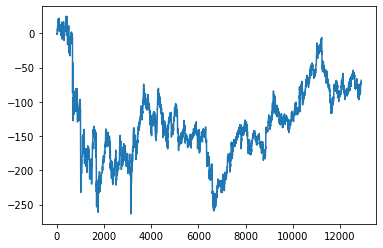

In [88]:
data1 = pd.read_csv('datahistory_1m_rnn.csv')

plt.plot(data1['money'])

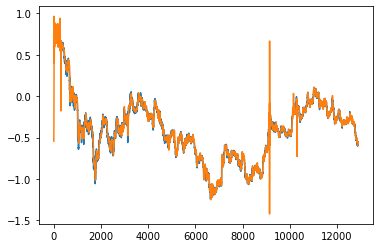

In [89]:
plt.plot(data1['closes'])
plt.plot(data1['predictionBefore'])
plt.show()

## LSTM 

In [90]:
df_history_past = pd.DataFrame(data={"time": [], "opens": [], "highs": [], "lows": [], "closes": [], "volumes": [], "qavs": [], "numTrades": [], "tbbavs": [], "tbqavs": [], "rsis": [],"obvs": [], "money": [], "trueAfter": [], "predictionBefore": [], "action": [], "correct": [], "diff": []})
invertedData = scaler.inverse_transform(dataLast)

hidden_squeeze_lstm = tuple([torch.squeeze(h, 1) for h in hidden_lstm])

countBuy = 0
countDontBuy = 0
correctBuy = 0
correctDontBuy = 0
boughtPrev = False
closePrev = float(0)
money = float(0)
action = ""


for i in range(len(dataLast)):
    curr_df = dataLast.iloc[i]
    currData = np.array(dataLast.iloc[i].to_numpy())
    curr_close = currData[3]
    
    if(countDontBuy + countBuy > 0):
        prevData = np.array(dataLast.iloc[i-1].to_numpy())
        prev_close = prevData[3]
        
        truePred = curr_close

        print("\nBack Propogate... \n")

        hidden_squeeze_lstm = tuple([h.detach() for h in hidden_squeeze_lstm])
        pred =  torch.squeeze(pred, 1)
        pred =  torch.squeeze(pred, 0)
        truePred = torch.tensor(truePred)
        truePred = truePred.to(torch.float)

        single_loss = loss_function(pred, truePred)
        single_loss.backward()
        clip_grad_norm_(trained_lstm_model.parameters(), 5)
        optimizer_lstm.step()
        optimizer_lstm.zero_grad()

        prediction = float(pred.item())
        #print("CORRECT?: ", float(truePred.item()), prediction, closePrev)

        if(truePred > closePrev and prediction > closePrev):
            correctBuy += 1
            curr_df['correct'] = [1]
        elif(truePred < closePrev and prediction < closePrev):
            correctDontBuy += 1
            curr_df['correct'] = [1]
        else:
            curr_df['correct'] = [0]
        print("COUNTBUY: ", countBuy , "CORRECTBUY: ", correctBuy, "COUNTDONTBUY: ", countDontBuy, "CORRECTDONTBUY: ", correctDontBuy)
        
        print(prediction)
        curr_df['action'] = action
        curr_df['diff'] = float(prediction - curr_close)
        curr_df['time'] = time
        curr_df['money'] = float(money)
        curr_df['trueAfter'] = float(curr_close)
        curr_df['predictionBefore'] = float(prediction)
        df_history_past = df_history_past.append(curr_df, ignore_index = True)

    if(boughtPrev):
        print(invertedData[i][3], invertedData[i][3])
        change = invertedData[i][3] - invertedData[i-1][3]
        money += change
        print('NEW PRICE: ', close, 'BOUGHT PRICE: ', closePrev, 'CHANGE: ', change, 'MONEY: ', money)
        boughtPrev = False
    
    
    data = torch.tensor(currData)
    data = data.to(torch.float)
    data = data[None]
    print("HERE")
    for x in hidden_squeeze_lstm:
        print(np.shape(x))
    pred, hidden_squeeze_lstm = trained_lstm_model(data, hidden_squeeze_lstm)
    
    #print('PREDICTION', pred)
    prediction = float(pred.item())
    print(prediction)
    
    if(prediction > curr_close):
        countBuy += 1
        action = "BUY"
        print("BUY AT: ", curr_close, 'TIME: ', time)
        boughtPrev = True
    else:
        action = "DONT BUY"
        countDontBuy += 1
        print("DONT BUY")
    closePrev = curr_close

    
df_history_past.to_csv("./data/datahistory_1m_lstm.csv", sep=',',index=False)


HERE
torch.Size([1, 24])
torch.Size([1, 24])
1.813924789428711
BUY AT:  0.6117018438469993 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1 CORRECTBUY:  0 COUNTDONTBUY:  0 CORRECTDONTBUY:  0
1.813924789428711
2777.59 2777.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6117018438469993 CHANGE:  -2.25 MONEY:  -2.25
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5772880911827087
DONT BUY

Back Propogate... 

COUNTBUY:  1 CORRECTBUY:  0 COUNTDONTBUY:  1 CORRECTDONTBUY:  0
0.5772880911827087
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.00936281681060791
DONT BUY

Back Propogate... 

COUNTBUY:  1 CORRECTBUY:  0 COUNTDONTBUY:  2 CORRECTDONTBUY:  0
0.00936281681060791
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.003500640392303467
DONT BUY

Back Propogate... 

COUNTBUY:  1 CORRECTBUY:  0 COUNTDONTBUY:  3 CORRECTDONTBUY:  1
0.003500640392303467
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.011728346347808838
DONT BUY

Back

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2783.58 2783.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6309906825586399 CHANGE:  -1.650000000000091 MONEY:  0.25
HERE
torch.Size([1, 24])
torch.Size([1, 24])
1.004880428314209
BUY AT:  0.6250859360142597 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6 CORRECTBUY:  2 COUNTDONTBUY:  6 CORRECTDONTBUY:  3
1.004880428314209
2783.56 2783.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6250859360142597 CHANGE:  -0.01999999999998181 MONEY:  0.2300000000000182
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6020042896270752
DONT BUY

Back Propogate... 

COUNTBUY:  6 CORRECTBUY:  2 COUNTDONTBUY:  7 CORRECTDONTBUY:  4
0.6020042896270752
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2484874725341797
DONT BUY

Back Propogate... 

COUNTBUY:  6 CORRECTBUY:  2 COUNTDONTBUY:  8 CORRECTDONTBUY:  5
0.2484874725341797
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.09671095013618469
DONT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2779.86 2779.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6050813704487539 CHANGE:  1.8700000000003456 MONEY:  3.5900000000001455
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.8693960905075073
BUY AT:  0.6117734165323857 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  9 CORRECTBUY:  5 COUNTDONTBUY:  16 CORRECTDONTBUY:  9
0.8693960905075073
2782.35 2782.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6117734165323857 CHANGE:  2.4899999999997817 MONEY:  6.079999999999927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7631733417510986
BUY AT:  0.6206842158629946 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  10 CORRECTBUY:  6 COUNTDONTBUY:  16 CORRECTDONTBUY:  9
0.7631733417510986
2783.65 2783.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6206842158629946 CHANGE:  1.300000000000182 MONEY:  7.380000000000109


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.038283348083496094
DONT BUY

Back Propogate... 

COUNTBUY:  14 CORRECTBUY:  8 COUNTDONTBUY:  24 CORRECTDONTBUY:  12
0.038283348083496094
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.24470560252666473
DONT BUY

Back Propogate... 

COUNTBUY:  14 CORRECTBUY:  8 COUNTDONTBUY:  25 CORRECTDONTBUY:  12
0.24470560252666473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5678840279579163
DONT BUY

Back Propogate... 

COUNTBUY:  14 CORRECTBUY:  8 COUNTDONTBUY:  26 CORRECTDONTBUY:  13
0.5678840279579163
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.798865020275116
BUY AT:  0.7381707789248075 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  15 CORRECTBUY:  9 COUNTDONTBUY:  26 CORRECTDONTBUY:  13
0.798865020275116
2819.45 2819.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7381707789248075 CHANGE:  4.269999999999982 MONEY:  17.86999999999989
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

1.0634276866912842
BUY AT:  0.7838699385440384 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  21 CORRECTBUY:  13 COUNTDONTBUY:  29 CORRECTDONTBUY:  14
1.0634276866912842
2826.1 2826.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7838699385440384 CHANGE:  -1.849999999999909 MONEY:  21.480000000000018
HERE
torch.Size([1, 24])
torch.Size([1, 24])
1.094515085220337
BUY AT:  0.7772494651457946 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  22 CORRECTBUY:  14 COUNTDONTBUY:  29 CORRECTDONTBUY:  14
1.094515085220337
2827.53 2827.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7772494651457946 CHANGE:  1.430000000000291 MONEY:  22.91000000000031
HERE
torch.Size([1, 24])
torch.Size([1, 24])
1.0798382759094238
BUY AT:  0.7823669121509249 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  23 CORRECTBUY:  15 COUNTDONTBUY:  29 CORRECTDONTBUY:  14
1.079838

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.655098557472229
DONT BUY

Back Propogate... 

COUNTBUY:  28 CORRECTBUY:  18 COUNTDONTBUY:  34 CORRECTDONTBUY:  17
0.655098557472229
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6408743262290955
DONT BUY

Back Propogate... 

COUNTBUY:  28 CORRECTBUY:  18 COUNTDONTBUY:  35 CORRECTDONTBUY:  17
0.6408743262290955
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6369649171829224
DONT BUY

Back Propogate... 

COUNTBUY:  28 CORRECTBUY:  18 COUNTDONTBUY:  36 CORRECTDONTBUY:  17
0.6369649171829224
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6289348602294922
DONT BUY

Back Propogate... 

COUNTBUY:  28 CORRECTBUY:  18 COUNTDONTBUY:  37 CORRECTDONTBUY:  17
0.6289348602294922
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6340579390525818
DONT BUY

Back Propogate... 

COUNTBUY:  28 CORRECTBUY:  18 COUNTDONTBUY:  38 CORRECTDONTBUY:  18
0.6340579390525818
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6489650011062622
DONT BUY

Back Propogate... 

COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7452892661094666
DONT BUY

Back Propogate... 

COUNTBUY:  28 CORRECTBUY:  18 COUNTDONTBUY:  43 CORRECTDONTBUY:  21
0.7452892661094666
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7733911871910095
DONT BUY

Back Propogate... 

COUNTBUY:  28 CORRECTBUY:  18 COUNTDONTBUY:  44 CORRECTDONTBUY:  21
0.7733911871910095
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.8049126267433167
BUY AT:  0.7920292246780913 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  29 CORRECTBUY:  19 COUNTDONTBUY:  44 CORRECTDONTBUY:  21
0.8049126267433167
2832.44 2832.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7920292246780913 CHANGE:  2.2100000000000364 MONEY:  29.93000000000029
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.8210380673408508
BUY AT:  0.7999380064132913 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  30 CORRECTBUY:  20 COUNTDONTBUY:  44 CORRECTDONTBUY:  21
0.82103806

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7569943951814375 CHANGE:  -0.07000000000016371 MONEY:  17.860000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7849556803703308
BUY AT:  0.7567438907825844 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  39 CORRECTBUY:  23 COUNTDONTBUY:  44 CORRECTDONTBUY:  21
0.7849556803703308
2820.33 2820.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7567438907825844 CHANGE:  -0.03999999999996362 MONEY:  17.820000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7714807391166687
BUY AT:  0.7566007454118117 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  40 CORRECTBUY:  24 COUNTDONTBUY:  44 CORRECTDONTBUY:  21
0.7714807391166687
2823.95 2823.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7566007454118117 CHANGE:  3.619999999999891 MONEY:  21.440000000000055
HERE
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  40 CORRECTBUY:  24 COUNTDONTBUY:  55 CORRECTDONTBUY:  26
0.7179974317550659
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7155779600143433
DONT BUY

Back Propogate... 

COUNTBUY:  40 CORRECTBUY:  24 COUNTDONTBUY:  56 CORRECTDONTBUY:  26
0.7155779600143433
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7239094972610474
DONT BUY

Back Propogate... 

COUNTBUY:  40 CORRECTBUY:  24 COUNTDONTBUY:  57 CORRECTDONTBUY:  26
0.7239094972610474
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7351065278053284
DONT BUY

Back Propogate... 

COUNTBUY:  40 CORRECTBUY:  24 COUNTDONTBUY:  58 CORRECTDONTBUY:  27
0.7351065278053284
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7482574582099915
DONT BUY

Back Propogate... 

COUNTBUY:  40 CORRECTBUY:  24 COUNTDONTBUY:  59 CORRECTDONTBUY:  27
0.7482574582099915
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7657507658004761
DONT BUY

Back Propogate... 

COUNTBUY:  40 CORRECTBUY:  24 COUNTDONTBUY:  60 CORRECTDONTBUY:  28
0.7657507658004761
HERE
tor

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2825.26 2825.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7780367646850462 CHANGE:  -1.0599999999999454 MONEY:  19.940000000000055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.8141066431999207
BUY AT:  0.774243412359566 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  47 CORRECTBUY:  27 COUNTDONTBUY:  61 CORRECTDONTBUY:  28
0.8141066431999207
2823.18 2823.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.774243412359566 CHANGE:  -2.080000000000382 MONEY:  17.859999999999673
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.8096414804458618
BUY AT:  0.7667998530793766 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  48 CORRECTBUY:  27 COUNTDONTBUY:  61 CORRECTDONTBUY:  28
0.8096414804458618
2819.08 2819.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7667998530793766 CHANGE:  -4.099999999999909 MONEY:  13.759999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6923500895500183
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  28 COUNTDONTBUY:  65 CORRECTDONTBUY:  30
0.6923500895500183
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6963742971420288
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  28 COUNTDONTBUY:  66 CORRECTDONTBUY:  31
0.6963742971420288
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6913148760795593
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  28 COUNTDONTBUY:  67 CORRECTDONTBUY:  31
0.6913148760795593
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6900078654289246
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  28 COUNTDONTBUY:  68 CORRECTDONTBUY:  31
0.6900078654289246
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6571897864341736
DONT BUY

Back Propogate... 

COUNTBUY:  55 CORRECTBUY:  28 COUNTDONTBUY:  69 CORRECTDONTBUY:  32
0.6571897864341736
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.670752227306366
DONT BUY

Back Propogate... 

CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  57 CORRECTBUY:  28 COUNTDONTBUY:  75 CORRECTDONTBUY:  36
0.719068169593811
2807.06 2807.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7091122686579202 CHANGE:  0.0 MONEY:  5.690000000000055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7138318419456482
BUY AT:  0.7091122686579202 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  58 CORRECTBUY:  28 COUNTDONTBUY:  75 CORRECTDONTBUY:  36
0.7138318419456482
2806.56 2806.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7091122686579202 CHANGE:  -0.5 MONEY:  5.190000000000055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7246224284172058
BUY AT:  0.7073229515232596 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  59 CORRECTBUY:  29 COUNTDONTBUY:  75 CORRECTDONTBUY:  36
0.7246224284172058
2807.23 2807.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.707322951

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.52909255027771
DONT BUY

Back Propogate... 

COUNTBUY:  64 CORRECTBUY:  32 COUNTDONTBUY:  80 CORRECTDONTBUY:  40
0.52909255027771
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.35020631551742554
DONT BUY

Back Propogate... 

COUNTBUY:  64 CORRECTBUY:  32 COUNTDONTBUY:  81 CORRECTDONTBUY:  41
0.35020631551742554
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7212642431259155
DONT BUY

Back Propogate... 

COUNTBUY:  64 CORRECTBUY:  32 COUNTDONTBUY:  82 CORRECTDONTBUY:  42
0.7212642431259155
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.768235981464386
BUY AT:  0.7171284094212004 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  65 CORRECTBUY:  32 COUNTDONTBUY:  82 CORRECTDONTBUY:  42
0.768235981464386
2808.06 2808.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7171284094212004 CHANGE:  -1.2400000000002365 MONEY:  13.569999999999709
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7811369895935059
BUY AT:  0.7126909029272414

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2808.36 2808.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7137644932080384 CHANGE:  0.0 MONEY:  13.86999999999989
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7519598007202148
BUY AT:  0.7137644932080384 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  74 CORRECTBUY:  36 COUNTDONTBUY:  82 CORRECTDONTBUY:  42
0.7519598007202148
2807.94 2807.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7137644932080384 CHANGE:  -0.42000000000007276 MONEY:  13.449999999999818
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7283850312232971
BUY AT:  0.7122614668149232 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  75 CORRECTBUY:  37 COUNTDONTBUY:  82 CORRECTDONTBUY:  42
0.7283850312232971
2809.42 2809.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7122614668149232 CHANGE:  1.4800000000000182 MONEY:  14.929999999999836
HERE
t

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  76 CORRECTBUY:  38 COUNTDONTBUY:  92 CORRECTDONTBUY:  46
0.6739541292190552
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6892831325531006
DONT BUY

Back Propogate... 

COUNTBUY:  76 CORRECTBUY:  38 COUNTDONTBUY:  93 CORRECTDONTBUY:  46
0.6892831325531006
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6974422931671143
DONT BUY

Back Propogate... 

COUNTBUY:  76 CORRECTBUY:  38 COUNTDONTBUY:  94 CORRECTDONTBUY:  46
0.6974422931671143
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.799234926700592
BUY AT:  0.7730982493933827 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  77 CORRECTBUY:  39 COUNTDONTBUY:  94 CORRECTDONTBUY:  46
0.799234926700592
2828.66 2828.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7730982493933827 CHANGE:  3.7199999999998 MONEY:  19.139999999999418
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7074065804481506
DONT BUY

Back Propogate... 

COUNTBUY:  77 CORRECTBUY:  39 COUNTDONTBUY:  95 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2827.54 2827.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7755317206965204 CHANGE:  1.9200000000000728 MONEY:  16.67999999999938
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.8463782072067261
BUY AT:  0.7824026984936173 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  83 CORRECTBUY:  42 COUNTDONTBUY:  99 CORRECTDONTBUY:  49
0.8463782072067261
2826.29 2826.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7824026984936173 CHANGE:  -1.25 MONEY:  15.429999999999382
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.8397288918495178
BUY AT:  0.7779294056569659 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  84 CORRECTBUY:  42 COUNTDONTBUY:  99 CORRECTDONTBUY:  49
0.8397288918495178
2819.66 2819.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7779294056569659 CHANGE:  -6.630000000000109 MONEY:  8.799999999999272
HERE
to

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7523684501647949
DONT BUY

Back Propogate... 

COUNTBUY:  88 CORRECTBUY:  45 COUNTDONTBUY:  107 CORRECTDONTBUY:  54
0.7523684501647949
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7541747689247131
DONT BUY

Back Propogate... 

COUNTBUY:  88 CORRECTBUY:  45 COUNTDONTBUY:  108 CORRECTDONTBUY:  54
0.7541747689247131
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7515273094177246
DONT BUY

Back Propogate... 

COUNTBUY:  88 CORRECTBUY:  45 COUNTDONTBUY:  109 CORRECTDONTBUY:  54
0.7515273094177246
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7583099007606506
DONT BUY

Back Propogate... 

COUNTBUY:  88 CORRECTBUY:  45 COUNTDONTBUY:  110 CORRECTDONTBUY:  54
0.7583099007606506
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7576360702514648
DONT BUY

Back Propogate... 

COUNTBUY:  88 CORRECTBUY:  45 COUNTDONTBUY:  111 CORRECTDONTBUY:  54
0.7576360702514648
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7661260962486267
DONT BUY

Back Propogate..

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2839.76 2839.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.8226623340234802 CHANGE:  0.9700000000002547 MONEY:  23.45999999999958
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.8802955746650696
BUY AT:  0.8261336092647226 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  93 CORRECTBUY:  48 COUNTDONTBUY:  115 CORRECTDONTBUY:  56
0.8802955746650696
2838.31 2838.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.8261336092647226 CHANGE:  -1.4500000000002728 MONEY:  22.00999999999931
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.8837281465530396
BUY AT:  0.8209445895742059 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  94 CORRECTBUY:  49 COUNTDONTBUY:  115 CORRECTDONTBUY:  56
0.8837281465530396
2838.91 2838.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.8209445895742059 CHANGE:  0.599999999999909 MONEY:  22.60999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7880569406391444 CHANGE:  -0.6199999999998909 MONEY:  12.199999999999363
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7841984033584595
DONT BUY

Back Propogate... 

COUNTBUY:  104 CORRECTBUY:  51 COUNTDONTBUY:  116 CORRECTDONTBUY:  57
0.7841984033584595
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7743455171585083
DONT BUY

Back Propogate... 

COUNTBUY:  104 CORRECTBUY:  51 COUNTDONTBUY:  117 CORRECTDONTBUY:  58
0.7743455171585083
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7704513072967529
BUY AT:  0.7654041857143419 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  105 CORRECTBUY:  51 COUNTDONTBUY:  117 CORRECTDONTBUY:  58
0.7704513072967529
2813.17 2813.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7654041857143419 CHANGE:  -9.61999999999989 MONEY:  2.5799999999994725
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.9135023355484009
BU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6653813578868165 CHANGE:  6.539999999999964 MONEY:  3.5299999999992906
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7274751663208008
BUY AT:  0.6887856260081767 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  108 CORRECTBUY:  53 COUNTDONTBUY:  125 CORRECTDONTBUY:  63
0.7274751663208008
2802.06 2802.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6887856260081767 CHANGE:  0.6799999999998363 MONEY:  4.209999999999127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7289841771125793
BUY AT:  0.6912190973113145 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  109 CORRECTBUY:  54 COUNTDONTBUY:  125 CORRECTDONTBUY:  63
0.7289841771125793
2802.74 2802.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6912190973113145 CHANGE:  0.6799999999998363 MONEY:  4.889999999998963
HERE
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2802.23 2802.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7015971366923461 CHANGE:  -2.730000000000018 MONEY:  9.829999999999018
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.7068841457366943
BUY AT:  0.6918274651370994 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  115 CORRECTBUY:  58 COUNTDONTBUY:  131 CORRECTDONTBUY:  67
0.7068841457366943
2805.33 2805.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6918274651370994 CHANGE:  3.099999999999909 MONEY:  12.929999999998927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.70570307970047
BUY AT:  0.7029212313719946 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  116 CORRECTBUY:  58 COUNTDONTBUY:  131 CORRECTDONTBUY:  67
0.70570307970047
2804.37 2804.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.7029212313719946 CHANGE:  -0.9600000000000364 MONEY:  11.969999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.6448836922645569
BUY AT:  0.6434801161585699 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  124 CORRECTBUY:  62 COUNTDONTBUY:  133 CORRECTDONTBUY:  69
0.6448836922645569
2791.32 2791.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6434801161585699 CHANGE:  2.600000000000364 MONEY:  3.239999999999327
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6601083874702454
BUY AT:  0.6527845652588061 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  125 CORRECTBUY:  62 COUNTDONTBUY:  133 CORRECTDONTBUY:  69
0.6601083874702454
2790.0 2790.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6527845652588061 CHANGE:  -1.3200000000001637 MONEY:  1.9199999999991633
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6553401947021484
BUY AT:  0.6480607680233017 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  126 CORRECTBUY:  62 COUNTDONTBUY:  133 CORRECTDONTBUY:  69

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.6730857491493225
BUY AT:  0.619109616784493 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  133 CORRECTBUY:  67 COUNTDONTBUY:  137 CORRECTDONTBUY:  70
0.6730857491493225
2785.75 2785.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.619109616784493 CHANGE:  3.8400000000001455 MONEY:  -10.740000000000691
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6877202987670898
BUY AT:  0.6328515723786868 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  134 CORRECTBUY:  68 COUNTDONTBUY:  137 CORRECTDONTBUY:  70
0.6877202987670898
2791.7 2791.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6328515723786868 CHANGE:  5.949999999999818 MONEY:  -4.790000000000873
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6826487183570862
BUY AT:  0.654144446281147 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  135 CORRECTBUY:  68 COUNTDONTBUY:  137 CORRECTDONTBUY:  70
0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2780.55 2780.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6186801806721749 CHANGE:  -1.2399999999997817 MONEY:  -15.94000000000051
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6353833675384521
BUY AT:  0.6142426741782175 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  146 CORRECTBUY:  72 COUNTDONTBUY:  137 CORRECTDONTBUY:  70
0.6353833675384521
2779.0 2779.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6142426741782175 CHANGE:  -1.550000000000182 MONEY:  -17.49000000000069
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6219565868377686
BUY AT:  0.6086957910607691 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  147 CORRECTBUY:  73 COUNTDONTBUY:  137 CORRECTDONTBUY:  70
0.6219565868377686
2783.69 2783.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6086957910607691 CHANGE:  4.690000000000055 MONEY:  -12.80000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  148 CORRECTBUY:  74 COUNTDONTBUY:  148 CORRECTDONTBUY:  76
0.5907508134841919
2774.78 2774.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5899079611468331 CHANGE:  1.0300000000002 MONEY:  -11.770000000000437
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6182247400283813
BUY AT:  0.5935939544442346 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  149 CORRECTBUY:  74 COUNTDONTBUY:  148 CORRECTDONTBUY:  76
0.6182247400283813
2765.76 2765.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5935939544442346 CHANGE:  -9.019999999999982 MONEY:  -20.79000000000042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5952876210212708
BUY AT:  0.5613146733349579 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  150 CORRECTBUY:  75 COUNTDONTBUY:  148 CORRECTDONTBUY:  76
0.5952876210212708
2769.32 2769.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.5201241374015808
DONT BUY

Back Propogate... 

COUNTBUY:  157 CORRECTBUY:  77 COUNTDONTBUY:  152 CORRECTDONTBUY:  78
0.5201241374015808
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5543016791343689
DONT BUY

Back Propogate... 

COUNTBUY:  157 CORRECTBUY:  77 COUNTDONTBUY:  153 CORRECTDONTBUY:  79
0.5543016791343689
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5268360376358032
DONT BUY

Back Propogate... 

COUNTBUY:  157 CORRECTBUY:  77 COUNTDONTBUY:  154 CORRECTDONTBUY:  79
0.5268360376358032
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4861694574356079
DONT BUY

Back Propogate... 

COUNTBUY:  157 CORRECTBUY:  77 COUNTDONTBUY:  155 CORRECTDONTBUY:  79
0.4861694574356079
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4932815730571747
DONT BUY

Back Propogate... 

COUNTBUY:  157 CORRECTBUY:  77 COUNTDONTBUY:  156 CORRECTDONTBUY:  79
0.4932815730571747
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.503329873085022
DONT BUY

Back Propogate... 

COUNTBUY:  157 CORRECTBUY:  77 COUNTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  159 CORRECTBUY:  78 COUNTDONTBUY:  163 CORRECTDONTBUY:  83
0.6033114790916443
2766.99 2766.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5787426222265515 CHANGE:  -3.6400000000003274 MONEY:  -19.740000000000236
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6047731637954712
BUY AT:  0.5657163934862214 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  160 CORRECTBUY:  79 COUNTDONTBUY:  163 CORRECTDONTBUY:  83
0.6047731637954712
2770.14 2770.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5657163934862214 CHANGE:  3.150000000000091 MONEY:  -16.590000000000146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6080377101898193
BUY AT:  0.5769890914345833 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  161 CORRECTBUY:  79 COUNTDONTBUY:  163 CORRECTDONTBUY:  83
0.6080377101898193
2769.65 2769.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2784.62 2784.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6241912774469294 CHANGE:  1.2899999999999636 MONEY:  -9.190000000000055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6352152228355408
BUY AT:  0.6288077156543536 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  170 CORRECTBUY:  83 COUNTDONTBUY:  165 CORRECTDONTBUY:  83
0.6352152228355408
2782.71 2782.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6288077156543536 CHANGE:  -1.9099999999998545 MONEY:  -11.099999999999909
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6341944932937622
BUY AT:  0.6219725241999506 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  171 CORRECTBUY:  83 COUNTDONTBUY:  165 CORRECTDONTBUY:  83
0.6341944932937622
2781.48 2781.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6219725241999506 CHANGE:  -1.2300000000000182 MONEY:  -12.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.6178651452064514
DONT BUY

Back Propogate... 

COUNTBUY:  177 CORRECTBUY:  87 COUNTDONTBUY:  166 CORRECTDONTBUY:  83
0.6178651452064514
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6150659322738647
DONT BUY

Back Propogate... 

COUNTBUY:  177 CORRECTBUY:  87 COUNTDONTBUY:  167 CORRECTDONTBUY:  84
0.6150659322738647
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6148785352706909
DONT BUY

Back Propogate... 

COUNTBUY:  177 CORRECTBUY:  87 COUNTDONTBUY:  168 CORRECTDONTBUY:  84
0.6148785352706909
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.617658793926239
DONT BUY

Back Propogate... 

COUNTBUY:  177 CORRECTBUY:  87 COUNTDONTBUY:  169 CORRECTDONTBUY:  84
0.617658793926239
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6199983358383179
DONT BUY

Back Propogate... 

COUNTBUY:  177 CORRECTBUY:  87 COUNTDONTBUY:  170 CORRECTDONTBUY:  85
0.6199983358383179
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6237385272979736
DONT BUY

Back Propogate... 

COUNTBUY:  177 CORRECTBUY:  87 COUNTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.6375216245651245
BUY AT:  0.6164256410825022 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  182 CORRECTBUY:  88 COUNTDONTBUY:  172 CORRECTDONTBUY:  86
0.6375216245651245
2780.61 2780.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6164256410825022 CHANGE:  -0.5499999999997272 MONEY:  -9.0
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6336987018585205
BUY AT:  0.6144573922343766 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  183 CORRECTBUY:  89 COUNTDONTBUY:  172 CORRECTDONTBUY:  86
0.6336987018585205
2782.05 2782.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6144573922343766 CHANGE:  1.4400000000000546 MONEY:  -7.559999999999945
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6308373808860779
BUY AT:  0.6196106255821993 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  184 CORRECTBUY:  89 COUNTDONTBUY:  172 CORRECTDONTBUY:  86
0.6308373

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2782.46 2782.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6210778656326204 CHANGE:  0.0 MONEY:  -1.0799999999999272
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6196028590202332
DONT BUY

Back Propogate... 

COUNTBUY:  189 CORRECTBUY:  93 COUNTDONTBUY:  178 CORRECTDONTBUY:  91
0.6196028590202332
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6182799339294434
DONT BUY

Back Propogate... 

COUNTBUY:  189 CORRECTBUY:  93 COUNTDONTBUY:  179 CORRECTDONTBUY:  91
0.6182799339294434
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6190017461776733
DONT BUY

Back Propogate... 

COUNTBUY:  189 CORRECTBUY:  93 COUNTDONTBUY:  180 CORRECTDONTBUY:  91
0.6190017461776733
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.617497444152832
DONT BUY

Back Propogate... 

COUNTBUY:  189 CORRECTBUY:  93 COUNTDONTBUY:  181 CORRECTDONTBUY:  92
0.617497444152832
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6113544702529907
DONT BUY

Back Propogate... 

COUNTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6006956100463867
DONT BUY

Back Propogate... 

COUNTBUY:  193 CORRECTBUY:  94 COUNTDONTBUY:  185 CORRECTDONTBUY:  93
0.6006956100463867
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6031524538993835
DONT BUY

Back Propogate... 

COUNTBUY:  193 CORRECTBUY:  94 COUNTDONTBUY:  186 CORRECTDONTBUY:  93
0.6031524538993835
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5977899432182312
DONT BUY

Back Propogate... 

COUNTBUY:  193 CORRECTBUY:  94 COUNTDONTBUY:  187 CORRECTDONTBUY:  94
0.5977899432182312
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.602709174156189
DONT BUY

Back Propogate... 

COUNTBUY:  193 CORRECTBUY:  94 COUNTDONTBUY:  188 CORRECTDONTBUY:  95
0.602709174156189
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.600253701210022
BUY AT:  0.5964210755169981 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  194 CORRECTBUY:  95 COUNTDONTBUY:  188 CORRECTDONTBUY:  95
0.600253701210022
2775.76 2775.76
NEW PRICE:  tensor([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  197 CORRECTBUY:  98 COUNTDONTBUY:  193 CORRECTDONTBUY:  97
0.61449134349823
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6146689653396606
DONT BUY

Back Propogate... 

COUNTBUY:  197 CORRECTBUY:  98 COUNTDONTBUY:  194 CORRECTDONTBUY:  98
0.6146689653396606
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6133384704589844
BUY AT:  0.6105208945381236 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  198 CORRECTBUY:  98 COUNTDONTBUY:  194 CORRECTDONTBUY:  98
0.6133384704589844
2775.5 2775.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.6105208945381236 CHANGE:  -4.010000000000218 MONEY:  1.5399999999999636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6198024153709412
BUY AT:  0.5961705711181451 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  199 CORRECTBUY:  98 COUNTDONTBUY:  194 CORRECTDONTBUY:  98
0.6198024153709412
2774.65 2774.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.13639378547668457
DONT BUY

Back Propogate... 

COUNTBUY:  206 CORRECTBUY:  101 COUNTDONTBUY:  196 CORRECTDONTBUY:  98
0.13639378547668457
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.20249083638191223
DONT BUY

Back Propogate... 

COUNTBUY:  206 CORRECTBUY:  101 COUNTDONTBUY:  197 CORRECTDONTBUY:  99
0.20249083638191223
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.15705430507659912
DONT BUY

Back Propogate... 

COUNTBUY:  206 CORRECTBUY:  101 COUNTDONTBUY:  198 CORRECTDONTBUY:  100
0.15705430507659912
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.23468977212905884
DONT BUY

Back Propogate... 

COUNTBUY:  206 CORRECTBUY:  101 COUNTDONTBUY:  199 CORRECTDONTBUY:  101
0.23468977212905884
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3097102642059326
DONT BUY

Back Propogate... 

COUNTBUY:  206 CORRECTBUY:  101 COUNTDONTBUY:  200 CORRECTDONTBUY:  101
0.3097102642059326
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3007458448410034
DONT BUY

Back Propogate... 

COUNTBUY:  206 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5767265558242798
DONT BUY

Back Propogate... 

COUNTBUY:  208 CORRECTBUY:  103 COUNTDONTBUY:  207 CORRECTDONTBUY:  104
0.5767265558242798
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5894383192062378
BUY AT:  0.5875460625290816 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  209 CORRECTBUY:  103 COUNTDONTBUY:  207 CORRECTDONTBUY:  104
0.5894383192062378
2766.06 2766.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5875460625290816 CHANGE:  -7.0300000000002 MONEY:  -7.120000000000346
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.6937646865844727
BUY AT:  0.5623882636157532 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  210 CORRECTBUY:  104 COUNTDONTBUY:  207 CORRECTDONTBUY:  104
0.6937646865844727
2768.41 2768.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5623882636157532 CHANGE:  2.349999999999909 MONEY:  -

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2769.96 2769.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5655374617727562 CHANGE:  3.019999999999982 MONEY:  -3.2200000000002547
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5986558198928833
BUY AT:  0.576344937266106 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  220 CORRECTBUY:  109 COUNTDONTBUY:  207 CORRECTDONTBUY:  104
0.5986558198928833
2768.39 2768.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.576344937266106 CHANGE:  -1.5700000000001637 MONEY:  -4.790000000000418
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5796090364456177
BUY AT:  0.5707264814632713 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  221 CORRECTBUY:  110 COUNTDONTBUY:  207 CORRECTDONTBUY:  104
0.5796090364456177
2768.4 2768.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5707264814632713 CHANGE:  0.010000000000218279 MONEY:  -4.7

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5263927578926086
DONT BUY

Back Propogate... 

COUNTBUY:  221 CORRECTBUY:  110 COUNTDONTBUY:  219 CORRECTDONTBUY:  111
0.5263927578926086
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5355712175369263
BUY AT:  0.5318267269557508 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  222 CORRECTBUY:  110 COUNTDONTBUY:  219 CORRECTDONTBUY:  111
0.5355712175369263
2753.06 2753.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5318267269557508 CHANGE:  -4.460000000000036 MONEY:  -9.240000000000236
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.5356417894363403
BUY AT:  0.5158660181145783 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  223 CORRECTBUY:  110 COUNTDONTBUY:  219 CORRECTDONTBUY:  111
0.5356417894363403
2750.46 2750.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.5158660181145783 CHANGE:  -2.599999999999909 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.39418286085128784
DONT BUY

Back Propogate... 

COUNTBUY:  235 CORRECTBUY:  116 COUNTDONTBUY:  231 CORRECTDONTBUY:  116
0.39418286085128784
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4040987193584442
DONT BUY

Back Propogate... 

COUNTBUY:  235 CORRECTBUY:  116 COUNTDONTBUY:  232 CORRECTDONTBUY:  116
0.4040987193584442
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3895876705646515
DONT BUY

Back Propogate... 

COUNTBUY:  235 CORRECTBUY:  116 COUNTDONTBUY:  233 CORRECTDONTBUY:  117
0.3895876705646515
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4036143720149994
DONT BUY

Back Propogate... 

COUNTBUY:  235 CORRECTBUY:  116 COUNTDONTBUY:  234 CORRECTDONTBUY:  118
0.4036143720149994
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.41126805543899536
DONT BUY

Back Propogate... 

COUNTBUY:  235 CORRECTBUY:  116 COUNTDONTBUY:  235 CORRECTDONTBUY:  119
0.41126805543899536
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.39038074016571045
DONT BUY

Back Propogate... 

COUNTBUY:  235 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2723.12 2723.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4268295974938679 CHANGE:  -5.059999999999945 MONEY:  -24.190000000000055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4914955496788025
BUY AT:  0.4087217080911031 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  241 CORRECTBUY:  119 COUNTDONTBUY:  239 CORRECTDONTBUY:  123
0.4914955496788025
2723.44 2723.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4087217080911031 CHANGE:  0.3200000000001637 MONEY:  -23.86999999999989
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.49590498208999634
BUY AT:  0.4098668710572865 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  242 CORRECTBUY:  120 COUNTDONTBUY:  239 CORRECTDONTBUY:  123
0.49590498208999634
2724.22 2724.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4098668710572865 CHANGE:  0.7799999999997453 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  252 CORRECTBUY:  125 COUNTDONTBUY:  240 CORRECTDONTBUY:  124
0.3942927420139313
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4029335677623749
DONT BUY

Back Propogate... 

COUNTBUY:  252 CORRECTBUY:  125 COUNTDONTBUY:  241 CORRECTDONTBUY:  124
0.4029335677623749
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.38065266609191895
DONT BUY

Back Propogate... 

COUNTBUY:  252 CORRECTBUY:  125 COUNTDONTBUY:  242 CORRECTDONTBUY:  124
0.38065266609191895
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.39340412616729736
DONT BUY

Back Propogate... 

COUNTBUY:  252 CORRECTBUY:  125 COUNTDONTBUY:  243 CORRECTDONTBUY:  124
0.39340412616729736
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.35582536458969116
DONT BUY

Back Propogate... 

COUNTBUY:  252 CORRECTBUY:  125 COUNTDONTBUY:  244 CORRECTDONTBUY:  125
0.35582536458969116
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3647870123386383
DONT BUY

Back Propogate... 

COUNTBUY:  252 CORRECTBUY:  125 COUNTDONTBUY:  245 CORRECTDONTBUY:  1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  254 CORRECTBUY:  127 COUNTDONTBUY:  252 CORRECTDONTBUY:  129
0.4172630310058594
2727.87 2727.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4115846155065606 CHANGE:  3.949999999999818 MONEY:  -13.400000000000091
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3984946608543396
DONT BUY

Back Propogate... 

COUNTBUY:  254 CORRECTBUY:  127 COUNTDONTBUY:  253 CORRECTDONTBUY:  130
0.3984946608543396
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.40536224842071533
DONT BUY

Back Propogate... 

COUNTBUY:  254 CORRECTBUY:  127 COUNTDONTBUY:  254 CORRECTDONTBUY:  131
0.40536224842071533
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4304611086845398
BUY AT:  0.4049641421083169 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  255 CORRECTBUY:  127 COUNTDONTBUY:  254 CORRECTDONTBUY:  131
0.4304611086845398
2716.2 2716.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4049641421083

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.39073336124420166
BUY AT:  0.2976766867140689 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  265 CORRECTBUY:  130 COUNTDONTBUY:  254 CORRECTDONTBUY:  131
0.39073336124420166
2684.62 2684.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2976766867140689 CHANGE:  -7.470000000000255 MONEY:  -50.850000000000364
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3934197425842285
BUY AT:  0.2709442887222391 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  266 CORRECTBUY:  131 COUNTDONTBUY:  254 CORRECTDONTBUY:  131
0.3934197425842285
2690.13 2690.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2709442887222391 CHANGE:  5.510000000000218 MONEY:  -45.340000000000146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.37734222412109375
BUY AT:  0.2906625635461993 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  267 CORRECTBUY:  132 COUNTDONTBUY:  254 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2947620451450348
DONT BUY

Back Propogate... 

COUNTBUY:  269 CORRECTBUY:  134 COUNTDONTBUY:  264 CORRECTDONTBUY:  135
0.2947620451450348
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.28671133518218994
DONT BUY

Back Propogate... 

COUNTBUY:  269 CORRECTBUY:  134 COUNTDONTBUY:  265 CORRECTDONTBUY:  136
0.28671133518218994
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2896046042442322
DONT BUY

Back Propogate... 

COUNTBUY:  269 CORRECTBUY:  134 COUNTDONTBUY:  266 CORRECTDONTBUY:  136
0.2896046042442322
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.29418712854385376
DONT BUY

Back Propogate... 

COUNTBUY:  269 CORRECTBUY:  134 COUNTDONTBUY:  267 CORRECTDONTBUY:  136
0.29418712854385376
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.29867425560951233
DONT BUY

Back Propogate... 

COUNTBUY:  269 CORRECTBUY:  134 COUNTDONTBUY:  268 CORRECTDONTBUY:  136
0.29867425560951233
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.30278125405311584
DONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2701.19 2701.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.340870802344774 CHANGE:  -2.9699999999998 MONEY:  -33.86000000000013
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.36453139781951904
BUY AT:  0.330242258564891 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  274 CORRECTBUY:  135 COUNTDONTBUY:  273 CORRECTDONTBUY:  140
0.36453139781951904
2699.61 2699.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.330242258564891 CHANGE:  -1.5799999999999272 MONEY:  -35.440000000000055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.36491474509239197
BUY AT:  0.3245880164193638 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  275 CORRECTBUY:  136 COUNTDONTBUY:  273 CORRECTDONTBUY:  140
0.36491474509239197
2699.88 2699.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3245880164193638 CHANGE:  0.2699999999999818 MONEY:  -3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2883364512711402 CHANGE:  -3.130000000000109 MONEY:  -48.70000000000027
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.313281774520874
BUY AT:  0.2771353260081647 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  286 CORRECTBUY:  138 COUNTDONTBUY:  273 CORRECTDONTBUY:  140
0.313281774520874
2675.96 2675.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2771353260081647 CHANGE:  -10.389999999999873 MONEY:  -59.090000000000146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3023909032344818
BUY AT:  0.2399533159499184 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  287 CORRECTBUY:  139 COUNTDONTBUY:  273 CORRECTDONTBUY:  140
0.3023909032344818
2683.72 2683.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.2399533159499184 CHANGE:  7.7599999999997635 MONEY:  -51.33000000000038
HERE
torch.S

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2693369686603546
DONT BUY

Back Propogate... 

COUNTBUY:  288 CORRECTBUY:  140 COUNTDONTBUY:  282 CORRECTDONTBUY:  145
0.2693369686603546
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2720850110054016
DONT BUY

Back Propogate... 

COUNTBUY:  288 CORRECTBUY:  140 COUNTDONTBUY:  283 CORRECTDONTBUY:  146
0.2720850110054016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2722134292125702
DONT BUY

Back Propogate... 

COUNTBUY:  288 CORRECTBUY:  140 COUNTDONTBUY:  284 CORRECTDONTBUY:  146
0.2722134292125702
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2776753306388855
DONT BUY

Back Propogate... 

COUNTBUY:  288 CORRECTBUY:  140 COUNTDONTBUY:  285 CORRECTDONTBUY:  146
0.2776753306388855
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2814842164516449
DONT BUY

Back Propogate... 

COUNTBUY:  288 CORRECTBUY:  140 COUNTDONTBUY:  286 CORRECTDONTBUY:  147
0.2814842164516449
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2824670672416687
BUY AT:  0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.31355807185173035
BUY AT:  0.3100229749432262 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  142 COUNTDONTBUY:  293 CORRECTDONTBUY:  151
0.31355807185173035
2697.36 2697.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3100229749432262 CHANGE:  1.8200000000001637 MONEY:  -34.34999999999991
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3162764310836792
DONT BUY

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  142 COUNTDONTBUY:  294 CORRECTDONTBUY:  151
0.3162764310836792
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3194780945777893
DONT BUY

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  142 COUNTDONTBUY:  295 CORRECTDONTBUY:  151
0.3194780945777893
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3197571635246277
DONT BUY

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  142 COUNTDONTBUY:  296 CORRECTDONTBUY:  151
0.3197571635246277
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3247331380844116
DONT B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.36210235953330994
DONT BUY

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  142 COUNTDONTBUY:  307 CORRECTDONTBUY:  155
0.36210235953330994
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.36725395917892456
DONT BUY

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  142 COUNTDONTBUY:  308 CORRECTDONTBUY:  156
0.36725395917892456
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.37312179803848267
DONT BUY

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  142 COUNTDONTBUY:  309 CORRECTDONTBUY:  156
0.37312179803848267
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3802735209465027
DONT BUY

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  142 COUNTDONTBUY:  310 CORRECTDONTBUY:  156
0.3802735209465027
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3876865804195404
DONT BUY

Back Propogate... 

COUNTBUY:  290 CORRECTBUY:  142 COUNTDONTBUY:  311 CORRECTDONTBUY:  157
0.3876865804195404
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3958134651184082
DONT BUY

Back Propogate... 

COUNTBUY:  290 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.4185105860233307
DONT BUY

Back Propogate... 

COUNTBUY:  297 CORRECTBUY:  147 COUNTDONTBUY:  313 CORRECTDONTBUY:  158
0.4185105860233307
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.42214447259902954
DONT BUY

Back Propogate... 

COUNTBUY:  297 CORRECTBUY:  147 COUNTDONTBUY:  314 CORRECTDONTBUY:  159
0.42214447259902954
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4256564676761627
BUY AT:  0.4227141680841499 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  298 CORRECTBUY:  147 COUNTDONTBUY:  314 CORRECTDONTBUY:  159
0.4256564676761627
2725.97 2725.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4227141680841499 CHANGE:  -1.0600000000004002 MONEY:  -25.610000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4238893389701843
BUY AT:  0.4189208157586681 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  299 CORRECTBUY:  148 COUNTDONTBUY:  314 CORRECTDONTBUY:  159
0.4238893389701843
2728.32 2728.32

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.423931360244751
BUY AT:  0.3965543515754109 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  302 CORRECTBUY:  150 COUNTDONTBUY:  322 CORRECTDONTBUY:  164
0.423931360244751
2720.19 2720.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3965543515754109 CHANGE:  0.47000000000025466 MONEY:  -18.9399999999996
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4215729832649231
BUY AT:  0.3982363096819927 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  303 CORRECTBUY:  151 COUNTDONTBUY:  322 CORRECTDONTBUY:  164
0.4215729832649231
2720.83 2720.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3982363096819927 CHANGE:  0.6399999999998727 MONEY:  -18.299999999999727
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4231303334236145
BUY AT:  0.4005266356143578 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  304 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  312 CORRECTBUY:  155 COUNTDONTBUY:  322 CORRECTDONTBUY:  164
0.41105973720550537
2720.98 2720.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4047494240521578 CHANGE:  -1.0300000000002 MONEY:  -18.149999999999636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.4093701243400574
BUY AT:  0.4010634307547563 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  313 CORRECTBUY:  155 COUNTDONTBUY:  322 CORRECTDONTBUY:  164
0.4093701243400574
2717.97 2717.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.4010634307547563 CHANGE:  -3.0100000000002183 MONEY:  -21.159999999999854
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.40569162368774414
BUY AT:  0.3902917416040989 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  314 CORRECTBUY:  156 COUNTDONTBUY:  322 CORRECTDONTBUY:  164
0.40569162368774414
2719.09 2719.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.3716132342815399
DONT BUY

Back Propogate... 

COUNTBUY:  321 CORRECTBUY:  158 COUNTDONTBUY:  326 CORRECTDONTBUY:  166
0.3716132342815399
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3759254217147827
DONT BUY

Back Propogate... 

COUNTBUY:  321 CORRECTBUY:  158 COUNTDONTBUY:  327 CORRECTDONTBUY:  167
0.3759254217147827
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.37211573123931885
DONT BUY

Back Propogate... 

COUNTBUY:  321 CORRECTBUY:  158 COUNTDONTBUY:  328 CORRECTDONTBUY:  168
0.37211573123931885
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.37302565574645996
BUY AT:  0.3611616586518252 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  322 CORRECTBUY:  158 COUNTDONTBUY:  328 CORRECTDONTBUY:  168
0.37302565574645996
2708.43 2708.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3611616586518252 CHANGE:  -1.400000000000091 MONEY:  -20.1899999999996
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3713107705116272
BUY A

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2713.1 2713.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3589786917475389 CHANGE:  3.880000000000109 MONEY:  -11.30999999999949
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.36755383014678955
DONT BUY

Back Propogate... 

COUNTBUY:  327 CORRECTBUY:  161 COUNTDONTBUY:  334 CORRECTDONTBUY:  173
0.36755383014678955
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3581254482269287
DONT BUY

Back Propogate... 

COUNTBUY:  327 CORRECTBUY:  161 COUNTDONTBUY:  335 CORRECTDONTBUY:  174
0.3581254482269287
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.3684150278568268
BUY AT:  0.3494595245911451 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  328 CORRECTBUY:  162 COUNTDONTBUY:  335 CORRECTDONTBUY:  174
0.3684150278568268
2708.62 2708.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.3494595245911451 CHANGE:  2.0599999999999454 MONEY:  -9.249999999999545
HERE
torch.Size([1, 24])
torch.Si

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2654.51 2654.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1186018278772389 CHANGE:  12.460000000000036 MONEY:  -63.35999999999922
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2451523393392563
BUY AT:  0.1631916108729806 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  339 CORRECTBUY:  167 COUNTDONTBUY:  335 CORRECTDONTBUY:  174
0.2451523393392563
2661.74 2661.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1631916108729806 CHANGE:  7.229999999999563 MONEY:  -56.129999999999654
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.2680300176143646
BUY AT:  0.1890651366401708 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  340 CORRECTBUY:  168 COUNTDONTBUY:  335 CORRECTDONTBUY:  174
0.2680300176143646
2669.33 2669.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1890651366401708 CHANGE:  7.5900000000001455 MONEY:  -48

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.16459158062934875
BUY AT:  0.1583246682667033 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  348 CORRECTBUY:  173 COUNTDONTBUY:  338 CORRECTDONTBUY:  176
0.16459158062934875
2646.33 2646.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1583246682667033 CHANGE:  -6.820000000000164 MONEY:  -64.23999999999978
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.1561986356973648
BUY AT:  0.1339183825499325 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  349 CORRECTBUY:  173 COUNTDONTBUY:  338 CORRECTDONTBUY:  176
0.1561986356973648
2637.88 2637.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.1339183825499325 CHANGE:  -8.449999999999818 MONEY:  -72.6899999999996
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.1444820612668991
BUY AT:  0.1036789229741695 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  350 CORRECTBUY:  173 COUNTDONTBUY:  338 CORRECTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2619.8 2619.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0015089145850502 CHANGE:  10.470000000000255 MONEY:  -90.76999999999953
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.05166448652744293
BUY AT:  0.0389772153848435 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  361 CORRECTBUY:  180 COUNTDONTBUY:  338 CORRECTDONTBUY:  176
0.05166448652744293
2629.21 2629.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0389772153848435 CHANGE:  9.409999999999854 MONEY:  -81.35999999999967
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.04347884654998779
DONT BUY

Back Propogate... 

COUNTBUY:  361 CORRECTBUY:  180 COUNTDONTBUY:  339 CORRECTDONTBUY:  177
0.04347884654998779
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.035893671214580536
BUY AT:  0.0260583456725937 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  362 CORRECTBUY:  181 COUNTDONTBUY:  339 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  369 CORRECTBUY:  185 COUNTDONTBUY:  342 CORRECTDONTBUY:  179
-0.028819464147090912
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03336101770401001
DONT BUY

Back Propogate... 

COUNTBUY:  369 CORRECTBUY:  185 COUNTDONTBUY:  343 CORRECTDONTBUY:  179
-0.03336101770401001
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.036643579602241516
DONT BUY

Back Propogate... 

COUNTBUY:  369 CORRECTBUY:  185 COUNTDONTBUY:  344 CORRECTDONTBUY:  180
-0.036643579602241516
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03886820375919342
DONT BUY

Back Propogate... 

COUNTBUY:  369 CORRECTBUY:  185 COUNTDONTBUY:  345 CORRECTDONTBUY:  181
-0.03886820375919342
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04021155834197998
DONT BUY

Back Propogate... 

COUNTBUY:  369 CORRECTBUY:  185 COUNTDONTBUY:  346 CORRECTDONTBUY:  182
-0.04021155834197998
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04097024351358414
DONT BUY

Back Propogate... 

COUNTBUY:  369 CORRECTBUY:  185 COUNTDONTBUY:  347 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2594.81 2594.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0735708323853074 CHANGE:  6.460000000000036 MONEY:  -76.76999999999953
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.038461800664663315
BUY AT:  -0.0504528550054927 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  373 CORRECTBUY:  188 COUNTDONTBUY:  352 CORRECTDONTBUY:  186
-0.038461800664663315
2597.82 2597.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0504528550054927 CHANGE:  3.0100000000002183 MONEY:  -73.75999999999931
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.038667455315589905
BUY AT:  -0.0396811658548352 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  374 CORRECTBUY:  188 COUNTDONTBUY:  352 CORRECTDONTBUY:  186
-0.038667455315589905
2596.75 2596.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0396811658548352 CHANGE:  -1.07000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.014858933165669441
DONT BUY

Back Propogate... 

COUNTBUY:  375 CORRECTBUY:  189 COUNTDONTBUY:  363 CORRECTDONTBUY:  190
-0.014858933165669441
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.008927644230425358
DONT BUY

Back Propogate... 

COUNTBUY:  375 CORRECTBUY:  189 COUNTDONTBUY:  364 CORRECTDONTBUY:  191
-0.008927644230425358
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.005867397412657738
DONT BUY

Back Propogate... 

COUNTBUY:  375 CORRECTBUY:  189 COUNTDONTBUY:  365 CORRECTDONTBUY:  192
-0.005867397412657738
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.00825454667210579
BUY AT:  -0.0121256819810631 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  376 CORRECTBUY:  189 COUNTDONTBUY:  365 CORRECTDONTBUY:  192
-0.00825454667210579
2601.23 2601.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0121256819810631 CHANGE:  -4.289999999999964 MONEY:  -75.59999999999945
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03337526321411133
DONT BUY

Back Propogate... 

COUNTBUY:  378 CORRECTBUY:  191 COUNTDONTBUY:  374 CORRECTDONTBUY:  194
0.03337526321411133
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.039301592856645584
DONT BUY

Back Propogate... 

COUNTBUY:  378 CORRECTBUY:  191 COUNTDONTBUY:  375 CORRECTDONTBUY:  195
0.039301592856645584
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.043408699333667755
DONT BUY

Back Propogate... 

COUNTBUY:  378 CORRECTBUY:  191 COUNTDONTBUY:  376 CORRECTDONTBUY:  196
0.043408699333667755
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.05035629868507385
DONT BUY

Back Propogate... 

COUNTBUY:  378 CORRECTBUY:  191 COUNTDONTBUY:  377 CORRECTDONTBUY:  197
0.05035629868507385
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.05426263064146042
DONT BUY

Back Propogate... 

COUNTBUY:  378 CORRECTBUY:  191 COUNTDONTBUY:  378 CORRECTDONTBUY:  198
0.05426263064146042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.06004387140274

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2631.47 2631.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0738688995107246 CHANGE:  1.919999999999618 MONEY:  -59.63999999999942
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.08470530807971954
BUY AT:  0.0807398773078199 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  383 CORRECTBUY:  195 COUNTDONTBUY:  382 CORRECTDONTBUY:  201
0.08470530807971954
2624.1 2624.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0807398773078199 CHANGE:  -7.369999999999891 MONEY:  -67.00999999999931
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.07497580349445343
BUY AT:  0.0543653427429234 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  384 CORRECTBUY:  196 COUNTDONTBUY:  382 CORRECTDONTBUY:  201
0.07497580349445343
2624.78 2624.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0543653427429234 CHANGE:  0.680000000000291 MONEY:  -66

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2617.85 2617.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0520750168105583 CHANGE:  -5.610000000000127 MONEY:  -73.25999999999931
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.07957398146390915
BUY AT:  0.0319988785596663 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  395 CORRECTBUY:  201 COUNTDONTBUY:  382 CORRECTDONTBUY:  201
0.07957398146390915
2616.48 2616.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0319988785596663 CHANGE:  -1.3699999999998909 MONEY:  -74.6299999999992
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.07682804018259048
BUY AT:  0.0270961496106967 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  396 CORRECTBUY:  201 COUNTDONTBUY:  382 CORRECTDONTBUY:  201
0.07682804018259048
2613.34 2613.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0270961496106967 CHANGE:  -3.1399999999998727 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03982633352279663
DONT BUY

Back Propogate... 

COUNTBUY:  401 CORRECTBUY:  205 COUNTDONTBUY:  388 CORRECTDONTBUY:  206
0.03982633352279663
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.037845682352781296
BUY AT:  0.027167722296083 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  402 CORRECTBUY:  206 COUNTDONTBUY:  388 CORRECTDONTBUY:  206
0.037845682352781296
2619.6 2619.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.027167722296083 CHANGE:  3.099999999999909 MONEY:  -58.52999999999929
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03656366467475891
DONT BUY

Back Propogate... 

COUNTBUY:  402 CORRECTBUY:  206 COUNTDONTBUY:  389 CORRECTDONTBUY:  206
0.03656366467475891
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.04090122878551483
DONT BUY

Back Propogate... 

COUNTBUY:  402 CORRECTBUY:  206 COUNTDONTBUY:  390 CORRECTDONTBUY:  207
0.04090122878551483
HERE
torch.Size([1, 24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2618.8 2618.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0348617859751238 CHANGE:  0.15000000000009095 MONEY:  -58.3799999999992
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03809880092740059
BUY AT:  0.0353985811155223 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  404 CORRECTBUY:  208 COUNTDONTBUY:  395 CORRECTDONTBUY:  211
0.03809880092740059
2621.23 2621.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0353985811155223 CHANGE:  2.4299999999998363 MONEY:  -55.94999999999936
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.038696616888046265
DONT BUY

Back Propogate... 

COUNTBUY:  404 CORRECTBUY:  208 COUNTDONTBUY:  396 CORRECTDONTBUY:  212
0.038696616888046265
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.04121338576078415
BUY AT:  0.0338597683797132 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  405 CORRECTBUY:  208 COUNTDONTBUY:  396 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0748949270649558 CHANGE:  8.789999999999964 MONEY:  -77.54999999999927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.022771446034312248
BUY AT:  -0.0434387318376231 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  415 CORRECTBUY:  212 COUNTDONTBUY:  396 CORRECTDONTBUY:  212
0.022771446034312248
2599.81 2599.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0434387318376231 CHANGE:  3.0399999999999636 MONEY:  -74.50999999999931
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.01838085427880287
BUY AT:  -0.032559683658887 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  416 CORRECTBUY:  213 COUNTDONTBUY:  396 CORRECTDONTBUY:  212
0.01838085427880287
2603.69 2603.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.032559683658887 CHANGE:  3.880000000000109 MONEY:  -70.6299999999992
HERE
t

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  421 CORRECTBUY:  215 COUNTDONTBUY:  402 CORRECTDONTBUY:  216
-0.0051672691479325294
2594.0 2594.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0459795621688412 CHANGE:  -2.0599999999999454 MONEY:  -76.70999999999913
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.006963746622204781
BUY AT:  -0.0533515487636426 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  422 CORRECTBUY:  216 COUNTDONTBUY:  402 CORRECTDONTBUY:  216
-0.006963746622204781
2594.16 2594.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0533515487636426 CHANGE:  0.15999999999985448 MONEY:  -76.54999999999927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.009173691272735596
BUY AT:  -0.0527789672805517 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  423 CORRECTBUY:  217 COUNTDONTBUY:  402 CORRECTDONTBUY:  216
-0.009173691272735596
2604.48 2604.48
NEW PRICE:  tensor([2.8081, 2.7923, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2575.01 2575.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0853445391313738 CHANGE:  -10.049999999999727 MONEY:  -92.849999999999
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.037407275289297104
BUY AT:  -0.1213098135380504 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  433 CORRECTBUY:  221 COUNTDONTBUY:  403 CORRECTDONTBUY:  217
-0.037407275289297104
2585.54 2585.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1213098135380504 CHANGE:  10.529999999999745 MONEY:  -82.31999999999925
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0413101501762867
BUY AT:  -0.0836267946820996 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  434 CORRECTBUY:  222 COUNTDONTBUY:  403 CORRECTDONTBUY:  217
-0.0413101501762867
2586.36 2586.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0836267946820996 CHANGE:  0.8200000000001637

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07190218567848206
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  226 COUNTDONTBUY:  410 CORRECTDONTBUY:  221
-0.07190218567848206
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07316088676452637
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  226 COUNTDONTBUY:  411 CORRECTDONTBUY:  222
-0.07316088676452637
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.071917325258255
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  226 COUNTDONTBUY:  412 CORRECTDONTBUY:  222
-0.071917325258255
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07105860859155655
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  226 COUNTDONTBUY:  413 CORRECTDONTBUY:  222
-0.07105860859155655
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06596745550632477
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  226 COUNTDONTBUY:  414 CORRECTDONTBUY:  223
-0.06596745550632477
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06515839695

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.00799327902495861
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  226 COUNTDONTBUY:  424 CORRECTDONTBUY:  227
-0.00799327902495861
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0025670919567346573
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  226 COUNTDONTBUY:  425 CORRECTDONTBUY:  227
-0.0025670919567346573
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0035707885399460793
DONT BUY

Back Propogate... 

COUNTBUY:  439 CORRECTBUY:  226 COUNTDONTBUY:  426 CORRECTDONTBUY:  228
-0.0035707885399460793
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.005886552855372429
BUY AT:  -0.0027138738527481 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  440 CORRECTBUY:  227 COUNTDONTBUY:  426 CORRECTDONTBUY:  228
0.005886552855372429
2609.33 2609.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0027138738527481 CHANGE:  1.1799999999998363 MONEY:  -65.28999999999905
H

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2576.38 2576.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0936469706361995 CHANGE:  -6.359999999999673 MONEY:  -94.83999999999878
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.005596757400780916
BUY AT:  -0.1164070845890808 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  449 CORRECTBUY:  230 COUNTDONTBUY:  427 CORRECTDONTBUY:  229
-0.005596757400780916
2569.38 2569.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1164070845890808 CHANGE:  -7.0 MONEY:  -101.83999999999878
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.010992145165801048
BUY AT:  -0.1414575244743288 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  450 CORRECTBUY:  231 COUNTDONTBUY:  427 CORRECTDONTBUY:  229
-0.010992145165801048
2570.15 2570.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1414575244743288 CHANGE:  0.7699999999999818 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14491094648838043
DONT BUY

Back Propogate... 

COUNTBUY:  463 CORRECTBUY:  238 COUNTDONTBUY:  438 CORRECTDONTBUY:  233
-0.14491094648838043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12674982845783234
DONT BUY

Back Propogate... 

COUNTBUY:  463 CORRECTBUY:  238 COUNTDONTBUY:  439 CORRECTDONTBUY:  233
-0.12674982845783234
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12044353783130646
DONT BUY

Back Propogate... 

COUNTBUY:  463 CORRECTBUY:  238 COUNTDONTBUY:  440 CORRECTDONTBUY:  233
-0.12044353783130646
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11569185554981232
DONT BUY

Back Propogate... 

COUNTBUY:  463 CORRECTBUY:  238 COUNTDONTBUY:  441 CORRECTDONTBUY:  234
-0.11569185554981232
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11405444145202637
DONT BUY

Back Propogate... 

COUNTBUY:  463 CORRECTBUY:  238 COUNTDONTBUY:  442 CORRECTDONTBUY:  234
-0.11405444145202637
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1189231

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05169162154197693
DONT BUY

Back Propogate... 

COUNTBUY:  463 CORRECTBUY:  238 COUNTDONTBUY:  452 CORRECTDONTBUY:  239
-0.05169162154197693
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04581834003329277
DONT BUY

Back Propogate... 

COUNTBUY:  463 CORRECTBUY:  238 COUNTDONTBUY:  453 CORRECTDONTBUY:  239
-0.04581834003329277
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03936848044395447
DONT BUY

Back Propogate... 

COUNTBUY:  463 CORRECTBUY:  238 COUNTDONTBUY:  454 CORRECTDONTBUY:  240
-0.03936848044395447
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0342327356338501
BUY AT:  -0.0537094121905744 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  464 CORRECTBUY:  239 COUNTDONTBUY:  454 CORRECTDONTBUY:  240
-0.0342327356338501
2597.81 2597.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0537094121905744 CHANGE:  3.9099999999998545 MONEY:  -92.16999999999916
HERE
torch.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2608.13 2608.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0125909044360752 CHANGE:  2.7400000000002365 MONEY:  -82.46999999999889
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.002679489552974701
BUY AT:  -0.0027854465381344 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  470 CORRECTBUY:  243 COUNTDONTBUY:  458 CORRECTDONTBUY:  243
0.002679489552974701
2608.01 2608.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0027854465381344 CHANGE:  -0.11999999999989086 MONEY:  -82.58999999999878
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.005920562893152237
BUY AT:  -0.0032148826504526 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  471 CORRECTBUY:  243 COUNTDONTBUY:  458 CORRECTDONTBUY:  243
0.005920562893152237
2607.36 2607.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0032148826504526 CHANGE:  -0.650000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0337406329677627 CHANGE:  -5.630000000000109 MONEY:  -96.74999999999909
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.02030257135629654
BUY AT:  -0.0538883439040411 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  482 CORRECTBUY:  246 COUNTDONTBUY:  458 CORRECTDONTBUY:  243
-0.02030257135629654
2589.89 2589.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0538883439040411 CHANGE:  -3.9600000000000364 MONEY:  -100.70999999999913
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04360141232609749
BUY AT:  -0.068059735610553 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  483 CORRECTBUY:  247 COUNTDONTBUY:  458 CORRECTDONTBUY:  243
-0.04360141232609749
2591.1 2591.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.068059735610553 CHANGE:  1.2100000000000364 MONEY:  -99.49999999999909
H

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2601.65 2601.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0568228240048834 CHANGE:  8.61999999999989 MONEY:  -84.67999999999938
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08164536952972412
DONT BUY

Back Propogate... 

COUNTBUY:  490 CORRECTBUY:  252 COUNTDONTBUY:  463 CORRECTDONTBUY:  246
-0.08164536952972412
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03795792534947395
DONT BUY

Back Propogate... 

COUNTBUY:  490 CORRECTBUY:  252 COUNTDONTBUY:  464 CORRECTDONTBUY:  246
-0.03795792534947395
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03843577206134796
DONT BUY

Back Propogate... 

COUNTBUY:  490 CORRECTBUY:  252 COUNTDONTBUY:  465 CORRECTDONTBUY:  246
-0.03843577206134796
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03335752338171005
DONT BUY

Back Propogate... 

COUNTBUY:  490 CORRECTBUY:  252 COUNTDONTBUY:  466 CORRECTDONTBUY:  247
-0.03335752338171005
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03140255808830261

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2597.52 2597.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0234699526148114 CHANGE:  -4.829999999999927 MONEY:  -90.6299999999992
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.008015461266040802
BUY AT:  -0.0407547561356322 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  493 CORRECTBUY:  253 COUNTDONTBUY:  474 CORRECTDONTBUY:  251
-0.008015461266040802
2602.34 2602.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0407547561356322 CHANGE:  4.820000000000164 MONEY:  -85.80999999999904
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0187995508313179
BUY AT:  -0.0235057389575037 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  494 CORRECTBUY:  253 COUNTDONTBUY:  474 CORRECTDONTBUY:  251
-0.0187995508313179
2601.46 2601.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0235057389575037 CHANGE:  -0.8800000000001091

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.05188855901360512
DONT BUY

Back Propogate... 

COUNTBUY:  502 CORRECTBUY:  257 COUNTDONTBUY:  477 CORRECTDONTBUY:  253
-0.05188855901360512
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0127219557762146
BUY AT:  -0.0192471641770114 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  503 CORRECTBUY:  257 COUNTDONTBUY:  477 CORRECTDONTBUY:  253
-0.0127219557762146
2600.12 2600.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0192471641770114 CHANGE:  -3.4100000000003092 MONEY:  -80.52999999999975
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.01255621388554573
BUY AT:  -0.0314503070353976 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  504 CORRECTBUY:  257 COUNTDONTBUY:  477 CORRECTDONTBUY:  253
-0.01255621388554573
2594.43 2594.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0314503070353976 CHANGE:  -5.690000000000055 MONEY:  -86.2199999999998
HERE
torch

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.047223128378391266
BUY AT:  -0.05030970963472 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  514 CORRECTBUY:  263 COUNTDONTBUY:  478 CORRECTDONTBUY:  254
-0.047223128378391266
2594.39 2594.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.05030970963472 CHANGE:  -0.4600000000000364 MONEY:  -80.73999999999978
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05838005989789963
DONT BUY

Back Propogate... 

COUNTBUY:  514 CORRECTBUY:  263 COUNTDONTBUY:  479 CORRECTDONTBUY:  255
-0.05838005989789963
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06305855512619019
DONT BUY

Back Propogate... 

COUNTBUY:  514 CORRECTBUY:  263 COUNTDONTBUY:  480 CORRECTDONTBUY:  256
-0.06305855512619019
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07477941364049911
BUY AT:  -0.086024479642545 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  515 CORRECTBUY:  264 COUNTDONTBUY:  480

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2574.53 2574.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1217750359930625 CHANGE:  -0.34999999999990905 MONEY:  -91.07999999999947
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0930449441075325
BUY AT:  -0.1230275579873246 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  525 CORRECTBUY:  266 COUNTDONTBUY:  480 CORRECTDONTBUY:  256
-0.0930449441075325
2561.57 2561.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1230275579873246 CHANGE:  -12.960000000000036 MONEY:  -104.03999999999951
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09656170755624771
BUY AT:  -0.1694066581177268 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  526 CORRECTBUY:  266 COUNTDONTBUY:  480 CORRECTDONTBUY:  256
-0.09656170755624771
2560.17 2560.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1694066581177268 CHANGE:  -1.400000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2459.06 2459.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5256954859713397 CHANGE:  -2.950000000000273 MONEY:  -206.54999999999973
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2270033359527588
BUY AT:  -0.536252457065838 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  537 CORRECTBUY:  268 COUNTDONTBUY:  480 CORRECTDONTBUY:  256
-0.2270033359527588
2474.38 2474.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.536252457065838 CHANGE:  15.320000000000164 MONEY:  -191.22999999999956
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25053808093070984
BUY AT:  -0.4814277800598375 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  538 CORRECTBUY:  268 COUNTDONTBUY:  480 CORRECTDONTBUY:  256
-0.25053808093070984
2470.19 2470.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4814277800598375 CHANGE:  -4.190000000000055 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2479.95 2479.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4653954985332788 CHANGE:  1.0899999999996908 MONEY:  -170.38999999999987
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47361230850219727
DONT BUY

Back Propogate... 

COUNTBUY:  546 CORRECTBUY:  274 COUNTDONTBUY:  484 CORRECTDONTBUY:  258
-0.47361230850219727
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48320919275283813
DONT BUY

Back Propogate... 

COUNTBUY:  546 CORRECTBUY:  274 COUNTDONTBUY:  485 CORRECTDONTBUY:  258
-0.48320919275283813
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49114155769348145
DONT BUY

Back Propogate... 

COUNTBUY:  546 CORRECTBUY:  274 COUNTDONTBUY:  486 CORRECTDONTBUY:  259
-0.49114155769348145
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4978391230106354
DONT BUY

Back Propogate... 

COUNTBUY:  546 CORRECTBUY:  274 COUNTDONTBUY:  487 CORRECTDONTBUY:  260
-0.4978391230106354
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5033809542655945

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  549 CORRECTBUY:  276 COUNTDONTBUY:  494 CORRECTDONTBUY:  265
-0.5298405289649963
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5294567942619324
DONT BUY

Back Propogate... 

COUNTBUY:  549 CORRECTBUY:  276 COUNTDONTBUY:  495 CORRECTDONTBUY:  265
-0.5294567942619324
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5287960171699524
DONT BUY

Back Propogate... 

COUNTBUY:  549 CORRECTBUY:  276 COUNTDONTBUY:  496 CORRECTDONTBUY:  266
-0.5287960171699524
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5286769866943359
BUY AT:  -0.5653109673327253 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  550 CORRECTBUY:  276 COUNTDONTBUY:  496 CORRECTDONTBUY:  266
-0.5286769866943359
2448.25 2448.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5653109673327253 CHANGE:  -2.6900000000000546 MONEY:  -160.38999999999987
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.529172956943512
BUY AT:  -0.5749374935171995 TIME:  <module 't

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  499 CORRECTDONTBUY:  267
-0.5627591609954834
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5651355385780334
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  500 CORRECTDONTBUY:  268
-0.5651355385780334
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5666033029556274
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  501 CORRECTDONTBUY:  269
-0.5666033029556274
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5673815011978149
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  502 CORRECTDONTBUY:  269
-0.5673815011978149
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5672315955162048
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  503 CORRECTDONTBUY:  269
-0.5672315955162048
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5661229491233826
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  504 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5258919596672058
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  513 CORRECTDONTBUY:  274
-0.5258919596672058
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5200554728507996
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  514 CORRECTDONTBUY:  274
-0.5200554728507996
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5033508539199829
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  515 CORRECTDONTBUY:  274
-0.5033508539199829
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4991779923439026
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  516 CORRECTDONTBUY:  274
-0.4991779923439026
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4745066463947296
DONT BUY

Back Propogate... 

COUNTBUY:  557 CORRECTBUY:  280 COUNTDONTBUY:  517 CORRECTDONTBUY:  275
-0.4745066463947296
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46804094314575195
DONT BUY

Back Propogate... 

COUNTBUY:  557

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2490.63 2490.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4184080305770933 CHANGE:  -1.3599999999996726 MONEY:  -150.88999999999942
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4002315402030945
BUY AT:  -0.4232749731833689 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  560 CORRECTBUY:  281 COUNTDONTBUY:  524 CORRECTDONTBUY:  279
-0.4002315402030945
2482.7 2482.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4232749731833689 CHANGE:  -7.930000000000291 MONEY:  -158.8199999999997
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4032231569290161
BUY AT:  -0.4516535429390866 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  561 CORRECTBUY:  282 COUNTDONTBUY:  524 CORRECTDONTBUY:  279
-0.4032231569290161
2494.42 2494.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4516535429390866 CHANGE:  11.720000000000255 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3277011215686798
DONT BUY

Back Propogate... 

COUNTBUY:  562 CORRECTBUY:  283 COUNTDONTBUY:  536 CORRECTDONTBUY:  283
-0.3277011215686798
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3195159435272217
DONT BUY

Back Propogate... 

COUNTBUY:  562 CORRECTBUY:  283 COUNTDONTBUY:  537 CORRECTDONTBUY:  284
-0.3195159435272217
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31346383690834045
BUY AT:  -0.3308388500068041 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  563 CORRECTBUY:  283 COUNTDONTBUY:  537 CORRECTDONTBUY:  284
-0.31346383690834045
2512.5 2512.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3308388500068041 CHANGE:  -3.9600000000000364 MONEY:  -133.20999999999958
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30977949500083923
BUY AT:  -0.3450102417133159 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  564 CORRECTBUY:  283 COUNTDONTBUY:  537 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  573 CORRECTBUY:  286 COUNTDONTBUY:  537 CORRECTDONTBUY:  284
-0.3634353280067444
2505.26 2505.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3703111859974169 CHANGE:  -0.169999999999618 MONEY:  -140.44999999999936
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38381633162498474
DONT BUY

Back Propogate... 

COUNTBUY:  573 CORRECTBUY:  286 COUNTDONTBUY:  538 CORRECTDONTBUY:  285
-0.38381633162498474
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.384799599647522
DONT BUY

Back Propogate... 

COUNTBUY:  573 CORRECTBUY:  286 COUNTDONTBUY:  539 CORRECTDONTBUY:  286
-0.384799599647522
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38600289821624756
BUY AT:  -0.4087457180499253 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  574 CORRECTBUY:  286 COUNTDONTBUY:  539 CORRECTDONTBUY:  286
-0.38600289821624756
2488.09 2488.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2488.84 2488.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4036282710447966 CHANGE:  -7.279999999999745 MONEY:  -131.23999999999933
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40006503462791443
BUY AT:  -0.4296807285254537 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  581 CORRECTBUY:  291 COUNTDONTBUY:  543 CORRECTDONTBUY:  289
-0.40006503462791443
2494.96 2494.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4296807285254537 CHANGE:  6.119999999999891 MONEY:  -125.11999999999944
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4018109440803528
BUY AT:  -0.4077794867972086 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  582 CORRECTBUY:  292 COUNTDONTBUY:  543 CORRECTDONTBUY:  289
-0.4018109440803528
2501.59 2501.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4077794867972086 CHANGE:  6.630000000000109 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40844106674194336
DONT BUY

Back Propogate... 

COUNTBUY:  586 CORRECTBUY:  294 COUNTDONTBUY:  550 CORRECTDONTBUY:  293
-0.40844106674194336
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4075978696346283
DONT BUY

Back Propogate... 

COUNTBUY:  586 CORRECTBUY:  294 COUNTDONTBUY:  551 CORRECTDONTBUY:  294
-0.4075978696346283
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40663251280784607
DONT BUY

Back Propogate... 

COUNTBUY:  586 CORRECTBUY:  294 COUNTDONTBUY:  552 CORRECTDONTBUY:  295
-0.40663251280784607
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3915964663028717
BUY AT:  -0.3988329011239058 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  587 CORRECTBUY:  295 COUNTDONTBUY:  552 CORRECTDONTBUY:  295
-0.3915964663028717
2508.13 2508.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3988329011239058 CHANGE:  10.670000000000073 MONEY:  -98.26999999999862
HERE
torch.Si

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2503.38 2503.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3899221017932969 CHANGE:  3.430000000000291 MONEY:  -90.26999999999816
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38777604699134827
DONT BUY

Back Propogate... 

COUNTBUY:  590 CORRECTBUY:  298 COUNTDONTBUY:  559 CORRECTDONTBUY:  302
-0.38777604699134827
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3863244354724884
DONT BUY

Back Propogate... 

COUNTBUY:  590 CORRECTBUY:  298 COUNTDONTBUY:  560 CORRECTDONTBUY:  303
-0.3863244354724884
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36604806780815125
BUY AT:  -0.3826932605692683 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  591 CORRECTBUY:  299 COUNTDONTBUY:  560 CORRECTDONTBUY:  303
-0.36604806780815125
2506.54 2506.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3826932605692683 CHANGE:  4.570000000000164 MONEY:  -85.699999999998
HERE
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2499.29 2499.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3922840004110484 CHANGE:  0.0 MONEY:  -94.15999999999804
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38502559065818787
BUY AT:  -0.3922840004110484 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  601 CORRECTBUY:  300 COUNTDONTBUY:  561 CORRECTDONTBUY:  303
-0.38502559065818787
2496.51 2496.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3922840004110484 CHANGE:  -2.7799999999997453 MONEY:  -96.93999999999778
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3801058232784271
BUY AT:  -0.4022326036797602 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  602 CORRECTBUY:  300 COUNTDONTBUY:  561 CORRECTDONTBUY:  303
-0.3801058232784271
2494.88 2494.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4022326036797602 CHANGE:  -1.6300000000001091 MONEY:  -98.5

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2473.11 2473.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4947402995417131 CHANGE:  2.450000000000273 MONEY:  -120.33999999999787
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41932424902915955
BUY AT:  -0.4859726455818753 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  612 CORRECTBUY:  304 COUNTDONTBUY:  561 CORRECTDONTBUY:  303
-0.41932424902915955
2464.4 2464.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4859726455818753 CHANGE:  -8.710000000000036 MONEY:  -129.0499999999979
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4255061447620392
BUY AT:  -0.5171425500676626 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  613 CORRECTBUY:  304 COUNTDONTBUY:  561 CORRECTDONTBUY:  303
-0.4255061447620392
2463.51 2463.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5171425500676626 CHANGE:  -0.8899999999998727 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5067839622497559
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  565 CORRECTDONTBUY:  304
-0.5067839622497559
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5106407999992371
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  566 CORRECTDONTBUY:  304
-0.5106407999992371
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5134793519973755
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  567 CORRECTDONTBUY:  304
-0.5134793519973755
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5153207182884216
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  568 CORRECTDONTBUY:  304
-0.5153207182884216
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49539217352867126
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  569 CORRECTDONTBUY:  304
-0.49539217352867126
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.492811948060989

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.44725674390792847
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  578 CORRECTDONTBUY:  310
-0.44725674390792847
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4543302059173584
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  579 CORRECTDONTBUY:  310
-0.4543302059173584
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45463651418685913
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  580 CORRECTDONTBUY:  311
-0.45463651418685913
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4209010899066925
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  581 CORRECTDONTBUY:  311
-0.4209010899066925
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4231603741645813
DONT BUY

Back Propogate... 

COUNTBUY:  620 CORRECTBUY:  307 COUNTDONTBUY:  582 CORRECTDONTBUY:  311
-0.4231603741645813
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4102141261100769
DONT BUY

Back Propogate... 

COUNTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2496.66 2496.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4046302886402056 CHANGE:  0.819999999999709 MONEY:  -122.0399999999986
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38878411054611206
BUY AT:  -0.4016958085393634 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  625 CORRECTBUY:  310 COUNTDONTBUY:  587 CORRECTDONTBUY:  314
-0.38878411054611206
2495.82 2495.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4016958085393634 CHANGE:  -0.8399999999996908 MONEY:  -122.87999999999829
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36424556374549866
BUY AT:  -0.404701861325592 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  626 CORRECTBUY:  310 COUNTDONTBUY:  587 CORRECTDONTBUY:  314
-0.36424556374549866
2492.22 2492.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.404701861325592 CHANGE:  -3.600000000000364

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.45323091745376587
BUY AT:  -0.4649302760782682 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  630 CORRECTBUY:  312 COUNTDONTBUY:  595 CORRECTDONTBUY:  319
-0.45323091745376587
2474.11 2474.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4649302760782682 CHANGE:  -4.879999999999654 MONEY:  -126.62999999999829
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4537794291973114
BUY AT:  -0.4823940113125542 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  631 CORRECTBUY:  312 COUNTDONTBUY:  595 CORRECTDONTBUY:  319
-0.4537794291973114
2471.68 2471.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4823940113125542 CHANGE:  -2.430000000000291 MONEY:  -129.05999999999858
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4547894597053528
BUY AT:  -0.4910900925870056 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  632 CORRECTBUY:  313 COUNTDONTBUY:  5

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.42842477560043335
BUY AT:  -0.4376968692887338 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  639 CORRECTBUY:  317 COUNTDONTBUY:  599 CORRECTDONTBUY:  322
-0.42842477560043335
2482.37 2482.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4376968692887338 CHANGE:  -4.230000000000018 MONEY:  -113.5399999999986
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41838955879211426
BUY AT:  -0.4528344922479624 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  640 CORRECTBUY:  318 COUNTDONTBUY:  599 CORRECTDONTBUY:  322
-0.41838955879211426
2491.76 2491.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4528344922479624 CHANGE:  9.390000000000327 MONEY:  -104.14999999999827
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4121721386909485
BUY AT:  -0.4192311164590356 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  641 CORRECTBUY:  319 COUNTDONTBUY:  5

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  650 CORRECTBUY:  322 COUNTDONTBUY:  600 CORRECTDONTBUY:  323
-0.42038682103157043
2476.34 2476.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4607432739831622 CHANGE:  -3.819999999999709 MONEY:  -118.51999999999816
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47822287678718567
DONT BUY

Back Propogate... 

COUNTBUY:  650 CORRECTBUY:  322 COUNTDONTBUY:  601 CORRECTDONTBUY:  323
-0.47822287678718567
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4801173508167267
DONT BUY

Back Propogate... 

COUNTBUY:  650 CORRECTBUY:  322 COUNTDONTBUY:  602 CORRECTDONTBUY:  323
-0.4801173508167267
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4816206693649292
DONT BUY

Back Propogate... 

COUNTBUY:  650 CORRECTBUY:  322 COUNTDONTBUY:  603 CORRECTDONTBUY:  323
-0.4816206693649292
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4657723307609558
DONT BUY

Back Propogate... 

COUNTBUY:  650 CORRECTBUY:  322 COUNTDONTBUY:  604 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4831840991973877
BUY AT:  -0.4932730594912903 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  654 CORRECTBUY:  324 COUNTDONTBUY:  610 CORRECTDONTBUY:  328
-0.4831840991973877
2466.79 2466.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4932730594912903 CHANGE:  -4.2800000000002 MONEY:  -117.2299999999982
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4834919273853302
BUY AT:  -0.5085896141639855 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  655 CORRECTBUY:  324 COUNTDONTBUY:  610 CORRECTDONTBUY:  328
-0.4834919273853302
2465.17 2465.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5085896141639855 CHANGE:  -1.6199999999998909 MONEY:  -118.84999999999809
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48420408368110657
BUY AT:  -0.5143870016802854 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  656 CORRECTBUY:  324 COUNTDONTBUY:  610 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.488749235868454
DONT BUY

Back Propogate... 

COUNTBUY:  663 CORRECTBUY:  327 COUNTDONTBUY:  614 CORRECTDONTBUY:  329
-0.488749235868454
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4648575782775879
DONT BUY

Back Propogate... 

COUNTBUY:  663 CORRECTBUY:  327 COUNTDONTBUY:  615 CORRECTDONTBUY:  329
-0.4648575782775879
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4973946213722229
DONT BUY

Back Propogate... 

COUNTBUY:  663 CORRECTBUY:  327 COUNTDONTBUY:  616 CORRECTDONTBUY:  329
-0.4973946213722229
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5044594407081604
DONT BUY

Back Propogate... 

COUNTBUY:  663 CORRECTBUY:  327 COUNTDONTBUY:  617 CORRECTDONTBUY:  330
-0.5044594407081604
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4317353665828705
DONT BUY

Back Propogate... 

COUNTBUY:  663 CORRECTBUY:  327 COUNTDONTBUY:  618 CORRECTDONTBUY:  331
-0.4317353665828705
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43362241983413696
D

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3714597523212433
DONT BUY

Back Propogate... 

COUNTBUY:  666 CORRECTBUY:  330 COUNTDONTBUY:  625 CORRECTDONTBUY:  334
-0.3714597523212433
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.365434467792511
DONT BUY

Back Propogate... 

COUNTBUY:  666 CORRECTBUY:  330 COUNTDONTBUY:  626 CORRECTDONTBUY:  335
-0.365434467792511
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3649390637874603
DONT BUY

Back Propogate... 

COUNTBUY:  666 CORRECTBUY:  330 COUNTDONTBUY:  627 CORRECTDONTBUY:  335
-0.3649390637874603
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3605814576148987
DONT BUY

Back Propogate... 

COUNTBUY:  666 CORRECTBUY:  330 COUNTDONTBUY:  628 CORRECTDONTBUY:  335
-0.3605814576148987
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3593221604824066
DONT BUY

Back Propogate... 

COUNTBUY:  666 CORRECTBUY:  330 COUNTDONTBUY:  629 CORRECTDONTBUY:  336
-0.3593221604824066
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34271734952926636
D

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3425420820713043
BUY AT:  -0.3616866774083519 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  673 CORRECTBUY:  336 COUNTDONTBUY:  631 CORRECTDONTBUY:  338
-0.3425420820713043
2512.28 2512.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3616866774083519 CHANGE:  4.440000000000055 MONEY:  -90.07999999999765
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37246593832969666
DONT BUY

Back Propogate... 

COUNTBUY:  673 CORRECTBUY:  336 COUNTDONTBUY:  632 CORRECTDONTBUY:  339
-0.37246593832969666
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36085832118988037
DONT BUY

Back Propogate... 

COUNTBUY:  673 CORRECTBUY:  336 COUNTDONTBUY:  633 CORRECTDONTBUY:  340
-0.36085832118988037
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3492514193058014
BUY AT:  -0.3547799132685627 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  674 CORRECTBUY:  337 COUNTDONTBUY:  633 CORRECTDONTBUY:  340
-0.3492514193058014
2511.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2511.5 2511.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3470142769041355 CHANGE:  -0.44000000000005457 MONEY:  -88.17999999999756
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3229154348373413
BUY AT:  -0.348588875982637 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  679 CORRECTBUY:  339 COUNTDONTBUY:  639 CORRECTDONTBUY:  343
-0.3229154348373413
2511.94 2511.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.348588875982637 CHANGE:  0.44000000000005457 MONEY:  -87.73999999999751
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3277361989021301
BUY AT:  -0.3470142769041355 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  680 CORRECTBUY:  339 COUNTDONTBUY:  639 CORRECTDONTBUY:  343
-0.3277361989021301
2508.33 2508.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3470142769041355 CHANGE:  -3.6100000000001273 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3064672350883484
DONT BUY

Back Propogate... 

COUNTBUY:  683 CORRECTBUY:  340 COUNTDONTBUY:  648 CORRECTDONTBUY:  345
-0.3064672350883484
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2993466258049011
DONT BUY

Back Propogate... 

COUNTBUY:  683 CORRECTBUY:  340 COUNTDONTBUY:  649 CORRECTDONTBUY:  346
-0.2993466258049011
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29009851813316345
DONT BUY

Back Propogate... 

COUNTBUY:  683 CORRECTBUY:  340 COUNTDONTBUY:  650 CORRECTDONTBUY:  346
-0.29009851813316345
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2847093939781189
DONT BUY

Back Propogate... 

COUNTBUY:  683 CORRECTBUY:  340 COUNTDONTBUY:  651 CORRECTDONTBUY:  347
-0.2847093939781189
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2738279402256012
DONT BUY

Back Propogate... 

COUNTBUY:  683 CORRECTBUY:  340 COUNTDONTBUY:  652 CORRECTDONTBUY:  348
-0.2738279402256012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26790136098861694
BUY AT:  -0.2778750628208504 TIME:  <modul

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23627334833145142
DONT BUY

Back Propogate... 

COUNTBUY:  689 CORRECTBUY:  344 COUNTDONTBUY:  656 CORRECTDONTBUY:  349
-0.23627334833145142
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23468749225139618
DONT BUY

Back Propogate... 

COUNTBUY:  689 CORRECTBUY:  344 COUNTDONTBUY:  657 CORRECTDONTBUY:  350
-0.23468749225139618
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22579951584339142
BUY AT:  -0.2382953678021588 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  690 CORRECTBUY:  345 COUNTDONTBUY:  657 CORRECTDONTBUY:  350
-0.22579951584339142
2546.41 2546.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2382953678021588 CHANGE:  4.089999999999691 MONEY:  -71.81999999999834
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22470898926258087
DONT BUY

Back Propogate... 

COUNTBUY:  690 CORRECTBUY:  345 COUNTDONTBUY:  658 CORRECTDONTBUY:  351
-0.22470898926258087
HERE
torch

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.21443040668964386
BUY AT:  -0.2379017180325346 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  698 CORRECTBUY:  348 COUNTDONTBUY:  660 CORRECTDONTBUY:  352
-0.21443040668964386
2542.17 2542.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2379017180325346 CHANGE:  -0.25999999999976353 MONEY:  -72.12999999999829
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23445677757263184
BUY AT:  -0.2388321629425573 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  699 CORRECTBUY:  348 COUNTDONTBUY:  660 CORRECTDONTBUY:  352
-0.23445677757263184
2541.6 2541.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2388321629425573 CHANGE:  -0.5700000000001637 MONEY:  -72.69999999999845
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23462115228176117
BUY AT:  -0.2408719844760709 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  700 CORRECTBUY:  349 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2536.65 2536.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2445579777734708 CHANGE:  -3.9200000000000728 MONEY:  -78.39999999999873
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23321528732776642
BUY AT:  -0.2585862241092099 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  705 CORRECTBUY:  352 COUNTDONTBUY:  667 CORRECTDONTBUY:  356
-0.23321528732776642
2537.59 2537.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2585862241092099 CHANGE:  0.9400000000000546 MONEY:  -77.45999999999867
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2332790195941925
BUY AT:  -0.2552223078960479 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  706 CORRECTBUY:  353 COUNTDONTBUY:  667 CORRECTDONTBUY:  356
-0.2332790195941925
2537.63 2537.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2552223078960479 CHANGE:  0.0399999999999636

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3179313838481903
BUY AT:  -0.326651847911698 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  716 CORRECTBUY:  357 COUNTDONTBUY:  669 CORRECTDONTBUY:  358
-0.3179313838481903
2508.01 2508.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.326651847911698 CHANGE:  -9.61999999999989 MONEY:  -99.51999999999862
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3728155791759491
DONT BUY

Back Propogate... 

COUNTBUY:  716 CORRECTBUY:  357 COUNTDONTBUY:  670 CORRECTDONTBUY:  358
-0.3728155791759491
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36587560176849365
DONT BUY

Back Propogate... 

COUNTBUY:  716 CORRECTBUY:  357 COUNTDONTBUY:  671 CORRECTDONTBUY:  359
-0.36587560176849365
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35467860102653503
BUY AT:  -0.357785966054793 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  717 CORRECTBUY:  357 COUNTDONTBUY:  671 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37065431475639343
DONT BUY

Back Propogate... 

COUNTBUY:  723 CORRECTBUY:  361 COUNTDONTBUY:  675 CORRECTDONTBUY:  361
-0.37065431475639343
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35317331552505493
BUY AT:  -0.3566050167459156 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  724 CORRECTBUY:  362 COUNTDONTBUY:  675 CORRECTDONTBUY:  361
-0.35317331552505493
2513.98 2513.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3566050167459156 CHANGE:  4.7199999999998 MONEY:  -92.33999999999878
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34156355261802673
DONT BUY

Back Propogate... 

COUNTBUY:  724 CORRECTBUY:  362 COUNTDONTBUY:  676 CORRECTDONTBUY:  362
-0.34156355261802673
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30991625785827637
BUY AT:  -0.3459764729660325 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  725 CORRECTBUY:  362 COUNTDONTBUY:  676 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3416108191013336
BUY AT:  -0.36712620149772 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  734 CORRECTBUY:  367 COUNTDONTBUY:  677 CORRECTDONTBUY:  363
-0.3416108191013336
2503.12 2503.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.36712620149772 CHANGE:  -3.200000000000273 MONEY:  -94.78999999999905
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3734135329723358
BUY AT:  -0.3785778311595486 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  735 CORRECTBUY:  367 COUNTDONTBUY:  677 CORRECTDONTBUY:  363
-0.3734135329723358
2493.15 2493.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3785778311595486 CHANGE:  -9.9699999999998 MONEY:  -104.75999999999885
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37722906470298767
BUY AT:  -0.4142568148246797 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3986271619796753
BUY AT:  -0.3996917733485437 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  739 CORRECTBUY:  371 COUNTDONTBUY:  685 CORRECTDONTBUY:  366
-0.3986271619796753
2503.37 2503.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3996917733485437 CHANGE:  6.150000000000091 MONEY:  -91.8799999999992
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4114788770675659
DONT BUY

Back Propogate... 

COUNTBUY:  739 CORRECTBUY:  371 COUNTDONTBUY:  686 CORRECTDONTBUY:  367
-0.4114788770675659
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.394992858171463
DONT BUY

Back Propogate... 

COUNTBUY:  739 CORRECTBUY:  371 COUNTDONTBUY:  687 CORRECTDONTBUY:  368
-0.394992858171463
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3926212787628174
DONT BUY

Back Propogate... 

COUNTBUY:  739 CORRECTBUY:  371 COUNTDONTBUY:  688 CORRECTDONTBUY:  368
-0.3926212787628174
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37513864040374756


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

 691 CORRECTDONTBUY:  370
-0.4041880667209625
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.417878657579422
DONT BUY

Back Propogate... 

COUNTBUY:  746 CORRECTBUY:  374 COUNTDONTBUY:  692 CORRECTDONTBUY:  371
-0.417878657579422
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38757988810539246
BUY AT:  -0.4122885659765541 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  747 CORRECTBUY:  375 COUNTDONTBUY:  692 CORRECTDONTBUY:  371
-0.38757988810539246
2496.8 2496.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4122885659765541 CHANGE:  3.100000000000364 MONEY:  -88.65999999999894
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4089459180831909
DONT BUY

Back Propogate... 

COUNTBUY:  747 CORRECTBUY:  375 COUNTDONTBUY:  693 CORRECTDONTBUY:  371
-0.4089459180831909
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39288344979286194
DONT BUY

Back Propogate... 

COUNTBUY:  747 CORRECTBUY:  375 COUNTDONTBUY:  694 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  753 CORRECTBUY:  378 COUNTDONTBUY:  697 CORRECTDONTBUY:  374
-0.38582074642181396
2512.19 2512.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3866297582655212 CHANGE:  11.320000000000164 MONEY:  -77.42999999999847
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37656840682029724
DONT BUY

Back Propogate... 

COUNTBUY:  753 CORRECTBUY:  378 COUNTDONTBUY:  698 CORRECTDONTBUY:  374
-0.37656840682029724
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36790788173675537
DONT BUY

Back Propogate... 

COUNTBUY:  753 CORRECTBUY:  378 COUNTDONTBUY:  699 CORRECTDONTBUY:  374
-0.36790788173675537
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3631850481033325
DONT BUY

Back Propogate... 

COUNTBUY:  753 CORRECTBUY:  378 COUNTDONTBUY:  700 CORRECTDONTBUY:  374
-0.3631850481033325
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35548001527786255
DONT BUY

Back Propogate... 

COUNTBUY:  753 CORRECTBUY:  378 COUNTDONTBUY:  701 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2516.45 2516.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.338998136140857 CHANGE:  2.269999999999982 MONEY:  -71.98999999999887
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3272225856781006
BUY AT:  -0.330874636349498 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  757 CORRECTBUY:  381 COUNTDONTBUY:  705 CORRECTDONTBUY:  379
-0.3272225856781006
2519.58 2519.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.330874636349498 CHANGE:  3.130000000000109 MONEY:  -68.85999999999876
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32118964195251465
DONT BUY

Back Propogate... 

COUNTBUY:  757 CORRECTBUY:  381 COUNTDONTBUY:  706 CORRECTDONTBUY:  379
-0.32118964195251465
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31521540880203247
DONT BUY

Back Propogate... 

COUNTBUY:  757 CORRECTBUY:  381 COUNTDONTBUY:  707 CORRECTDONTBUY:  380
-0.31521540880203247
HERE
torch.Size([1, 24])

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4068717956542969
BUY AT:  -0.4319352681151264 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  764 CORRECTBUY:  384 COUNTDONTBUY:  711 CORRECTDONTBUY:  384
-0.4068717956542969
2479.5 2479.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4319352681151264 CHANGE:  -8.710000000000036 MONEY:  -85.16999999999825
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4094374179840088
BUY AT:  -0.4631051726009136 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  765 CORRECTBUY:  385 COUNTDONTBUY:  711 CORRECTDONTBUY:  384
-0.4094374179840088
2487.06 2487.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4631051726009136 CHANGE:  7.559999999999945 MONEY:  -77.60999999999831
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4121537506580353
BUY AT:  -0.436050697524846 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37468481063842773
BUY AT:  -0.3999064914047028 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  773 CORRECTBUY:  392 COUNTDONTBUY:  715 CORRECTDONTBUY:  387
-0.37468481063842773
2496.82 2496.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3999064914047028 CHANGE:  -0.33999999999969077 MONEY:  -60.89999999999782
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39782872796058655
BUY AT:  -0.4011232270562709 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  774 CORRECTBUY:  392 COUNTDONTBUY:  715 CORRECTDONTBUY:  387
-0.39782872796058655
2492.4 2492.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4011232270562709 CHANGE:  -4.420000000000073 MONEY:  -65.31999999999789
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3631308674812317
BUY AT:  -0.4169407905266706 TIME:  <module 'time' (built-in)>

Back Propogate... 

COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.45079001784324646
DONT BUY

Back Propogate... 

COUNTBUY:  780 CORRECTBUY:  395 COUNTDONTBUY:  721 CORRECTDONTBUY:  391
-0.45079001784324646
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46104156970977783
DONT BUY

Back Propogate... 

COUNTBUY:  780 CORRECTBUY:  395 COUNTDONTBUY:  722 CORRECTDONTBUY:  391
-0.46104156970977783
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4524952173233032
DONT BUY

Back Propogate... 

COUNTBUY:  780 CORRECTBUY:  395 COUNTDONTBUY:  723 CORRECTDONTBUY:  392
-0.4524952173233032
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4479278326034546
DONT BUY

Back Propogate... 

COUNTBUY:  780 CORRECTBUY:  395 COUNTDONTBUY:  724 CORRECTDONTBUY:  393
-0.4479278326034546
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43754300475120544
BUY AT:  -0.4480749086697655 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  781 CORRECTBUY:  396 COUNTDONTBUY:  724 CORRECTDONTBUY:  393
-0.43754300475120544
2508.3 2508.3
NEW PRICE:  tensor([2.8081, 2.7923, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3622886836528778
DONT BUY

Back Propogate... 

COUNTBUY:  781 CORRECTBUY:  396 COUNTDONTBUY:  734 CORRECTDONTBUY:  397
-0.3622886836528778
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3449748754501343
DONT BUY

Back Propogate... 

COUNTBUY:  781 CORRECTBUY:  396 COUNTDONTBUY:  735 CORRECTDONTBUY:  398
-0.3449748754501343
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34138497710227966
DONT BUY

Back Propogate... 

COUNTBUY:  781 CORRECTBUY:  396 COUNTDONTBUY:  736 CORRECTDONTBUY:  399
-0.34138497710227966
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36492469906806946
BUY AT:  -0.3662673292730837 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  782 CORRECTBUY:  397 COUNTDONTBUY:  736 CORRECTDONTBUY:  399
-0.36492469906806946
2506.89 2506.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3662673292730837 CHANGE:  0.32999999999992724 MONEY:  -44.27999999999747
HERE
torch.S

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.361855149269104
DONT BUY

Back Propogate... 

COUNTBUY:  790 CORRECTBUY:  401 COUNTDONTBUY:  738 CORRECTDONTBUY:  400
-0.361855149269104
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35994628071784973
DONT BUY

Back Propogate... 

COUNTBUY:  790 CORRECTBUY:  401 COUNTDONTBUY:  739 CORRECTDONTBUY:  400
-0.35994628071784973
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36677706241607666
DONT BUY

Back Propogate... 

COUNTBUY:  790 CORRECTBUY:  401 COUNTDONTBUY:  740 CORRECTDONTBUY:  401
-0.36677706241607666
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3518228232860565
BUY AT:  -0.3521317239092642 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  791 CORRECTBUY:  402 COUNTDONTBUY:  740 CORRECTDONTBUY:  401
-0.3518228232860565
2510.52 2510.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3521317239092642 CHANGE:  0.009999999999763531 MONEY:  -44.89999999999736
HERE
torch.Si

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2522.11 2522.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3214270418784891 CHANGE:  3.019999999999982 MONEY:  -33.57999999999765
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32175615429878235
DONT BUY

Back Propogate... 

COUNTBUY:  799 CORRECTBUY:  406 COUNTDONTBUY:  756 CORRECTDONTBUY:  409
-0.32175615429878235
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29797452688217163
BUY AT:  -0.3232521453558436 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  800 CORRECTBUY:  407 COUNTDONTBUY:  756 CORRECTDONTBUY:  409
-0.29797452688217163
2519.13 2519.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3232521453558436 CHANGE:  0.5500000000001819 MONEY:  -33.02999999999747
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31986838579177856
BUY AT:  -0.3212838965077163 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  801 CORRECTBUY:  408 COUNTDONTBUY:  756 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.28889164328575134
BUY AT:  -0.2935852672631714 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  805 CORRECTBUY:  411 COUNTDONTBUY:  763 CORRECTDONTBUY:  411
-0.28889164328575134
2526.93 2526.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2935852672631714 CHANGE:  0.05999999999994543 MONEY:  -29.879999999997835
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26298221945762634
BUY AT:  -0.2933705492070124 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  806 CORRECTBUY:  412 COUNTDONTBUY:  763 CORRECTDONTBUY:  411
-0.26298221945762634
2529.05 2529.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2933705492070124 CHANGE:  2.1200000000003456 MONEY:  -27.75999999999749
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2731742858886719
BUY AT:  -0.2857838445560503 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  807 CORRECTBUY:  412 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2521.54 2521.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3336659710795676 CHANGE:  5.869999999999891 MONEY:  -35.26999999999771
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3400934040546417
DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  417 COUNTDONTBUY:  764 CORRECTDONTBUY:  412
-0.3400934040546417
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3245506286621094
DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  417 COUNTDONTBUY:  765 CORRECTDONTBUY:  413
-0.3245506286621094
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34444159269332886
DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  417 COUNTDONTBUY:  766 CORRECTDONTBUY:  413
-0.34444159269332886
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3486053943634033
DONT BUY

Back Propogate... 

COUNTBUY:  816 CORRECTBUY:  417 COUNTDONTBUY:  767 CORRECTDONTBUY:  413
-0.3486053943634033
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3431926965713501
DONT 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  817 CORRECTBUY:  417 COUNTDONTBUY:  772 CORRECTDONTBUY:  416
-0.33809778094291687
2507.26 2507.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3528116644204354 CHANGE:  -3.0599999999999454 MONEY:  -38.32999999999765
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3473910689353943
BUY AT:  -0.3637622852845579 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  818 CORRECTBUY:  417 COUNTDONTBUY:  772 CORRECTDONTBUY:  416
-0.3473910689353943
2503.21 2503.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3637622852845579 CHANGE:  -4.050000000000182 MONEY:  -42.379999999997835
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37656086683273315
BUY AT:  -0.3782557540753092 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  819 CORRECTBUY:  418 COUNTDONTBUY:  772 CORRECTDONTBUY:  416
-0.37656086683273315
2504.04 2504.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.381168931722641
BUY AT:  -0.3849835865016334 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  826 CORRECTBUY:  423 COUNTDONTBUY:  774 CORRECTDONTBUY:  418
-0.381168931722641
2504.21 2504.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3849835865016334 CHANGE:  2.880000000000109 MONEY:  -39.17999999999802
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37495332956314087
DONT BUY

Back Propogate... 

COUNTBUY:  826 CORRECTBUY:  423 COUNTDONTBUY:  775 CORRECTDONTBUY:  418
-0.37495332956314087
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3750656247138977
DONT BUY

Back Propogate... 

COUNTBUY:  826 CORRECTBUY:  423 COUNTDONTBUY:  776 CORRECTDONTBUY:  419
-0.3750656247138977
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37750402092933655
BUY AT:  -0.3819417473727107 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  827 CORRECTBUY:  423 COUNTDONTBUY:  776 CORRECTDONTBUY:  419
-0.37750402092933655
2497.28

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  832 CORRECTBUY:  426 COUNTDONTBUY:  781 CORRECTDONTBUY:  423
-0.35700201988220215
2502.19 2502.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3780410360191501 CHANGE:  -1.0799999999999272 MONEY:  -37.8899999999976
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38709205389022827
DONT BUY

Back Propogate... 

COUNTBUY:  832 CORRECTBUY:  426 COUNTDONTBUY:  782 CORRECTDONTBUY:  424
-0.38709205389022827
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38459593057632446
BUY AT:  -0.4222013829025736 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  833 CORRECTBUY:  427 COUNTDONTBUY:  782 CORRECTDONTBUY:  424
-0.38459593057632446
2491.1 2491.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4222013829025736 CHANGE:  0.17000000000007276 MONEY:  -37.719999999997526
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.405660480260849
BUY AT:  -0.4215930150767887 TIME:  <module 'time

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4361099302768707
DONT BUY

Back Propogate... 

COUNTBUY:  840 CORRECTBUY:  431 COUNTDONTBUY:  787 CORRECTDONTBUY:  428
-0.4361099302768707
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4365997910499573
DONT BUY

Back Propogate... 

COUNTBUY:  840 CORRECTBUY:  431 COUNTDONTBUY:  788 CORRECTDONTBUY:  429
-0.4365997910499573
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4349880516529083
DONT BUY

Back Propogate... 

COUNTBUY:  840 CORRECTBUY:  431 COUNTDONTBUY:  789 CORRECTDONTBUY:  429
-0.4349880516529083
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4299451410770416
BUY AT:  -0.4313626866320355 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  841 CORRECTBUY:  431 COUNTDONTBUY:  789 CORRECTDONTBUY:  429
-0.4299451410770416
2487.17 2487.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4313626866320355 CHANGE:  -1.199999999999818 MONEY:  -32.639999999997144
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4314316511154

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2481.69 2481.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.479853180981336 CHANGE:  6.869999999999891 MONEY:  -31.909999999997126
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45025572180747986
BUY AT:  -0.4552679635511001 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  850 CORRECTBUY:  437 COUNTDONTBUY:  790 CORRECTDONTBUY:  430
-0.45025572180747986
2485.41 2485.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4552679635511001 CHANGE:  3.7199999999998 MONEY:  -28.189999999997326
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45235851407051086
DONT BUY

Back Propogate... 

COUNTBUY:  850 CORRECTBUY:  437 COUNTDONTBUY:  791 CORRECTDONTBUY:  430
-0.45235851407051086
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45397651195526123
DONT BUY

Back Propogate... 

COUNTBUY:  850 CORRECTBUY:  437 COUNTDONTBUY:  792 CORRECTDONTBUY:  430
-0.45397651195526123
HERE
torch.Size([1, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2471.46 2471.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4739842207796498 CHANGE:  -5.0 MONEY:  -35.87999999999738
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46409714221954346
BUY AT:  -0.4918773921262555 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  857 CORRECTBUY:  440 COUNTDONTBUY:  795 CORRECTDONTBUY:  433
-0.46409714221954346
2472.18 2472.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4918773921262555 CHANGE:  0.7199999999997999 MONEY:  -35.15999999999758
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46624311804771423
BUY AT:  -0.489300775452345 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  858 CORRECTBUY:  441 COUNTDONTBUY:  795 CORRECTDONTBUY:  433
-0.46624311804771423
2473.27 2473.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.489300775452345 CHANGE:  1.0900000000001455 MONEY:  -34.06

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.48865392804145813
BUY AT:  -0.5298467017237534 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  867 CORRECTBUY:  444 COUNTDONTBUY:  796 CORRECTDONTBUY:  434
-0.48865392804145813
2457.5 2457.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5298467017237534 CHANGE:  -3.349999999999909 MONEY:  -47.8599999999974
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4920576512813568
BUY AT:  -0.5418351265259789 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  868 CORRECTBUY:  444 COUNTDONTBUY:  796 CORRECTDONTBUY:  434
-0.4920576512813568
2451.56 2451.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5418351265259789 CHANGE:  -5.940000000000055 MONEY:  -53.79999999999745
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4962947964668274
BUY AT:  -0.5630922140857466 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  869 CORRECTBUY:  444 COUNTDONTBUY:  796 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5673667788505554
BUY AT:  -0.6987582392357107 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  879 CORRECTBUY:  447 COUNTDONTBUY:  796 CORRECTDONTBUY:  434
-0.5673667788505554
2413.23 2413.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6987582392357107 CHANGE:  -0.42000000000007276 MONEY:  -92.12999999999738
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.577965259552002
BUY AT:  -0.7002612656288258 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  880 CORRECTBUY:  447 COUNTDONTBUY:  796 CORRECTDONTBUY:  434
-0.577965259552002
2394.95 2394.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7002612656288258 CHANGE:  -18.2800000000002 MONEY:  -110.40999999999758
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.590537965297699
BUY AT:  -0.7656787000720171 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  881 CORRECTBUY:  447 COUNTDONTBUY:  796 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7527368068695068
BUY AT:  -0.7807805366885516 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  891 CORRECTBUY:  451 COUNTDONTBUY:  796 CORRECTDONTBUY:  434
-0.7527368068695068
2379.67 2379.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7807805366885516 CHANGE:  -11.059999999999945 MONEY:  -125.68999999999733
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7663226127624512
BUY AT:  -0.8203602317072433 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  892 CORRECTBUY:  451 COUNTDONTBUY:  796 CORRECTDONTBUY:  434
-0.7663226127624512
2364.11 2364.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8203602317072433 CHANGE:  -15.559999999999945 MONEY:  -141.24999999999727
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7803037762641907
BUY AT:  -0.87604378093788 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  893 CORRECTBUY:  452 COUNTDONTBUY:  796

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8261969089508057
DONT BUY

Back Propogate... 

COUNTBUY:  894 CORRECTBUY:  453 COUNTDONTBUY:  807 CORRECTDONTBUY:  438
-0.8261969089508057
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.821381151676178
DONT BUY

Back Propogate... 

COUNTBUY:  894 CORRECTBUY:  453 COUNTDONTBUY:  808 CORRECTDONTBUY:  438
-0.821381151676178
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.815956711769104
DONT BUY

Back Propogate... 

COUNTBUY:  894 CORRECTBUY:  453 COUNTDONTBUY:  809 CORRECTDONTBUY:  439
-0.815956711769104
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8101541996002197
DONT BUY

Back Propogate... 

COUNTBUY:  894 CORRECTBUY:  453 COUNTDONTBUY:  810 CORRECTDONTBUY:  439
-0.8101541996002197
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8045645952224731
DONT BUY

Back Propogate... 

COUNTBUY:  894 CORRECTBUY:  453 COUNTDONTBUY:  811 CORRECTDONTBUY:  439
-0.8045645952224731
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7984600067138672
DONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7680338621139526
BUY AT:  -0.8161374432694449 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  900 CORRECTBUY:  456 COUNTDONTBUY:  814 CORRECTDONTBUY:  442
-0.7680338621139526
2379.6 2379.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8161374432694449 CHANGE:  -1.25 MONEY:  -120.72999999999729
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7681534886360168
BUY AT:  -0.8206107361060964 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  901 CORRECTBUY:  457 COUNTDONTBUY:  814 CORRECTDONTBUY:  442
-0.7681534886360168
2386.63 2386.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8206107361060964 CHANGE:  7.0300000000002 MONEY:  -113.69999999999709
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.768701434135437
BUY AT:  -0.795452937192768 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  902 CORRECTBUY:  457 COUNTDONTBUY:  814 CORRECTDONTBUY:  44

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2377.26 2377.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8962630645595449 CHANGE:  18.800000000000182 MONEY:  -123.06999999999698
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8096128106117249
BUY AT:  -0.8289847402963068 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  913 CORRECTBUY:  462 COUNTDONTBUY:  814 CORRECTDONTBUY:  442
-0.8096128106117249
2386.04 2386.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8289847402963068 CHANGE:  8.779999999999745 MONEY:  -114.28999999999724
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8155871033668518
DONT BUY

Back Propogate... 

COUNTBUY:  913 CORRECTBUY:  462 COUNTDONTBUY:  815 CORRECTDONTBUY:  443
-0.8155871033668518
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8208467364311218
DONT BUY

Back Propogate... 

COUNTBUY:  913 CORRECTBUY:  462 COUNTDONTBUY:  816 CORRECTDONTBUY:  444
-0.8208467364311218
HERE
torch.Size([1, 24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2352.75 2352.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8820558865103406 CHANGE:  -9.679999999999836 MONEY:  -117.81999999999698
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8656018972396851
BUY AT:  -0.9166970662373688 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  922 CORRECTBUY:  465 COUNTDONTBUY:  818 CORRECTDONTBUY:  446
-0.8656018972396851
2367.99 2367.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9166970662373688 CHANGE:  15.239999999999782 MONEY:  -102.5799999999972
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8693345189094543
DONT BUY

Back Propogate... 

COUNTBUY:  922 CORRECTBUY:  465 COUNTDONTBUY:  819 CORRECTDONTBUY:  447
-0.8693345189094543
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8730143904685974
BUY AT:  -0.8889984369928239 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  923 CORRECTBUY:  465 COUNTDONTBUY:  819 CORRECTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  932 CORRECTBUY:  468 COUNTDONTBUY:  819 CORRECTDONTBUY:  447
-0.929125189781189
2323.75 2323.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.05221994601656 CHANGE:  8.86999999999989 MONEY:  -139.31999999999698
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9393446445465088
BUY AT:  -1.020477460047682 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  933 CORRECTBUY:  469 COUNTDONTBUY:  819 CORRECTDONTBUY:  447
-0.9393446445465088
2328.65 2328.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.020477460047682 CHANGE:  4.900000000000091 MONEY:  -134.4199999999969
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9495694041252136
BUY AT:  -1.002942152128008 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  934 CORRECTBUY:  469 COUNTDONTBUY:  819 CORRECTDONTBUY:  447
-0.9495694041252136
2313.76 2313.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0167285203933716
DONT BUY

Back Propogate... 

COUNTBUY:  939 CORRECTBUY:  474 COUNTDONTBUY:  825 CORRECTDONTBUY:  449
-1.0167285203933716
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0130447149276733
DONT BUY

Back Propogate... 

COUNTBUY:  939 CORRECTBUY:  474 COUNTDONTBUY:  826 CORRECTDONTBUY:  450
-1.0130447149276733
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0085399150848389
DONT BUY

Back Propogate... 

COUNTBUY:  939 CORRECTBUY:  474 COUNTDONTBUY:  827 CORRECTDONTBUY:  451
-1.0085399150848389
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0041251182556152
DONT BUY

Back Propogate... 

COUNTBUY:  939 CORRECTBUY:  474 COUNTDONTBUY:  828 CORRECTDONTBUY:  452
-1.0041251182556152
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.000260353088379
BUY AT:  -1.0109940792339809 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  940 CORRECTBUY:  475 COUNTDONTBUY:  828 CORRECTDONTBUY:  452
-1.000260353088379
2326.81 2326.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9582409858703613
DONT BUY

Back Propogate... 

COUNTBUY:  941 CORRECTBUY:  476 COUNTDONTBUY:  836 CORRECTDONTBUY:  455
-0.9582409858703613
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9501523971557617
DONT BUY

Back Propogate... 

COUNTBUY:  941 CORRECTBUY:  476 COUNTDONTBUY:  837 CORRECTDONTBUY:  455
-0.9501523971557617
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9402379989624023
DONT BUY

Back Propogate... 

COUNTBUY:  941 CORRECTBUY:  476 COUNTDONTBUY:  838 CORRECTDONTBUY:  456
-0.9402379989624023
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9286394715309143
DONT BUY

Back Propogate... 

COUNTBUY:  941 CORRECTBUY:  476 COUNTDONTBUY:  839 CORRECTDONTBUY:  457
-0.9286394715309143
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9108046889305115
DONT BUY

Back Propogate... 

COUNTBUY:  941 CORRECTBUY:  476 COUNTDONTBUY:  840 CORRECTDONTBUY:  458
-0.9108046889305115
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.874419629573822
DONT BUY

Back Propogate... 

COUNTBUY:  941 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2389.51 2389.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8698527436519544 CHANGE:  23.670000000000073 MONEY:  -91.86999999999716
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8145277500152588
DONT BUY

Back Propogate... 

COUNTBUY:  946 CORRECTBUY:  479 COUNTDONTBUY:  845 CORRECTDONTBUY:  461
-0.8145277500152588
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7692955136299133
DONT BUY

Back Propogate... 

COUNTBUY:  946 CORRECTBUY:  479 COUNTDONTBUY:  846 CORRECTDONTBUY:  461
-0.7692955136299133
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7693924307823181
DONT BUY

Back Propogate... 

COUNTBUY:  946 CORRECTBUY:  479 COUNTDONTBUY:  847 CORRECTDONTBUY:  461
-0.7693924307823181
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7877569794654846
DONT BUY

Back Propogate... 

COUNTBUY:  946 CORRECTBUY:  479 COUNTDONTBUY:  848 CORRECTDONTBUY:  461
-0.7877569794654846
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7618052363395691
DONT B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6724298000335693
BUY AT:  -0.7089215605605833 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  951 CORRECTBUY:  482 COUNTDONTBUY:  853 CORRECTDONTBUY:  463
-0.6724298000335693
2405.72 2405.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7089215605605833 CHANGE:  -5.0900000000001455 MONEY:  -99.66999999999734
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6710142493247986
BUY AT:  -0.7271368089914284 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  952 CORRECTBUY:  483 COUNTDONTBUY:  853 CORRECTDONTBUY:  463
-0.6710142493247986
2417.65 2417.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7271368089914284 CHANGE:  11.930000000000291 MONEY:  -87.73999999999705
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6984349489212036
DONT BUY

Back Propogate... 

COUNTBUY:  952 CORRECTBUY:  483 COUNTDONTBUY:  854 CORRECTDONTBUY:  464
-0.6984349489212036
HERE
torch.Si

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7196115255355835
BUY AT:  -0.7363338990635827 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  956 CORRECTBUY:  486 COUNTDONTBUY:  861 CORRECTDONTBUY:  470
-0.7196115255355835
2406.71 2406.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7363338990635827 CHANGE:  3.5599999999999454 MONEY:  -75.85999999999694
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7092480063438416
BUY AT:  -0.7235939610647997 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  957 CORRECTBUY:  487 COUNTDONTBUY:  861 CORRECTDONTBUY:  470
-0.7092480063438416
2412.98 2412.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7235939610647997 CHANGE:  6.269999999999982 MONEY:  -69.58999999999696
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7147512435913086
DONT BUY

Back Propogate... 

COUNTBUY:  957 CORRECTBUY:  487 COUNTDONTBUY:  862 CORRECTDONTBUY:  471
-0.7147512435913086
HERE
torch.Size

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6970306634902954
BUY AT:  -0.7048419174935576 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  963 CORRECTBUY:  490 COUNTDONTBUY:  867 CORRECTDONTBUY:  473
-0.6970306634902954
2410.39 2410.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7048419174935576 CHANGE:  -1.5599999999999454 MONEY:  -70.43999999999687
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6870449185371399
BUY AT:  -0.7104245869536985 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  964 CORRECTBUY:  490 COUNTDONTBUY:  867 CORRECTDONTBUY:  473
-0.6870449185371399
2407.19 2407.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7104245869536985 CHANGE:  -3.199999999999818 MONEY:  -73.63999999999669
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6947016716003418
BUY AT:  -0.7218762166155255 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  965 CORRECTBUY:  490 COUNTDONTBUY:  867 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7471095323562622
BUY AT:  -0.7479644604388764 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  973 CORRECTBUY:  494 COUNTDONTBUY:  870 CORRECTDONTBUY:  475
-0.7471095323562622
2397.26 2397.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7479644604388764 CHANGE:  -2.6399999999998727 MONEY:  -82.14999999999645
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7550747394561768
BUY AT:  -0.7574120549098838 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  974 CORRECTBUY:  495 COUNTDONTBUY:  870 CORRECTDONTBUY:  475
-0.7550747394561768
2402.93 2402.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7574120549098838 CHANGE:  5.669999999999618 MONEY:  -76.47999999999683
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7713636755943298
DONT BUY

Back Propogate... 

COUNTBUY:  974 CORRECTBUY:  495 COUNTDONTBUY:  871 CORRECTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7347888350486755
BUY AT:  -0.7438490310291568 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  978 CORRECTBUY:  497 COUNTDONTBUY:  878 CORRECTDONTBUY:  481
-0.7347888350486755
2395.97 2395.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7438490310291568 CHANGE:  -5.080000000000382 MONEY:  -70.70999999999776
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7456634044647217
BUY AT:  -0.7620284931173096 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  979 CORRECTBUY:  498 COUNTDONTBUY:  878 CORRECTDONTBUY:  481
-0.7456634044647217
2399.81 2399.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7620284931173096 CHANGE:  3.8400000000001455 MONEY:  -66.86999999999762
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7420615553855896
BUY AT:  -0.7482865375231159 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  980 CORRECTBUY:  499 COUNTDONTBUY:  878 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7284091114997864
BUY AT:  -0.7547638655505869 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  985 CORRECTBUY:  502 COUNTDONTBUY:  884 CORRECTDONTBUY:  484
-0.7284091114997864
2400.14 2400.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7547638655505869 CHANGE:  2.1399999999998727 MONEY:  -60.26999999999771
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.730132520198822
BUY AT:  -0.7471055882142401 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  986 CORRECTBUY:  502 COUNTDONTBUY:  884 CORRECTDONTBUY:  484
-0.730132520198822
2397.42 2397.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7471055882142401 CHANGE:  -2.7199999999998 MONEY:  -62.98999999999751
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7272292375564575
BUY AT:  -0.7568394734267929 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  987 CORRECTBUY:  503 COUNTDONTBUY:  884 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  992 CORRECTBUY:  507 COUNTDONTBUY:  889 CORRECTDONTBUY:  486
-0.7567125558853149
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.75191330909729
DONT BUY

Back Propogate... 

COUNTBUY:  992 CORRECTBUY:  507 COUNTDONTBUY:  890 CORRECTDONTBUY:  487
-0.75191330909729
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7470040917396545
DONT BUY

Back Propogate... 

COUNTBUY:  992 CORRECTBUY:  507 COUNTDONTBUY:  891 CORRECTDONTBUY:  488
-0.7470040917396545
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7456772923469543
BUY AT:  -0.7462109296469098 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  993 CORRECTBUY:  507 COUNTDONTBUY:  891 CORRECTDONTBUY:  488
-0.7456772923469543
2400.1 2400.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7462109296469098 CHANGE:  -0.2899999999999636 MONEY:  -60.449999999997544
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7515039443969727
DONT BUY

Back Propogate... 

COUNTBUY:  993 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2399.01 2399.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7592729447299323 CHANGE:  2.2700000000004366 MONEY:  -58.58999999999787
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7467902302742004
BUY AT:  -0.7511494449385718 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  999 CORRECTBUY:  511 COUNTDONTBUY:  896 CORRECTDONTBUY:  491
-0.7467902302742004
2402.41 2402.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7511494449385718 CHANGE:  3.399999999999636 MONEY:  -55.189999999998236
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7473317384719849
DONT BUY

Back Propogate... 

COUNTBUY:  999 CORRECTBUY:  511 COUNTDONTBUY:  897 CORRECTDONTBUY:  492
-0.7473317384719849
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7477501034736633
DONT BUY

Back Propogate... 

COUNTBUY:  999 CORRECTBUY:  511 COUNTDONTBUY:  898 CORRECTDONTBUY:  492
-0.7477501034736633
HERE
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2421.83 2421.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.681938658169902 CHANGE:  3.480000000000018 MONEY:  -46.36999999999853
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6722809672355652
DONT BUY

Back Propogate... 

COUNTBUY:  1002 CORRECTBUY:  514 COUNTDONTBUY:  907 CORRECTDONTBUY:  495
-0.6722809672355652
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6693764328956604
BUY AT:  -0.6770717155636248 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1003 CORRECTBUY:  514 COUNTDONTBUY:  907 CORRECTDONTBUY:  495
-0.6693764328956604
2417.6 2417.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6770717155636248 CHANGE:  -2.1100000000001273 MONEY:  -48.479999999998654
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6755087375640869
BUY AT:  -0.6846226338718928 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1004 CORRECTBUY:  514 COUNTDONTBUY:  907 CORRECTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.592828631401062
DONT BUY

Back Propogate... 

COUNTBUY:  1005 CORRECTBUY:  515 COUNTDONTBUY:  918 CORRECTDONTBUY:  499
-0.592828631401062
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5839368104934692
DONT BUY

Back Propogate... 

COUNTBUY:  1005 CORRECTBUY:  515 COUNTDONTBUY:  919 CORRECTDONTBUY:  499
-0.5839368104934692
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5751999616622925
DONT BUY

Back Propogate... 

COUNTBUY:  1005 CORRECTBUY:  515 COUNTDONTBUY:  920 CORRECTDONTBUY:  499
-0.5751999616622925
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5673291683197021
DONT BUY

Back Propogate... 

COUNTBUY:  1005 CORRECTBUY:  515 COUNTDONTBUY:  921 CORRECTDONTBUY:  499
-0.5673291683197021
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5582885146141052
DONT BUY

Back Propogate... 

COUNTBUY:  1005 CORRECTBUY:  515 COUNTDONTBUY:  922 CORRECTDONTBUY:  499
-0.5582885146141052
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.55072128772735

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2455.19 2455.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5502807034015772 CHANGE:  0.0500000000001819 MONEY:  -44.89999999999873
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5455069541931152
BUY AT:  -0.5501017716881105 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1011 CORRECTBUY:  519 COUNTDONTBUY:  925 CORRECTDONTBUY:  501
-0.5455069541931152
2453.57 2453.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5501017716881105 CHANGE:  -1.6199999999998909 MONEY:  -46.51999999999862
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5359439849853516
BUY AT:  -0.5558991592044104 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1012 CORRECTBUY:  520 COUNTDONTBUY:  925 CORRECTDONTBUY:  501
-0.5359439849853516
2454.61 2454.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5558991592044104 CHANGE:  1.0399999999999636

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5145659333937521 CHANGE:  -2.549999999999727 MONEY:  -39.12999999999829
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5141640901565552
BUY AT:  -0.52369145078052 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1024 CORRECTBUY:  528 COUNTDONTBUY:  937 CORRECTDONTBUY:  507
-0.5141640901565552
2462.68 2462.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.52369145078052 CHANGE:  0.10999999999967258 MONEY:  -39.01999999999862
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5476964712142944
DONT BUY

Back Propogate... 

COUNTBUY:  1024 CORRECTBUY:  528 COUNTDONTBUY:  938 CORRECTDONTBUY:  507
-0.5476964712142944
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4987182021141052
DONT BUY

Back Propogate... 

COUNTBUY:  1024 CORRECTBUY:  528 COUNTDONTBUY:  939 CORRECTDONTBUY:  508
-0.4987182021141052
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.505

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4953300952911377
DONT BUY

Back Propogate... 

COUNTBUY:  1027 CORRECTBUY:  529 COUNTDONTBUY:  947 CORRECTDONTBUY:  512
-0.4953300952911377
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5302668213844299
DONT BUY

Back Propogate... 

COUNTBUY:  1027 CORRECTBUY:  529 COUNTDONTBUY:  948 CORRECTDONTBUY:  513
-0.5302668213844299
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4895387589931488
BUY AT:  -0.5114883079221355 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1028 CORRECTBUY:  530 COUNTDONTBUY:  948 CORRECTDONTBUY:  513
-0.4895387589931488
2471.99 2471.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5114883079221355 CHANGE:  6.0099999999997635 MONEY:  -36.91999999999916
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.494259774684906
DONT BUY

Back Propogate... 

COUNTBUY:  1028 CORRECTBUY:  530 COUNTDONTBUY:  949 CORRECTDONTBUY:  513
-0.494259774684906
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.495757609605

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4709781679934195 CHANGE:  -5.050000000000182 MONEY:  -40.849999999999454
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44399988651275635
BUY AT:  -0.4890502710534919 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1032 CORRECTBUY:  533 COUNTDONTBUY:  955 CORRECTDONTBUY:  516
-0.44399988651275635
2476.99 2476.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4890502710534919 CHANGE:  4.739999999999782 MONEY:  -36.10999999999967
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4620428681373596
BUY AT:  -0.4720875446169105 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1033 CORRECTBUY:  533 COUNTDONTBUY:  955 CORRECTDONTBUY:  516
-0.4620428681373596
2474.71 2474.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4720875446169105 CHANGE:  -2.2799999999997453 MONEY:  -38.3899999999994

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5104365348815918
DONT BUY

Back Propogate... 

COUNTBUY:  1037 CORRECTBUY:  534 COUNTDONTBUY:  963 CORRECTDONTBUY:  520
-0.5104365348815918
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4894070029258728
DONT BUY

Back Propogate... 

COUNTBUY:  1037 CORRECTBUY:  534 COUNTDONTBUY:  964 CORRECTDONTBUY:  520
-0.4894070029258728
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4556245803833008
BUY AT:  -0.4604569832416168 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1038 CORRECTBUY:  535 COUNTDONTBUY:  964 CORRECTDONTBUY:  520
-0.4556245803833008
2480.88 2480.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4604569832416168 CHANGE:  0.6400000000003274 MONEY:  -42.569999999999254
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4712268114089966
DONT BUY

Back Propogate... 

COUNTBUY:  1038 CORRECTBUY:  535 COUNTDONTBUY:  965 CORRECTDONTBUY:  520
-0.4712268114089966
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.451292991

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1045 CORRECTBUY:  540 COUNTDONTBUY:  968 CORRECTDONTBUY:  522
-0.42417579889297485
2484.97 2484.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4439952656027383 CHANGE:  0.1299999999996544 MONEY:  -33.35999999999922
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.423574835062027
BUY AT:  -0.4435300431477277 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1046 CORRECTBUY:  541 COUNTDONTBUY:  968 CORRECTDONTBUY:  522
-0.423574835062027
2486.03 2486.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4435300431477277 CHANGE:  1.0600000000004002 MONEY:  -32.29999999999882
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4280741214752197
BUY AT:  -0.4397366908222458 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1047 CORRECTBUY:  541 COUNTDONTBUY:  968 CORRECTDONTBUY:  522
-0.4280741214752197
2483.33 2483.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  .

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4185847342014313
DONT BUY

Back Propogate... 

COUNTBUY:  1051 CORRECTBUY:  543 COUNTDONTBUY:  976 CORRECTDONTBUY:  523
-0.4185847342014313
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4080459177494049
DONT BUY

Back Propogate... 

COUNTBUY:  1051 CORRECTBUY:  543 COUNTDONTBUY:  977 CORRECTDONTBUY:  524
-0.4080459177494049
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39872345328330994
DONT BUY

Back Propogate... 

COUNTBUY:  1051 CORRECTBUY:  543 COUNTDONTBUY:  978 CORRECTDONTBUY:  525
-0.39872345328330994
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3922896385192871
BUY AT:  -0.403699843730183 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1052 CORRECTBUY:  543 COUNTDONTBUY:  978 CORRECTDONTBUY:  525
-0.3922896385192871
2493.96 2493.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.403699843730183 CHANGE:  -2.1399999999998727 MONEY:  -32.11999999999898
HERE
torch.S

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4024301767349243
DONT BUY

Back Propogate... 

COUNTBUY:  1060 CORRECTBUY:  546 COUNTDONTBUY:  979 CORRECTDONTBUY:  525
-0.4024301767349243
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40562960505485535
DONT BUY

Back Propogate... 

COUNTBUY:  1060 CORRECTBUY:  546 COUNTDONTBUY:  980 CORRECTDONTBUY:  526
-0.40562960505485535
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4082334041595459
DONT BUY

Back Propogate... 

COUNTBUY:  1060 CORRECTBUY:  546 COUNTDONTBUY:  981 CORRECTDONTBUY:  527
-0.4082334041595459
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4112088084220886
DONT BUY

Back Propogate... 

COUNTBUY:  1060 CORRECTBUY:  546 COUNTDONTBUY:  982 CORRECTDONTBUY:  528
-0.4112088084220886
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45941632986068726
DONT BUY

Back Propogate... 

COUNTBUY:  1060 CORRECTBUY:  546 COUNTDONTBUY:  983 CORRECTDONTBUY:  529
-0.45941632986068726
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4504253566265106
DONT BUY

Back Propogate... 

COUNTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2496.67 2496.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4163682090435797 CHANGE:  4.110000000000127 MONEY:  -21.489999999998872
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40262657403945923
DONT BUY

Back Propogate... 

COUNTBUY:  1065 CORRECTBUY:  549 COUNTDONTBUY:  986 CORRECTDONTBUY:  530
-0.40262657403945923
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40369075536727905
DONT BUY

Back Propogate... 

COUNTBUY:  1065 CORRECTBUY:  549 COUNTDONTBUY:  987 CORRECTDONTBUY:  530
-0.40369075536727905
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40368151664733887
DONT BUY

Back Propogate... 

COUNTBUY:  1065 CORRECTBUY:  549 COUNTDONTBUY:  988 CORRECTDONTBUY:  530
-0.40368151664733887
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4044089913368225
DONT BUY

Back Propogate... 

COUNTBUY:  1065 CORRECTBUY:  549 COUNTDONTBUY:  989 CORRECTDONTBUY:  531
-0.4044089913368225
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3940504193305

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.28382429480552673
BUY AT:  -0.303462297846497 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1067 CORRECTBUY:  549 COUNTDONTBUY:  996 CORRECTDONTBUY:  533
-0.28382429480552673
2521.41 2521.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.303462297846497 CHANGE:  -2.700000000000273 MONEY:  -27.46999999999889
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2716098427772522
BUY AT:  -0.313124610373665 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1068 CORRECTBUY:  549 COUNTDONTBUY:  996 CORRECTDONTBUY:  533
-0.2716098427772522
2518.39 2518.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.313124610373665 CHANGE:  -3.019999999999982 MONEY:  -30.489999999998872
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25756293535232544
BUY AT:  -0.3239320858670148 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1069 CORRECTBUY:  549 COUNTDONTBUY:  99

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3128960430622101
DONT BUY

Back Propogate... 

COUNTBUY:  1074 CORRECTBUY:  552 COUNTDONTBUY:  1002 CORRECTDONTBUY:  535
-0.3128960430622101
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30571141839027405
DONT BUY

Back Propogate... 

COUNTBUY:  1074 CORRECTBUY:  552 COUNTDONTBUY:  1003 CORRECTDONTBUY:  535
-0.30571141839027405
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29370132088661194
DONT BUY

Back Propogate... 

COUNTBUY:  1074 CORRECTBUY:  552 COUNTDONTBUY:  1004 CORRECTDONTBUY:  535
-0.29370132088661194
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2798346281051636
DONT BUY

Back Propogate... 

COUNTBUY:  1074 CORRECTBUY:  552 COUNTDONTBUY:  1005 CORRECTDONTBUY:  535
-0.2798346281051636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25981539487838745
DONT BUY

Back Propogate... 

COUNTBUY:  1074 CORRECTBUY:  552 COUNTDONTBUY:  1006 CORRECTDONTBUY:  536
-0.25981539487838745
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2534.87 2534.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2571905567441752 CHANGE:  -2.1700000000000728 MONEY:  -26.579999999999018
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21608325839042664
BUY AT:  -0.2649561931086023 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1082 CORRECTBUY:  555 COUNTDONTBUY:  1007 CORRECTDONTBUY:  537
-0.21608325839042664
2529.61 2529.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2649561931086023 CHANGE:  -5.2599999999997635 MONEY:  -31.83999999999878
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22657650709152222
BUY AT:  -0.2837798093652307 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1083 CORRECTBUY:  555 COUNTDONTBUY:  1007 CORRECTDONTBUY:  537
-0.22657650709152222
2520.96 2520.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2837798093652307 CHANGE:  -8.6500000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3372732996940613
DONT BUY

Back Propogate... 

COUNTBUY:  1086 CORRECTBUY:  557 COUNTDONTBUY:  1015 CORRECTDONTBUY:  541
-0.3372732996940613
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3268381357192993
DONT BUY

Back Propogate... 

COUNTBUY:  1086 CORRECTBUY:  557 COUNTDONTBUY:  1016 CORRECTDONTBUY:  541
-0.3268381357192993
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3199215531349182
DONT BUY

Back Propogate... 

COUNTBUY:  1086 CORRECTBUY:  557 COUNTDONTBUY:  1017 CORRECTDONTBUY:  541
-0.3199215531349182
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30497223138809204
DONT BUY

Back Propogate... 

COUNTBUY:  1086 CORRECTBUY:  557 COUNTDONTBUY:  1018 CORRECTDONTBUY:  542
-0.30497223138809204
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3011915683746338
BUY AT:  -0.3130530376882787 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1087 CORRECTBUY:  557 COUNTDONTBUY:  1018 CORRECTDONTBUY:  542
-0.3011915683746338
2516.78 2516.78
NEW PRICE:  tensor([2.8081, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2518.51 2518.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3265802752263117 CHANGE:  0.8600000000001273 MONEY:  -39.23999999999842
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31628334522247314
BUY AT:  -0.323502649754695 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1096 CORRECTBUY:  562 COUNTDONTBUY:  1018 CORRECTDONTBUY:  542
-0.31628334522247314
2524.28 2524.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.323502649754695 CHANGE:  5.769999999999982 MONEY:  -33.469999999998436
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3275318145751953
DONT BUY

Back Propogate... 

COUNTBUY:  1096 CORRECTBUY:  562 COUNTDONTBUY:  1019 CORRECTDONTBUY:  542
-0.3275318145751953
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34160637855529785
DONT BUY

Back Propogate... 

COUNTBUY:  1096 CORRECTBUY:  562 COUNTDONTBUY:  1020 CORRECTDONTBUY:  543
-0.34160637855529785
HERE
torch.Size

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3447955236571568 CHANGE:  -9.9699999999998 MONEY:  -43.439999999998236
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33328551054000854
BUY AT:  -0.3804745073222879 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1098 CORRECTBUY:  563 COUNTDONTBUY:  1029 CORRECTDONTBUY:  547
-0.33328551054000854
2507.03 2507.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3804745073222879 CHANGE:  4.440000000000055 MONEY:  -38.99999999999818
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30874383449554443
BUY AT:  -0.3645853711665018 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1099 CORRECTBUY:  563 COUNTDONTBUY:  1029 CORRECTDONTBUY:  547
-0.30874383449554443
2506.58 2506.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3645853711665018 CHANGE:  -0.45000000000027285 MONEY:  -39.4499999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34088125824928284
DONT BUY

Back Propogate... 

COUNTBUY:  1103 CORRECTBUY:  567 COUNTDONTBUY:  1036 CORRECTDONTBUY:  549
-0.34088125824928284
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32833898067474365
DONT BUY

Back Propogate... 

COUNTBUY:  1103 CORRECTBUY:  567 COUNTDONTBUY:  1037 CORRECTDONTBUY:  550
-0.32833898067474365
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31678712368011475
DONT BUY

Back Propogate... 

COUNTBUY:  1103 CORRECTBUY:  567 COUNTDONTBUY:  1038 CORRECTDONTBUY:  551
-0.31678712368011475
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30490246415138245
DONT BUY

Back Propogate... 

COUNTBUY:  1103 CORRECTBUY:  567 COUNTDONTBUY:  1039 CORRECTDONTBUY:  551
-0.30490246415138245
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2887057960033417
DONT BUY

Back Propogate... 

COUNTBUY:  1103 CORRECTBUY:  567 COUNTDONTBUY:  1040 CORRECTDONTBUY:  552
-0.2887057960033417
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.25035160779953003
BUY AT:  -0.3123730971771075 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1110 CORRECTBUY:  569 COUNTDONTBUY:  1040 CORRECTDONTBUY:  552
-0.25035160779953003
2517.01 2517.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3123730971771075 CHANGE:  -4.609999999999673 MONEY:  -41.01999999999816
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26386064291000366
BUY AT:  -0.3288706011586768 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1111 CORRECTBUY:  570 COUNTDONTBUY:  1040 CORRECTDONTBUY:  552
-0.26386064291000366
2522.21 2522.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3288706011586768 CHANGE:  5.199999999999818 MONEY:  -35.819999999998345
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.278610497713089
BUY AT:  -0.3102617029582075 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1112 CORRECTBUY:  571 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2520.59 2520.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3172758261260771 CHANGE:  0.3400000000001455 MONEY:  -33.669999999998254
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31160932779312134
BUY AT:  -0.3160590904745073 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1115 CORRECTBUY:  572 COUNTDONTBUY:  1048 CORRECTDONTBUY:  556
-0.31160932779312134
2519.46 2519.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3160590904745073 CHANGE:  -1.1300000000001091 MONEY:  -34.79999999999836
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3111951947212219
BUY AT:  -0.3201029471988406 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1116 CORRECTBUY:  573 COUNTDONTBUY:  1048 CORRECTDONTBUY:  556
-0.3111951947212219
2524.83 2524.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3201029471988406 CHANGE:  5.36999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2534.61 2534.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2679980322375249 CHANGE:  0.5900000000001455 MONEY:  -23.819999999998345
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2588648200035095
BUY AT:  -0.2658866380186249 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1123 CORRECTBUY:  578 COUNTDONTBUY:  1053 CORRECTDONTBUY:  558
-0.2588648200035095
2533.88 2533.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2658866380186249 CHANGE:  -0.7300000000000182 MONEY:  -24.549999999998363
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25979071855545044
BUY AT:  -0.2684990410352295 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1124 CORRECTBUY:  578 COUNTDONTBUY:  1053 CORRECTDONTBUY:  558
-0.25979071855545044
2533.71 2533.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2684990410352295 CHANGE:  -0.170000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2523.92 2523.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2919748818419759 CHANGE:  -3.400000000000091 MONEY:  -27.52999999999838
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2889849841594696
BUY AT:  -0.3041422383576682 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1133 CORRECTBUY:  582 COUNTDONTBUY:  1056 CORRECTDONTBUY:  560
-0.2889849841594696
2525.71 2525.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3041422383576682 CHANGE:  1.7899999999999636 MONEY:  -25.739999999998417
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2924962043762207
BUY AT:  -0.2977364830155835 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1134 CORRECTBUY:  582 COUNTDONTBUY:  1056 CORRECTDONTBUY:  560
-0.2924962043762207
2521.93 2521.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2977364830155835 CHANGE:  -3.7800000000002

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2513.74 2513.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3369583146073433 CHANGE:  -1.0100000000002183 MONEY:  -26.5699999999988
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3236958980560303
BUY AT:  -0.3405727352193585 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1139 CORRECTBUY:  584 COUNTDONTBUY:  1063 CORRECTDONTBUY:  564
-0.3236958980560303
2512.34 2512.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3405727352193585 CHANGE:  -1.3999999999996362 MONEY:  -27.969999999998436
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3341582417488098
BUY AT:  -0.3455828231964067 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1140 CORRECTBUY:  585 COUNTDONTBUY:  1063 CORRECTDONTBUY:  564
-0.3341582417488098
2515.44 2515.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3455828231964067 CHANGE:  3.0999999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2893884479999542
DONT BUY

Back Propogate... 

COUNTBUY:  1141 CORRECTBUY:  586 COUNTDONTBUY:  1074 CORRECTDONTBUY:  566
-0.2893884479999542
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27847620844841003
DONT BUY

Back Propogate... 

COUNTBUY:  1141 CORRECTBUY:  586 COUNTDONTBUY:  1075 CORRECTDONTBUY:  567
-0.27847620844841003
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26740795373916626
BUY AT:  -0.2769804042535201 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1142 CORRECTBUY:  586 COUNTDONTBUY:  1075 CORRECTDONTBUY:  567
-0.26740795373916626
2528.34 2528.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2769804042535201 CHANGE:  -3.1700000000000728 MONEY:  -25.329999999998563
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2621232569217682
BUY AT:  -0.2883246748872685 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1143 CORRECTBUY:  587 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2725054621696472
BUY AT:  -0.3102974893009014 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1152 CORRECTBUY:  591 COUNTDONTBUY:  1075 CORRECTDONTBUY:  567
-0.2725054621696472
2525.32 2525.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3102974893009014 CHANGE:  3.1200000000003456 MONEY:  -28.349999999998545
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2777101695537567
BUY AT:  -0.2991321503806182 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1153 CORRECTBUY:  591 COUNTDONTBUY:  1075 CORRECTDONTBUY:  567
-0.2777101695537567
2521.62 2521.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2991321503806182 CHANGE:  -3.700000000000273 MONEY:  -32.04999999999882
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29614391922950745
BUY AT:  -0.3123730971771075 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1154 CORRECTBUY:  592 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3277352750301361
DONT BUY

Back Propogate... 

COUNTBUY:  1158 CORRECTBUY:  595 COUNTDONTBUY:  1081 CORRECTDONTBUY:  571
-0.3277352750301361
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33008360862731934
DONT BUY

Back Propogate... 

COUNTBUY:  1158 CORRECTBUY:  595 COUNTDONTBUY:  1082 CORRECTDONTBUY:  571
-0.33008360862731934
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3333733379840851
DONT BUY

Back Propogate... 

COUNTBUY:  1158 CORRECTBUY:  595 COUNTDONTBUY:  1083 CORRECTDONTBUY:  572
-0.3333733379840851
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3331863284111023
DONT BUY

Back Propogate... 

COUNTBUY:  1158 CORRECTBUY:  595 COUNTDONTBUY:  1084 CORRECTDONTBUY:  573
-0.3331863284111023
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32983896136283875
BUY AT:  -0.3351332111299888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1159 CORRECTBUY:  595 COUNTDONTBUY:  1084 CORRECTDONTBUY:  573
-0.32983896136283875
2512.8 2512.8
NEW PRICE:  tensor([2.8081, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35420817136764526
DONT BUY

Back Propogate... 

COUNTBUY:  1166 CORRECTBUY:  598 COUNTDONTBUY:  1086 CORRECTDONTBUY:  574
-0.35420817136764526
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35679012537002563
DONT BUY

Back Propogate... 

COUNTBUY:  1166 CORRECTBUY:  598 COUNTDONTBUY:  1087 CORRECTDONTBUY:  575
-0.35679012537002563
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3599322438240051
BUY AT:  -0.3627960540318413 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1167 CORRECTBUY:  599 COUNTDONTBUY:  1087 CORRECTDONTBUY:  575
-0.3599322438240051
2512.68 2512.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3627960540318413 CHANGE:  5.149999999999636 MONEY:  -22.1299999999992
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3752242922782898
DONT BUY

Back Propogate... 

COUNTBUY:  1167 CORRECTBUY:  599 COUNTDONTBUY:  1088 CORRECTDONTBUY:  575
-0.3752242922782898
HERE
to

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2498.06 2498.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4233465458687553 CHANGE:  7.449999999999818 MONEY:  -31.14999999999918
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38203078508377075
BUY AT:  -0.3966857205623134 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1174 CORRECTBUY:  601 COUNTDONTBUY:  1091 CORRECTDONTBUY:  577
-0.38203078508377075
2496.02 2496.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3966857205623134 CHANGE:  -2.0399999999999636 MONEY:  -33.189999999999145
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39372432231903076
BUY AT:  -0.4039861344717284 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1175 CORRECTBUY:  601 COUNTDONTBUY:  1091 CORRECTDONTBUY:  577
-0.39372432231903076
2493.23 2493.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4039861344717284 CHANGE:  -2.789999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.49216562509536743
BUY AT:  -0.5029353720184584 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1181 CORRECTBUY:  605 COUNTDONTBUY:  1097 CORRECTDONTBUY:  582
-0.49216562509536743
2471.66 2471.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5029353720184584 CHANGE:  3.2899999999999636 MONEY:  -20.21999999999889
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5019463300704956
DONT BUY

Back Propogate... 

COUNTBUY:  1181 CORRECTBUY:  605 COUNTDONTBUY:  1098 CORRECTDONTBUY:  582
-0.5019463300704956
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49611109495162964
DONT BUY

Back Propogate... 

COUNTBUY:  1181 CORRECTBUY:  605 COUNTDONTBUY:  1099 CORRECTDONTBUY:  582
-0.49611109495162964
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49549973011016846
DONT BUY

Back Propogate... 

COUNTBUY:  1181 CORRECTBUY:  605 COUNTDONTBUY:  1100 CORRECTDONTBUY:  583
-0.49549973011016846
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45521628856658936
DONT BUY

Back Propogate... 

COUNTBUY:  1182 CORRECTBUY:  606 COUNTDONTBUY:  1110 CORRECTDONTBUY:  588
-0.45521628856658936
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4518093466758728
BUY AT:  -0.4697972186845438 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1183 CORRECTBUY:  607 COUNTDONTBUY:  1110 CORRECTDONTBUY:  588
-0.4518093466758728
2479.57 2479.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4697972186845438 CHANGE:  1.9400000000000546 MONEY:  -12.799999999998818
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45252126455307007
BUY AT:  -0.4628546682020606 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1184 CORRECTBUY:  607 COUNTDONTBUY:  1110 CORRECTDONTBUY:  588
-0.45252126455307007
2475.35 2475.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4628546682020606 CHANGE:  -4.2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2462.39 2462.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.536001952666985 CHANGE:  3.2599999999997635 MONEY:  -29.97999999999911
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5083045363426208
BUY AT:  -0.5243356049489989 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1195 CORRECTBUY:  612 COUNTDONTBUY:  1110 CORRECTDONTBUY:  588
-0.5083045363426208
2463.78 2463.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5243356049489989 CHANGE:  1.3900000000003274 MONEY:  -28.58999999999878
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5152788758277893
BUY AT:  -0.5193613033146414 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1196 CORRECTBUY:  612 COUNTDONTBUY:  1110 CORRECTDONTBUY:  588
-0.5152788758277893
2462.03 2462.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5193613033146414 CHANGE:  -1.75 MONEY:  -30.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5602781176567078
BUY AT:  -0.5702494826243889 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1201 CORRECTBUY:  617 COUNTDONTBUY:  1117 CORRECTDONTBUY:  593
-0.5602781176567078
2456.37 2456.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5702494826243889 CHANGE:  6.809999999999945 MONEY:  -8.369999999999436
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5546165108680725
DONT BUY

Back Propogate... 

COUNTBUY:  1201 CORRECTBUY:  617 COUNTDONTBUY:  1118 CORRECTDONTBUY:  593
-0.5546165108680725
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5512363314628601
DONT BUY

Back Propogate... 

COUNTBUY:  1201 CORRECTBUY:  617 COUNTDONTBUY:  1119 CORRECTDONTBUY:  594
-0.5512363314628601
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5492004156112671
DONT BUY

Back Propogate... 

COUNTBUY:  1201 CORRECTBUY:  617 COUNTDONTBUY:  1120 CORRECTDONTBUY:  594
-0.5492004156112671
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5523089

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.517827570438385
DONT BUY

Back Propogate... 

COUNTBUY:  1203 CORRECTBUY:  619 COUNTDONTBUY:  1128 CORRECTDONTBUY:  600
-0.517827570438385
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5114855766296387
BUY AT:  -0.5158542417307066 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1204 CORRECTBUY:  620 COUNTDONTBUY:  1128 CORRECTDONTBUY:  600
-0.5114855766296387
2470.9 2470.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5158542417307066 CHANGE:  6.139999999999873 MONEY:  4.660000000000764
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5017545223236084
DONT BUY

Back Propogate... 

COUNTBUY:  1204 CORRECTBUY:  620 COUNTDONTBUY:  1129 CORRECTDONTBUY:  600
-0.5017545223236084
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5075636506080627
DONT BUY

Back Propogate... 

COUNTBUY:  1204 CORRECTBUY:  620 COUNTDONTBUY:  1130 CORRECTDONTBUY:  601
-0.5075636506080627
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.505355060100

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5011987090110779
BUY AT:  -0.5045815437823463 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1212 CORRECTBUY:  624 COUNTDONTBUY:  1132 CORRECTDONTBUY:  603
-0.5011987090110779
2460.69 2460.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5045815437823463 CHANGE:  -7.2199999999998 MONEY:  3.640000000000782
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5035492181777954
BUY AT:  -0.5304192832068442 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1213 CORRECTBUY:  624 COUNTDONTBUY:  1132 CORRECTDONTBUY:  603
-0.5035492181777954
2459.32 2459.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5304192832068442 CHANGE:  -1.3699999999998909 MONEY:  2.2700000000008913
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.512967050075531
BUY AT:  -0.5353220121558138 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1214 CORRECTBUY:  624 COUNTDONTBUY:  113

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5517576336860657
BUY AT:  -0.5653825400181117 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1222 CORRECTBUY:  627 COUNTDONTBUY:  1133 CORRECTDONTBUY:  604
-0.5517576336860657
2448.89 2448.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5653825400181117 CHANGE:  -2.0300000000002 MONEY:  -6.0099999999997635
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5598030090332031
BUY AT:  -0.5726471675848344 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1223 CORRECTBUY:  627 COUNTDONTBUY:  1133 CORRECTDONTBUY:  604
-0.5598030090332031
2448.35 2448.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5726471675848344 CHANGE:  -0.5399999999999636 MONEY:  -6.549999999999727
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5611929893493652
BUY AT:  -0.5745796300902677 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1224 CORRECTBUY:  628 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.605384886264801
BUY AT:  -0.6095786732442275 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1231 CORRECTBUY:  630 COUNTDONTBUY:  1135 CORRECTDONTBUY:  605
-0.605384886264801
2438.08 2438.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6095786732442275 CHANGE:  -0.49000000000023647 MONEY:  -14.75
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6102669835090637
BUY AT:  -0.6113322040361957 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1232 CORRECTBUY:  630 COUNTDONTBUY:  1135 CORRECTDONTBUY:  605
-0.6102669835090637
2432.38 2432.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6113322040361957 CHANGE:  -5.699999999999818 MONEY:  -20.449999999999818
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6241878867149353
BUY AT:  -0.6317304193713256 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  123

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6324034333229065
DONT BUY

Back Propogate... 

COUNTBUY:  1237 CORRECTBUY:  633 COUNTDONTBUY:  1142 CORRECTDONTBUY:  608
-0.6324034333229065
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6284483671188354
DONT BUY

Back Propogate... 

COUNTBUY:  1237 CORRECTBUY:  633 COUNTDONTBUY:  1143 CORRECTDONTBUY:  608
-0.6284483671188354
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6152065992355347
DONT BUY

Back Propogate... 

COUNTBUY:  1237 CORRECTBUY:  633 COUNTDONTBUY:  1144 CORRECTDONTBUY:  608
-0.6152065992355347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6111952066421509
DONT BUY

Back Propogate... 

COUNTBUY:  1237 CORRECTBUY:  633 COUNTDONTBUY:  1145 CORRECTDONTBUY:  609
-0.6111952066421509
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6072148084640503
DONT BUY

Back Propogate... 

COUNTBUY:  1237 CORRECTBUY:  633 COUNTDONTBUY:  1146 CORRECTDONTBUY:  610
-0.6072148084640503
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6135597

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6033573746681213
BUY AT:  -0.6274718445908333 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1243 CORRECTBUY:  636 COUNTDONTBUY:  1148 CORRECTDONTBUY:  612
-0.6033573746681213
2428.02 2428.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6274718445908333 CHANGE:  -5.550000000000182 MONEY:  -21.149999999999636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6167864799499512
BUY AT:  -0.6473332647855663 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1244 CORRECTBUY:  636 COUNTDONTBUY:  1148 CORRECTDONTBUY:  612
-0.6167864799499512
2421.75 2421.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6473332647855663 CHANGE:  -6.269999999999982 MONEY:  -27.419999999999618
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6196993589401245
BUY AT:  -0.6697713016542097 TIME:  <module 'time' (built-in)>

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6676719784736633
DONT BUY

Back Propogate... 

COUNTBUY:  1256 CORRECTBUY:  644 COUNTDONTBUY:  1159 CORRECTDONTBUY:  619
-0.6676719784736633
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6618025898933411
DONT BUY

Back Propogate... 

COUNTBUY:  1256 CORRECTBUY:  644 COUNTDONTBUY:  1160 CORRECTDONTBUY:  619
-0.6618025898933411
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6626530289649963
DONT BUY

Back Propogate... 

COUNTBUY:  1256 CORRECTBUY:  644 COUNTDONTBUY:  1161 CORRECTDONTBUY:  620
-0.6626530289649963
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6621127128601074
DONT BUY

Back Propogate... 

COUNTBUY:  1256 CORRECTBUY:  644 COUNTDONTBUY:  1162 CORRECTDONTBUY:  620
-0.6621127128601074
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6593265533447266
DONT BUY

Back Propogate... 

COUNTBUY:  1256 CORRECTBUY:  644 COUNTDONTBUY:  1163 CORRECTDONTBUY:  621
-0.6593265533447266
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6530214

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5455816984176636
BUY AT:  -0.5636290092261451 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1257 CORRECTBUY:  645 COUNTDONTBUY:  1171 CORRECTDONTBUY:  625
-0.5455816984176636
2452.22 2452.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5636290092261451 CHANGE:  0.8099999999999454 MONEY:  -8.459999999999127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.539771556854248
BUY AT:  -0.5607303154679952 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1258 CORRECTBUY:  645 COUNTDONTBUY:  1171 CORRECTDONTBUY:  625
-0.539771556854248
2451.44 2451.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5607303154679952 CHANGE:  -0.7799999999997453 MONEY:  -9.239999999998872
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5280787348747253
BUY AT:  -0.5635216501980648 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1259 CORRECTBUY:  645 COUNTDONTBUY:  1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5804873108863831
BUY AT:  -0.6005963012282323 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1269 CORRECTBUY:  649 COUNTDONTBUY:  1171 CORRECTDONTBUY:  625
-0.5804873108863831
2443.74 2443.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6005963012282323 CHANGE:  2.6599999999998545 MONEY:  -16.939999999999145
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5928360223770142
DONT BUY

Back Propogate... 

COUNTBUY:  1269 CORRECTBUY:  649 COUNTDONTBUY:  1172 CORRECTDONTBUY:  625
-0.5928360223770142
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5937190055847168
DONT BUY

Back Propogate... 

COUNTBUY:  1269 CORRECTBUY:  649 COUNTDONTBUY:  1173 CORRECTDONTBUY:  625
-0.5937190055847168
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.592615008354187
DONT BUY

Back Propogate... 

COUNTBUY:  1269 CORRECTBUY:  649 COUNTDONTBUY:  1174 CORRECTDONTBUY:  625
-0.592615008354187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5806816

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5295246839523315
DONT BUY

Back Propogate... 

COUNTBUY:  1269 CORRECTBUY:  649 COUNTDONTBUY:  1185 CORRECTDONTBUY:  629
-0.5295246839523315
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5208171606063843
DONT BUY

Back Propogate... 

COUNTBUY:  1269 CORRECTBUY:  649 COUNTDONTBUY:  1186 CORRECTDONTBUY:  630
-0.5208171606063843
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5158419609069824
BUY AT:  -0.5243356049489989 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1270 CORRECTBUY:  650 COUNTDONTBUY:  1186 CORRECTDONTBUY:  630
-0.5158419609069824
2462.67 2462.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5243356049489989 CHANGE:  0.2800000000002001 MONEY:  -16.659999999998945
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.512473464012146
BUY AT:  -0.5233335873535883 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1271 CORRECTBUY:  650 COUNTDONTBUY:  1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5417627096176147
BUY AT:  -0.544125452458344 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1279 CORRECTBUY:  654 COUNTDONTBUY:  1187 CORRECTDONTBUY:  631
-0.5417627096176147
2456.81 2456.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.544125452458344 CHANGE:  -0.0500000000001819 MONEY:  -18.03999999999951
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5433438420295715
BUY AT:  -0.5443043841718106 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1280 CORRECTBUY:  654 COUNTDONTBUY:  1187 CORRECTDONTBUY:  631
-0.5433438420295715
2454.41 2454.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5443043841718106 CHANGE:  -2.400000000000091 MONEY:  -20.4399999999996
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5489619970321655
BUY AT:  -0.5528931064181817 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1281 CORRECTBUY:  654 COUNTDONTBUY:  11

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5634093284606934
DONT BUY

Back Propogate... 

COUNTBUY:  1286 CORRECTBUY:  657 COUNTDONTBUY:  1193 CORRECTDONTBUY:  634
-0.5634093284606934
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5513004064559937
DONT BUY

Back Propogate... 

COUNTBUY:  1286 CORRECTBUY:  657 COUNTDONTBUY:  1194 CORRECTDONTBUY:  635
-0.5513004064559937
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.549888014793396
DONT BUY

Back Propogate... 

COUNTBUY:  1286 CORRECTBUY:  657 COUNTDONTBUY:  1195 CORRECTDONTBUY:  635
-0.549888014793396
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5541321635246277
DONT BUY

Back Propogate... 

COUNTBUY:  1286 CORRECTBUY:  657 COUNTDONTBUY:  1196 CORRECTDONTBUY:  635
-0.5541321635246277
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5328720808029175
BUY AT:  -0.5355725165546669 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1287 CORRECTBUY:  658 COUNTDONTBUY:  1196 CORRECTDONTBUY:  635
-0.5328720808029175
246

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2453.23 2453.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5617323330634042 CHANGE:  1.2899999999999636 MONEY:  -15.899999999999636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5513821244239807
BUY AT:  -0.5571158948559801 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1295 CORRECTBUY:  663 COUNTDONTBUY:  1197 CORRECTDONTBUY:  636
-0.5513821244239807
2457.5 2457.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5571158948559801 CHANGE:  4.269999999999982 MONEY:  -11.629999999999654
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5594452619552612
DONT BUY

Back Propogate... 

COUNTBUY:  1295 CORRECTBUY:  663 COUNTDONTBUY:  1198 CORRECTDONTBUY:  637
-0.5594452619552612
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5446447134017944
BUY AT:  -0.5511037892835211 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1296 CORRECTBUY:  664 COUNTDONTBUY:  1198 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2444.34 2444.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6087198010195912 CHANGE:  5.5300000000002 MONEY:  -5.129999999999654
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5811517238616943
BUY AT:  -0.5889299535102446 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1303 CORRECTBUY:  668 COUNTDONTBUY:  1202 CORRECTDONTBUY:  640
-0.5811517238616943
2444.54 2444.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5889299535102446 CHANGE:  0.1999999999998181 MONEY:  -4.929999999999836
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5795395970344543
BUY AT:  -0.588214226656381 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1304 CORRECTBUY:  669 COUNTDONTBUY:  1202 CORRECTDONTBUY:  640
-0.5795395970344543
2446.67 2446.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.588214226656381 CHANGE:  2.130000000000109 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7020863691061804 CHANGE:  -3.069999999999709 MONEY:  -34.05999999999949
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6535114049911499
BUY AT:  -0.7130727763129953 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1314 CORRECTBUY:  670 COUNTDONTBUY:  1203 CORRECTDONTBUY:  641
-0.6535114049911499
2407.47 2407.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7130727763129953 CHANGE:  -2.180000000000291 MONEY:  -36.23999999999978
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6677778363227844
BUY AT:  -0.7208741990201164 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1315 CORRECTBUY:  671 COUNTDONTBUY:  1203 CORRECTDONTBUY:  641
-0.6677778363227844
2411.17 2411.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7208741990201164 CHANGE:  3.700000000000273 MONEY:  -32.53999999999951


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6825178861618042
DONT BUY

Back Propogate... 

COUNTBUY:  1318 CORRECTBUY:  673 COUNTDONTBUY:  1211 CORRECTDONTBUY:  643
-0.6825178861618042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6694236397743225
DONT BUY

Back Propogate... 

COUNTBUY:  1318 CORRECTBUY:  673 COUNTDONTBUY:  1212 CORRECTDONTBUY:  643
-0.6694236397743225
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6561028361320496
DONT BUY

Back Propogate... 

COUNTBUY:  1318 CORRECTBUY:  673 COUNTDONTBUY:  1213 CORRECTDONTBUY:  643
-0.6561028361320496
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6456663608551025
DONT BUY

Back Propogate... 

COUNTBUY:  1318 CORRECTBUY:  673 COUNTDONTBUY:  1214 CORRECTDONTBUY:  644
-0.6456663608551025
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6414412260055542
DONT BUY

Back Propogate... 

COUNTBUY:  1318 CORRECTBUY:  673 COUNTDONTBUY:  1215 CORRECTDONTBUY:  645
-0.6414412260055542
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6411210298538208
DONT BUY

Back Propogate... 

COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6421499252319336
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1221 CORRECTDONTBUY:  647
-0.6421499252319336
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6380458474159241
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1222 CORRECTDONTBUY:  648
-0.6380458474159241
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.629270613193512
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1223 CORRECTDONTBUY:  649
-0.629270613193512
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6360632181167603
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1224 CORRECTDONTBUY:  650
-0.6360632181167603
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6376985907554626
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1225 CORRECTDONTBUY:  651
-0.6376985907554626
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.638516366

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5620092749595642
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1235 CORRECTDONTBUY:  653
-0.5620092749595642
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5574385523796082
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1236 CORRECTDONTBUY:  653
-0.5574385523796082
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5520413517951965
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1237 CORRECTDONTBUY:  654
-0.5520413517951965
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5461465716362
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1238 CORRECTDONTBUY:  654
-0.5461465716362
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5397916436195374
DONT BUY

Back Propogate... 

COUNTBUY:  1321 CORRECTBUY:  674 COUNTDONTBUY:  1239 CORRECTDONTBUY:  654
-0.5397916436195374
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5335218310356

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5171761512756348
BUY AT:  -0.5287731114429564 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1327 CORRECTBUY:  678 COUNTDONTBUY:  1242 CORRECTDONTBUY:  656
-0.5171761512756348
2474.02 2474.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5287731114429564 CHANGE:  12.86999999999989 MONEY:  -6.969999999999345
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49901866912841797
DONT BUY

Back Propogate... 

COUNTBUY:  1327 CORRECTBUY:  678 COUNTDONTBUY:  1243 CORRECTDONTBUY:  656
-0.49901866912841797
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49292558431625366
DONT BUY

Back Propogate... 

COUNTBUY:  1327 CORRECTBUY:  678 COUNTDONTBUY:  1244 CORRECTDONTBUY:  656
-0.49292558431625366
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48568952083587646
DONT BUY

Back Propogate... 

COUNTBUY:  1327 CORRECTBUY:  678 COUNTDONTBUY:  1245 CORRECTDONTBUY:  657
-0.48568952083587646
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2483.85 2483.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4728390578134664 CHANGE:  7.069999999999709 MONEY:  -0.9599999999995816
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4341336488723755
BUY AT:  -0.447538113529367 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1334 CORRECTBUY:  681 COUNTDONTBUY:  1248 CORRECTDONTBUY:  659
-0.4341336488723755
2478.48 2478.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.447538113529367 CHANGE:  -5.369999999999891 MONEY:  -6.3299999999994725
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4332388639450073
BUY AT:  -0.4667553795556212 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1335 CORRECTBUY:  682 COUNTDONTBUY:  1248 CORRECTDONTBUY:  659
-0.4332388639450073
2483.5 2483.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4667553795556212 CHANGE:  5.019999999999982 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2477.65 2477.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.478815377043233 CHANGE:  2.5399999999999636 MONEY:  2.3300000000008367
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4672729969024658
BUY AT:  -0.4697256459991575 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1341 CORRECTBUY:  685 COUNTDONTBUY:  1254 CORRECTDONTBUY:  664
-0.4672729969024658
2474.36 2474.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4697256459991575 CHANGE:  -3.2899999999999636 MONEY:  -0.9599999999991269
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45464888215065
BUY AT:  -0.4814993527452239 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1342 CORRECTBUY:  686 COUNTDONTBUY:  1254 CORRECTDONTBUY:  664
-0.45464888215065
2475.86 2475.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4814993527452239 CHANGE:  1.5 MONEY:  0.540000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2475.02 2475.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4872251675761374 CHANGE:  2.2599999999997635 MONEY:  9.1200000000008
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5078600645065308
DONT BUY

Back Propogate... 

COUNTBUY:  1349 CORRECTBUY:  692 COUNTDONTBUY:  1259 CORRECTDONTBUY:  668
-0.5078600645065308
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4742141664028168
BUY AT:  -0.4844338328460678 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1350 CORRECTBUY:  693 COUNTDONTBUY:  1259 CORRECTDONTBUY:  668
-0.4742141664028168
2473.7 2473.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4844338328460678 CHANGE:  0.15999999999985448 MONEY:  9.280000000000655
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5097397565841675
DONT BUY

Back Propogate... 

COUNTBUY:  1350 CORRECTBUY:  693 COUNTDONTBUY:  1260 CORRECTDONTBUY:  668
-0.5097397565841675
HERE
torch.Size([1, 24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1356 CORRECTBUY:  696 COUNTDONTBUY:  1264 CORRECTDONTBUY:  672
-0.47376638650894165
2470.51 2470.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5002513963164675 CHANGE:  1.3900000000003274 MONEY:  11.34000000000151
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5095207691192627
DONT BUY

Back Propogate... 

COUNTBUY:  1356 CORRECTBUY:  696 COUNTDONTBUY:  1265 CORRECTDONTBUY:  672
-0.5095207691192627
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4839877486228943
BUY AT:  -0.4934519912047571 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1357 CORRECTBUY:  696 COUNTDONTBUY:  1265 CORRECTDONTBUY:  672
-0.4839877486228943
2469.77 2469.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4934519912047571 CHANGE:  -1.25 MONEY:  10.09000000000151
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5082372426986694
DONT BUY

Back Propogate... 

COUNTBUY:  1357 CORRECTBUY:  69

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4366552233695984
DONT BUY

Back Propogate... 

COUNTBUY:  1358 CORRECTBUY:  697 COUNTDONTBUY:  1276 CORRECTDONTBUY:  677
-0.4366552233695984
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43010687828063965
DONT BUY

Back Propogate... 

COUNTBUY:  1358 CORRECTBUY:  697 COUNTDONTBUY:  1277 CORRECTDONTBUY:  678
-0.43010687828063965
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4248860776424408
DONT BUY

Back Propogate... 

COUNTBUY:  1358 CORRECTBUY:  697 COUNTDONTBUY:  1278 CORRECTDONTBUY:  678
-0.4248860776424408
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4173073172569275
DONT BUY

Back Propogate... 

COUNTBUY:  1358 CORRECTBUY:  697 COUNTDONTBUY:  1279 CORRECTDONTBUY:  678
-0.4173073172569275
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40656304359436035
DONT BUY

Back Propogate... 

COUNTBUY:  1358 CORRECTBUY:  697 COUNTDONTBUY:  1280 CORRECTDONTBUY:  679
-0.40656304359436035
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.397

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1362 CORRECTBUY:  699 COUNTDONTBUY:  1285 CORRECTDONTBUY:  682
-0.29966503381729126
2513.53 2513.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3429346338371099 CHANGE:  0.45000000000027285 MONEY:  23.640000000002146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2874339818954468
BUY AT:  -0.3413242484159144 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1363 CORRECTBUY:  699 COUNTDONTBUY:  1285 CORRECTDONTBUY:  682
-0.2874339818954468
2510.22 2510.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3413242484159144 CHANGE:  -3.3100000000004 MONEY:  20.330000000001746
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3019728660583496
BUY AT:  -0.3531695278473688 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1364 CORRECTBUY:  700 COUNTDONTBUY:  1285 CORRECTDONTBUY:  682
-0.3019728660583496
2510.6 2510.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3073868155479431
DONT BUY

Back Propogate... 

COUNTBUY:  1368 CORRECTBUY:  703 COUNTDONTBUY:  1293 CORRECTDONTBUY:  684
-0.3073868155479431
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3042108118534088
DONT BUY

Back Propogate... 

COUNTBUY:  1368 CORRECTBUY:  703 COUNTDONTBUY:  1294 CORRECTDONTBUY:  684
-0.3042108118534088
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2978166341781616
DONT BUY

Back Propogate... 

COUNTBUY:  1368 CORRECTBUY:  703 COUNTDONTBUY:  1295 CORRECTDONTBUY:  684
-0.2978166341781616
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28872060775756836
DONT BUY

Back Propogate... 

COUNTBUY:  1368 CORRECTBUY:  703 COUNTDONTBUY:  1296 CORRECTDONTBUY:  685
-0.28872060775756836
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2799622118473053
DONT BUY

Back Propogate... 

COUNTBUY:  1368 CORRECTBUY:  703 COUNTDONTBUY:  1297 CORRECTDONTBUY:  686
-0.2799622118473053
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27287

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.27518031001091003
DONT BUY

Back Propogate... 

COUNTBUY:  1374 CORRECTBUY:  706 COUNTDONTBUY:  1300 CORRECTDONTBUY:  689
-0.27518031001091003
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2613503932952881
BUY AT:  -0.2864995714099155 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1375 CORRECTBUY:  706 COUNTDONTBUY:  1300 CORRECTDONTBUY:  689
-0.2613503932952881
2517.64 2517.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2864995714099155 CHANGE:  -11.210000000000036 MONEY:  19.610000000001946
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2643938660621643
BUY AT:  -0.3266160615690057 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1376 CORRECTBUY:  707 COUNTDONTBUY:  1300 CORRECTDONTBUY:  689
-0.2643938660621643
2524.52 2524.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3266160615690057 CHANGE:  6.880000000000109 MONEY:  26.490000000002055
HERE
t

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.29866430163383484
BUY AT:  -0.3021024168241562 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1381 CORRECTBUY:  709 COUNTDONTBUY:  1306 CORRECTDONTBUY:  692
-0.29866430163383484
2523.68 2523.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3021024168241562 CHANGE:  -0.8099999999999454 MONEY:  29.69000000000142
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28452226519584656
BUY AT:  -0.3050011105823061 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1382 CORRECTBUY:  710 COUNTDONTBUY:  1306 CORRECTDONTBUY:  692
-0.28452226519584656
2524.84 2524.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3050011105823061 CHANGE:  1.1600000000003092 MONEY:  30.850000000001728
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3045629560947418
DONT BUY

Back Propogate... 

COUNTBUY:  1382 CORRECTBUY:  710 COUNTDONTBUY:  1307 CORRECTDONTBUY:  692
-0.3045629560947418
HERE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3521922826766968
DONT BUY

Back Propogate... 

COUNTBUY:  1388 CORRECTBUY:  712 COUNTDONTBUY:  1312 CORRECTDONTBUY:  695
-0.3521922826766968
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3055393695831299
BUY AT:  -0.3336659710795676 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1389 CORRECTBUY:  712 COUNTDONTBUY:  1312 CORRECTDONTBUY:  695
-0.3055393695831299
2513.73 2513.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3336659710795676 CHANGE:  -1.9400000000000546 MONEY:  21.03000000000202
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3461189270019531
DONT BUY

Back Propogate... 

COUNTBUY:  1389 CORRECTBUY:  712 COUNTDONTBUY:  1313 CORRECTDONTBUY:  695
-0.3461189270019531
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3390050232410431
BUY AT:  -0.3403222308205054 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1390 CORRECTBUY:  713 COUNTDONTBUY:  1313 CORRECTDONTBUY:  695
-0.3390050232410431


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2522.88 2522.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2950167209709002 CHANGE:  -3.5899999999996908 MONEY:  28.410000000002583
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28120869398117065
BUY AT:  -0.307864017997762 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1397 CORRECTBUY:  717 COUNTDONTBUY:  1316 CORRECTDONTBUY:  696
-0.28120869398117065
2524.41 2524.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.307864017997762 CHANGE:  1.5299999999997453 MONEY:  29.94000000000233
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29188817739486694
BUY AT:  -0.3023887075657016 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1398 CORRECTBUY:  718 COUNTDONTBUY:  1316 CORRECTDONTBUY:  696
-0.29188817739486694
2526.17 2526.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3023887075657016 CHANGE:  1.7600000000002

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2518.69 2518.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3125162425478802 CHANGE:  -2.8899999999998727 MONEY:  27.350000000002183
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3128352463245392
BUY AT:  -0.3228584955862178 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1403 CORRECTBUY:  720 COUNTDONTBUY:  1323 CORRECTDONTBUY:  700
-0.3128352463245392
2520.4 2520.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3228584955862178 CHANGE:  1.7100000000000364 MONEY:  29.06000000000222
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3186929225921631
DONT BUY

Back Propogate... 

COUNTBUY:  1403 CORRECTBUY:  720 COUNTDONTBUY:  1324 CORRECTDONTBUY:  701
-0.3186929225921631
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3143916726112366
BUY AT:  -0.333773330107648 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1404 CORRECTBUY:  720 COUNTDONTBUY:  1324 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2483.93 2483.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4489695672370958 CHANGE:  0.4800000000000182 MONEY:  22.950000000002547
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4218028485774994
BUY AT:  -0.4472518227878216 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1410 CORRECTBUY:  724 COUNTDONTBUY:  1329 CORRECTDONTBUY:  705
-0.4218028485774994
2485.43 2485.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4472518227878216 CHANGE:  1.5 MONEY:  24.450000000002547
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4220777451992035
BUY AT:  -0.4418838713838399 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1411 CORRECTBUY:  725 COUNTDONTBUY:  1329 CORRECTDONTBUY:  705
-0.4220777451992035
2488.47 2488.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4418838713838399 CHANGE:  3.0399999999999636 MONEY:  27.49

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2500.99 2500.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3794724897268789 CHANGE:  -1.8800000000001091 MONEY:  36.59000000000242
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3629252314567566
BUY AT:  -0.386200322153203 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1417 CORRECTBUY:  729 COUNTDONTBUY:  1335 CORRECTDONTBUY:  708
-0.3629252314567566
2495.4 2495.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.386200322153203 CHANGE:  -5.589999999999691 MONEY:  31.00000000000273
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3638959527015686
BUY AT:  -0.4062048877187071 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1418 CORRECTBUY:  730 COUNTDONTBUY:  1335 CORRECTDONTBUY:  708
-0.3638959527015686
2500.82 2500.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4062048877187071 CHANGE:  5.420000000000073 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1424 CORRECTBUY:  733 COUNTDONTBUY:  1340 CORRECTDONTBUY:  711
-0.43680113554000854
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42956021428108215
BUY AT:  -0.438126305401052 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1425 CORRECTBUY:  734 COUNTDONTBUY:  1340 CORRECTDONTBUY:  711
-0.42956021428108215
2493.01 2493.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.438126305401052 CHANGE:  6.5300000000002 MONEY:  38.85000000000264
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4390130341053009
DONT BUY

Back Propogate... 

COUNTBUY:  1425 CORRECTBUY:  734 COUNTDONTBUY:  1341 CORRECTDONTBUY:  711
-0.4390130341053009
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41881468892097473
DONT BUY

Back Propogate... 

COUNTBUY:  1425 CORRECTBUY:  734 COUNTDONTBUY:  1342 CORRECTDONTBUY:  711
-0.41881468892097473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4142286479473114
DONT BUY

Back Propogate... 

COUNTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1431 CORRECTBUY:  738 COUNTDONTBUY:  1344 CORRECTDONTBUY:  713
-0.4338042438030243
2490.1 2490.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4390567503110763 CHANGE:  3.880000000000109 MONEY:  39.6100000000024
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43321314454078674
DONT BUY

Back Propogate... 

COUNTBUY:  1431 CORRECTBUY:  738 COUNTDONTBUY:  1345 CORRECTDONTBUY:  714
-0.43321314454078674
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41930463910102844
BUY AT:  -0.4264241713403719 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1432 CORRECTBUY:  739 COUNTDONTBUY:  1345 CORRECTDONTBUY:  714
-0.41930463910102844
2489.94 2489.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4264241713403719 CHANGE:  0.19000000000005457 MONEY:  39.800000000002456
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42789095640182495
DONT BUY

Back Propogate... 

COUNTBUY:  1432 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2482.82 2482.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4273188299077022 CHANGE:  -6.679999999999836 MONEY:  31.99000000000251
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4121434688568115
BUY AT:  -0.4512241068267669 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1437 CORRECTBUY:  740 COUNTDONTBUY:  1350 CORRECTDONTBUY:  716
-0.4121434688568115
2479.27 2479.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4512241068267669 CHANGE:  -3.550000000000182 MONEY:  28.44000000000233
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42899298667907715
BUY AT:  -0.4639282584828576 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1438 CORRECTBUY:  740 COUNTDONTBUY:  1350 CORRECTDONTBUY:  716
-0.42899298667907715
2474.58 2474.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4639282584828576 CHANGE:  -4.69000000000005

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.45962685346603394
DONT BUY

Back Propogate... 

COUNTBUY:  1443 CORRECTBUY:  743 COUNTDONTBUY:  1356 CORRECTDONTBUY:  720
-0.45962685346603394
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4535379409790039
DONT BUY

Back Propogate... 

COUNTBUY:  1443 CORRECTBUY:  743 COUNTDONTBUY:  1357 CORRECTDONTBUY:  720
-0.4535379409790039
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4574809968471527
DONT BUY

Back Propogate... 

COUNTBUY:  1443 CORRECTBUY:  743 COUNTDONTBUY:  1358 CORRECTDONTBUY:  721
-0.4574809968471527
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4395464062690735
DONT BUY

Back Propogate... 

COUNTBUY:  1443 CORRECTBUY:  743 COUNTDONTBUY:  1359 CORRECTDONTBUY:  722
-0.4395464062690735
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4381735920906067
BUY AT:  -0.4738052890661831 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1444 CORRECTBUY:  743 COUNTDONTBUY:  1359 CORRECTDONTBUY:  722
-0.4381735920906067
2475.96 2475.96
NEW PRICE:  tensor([2.8081, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4588172137737274
DONT BUY

Back Propogate... 

COUNTBUY:  1449 CORRECTBUY:  746 COUNTDONTBUY:  1363 CORRECTDONTBUY:  724
-0.4588172137737274
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45337435603141785
DONT BUY

Back Propogate... 

COUNTBUY:  1449 CORRECTBUY:  746 COUNTDONTBUY:  1364 CORRECTDONTBUY:  724
-0.45337435603141785
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4432138204574585
DONT BUY

Back Propogate... 

COUNTBUY:  1449 CORRECTBUY:  746 COUNTDONTBUY:  1365 CORRECTDONTBUY:  725
-0.4432138204574585
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4352189600467682
DONT BUY

Back Propogate... 

COUNTBUY:  1449 CORRECTBUY:  746 COUNTDONTBUY:  1366 CORRECTDONTBUY:  725
-0.4352189600467682
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43132472038269043
DONT BUY

Back Propogate... 

COUNTBUY:  1449 CORRECTBUY:  746 COUNTDONTBUY:  1367 CORRECTDONTBUY:  725
-0.43132472038269043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42313531041145325
DONT BUY

Back Propogate... 



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2498.5 2498.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3735319568398047 CHANGE:  -6.0300000000002 MONEY:  34.73000000000229
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3442743420600891
BUY AT:  -0.3951111214838119 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1453 CORRECTBUY:  747 COUNTDONTBUY:  1373 CORRECTDONTBUY:  729
-0.3442743420600891
2495.34 2495.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3951111214838119 CHANGE:  -3.1599999999998545 MONEY:  31.570000000002437
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3474579155445099
BUY AT:  -0.4064196057748662 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1454 CORRECTBUY:  748 COUNTDONTBUY:  1373 CORRECTDONTBUY:  729
-0.3474579155445099
2499.61 2499.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4064196057748662 CHANGE:  4.269999999999982 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41202738881111145
DONT BUY

Back Propogate... 

COUNTBUY:  1460 CORRECTBUY:  752 COUNTDONTBUY:  1379 CORRECTDONTBUY:  731
-0.41202738881111145
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4124314785003662
DONT BUY

Back Propogate... 

COUNTBUY:  1460 CORRECTBUY:  752 COUNTDONTBUY:  1380 CORRECTDONTBUY:  731
-0.4124314785003662
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40625861287117004
DONT BUY

Back Propogate... 

COUNTBUY:  1460 CORRECTBUY:  752 COUNTDONTBUY:  1381 CORRECTDONTBUY:  732
-0.40625861287117004
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4027048945426941
BUY AT:  -0.4065985374883329 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1461 CORRECTBUY:  752 COUNTDONTBUY:  1381 CORRECTDONTBUY:  732
-0.4027048945426941
2492.82 2492.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4065985374883329 CHANGE:  -2.4699999999998 MONEY:  33.10000000000264
HERE
tor

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2485.55 2485.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4369811424348687 CHANGE:  -1.25 MONEY:  28.080000000002656
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44381991028785706
DONT BUY

Back Propogate... 

COUNTBUY:  1469 CORRECTBUY:  756 COUNTDONTBUY:  1383 CORRECTDONTBUY:  734
-0.44381991028785706
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4525366425514221
BUY AT:  -0.4658607209882909 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1470 CORRECTBUY:  756 COUNTDONTBUY:  1383 CORRECTDONTBUY:  734
-0.4525366425514221
2476.71 2476.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4658607209882909 CHANGE:  -2.019999999999982 MONEY:  26.060000000002674
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46459484100341797
BUY AT:  -0.4730895622123195 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1471 CORRECTBUY:  756 COUNTDONTBUY:  1383 CORRECTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1477 CORRECTBUY:  760 COUNTDONTBUY:  1387 CORRECTDONTBUY:  735
-0.4640480875968933
2473.72 2473.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5011460548837978 CHANGE:  4.849999999999909 MONEY:  21.980000000002747
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4809516668319702
BUY AT:  -0.4837896786775906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  761 COUNTDONTBUY:  1387 CORRECTDONTBUY:  735
-0.4809516668319702
2477.47 2477.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4837896786775906 CHANGE:  3.75 MONEY:  25.730000000002747
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4746399223804474
DONT BUY

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  761 COUNTDONTBUY:  1388 CORRECTDONTBUY:  735
-0.4746399223804474
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47378963232040405
DONT BUY

Back Propogate... 

COUNTBUY:  1478 CORRECTBUY:  76

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4414660632610321
DONT BUY

Back Propogate... 

COUNTBUY:  1480 CORRECTBUY:  763 COUNTDONTBUY:  1398 CORRECTDONTBUY:  740
-0.4414660632610321
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43443766236305237
DONT BUY

Back Propogate... 

COUNTBUY:  1480 CORRECTBUY:  763 COUNTDONTBUY:  1399 CORRECTDONTBUY:  740
-0.43443766236305237
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42569103837013245
DONT BUY

Back Propogate... 

COUNTBUY:  1480 CORRECTBUY:  763 COUNTDONTBUY:  1400 CORRECTDONTBUY:  741
-0.42569103837013245
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4176194965839386
DONT BUY

Back Propogate... 

COUNTBUY:  1480 CORRECTBUY:  763 COUNTDONTBUY:  1401 CORRECTDONTBUY:  742
-0.4176194965839386
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40991324186325073
DONT BUY

Back Propogate... 

COUNTBUY:  1480 CORRECTBUY:  763 COUNTDONTBUY:  1402 CORRECTDONTBUY:  742
-0.40991324186325073
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2502.27 2502.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3917114189279575 CHANGE:  2.8200000000001637 MONEY:  40.610000000002856
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3726220428943634
BUY AT:  -0.3816196702884712 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1487 CORRECTBUY:  768 COUNTDONTBUY:  1403 CORRECTDONTBUY:  743
-0.3726220428943634
2514.53 2514.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3816196702884712 CHANGE:  12.260000000000218 MONEY:  52.870000000003074
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3683967590332031
DONT BUY

Back Propogate... 

COUNTBUY:  1487 CORRECTBUY:  768 COUNTDONTBUY:  1404 CORRECTDONTBUY:  743
-0.3683967590332031
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3641389310359955
DONT BUY

Back Propogate... 

COUNTBUY:  1487 CORRECTBUY:  768 COUNTDONTBUY:  1405 CORRECTDONTBUY:  744
-0.3641389310359955
HERE
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3342498242855072
BUY AT:  -0.35252537367889 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1494 CORRECTBUY:  769 COUNTDONTBUY:  1407 CORRECTDONTBUY:  745
-0.3342498242855072
2507.39 2507.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.35252537367889 CHANGE:  -3.0100000000002183 MONEY:  49.390000000003056
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33819571137428284
BUY AT:  -0.3632970628295474 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1495 CORRECTBUY:  770 COUNTDONTBUY:  1407 CORRECTDONTBUY:  745
-0.33819571137428284
2507.94 2507.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3632970628295474 CHANGE:  0.5500000000001819 MONEY:  49.94000000000324
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34319648146629333
BUY AT:  -0.3613288139814201 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1496 CORRECTBUY:  771 COUNTDONTBUY:  1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2492.33 2492.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4129685064877236 CHANGE:  -1.180000000000291 MONEY:  48.72000000000298
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40572500228881836
BUY AT:  -0.4171912949255236 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1503 CORRECTBUY:  774 COUNTDONTBUY:  1409 CORRECTDONTBUY:  747
-0.40572500228881836
2495.17 2495.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4171912949255236 CHANGE:  2.8400000000001455 MONEY:  51.56000000000313
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41008108854293823
DONT BUY

Back Propogate... 

COUNTBUY:  1503 CORRECTBUY:  774 COUNTDONTBUY:  1410 CORRECTDONTBUY:  747
-0.41008108854293823
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4135676324367523
DONT BUY

Back Propogate... 

COUNTBUY:  1503 CORRECTBUY:  774 COUNTDONTBUY:  1411 CORRECTDONTBUY:  748
-0.4135676324367523
HERE
torch.Size

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4100547432899475
DONT BUY

Back Propogate... 

COUNTBUY:  1507 CORRECTBUY:  776 COUNTDONTBUY:  1417 CORRECTDONTBUY:  750
-0.4100547432899475
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4020165503025055
DONT BUY

Back Propogate... 

COUNTBUY:  1507 CORRECTBUY:  776 COUNTDONTBUY:  1418 CORRECTDONTBUY:  750
-0.4020165503025055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39406126737594604
DONT BUY

Back Propogate... 

COUNTBUY:  1507 CORRECTBUY:  776 COUNTDONTBUY:  1419 CORRECTDONTBUY:  750
-0.39406126737594604
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39189133048057556
DONT BUY

Back Propogate... 

COUNTBUY:  1507 CORRECTBUY:  776 COUNTDONTBUY:  1420 CORRECTDONTBUY:  751
-0.39189133048057556
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38611653447151184
DONT BUY

Back Propogate... 

COUNTBUY:  1507 CORRECTBUY:  776 COUNTDONTBUY:  1421 CORRECTDONTBUY:  752
-0.38611653447151184
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.385993629693985
BUY AT:  -0.388812725169806 TI

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40565061569213867
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1429 CORRECTDONTBUY:  755
-0.40565061569213867
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41152483224868774
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1430 CORRECTDONTBUY:  756
-0.41152483224868774
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4146311283111572
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1431 CORRECTDONTBUY:  756
-0.4146311283111572
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40621739625930786
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1432 CORRECTDONTBUY:  756
-0.40621739625930786
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41436001658439636
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1433 CORRECTDONTBUY:  757
-0.41436001658439636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3617094159126282
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1441 CORRECTDONTBUY:  759
-0.3617094159126282
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3574409484863281
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1442 CORRECTDONTBUY:  759
-0.3574409484863281
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3523799777030945
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1443 CORRECTDONTBUY:  760
-0.3523799777030945
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34530824422836304
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1444 CORRECTDONTBUY:  760
-0.34530824422836304
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.338927686214447
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1445 CORRECTDONTBUY:  761
-0.338927686214447
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33115458488464355
DONT BUY

Back Propogate... 

COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2602805495262146
DONT BUY

Back Propogate... 

COUNTBUY:  1520 CORRECTBUY:  782 COUNTDONTBUY:  1453 CORRECTDONTBUY:  764
-0.2602805495262146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24638822674751282
BUY AT:  -0.2645267569962841 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1521 CORRECTBUY:  783 COUNTDONTBUY:  1453 CORRECTDONTBUY:  764
-0.24638822674751282
2553.98 2553.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2645267569962841 CHANGE:  18.990000000000236 MONEY:  64.23000000000366
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22583511471748352
DONT BUY

Back Propogate... 

COUNTBUY:  1521 CORRECTBUY:  783 COUNTDONTBUY:  1454 CORRECTDONTBUY:  764
-0.22583511471748352
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21250411868095398
DONT BUY

Back Propogate... 

COUNTBUY:  1521 CORRECTBUY:  783 COUNTDONTBUY:  1455 CORRECTDONTBUY:  765
-0.21250411868095398
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2559.36 2559.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1735936602128328 CHANGE:  -1.0399999999999636 MONEY:  55.2900000000036
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1074814647436142
BUY AT:  -0.1773154398529266 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1527 CORRECTBUY:  783 COUNTDONTBUY:  1458 CORRECTDONTBUY:  765
-0.1074814647436142
2555.74 2555.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1773154398529266 CHANGE:  -3.6200000000003456 MONEY:  51.670000000003256
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12527796626091003
BUY AT:  -0.1902700959078704 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1528 CORRECTBUY:  784 COUNTDONTBUY:  1458 CORRECTDONTBUY:  765
-0.12527796626091003
2555.86 2555.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1902700959078704 CHANGE:  0.1200000000003

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20478555560112
BUY AT:  -0.216286767045835 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1533 CORRECTBUY:  788 COUNTDONTBUY:  1465 CORRECTDONTBUY:  769
-0.20478555560112
2552.69 2552.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.216286767045835 CHANGE:  4.220000000000255 MONEY:  62.230000000003656
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.220037579536438
DONT BUY

Back Propogate... 

COUNTBUY:  1533 CORRECTBUY:  788 COUNTDONTBUY:  1466 CORRECTDONTBUY:  770
-0.220037579536438
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18995946645736694
BUY AT:  -0.2100957297599094 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1534 CORRECTBUY:  788 COUNTDONTBUY:  1466 CORRECTDONTBUY:  770
-0.18995946645736694
2546.24 2546.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2100957297599094 CHANGE:  -3.9600000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1541 CORRECTBUY:  792 COUNTDONTBUY:  1469 CORRECTDONTBUY:  772
-0.26995041966438293
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24648292362689972
BUY AT:  -0.2523594004805919 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1542 CORRECTBUY:  793 COUNTDONTBUY:  1469 CORRECTDONTBUY:  772
-0.24648292362689972
2540.0 2540.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2523594004805919 CHANGE:  1.6100000000001273 MONEY:  60.98000000000411
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2561976909637451
DONT BUY

Back Propogate... 

COUNTBUY:  1542 CORRECTBUY:  793 COUNTDONTBUY:  1470 CORRECTDONTBUY:  772
-0.2561976909637451
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23634731769561768
BUY AT:  -0.2366849823809649 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1543 CORRECTBUY:  794 COUNTDONTBUY:  1470 CORRECTDONTBUY:  772
-0.23634731769561768
2544.08 2544.08
NEW PRICE:  tensor([2.8081, 2.79

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1549 CORRECTBUY:  795 COUNTDONTBUY:  1474 CORRECTDONTBUY:  775
-0.25425708293914795
2527.37 2527.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2832072278821398 CHANGE:  -2.400000000000091 MONEY:  49.800000000003365
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2605222463607788
BUY AT:  -0.2917959501285109 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1550 CORRECTBUY:  796 COUNTDONTBUY:  1474 CORRECTDONTBUY:  775
-0.2605222463607788
2531.8 2531.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2917959501285109 CHANGE:  4.430000000000291 MONEY:  54.230000000003656
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29018720984458923
DONT BUY

Back Propogate... 

COUNTBUY:  1550 CORRECTBUY:  796 COUNTDONTBUY:  1475 CORRECTDONTBUY:  775
-0.29018720984458923
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2694583535194397
BUY AT:  -0.2698947084002658 TIME:  <module 'ti

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.23657859861850739
BUY AT:  -0.2522520414525116 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1552 CORRECTBUY:  796 COUNTDONTBUY:  1485 CORRECTDONTBUY:  780
-0.23657859861850739
2536.78 2536.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2522520414525116 CHANGE:  -1.6399999999998727 MONEY:  49.93000000000393
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23028305172920227
BUY AT:  -0.2581210016541978 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1553 CORRECTBUY:  797 COUNTDONTBUY:  1485 CORRECTDONTBUY:  780
-0.23028305172920227
2537.72 2537.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2581210016541978 CHANGE:  0.9399999999995998 MONEY:  50.87000000000353
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23025798797607422
BUY AT:  -0.2547570854410373 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1554 CORRECTBUY:  797 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2888137400150299
DONT BUY

Back Propogate... 

COUNTBUY:  1560 CORRECTBUY:  800 COUNTDONTBUY:  1490 CORRECTDONTBUY:  783
-0.2888137400150299
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2889355719089508
DONT BUY

Back Propogate... 

COUNTBUY:  1560 CORRECTBUY:  800 COUNTDONTBUY:  1491 CORRECTDONTBUY:  784
-0.2889355719089508
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27965694665908813
BUY AT:  -0.2840303137640838 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1561 CORRECTBUY:  800 COUNTDONTBUY:  1491 CORRECTDONTBUY:  784
-0.27965694665908813
2524.74 2524.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2840303137640838 CHANGE:  -4.800000000000182 MONEY:  45.360000000003765
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2909480929374695
BUY AT:  -0.3012077582568259 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1562 CORRECTBUY:  801 COUNTDONTBUY:  1491 CORRECTDONTBUY:  784
-0.290948092937469

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.31754934787750244
DONT BUY

Back Propogate... 

COUNTBUY:  1568 CORRECTBUY:  804 COUNTDONTBUY:  1495 CORRECTDONTBUY:  786
-0.31754934787750244
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3174397945404053
DONT BUY

Back Propogate... 

COUNTBUY:  1568 CORRECTBUY:  804 COUNTDONTBUY:  1496 CORRECTDONTBUY:  786
-0.3174397945404053
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3245167136192322
DONT BUY

Back Propogate... 

COUNTBUY:  1568 CORRECTBUY:  804 COUNTDONTBUY:  1497 CORRECTDONTBUY:  787
-0.3245167136192322
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32279810309410095
DONT BUY

Back Propogate... 

COUNTBUY:  1568 CORRECTBUY:  804 COUNTDONTBUY:  1498 CORRECTDONTBUY:  788
-0.32279810309410095
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3158999979496002
DONT BUY

Back Propogate... 

COUNTBUY:  1568 CORRECTBUY:  804 COUNTDONTBUY:  1499 CORRECTDONTBUY:  788
-0.3158999979496002
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3129596710205078
DONT BUY

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30545347929000854
BUY AT:  -0.3056452647507833 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1575 CORRECTBUY:  808 COUNTDONTBUY:  1502 CORRECTDONTBUY:  790
-0.30545347929000854
2517.99 2517.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3056452647507833 CHANGE:  -5.510000000000218 MONEY:  44.64000000000351
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3102022409439087
BUY AT:  -0.3253635395747436 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1576 CORRECTBUY:  809 COUNTDONTBUY:  1502 CORRECTDONTBUY:  790
-0.3102022409439087
2527.56 2527.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3253635395747436 CHANGE:  9.570000000000164 MONEY:  54.210000000003674
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3040933609008789
DONT BUY

Back Propogate... 

COUNTBUY:  1576 CORRECTBUY:  809 COUNTDONTBUY:  1503 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21945367753505707
BUY AT:  -0.2309591675500514 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1578 CORRECTBUY:  810 COUNTDONTBUY:  1513 CORRECTDONTBUY:  795
-0.21945367753505707
2541.51 2541.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2309591675500514 CHANGE:  -2.8599999999996726 MONEY:  57.75000000000409
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20973874628543854
BUY AT:  -0.2411940615603087 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1579 CORRECTBUY:  811 COUNTDONTBUY:  1513 CORRECTDONTBUY:  795
-0.20973874628543854
2542.83 2542.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2411940615603087 CHANGE:  1.319999999999709 MONEY:  59.0700000000038
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2031973898410797
BUY AT:  -0.2364702643248058 TIME:  <module 'time' (built-in)>

Back Propogate... 

CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32221370935440063
BUY AT:  -0.3258645483724481 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1589 CORRECTBUY:  814 COUNTDONTBUY:  1515 CORRECTDONTBUY:  796
-0.32221370935440063
2512.7 2512.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3258645483724481 CHANGE:  -5.150000000000091 MONEY:  38.5700000000038
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3368275761604309
BUY AT:  -0.3442945148594523 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1590 CORRECTBUY:  815 COUNTDONTBUY:  1515 CORRECTDONTBUY:  796
-0.3368275761604309
2516.79 2516.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3442945148594523 CHANGE:  4.0900000000001455 MONEY:  42.66000000000395
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3423919379711151
DONT BUY

Back Propogate... 

COUNTBUY:  1590 CORRECTBUY:  815 COUNTDONTBUY:  1516 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3373452425003052
DONT BUY

Back Propogate... 

COUNTBUY:  1591 CORRECTBUY:  816 COUNTDONTBUY:  1527 CORRECTDONTBUY:  801
-0.3373452425003052
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.327201247215271
DONT BUY

Back Propogate... 

COUNTBUY:  1591 CORRECTBUY:  816 COUNTDONTBUY:  1528 CORRECTDONTBUY:  802
-0.327201247215271
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3210311233997345
BUY AT:  -0.3266160615690057 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1592 CORRECTBUY:  816 COUNTDONTBUY:  1528 CORRECTDONTBUY:  802
-0.3210311233997345
2515.48 2515.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3266160615690057 CHANGE:  -2.1599999999998545 MONEY:  43.020000000004075
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3173258304595947
BUY AT:  -0.3343459115907388 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1593 CORRECTBUY:  817 COUNTDONTBUY:  15

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2517.14 2517.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3114784386097772 CHANGE:  -4.730000000000018 MONEY:  44.100000000004
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2930103540420532
BUY AT:  -0.3284053787036662 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1600 CORRECTBUY:  819 COUNTDONTBUY:  1531 CORRECTDONTBUY:  804
-0.2930103540420532
2498.42 2498.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3284053787036662 CHANGE:  -18.7199999999998 MONEY:  25.380000000004202
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3014632761478424
BUY AT:  -0.3953974122253573 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1601 CORRECTBUY:  819 COUNTDONTBUY:  1531 CORRECTDONTBUY:  804
-0.3014632761478424
2458.32 2458.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3953974122253573 CHANGE:  -40.09999999999991 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5382578372955322
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1536 CORRECTDONTBUY:  805
-0.5382578372955322
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.516918957233429
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1537 CORRECTDONTBUY:  806
-0.516918957233429
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5211350917816162
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1538 CORRECTDONTBUY:  806
-0.5211350917816162
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5074569582939148
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1539 CORRECTDONTBUY:  807
-0.5074569582939148
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4745427370071411
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1540 CORRECTDONTBUY:  808
-0.4745427370071411
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.457235425

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29626497626304626
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1550 CORRECTDONTBUY:  812
-0.29626497626304626
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3044138252735138
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1551 CORRECTDONTBUY:  812
-0.3044138252735138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26495638489723206
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1552 CORRECTDONTBUY:  812
-0.26495638489723206
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2381460964679718
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1553 CORRECTDONTBUY:  813
-0.2381460964679718
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2203749567270279
DONT BUY

Back Propogate... 

COUNTBUY:  1608 CORRECTBUY:  823 COUNTDONTBUY:  1554 CORRECTDONTBUY:  813
-0.2203749567270279
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.203

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.1412055492401123
BUY AT:  -0.152336572653065 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1617 CORRECTBUY:  829 COUNTDONTBUY:  1554 CORRECTDONTBUY:  813
-0.1412055492401123
2563.73 2563.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.152336572653065 CHANGE:  -2.6100000000001273 MONEY:  6.850000000004002
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1475210189819336
BUY AT:  -0.1616768080959936 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1618 CORRECTBUY:  830 COUNTDONTBUY:  1554 CORRECTDONTBUY:  813
-0.1475210189819336
2573.37 2573.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1616768080959936 CHANGE:  9.639999999999873 MONEY:  16.490000000003874
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13474267721176147
DONT BUY

Back Propogate... 

COUNTBUY:  1618 CORRECTBUY:  830 COUNTDONTBUY:  1555 CORRECTDONTBUY:  814
-0.13474267721176147
HERE
torc

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.14185158908367157
BUY AT:  -0.1591001914220831 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1625 CORRECTBUY:  835 COUNTDONTBUY:  1559 CORRECTDONTBUY:  816
-0.14185158908367157
2569.02 2569.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1591001914220831 CHANGE:  4.570000000000164 MONEY:  22.39000000000351
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17969217896461487
DONT BUY

Back Propogate... 

COUNTBUY:  1625 CORRECTBUY:  835 COUNTDONTBUY:  1560 CORRECTDONTBUY:  817
-0.17969217896461487
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14398103952407837
BUY AT:  -0.1563446430347059 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1626 CORRECTBUY:  835 COUNTDONTBUY:  1560 CORRECTDONTBUY:  817
-0.14398103952407837
2557.63 2557.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1563446430347059 CHANGE:  -7.589999999999691 MONEY:  14.80000000000382
HERE


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2568.36 2568.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1500104603780075 CHANGE:  1.3700000000003456 MONEY:  27.73000000000411
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1447221338748932
BUY AT:  -0.1451077314290363 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1630 CORRECTBUY:  838 COUNTDONTBUY:  1568 CORRECTDONTBUY:  821
-0.1447221338748932
2567.03 2567.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1451077314290363 CHANGE:  -1.3299999999999272 MONEY:  26.400000000004184
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1428026258945465
BUY AT:  -0.1498673150072332 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1631 CORRECTBUY:  839 COUNTDONTBUY:  1568 CORRECTDONTBUY:  821
-0.1428026258945465
2575.1 2575.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1498673150072332 CHANGE:  8.069999999999709 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.12152475118637085
BUY AT:  -0.1669016141292026 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1636 CORRECTBUY:  842 COUNTDONTBUY:  1575 CORRECTDONTBUY:  826
-0.12152475118637085
2569.99 2569.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1669016141292026 CHANGE:  7.7199999999998 MONEY:  31.930000000003474
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12538599967956543
BUY AT:  -0.1392745575700441 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1637 CORRECTBUY:  843 COUNTDONTBUY:  1575 CORRECTDONTBUY:  826
-0.12538599967956543
2573.94 2573.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1392745575700441 CHANGE:  3.950000000000273 MONEY:  35.88000000000375
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12465797364711761
BUY AT:  -0.1251389522062246 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1638 CORRECTBUY:  844 COUNTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12366749346256256
DONT BUY

Back Propogate... 

COUNTBUY:  1640 CORRECTBUY:  845 COUNTDONTBUY:  1585 CORRECTDONTBUY:  831
-0.12366749346256256
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12241992354393005
DONT BUY

Back Propogate... 

COUNTBUY:  1640 CORRECTBUY:  845 COUNTDONTBUY:  1586 CORRECTDONTBUY:  832
-0.12241992354393005
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11829003691673279
DONT BUY

Back Propogate... 

COUNTBUY:  1640 CORRECTBUY:  845 COUNTDONTBUY:  1587 CORRECTDONTBUY:  832
-0.11829003691673279
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11285606026649475
DONT BUY

Back Propogate... 

COUNTBUY:  1640 CORRECTBUY:  845 COUNTDONTBUY:  1588 CORRECTDONTBUY:  833
-0.11285606026649475
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11202061921358109
DONT BUY

Back Propogate... 

COUNTBUY:  1640 CORRECTBUY:  845 COUNTDONTBUY:  1589 CORRECTDONTBUY:  834
-0.11202061921358109
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.11189694702625275
BUY AT:  -0.1124348005501355 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1648 CORRECTBUY:  848 COUNTDONTBUY:  1590 CORRECTDONTBUY:  835
-0.11189694702625275
2574.46 2574.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1124348005501355 CHANGE:  -3.0299999999997453 MONEY:  36.930000000003474
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11849024146795273
BUY AT:  -0.1232780623861776 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1649 CORRECTBUY:  849 COUNTDONTBUY:  1590 CORRECTDONTBUY:  835
-0.11849024146795273
2590.87 2590.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1232780623861776 CHANGE:  16.409999999999854 MONEY:  53.34000000000333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13152647018432617
DONT BUY

Back Propogate... 

COUNTBUY:  1649 CORRECTBUY:  849 COUNTDONTBUY:  1591 CORRECTDONTBUY:  835
-0.13152647018432617
HE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2599.5 2599.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0388580799728913 CHANGE:  1.449999999999818 MONEY:  46.550000000003365
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.02864733710885048
BUY AT:  -0.0336690602823763 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1653 CORRECTBUY:  851 COUNTDONTBUY:  1599 CORRECTDONTBUY:  838
0.02864733710885048
2604.3 2604.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0336690602823763 CHANGE:  4.800000000000182 MONEY:  51.35000000000355
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03244098648428917
BUY AT:  -0.0164916157896342 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1654 CORRECTBUY:  851 COUNTDONTBUY:  1599 CORRECTDONTBUY:  838
0.03244098648428917
2600.17 2600.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0164916157896342 CHANGE:  -4.130000000000109 MONEY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.0312592089176178
BUY AT:  -0.035923599872049 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1665 CORRECTBUY:  857 COUNTDONTBUY:  1599 CORRECTDONTBUY:  838
-0.0312592089176178
2604.34 2604.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.035923599872049 CHANGE:  5.470000000000255 MONEY:  51.39000000000351
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.036453183740377426
DONT BUY

Back Propogate... 

COUNTBUY:  1665 CORRECTBUY:  857 COUNTDONTBUY:  1600 CORRECTDONTBUY:  838
-0.036453183740377426
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04122370481491089
DONT BUY

Back Propogate... 

COUNTBUY:  1665 CORRECTBUY:  857 COUNTDONTBUY:  1601 CORRECTDONTBUY:  839
-0.04122370481491089
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04472227394580841
DONT BUY

Back Propogate... 

COUNTBUY:  1665 CORRECTBUY:  857 COUNTDONTBUY:  1602 CORRECTDONTBUY:  839
-0.04472227394580841
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.009264815598726273
DONT BUY

Back Propogate... 

COUNTBUY:  1665 CORRECTBUY:  857 COUNTDONTBUY:  1613 CORRECTDONTBUY:  844
-0.009264815598726273
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.0030090883374214172
DONT BUY

Back Propogate... 

COUNTBUY:  1665 CORRECTBUY:  857 COUNTDONTBUY:  1614 CORRECTDONTBUY:  844
0.0030090883374214172
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.00952645018696785
DONT BUY

Back Propogate... 

COUNTBUY:  1665 CORRECTBUY:  857 COUNTDONTBUY:  1615 CORRECTDONTBUY:  845
0.00952645018696785
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.020439866930246353
DONT BUY

Back Propogate... 

COUNTBUY:  1665 CORRECTBUY:  857 COUNTDONTBUY:  1616 CORRECTDONTBUY:  845
0.020439866930246353
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.027958601713180542
DONT BUY

Back Propogate... 

COUNTBUY:  1665 CORRECTBUY:  857 COUNTDONTBUY:  1617 CORRECTDONTBUY:  846
0.027958601713180542
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03425011411309242
BUY AT:  0.024770037335

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.03390362858772278
BUY AT:  -0.075574867576127 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1674 CORRECTBUY:  859 COUNTDONTBUY:  1617 CORRECTDONTBUY:  846
-0.03390362858772278
2582.0 2582.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.075574867576127 CHANGE:  -5.789999999999964 MONEY:  17.560000000003583
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0038014017045497894
BUY AT:  -0.0962951599954963 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1675 CORRECTBUY:  859 COUNTDONTBUY:  1617 CORRECTDONTBUY:  846
-0.0038014017045497894
2581.24 2581.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0962951599954963 CHANGE:  -0.7600000000002183 MONEY:  16.800000000003365
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05309484526515007
BUY AT:  -0.0990149220401812 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1676 CORRECTBUY:  860 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09834077954292297
DONT BUY

Back Propogate... 

COUNTBUY:  1677 CORRECTBUY:  861 COUNTDONTBUY:  1628 CORRECTDONTBUY:  854
-0.09834077954292297
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09994789958000183
DONT BUY

Back Propogate... 

COUNTBUY:  1677 CORRECTBUY:  861 COUNTDONTBUY:  1629 CORRECTDONTBUY:  855
-0.09994789958000183
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09751242399215698
BUY AT:  -0.1038102919610704 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1678 CORRECTBUY:  862 COUNTDONTBUY:  1629 CORRECTDONTBUY:  855
-0.09751242399215698
2582.32 2582.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1038102919610704 CHANGE:  2.4200000000000728 MONEY:  30.690000000003693
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10057272762060165
DONT BUY

Back Propogate... 

COUNTBUY:  1678 CORRECTBUY:  862 COUNTDONTBUY:  1630 CORRECTDONTBUY:  855
-0.10057272762060165
H

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08676017820835114
DONT BUY

Back Propogate... 

COUNTBUY:  1678 CORRECTBUY:  862 COUNTDONTBUY:  1641 CORRECTDONTBUY:  860
-0.08676017820835114
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08329687267541885
DONT BUY

Back Propogate... 

COUNTBUY:  1678 CORRECTBUY:  862 COUNTDONTBUY:  1642 CORRECTDONTBUY:  860
-0.08329687267541885
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07817278802394867
DONT BUY

Back Propogate... 

COUNTBUY:  1678 CORRECTBUY:  862 COUNTDONTBUY:  1643 CORRECTDONTBUY:  861
-0.07817278802394867
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0731869488954544
DONT BUY

Back Propogate... 

COUNTBUY:  1678 CORRECTBUY:  862 COUNTDONTBUY:  1644 CORRECTDONTBUY:  862
-0.0731869488954544
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06822861731052399
DONT BUY

Back Propogate... 

COUNTBUY:  1678 CORRECTBUY:  862 COUNTDONTBUY:  1645 CORRECTDONTBUY:  863
-0.06822861731052399
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.08148863911628723
BUY AT:  -0.0948994926304615 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1698 CORRECTBUY:  870 COUNTDONTBUY:  1647 CORRECTDONTBUY:  865
-0.08148863911628723
2585.0 2585.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0948994926304615 CHANGE:  2.6100000000001273 MONEY:  30.380000000003292
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08346781879663467
BUY AT:  -0.0855592571875329 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1699 CORRECTBUY:  870 COUNTDONTBUY:  1647 CORRECTDONTBUY:  865
-0.08346781879663467
2581.73 2581.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0855592571875329 CHANGE:  -3.269999999999982 MONEY:  27.11000000000331
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09222220629453659
BUY AT:  -0.097261391248213 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1700 CORRECTBUY:  871 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.13880416750907898
BUY AT:  -0.1648260062529966 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1709 CORRECTBUY:  875 COUNTDONTBUY:  1649 CORRECTDONTBUY:  867
-0.13880416750907898
2561.69 2561.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1648260062529966 CHANGE:  -1.1599999999998545 MONEY:  14.880000000003747
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13963092863559723
BUY AT:  -0.1689772220054086 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1710 CORRECTBUY:  876 COUNTDONTBUY:  1649 CORRECTDONTBUY:  867
-0.13963092863559723
2567.96 2567.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1689772220054086 CHANGE:  6.269999999999982 MONEY:  21.15000000000373
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14857444167137146
DONT BUY

Back Propogate... 

COUNTBUY:  1710 CORRECTBUY:  876 COUNTDONTBUY:  1650 CORRECTDONTBUY:  868
-0.14857444167137146
HER

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2573.65 2573.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1428174054966712 CHANGE:  4.650000000000091 MONEY:  31.710000000003674
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13748310506343842
DONT BUY

Back Propogate... 

COUNTBUY:  1712 CORRECTBUY:  878 COUNTDONTBUY:  1660 CORRECTDONTBUY:  875
-0.13748310506343842
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13500626385211945
DONT BUY

Back Propogate... 

COUNTBUY:  1712 CORRECTBUY:  878 COUNTDONTBUY:  1661 CORRECTDONTBUY:  876
-0.13500626385211945
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13259965181350708
BUY AT:  -0.1376641721488486 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1713 CORRECTBUY:  879 COUNTDONTBUY:  1661 CORRECTDONTBUY:  876
-0.13259965181350708
2573.32 2573.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1376641721488486 CHANGE:  2.880000000000109 MONEY:  34.59000000000378
HERE
torch.Siz

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1325380802154541
DONT BUY

Back Propogate... 

COUNTBUY:  1720 CORRECTBUY:  883 COUNTDONTBUY:  1665 CORRECTDONTBUY:  879
-0.1325380802154541
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13225403428077698
DONT BUY

Back Propogate... 

COUNTBUY:  1720 CORRECTBUY:  883 COUNTDONTBUY:  1666 CORRECTDONTBUY:  880
-0.13225403428077698
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13332276046276093
DONT BUY

Back Propogate... 

COUNTBUY:  1720 CORRECTBUY:  883 COUNTDONTBUY:  1667 CORRECTDONTBUY:  880
-0.13332276046276093
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1326931267976761
DONT BUY

Back Propogate... 

COUNTBUY:  1720 CORRECTBUY:  883 COUNTDONTBUY:  1668 CORRECTDONTBUY:  881
-0.1326931267976761
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1326812505722046
BUY AT:  -0.1395966346542819 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1721 CORRECTBUY:  883 COUNTDONTBUY:  1668 CORRECTDONTBUY:  881
-0.13268125057220

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2562.77 2562.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1768860037406084 CHANGE:  3.2899999999999636 MONEY:  34.7600000000034
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17033495008945465
DONT BUY

Back Propogate... 

COUNTBUY:  1729 CORRECTBUY:  887 COUNTDONTBUY:  1669 CORRECTDONTBUY:  882
-0.17033495008945465
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17336265742778778
BUY AT:  -0.1735936602128328 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1730 CORRECTBUY:  888 COUNTDONTBUY:  1669 CORRECTDONTBUY:  882
-0.17336265742778778
2564.07 2564.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1735936602128328 CHANGE:  3.6700000000000728 MONEY:  38.430000000003474
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17579573392868042
DONT BUY

Back Propogate... 

COUNTBUY:  1730 CORRECTBUY:  888 COUNTDONTBUY:  1670 CORRECTDONTBUY:  882
-0.17579573392868042
HERE
torch.Si

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15940946340560913
DONT BUY

Back Propogate... 

COUNTBUY:  1731 CORRECTBUY:  889 COUNTDONTBUY:  1681 CORRECTDONTBUY:  890
-0.15940946340560913
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1567203253507614
BUY AT:  -0.168261495151545 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1732 CORRECTBUY:  890 COUNTDONTBUY:  1681 CORRECTDONTBUY:  890
-0.1567203253507614
2563.28 2563.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.168261495151545 CHANGE:  1.3900000000003274 MONEY:  42.230000000003656
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15584975481033325
BUY AT:  -0.1632871935171874 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1733 CORRECTBUY:  890 COUNTDONTBUY:  1681 CORRECTDONTBUY:  890
-0.15584975481033325
2561.93 2561.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1632871935171874 CHANGE:  -1.3500

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2553.44 2553.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1593864821636285 CHANGE:  -10.929999999999836 MONEY:  35.770000000003165
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15899044275283813
BUY AT:  -0.198500954727308 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1742 CORRECTBUY:  895 COUNTDONTBUY:  1683 CORRECTDONTBUY:  892
-0.15899044275283813
2552.17 2552.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.198500954727308 CHANGE:  -1.2699999999999818 MONEY:  34.50000000000318
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16827166080474854
BUY AT:  -0.2030458202493458 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1743 CORRECTBUY:  895 COUNTDONTBUY:  1683 CORRECTDONTBUY:  892
-0.16827166080474854
2549.86 2549.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2030458202493458 CHANGE:  -2.30999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18659788370132446
DONT BUY

Back Propogate... 

COUNTBUY:  1749 CORRECTBUY:  900 COUNTDONTBUY:  1689 CORRECTDONTBUY:  896
-0.18659788370132446
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1850905418395996
DONT BUY

Back Propogate... 

COUNTBUY:  1749 CORRECTBUY:  900 COUNTDONTBUY:  1690 CORRECTDONTBUY:  896
-0.1850905418395996
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18134596943855286
DONT BUY

Back Propogate... 

COUNTBUY:  1749 CORRECTBUY:  900 COUNTDONTBUY:  1691 CORRECTDONTBUY:  897
-0.18134596943855286
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17910653352737427
DONT BUY

Back Propogate... 

COUNTBUY:  1749 CORRECTBUY:  900 COUNTDONTBUY:  1692 CORRECTDONTBUY:  898
-0.17910653352737427
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17763012647628784
BUY AT:  -0.1952801838849187 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1750 CORRECTBUY:  901 COUNTDONTBUY:  1692 CORRECTDONTBUY:  898
-0.17763012647

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.17775405943393707
DONT BUY

Back Propogate... 

COUNTBUY:  1755 CORRECTBUY:  904 COUNTDONTBUY:  1696 CORRECTDONTBUY:  899
-0.17775405943393707
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17627409100532532
DONT BUY

Back Propogate... 

COUNTBUY:  1755 CORRECTBUY:  904 COUNTDONTBUY:  1697 CORRECTDONTBUY:  900
-0.17627409100532532
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17600759863853455
DONT BUY

Back Propogate... 

COUNTBUY:  1755 CORRECTBUY:  904 COUNTDONTBUY:  1698 CORRECTDONTBUY:  900
-0.17600759863853455
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17422150075435638
DONT BUY

Back Propogate... 

COUNTBUY:  1755 CORRECTBUY:  904 COUNTDONTBUY:  1699 CORRECTDONTBUY:  901
-0.17422150075435638
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17294687032699585
DONT BUY

Back Propogate... 

COUNTBUY:  1755 CORRECTBUY:  904 COUNTDONTBUY:  1700 CORRECTDONTBUY:  902
-0.17294687032699585
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17017672955989838
DONT BUY

Back Propogate

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1763 CORRECTBUY:  907 COUNTDONTBUY:  1701 CORRECTDONTBUY:  903
-0.17776960134506226
2557.65 2557.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2072686086871458 CHANGE:  6.660000000000309 MONEY:  48.00000000000318
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17980360984802246
BUY AT:  -0.1834349044534659 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1764 CORRECTBUY:  908 COUNTDONTBUY:  1701 CORRECTDONTBUY:  903
-0.17980360984802246
2558.62 2558.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1834349044534659 CHANGE:  0.9699999999997999 MONEY:  48.97000000000298
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1761438399553299
BUY AT:  -0.1799636292122251 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1765 CORRECTBUY:  908 COUNTDONTBUY:  1701 CORRECTDONTBUY:  903
-0.1761438399553299
2553.82 2553.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.19261711835861206
DONT BUY

Back Propogate... 

COUNTBUY:  1771 CORRECTBUY:  912 COUNTDONTBUY:  1706 CORRECTDONTBUY:  906
-0.19261711835861206
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1929856687784195
DONT BUY

Back Propogate... 

COUNTBUY:  1771 CORRECTBUY:  912 COUNTDONTBUY:  1707 CORRECTDONTBUY:  906
-0.1929856687784195
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19197583198547363
DONT BUY

Back Propogate... 

COUNTBUY:  1771 CORRECTBUY:  912 COUNTDONTBUY:  1708 CORRECTDONTBUY:  906
-0.19197583198547363
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19049932062625885
DONT BUY

Back Propogate... 

COUNTBUY:  1771 CORRECTBUY:  912 COUNTDONTBUY:  1709 CORRECTDONTBUY:  906
-0.19049932062625885
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1875460147857666
DONT BUY

Back Propogate... 

COUNTBUY:  1771 CORRECTBUY:  912 COUNTDONTBUY:  1710 CORRECTDONTBUY:  907
-0.1875460147857666
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18390007317066193
DONT BUY

Back Propogate... 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2565.24 2565.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1620704578656194 CHANGE:  1.6199999999998909 MONEY:  57.6700000000028
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1478278636932373
BUY AT:  -0.1562730703493195 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1775 CORRECTBUY:  914 COUNTDONTBUY:  1716 CORRECTDONTBUY:  913
-0.1478278636932373
2563.59 2563.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1562730703493195 CHANGE:  -1.6499999999996362 MONEY:  56.020000000003165
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.146120086312294
BUY AT:  -0.1621778168936981 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1776 CORRECTBUY:  914 COUNTDONTBUY:  1716 CORRECTDONTBUY:  913
-0.146120086312294
2561.92 2561.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1621778168936981 CHANGE:  -1.6700000000000728 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1787 CORRECTBUY:  920 COUNTDONTBUY:  1716 CORRECTDONTBUY:  913
-0.15409718453884125
2562.42 2562.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1704086757131374 CHANGE:  1.1300000000001091 MONEY:  54.85000000000309
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.161420539021492
BUY AT:  -0.1663648189888041 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1788 CORRECTBUY:  921 COUNTDONTBUY:  1716 CORRECTDONTBUY:  913
-0.161420539021492
2564.95 2564.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1663648189888041 CHANGE:  2.5299999999997453 MONEY:  57.38000000000284
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16006974875926971
DONT BUY

Back Propogate... 

COUNTBUY:  1788 CORRECTBUY:  921 COUNTDONTBUY:  1717 CORRECTDONTBUY:  914
-0.16006974875926971
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16207300126552582
DONT BUY

Back Propogate... 

COUNTBUY:  1788 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15491381287574768
DONT BUY

Back Propogate... 

COUNTBUY:  1789 CORRECTBUY:  922 COUNTDONTBUY:  1728 CORRECTDONTBUY:  921
-0.15491381287574768
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15164482593536377
BUY AT:  -0.1533743765911679 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1790 CORRECTBUY:  922 COUNTDONTBUY:  1728 CORRECTDONTBUY:  921
-0.15164482593536377
2562.68 2562.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1533743765911679 CHANGE:  -3.3700000000003456 MONEY:  60.12000000000262
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15073898434638977
BUY AT:  -0.1654343740787814 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1791 CORRECTBUY:  922 COUNTDONTBUY:  1728 CORRECTDONTBUY:  921
-0.15073898434638977
2560.62 2560.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1654343740787814 CHANGE:  -2.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16610829532146454
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1731 CORRECTDONTBUY:  922
-0.16610829532146454
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.162374809384346
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1732 CORRECTDONTBUY:  922
-0.162374809384346
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1570172756910324
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1733 CORRECTDONTBUY:  923
-0.1570172756910324
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15400896966457367
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1734 CORRECTDONTBUY:  924
-0.15400896966457367
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15217655897140503
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1735 CORRECTDONTBUY:  924
-0.15217655897140503
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.149

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12210981547832489
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1745 CORRECTDONTBUY:  926
-0.12210981547832489
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1180928573012352
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1746 CORRECTDONTBUY:  926
-0.1180928573012352
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11250469088554382
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1747 CORRECTDONTBUY:  926
-0.11250469088554382
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1067904606461525
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1748 CORRECTDONTBUY:  927
-0.1067904606461525
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10225911438465118
DONT BUY

Back Propogate... 

COUNTBUY:  1799 CORRECTBUY:  928 COUNTDONTBUY:  1749 CORRECTDONTBUY:  928
-0.10225911438465118
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.0694502741098404
BUY AT:  -0.0921081579003903 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1805 CORRECTBUY:  930 COUNTDONTBUY:  1752 CORRECTDONTBUY:  929
-0.0694502741098404
2581.99 2581.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0921081579003903 CHANGE:  -1.180000000000291 MONEY:  69.1400000000026
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06975851953029633
BUY AT:  -0.0963309463381903 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1806 CORRECTBUY:  930 COUNTDONTBUY:  1752 CORRECTDONTBUY:  929
-0.06975851953029633
2580.8 2580.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0963309463381903 CHANGE:  -1.1899999999995998 MONEY:  67.950000000003
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.072394460439682
BUY AT:  -0.1005895211186811 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1807 CORRECTBUY:  930 COUNTDONTBUY:  1752 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1813 CORRECTBUY:  934 COUNTDONTBUY:  1756 CORRECTDONTBUY:  932
-0.09598211944103241
2586.25 2586.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1003032303771356 CHANGE:  5.369999999999891 MONEY:  76.47000000000253
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09662004560232162
DONT BUY

Back Propogate... 

COUNTBUY:  1813 CORRECTBUY:  934 COUNTDONTBUY:  1757 CORRECTDONTBUY:  932
-0.09662004560232162
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09315843880176544
DONT BUY

Back Propogate... 

COUNTBUY:  1813 CORRECTBUY:  934 COUNTDONTBUY:  1758 CORRECTDONTBUY:  933
-0.09315843880176544
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0928814560174942
DONT BUY

Back Propogate... 

COUNTBUY:  1813 CORRECTBUY:  934 COUNTDONTBUY:  1759 CORRECTDONTBUY:  933
-0.0928814560174942
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09099118411540985
DONT BUY

Back Propogate... 

COUNTBUY:  1813 CORRECTBUY:  934 COUNTDONTBUY:  1760 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.010363761335611343
DONT BUY

Back Propogate... 

COUNTBUY:  1813 CORRECTBUY:  934 COUNTDONTBUY:  1770 CORRECTDONTBUY:  937
-0.010363761335611343
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.001036718487739563
DONT BUY

Back Propogate... 

COUNTBUY:  1813 CORRECTBUY:  934 COUNTDONTBUY:  1771 CORRECTDONTBUY:  937
-0.001036718487739563
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.013548526912927628
DONT BUY

Back Propogate... 

COUNTBUY:  1813 CORRECTBUY:  934 COUNTDONTBUY:  1772 CORRECTDONTBUY:  938
0.013548526912927628
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.024185843765735626
BUY AT:  0.0191515815328045 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1814 CORRECTBUY:  935 COUNTDONTBUY:  1772 CORRECTDONTBUY:  938
0.024185843765735626
2617.05 2617.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0191515815328045 CHANGE:  2.7899999999999636 MONEY:  79.26000000000249


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.036590561270713806
BUY AT:  -0.0340627100520021 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1823 CORRECTBUY:  938 COUNTDONTBUY:  1772 CORRECTDONTBUY:  938
0.036590561270713806
2606.8 2606.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0340627100520021 CHANGE:  7.410000000000309 MONEY:  69.01000000000249
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.021486567333340645
BUY AT:  -0.0075450301163313 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1824 CORRECTBUY:  939 COUNTDONTBUY:  1772 CORRECTDONTBUY:  938
0.021486567333340645
2610.03 2610.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0075450301163313 CHANGE:  3.230000000000018 MONEY:  72.24000000000251
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.024674609303474426
BUY AT:  0.004013958573576 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1825 CORRECTBUY:  939 COUNTDONTBUY:  177

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.03203599154949188
DONT BUY

Back Propogate... 

COUNTBUY:  1830 CORRECTBUY:  942 COUNTDONTBUY:  1778 CORRECTDONTBUY:  942
-0.03203599154949188
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.036394186317920685
DONT BUY

Back Propogate... 

COUNTBUY:  1830 CORRECTBUY:  942 COUNTDONTBUY:  1779 CORRECTDONTBUY:  942
-0.036394186317920685
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.036571744829416275
DONT BUY

Back Propogate... 

COUNTBUY:  1830 CORRECTBUY:  942 COUNTDONTBUY:  1780 CORRECTDONTBUY:  943
-0.036571744829416275
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.054546475410461426
DONT BUY

Back Propogate... 

COUNTBUY:  1830 CORRECTBUY:  942 COUNTDONTBUY:  1781 CORRECTDONTBUY:  943
-0.054546475410461426
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05579623579978943
DONT BUY

Back Propogate... 

COUNTBUY:  1830 CORRECTBUY:  942 COUNTDONTBUY:  1782 CORRECTDONTBUY:  943
-0.05579623579978943
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03930911049246788
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.04634753242135048
BUY AT:  -0.0548187888140637 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1834 CORRECTBUY:  944 COUNTDONTBUY:  1787 CORRECTDONTBUY:  947
-0.04634753242135048
2590.83 2590.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0548187888140637 CHANGE:  -2.7600000000002183 MONEY:  58.92000000000235
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.037623465061187744
BUY AT:  -0.0646958193973909 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1835 CORRECTBUY:  944 COUNTDONTBUY:  1787 CORRECTDONTBUY:  947
-0.037623465061187744
2589.79 2589.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0646958193973909 CHANGE:  -1.0399999999999636 MONEY:  57.88000000000238
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04510542377829552
BUY AT:  -0.0684175990374848 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1836 CORRECTBUY:  945 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.03753845393657684
DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  947 COUNTDONTBUY:  1796 CORRECTDONTBUY:  950
-0.03753845393657684
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.034869663417339325
DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  947 COUNTDONTBUY:  1797 CORRECTDONTBUY:  951
-0.034869663417339325
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03422526270151138
DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  947 COUNTDONTBUY:  1798 CORRECTDONTBUY:  951
-0.03422526270151138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.029647022485733032
DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  947 COUNTDONTBUY:  1799 CORRECTDONTBUY:  951
-0.029647022485733032
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.02670438587665558
DONT BUY

Back Propogate... 

COUNTBUY:  1838 CORRECTBUY:  947 COUNTDONTBUY:  1800 CORRECTDONTBUY:  952
-0.02670438587665558
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.024912027642130852
BUY AT:  -0.0272633

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.015229154378175735
DONT BUY

Back Propogate... 

COUNTBUY:  1844 CORRECTBUY:  950 COUNTDONTBUY:  1803 CORRECTDONTBUY:  954
-0.015229154378175735
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.021151140332221985
DONT BUY

Back Propogate... 

COUNTBUY:  1844 CORRECTBUY:  950 COUNTDONTBUY:  1804 CORRECTDONTBUY:  954
-0.021151140332221985
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.01370149478316307
DONT BUY

Back Propogate... 

COUNTBUY:  1844 CORRECTBUY:  950 COUNTDONTBUY:  1805 CORRECTDONTBUY:  955
-0.01370149478316307
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.013544578105211258
DONT BUY

Back Propogate... 

COUNTBUY:  1844 CORRECTBUY:  950 COUNTDONTBUY:  1806 CORRECTDONTBUY:  956
-0.013544578105211258
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.010356049984693527
BUY AT:  -0.0199986773735689 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1845 CORRECTBUY:  951 COUNTDONTBUY:  1806 CORRECTDONTBUY:  956
-0.010356049984693527
2608.32 2608.32
NEW PRICE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.021910402923822403
BUY AT:  -0.0277285273953037 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1853 CORRECTBUY:  956 COUNTDONTBUY:  1807 CORRECTDONTBUY:  957
-0.021910402923822403
2600.01 2600.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0277285273953037 CHANGE:  -1.1499999999996362 MONEY:  78.06000000000267
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.023718003183603287
BUY AT:  -0.0318439568050217 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1854 CORRECTBUY:  956 COUNTDONTBUY:  1807 CORRECTDONTBUY:  957
-0.023718003183603287
2599.96 2599.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0318439568050217 CHANGE:  -0.0500000000001819 MONEY:  78.01000000000249
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.030705541372299194
BUY AT:  -0.0320228885184885 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1855 CORRECTBUY:  957 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.01634960249066353
DONT BUY

Back Propogate... 

COUNTBUY:  1856 CORRECTBUY:  958 COUNTDONTBUY:  1817 CORRECTDONTBUY:  963
-0.01634960249066353
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.013414952903985977
DONT BUY

Back Propogate... 

COUNTBUY:  1856 CORRECTBUY:  958 COUNTDONTBUY:  1818 CORRECTDONTBUY:  963
-0.013414952903985977
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.009469620883464813
DONT BUY

Back Propogate... 

COUNTBUY:  1856 CORRECTBUY:  958 COUNTDONTBUY:  1819 CORRECTDONTBUY:  964
-0.009469620883464813
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.006606908515095711
BUY AT:  -0.0131276995764737 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1857 CORRECTBUY:  958 COUNTDONTBUY:  1819 CORRECTDONTBUY:  964
-0.006606908515095711
2603.92 2603.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0131276995764737 CHANGE:  -1.319999999999709 MONEY:  83.73000000000275
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.006145346909761429
BUY AT:  -0.0566796786341107 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1864 CORRECTBUY:  961 COUNTDONTBUY:  1822 CORRECTDONTBUY:  967
-0.006145346909761429
2589.53 2589.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0566796786341107 CHANGE:  -3.5399999999999636 MONEY:  91.28000000000293
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.01535017415881157
BUY AT:  -0.0693480439475074 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1865 CORRECTBUY:  962 COUNTDONTBUY:  1822 CORRECTDONTBUY:  967
-0.01535017415881157
2592.34 2592.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0693480439475074 CHANGE:  2.8099999999999454 MONEY:  94.09000000000287
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.015479255467653275
BUY AT:  -0.0592920816507152 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1866 CORRECTBUY:  963 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0853038802742958
BUY AT:  -0.092072371557698 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1875 CORRECTBUY:  967 COUNTDONTBUY:  1824 CORRECTDONTBUY:  969
-0.0853038802742958
2579.67 2579.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.092072371557698 CHANGE:  -3.5099999999997635 MONEY:  88.53000000000293
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08989077806472778
BUY AT:  -0.1046333778430144 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1876 CORRECTBUY:  967 COUNTDONTBUY:  1824 CORRECTDONTBUY:  969
-0.08989077806472778
2579.4 2579.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1046333778430144 CHANGE:  -0.2699999999999818 MONEY:  88.26000000000295
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09441316872835159
BUY AT:  -0.105599609095731 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.10022062063217163
DONT BUY

Back Propogate... 

COUNTBUY:  1879 CORRECTBUY:  969 COUNTDONTBUY:  1833 CORRECTDONTBUY:  972
-0.10022062063217163
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1005132645368576
DONT BUY

Back Propogate... 

COUNTBUY:  1879 CORRECTBUY:  969 COUNTDONTBUY:  1834 CORRECTDONTBUY:  973
-0.1005132645368576
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09338976442813873
BUY AT:  -0.1019136157983311 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1880 CORRECTBUY:  970 COUNTDONTBUY:  1834 CORRECTDONTBUY:  973
-0.09338976442813873
2585.41 2585.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1019136157983311 CHANGE:  4.980000000000018 MONEY:  99.1400000000026
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0952506735920906
DONT BUY

Back Propogate... 

COUNTBUY:  1880 CORRECTBUY:  970 COUNTDONTBUY:  1835 CORRECTDONTBUY:  973
-0.0952506735920906
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09024

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.08274558931589127
BUY AT:  -0.0965098780516554 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:  1839 CORRECTDONTBUY:  976
-0.08274558931589127
2587.34 2587.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0965098780516554 CHANGE:  5.400000000000091 MONEY:  106.35000000000264
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08223199099302292
DONT BUY

Back Propogate... 

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:  1840 CORRECTDONTBUY:  976
-0.08223199099302292
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08133570849895477
DONT BUY

Back Propogate... 

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:  1841 CORRECTDONTBUY:  977
-0.08133570849895477
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08215947449207306
DONT BUY

Back Propogate... 

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:  1842 CORRECTDONTBUY:  978
-0.08215947449207306
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:  1851 CORRECTDONTBUY:  982
-0.06793875247240067
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06545998156070709
DONT BUY

Back Propogate... 

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:  1852 CORRECTDONTBUY:  982
-0.06545998156070709
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06211429089307785
DONT BUY

Back Propogate... 

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:  1853 CORRECTDONTBUY:  983
-0.06211429089307785
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05979238450527191
DONT BUY

Back Propogate... 

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:  1854 CORRECTDONTBUY:  983
-0.05979238450527191
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05631914362311363
DONT BUY

Back Propogate... 

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:  1855 CORRECTDONTBUY:  983
-0.05631914362311363
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0526496097445488
DONT BUY

Back Propogate... 

COUNTBUY:  1886 CORRECTBUY:  974 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.03343701735138893
BUY AT:  -0.0541388483028925 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1892 CORRECTBUY:  975 COUNTDONTBUY:  1858 CORRECTDONTBUY:  985
-0.03343701735138893
2592.02 2592.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0541388483028925 CHANGE:  -1.7600000000002183 MONEY:  101.66000000000258
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03620430827140808
BUY AT:  -0.0604372446168985 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1893 CORRECTBUY:  976 COUNTDONTBUY:  1858 CORRECTDONTBUY:  985
-0.03620430827140808
2596.0 2596.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0604372446168985 CHANGE:  3.980000000000018 MONEY:  105.6400000000026
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04653022065758705
DONT BUY

Back Propogate... 

COUNTBUY:  1893 CORRECTBUY:  976 COUNTDONTBUY:  1859 CORRECTDONTBUY:  986
-0.04653022065758705
HERE


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2588.84 2588.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0729624645595225 CHANGE:  0.3200000000001637 MONEY:  99.1400000000026
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06452566385269165
BUY AT:  -0.0718173015933392 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1904 CORRECTBUY:  980 COUNTDONTBUY:  1859 CORRECTDONTBUY:  986
-0.06452566385269165
2586.9 2586.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0718173015933392 CHANGE:  -1.9400000000000546 MONEY:  97.20000000000255
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06707828491926193
BUY AT:  -0.0787598520758224 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1905 CORRECTBUY:  980 COUNTDONTBUY:  1859 CORRECTDONTBUY:  986
-0.06707828491926193
2584.46 2584.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0787598520758224 CHANGE:  -2.44000000000005

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0834546685218811
DONT BUY

Back Propogate... 

COUNTBUY:  1910 CORRECTBUY:  983 COUNTDONTBUY:  1866 CORRECTDONTBUY:  989
-0.0834546685218811
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09526465833187103
BUY AT:  -0.1203435822853337 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1911 CORRECTBUY:  983 COUNTDONTBUY:  1866 CORRECTDONTBUY:  989
-0.09526465833187103
2573.25 2573.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1203435822853337 CHANGE:  -2.0300000000002 MONEY:  94.02000000000226
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09718549251556396
BUY AT:  -0.1276082098520564 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1912 CORRECTBUY:  983 COUNTDONTBUY:  1866 CORRECTDONTBUY:  989
-0.09718549251556396
2568.19 2568.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1276082098520564 CHANGE:  -5.05999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2565.49 2565.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1443562182324787 CHANGE:  -3.080000000000382 MONEY:  86.26000000000204
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14342263340950012
BUY AT:  -0.1553784117819892 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1923 CORRECTBUY:  991 COUNTDONTBUY:  1866 CORRECTDONTBUY:  989
-0.14342263340950012
2569.2 2569.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1553784117819892 CHANGE:  3.7100000000000364 MONEY:  89.97000000000207
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14763574302196503
DONT BUY

Back Propogate... 

COUNTBUY:  1923 CORRECTBUY:  991 COUNTDONTBUY:  1867 CORRECTDONTBUY:  990
-0.14763574302196503
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15130570530891418
DONT BUY

Back Propogate... 

COUNTBUY:  1923 CORRECTBUY:  991 COUNTDONTBUY:  1868 CORRECTDONTBUY:  990
-0.15130570530891418
HERE
torch.Size

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2568.72 2568.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1424237557270455 CHANGE:  -0.3900000000003274 MONEY:  89.58000000000175
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14332415163516998
BUY AT:  -0.1438194230920819 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1925 CORRECTBUY:  992 COUNTDONTBUY:  1878 CORRECTDONTBUY:  995
-0.14332415163516998
2570.25 2570.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1438194230920819 CHANGE:  1.5300000000002 MONEY:  91.11000000000195
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1425776481628418
DONT BUY

Back Propogate... 

COUNTBUY:  1925 CORRECTBUY:  992 COUNTDONTBUY:  1879 CORRECTDONTBUY:  996
-0.1425776481628418
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13878178596496582
BUY AT:  -0.1396324209969759 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1926 CORRECTBUY:  993 COUNTDONTBUY:  1879 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2569.61 2569.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1431036962382167 CHANGE:  0.6900000000000546 MONEY:  88.96000000000186
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1378239095211029
BUY AT:  -0.1406344385923849 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1931 CORRECTBUY:  994 COUNTDONTBUY:  1885 CORRECTDONTBUY:  999
-0.1378239095211029
2564.75 2564.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1406344385923849 CHANGE:  -4.860000000000127 MONEY:  84.10000000000173
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12861835956573486
BUY AT:  -0.1580266011412861 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1932 CORRECTBUY:  994 COUNTDONTBUY:  1885 CORRECTDONTBUY:  999
-0.12861835956573486
2561.69 2561.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1580266011412861 CHANGE:  -3.05999999999994

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2570.64 2570.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1486863656983574 CHANGE:  3.2799999999997453 MONEY:  100.27000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13655419647693634
BUY AT:  -0.136948445294985 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1942 CORRECTBUY:  1002 COUNTDONTBUY:  1901 CORRECTDONTBUY:  1007
-0.13655419647693634
2571.47 2571.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.136948445294985 CHANGE:  0.8299999999999272 MONEY:  101.10000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12878625094890594
BUY AT:  -0.1339781788514487 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1943 CORRECTBUY:  1003 COUNTDONTBUY:  1901 CORRECTDONTBUY:  1007
-0.12878625094890594
2575.4 2575.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1339781788514487 CHANGE:  3.93000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.0887913778424263
DONT BUY

Back Propogate... 

COUNTBUY:  1943 CORRECTBUY:  1003 COUNTDONTBUY:  1913 CORRECTDONTBUY:  1012
-0.0887913778424263
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08510337769985199
DONT BUY

Back Propogate... 

COUNTBUY:  1943 CORRECTBUY:  1003 COUNTDONTBUY:  1914 CORRECTDONTBUY:  1013
-0.08510337769985199
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0810680016875267
BUY AT:  -0.0837341537101783 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1944 CORRECTBUY:  1004 COUNTDONTBUY:  1914 CORRECTDONTBUY:  1013
-0.0810680016875267
2587.21 2587.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0837341537101783 CHANGE:  1.699999999999818 MONEY:  106.73000000000138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07712621986865997
BUY AT:  -0.077650475452333 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1945 CORRECTBUY:  1004 COUNTDONTBUY:  1914 CORRECTDONTBUY:  1013
-0.07712621

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  1953 CORRECTBUY:  1008 COUNTDONTBUY:  1915 CORRECTDONTBUY:  1014
-0.07394255697727203
2584.39 2584.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0912134993330601 CHANGE:  0.9699999999997999 MONEY:  104.16000000000122
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08449613302946091
BUY AT:  -0.0877422240918193 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1954 CORRECTBUY:  1008 COUNTDONTBUY:  1915 CORRECTDONTBUY:  1014
-0.08449613302946091
2583.44 2583.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0877422240918193 CHANGE:  -0.9499999999998181 MONEY:  103.2100000000014
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07971597462892532
BUY AT:  -0.0911419266476737 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1955 CORRECTBUY:  1009 COUNTDONTBUY:  1915 CORRECTDONTBUY:  1014
-0.07971597462892532
2584.35 2584.35
NEW PRICE:  tensor([2.8081, 2.7

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.11637409776449203
DONT BUY

Back Propogate... 

COUNTBUY:  1961 CORRECTBUY:  1013 COUNTDONTBUY:  1920 CORRECTDONTBUY:  1017
-0.11637409776449203
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11869006603956223
DONT BUY

Back Propogate... 

COUNTBUY:  1961 CORRECTBUY:  1013 COUNTDONTBUY:  1921 CORRECTDONTBUY:  1018
-0.11869006603956223
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11661051213741302
DONT BUY

Back Propogate... 

COUNTBUY:  1961 CORRECTBUY:  1013 COUNTDONTBUY:  1922 CORRECTDONTBUY:  1019
-0.11661051213741302
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11996014416217804
DONT BUY

Back Propogate... 

COUNTBUY:  1961 CORRECTBUY:  1013 COUNTDONTBUY:  1923 CORRECTDONTBUY:  1020
-0.11996014416217804
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12081345915794373
BUY AT:  -0.1325109388010259 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1962 CORRECTBUY:  1014 COUNTDONTBUY:  1923 CORRECTDONTBUY:  1020
-0.12081345915794373
2572.35 2572.35
NEW PRICE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.13863343000411987
BUY AT:  -0.1523007863103726 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1971 CORRECTBUY:  1018 COUNTDONTBUY:  1923 CORRECTDONTBUY:  1020
-0.13863343000411987
2567.96 2567.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1523007863103726 CHANGE:  1.6100000000001273 MONEY:  100.76000000000113
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14132468402385712
BUY AT:  -0.1465391851367651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1972 CORRECTBUY:  1018 COUNTDONTBUY:  1923 CORRECTDONTBUY:  1020
-0.14132468402385712
2566.24 2566.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1465391851367651 CHANGE:  -1.7200000000002547 MONEY:  99.04000000000087
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14405536651611328
BUY AT:  -0.1526944360799984 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1973 CORRECTBUY:  1018 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.16801156103610992
DONT BUY

Back Propogate... 

COUNTBUY:  1979 CORRECTBUY:  1021 COUNTDONTBUY:  1928 CORRECTDONTBUY:  1022
-0.16801156103610992
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1561918407678604
DONT BUY

Back Propogate... 

COUNTBUY:  1979 CORRECTBUY:  1021 COUNTDONTBUY:  1929 CORRECTDONTBUY:  1023
-0.1561918407678604
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15838295221328735
DONT BUY

Back Propogate... 

COUNTBUY:  1979 CORRECTBUY:  1021 COUNTDONTBUY:  1930 CORRECTDONTBUY:  1023
-0.15838295221328735
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1610826551914215
DONT BUY

Back Propogate... 

COUNTBUY:  1979 CORRECTBUY:  1021 COUNTDONTBUY:  1931 CORRECTDONTBUY:  1024
-0.1610826551914215
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15272536873817444
DONT BUY

Back Propogate... 

COUNTBUY:  1979 CORRECTBUY:  1021 COUNTDONTBUY:  1932 CORRECTDONTBUY:  1024
-0.15272536873817444
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15192542970180511
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.1274694949388504
BUY AT:  -0.1373420950646092 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1980 CORRECTBUY:  1021 COUNTDONTBUY:  1941 CORRECTDONTBUY:  1029
-0.1274694949388504
2570.53 2570.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1373420950646092 CHANGE:  0.0 MONEY:  104.7400000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12841758131980896
BUY AT:  -0.1373420950646092 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1981 CORRECTBUY:  1021 COUNTDONTBUY:  1941 CORRECTDONTBUY:  1029
-0.12841758131980896
2570.53 2570.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1373420950646092 CHANGE:  0.0 MONEY:  104.7400000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12605200707912445
BUY AT:  -0.1373420950646092 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1982 CORRECTBUY:  1021 COUNTDONTBUY:  1941 CORRECTDONTBUY:  10

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.15495267510414124
BUY AT:  -0.1776733032798584 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1991 CORRECTBUY:  1025 COUNTDONTBUY:  1941 CORRECTDONTBUY:  1029
-0.15495267510414124
2560.04 2560.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1776733032798584 CHANGE:  0.7799999999997453 MONEY:  94.25000000000136
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15791183710098267
BUY AT:  -0.1748819685497888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1992 CORRECTBUY:  1026 COUNTDONTBUY:  1941 CORRECTDONTBUY:  1029
-0.15791183710098267
2561.34 2561.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1748819685497888 CHANGE:  1.300000000000182 MONEY:  95.55000000000155
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16091452538967133
BUY AT:  -0.1702297439996707 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  1993 CORRECTBUY:  1026 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2539.97 2539.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2372933502067498 CHANGE:  -2.630000000000109 MONEY:  74.1800000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20543453097343445
BUY AT:  -0.2467051583350648 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2004 CORRECTBUY:  1029 COUNTDONTBUY:  1941 CORRECTDONTBUY:  1029
-0.20543453097343445
2544.02 2544.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2467051583350648 CHANGE:  4.050000000000182 MONEY:  78.23000000000138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2117352932691574
BUY AT:  -0.2322116895443135 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2005 CORRECTBUY:  1030 COUNTDONTBUY:  1941 CORRECTDONTBUY:  1029
-0.2117352932691574
2544.4 2544.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2322116895443135 CHANGE:  0.380000000000109

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22607196867465973
DONT BUY

Back Propogate... 

COUNTBUY:  2008 CORRECTBUY:  1031 COUNTDONTBUY:  1950 CORRECTDONTBUY:  1033
-0.22607196867465973
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22421008348464966
BUY AT:  -0.2249112756348985 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2009 CORRECTBUY:  1032 COUNTDONTBUY:  1950 CORRECTDONTBUY:  1033
-0.22421008348464966
2548.25 2548.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2249112756348985 CHANGE:  2.1900000000000546 MONEY:  82.16000000000167
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22277052700519562
DONT BUY

Back Propogate... 

COUNTBUY:  2009 CORRECTBUY:  1032 COUNTDONTBUY:  1951 CORRECTDONTBUY:  1033
-0.22277052700519562
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22228704392910004
DONT BUY

Back Propogate... 

COUNTBUY:  2009 CORRECTBUY:  1032 COUNTDONTBUY:  1952 CORRECTDONTBUY:  1034
-0.222287043929

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20521245896816254
DONT BUY

Back Propogate... 

COUNTBUY:  2012 CORRECTBUY:  1034 COUNTDONTBUY:  1959 CORRECTDONTBUY:  1037
-0.20521245896816254
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20558089017868042
DONT BUY

Back Propogate... 

COUNTBUY:  2012 CORRECTBUY:  1034 COUNTDONTBUY:  1960 CORRECTDONTBUY:  1038
-0.20558089017868042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19947892427444458
BUY AT:  -0.2012922894573793 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2013 CORRECTBUY:  1034 COUNTDONTBUY:  1960 CORRECTDONTBUY:  1038
-0.19947892427444458
2550.77 2550.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2012922894573793 CHANGE:  -1.8899999999998727 MONEY:  83.19000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1976960450410843
BUY AT:  -0.2080559082263957 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2014 CORRECTBUY:  1035 COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2542.7 2542.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2177897934389485 CHANGE:  -5.350000000000364 MONEY:  74.40000000000146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2120688110589981
BUY AT:  -0.236935486779818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2022 CORRECTBUY:  1037 COUNTDONTBUY:  1962 CORRECTDONTBUY:  1039
-0.2120688110589981
2542.92 2542.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.236935486779818 CHANGE:  0.22000000000025466 MONEY:  74.62000000000171
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21463939547538757
BUY AT:  -0.2361481872405664 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2023 CORRECTBUY:  1037 COUNTDONTBUY:  1962 CORRECTDONTBUY:  1039
-0.21463939547538757
2529.57 2529.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2361481872405664 CHANGE:  -13.349999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2887353301048279
DONT BUY

Back Propogate... 

COUNTBUY:  2032 CORRECTBUY:  1042 COUNTDONTBUY:  1964 CORRECTDONTBUY:  1040
-0.2887353301048279
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2936796545982361
DONT BUY

Back Propogate... 

COUNTBUY:  2032 CORRECTBUY:  1042 COUNTDONTBUY:  1965 CORRECTDONTBUY:  1040
-0.2936796545982361
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2975614070892334
DONT BUY

Back Propogate... 

COUNTBUY:  2032 CORRECTBUY:  1042 COUNTDONTBUY:  1966 CORRECTDONTBUY:  1041
-0.2975614070892334
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30056285858154297
DONT BUY

Back Propogate... 

COUNTBUY:  2032 CORRECTBUY:  1042 COUNTDONTBUY:  1967 CORRECTDONTBUY:  1041
-0.30056285858154297
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3024075925350189
DONT BUY

Back Propogate... 

COUNTBUY:  2032 CORRECTBUY:  1042 COUNTDONTBUY:  1968 CORRECTDONTBUY:  1041
-0.3024075925350189
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2535.56 2535.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2725071114168687 CHANGE:  2.799999999999727 MONEY:  66.76000000000158
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2798707187175751
DONT BUY

Back Propogate... 

COUNTBUY:  2033 CORRECTBUY:  1043 COUNTDONTBUY:  1977 CORRECTDONTBUY:  1044
-0.2798707187175751
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26353690028190613
DONT BUY

Back Propogate... 

COUNTBUY:  2033 CORRECTBUY:  1043 COUNTDONTBUY:  1978 CORRECTDONTBUY:  1045
-0.26353690028190613
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25675901770591736
BUY AT:  -0.264061534541272 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2034 CORRECTBUY:  1043 COUNTDONTBUY:  1978 CORRECTDONTBUY:  1045
-0.25675901770591736
2534.37 2534.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.264061534541272 CHANGE:  -0.75 MONEY:  66.01000000000158
HERE
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2676650881767273
DONT BUY

Back Propogate... 

COUNTBUY:  2042 CORRECTBUY:  1048 COUNTDONTBUY:  1981 CORRECTDONTBUY:  1047
-0.2676650881767273
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25765755772590637
BUY AT:  -0.2581567879968918 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2043 CORRECTBUY:  1048 COUNTDONTBUY:  1981 CORRECTDONTBUY:  1047
-0.25765755772590637
2532.61 2532.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2581567879968918 CHANGE:  -4.1599999999998545 MONEY:  64.18000000000166
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2687779664993286
BUY AT:  -0.2730439065572672 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2044 CORRECTBUY:  1049 COUNTDONTBUY:  1981 CORRECTDONTBUY:  1047
-0.2687779664993286
2538.04 2538.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2730439065572672 CHANGE:  5

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2526.15 2526.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.297235474217879 CHANGE:  0.3000000000001819 MONEY:  65.42000000000144
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2848929464817047
BUY AT:  -0.296161883937082 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2053 CORRECTBUY:  1053 COUNTDONTBUY:  1983 CORRECTDONTBUY:  1049
-0.2848929464817047
2530.01 2530.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.296161883937082 CHANGE:  3.8600000000001273 MONEY:  69.28000000000156
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2871758043766022
DONT BUY

Back Propogate... 

COUNTBUY:  2053 CORRECTBUY:  1053 COUNTDONTBUY:  1984 CORRECTDONTBUY:  1050
-0.2871758043766022
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28958672285079956
BUY AT:  -0.2997405182064031 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2054 CORRECTBUY:  1054 COUNTDONTBUY:  1984 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27137526869773865
DONT BUY

Back Propogate... 

COUNTBUY:  2055 CORRECTBUY:  1055 COUNTDONTBUY:  1994 CORRECTDONTBUY:  1054
-0.27137526869773865
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2687060832977295
DONT BUY

Back Propogate... 

COUNTBUY:  2055 CORRECTBUY:  1055 COUNTDONTBUY:  1995 CORRECTDONTBUY:  1055
-0.2687060832977295
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2691446542739868
BUY AT:  -0.2718987435910855 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2056 CORRECTBUY:  1055 COUNTDONTBUY:  1995 CORRECTDONTBUY:  1055
-0.2691446542739868
2532.82 2532.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2718987435910855 CHANGE:  -0.10999999999967258 MONEY:  74.61000000000195
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27437156438827515
DONT BUY

Back Propogate... 

COUNTBUY:  2056 CORRECTBUY:  1055 COUNTDONTBUY:  1996 CORRECTDONTBUY:  1055
-0.27437156438827

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2540.52 2540.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.233786288622815 CHANGE:  -3.0599999999999454 MONEY:  71.550000000002
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2288123071193695
BUY AT:  -0.2447369094869375 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2058 CORRECTBUY:  1055 COUNTDONTBUY:  2004 CORRECTDONTBUY:  1058
-0.2288123071193695
2539.53 2539.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2447369094869375 CHANGE:  -0.9899999999997817 MONEY:  70.56000000000222
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2300655096769333
BUY AT:  -0.2482797574135646 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2059 CORRECTBUY:  1055 COUNTDONTBUY:  2004 CORRECTDONTBUY:  1058
-0.2300655096769333
2539.22 2539.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2482797574135646 CHANGE:  -0.3100000000004

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2647453844547272
DONT BUY

Back Propogate... 

COUNTBUY:  2067 CORRECTBUY:  1059 COUNTDONTBUY:  2007 CORRECTDONTBUY:  1059
-0.2647453844547272
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2652460038661957
DONT BUY

Back Propogate... 

COUNTBUY:  2067 CORRECTBUY:  1059 COUNTDONTBUY:  2008 CORRECTDONTBUY:  1060
-0.2652460038661957
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2624129354953766
DONT BUY

Back Propogate... 

COUNTBUY:  2067 CORRECTBUY:  1059 COUNTDONTBUY:  2009 CORRECTDONTBUY:  1061
-0.2624129354953766
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2596452832221985
DONT BUY

Back Propogate... 

COUNTBUY:  2067 CORRECTBUY:  1059 COUNTDONTBUY:  2010 CORRECTDONTBUY:  1061
-0.2596452832221985
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2642962336540222
DONT BUY

Back Propogate... 

COUNTBUY:  2067 CORRECTBUY:  1059 COUNTDONTBUY:  2011 CORRECTDONTBUY:  1062
-0.2642962336540222
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2533.02 2533.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2790917984724201 CHANGE:  2.099999999999909 MONEY:  73.13000000000238
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2632758319377899
BUY AT:  -0.2715766665068461 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2073 CORRECTBUY:  1062 COUNTDONTBUY:  2014 CORRECTDONTBUY:  1064
-0.2632758319377899
2532.82 2532.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2715766665068461 CHANGE:  -0.1999999999998181 MONEY:  72.93000000000256
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26466527581214905
BUY AT:  -0.2722923933607097 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2074 CORRECTBUY:  1063 COUNTDONTBUY:  2014 CORRECTDONTBUY:  1064
-0.26466527581214905
2536.11 2536.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2722923933607097 CHANGE:  3.28999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2074 CORRECTBUY:  1063 COUNTDONTBUY:  2025 CORRECTDONTBUY:  1069
-0.23798055946826935
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22573943436145782
DONT BUY

Back Propogate... 

COUNTBUY:  2074 CORRECTBUY:  1063 COUNTDONTBUY:  2026 CORRECTDONTBUY:  1070
-0.22573943436145782
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22221939265727997
BUY AT:  -0.2231219585002379 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2075 CORRECTBUY:  1063 COUNTDONTBUY:  2026 CORRECTDONTBUY:  1070
-0.22221939265727997
2546.49 2546.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2231219585002379 CHANGE:  -0.07000000000016371 MONEY:  76.15000000000236
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21970528364181519
BUY AT:  -0.223372462899091 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2076 CORRECTBUY:  1064 COUNTDONTBUY:  2026 CORRECTDONTBUY:  1070
-0.21970528364181519
2546.69 2546.69
NEW PRICE:  tensor(

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2541.78 2541.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2490670569528162 CHANGE:  2.4700000000002547 MONEY:  73.82000000000289
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22656551003456116
BUY AT:  -0.2402278303075921 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2084 CORRECTBUY:  1069 COUNTDONTBUY:  2028 CORRECTDONTBUY:  1071
-0.22656551003456116
2541.84 2541.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2402278303075921 CHANGE:  0.05999999999994543 MONEY:  73.88000000000284
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22574658691883087
BUY AT:  -0.240013112251433 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2085 CORRECTBUY:  1070 COUNTDONTBUY:  2028 CORRECTDONTBUY:  1071
-0.22574658691883087
2543.97 2543.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.240013112251433 CHANGE:  2.1299999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24372512102127075
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1073 COUNTDONTBUY:  2031 CORRECTDONTBUY:  1073
-0.24372512102127075
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24790169298648834
DONT BUY

Back Propogate... 

COUNTBUY:  2093 CORRECTBUY:  1073 COUNTDONTBUY:  2032 CORRECTDONTBUY:  1074
-0.24790169298648834
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24053722620010376
BUY AT:  -0.2412298479030027 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2094 CORRECTBUY:  1073 COUNTDONTBUY:  2032 CORRECTDONTBUY:  1074
-0.24053722620010376
2538.25 2538.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2412298479030027 CHANGE:  -3.25 MONEY:  74.37000000000262
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25232234597206116
BUY AT:  -0.2528604092782964 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2095 CORRECTBUY:  1073 COUNTDONTBUY:  2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.22766147553920746
DONT BUY

Back Propogate... 

COUNTBUY:  2096 CORRECTBUY:  1074 COUNTDONTBUY:  2041 CORRECTDONTBUY:  1077
-0.22766147553920746
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22885017096996307
BUY AT:  -0.2318538261173817 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2097 CORRECTBUY:  1075 COUNTDONTBUY:  2041 CORRECTDONTBUY:  1077
-0.22885017096996307
2546.51 2546.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2318538261173817 CHANGE:  2.3900000000003274 MONEY:  78.88000000000284
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23299336433410645
DONT BUY

Back Propogate... 

COUNTBUY:  2097 CORRECTBUY:  1075 COUNTDONTBUY:  2042 CORRECTDONTBUY:  1077
-0.23299336433410645
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2210966944694519
DONT BUY

Back Propogate... 

COUNTBUY:  2097 CORRECTBUY:  1075 COUNTDONTBUY:  2043 CORRECTDONTBUY:  1078
-0.2210966944694519
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.23278264701366425
BUY AT:  -0.2520373233963525 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2106 CORRECTBUY:  1080 COUNTDONTBUY:  2044 CORRECTDONTBUY:  1079
-0.23278264701366425
2533.39 2533.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2520373233963525 CHANGE:  -5.0900000000001455 MONEY:  71.46000000000276
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2356613427400589
BUY AT:  -0.2702525718271976 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2107 CORRECTBUY:  1081 COUNTDONTBUY:  2044 CORRECTDONTBUY:  1079
-0.2356613427400589
2536.02 2536.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2702525718271976 CHANGE:  2.630000000000109 MONEY:  74.09000000000287
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23899410665035248
BUY AT:  -0.2608407636988826 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2108 CORRECTBUY:  1082 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2111 CORRECTBUY:  1084 COUNTDONTBUY:  2052 CORRECTDONTBUY:  1080
-0.2612632215023041
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24709221720695496
DONT BUY

Back Propogate... 

COUNTBUY:  2111 CORRECTBUY:  1084 COUNTDONTBUY:  2053 CORRECTDONTBUY:  1080
-0.24709221720695496
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24740876257419586
DONT BUY

Back Propogate... 

COUNTBUY:  2111 CORRECTBUY:  1084 COUNTDONTBUY:  2054 CORRECTDONTBUY:  1080
-0.24740876257419586
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23978093266487122
DONT BUY

Back Propogate... 

COUNTBUY:  2111 CORRECTBUY:  1084 COUNTDONTBUY:  2055 CORRECTDONTBUY:  1081
-0.23978093266487122
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23809663951396942
BUY AT:  -0.2409435571614573 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2112 CORRECTBUY:  1085 COUNTDONTBUY:  2055 CORRECTDONTBUY:  1081
-0.23809663951396942
2544.3 2544.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2542.86 2542.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2490312706101222 CHANGE:  3.5399999999999636 MONEY:  81.19000000000278
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23627030849456787
BUY AT:  -0.2363629052967255 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2117 CORRECTBUY:  1087 COUNTDONTBUY:  2059 CORRECTDONTBUY:  1084
-0.23627030849456787
2535.61 2535.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2363629052967255 CHANGE:  -7.25 MONEY:  73.94000000000278
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2333318144083023
BUY AT:  -0.2623080037493038 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2118 CORRECTBUY:  1087 COUNTDONTBUY:  2059 CORRECTDONTBUY:  1084
-0.2333318144083023
2535.09 2535.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2623080037493038 CHANGE:  -0.5199999999999818 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2516.85 2516.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3297294733833147 CHANGE:  0.07999999999992724 MONEY:  55.180000000002565
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30510812997817993
BUY AT:  -0.3294431826417692 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2129 CORRECTBUY:  1093 COUNTDONTBUY:  2059 CORRECTDONTBUY:  1084
-0.30510812997817993
2516.28 2516.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3294431826417692 CHANGE:  -0.569999999999709 MONEY:  54.610000000002856
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31451094150543213
BUY AT:  -0.3314830041752812 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2130 CORRECTBUY:  1093 COUNTDONTBUY:  2059 CORRECTDONTBUY:  1084
-0.31451094150543213
2512.76 2512.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3314830041752812 CHANGE:  -3.51999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2138 CORRECTBUY:  1096 COUNTDONTBUY:  2075 CORRECTDONTBUY:  1094
-0.3457728624343872
2506.86 2506.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3636549262564792 CHANGE:  -0.4299999999998363 MONEY:  53.12000000000353
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34636521339416504
BUY AT:  -0.3651937389922867 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2139 CORRECTBUY:  1096 COUNTDONTBUY:  2075 CORRECTDONTBUY:  1094
-0.34636521339416504
2506.58 2506.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3651937389922867 CHANGE:  -0.2800000000002001 MONEY:  52.84000000000333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3474888801574707
BUY AT:  -0.3661957565876974 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2140 CORRECTBUY:  1096 COUNTDONTBUY:  2075 CORRECTDONTBUY:  1094
-0.3474888801574707
2502.54 2502.54
NEW PRICE:  tensor([2.8081, 2.7923

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDONTBUY:  2081 CORRECTDONTBUY:  1097
-0.38553592562675476
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3854020833969116
DONT BUY

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDONTBUY:  2082 CORRECTDONTBUY:  1098
-0.3854020833969116
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37700793147087097
DONT BUY

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDONTBUY:  2083 CORRECTDONTBUY:  1099
-0.37700793147087097
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.383554071187973
DONT BUY

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDONTBUY:  2084 CORRECTDONTBUY:  1099
-0.383554071187973
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38138052821159363
DONT BUY

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDONTBUY:  2085 CORRECTDONTBUY:  1100
-0.38138052821159363
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3673897087574005
DONT BUY

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2940802276134491
DONT BUY

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDONTBUY:  2095 CORRECTDONTBUY:  1103
-0.2940802276134491
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27991148829460144
DONT BUY

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDONTBUY:  2096 CORRECTDONTBUY:  1103
-0.27991148829460144
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26103952527046204
DONT BUY

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDONTBUY:  2097 CORRECTDONTBUY:  1104
-0.26103952527046204
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24485357105731964
DONT BUY

Back Propogate... 

COUNTBUY:  2145 CORRECTBUY:  1100 COUNTDONTBUY:  2098 CORRECTDONTBUY:  1104
-0.24485357105731964
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23173788189888
BUY AT:  -0.2373291365494421 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2146 CORRECTBUY:  1100 COUNTDONTBUY:  2098 CORRECTDONTBUY:  1104
-0.23173788189888
2538.89 2538.89
NEW PRICE:  tensor

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17722061276435852
DONT BUY

Back Propogate... 

COUNTBUY:  2152 CORRECTBUY:  1105 COUNTDONTBUY:  2101 CORRECTDONTBUY:  1104
-0.17722061276435852
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1725856363773346
DONT BUY

Back Propogate... 

COUNTBUY:  2152 CORRECTBUY:  1105 COUNTDONTBUY:  2102 CORRECTDONTBUY:  1104
-0.1725856363773346
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1695287972688675
DONT BUY

Back Propogate... 

COUNTBUY:  2152 CORRECTBUY:  1105 COUNTDONTBUY:  2103 CORRECTDONTBUY:  1104
-0.1695287972688675
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16624855995178223
DONT BUY

Back Propogate... 

COUNTBUY:  2152 CORRECTBUY:  1105 COUNTDONTBUY:  2104 CORRECTDONTBUY:  1105
-0.16624855995178223
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16040590405464172
BUY AT:  -0.1659711692191783 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2153 CORRECTBUY:  1106 COUNTDONTBUY:  2104 CORRECTDONTBUY:  1105
-0.160

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2576.24 2576.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1594938411917073 CHANGE:  11.899999999999636 MONEY:  93.28000000000338
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15716099739074707
DONT BUY

Back Propogate... 

COUNTBUY:  2159 CORRECTBUY:  1109 COUNTDONTBUY:  2107 CORRECTDONTBUY:  1107
-0.15716099739074707
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13195666670799255
DONT BUY

Back Propogate... 

COUNTBUY:  2159 CORRECTBUY:  1109 COUNTDONTBUY:  2108 CORRECTDONTBUY:  1107
-0.13195666670799255
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12371768057346344
DONT BUY

Back Propogate... 

COUNTBUY:  2159 CORRECTBUY:  1109 COUNTDONTBUY:  2109 CORRECTDONTBUY:  1107
-0.12371768057346344
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1124388575553894
DONT BUY

Back Propogate... 

COUNTBUY:  2159 CORRECTBUY:  1109 COUNTDONTBUY:  2110 CORRECTDONTBUY:  1108
-0.1124388575553894
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.03728098422288895
BUY AT:  -0.0773641847107876 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2166 CORRECTBUY:  1111 COUNTDONTBUY:  2113 CORRECTDONTBUY:  1110
-0.03728098422288895
2586.09 2586.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0773641847107876 CHANGE:  -1.199999999999818 MONEY:  87.80000000000337
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04739820212125778
BUY AT:  -0.0816585458339723 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2167 CORRECTBUY:  1111 COUNTDONTBUY:  2113 CORRECTDONTBUY:  1110
-0.04739820212125778
2581.66 2581.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0816585458339723 CHANGE:  -4.430000000000291 MONEY:  83.37000000000307
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05857299268245697
BUY AT:  -0.0975118956470661 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2168 CORRECTBUY:  1112 COUNTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.042094990611076355
DONT BUY

Back Propogate... 

COUNTBUY:  2168 CORRECTBUY:  1112 COUNTDONTBUY:  2125 CORRECTDONTBUY:  1116
-0.042094990611076355
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03027661144733429
BUY AT:  -0.0342058554227748 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2169 CORRECTBUY:  1112 COUNTDONTBUY:  2125 CORRECTDONTBUY:  1116
-0.03027661144733429
2592.05 2592.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0342058554227748 CHANGE:  -7.299999999999727 MONEY:  80.09000000000333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.025010913610458374
BUY AT:  -0.0603298855888182 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2170 CORRECTBUY:  1113 COUNTDONTBUY:  2125 CORRECTDONTBUY:  1116
-0.025010913610458374
2595.03 2595.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0603298855888182 CHA

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.0710383951663971
DONT BUY

Back Propogate... 

COUNTBUY:  2178 CORRECTBUY:  1117 COUNTDONTBUY:  2126 CORRECTDONTBUY:  1116
-0.0710383951663971
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0715477243065834
DONT BUY

Back Propogate... 

COUNTBUY:  2178 CORRECTBUY:  1117 COUNTDONTBUY:  2127 CORRECTDONTBUY:  1116
-0.0715477243065834
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07204778492450714
DONT BUY

Back Propogate... 

COUNTBUY:  2178 CORRECTBUY:  1117 COUNTDONTBUY:  2128 CORRECTDONTBUY:  1117
-0.07204778492450714
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07204560190439224
DONT BUY

Back Propogate... 

COUNTBUY:  2178 CORRECTBUY:  1117 COUNTDONTBUY:  2129 CORRECTDONTBUY:  1118
-0.07204560190439224
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0751255601644516
DONT BUY

Back Propogate... 

COUNTBUY:  2178 CORRECTBUY:  1117 COUNTDONTBUY:  2130 CORRECTDONTBUY:  1119
-0.0751255601644516
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08013825118541718
DONT BUY

Back Propo

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08774231374263763
BUY AT:  -0.0925375940127085 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2184 CORRECTBUY:  1122 COUNTDONTBUY:  2133 CORRECTDONTBUY:  1121
-0.08774231374263763
2584.29 2584.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0925375940127085 CHANGE:  1.2399999999997817 MONEY:  83.52000000000317
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09895947575569153
DONT BUY

Back Propogate... 

COUNTBUY:  2184 CORRECTBUY:  1122 COUNTDONTBUY:  2134 CORRECTDONTBUY:  1122
-0.09895947575569153
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09358680248260498
BUY AT:  -0.0965098780516554 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2185 CORRECTBUY:  1122 COUNTDONTBUY:  2134 CORRECTDONTBUY:  1122
-0.09358680248260498
2577.17 2577.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0965098780516554 CHANGE:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2575.47 2575.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.131687852919082 CHANGE:  3.3599999999996726 MONEY:  82.41000000000304
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12060672044754028
DONT BUY

Back Propogate... 

COUNTBUY:  2191 CORRECTBUY:  1125 COUNTDONTBUY:  2138 CORRECTDONTBUY:  1126
-0.12060672044754028
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11399142444133759
BUY AT:  -0.1240295755827352 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2192 CORRECTBUY:  1126 COUNTDONTBUY:  2138 CORRECTDONTBUY:  1126
-0.11399142444133759
2579.68 2579.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1240295755827352 CHANGE:  5.429999999999836 MONEY:  87.84000000000287
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11914929747581482
DONT BUY

Back Propogate... 

COUNTBUY:  2192 CORRECTBUY:  1126 COUNTDONTBUY:  2139 CORRECTDONTBUY:  1126
-0.11914929747581482
HERE
torc

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2194 CORRECTBUY:  1127 COUNTDONTBUY:  2146 CORRECTDONTBUY:  1130
-0.09335699677467346
2579.7 2579.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1003390167198296 CHANGE:  -1.1700000000000728 MONEY:  89.78000000000293
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09284675121307373
BUY AT:  -0.1045260188149356 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2195 CORRECTBUY:  1128 COUNTDONTBUY:  2146 CORRECTDONTBUY:  1130
-0.09284675121307373
2580.57 2580.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1045260188149356 CHANGE:  0.8700000000003456 MONEY:  90.65000000000327
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09130829572677612
BUY AT:  -0.101412607000625 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2196 CORRECTBUY:  1128 COUNTDONTBUY:  2146 CORRECTDONTBUY:  1130
-0.09130829572677612
2575.27 2575.27
NEW PRICE:  tensor([2.8081, 2.7923,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.14696481823921204
BUY AT:  -0.149437878894915 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2202 CORRECTBUY:  1132 COUNTDONTBUY:  2151 CORRECTDONTBUY:  1134
-0.14696481823921204
2567.24 2567.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.149437878894915 CHANGE:  0.08999999999969077 MONEY:  83.47000000000298
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1606319099664688
DONT BUY

Back Propogate... 

COUNTBUY:  2202 CORRECTBUY:  1132 COUNTDONTBUY:  2152 CORRECTDONTBUY:  1135
-0.1606319099664688
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15789562463760376
DONT BUY

Back Propogate... 

COUNTBUY:  2202 CORRECTBUY:  1132 COUNTDONTBUY:  2153 CORRECTDONTBUY:  1136
-0.15789562463760376
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16215547919273376
BUY AT:  -0.1653985877360874 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2203 CORRECTBUY:  1133 COUNTDONTBUY:  2153 CORRECTDONTBUY:  1136
-0.162155

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2564.84 2564.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1488652974118242 CHANGE:  -2.4699999999998 MONEY:  82.200000000003
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1507340520620346
BUY AT:  -0.1577045240570467 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2205 CORRECTBUY:  1134 COUNTDONTBUY:  2156 CORRECTDONTBUY:  1137
-0.1507340520620346
2566.26 2566.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1577045240570467 CHANGE:  1.4200000000000728 MONEY:  83.62000000000307
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15866400301456451
DONT BUY

Back Propogate... 

COUNTBUY:  2205 CORRECTBUY:  1134 COUNTDONTBUY:  2157 CORRECTDONTBUY:  1138
-0.15866400301456451
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15485814213752747
BUY AT:  -0.1550563346977498 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2206 CORRECTBUY:  1134 COUNTDONTBUY:  2157 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14195436239242554
DONT BUY

Back Propogate... 

COUNTBUY:  2206 CORRECTBUY:  1134 COUNTDONTBUY:  2163 CORRECTDONTBUY:  1141
-0.14195436239242554
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14099763333797455
BUY AT:  -0.1486505793556651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2207 CORRECTBUY:  1135 COUNTDONTBUY:  2163 CORRECTDONTBUY:  1141
-0.14099763333797455
2571.4 2571.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1486505793556651 CHANGE:  4.0300000000002 MONEY:  87.46000000000322
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13979865610599518
DONT BUY

Back Propogate... 

COUNTBUY:  2207 CORRECTBUY:  1135 COUNTDONTBUY:  2164 CORRECTDONTBUY:  1141
-0.13979865610599518
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13847878575325012
DONT BUY

Back Propogate... 

COUNTBUY:  2207 CORRECTBUY:  1135 COUNTDONTBUY:  2165 CORRECTDONTBUY:  1142
-0.13847878575325012

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14603477716445923
DONT BUY

Back Propogate... 

COUNTBUY:  2213 CORRECTBUY:  1140 COUNTDONTBUY:  2169 CORRECTDONTBUY:  1145
-0.14603477716445923
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1453595757484436
DONT BUY

Back Propogate... 

COUNTBUY:  2213 CORRECTBUY:  1140 COUNTDONTBUY:  2170 CORRECTDONTBUY:  1146
-0.1453595757484436
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14638899266719818
BUY AT:  -0.1487221520410514 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2214 CORRECTBUY:  1140 COUNTDONTBUY:  2170 CORRECTDONTBUY:  1146
-0.14638899266719818
2564.97 2564.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1487221520410514 CHANGE:  -2.380000000000109 MONEY:  92.99000000000342
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14687447249889374
BUY AT:  -0.1572393016020362 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2215 CORRECTBUY:  1141 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2557.63 2557.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1837927678803977 CHANGE:  0.07999999999992724 MONEY:  87.18000000000347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17647285759449005
BUY AT:  -0.1835064771388523 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2223 CORRECTBUY:  1144 COUNTDONTBUY:  2171 CORRECTDONTBUY:  1147
-0.17647285759449005
2553.62 2553.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1835064771388523 CHANGE:  -4.010000000000218 MONEY:  83.17000000000326
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18943949043750763
BUY AT:  -0.1978568005588308 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2224 CORRECTBUY:  1145 COUNTDONTBUY:  2171 CORRECTDONTBUY:  1147
-0.18943949043750763
2555.54 2555.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1978568005588308 CHANGE:  1.92000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2226 CORRECTBUY:  1146 COUNTDONTBUY:  2177 CORRECTDONTBUY:  1150
-0.2031005471944809
2547.24 2547.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2141038001415487 CHANGE:  -1.8400000000001455 MONEY:  84.84000000000333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20998404920101166
BUY AT:  -0.2206884871971001 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2227 CORRECTBUY:  1146 COUNTDONTBUY:  2177 CORRECTDONTBUY:  1150
-0.20998404920101166
2543.13 2543.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2206884871971001 CHANGE:  -4.109999999999673 MONEY:  80.73000000000366
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21202325820922852
BUY AT:  -0.2353966740440088 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2228 CORRECTBUY:  1147 COUNTDONTBUY:  2177 CORRECTDONTBUY:  1150
-0.21202325820922852
2544.27 2544.27
NEW PRICE:  tensor([2.8081, 2.792

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2538692057132721
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2179 CORRECTDONTBUY:  1151
-0.2538692057132721
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2597953677177429
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2180 CORRECTDONTBUY:  1152
-0.2597953677177429
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25791823863983154
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2181 CORRECTDONTBUY:  1152
-0.25791823863983154
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26076096296310425
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2182 CORRECTDONTBUY:  1152
-0.26076096296310425
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2552489638328552
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2183 CORRECTDONTBUY:  1153
-0.2552489638328552
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.23553690314292908
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2191 CORRECTDONTBUY:  1156
-0.23553690314292908
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23201732337474823
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2192 CORRECTDONTBUY:  1156
-0.23201732337474823
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2283267378807068
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2193 CORRECTDONTBUY:  1156
-0.2283267378807068
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22329828143119812
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2194 CORRECTDONTBUY:  1156
-0.22329828143119812
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21653179824352264
DONT BUY

Back Propogate... 

COUNTBUY:  2237 CORRECTBUY:  1151 COUNTDONTBUY:  2195 CORRECTDONTBUY:  1157
-0.21653179824352264
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20884394645690918
DONT BUY

Back P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.16264094412326813
BUY AT:  -0.185761016728525 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2243 CORRECTBUY:  1154 COUNTDONTBUY:  2198 CORRECTDONTBUY:  1160
-0.16264094412326813
2553.76 2553.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.185761016728525 CHANGE:  -3.2399999999997817 MONEY:  76.69000000000369
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16235047578811646
BUY AT:  -0.1973557917611247 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2244 CORRECTBUY:  1155 COUNTDONTBUY:  2198 CORRECTDONTBUY:  1160
-0.16235047578811646
2555.69 2555.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1973557917611247 CHANGE:  1.9299999999998363 MONEY:  78.62000000000353
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1632004827260971
BUY AT:  -0.1904490276213355 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2245 CORRECTBUY:  1155 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2541.2 2541.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2492817750089753 CHANGE:  1.949999999999818 MONEY:  64.13000000000329
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2525365948677063
DONT BUY

Back Propogate... 

COUNTBUY:  2254 CORRECTBUY:  1159 COUNTDONTBUY:  2199 CORRECTDONTBUY:  1161
-0.2525365948677063
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.259339839220047
DONT BUY

Back Propogate... 

COUNTBUY:  2254 CORRECTBUY:  1159 COUNTDONTBUY:  2200 CORRECTDONTBUY:  1162
-0.259339839220047
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.265252947807312
DONT BUY

Back Propogate... 

COUNTBUY:  2254 CORRECTBUY:  1159 COUNTDONTBUY:  2201 CORRECTDONTBUY:  1163
-0.265252947807312
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27054089307785034
DONT BUY

Back Propogate... 

COUNTBUY:  2254 CORRECTBUY:  1159 COUNTDONTBUY:  2202 CORRECTDONTBUY:  1163
-0.27054089307785034
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2750168740749

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2916404604911804
DONT BUY

Back Propogate... 

COUNTBUY:  2255 CORRECTBUY:  1160 COUNTDONTBUY:  2211 CORRECTDONTBUY:  1167
-0.2916404604911804
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2918682396411896
DONT BUY

Back Propogate... 

COUNTBUY:  2255 CORRECTBUY:  1160 COUNTDONTBUY:  2212 CORRECTDONTBUY:  1167
-0.2918682396411896
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2911646366119385
DONT BUY

Back Propogate... 

COUNTBUY:  2255 CORRECTBUY:  1160 COUNTDONTBUY:  2213 CORRECTDONTBUY:  1167
-0.2911646366119385
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2887647747993469
DONT BUY

Back Propogate... 

COUNTBUY:  2255 CORRECTBUY:  1160 COUNTDONTBUY:  2214 CORRECTDONTBUY:  1167
-0.2887647747993469
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2874917984008789
DONT BUY

Back Propogate... 

COUNTBUY:  2255 CORRECTBUY:  1160 COUNTDONTBUY:  2215 CORRECTDONTBUY:  1167
-0.2874917984008789
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2255 CORRECTBUY:  1160 COUNTDONTBUY:  2223 CORRECTDONTBUY:  1169
-0.24088920652866364
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23449766635894775
DONT BUY

Back Propogate... 

COUNTBUY:  2255 CORRECTBUY:  1160 COUNTDONTBUY:  2224 CORRECTDONTBUY:  1170
-0.23449766635894775
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22902075946331024
BUY AT:  -0.2383669404875451 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2256 CORRECTBUY:  1161 COUNTDONTBUY:  2224 CORRECTDONTBUY:  1170
-0.22902075946331024
2543.79 2543.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2383669404875451 CHANGE:  1.4899999999997817 MONEY:  70.7300000000032
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.224227637052536
BUY AT:  -0.2330347754262574 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2257 CORRECTBUY:  1161 COUNTDONTBUY:  2224 CORRECTDONTBUY:  1170
-0.224227637052536
2543.35 2543.35
NEW PRICE:  tensor([2.808

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.22224023938179016
DONT BUY

Back Propogate... 

COUNTBUY:  2265 CORRECTBUY:  1165 COUNTDONTBUY:  2225 CORRECTDONTBUY:  1170
-0.22224023938179016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22097823023796082
DONT BUY

Back Propogate... 

COUNTBUY:  2265 CORRECTBUY:  1165 COUNTDONTBUY:  2226 CORRECTDONTBUY:  1170
-0.22097823023796082
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21964333951473236
DONT BUY

Back Propogate... 

COUNTBUY:  2265 CORRECTBUY:  1165 COUNTDONTBUY:  2227 CORRECTDONTBUY:  1170
-0.21964333951473236
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21645087003707886
DONT BUY

Back Propogate... 

COUNTBUY:  2265 CORRECTBUY:  1165 COUNTDONTBUY:  2228 CORRECTDONTBUY:  1171
-0.21645087003707886
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21312081813812256
DONT BUY

Back Propogate... 

COUNTBUY:  2265 CORRECTBUY:  1165 COUNTDONTBUY:  2229 CORRECTDONTBUY:  1172
-0.21312081813812256
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20970113575458527
DONT BUY

Back

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2527.71 2527.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2808095429216944 CHANGE:  -2.730000000000018 MONEY:  67.84000000000333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.240641787648201
BUY AT:  -0.2905792144769412 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2271 CORRECTBUY:  1169 COUNTDONTBUY:  2232 CORRECTDONTBUY:  1174
-0.240641787648201
2533.75 2533.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2905792144769412 CHANGE:  6.039999999999964 MONEY:  73.88000000000329
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2537165582180023
BUY AT:  -0.2689642634902416 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2272 CORRECTBUY:  1170 COUNTDONTBUY:  2232 CORRECTDONTBUY:  1174
-0.2537165582180023
2536.87 2536.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2689642634902416 CHANGE:  3.119999999999891 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31716808676719666
DONT BUY

Back Propogate... 

COUNTBUY:  2278 CORRECTBUY:  1172 COUNTDONTBUY:  2236 CORRECTDONTBUY:  1177
-0.31716808676719666
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3256942331790924
DONT BUY

Back Propogate... 

COUNTBUY:  2278 CORRECTBUY:  1172 COUNTDONTBUY:  2237 CORRECTDONTBUY:  1178
-0.3256942331790924
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33294492959976196
DONT BUY

Back Propogate... 

COUNTBUY:  2278 CORRECTBUY:  1172 COUNTDONTBUY:  2238 CORRECTDONTBUY:  1179
-0.33294492959976196
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33662110567092896
DONT BUY

Back Propogate... 

COUNTBUY:  2278 CORRECTBUY:  1172 COUNTDONTBUY:  2239 CORRECTDONTBUY:  1179
-0.33662110567092896
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33903342485427856
DONT BUY

Back Propogate... 

COUNTBUY:  2278 CORRECTBUY:  1172 COUNTDONTBUY:  2240 CORRECTDONTBUY:  1180
-0.33903342485427856
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.33015739917755127
DONT BUY

Back Propogate... 

COUNTBUY:  2278 CORRECTBUY:  1172 COUNTDONTBUY:  2249 CORRECTDONTBUY:  1186
-0.33015739917755127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32786262035369873
BUY AT:  -0.3380676912308327 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2279 CORRECTBUY:  1173 COUNTDONTBUY:  2249 CORRECTDONTBUY:  1186
-0.32786262035369873
2515.51 2515.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3380676912308327 CHANGE:  1.0700000000001637 MONEY:  76.86000000000377
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32835888862609863
BUY AT:  -0.3342385525626585 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2280 CORRECTBUY:  1174 COUNTDONTBUY:  2249 CORRECTDONTBUY:  1186
-0.32835888862609863
2519.22 2519.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3342385525626585 CHANGE:  3.7099999999995816 MONEY:  80.5700000000033

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2508.81 2508.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3572133845717005 CHANGE:  -0.2800000000002001 MONEY:  69.86000000000331
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.328992635011673
BUY AT:  -0.3582154021671111 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2289 CORRECTBUY:  1177 COUNTDONTBUY:  2251 CORRECTDONTBUY:  1187
-0.328992635011673
2518.65 2518.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3582154021671111 CHANGE:  9.840000000000146 MONEY:  79.70000000000346
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3318132162094116
DONT BUY

Back Propogate... 

COUNTBUY:  2289 CORRECTBUY:  1177 COUNTDONTBUY:  2252 CORRECTDONTBUY:  1188
-0.3318132162094116
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33107641339302063
DONT BUY

Back Propogate... 

COUNTBUY:  2289 CORRECTBUY:  1177 COUNTDONTBUY:  2253 CORRECTDONTBUY:  1188
-0.33107641339302063
HERE
torch.Si

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.31299513578414917
DONT BUY

Back Propogate... 

COUNTBUY:  2292 CORRECTBUY:  1180 COUNTDONTBUY:  2261 CORRECTDONTBUY:  1194
-0.31299513578414917
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31071582436561584
BUY AT:  -0.3165243129295195 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2293 CORRECTBUY:  1181 COUNTDONTBUY:  2261 CORRECTDONTBUY:  1194
-0.31071582436561584
2522.73 2522.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3165243129295195 CHANGE:  2.269999999999982 MONEY:  96.13000000000329
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31031957268714905
DONT BUY

Back Propogate... 

COUNTBUY:  2293 CORRECTBUY:  1181 COUNTDONTBUY:  2262 CORRECTDONTBUY:  1194
-0.31031957268714905
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3108198940753937
DONT BUY

Back Propogate... 

COUNTBUY:  2293 CORRECTBUY:  1181 COUNTDONTBUY:  2263 CORRECTDONTBUY:  1195
-0.3108198940753937
HERE
torch.Size([1, 24])
torch.Size([1, 24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2522.05 2522.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3136971918567559 CHANGE:  0.8000000000001819 MONEY:  93.60000000000355
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3032972514629364
BUY AT:  -0.3108342844412983 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2299 CORRECTBUY:  1183 COUNTDONTBUY:  2267 CORRECTDONTBUY:  1197
-0.3032972514629364
2521.42 2521.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3108342844412983 CHANGE:  -0.6300000000001091 MONEY:  92.97000000000344
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3008204996585846
BUY AT:  -0.313088824030971 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2300 CORRECTBUY:  1183 COUNTDONTBUY:  2267 CORRECTDONTBUY:  1197
-0.3008204996585846
2519.2 2519.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.313088824030971 CHANGE:  -2.220000000000254

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31829485297203064
DONT BUY

Back Propogate... 

COUNTBUY:  2307 CORRECTBUY:  1186 COUNTDONTBUY:  2271 CORRECTDONTBUY:  1199
-0.31829485297203064
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3173823952674866
BUY AT:  -0.320210306226921 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2308 CORRECTBUY:  1186 COUNTDONTBUY:  2271 CORRECTDONTBUY:  1199
-0.3173823952674866
2518.78 2518.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.320210306226921 CHANGE:  -0.6499999999996362 MONEY:  92.22000000000389
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32422205805778503
DONT BUY

Back Propogate... 

COUNTBUY:  2308 CORRECTBUY:  1186 COUNTDONTBUY:  2272 CORRECTDONTBUY:  1200
-0.32422205805778503
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3247096538543701
DONT BUY

Back Propogate... 

COUNTBUY:  2308 CORRECTBUY:  1186 COUNTDONTBUY:  2273 CORRECTDONTBUY:  1201
-0.3247096538543701

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2511.13 2511.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3493403891791946 CHANGE:  -0.15999999999985448 MONEY:  93.63000000000375
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34105417132377625
BUY AT:  -0.3499129706622855 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2315 CORRECTBUY:  1190 COUNTDONTBUY:  2276 CORRECTDONTBUY:  1203
-0.34105417132377625
2511.66 2511.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3499129706622855 CHANGE:  0.5299999999997453 MONEY:  94.16000000000349
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.342854380607605
BUY AT:  -0.3480162944995462 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2316 CORRECTBUY:  1190 COUNTDONTBUY:  2276 CORRECTDONTBUY:  1203
-0.342854380607605
2508.0 2508.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3480162944995462 CHANGE:  -3.659999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3898220658302307
DONT BUY

Back Propogate... 

COUNTBUY:  2325 CORRECTBUY:  1194 COUNTDONTBUY:  2278 CORRECTDONTBUY:  1204
-0.3898220658302307
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39280813932418823
DONT BUY

Back Propogate... 

COUNTBUY:  2325 CORRECTBUY:  1194 COUNTDONTBUY:  2279 CORRECTDONTBUY:  1204
-0.39280813932418823
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39438024163246155
DONT BUY

Back Propogate... 

COUNTBUY:  2325 CORRECTBUY:  1194 COUNTDONTBUY:  2280 CORRECTDONTBUY:  1204
-0.39438024163246155
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39159172773361206
DONT BUY

Back Propogate... 

COUNTBUY:  2325 CORRECTBUY:  1194 COUNTDONTBUY:  2281 CORRECTDONTBUY:  1204
-0.39159172773361206
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3924636244773865
DONT BUY

Back Propogate... 

COUNTBUY:  2325 CORRECTBUY:  1194 COUNTDONTBUY:  2282 CORRECTDONTBUY:  1204
-0.3924636244773865
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38606205582618713
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2486.9 2486.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4409892128165096 CHANGE:  1.2200000000002547 MONEY:  72.70000000000391
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36348509788513184
BUY AT:  -0.4366232790079369 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2329 CORRECTBUY:  1195 COUNTDONTBUY:  2288 CORRECTDONTBUY:  1207
-0.36348509788513184
2484.86 2484.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4366232790079369 CHANGE:  -2.0399999999999636 MONEY:  70.66000000000395
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3678061068058014
BUY AT:  -0.4439236929173519 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2330 CORRECTBUY:  1196 COUNTDONTBUY:  2288 CORRECTDONTBUY:  1207
-0.3678061068058014
2486.74 2486.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4439236929173519 CHANGE:  1.879999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44562748074531555
DONT BUY

Back Propogate... 

COUNTBUY:  2341 CORRECTBUY:  1202 COUNTDONTBUY:  2302 CORRECTDONTBUY:  1214
-0.44562748074531555
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4361860752105713
DONT BUY

Back Propogate... 

COUNTBUY:  2341 CORRECTBUY:  1202 COUNTDONTBUY:  2303 CORRECTDONTBUY:  1214
-0.4361860752105713
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44281890988349915
DONT BUY

Back Propogate... 

COUNTBUY:  2341 CORRECTBUY:  1202 COUNTDONTBUY:  2304 CORRECTDONTBUY:  1214
-0.44281890988349915
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43078741431236267
DONT BUY

Back Propogate... 

COUNTBUY:  2341 CORRECTBUY:  1202 COUNTDONTBUY:  2305 CORRECTDONTBUY:  1215
-0.43078741431236267
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42790547013282776
DONT BUY

Back Propogate... 

COUNTBUY:  2341 CORRECTBUY:  1202 COUNTDONTBUY:  2306 CORRECTDONTBUY:  1216
-0.42790547013282776
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4192669028017297 CHANGE:  0.7699999999999818 MONEY:  82.31000000000313
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4050203263759613
BUY AT:  -0.4165113544143524 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2348 CORRECTBUY:  1206 COUNTDONTBUY:  2308 CORRECTDONTBUY:  1217
-0.4050203263759613
2487.07 2487.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4165113544143524 CHANGE:  -5.449999999999818 MONEY:  76.86000000000331
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40637949109077454
BUY AT:  -0.436014911182152 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2349 CORRECTBUY:  1206 COUNTDONTBUY:  2308 CORRECTDONTBUY:  1217
-0.40637949109077454
2486.86 2486.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.436014911182152 CHANGE:  -0.21000000000003638 MONEY:  76.65000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2354 CORRECTBUY:  1208 COUNTDONTBUY:  2308 CORRECTDONTBUY:  1217
-0.43166303634643555
2480.42 2480.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4421343757826913 CHANGE:  -4.940000000000055 MONEY:  70.21000000000322
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43630102276802063
BUY AT:  -0.459812829073138 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2355 CORRECTBUY:  1208 COUNTDONTBUY:  2308 CORRECTDONTBUY:  1217
-0.43630102276802063
2477.8 2477.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.459812829073138 CHANGE:  -2.619999999999891 MONEY:  67.59000000000333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44488513469696045
BUY AT:  -0.469188850858759 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2356 CORRECTBUY:  1208 COUNTDONTBUY:  2308 CORRECTDONTBUY:  1217
-0.44488513469696045
2477.06 2477.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4647926390171051
DONT BUY

Back Propogate... 

COUNTBUY:  2358 CORRECTBUY:  1210 COUNTDONTBUY:  2316 CORRECTDONTBUY:  1222
-0.4647926390171051
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4617272913455963
DONT BUY

Back Propogate... 

COUNTBUY:  2358 CORRECTBUY:  1210 COUNTDONTBUY:  2317 CORRECTDONTBUY:  1223
-0.4617272913455963
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46979784965515137
BUY AT:  -0.4730537758696271 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2359 CORRECTBUY:  1210 COUNTDONTBUY:  2317 CORRECTDONTBUY:  1223
-0.46979784965515137
2472.53 2472.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4730537758696271 CHANGE:  -4.1899999999996 MONEY:  67.2600000000034
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.469675749540329
BUY AT:  -0.4880482534580813 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2360 CORRECTBUY:  1210 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2467.83 2467.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5183950720619247 CHANGE:  3.7799999999997453 MONEY:  62.56000000000313
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5229899287223816
DONT BUY

Back Propogate... 

COUNTBUY:  2369 CORRECTBUY:  1214 COUNTDONTBUY:  2318 CORRECTDONTBUY:  1223
-0.5229899287223816
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5272716879844666
DONT BUY

Back Propogate... 

COUNTBUY:  2369 CORRECTBUY:  1214 COUNTDONTBUY:  2319 CORRECTDONTBUY:  1224
-0.5272716879844666
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5305413007736206
DONT BUY

Back Propogate... 

COUNTBUY:  2369 CORRECTBUY:  1214 COUNTDONTBUY:  2320 CORRECTDONTBUY:  1225
-0.5305413007736206
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5333402156829834
DONT BUY

Back Propogate... 

COUNTBUY:  2369 CORRECTBUY:  1214 COUNTDONTBUY:  2321 CORRECTDONTBUY:  1225
-0.5333402156829834
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.53486275

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5275688767433167
BUY AT:  -0.5694621830851374 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2372 CORRECTBUY:  1216 COUNTDONTBUY:  2328 CORRECTDONTBUY:  1231
-0.5275688767433167
2452.55 2452.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5694621830851374 CHANGE:  2.769999999999982 MONEY:  62.4800000000032
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5297452807426453
BUY AT:  -0.5595493661591179 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2373 CORRECTBUY:  1217 COUNTDONTBUY:  2328 CORRECTDONTBUY:  1231
-0.5297452807426453
2460.65 2460.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5595493661591179 CHANGE:  8.099999999999909 MONEY:  70.58000000000311
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5317308902740479
DONT BUY

Back Propogate... 

COUNTBUY:  2373 CORRECTBUY:  1217 COUNTDONTBUY:  2329 CORRECTDONTBUY:  1231
-0.5317308902740479
HERE
to

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2453.17 2453.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5405110318463304 CHANGE:  -4.699999999999818 MONEY:  72.59000000000333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5015444159507751
BUY AT:  -0.5573306129121391 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2376 CORRECTBUY:  1219 COUNTDONTBUY:  2338 CORRECTDONTBUY:  1237
-0.5015444159507751
2458.7 2458.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5573306129121391 CHANGE:  5.529999999999745 MONEY:  78.12000000000307
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49073919653892517
BUY AT:  -0.5375407654027942 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2377 CORRECTBUY:  1220 COUNTDONTBUY:  2338 CORRECTDONTBUY:  1237
-0.49073919653892517
2467.86 2467.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5375407654027942 CHANGE:  9.16000000000031

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5066999793052673
BUY AT:  -0.5074444511978022 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2384 CORRECTBUY:  1225 COUNTDONTBUY:  2343 CORRECTDONTBUY:  1240
-0.5066999793052673
2467.17 2467.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5074444511978022 CHANGE:  0.05999999999994543 MONEY:  90.19000000000324
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49761202931404114
BUY AT:  -0.5072297331416431 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2385 CORRECTBUY:  1226 COUNTDONTBUY:  2343 CORRECTDONTBUY:  1240
-0.49761202931404114
2467.85 2467.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5072297331416431 CHANGE:  0.6799999999998363 MONEY:  90.87000000000307
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49791428446769714
BUY AT:  -0.5047962618385053 TIME:  <module 'time' (built-in)>

Back Propogate...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5048386454582214
DONT BUY

Back Propogate... 

COUNTBUY:  2390 CORRECTBUY:  1230 COUNTDONTBUY:  2350 CORRECTDONTBUY:  1243
-0.5048386454582214
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5032219886779785
DONT BUY

Back Propogate... 

COUNTBUY:  2390 CORRECTBUY:  1230 COUNTDONTBUY:  2351 CORRECTDONTBUY:  1244
-0.5032219886779785
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5000241994857788
DONT BUY

Back Propogate... 

COUNTBUY:  2390 CORRECTBUY:  1230 COUNTDONTBUY:  2352 CORRECTDONTBUY:  1244
-0.5000241994857788
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4990219175815582
DONT BUY

Back Propogate... 

COUNTBUY:  2390 CORRECTBUY:  1230 COUNTDONTBUY:  2353 CORRECTDONTBUY:  1245
-0.4990219175815582
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4956323802471161
BUY AT:  -0.4982831474683403 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2391 CORRECTBUY:  1231 COUNTDONTBUY:  2353 CORRECTDONTBUY:  1245
-0.49563238

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2466.58 2466.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5093411273605432 CHANGE:  0.0 MONEY:  97.28000000000293
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5037301778793335
BUY AT:  -0.5093411273605432 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2399 CORRECTBUY:  1235 COUNTDONTBUY:  2354 CORRECTDONTBUY:  1246
-0.5037301778793335
2468.85 2468.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5093411273605432 CHANGE:  2.269999999999982 MONEY:  99.55000000000291
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5016070008277893
DONT BUY

Back Propogate... 

COUNTBUY:  2399 CORRECTBUY:  1235 COUNTDONTBUY:  2355 CORRECTDONTBUY:  1247
-0.5016070008277893
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5009092092514038
BUY AT:  -0.5035079535015493 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2400 CORRECTBUY:  1236 COUNTDONTBUY:  2355 CORRECTDONTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2457.85 2457.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.531814950571879 CHANGE:  -2.450000000000273 MONEY:  91.65000000000282
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5150443315505981
BUY AT:  -0.5405826045317168 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2407 CORRECTBUY:  1238 COUNTDONTBUY:  2359 CORRECTDONTBUY:  1250
-0.5150443315505981
2460.18 2460.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5405826045317168 CHANGE:  2.3299999999999272 MONEY:  93.98000000000275
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.517924427986145
BUY AT:  -0.5322443866841988 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2408 CORRECTBUY:  1239 COUNTDONTBUY:  2359 CORRECTDONTBUY:  1250
-0.517924427986145
2460.43 2460.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5322443866841988 CHANGE:  0.25 MONEY:  94.23

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5215647220611572
DONT BUY

Back Propogate... 

COUNTBUY:  2411 CORRECTBUY:  1241 COUNTDONTBUY:  2368 CORRECTDONTBUY:  1255
-0.5215647220611572
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5168567895889282
BUY AT:  -0.5275205894486943 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2412 CORRECTBUY:  1242 COUNTDONTBUY:  2368 CORRECTDONTBUY:  1255
-0.5168567895889282
2462.72 2462.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5275205894486943 CHANGE:  1.2199999999998 MONEY:  100.22000000000253
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5186536312103271
BUY AT:  -0.5231546556401232 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2413 CORRECTBUY:  1243 COUNTDONTBUY:  2368 CORRECTDONTBUY:  1255
-0.5186536312103271
2464.2 2464.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5231546556401232 CHANGE:  1.4800000000000182 MONEY:  101.70000000000255
HERE
to

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5127621293067932
DONT BUY

Back Propogate... 

COUNTBUY:  2417 CORRECTBUY:  1244 COUNTDONTBUY:  2372 CORRECTDONTBUY:  1255
-0.5127621293067932
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5063689947128296
DONT BUY

Back Propogate... 

COUNTBUY:  2417 CORRECTBUY:  1244 COUNTDONTBUY:  2373 CORRECTDONTBUY:  1256
-0.5063689947128296
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.501763105392456
DONT BUY

Back Propogate... 

COUNTBUY:  2417 CORRECTBUY:  1244 COUNTDONTBUY:  2374 CORRECTDONTBUY:  1257
-0.501763105392456
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4984998106956482
DONT BUY

Back Propogate... 

COUNTBUY:  2417 CORRECTBUY:  1244 COUNTDONTBUY:  2375 CORRECTDONTBUY:  1257
-0.4984998106956482
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49696826934814453
BUY AT:  -0.4973169162156236 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2418 CORRECTBUY:  1245 COUNTDONTBUY:  2375 CORRECTDONTBUY:  1257
-0.496968269

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2460.59 2460.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5428729304640819 CHANGE:  3.380000000000109 MONEY:  95.35000000000264
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5125126242637634
BUY AT:  -0.530777146633776 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2427 CORRECTBUY:  1249 COUNTDONTBUY:  2375 CORRECTDONTBUY:  1257
-0.5125126242637634
2461.89 2461.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.530777146633776 CHANGE:  1.2999999999997272 MONEY:  96.65000000000236
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.51668381690979
BUY AT:  -0.5261249220836595 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2428 CORRECTBUY:  1250 COUNTDONTBUY:  2375 CORRECTDONTBUY:  1257
-0.51668381690979
2463.96 2463.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5261249220836595 CHANGE:  2.0700000000001637 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2436 CORRECTBUY:  1253 COUNTDONTBUY:  2378 CORRECTDONTBUY:  1260
-0.5586072206497192
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5610073804855347
DONT BUY

Back Propogate... 

COUNTBUY:  2436 CORRECTBUY:  1253 COUNTDONTBUY:  2379 CORRECTDONTBUY:  1261
-0.5610073804855347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5614750385284424
DONT BUY

Back Propogate... 

COUNTBUY:  2436 CORRECTBUY:  1253 COUNTDONTBUY:  2380 CORRECTDONTBUY:  1262
-0.5614750385284424
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5648646354675293
BUY AT:  -0.5667424210404541 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2437 CORRECTBUY:  1253 COUNTDONTBUY:  2380 CORRECTDONTBUY:  1262
-0.5648646354675293
2450.54 2450.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5667424210404541 CHANGE:  0.0 MONEY:  96.19000000000278
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5664616227149963
BUY AT:  -0.5667424210404541 TIME:  <module 'ti

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5211453437805176
DONT BUY

Back Propogate... 

COUNTBUY:  2438 CORRECTBUY:  1254 COUNTDONTBUY:  2390 CORRECTDONTBUY:  1266
-0.5211453437805176
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5125860571861267
DONT BUY

Back Propogate... 

COUNTBUY:  2438 CORRECTBUY:  1254 COUNTDONTBUY:  2391 CORRECTDONTBUY:  1266
-0.5125860571861267
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5043216943740845
DONT BUY

Back Propogate... 

COUNTBUY:  2438 CORRECTBUY:  1254 COUNTDONTBUY:  2392 CORRECTDONTBUY:  1267
-0.5043216943740845
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49690765142440796
BUY AT:  -0.5018259953949691 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2439 CORRECTBUY:  1255 COUNTDONTBUY:  2392 CORRECTDONTBUY:  1267
-0.49690765142440796
2469.91 2469.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5018259953949691 CHANGE:  1.2300000000000182 MONEY:  101.02000000000271

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4805556833744049
BUY AT:  -0.483002379138339 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2447 CORRECTBUY:  1259 COUNTDONTBUY:  2393 CORRECTDONTBUY:  1268
-0.4805556833744049
2472.03 2472.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.483002379138339 CHANGE:  -1.9099999999998545 MONEY:  103.56000000000313
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47693464159965515
BUY AT:  -0.4898375705927419 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2448 CORRECTBUY:  1259 COUNTDONTBUY:  2393 CORRECTDONTBUY:  1268
-0.47693464159965515
2472.03 2472.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4898375705927419 CHANGE:  0.0 MONEY:  103.56000000000313
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4830543100833893
BUY AT:  -0.4898375705927419 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2449 CORRECTBUY:  1260 COUNTDONTBUY:  2393 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2450.38 2450.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5669571390966133 CHANGE:  -0.09999999999990905 MONEY:  89.30000000000291
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5326279997825623
BUY AT:  -0.567315002523545 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2459 CORRECTBUY:  1262 COUNTDONTBUY:  2394 CORRECTDONTBUY:  1269
-0.5326279997825623
2440.66 2440.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.567315002523545 CHANGE:  -9.720000000000255 MONEY:  79.58000000000266
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5418195724487305
BUY AT:  -0.6020993276213474 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2460 CORRECTBUY:  1263 COUNTDONTBUY:  2394 CORRECTDONTBUY:  1269
-0.5418195724487305
2444.82 2444.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6020993276213474 CHANGE:  4.1600000000003

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6406228542327881
DONT BUY

Back Propogate... 

COUNTBUY:  2466 CORRECTBUY:  1266 COUNTDONTBUY:  2399 CORRECTDONTBUY:  1272
-0.6406228542327881
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6434629559516907
DONT BUY

Back Propogate... 

COUNTBUY:  2466 CORRECTBUY:  1266 COUNTDONTBUY:  2400 CORRECTDONTBUY:  1272
-0.6434629559516907
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6452251076698303
DONT BUY

Back Propogate... 

COUNTBUY:  2466 CORRECTBUY:  1266 COUNTDONTBUY:  2401 CORRECTDONTBUY:  1272
-0.6452251076698303
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6459451913833618
DONT BUY

Back Propogate... 

COUNTBUY:  2466 CORRECTBUY:  1266 COUNTDONTBUY:  2402 CORRECTDONTBUY:  1272
-0.6459451913833618
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6454595327377319
DONT BUY

Back Propogate... 

COUNTBUY:  2466 CORRECTBUY:  1266 COUNTDONTBUY:  2403 CORRECTDONTBUY:  1273
-0.6454595327377319
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6028133034706116
DONT BUY

Back Propogate... 

COUNTBUY:  2466 CORRECTBUY:  1266 COUNTDONTBUY:  2412 CORRECTDONTBUY:  1277
-0.6028133034706116
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.598655641078949
DONT BUY

Back Propogate... 

COUNTBUY:  2466 CORRECTBUY:  1266 COUNTDONTBUY:  2413 CORRECTDONTBUY:  1278
-0.598655641078949
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.589738667011261
BUY AT:  -0.6222828249003183 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2467 CORRECTBUY:  1267 COUNTDONTBUY:  2413 CORRECTDONTBUY:  1278
-0.589738667011261
2439.86 2439.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6222828249003183 CHANGE:  4.8400000000001455 MONEY:  84.73000000000275
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5914177894592285
BUY AT:  -0.6049622350368034 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2468 CORRECTBUY:  1267 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5991057753562927
DONT BUY

Back Propogate... 

COUNTBUY:  2475 CORRECTBUY:  1273 COUNTDONTBUY:  2416 CORRECTDONTBUY:  1280
-0.5991057753562927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5997419953346252
DONT BUY

Back Propogate... 

COUNTBUY:  2475 CORRECTBUY:  1273 COUNTDONTBUY:  2417 CORRECTDONTBUY:  1280
-0.5997419953346252
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5996038913726807
DONT BUY

Back Propogate... 

COUNTBUY:  2475 CORRECTBUY:  1273 COUNTDONTBUY:  2418 CORRECTDONTBUY:  1280
-0.5996038913726807
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5991101861000061
DONT BUY

Back Propogate... 

COUNTBUY:  2475 CORRECTBUY:  1273 COUNTDONTBUY:  2419 CORRECTDONTBUY:  1280
-0.5991101861000061
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5906267762184143
DONT BUY

Back Propogate... 

COUNTBUY:  2475 CORRECTBUY:  1273 COUNTDONTBUY:  2420 CORRECTDONTBUY:  1281
-0.5906267762184143
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5047973990440369
BUY AT:  -0.5112378035232824 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2476 CORRECTBUY:  1274 COUNTDONTBUY:  2429 CORRECTDONTBUY:  1285
-0.5047973990440369
2466.15 2466.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5112378035232824 CHANGE:  0.09999999999990905 MONEY:  93.41000000000258
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4974954426288605
BUY AT:  -0.5108799400963506 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2477 CORRECTBUY:  1275 COUNTDONTBUY:  2429 CORRECTDONTBUY:  1285
-0.4974954426288605
2467.01 2467.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5108799400963506 CHANGE:  0.8600000000001273 MONEY:  94.27000000000271
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49088630080223083
BUY AT:  -0.507802314624734 TIME:  <module 'time' (built-in)>

Back Propogate... 



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5079250335693359
BUY AT:  -0.5321370276561185 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2488 CORRECTBUY:  1277 COUNTDONTBUY:  2429 CORRECTDONTBUY:  1285
-0.5079250335693359
2458.9 2458.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5321370276561185 CHANGE:  -1.3099999999999454 MONEY:  86.16000000000258
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5121071934700012
BUY AT:  -0.5368250385489289 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2489 CORRECTBUY:  1278 COUNTDONTBUY:  2429 CORRECTDONTBUY:  1285
-0.5121071934700012
2460.73 2460.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5368250385489289 CHANGE:  1.8299999999999272 MONEY:  87.99000000000251
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5164653658866882
BUY AT:  -0.5302761378360715 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2490 CORRECTBUY:  1278 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5386102199554443
DONT BUY

Back Propogate... 

COUNTBUY:  2494 CORRECTBUY:  1280 COUNTDONTBUY:  2436 CORRECTDONTBUY:  1287
-0.5386102199554443
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5343353748321533
DONT BUY

Back Propogate... 

COUNTBUY:  2494 CORRECTBUY:  1280 COUNTDONTBUY:  2437 CORRECTDONTBUY:  1287
-0.5343353748321533
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5252561569213867
DONT BUY

Back Propogate... 

COUNTBUY:  2494 CORRECTBUY:  1280 COUNTDONTBUY:  2438 CORRECTDONTBUY:  1288
-0.5252561569213867
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5163969397544861
DONT BUY

Back Propogate... 

COUNTBUY:  2494 CORRECTBUY:  1280 COUNTDONTBUY:  2439 CORRECTDONTBUY:  1288
-0.5163969397544861
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5098763704299927
DONT BUY

Back Propogate... 

COUNTBUY:  2494 CORRECTBUY:  1280 COUNTDONTBUY:  2440 CORRECTDONTBUY:  1288
-0.5098763704299927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5004395842552185
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2501 CORRECTBUY:  1282 COUNTDONTBUY:  2442 CORRECTDONTBUY:  1290
-0.47229576110839844
2470.87 2470.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4939887863451555 CHANGE:  0.0 MONEY:  94.69000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47253331542015076
BUY AT:  -0.4939887863451555 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2502 CORRECTBUY:  1282 COUNTDONTBUY:  2442 CORRECTDONTBUY:  1290
-0.47253331542015076
2470.87 2470.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4939887863451555 CHANGE:  0.0 MONEY:  94.69000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4762609302997589
BUY AT:  -0.4939887863451555 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2503 CORRECTBUY:  1282 COUNTDONTBUY:  2442 CORRECTDONTBUY:  1290
-0.4762609302997589
2466.41 2466.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.485504686832428
BUY AT:  -0.4887281939692525 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2507 CORRECTBUY:  1284 COUNTDONTBUY:  2450 CORRECTDONTBUY:  1296
-0.485504686832428
2474.02 2474.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4887281939692525 CHANGE:  1.6799999999998363 MONEY:  101.68000000000166
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4865325391292572
DONT BUY

Back Propogate... 

COUNTBUY:  2507 CORRECTBUY:  1284 COUNTDONTBUY:  2451 CORRECTDONTBUY:  1297
-0.4865325391292572
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48362216353416443
BUY AT:  -0.4931299141205176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2508 CORRECTBUY:  1285 COUNTDONTBUY:  2451 CORRECTDONTBUY:  1297
-0.48362216353416443
2474.58 2474.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4931299141205176 CHANGE:  3.4

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.46399542689323425
DONT BUY

Back Propogate... 

COUNTBUY:  2509 CORRECTBUY:  1286 COUNTDONTBUY:  2461 CORRECTDONTBUY:  1302
-0.46399542689323425
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4626678228378296
BUY AT:  -0.4710855270214999 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2510 CORRECTBUY:  1287 COUNTDONTBUY:  2461 CORRECTDONTBUY:  1302
-0.4626678228378296
2481.23 2481.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4710855270214999 CHANGE:  3.9600000000000364 MONEY:  111.52000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46121588349342346
DONT BUY

Back Propogate... 

COUNTBUY:  2510 CORRECTBUY:  1287 COUNTDONTBUY:  2462 CORRECTDONTBUY:  1302
-0.46121588349342346
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4568940997123718
DONT BUY

Back Propogate... 

COUNTBUY:  2510 CORRECTBUY:  1287 COUNTDONTBUY:  2463 CORRECTDONTBUY:  1303
-0.4568940997123718
HERE
torch.Size([1, 24])
torch.Size([1, 24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.45213088393211365
DONT BUY

Back Propogate... 

COUNTBUY:  2518 CORRECTBUY:  1293 COUNTDONTBUY:  2464 CORRECTDONTBUY:  1303
-0.45213088393211365
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4495888352394104
DONT BUY

Back Propogate... 

COUNTBUY:  2518 CORRECTBUY:  1293 COUNTDONTBUY:  2465 CORRECTDONTBUY:  1303
-0.4495888352394104
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4512922465801239
DONT BUY

Back Propogate... 

COUNTBUY:  2518 CORRECTBUY:  1293 COUNTDONTBUY:  2466 CORRECTDONTBUY:  1303
-0.4512922465801239
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4445193111896515
DONT BUY

Back Propogate... 

COUNTBUY:  2518 CORRECTBUY:  1293 COUNTDONTBUY:  2467 CORRECTDONTBUY:  1303
-0.4445193111896515
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4404507577419281
DONT BUY

Back Propogate... 

COUNTBUY:  2518 CORRECTBUY:  1293 COUNTDONTBUY:  2468 CORRECTDONTBUY:  1304
-0.4404507577419281
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43639978766441345
DONT BUY

Back Propoga

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4300622344017029
BUY AT:  -0.4415975806422928 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2525 CORRECTBUY:  1297 COUNTDONTBUY:  2470 CORRECTDONTBUY:  1306
-0.4300622344017029
2483.23 2483.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4415975806422928 CHANGE:  -2.2800000000002 MONEY:  119.00000000000136
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4339691400527954
BUY AT:  -0.4497568667763457 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2526 CORRECTBUY:  1297 COUNTDONTBUY:  2470 CORRECTDONTBUY:  1306
-0.4339691400527954
2482.16 2482.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4497568667763457 CHANGE:  -1.0700000000001637 MONEY:  117.9300000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44433966279029846
BUY AT:  -0.4535860054445199 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2527 CORRECTBUY:  1298 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.46891623735427856
BUY AT:  -0.4776702140770513 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2533 CORRECTBUY:  1300 COUNTDONTBUY:  2475 CORRECTDONTBUY:  1310
-0.46891623735427856
2475.23 2475.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4776702140770513 CHANGE:  -0.1999999999998181 MONEY:  117.06000000000131
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47070184350013733
BUY AT:  -0.4783859409309149 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1301 COUNTDONTBUY:  2475 CORRECTDONTBUY:  1310
-0.47070184350013733
2478.21 2478.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4783859409309149 CHANGE:  2.980000000000018 MONEY:  120.04000000000133
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47220996022224426
DONT BUY

Back Propogate... 

COUNTBUY:  2534 CORRECTBUY:  1301 COUNTDONTBUY:  2476 CORRECTDONTBUY:  1311
-0.47220996022224

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43654030561447144
DONT BUY

Back Propogate... 

COUNTBUY:  2535 CORRECTBUY:  1302 COUNTDONTBUY:  2487 CORRECTDONTBUY:  1316
-0.43654030561447144
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4316895008087158
DONT BUY

Back Propogate... 

COUNTBUY:  2535 CORRECTBUY:  1302 COUNTDONTBUY:  2488 CORRECTDONTBUY:  1316
-0.4316895008087158
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42702430486679077
DONT BUY

Back Propogate... 

COUNTBUY:  2535 CORRECTBUY:  1302 COUNTDONTBUY:  2489 CORRECTDONTBUY:  1317
-0.42702430486679077
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4224022328853607
DONT BUY

Back Propogate... 

COUNTBUY:  2535 CORRECTBUY:  1302 COUNTDONTBUY:  2490 CORRECTDONTBUY:  1318
-0.4224022328853607
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4188212454319
BUY AT:  -0.4333309354801611 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2536 CORRECTBUY:  1303 COUNTDONTBUY:  2490 CORRECTDONTBUY:  1318
-0.4188212

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.432937285710537 CHANGE:  1.9800000000000182 MONEY:  130.77000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4217798709869385
BUY AT:  -0.4258515898572811 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2544 CORRECTBUY:  1308 COUNTDONTBUY:  2491 CORRECTDONTBUY:  1319
-0.4217798709869385
2494.17 2494.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4258515898572811 CHANGE:  4.260000000000218 MONEY:  135.03000000000156
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42225176095962524
DONT BUY

Back Propogate... 

COUNTBUY:  2544 CORRECTBUY:  1308 COUNTDONTBUY:  2492 CORRECTDONTBUY:  1320
-0.42225176095962524
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42080873250961304
DONT BUY

Back Propogate... 

COUNTBUY:  2544 CORRECTBUY:  1308 COUNTDONTBUY:  2493 CORRECTDONTBUY:  1321
-0.42080873250961304
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.43267348408699036
DONT BUY

Back Propogate... 

COUNTBUY:  2552 CORRECTBUY:  1314 COUNTDONTBUY:  2509 CORRECTDONTBUY:  1332
-0.43267348408699036
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4322245121002197
BUY AT:  -0.4333667218228552 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2553 CORRECTBUY:  1315 COUNTDONTBUY:  2509 CORRECTDONTBUY:  1332
-0.4322245121002197
2488.63 2488.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4333667218228552 CHANGE:  0.8200000000001637 MONEY:  143.63000000000147
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43065696954727173
DONT BUY

Back Propogate... 

COUNTBUY:  2553 CORRECTBUY:  1315 COUNTDONTBUY:  2510 CORRECTDONTBUY:  1333
-0.43065696954727173
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43048983812332153
BUY AT:  -0.4508304570571427 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2554 CORRECTBUY:  1316 COUNTDONTBUY:  2510 CORRECTDONTBUY:  1333
-0.4304

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4323800802230835
BUY AT:  -0.4420985894399989 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2560 CORRECTBUY:  1319 COUNTDONTBUY:  2514 CORRECTDONTBUY:  1336
-0.4323800802230835
2479.8 2479.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4420985894399989 CHANGE:  -5.569999999999709 MONEY:  145.3700000000017
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43942782282829285
BUY AT:  -0.4620315823201167 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2561 CORRECTBUY:  1319 COUNTDONTBUY:  2514 CORRECTDONTBUY:  1336
-0.43942782282829285
2477.41 2477.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4620315823201167 CHANGE:  -2.3900000000003274 MONEY:  142.98000000000138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.449565052986145
BUY AT:  -0.4705845182237954 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2562 CORRECTBUY:  1319 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2569 CORRECTBUY:  1323 COUNTDONTBUY:  2517 CORRECTDONTBUY:  1339
-0.4844053089618683
2466.91 2466.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5011818412264902 CHANGE:  -1.9500000000002728 MONEY:  145.79000000000178
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4883323609828949
BUY AT:  -0.5081601780516675 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2570 CORRECTBUY:  1324 COUNTDONTBUY:  2517 CORRECTDONTBUY:  1339
-0.4883323609828949
2469.91 2469.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5081601780516675 CHANGE:  3.0 MONEY:  148.79000000000178
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4921818673610687
BUY AT:  -0.497424275243704 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2571 CORRECTBUY:  1325 COUNTDONTBUY:  2517 CORRECTDONTBUY:  1339
-0.4921818673610687
2470.39 2470.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5260494351387024
DONT BUY

Back Propogate... 

COUNTBUY:  2575 CORRECTBUY:  1327 COUNTDONTBUY:  2524 CORRECTDONTBUY:  1342
-0.5260494351387024
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5209118127822876
DONT BUY

Back Propogate... 

COUNTBUY:  2575 CORRECTBUY:  1327 COUNTDONTBUY:  2525 CORRECTDONTBUY:  1342
-0.5209118127822876
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5079687237739563
DONT BUY

Back Propogate... 

COUNTBUY:  2575 CORRECTBUY:  1327 COUNTDONTBUY:  2526 CORRECTDONTBUY:  1343
-0.5079687237739563
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49458047747612
DONT BUY

Back Propogate... 

COUNTBUY:  2575 CORRECTBUY:  1327 COUNTDONTBUY:  2527 CORRECTDONTBUY:  1344
-0.49458047747612
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48082277178764343
DONT BUY

Back Propogate... 

COUNTBUY:  2575 CORRECTBUY:  1327 COUNTDONTBUY:  2528 CORRECTDONTBUY:  1345
-0.48082277178764343
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2467.2 2467.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4949908039405645 CHANGE:  -3.3900000000003274 MONEY:  133.62000000000216
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41531649231910706
BUY AT:  -0.5071223741135644 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2581 CORRECTBUY:  1328 COUNTDONTBUY:  2531 CORRECTDONTBUY:  1346
-0.41531649231910706
2470.32 2470.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5071223741135644 CHANGE:  3.1200000000003456 MONEY:  136.7400000000025
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4373300075531006
BUY AT:  -0.4959570351932812 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2582 CORRECTBUY:  1328 COUNTDONTBUY:  2531 CORRECTDONTBUY:  1346
-0.4373300075531006
2467.38 2467.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4959570351932812 CHANGE:  -2.9400000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5685569047927856
DONT BUY

Back Propogate... 

COUNTBUY:  2591 CORRECTBUY:  1330 COUNTDONTBUY:  2533 CORRECTDONTBUY:  1347
-0.5685569047927856
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.57789546251297
DONT BUY

Back Propogate... 

COUNTBUY:  2591 CORRECTBUY:  1330 COUNTDONTBUY:  2534 CORRECTDONTBUY:  1347
-0.57789546251297
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5856137275695801
DONT BUY

Back Propogate... 

COUNTBUY:  2591 CORRECTBUY:  1330 COUNTDONTBUY:  2535 CORRECTDONTBUY:  1348
-0.5856137275695801
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5920876860618591
DONT BUY

Back Propogate... 

COUNTBUY:  2591 CORRECTBUY:  1330 COUNTDONTBUY:  2536 CORRECTDONTBUY:  1348
-0.5920876860618591
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.596836268901825
DONT BUY

Back Propogate... 

COUNTBUY:  2591 CORRECTBUY:  1330 COUNTDONTBUY:  2537 CORRECTDONTBUY:  1349
-0.596836268901825
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6001113653182983
DONT BUY

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2591 CORRECTBUY:  1330 COUNTDONTBUY:  2546 CORRECTDONTBUY:  1353
-0.5809116959571838
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5753850936889648
DONT BUY

Back Propogate... 

COUNTBUY:  2591 CORRECTBUY:  1330 COUNTDONTBUY:  2547 CORRECTDONTBUY:  1354
-0.5753850936889648
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5702122449874878
BUY AT:  -0.5703568416524677 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2592 CORRECTBUY:  1331 COUNTDONTBUY:  2547 CORRECTDONTBUY:  1354
-0.5702122449874878
2451.58 2451.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5703568416524677 CHANGE:  2.049999999999727 MONEY:  123.56000000000222
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5653191208839417
DONT BUY

Back Propogate... 

COUNTBUY:  2592 CORRECTBUY:  1331 COUNTDONTBUY:  2548 CORRECTDONTBUY:  1355
-0.5653191208839417
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5609105229377747
BUY AT:  -0.565239394647339 TIME

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2438.02 2438.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6151613427043683 CHANGE:  1.0099999999997635 MONEY:  110.62000000000216
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5643258690834045
BUY AT:  -0.6115469220923548 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2602 CORRECTBUY:  1336 COUNTDONTBUY:  2548 CORRECTDONTBUY:  1355
-0.5643258690834045
2436.6 2436.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6115469220923548 CHANGE:  -1.4200000000000728 MONEY:  109.20000000000209
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5717202425003052
BUY AT:  -0.6166285827547912 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2603 CORRECTBUY:  1336 COUNTDONTBUY:  2548 CORRECTDONTBUY:  1355
-0.5717202425003052
2432.28 2432.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6166285827547912 CHANGE:  -4.31999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6867595911026001
DONT BUY

Back Propogate... 

COUNTBUY:  2613 CORRECTBUY:  1339 COUNTDONTBUY:  2549 CORRECTDONTBUY:  1356
-0.6867595911026001
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6955409049987793
DONT BUY

Back Propogate... 

COUNTBUY:  2613 CORRECTBUY:  1339 COUNTDONTBUY:  2550 CORRECTDONTBUY:  1356
-0.6955409049987793
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7027474641799927
DONT BUY

Back Propogate... 

COUNTBUY:  2613 CORRECTBUY:  1339 COUNTDONTBUY:  2551 CORRECTDONTBUY:  1356
-0.7027474641799927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7079793214797974
DONT BUY

Back Propogate... 

COUNTBUY:  2613 CORRECTBUY:  1339 COUNTDONTBUY:  2552 CORRECTDONTBUY:  1357
-0.7079793214797974
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7114380598068237
DONT BUY

Back Propogate... 

COUNTBUY:  2613 CORRECTBUY:  1339 COUNTDONTBUY:  2553 CORRECTDONTBUY:  1358
-0.7114380598068237
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7140482068061829
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6997584104537964
BUY AT:  -0.7065596619428318 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2614 CORRECTBUY:  1339 COUNTDONTBUY:  2562 CORRECTDONTBUY:  1362
-0.6997584104537964
2402.22 2402.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7065596619428318 CHANGE:  -9.25 MONEY:  82.14000000000215
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6980710625648499
BUY AT:  -0.7396620289340524 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2615 CORRECTBUY:  1340 COUNTDONTBUY:  2562 CORRECTDONTBUY:  1362
-0.6980710625648499
2410.63 2410.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7396620289340524 CHANGE:  8.41000000000031 MONEY:  90.55000000000246
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6969249844551086
BUY AT:  -0.7095657147290605 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2616 CORRECTBUY:  1340 COUNTDONTBUY:  2562 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2426.39 2426.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6538105928130373 CHANGE:  0.1799999999998363 MONEY:  108.89000000000215
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.64752596616745
BUY AT:  -0.6531664386445601 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2620 CORRECTBUY:  1344 COUNTDONTBUY:  2569 CORRECTDONTBUY:  1366
-0.64752596616745
2426.54 2426.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6531664386445601 CHANGE:  0.15000000000009095 MONEY:  109.04000000000224
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6424251794815063
BUY AT:  -0.6526296435041616 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2621 CORRECTBUY:  1345 COUNTDONTBUY:  2569 CORRECTDONTBUY:  1366
-0.6424251794815063
2427.09 2427.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6526296435041616 CHANGE:  0.55000000000018

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6994023934041895 CHANGE:  0.14000000000032742 MONEY:  96.1100000000024
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6591786742210388
BUY AT:  -0.6989013846064834 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2632 CORRECTBUY:  1350 COUNTDONTBUY:  2569 CORRECTDONTBUY:  1366
-0.6591786742210388
2414.23 2414.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6989013846064834 CHANGE:  0.6199999999998909 MONEY:  96.73000000000229
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6670355796813965
BUY AT:  -0.6966826313595047 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2633 CORRECTBUY:  1351 COUNTDONTBUY:  2569 CORRECTDONTBUY:  1366
-0.6670355796813965
2415.93 2415.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6966826313595047 CHANGE:  1.699999999999818 MONEY:  98.43000000000211

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7225443720817566
DONT BUY

Back Propogate... 

COUNTBUY:  2637 CORRECTBUY:  1354 COUNTDONTBUY:  2577 CORRECTDONTBUY:  1369
-0.7225443720817566
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7235000729560852
DONT BUY

Back Propogate... 

COUNTBUY:  2637 CORRECTBUY:  1354 COUNTDONTBUY:  2578 CORRECTDONTBUY:  1369
-0.7235000729560852
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7233780026435852
DONT BUY

Back Propogate... 

COUNTBUY:  2637 CORRECTBUY:  1354 COUNTDONTBUY:  2579 CORRECTDONTBUY:  1369
-0.7233780026435852
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.722115695476532
DONT BUY

Back Propogate... 

COUNTBUY:  2637 CORRECTBUY:  1354 COUNTDONTBUY:  2580 CORRECTDONTBUY:  1369
-0.722115695476532
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7196515798568726
DONT BUY

Back Propogate... 

COUNTBUY:  2637 CORRECTBUY:  1354 COUNTDONTBUY:  2581 CORRECTDONTBUY:  1370
-0.7196515798568726
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6745430827140808
DONT BUY

Back Propogate... 

COUNTBUY:  2637 CORRECTBUY:  1354 COUNTDONTBUY:  2590 CORRECTDONTBUY:  1373
-0.6745430827140808
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6684693098068237
DONT BUY

Back Propogate... 

COUNTBUY:  2637 CORRECTBUY:  1354 COUNTDONTBUY:  2591 CORRECTDONTBUY:  1373
-0.6684693098068237
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6616000533103943
DONT BUY

Back Propogate... 

COUNTBUY:  2637 CORRECTBUY:  1354 COUNTDONTBUY:  2592 CORRECTDONTBUY:  1374
-0.6616000533103943
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6553009748458862
DONT BUY

Back Propogate... 

COUNTBUY:  2637 CORRECTBUY:  1354 COUNTDONTBUY:  2593 CORRECTDONTBUY:  1375
-0.6553009748458862
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6502454280853271
BUY AT:  -0.6509118990548874 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2638 CORRECTBUY:  1354 COUNTDONTBUY:  2593 CORRECTDONTBUY:  1375
-0.65024542

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2425.06 2425.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6684472069745614 CHANGE:  2.9400000000000546 MONEY:  101.69000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6363431811332703
BUY AT:  -0.657926022222757 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2646 CORRECTBUY:  1356 COUNTDONTBUY:  2593 CORRECTDONTBUY:  1375
-0.6363431811332703
2421.59 2421.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.657926022222757 CHANGE:  -3.4699999999998 MONEY:  98.22000000000207
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6392579078674316
BUY AT:  -0.6703438831373006 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2647 CORRECTBUY:  1357 COUNTDONTBUY:  2593 CORRECTDONTBUY:  1375
-0.6392579078674316
2426.76 2426.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6703438831373006 CHANGE:  5.170000000000073 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6481295228004456
DONT BUY

Back Propogate... 

COUNTBUY:  2649 CORRECTBUY:  1358 COUNTDONTBUY:  2603 CORRECTDONTBUY:  1379
-0.6481295228004456
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6449200510978699
DONT BUY

Back Propogate... 

COUNTBUY:  2649 CORRECTBUY:  1358 COUNTDONTBUY:  2604 CORRECTDONTBUY:  1379
-0.6449200510978699
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.642108678817749
DONT BUY

Back Propogate... 

COUNTBUY:  2649 CORRECTBUY:  1358 COUNTDONTBUY:  2605 CORRECTDONTBUY:  1379
-0.642108678817749
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6333446502685547
DONT BUY

Back Propogate... 

COUNTBUY:  2649 CORRECTBUY:  1358 COUNTDONTBUY:  2606 CORRECTDONTBUY:  1380
-0.6333446502685547
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6238148212432861
DONT BUY

Back Propogate... 

COUNTBUY:  2649 CORRECTBUY:  1358 COUNTDONTBUY:  2607 CORRECTDONTBUY:  1380
-0.6238148212432861
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5135223269462585
BUY AT:  -0.533675840391926 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2652 CORRECTBUY:  1360 COUNTDONTBUY:  2613 CORRECTDONTBUY:  1383
-0.5135223269462585
2459.91 2459.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.533675840391926 CHANGE:  0.1299999999996544 MONEY:  106.91000000000167
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5059783458709717
BUY AT:  -0.5332106179369154 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2653 CORRECTBUY:  1361 COUNTDONTBUY:  2613 CORRECTDONTBUY:  1383
-0.5059783458709717
2461.68 2461.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5332106179369154 CHANGE:  1.7699999999999818 MONEY:  108.68000000000166
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49961695075035095
BUY AT:  -0.5268764352802171 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2654 CORRECTBUY:  1361 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2462.33 2462.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5218305609604731 CHANGE:  -0.7600000000002183 MONEY:  109.33000000000175
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.512079119682312
BUY AT:  -0.524550323005158 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2665 CORRECTBUY:  1366 COUNTDONTBUY:  2613 CORRECTDONTBUY:  1383
-0.512079119682312
2463.2 2463.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.524550323005158 CHANGE:  0.8699999999998909 MONEY:  110.20000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5178354978561401
BUY AT:  -0.521436911190849 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2666 CORRECTBUY:  1366 COUNTDONTBUY:  2613 CORRECTDONTBUY:  1383
-0.5178354978561401
2460.49 2460.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.521436911190849 CHANGE:  -2.7100000000000364 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5632767677307129
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1369 COUNTDONTBUY:  2614 CORRECTDONTBUY:  1384
-0.5632767677307129
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5663106441497803
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1369 COUNTDONTBUY:  2615 CORRECTDONTBUY:  1385
-0.5663106441497803
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5686766505241394
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1369 COUNTDONTBUY:  2616 CORRECTDONTBUY:  1385
-0.5686766505241394
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5701956748962402
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1369 COUNTDONTBUY:  2617 CORRECTDONTBUY:  1385
-0.5701956748962402
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5709027051925659
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1369 COUNTDONTBUY:  2618 CORRECTDONTBUY:  1385
-0.5709027051925659
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.570423424243927
DONT BUY

Back Propogate..

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.539314866065979
DONT BUY

Back Propogate... 

COUNTBUY:  2676 CORRECTBUY:  1369 COUNTDONTBUY:  2626 CORRECTDONTBUY:  1389
-0.539314866065979
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5362451672554016
BUY AT:  -0.5406183908744091 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2677 CORRECTBUY:  1370 COUNTDONTBUY:  2626 CORRECTDONTBUY:  1389
-0.5362451672554016
2459.61 2459.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5406183908744091 CHANGE:  1.7699999999999818 MONEY:  104.61000000000195
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5322712659835815
BUY AT:  -0.5342842082177108 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2678 CORRECTBUY:  1370 COUNTDONTBUY:  2626 CORRECTDONTBUY:  1389
-0.5322712659835815
2459.6 2459.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5342842082177108 CHANGE:  -0.010000000000218279 MONEY:  104.60000000000173
HER

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5134224891662598
DONT BUY

Back Propogate... 

COUNTBUY:  2686 CORRECTBUY:  1375 COUNTDONTBUY:  2628 CORRECTDONTBUY:  1390
-0.5134224891662598
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5131023526191711
DONT BUY

Back Propogate... 

COUNTBUY:  2686 CORRECTBUY:  1375 COUNTDONTBUY:  2629 CORRECTDONTBUY:  1390
-0.5131023526191711
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5094451904296875
DONT BUY

Back Propogate... 

COUNTBUY:  2686 CORRECTBUY:  1375 COUNTDONTBUY:  2630 CORRECTDONTBUY:  1390
-0.5094451904296875
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5075139999389648
DONT BUY

Back Propogate... 

COUNTBUY:  2686 CORRECTBUY:  1375 COUNTDONTBUY:  2631 CORRECTDONTBUY:  1391
-0.5075139999389648
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5058972835540771
DONT BUY

Back Propogate... 

COUNTBUY:  2686 CORRECTBUY:  1375 COUNTDONTBUY:  2632 CORRECTDONTBUY:  1391
-0.5058972835540771
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5045822262763977
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2470.34 2470.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5006450460860917 CHANGE:  1.3299999999999272 MONEY:  116.31000000000131
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49831992387771606
DONT BUY

Back Propogate... 

COUNTBUY:  2690 CORRECTBUY:  1378 COUNTDONTBUY:  2637 CORRECTDONTBUY:  1395
-0.49831992387771606
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49729666113853455
DONT BUY

Back Propogate... 

COUNTBUY:  2690 CORRECTBUY:  1378 COUNTDONTBUY:  2638 CORRECTDONTBUY:  1395
-0.49729666113853455
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4970788061618805
DONT BUY

Back Propogate... 

COUNTBUY:  2690 CORRECTBUY:  1378 COUNTDONTBUY:  2639 CORRECTDONTBUY:  1396
-0.4970788061618805
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49676138162612915
BUY AT:  -0.5062992882316205 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2691 CORRECTBUY:  1378 COUNTDONTBUY:  2639 CORRECTDONTBUY:  1396
-0.4967613816261

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2460.94 2460.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5278784528756261 CHANGE:  -0.4600000000000364 MONEY:  111.47000000000116
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5141081213951111
BUY AT:  -0.5295246246395139 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2699 CORRECTBUY:  1382 COUNTDONTBUY:  2640 CORRECTDONTBUY:  1397
-0.5141081213951111
2461.4 2461.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5295246246395139 CHANGE:  0.4600000000000364 MONEY:  111.9300000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5174720883369446
BUY AT:  -0.5278784528756261 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2700 CORRECTBUY:  1382 COUNTDONTBUY:  2640 CORRECTDONTBUY:  1397
-0.5174720883369446
2461.22 2461.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5278784528756261 CHANGE:  -0.180000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2704 CORRECTBUY:  1384 COUNTDONTBUY:  2647 CORRECTDONTBUY:  1399
-0.5207297801971436
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5149813294410706
DONT BUY

Back Propogate... 

COUNTBUY:  2704 CORRECTBUY:  1384 COUNTDONTBUY:  2648 CORRECTDONTBUY:  1399
-0.5149813294410706
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5076264142990112
DONT BUY

Back Propogate... 

COUNTBUY:  2704 CORRECTBUY:  1384 COUNTDONTBUY:  2649 CORRECTDONTBUY:  1399
-0.5076264142990112
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.499909371137619
DONT BUY

Back Propogate... 

COUNTBUY:  2704 CORRECTBUY:  1384 COUNTDONTBUY:  2650 CORRECTDONTBUY:  1400
-0.499909371137619
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49211210012435913
DONT BUY

Back Propogate... 

COUNTBUY:  2704 CORRECTBUY:  1384 COUNTDONTBUY:  2651 CORRECTDONTBUY:  1401
-0.49211210012435913
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.484936386346817
DONT BUY

Back Propogate... 

COUNTBUY:  2704 CORRECTBUY:  1384 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2710 CORRECTBUY:  1387 COUNTDONTBUY:  2653 CORRECTDONTBUY:  1402
-0.45325204730033875
2475.23 2475.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4770260599085725 CHANGE:  -0.38000000000010914 MONEY:  116.1200000000008
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45517775416374207
BUY AT:  -0.4783859409309149 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2711 CORRECTBUY:  1388 COUNTDONTBUY:  2653 CORRECTDONTBUY:  1402
-0.45517775416374207
2479.03 2479.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4783859409309149 CHANGE:  3.800000000000182 MONEY:  119.92000000000098
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46012309193611145
BUY AT:  -0.4647871307074939 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2712 CORRECTBUY:  1388 COUNTDONTBUY:  2653 CORRECTDONTBUY:  1402
-0.46012309193611145
2478.69 2478.69
NEW PRICE:  tensor([2.8081, 2.7

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4664289653301239
DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1391 COUNTDONTBUY:  2656 CORRECTDONTBUY:  1403
-0.4664289653301239
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4679569900035858
DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1391 COUNTDONTBUY:  2657 CORRECTDONTBUY:  1404
-0.4679569900035858
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4647246301174164
DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1391 COUNTDONTBUY:  2658 CORRECTDONTBUY:  1405
-0.4647246301174164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4649886190891266
DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1391 COUNTDONTBUY:  2659 CORRECTDONTBUY:  1406
-0.4649886190891266
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46302223205566406
DONT BUY

Back Propogate... 

COUNTBUY:  2719 CORRECTBUY:  1391 COUNTDONTBUY:  2660 CORRECTDONTBUY:  1406
-0.46302223205566406
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2483.3 2483.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4498284394617321 CHANGE:  0.09000000000014552 MONEY:  123.82000000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43992704153060913
BUY AT:  -0.4495063623774927 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2723 CORRECTBUY:  1394 COUNTDONTBUY:  2665 CORRECTDONTBUY:  1410
-0.43992704153060913
2484.39 2484.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4495063623774927 CHANGE:  1.0899999999996908 MONEY:  124.90999999999985
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4393903911113739
BUY AT:  -0.4456056510239337 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2724 CORRECTBUY:  1394 COUNTDONTBUY:  2665 CORRECTDONTBUY:  1410
-0.4393903911113739
2482.73 2482.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4456056510239337 CHANGE:  -1.659999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2475.92 2475.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4697256459991575 CHANGE:  -1.7300000000000182 MONEY:  121.87000000000035
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4639628529548645
BUY AT:  -0.4759166832850831 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2734 CORRECTBUY:  1399 COUNTDONTBUY:  2666 CORRECTDONTBUY:  1411
-0.4639628529548645
2478.08 2478.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4759166832850831 CHANGE:  2.1599999999998545 MONEY:  124.0300000000002
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46739983558654785
BUY AT:  -0.46818683326335 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2735 CORRECTBUY:  1399 COUNTDONTBUY:  2666 CORRECTDONTBUY:  1411
-0.46739983558654785
2475.87 2475.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.46818683326335 CHANGE:  -2.210000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.49545642733573914
DONT BUY

Back Propogate... 

COUNTBUY:  2741 CORRECTBUY:  1403 COUNTDONTBUY:  2671 CORRECTDONTBUY:  1414
-0.49545642733573914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4963951110839844
DONT BUY

Back Propogate... 

COUNTBUY:  2741 CORRECTBUY:  1403 COUNTDONTBUY:  2672 CORRECTDONTBUY:  1414
-0.4963951110839844
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4965245723724365
DONT BUY

Back Propogate... 

COUNTBUY:  2741 CORRECTBUY:  1403 COUNTDONTBUY:  2673 CORRECTDONTBUY:  1414
-0.4965245723724365
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4938221573829651
DONT BUY

Back Propogate... 

COUNTBUY:  2741 CORRECTBUY:  1403 COUNTDONTBUY:  2674 CORRECTDONTBUY:  1414
-0.4938221573829651
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4943234920501709
DONT BUY

Back Propogate... 

COUNTBUY:  2741 CORRECTBUY:  1403 COUNTDONTBUY:  2675 CORRECTDONTBUY:  1414
-0.4943234920501709
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48621243238449097
DONT BUY

Back Propoga

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2469.93 2469.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4758093242570044 CHANGE:  -6.019999999999982 MONEY:  117.94000000000005
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46514132618904114
BUY AT:  -0.4973527025583176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2745 CORRECTBUY:  1405 COUNTDONTBUY:  2680 CORRECTDONTBUY:  1417
-0.46514132618904114
2473.06 2473.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4973527025583176 CHANGE:  3.130000000000109 MONEY:  121.07000000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4745708107948303
BUY AT:  -0.486151577295342 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2746 CORRECTBUY:  1405 COUNTDONTBUY:  2680 CORRECTDONTBUY:  1417
-0.4745708107948303
2469.9 2469.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.486151577295342 CHANGE:  -3.1599999999998

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5109056830406189
BUY AT:  -0.5639152999676906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2757 CORRECTBUY:  1409 COUNTDONTBUY:  2680 CORRECTDONTBUY:  1417
-0.5109056830406189
2451.56 2451.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5639152999676906 CHANGE:  0.2300000000000182 MONEY:  99.57000000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5183767080307007
BUY AT:  -0.5630922140857466 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2758 CORRECTBUY:  1410 COUNTDONTBUY:  2680 CORRECTDONTBUY:  1417
-0.5183767080307007
2454.36 2454.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5630922140857466 CHANGE:  2.800000000000182 MONEY:  102.37000000000035
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5262722373008728
BUY AT:  -0.5530720381316468 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2759 CORRECTBUY:  1410 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5798112154006958
DONT BUY

Back Propogate... 

COUNTBUY:  2763 CORRECTBUY:  1413 COUNTDONTBUY:  2687 CORRECTDONTBUY:  1423
-0.5798112154006958
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.579867422580719
BUY AT:  -0.5824168391400811 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2764 CORRECTBUY:  1414 COUNTDONTBUY:  2687 CORRECTDONTBUY:  1423
-0.579867422580719
2450.51 2450.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5824168391400811 CHANGE:  4.350000000000364 MONEY:  109.89000000000033
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.579476535320282
DONT BUY

Back Propogate... 

COUNTBUY:  2764 CORRECTBUY:  1414 COUNTDONTBUY:  2688 CORRECTDONTBUY:  1424
-0.579476535320282
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.578708291053772
DONT BUY

Back Propogate... 

COUNTBUY:  2764 CORRECTBUY:  1414 COUNTDONTBUY:  2689 CORRECTDONTBUY:  1425
-0.578708291053772
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.57776

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5901466891618143 CHANGE:  1.800000000000182 MONEY:  108.50000000000045
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5819571614265442
BUY AT:  -0.5837051474770356 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2773 CORRECTBUY:  1418 COUNTDONTBUY:  2690 CORRECTDONTBUY:  1426
-0.5819571614265442
2442.56 2442.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5837051474770356 CHANGE:  -3.2400000000002365 MONEY:  105.26000000000022
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5834909081459045
BUY AT:  -0.5952999225096369 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2774 CORRECTBUY:  1419 COUNTDONTBUY:  2690 CORRECTDONTBUY:  1426
-0.5834909081459045
2444.92 2444.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5952999225096369 CHANGE:  2.3600000000001273 MONEY:  107.6200000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2789 CORRECTBUY:  1427 COUNTDONTBUY:  2699 CORRECTDONTBUY:  1433
-0.6242265105247498
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6264070868492126
DONT BUY

Back Propogate... 

COUNTBUY:  2789 CORRECTBUY:  1427 COUNTDONTBUY:  2700 CORRECTDONTBUY:  1434
-0.6264070868492126
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6285738348960876
BUY AT:  -0.6323030008544182 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2790 CORRECTBUY:  1428 COUNTDONTBUY:  2700 CORRECTDONTBUY:  1434
-0.6285738348960876
2432.45 2432.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6323030008544182 CHANGE:  0.2300000000000182 MONEY:  105.99000000000024
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6306251287460327
BUY AT:  -0.6314799149724741 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2791 CORRECTBUY:  1428 COUNTDONTBUY:  2700 CORRECTDONTBUY:  1434
-0.6306251287460327
2427.05 2427.05
NEW PRICE:  tensor([2.8081

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2419.69 2419.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6728847134685187 CHANGE:  -1.1900000000000546 MONEY:  100.57000000000062
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6543887853622437
BUY AT:  -0.6771432882490112 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2797 CORRECTBUY:  1430 COUNTDONTBUY:  2705 CORRECTDONTBUY:  1438
-0.6543887853622437
2416.73 2416.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6771432882490112 CHANGE:  -2.9600000000000364 MONEY:  97.61000000000058
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.658772885799408
BUY AT:  -0.6877360456862018 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2798 CORRECTBUY:  1431 COUNTDONTBUY:  2705 CORRECTDONTBUY:  1438
-0.658772885799408
2420.03 2420.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6877360456862018 CHANGE:  3.300000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6669043302536011
DONT BUY

Back Propogate... 

COUNTBUY:  2802 CORRECTBUY:  1433 COUNTDONTBUY:  2712 CORRECTDONTBUY:  1440
-0.6669043302536011
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6615471839904785
DONT BUY

Back Propogate... 

COUNTBUY:  2802 CORRECTBUY:  1433 COUNTDONTBUY:  2713 CORRECTDONTBUY:  1441
-0.6615471839904785
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6563984155654907
DONT BUY

Back Propogate... 

COUNTBUY:  2802 CORRECTBUY:  1433 COUNTDONTBUY:  2714 CORRECTDONTBUY:  1441
-0.6563984155654907
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6518077850341797
DONT BUY

Back Propogate... 

COUNTBUY:  2802 CORRECTBUY:  1433 COUNTDONTBUY:  2715 CORRECTDONTBUY:  1442
-0.6518077850341797
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6436797380447388
BUY AT:  -0.6459733837632239 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2803 CORRECTBUY:  1434 COUNTDONTBUY:  2715 CORRECTDONTBUY:  1442
-0.6436797380447388
2429.94 2429.94
NEW PRICE:  tensor([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.600457489490509
DONT BUY

Back Propogate... 

COUNTBUY:  2806 CORRECTBUY:  1437 COUNTDONTBUY:  2721 CORRECTDONTBUY:  1444
-0.600457489490509
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5935829877853394
DONT BUY

Back Propogate... 

COUNTBUY:  2806 CORRECTBUY:  1437 COUNTDONTBUY:  2722 CORRECTDONTBUY:  1445
-0.5935829877853394
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5856660008430481
DONT BUY

Back Propogate... 

COUNTBUY:  2806 CORRECTBUY:  1437 COUNTDONTBUY:  2723 CORRECTDONTBUY:  1446
-0.5856660008430481
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5779115557670593
DONT BUY

Back Propogate... 

COUNTBUY:  2806 CORRECTBUY:  1437 COUNTDONTBUY:  2724 CORRECTDONTBUY:  1447
-0.5779115557670593
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5722345113754272
BUY AT:  -0.5816295396008296 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2807 CORRECTBUY:  1438 COUNTDONTBUY:  2724 CORRECTDONTBUY:  1447
-0.5722345113754272
2447.25 2447.25
NEW PRICE:  tensor([2.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2439.6 2439.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5861028324374811 CHANGE:  -5.5300000000002 MONEY:  110.60000000000036
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5821123123168945
BUY AT:  -0.6058926799468277 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2816 CORRECTBUY:  1442 COUNTDONTBUY:  2724 CORRECTDONTBUY:  1447
-0.5821123123168945
2441.69 2441.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6058926799468277 CHANGE:  2.0900000000001455 MONEY:  112.69000000000051
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5914446711540222
BUY AT:  -0.598413334323946 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2817 CORRECTBUY:  1442 COUNTDONTBUY:  2724 CORRECTDONTBUY:  1447
-0.5914446711540222
2439.08 2439.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.598413334323946 CHANGE:  -2.6100000000001273

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2822 CORRECTBUY:  1443 COUNTDONTBUY:  2729 CORRECTDONTBUY:  1449
-0.6267092823982239
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6235399842262268
DONT BUY

Back Propogate... 

COUNTBUY:  2822 CORRECTBUY:  1443 COUNTDONTBUY:  2730 CORRECTDONTBUY:  1449
-0.6235399842262268
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6227407455444336
DONT BUY

Back Propogate... 

COUNTBUY:  2822 CORRECTBUY:  1443 COUNTDONTBUY:  2731 CORRECTDONTBUY:  1450
-0.6227407455444336
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.618087649345398
DONT BUY

Back Propogate... 

COUNTBUY:  2822 CORRECTBUY:  1443 COUNTDONTBUY:  2732 CORRECTDONTBUY:  1451
-0.618087649345398
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6101024746894836
DONT BUY

Back Propogate... 

COUNTBUY:  2822 CORRECTBUY:  1443 COUNTDONTBUY:  2733 CORRECTDONTBUY:  1451
-0.6101024746894836
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6082786321640015
DONT BUY

Back Propogate... 

COUNTBUY:  2822 CORRECTBUY:  1443 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5407968759536743
DONT BUY

Back Propogate... 

COUNTBUY:  2823 CORRECTBUY:  1444 COUNTDONTBUY:  2741 CORRECTDONTBUY:  1453
-0.5407968759536743
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5317244529724121
BUY AT:  -0.5329601135380624 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2824 CORRECTBUY:  1444 COUNTDONTBUY:  2741 CORRECTDONTBUY:  1453
-0.5317244529724121
2458.99 2458.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5329601135380624 CHANGE:  -0.9900000000002365 MONEY:  113.18000000000029
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5245482921600342
BUY AT:  -0.5365029614646911 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2825 CORRECTBUY:  1444 COUNTDONTBUY:  2741 CORRECTDONTBUY:  1453
-0.5245482921600342
2456.9 2456.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5365029614646911 CHANGE:  -2.0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.547033429145813
BUY AT:  -0.5538951240135908 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2835 CORRECTBUY:  1448 COUNTDONTBUY:  2741 CORRECTDONTBUY:  1453
-0.547033429145813
2458.55 2458.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5538951240135908 CHANGE:  4.420000000000073 MONEY:  112.74000000000069
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5504364371299744
DONT BUY

Back Propogate... 

COUNTBUY:  2835 CORRECTBUY:  1448 COUNTDONTBUY:  2742 CORRECTDONTBUY:  1454
-0.5504364371299744
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.553117036819458
DONT BUY

Back Propogate... 

COUNTBUY:  2835 CORRECTBUY:  1448 COUNTDONTBUY:  2743 CORRECTDONTBUY:  1454
-0.553117036819458
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5546030402183533
DONT BUY

Back Propogate... 

COUNTBUY:  2835 CORRECTBUY:  1448 COUNTDONTBUY:  2744 CORRECTDONTBUY:  1454
-0.5546030402183533
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.547

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2454.76 2454.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5491713267780879 CHANGE:  -0.6899999999995998 MONEY:  112.47000000000071
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5334078073501587
BUY AT:  -0.5516405844239181 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2838 CORRECTBUY:  1450 COUNTDONTBUY:  2751 CORRECTDONTBUY:  1459
-0.5334078073501587
2455.67 2455.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5516405844239181 CHANGE:  0.9099999999998545 MONEY:  113.38000000000056
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5330633521080017
BUY AT:  -0.5483840272388363 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2839 CORRECTBUY:  1451 COUNTDONTBUY:  2751 CORRECTDONTBUY:  1459
-0.5330633521080017
2457.1 2457.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5483840272388363 CHANGE:  1.429999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.561817467212677
DONT BUY

Back Propogate... 

COUNTBUY:  2848 CORRECTBUY:  1454 COUNTDONTBUY:  2753 CORRECTDONTBUY:  1460
-0.561817467212677
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5645901560783386
DONT BUY

Back Propogate... 

COUNTBUY:  2848 CORRECTBUY:  1454 COUNTDONTBUY:  2754 CORRECTDONTBUY:  1461
-0.5645901560783386
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5673158168792725
BUY AT:  -0.5711441411917192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2849 CORRECTBUY:  1454 COUNTDONTBUY:  2754 CORRECTDONTBUY:  1461
-0.5673158168792725
2449.31 2449.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5711441411917192 CHANGE:  0.0 MONEY:  111.0600000000004
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5699039697647095
BUY AT:  -0.5711441411917192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2850 CORRECTBUY:  1455 COUNTDONTBUY:  2754 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2852 CORRECTBUY:  1456 COUNTDONTBUY:  2761 CORRECTDONTBUY:  1465
-0.5822907090187073
2443.12 2443.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5918286472683946 CHANGE:  -0.41000000000030923 MONEY:  113.77000000000044
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5838954448699951
BUY AT:  -0.5932958873188173 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1457 COUNTDONTBUY:  2761 CORRECTDONTBUY:  1465
-0.5838954448699951
2448.34 2448.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5932958873188173 CHANGE:  5.220000000000255 MONEY:  118.99000000000069
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5850142240524292
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1457 COUNTDONTBUY:  2762 CORRECTDONTBUY:  1466
-0.5850142240524292
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5857251286506653
DONT BUY

Back Propogate... 

COUNTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5643244385719299
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1457 COUNTDONTBUY:  2774 CORRECTDONTBUY:  1469
-0.5643244385719299
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5564384460449219
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1457 COUNTDONTBUY:  2775 CORRECTDONTBUY:  1469
-0.5564384460449219
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.551317036151886
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1457 COUNTDONTBUY:  2776 CORRECTDONTBUY:  1470
-0.551317036151886
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5463488698005676
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1457 COUNTDONTBUY:  2777 CORRECTDONTBUY:  1471
-0.5463488698005676
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5467312932014465
DONT BUY

Back Propogate... 

COUNTBUY:  2853 CORRECTBUY:  1457 COUNTDONTBUY:  2778 CORRECTDONTBUY:  1472
-0.5467312932014465
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2860 CORRECTBUY:  1461 COUNTDONTBUY:  2779 CORRECTDONTBUY:  1473
-0.5344997048377991
2461.63 2461.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5397953049924652 CHANGE:  3.5599999999999454 MONEY:  126.3400000000006
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5388744473457336
DONT BUY

Back Propogate... 

COUNTBUY:  2860 CORRECTBUY:  1461 COUNTDONTBUY:  2780 CORRECTDONTBUY:  1473
-0.5388744473457336
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.533437967300415
DONT BUY

Back Propogate... 

COUNTBUY:  2860 CORRECTBUY:  1461 COUNTDONTBUY:  2781 CORRECTDONTBUY:  1473
-0.533437967300415
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5298253893852234
DONT BUY

Back Propogate... 

COUNTBUY:  2860 CORRECTBUY:  1461 COUNTDONTBUY:  2782 CORRECTDONTBUY:  1474
-0.5298253893852234
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5274030566215515
DONT BUY

Back Propogate... 

COUNTBUY:  2860 CORRECTBUY:  1461 COUNTDONTBUY:  2783 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2465.31 2465.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5232262283255096 CHANGE:  2.6100000000001273 MONEY:  126.15000000000055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4958803057670593
BUY AT:  -0.513885992882581 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2866 CORRECTBUY:  1464 COUNTDONTBUY:  2787 CORRECTDONTBUY:  1477
-0.4958803057670593
2464.99 2464.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.513885992882581 CHANGE:  -0.3200000000001637 MONEY:  125.83000000000038
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48916757106781006
BUY AT:  -0.5150311558487642 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2867 CORRECTBUY:  1465 COUNTDONTBUY:  2787 CORRECTDONTBUY:  1477
-0.48916757106781006
2468.16 2468.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5150311558487642 CHANGE:  3.1700000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2456.62 2456.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5426939987506152 CHANGE:  -0.6400000000003274 MONEY:  117.46000000000049
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5269728302955627
BUY AT:  -0.5449843246829819 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2878 CORRECTBUY:  1467 COUNTDONTBUY:  2787 CORRECTDONTBUY:  1477
-0.5269728302955627
2455.07 2455.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5449843246829819 CHANGE:  -1.5499999999997272 MONEY:  115.91000000000076
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5322770476341248
BUY AT:  -0.5505312078004286 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2879 CORRECTBUY:  1467 COUNTDONTBUY:  2787 CORRECTDONTBUY:  1477
-0.5322770476341248
2454.15 2454.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5505312078004286 CHANGE:  -0.92000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5547439455986023
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1470 COUNTDONTBUY:  2795 CORRECTDONTBUY:  1482
-0.5547439455986023
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5500446557998657
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1470 COUNTDONTBUY:  2796 CORRECTDONTBUY:  1482
-0.5500446557998657
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5464333891868591
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1470 COUNTDONTBUY:  2797 CORRECTDONTBUY:  1483
-0.5464333891868591
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5259692072868347
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1470 COUNTDONTBUY:  2798 CORRECTDONTBUY:  1483
-0.5259692072868347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5178379416465759
DONT BUY

Back Propogate... 

COUNTBUY:  2882 CORRECTBUY:  1470 COUNTDONTBUY:  2799 CORRECTDONTBUY:  1484
-0.5178379416465759
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5062399506568909
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2470.25 2470.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4974958479290903 CHANGE:  0.36000000000012733 MONEY:  122.57000000000062
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46798864006996155
BUY AT:  -0.4962075395921342 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2889 CORRECTBUY:  1473 COUNTDONTBUY:  2801 CORRECTDONTBUY:  1486
-0.46798864006996155
2464.12 2464.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4962075395921342 CHANGE:  -6.130000000000109 MONEY:  116.44000000000051
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47919192910194397
BUY AT:  -0.5181445676630733 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2890 CORRECTBUY:  1473 COUNTDONTBUY:  2801 CORRECTDONTBUY:  1486
-0.47919192910194397
2461.95 2461.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5181445676630733 CHANGE:  -2.17000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.49571576714515686
DONT BUY

Back Propogate... 

COUNTBUY:  2892 CORRECTBUY:  1475 COUNTDONTBUY:  2810 CORRECTDONTBUY:  1491
-0.49571576714515686
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4919191002845764
DONT BUY

Back Propogate... 

COUNTBUY:  2892 CORRECTBUY:  1475 COUNTDONTBUY:  2811 CORRECTDONTBUY:  1492
-0.4919191002845764
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49542102217674255
DONT BUY

Back Propogate... 

COUNTBUY:  2892 CORRECTBUY:  1475 COUNTDONTBUY:  2812 CORRECTDONTBUY:  1493
-0.49542102217674255
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49561038613319397
BUY AT:  -0.4985336518671933 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2893 CORRECTBUY:  1475 COUNTDONTBUY:  2812 CORRECTDONTBUY:  1493
-0.49561038613319397
2469.6 2469.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4985336518671933 CHANGE:  0.0 MONEY:  125.41000000000076
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.488020062

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4710260331630707
DONT BUY

Back Propogate... 

COUNTBUY:  2894 CORRECTBUY:  1476 COUNTDONTBUY:  2821 CORRECTDONTBUY:  1495
-0.4710260331630707
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46375665068626404
DONT BUY

Back Propogate... 

COUNTBUY:  2894 CORRECTBUY:  1476 COUNTDONTBUY:  2822 CORRECTDONTBUY:  1496
-0.46375665068626404
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46116504073143005
BUY AT:  -0.4627473091739819 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2895 CORRECTBUY:  1477 COUNTDONTBUY:  2822 CORRECTDONTBUY:  1496
-0.46116504073143005
2480.57 2480.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4627473091739819 CHANGE:  0.9700000000002547 MONEY:  131.0300000000011
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4596068561077118
DONT BUY

Back Propogate... 

COUNTBUY:  2895 CORRECTBUY:  1477 COUNTDONTBUY:  2823 CORRECTDONTBUY:  1496
-0.4596068561077118
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2472.41 2472.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4911616652723919 CHANGE:  0.75 MONEY:  129.08000000000084
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4793577790260315
BUY AT:  -0.4884776895704011 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2903 CORRECTBUY:  1481 COUNTDONTBUY:  2824 CORRECTDONTBUY:  1497
-0.4793577790260315
2471.41 2471.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4884776895704011 CHANGE:  -1.0 MONEY:  128.08000000000084
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4830913841724396
BUY AT:  -0.4920563238397222 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2904 CORRECTBUY:  1482 COUNTDONTBUY:  2824 CORRECTDONTBUY:  1497
-0.4830913841724396
2473.36 2473.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4920563238397222 CHANGE:  1.9500000000002728 MONEY:  130.0300000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49265530705451965
DONT BUY

Back Propogate... 

COUNTBUY:  2904 CORRECTBUY:  1482 COUNTDONTBUY:  2835 CORRECTDONTBUY:  1503
-0.49265530705451965
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4847303628921509
BUY AT:  -0.4917342467554828 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2905 CORRECTBUY:  1482 COUNTDONTBUY:  2835 CORRECTDONTBUY:  1503
-0.4847303628921509
2470.9 2470.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4917342467554828 CHANGE:  -0.599999999999909 MONEY:  129.4300000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4933503568172455
BUY AT:  -0.4938814273170752 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2906 CORRECTBUY:  1482 COUNTDONTBUY:  2835 CORRECTDONTBUY:  1503
-0.4933503568172455
2469.52 2469.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4938814273170752 CHANGE:  -1.3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49659791588783264
DONT BUY

Back Propogate... 

COUNTBUY:  2913 CORRECTBUY:  1487 COUNTDONTBUY:  2838 CORRECTDONTBUY:  1504
-0.49659791588783264
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5012124180793762
DONT BUY

Back Propogate... 

COUNTBUY:  2913 CORRECTBUY:  1487 COUNTDONTBUY:  2839 CORRECTDONTBUY:  1505
-0.5012124180793762
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49880123138427734
BUY AT:  -0.5287731114429564 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2914 CORRECTBUY:  1488 COUNTDONTBUY:  2839 CORRECTDONTBUY:  1505
-0.49880123138427734
2461.82 2461.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5287731114429564 CHANGE:  0.6700000000000728 MONEY:  132.51000000000113
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5035980939865112
BUY AT:  -0.5263754264825109 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2915 CORRECTBUY:  1489 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5278566479682922
DONT BUY

Back Propogate... 

COUNTBUY:  2922 CORRECTBUY:  1492 COUNTDONTBUY:  2841 CORRECTDONTBUY:  1505
-0.5278566479682922
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5300361514091492
DONT BUY

Back Propogate... 

COUNTBUY:  2922 CORRECTBUY:  1492 COUNTDONTBUY:  2842 CORRECTDONTBUY:  1505
-0.5300361514091492
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5314594507217407
DONT BUY

Back Propogate... 

COUNTBUY:  2922 CORRECTBUY:  1492 COUNTDONTBUY:  2843 CORRECTDONTBUY:  1506
-0.5314594507217407
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5324202179908752
DONT BUY

Back Propogate... 

COUNTBUY:  2922 CORRECTBUY:  1492 COUNTDONTBUY:  2844 CORRECTDONTBUY:  1507
-0.5324202179908752
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5334686040878296
BUY AT:  -0.5374691927174078 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2923 CORRECTBUY:  1492 COUNTDONTBUY:  2844 CORRECTDONTBUY:  1507
-0.5334686040878296
2458.25 2458.25
NEW PRICE:  tensor([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2925 CORRECTBUY:  1494 COUNTDONTBUY:  2851 CORRECTDONTBUY:  1510
-0.5259583592414856
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5287830233573914
DONT BUY

Back Propogate... 

COUNTBUY:  2925 CORRECTBUY:  1494 COUNTDONTBUY:  2852 CORRECTDONTBUY:  1511
-0.5287830233573914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5199956893920898
DONT BUY

Back Propogate... 

COUNTBUY:  2925 CORRECTBUY:  1494 COUNTDONTBUY:  2853 CORRECTDONTBUY:  1511
-0.5199956893920898
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5248098373413086
DONT BUY

Back Propogate... 

COUNTBUY:  2925 CORRECTBUY:  1494 COUNTDONTBUY:  2854 CORRECTDONTBUY:  1511
-0.5248098373413086
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5166279077529907
DONT BUY

Back Propogate... 

COUNTBUY:  2925 CORRECTBUY:  1494 COUNTDONTBUY:  2855 CORRECTDONTBUY:  1512
-0.5166279077529907
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5081122517585754
DONT BUY

Back Propogate... 

COUNTBUY:  2925 CORRECTBUY:  1494 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2466.92 2466.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5149595831633763 CHANGE:  1.9099999999998545 MONEY:  136.3400000000015
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5129894018173218
DONT BUY

Back Propogate... 

COUNTBUY:  2933 CORRECTBUY:  1498 COUNTDONTBUY:  2857 CORRECTDONTBUY:  1513
-0.5129894018173218
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5071421265602112
DONT BUY

Back Propogate... 

COUNTBUY:  2933 CORRECTBUY:  1498 COUNTDONTBUY:  2858 CORRECTDONTBUY:  1514
-0.5071421265602112
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5133450031280518
DONT BUY

Back Propogate... 

COUNTBUY:  2933 CORRECTBUY:  1498 COUNTDONTBUY:  2859 CORRECTDONTBUY:  1514
-0.5133450031280518
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5093889832496643
DONT BUY

Back Propogate... 

COUNTBUY:  2933 CORRECTBUY:  1498 COUNTDONTBUY:  2860 CORRECTDONTBUY:  1514
-0.5093889832496643
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.50976186

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2454.17 2454.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5571874675413664 CHANGE:  0.9600000000000364 MONEY:  126.37000000000171
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.525019645690918
BUY AT:  -0.553751978642818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2940 CORRECTBUY:  1500 COUNTDONTBUY:  2863 CORRECTDONTBUY:  1517
-0.525019645690918
2454.4 2454.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.553751978642818 CHANGE:  0.2300000000000182 MONEY:  126.60000000000173
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5308840870857239
BUY AT:  -0.5529288927608741 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2941 CORRECTBUY:  1501 COUNTDONTBUY:  2863 CORRECTDONTBUY:  1517
-0.5308840870857239
2455.58 2455.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5529288927608741 CHANGE:  1.1799999999998363 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2448.05 2448.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5639152999676906 CHANGE:  -3.2799999999997453 MONEY:  124.94000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5613893866539001
BUY AT:  -0.575653220371063 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2945 CORRECTBUY:  1504 COUNTDONTBUY:  2871 CORRECTDONTBUY:  1520
-0.5613893866539001
2450.88 2450.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.575653220371063 CHANGE:  2.8299999999999272 MONEY:  127.7700000000018
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5617702007293701
BUY AT:  -0.5655256853888845 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2946 CORRECTBUY:  1505 COUNTDONTBUY:  2871 CORRECTDONTBUY:  1520
-0.5617702007293701
2453.34 2453.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5655256853888845 CHANGE:  2.4600000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.542142927646637
DONT BUY

Back Propogate... 

COUNTBUY:  2947 CORRECTBUY:  1506 COUNTDONTBUY:  2882 CORRECTDONTBUY:  1525
-0.542142927646637
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5293840169906616
BUY AT:  -0.5306697876056973 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2948 CORRECTBUY:  1507 COUNTDONTBUY:  2882 CORRECTDONTBUY:  1525
-0.5293840169906616
2463.12 2463.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5306697876056973 CHANGE:  2.5 MONEY:  132.96000000000186
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5277633666992188
DONT BUY

Back Propogate... 

COUNTBUY:  2948 CORRECTBUY:  1507 COUNTDONTBUY:  2883 CORRECTDONTBUY:  1526
-0.5277633666992188
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5237248539924622
DONT BUY

Back Propogate... 

COUNTBUY:  2948 CORRECTBUY:  1507 COUNTDONTBUY:  2884 CORRECTDONTBUY:  1526
-0.5237248539924622
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.521877706050872

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2457.45 2457.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5366818931781562 CHANGE:  -1.4900000000002365 MONEY:  131.73000000000184
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5353939533233643
BUY AT:  -0.5420140582394456 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2957 CORRECTBUY:  1511 COUNTDONTBUY:  2885 CORRECTDONTBUY:  1527
-0.5353939533233643
2460.99 2460.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5420140582394456 CHANGE:  3.5399999999999636 MONEY:  135.2700000000018
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5410850048065186
DONT BUY

Back Propogate... 

COUNTBUY:  2957 CORRECTBUY:  1511 COUNTDONTBUY:  2886 CORRECTDONTBUY:  1527
-0.5410850048065186
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5420485734939575
DONT BUY

Back Propogate... 

COUNTBUY:  2957 CORRECTBUY:  1511 COUNTDONTBUY:  2887 CORRECTDONTBUY:  1528
-0.5420485734939575
HERE
torch.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2459.65 2459.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5428013577786955 CHANGE:  2.4200000000000728 MONEY:  137.76000000000158
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5385033488273621
DONT BUY

Back Propogate... 

COUNTBUY:  2961 CORRECTBUY:  1514 COUNTDONTBUY:  2894 CORRECTDONTBUY:  1532
-0.5385033488273621
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5389001369476318
DONT BUY

Back Propogate... 

COUNTBUY:  2961 CORRECTBUY:  1514 COUNTDONTBUY:  2895 CORRECTDONTBUY:  1532
-0.5389001369476318
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5322880744934082
DONT BUY

Back Propogate... 

COUNTBUY:  2961 CORRECTBUY:  1514 COUNTDONTBUY:  2896 CORRECTDONTBUY:  1533
-0.5322880744934082
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5357060432434082
DONT BUY

Back Propogate... 

COUNTBUY:  2961 CORRECTBUY:  1514 COUNTDONTBUY:  2897 CORRECTDONTBUY:  1534
-0.5357060432434082
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5338582

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  2961 CORRECTBUY:  1514 COUNTDONTBUY:  2906 CORRECTDONTBUY:  1538
-0.4990482032299042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49536436796188354
BUY AT:  -0.4989630879795115 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2962 CORRECTBUY:  1514 COUNTDONTBUY:  2906 CORRECTDONTBUY:  1538
-0.49536436796188354
2469.24 2469.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4989630879795115 CHANGE:  -0.24000000000023647 MONEY:  137.52000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.49122509360313416
BUY AT:  -0.4998219602041494 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2963 CORRECTBUY:  1514 COUNTDONTBUY:  2906 CORRECTDONTBUY:  1538
-0.49122509360313416
2468.85 2468.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4998219602041494 CHANGE:  -0.38999999999987267 MONEY:  137.13000000000147
HERE
torch.Size([1, 24])
torch.Size([1, 24])

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.506071925163269
DONT BUY

Back Propogate... 

COUNTBUY:  2972 CORRECTBUY:  1517 COUNTDONTBUY:  2907 CORRECTDONTBUY:  1538
-0.506071925163269
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5083200931549072
DONT BUY

Back Propogate... 

COUNTBUY:  2972 CORRECTBUY:  1517 COUNTDONTBUY:  2908 CORRECTDONTBUY:  1538
-0.5083200931549072
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5098927021026611
DONT BUY

Back Propogate... 

COUNTBUY:  2972 CORRECTBUY:  1517 COUNTDONTBUY:  2909 CORRECTDONTBUY:  1538
-0.5098927021026611
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5105766654014587
DONT BUY

Back Propogate... 

COUNTBUY:  2972 CORRECTBUY:  1517 COUNTDONTBUY:  2910 CORRECTDONTBUY:  1539
-0.5105766654014587
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5079156756401062
DONT BUY

Back Propogate... 

COUNTBUY:  2972 CORRECTBUY:  1517 COUNTDONTBUY:  2911 CORRECTDONTBUY:  1539
-0.5079156756401062
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5104453563690186
DONT BUY

Back Propogate...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4844207465648651
DONT BUY

Back Propogate... 

COUNTBUY:  2972 CORRECTBUY:  1517 COUNTDONTBUY:  2920 CORRECTDONTBUY:  1543
-0.4844207465648651
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4797649085521698
DONT BUY

Back Propogate... 

COUNTBUY:  2972 CORRECTBUY:  1517 COUNTDONTBUY:  2921 CORRECTDONTBUY:  1543
-0.4797649085521698
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.476337730884552
DONT BUY

Back Propogate... 

COUNTBUY:  2972 CORRECTBUY:  1517 COUNTDONTBUY:  2922 CORRECTDONTBUY:  1543
-0.476337730884552
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47141700983047485
DONT BUY

Back Propogate... 

COUNTBUY:  2972 CORRECTBUY:  1517 COUNTDONTBUY:  2923 CORRECTDONTBUY:  1544
-0.47141700983047485
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4675334393978119
BUY AT:  -0.4700119367407029 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2973 CORRECTBUY:  1518 COUNTDONTBUY:  2923 CORRECTDONTBUY:  1544
-0.46753343

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.46854233741760254
BUY AT:  -0.4815351390879179 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2981 CORRECTBUY:  1521 COUNTDONTBUY:  2923 CORRECTDONTBUY:  1544
-0.46854233741760254
2470.82 2470.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4815351390879179 CHANGE:  -3.5299999999997453 MONEY:  129.05000000000155
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47108346223831177
BUY AT:  -0.4941677180586206 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2982 CORRECTBUY:  1522 COUNTDONTBUY:  2923 CORRECTDONTBUY:  1544
-0.47108346223831177
2474.54 2474.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4941677180586206 CHANGE:  3.7199999999998 MONEY:  132.77000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47374171018600464
BUY AT:  -0.4808551985767467 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2983 CORRECTBUY:  1523 COUNTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.48715659976005554
BUY AT:  -0.5459147695930046 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2988 CORRECTBUY:  1527 COUNTDONTBUY:  2928 CORRECTDONTBUY:  1546
-0.48715659976005554
2457.42 2457.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5459147695930046 CHANGE:  1.0599999999999454 MONEY:  135.78000000000156
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4920980632305145
BUY AT:  -0.5421214172675243 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2989 CORRECTBUY:  1528 COUNTDONTBUY:  2928 CORRECTDONTBUY:  1546
-0.4920980632305145
2457.48 2457.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5421214172675243 CHANGE:  0.05999999999994543 MONEY:  135.8400000000015
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4984245002269745
BUY AT:  -0.5419066992113653 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2990 CORRECTBUY:  1528 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.557811975479126
DONT BUY

Back Propogate... 

COUNTBUY:  2994 CORRECTBUY:  1531 COUNTDONTBUY:  2934 CORRECTDONTBUY:  1549
-0.557811975479126
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5593520402908325
DONT BUY

Back Propogate... 

COUNTBUY:  2994 CORRECTBUY:  1531 COUNTDONTBUY:  2935 CORRECTDONTBUY:  1550
-0.5593520402908325
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5596144795417786
DONT BUY

Back Propogate... 

COUNTBUY:  2994 CORRECTBUY:  1531 COUNTDONTBUY:  2936 CORRECTDONTBUY:  1551
-0.5596144795417786
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5606732964515686
DONT BUY

Back Propogate... 

COUNTBUY:  2994 CORRECTBUY:  1531 COUNTDONTBUY:  2937 CORRECTDONTBUY:  1552
-0.5606732964515686
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5608383417129517
DONT BUY

Back Propogate... 

COUNTBUY:  2994 CORRECTBUY:  1531 COUNTDONTBUY:  2938 CORRECTDONTBUY:  1552
-0.5608383417129517
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5602476596832275
DONT BUY

Back Propogate...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.53746098279953
DONT BUY

Back Propogate... 

COUNTBUY:  2994 CORRECTBUY:  1531 COUNTDONTBUY:  2946 CORRECTDONTBUY:  1555
-0.53746098279953
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5331182479858398
DONT BUY

Back Propogate... 

COUNTBUY:  2994 CORRECTBUY:  1531 COUNTDONTBUY:  2947 CORRECTDONTBUY:  1555
-0.5331182479858398
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5278046131134033
DONT BUY

Back Propogate... 

COUNTBUY:  2994 CORRECTBUY:  1531 COUNTDONTBUY:  2948 CORRECTDONTBUY:  1556
-0.5278046131134033
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5211256146430969
BUY AT:  -0.5338905584480866 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  2995 CORRECTBUY:  1531 COUNTDONTBUY:  2948 CORRECTDONTBUY:  1556
-0.5211256146430969
2456.48 2456.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5338905584480866 CHANGE:  -3.2399999999997817 MONEY:  137.0200000000018
HERE


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2434.84 2434.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6101870410700124 CHANGE:  -3.5599999999999454 MONEY:  115.38000000000193
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6009454131126404
BUY AT:  -0.6229269790687955 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3016 CORRECTBUY:  1536 COUNTDONTBUY:  2948 CORRECTDONTBUY:  1556
-0.6009454131126404
2434.4 2434.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6229269790687955 CHANGE:  -0.44000000000005457 MONEY:  114.94000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6072270274162292
BUY AT:  -0.624501578147297 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3017 CORRECTBUY:  1536 COUNTDONTBUY:  2948 CORRECTDONTBUY:  1556
-0.6072270274162292
2433.2 2433.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.624501578147297 CHANGE:  -1.2000000000002

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3018 CORRECTBUY:  1537 COUNTDONTBUY:  2958 CORRECTDONTBUY:  1563
-0.6402013301849365
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6418853998184204
BUY AT:  -0.6877002593435095 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3019 CORRECTBUY:  1538 COUNTDONTBUY:  2958 CORRECTDONTBUY:  1563
-0.6418853998184204
2424.41 2424.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6877002593435095 CHANGE:  7.670000000000073 MONEY:  126.70000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6441053152084351
BUY AT:  -0.6602521344978161 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3020 CORRECTBUY:  1538 COUNTDONTBUY:  2958 CORRECTDONTBUY:  1563
-0.6441053152084351
2421.7 2421.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6602521344978161 CHANGE:  -2.7100000000000364 MONEY:  123.9900000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6470937

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6787761449813843
BUY AT:  -0.6810439996025717 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3027 CORRECTBUY:  1542 COUNTDONTBUY:  2961 CORRECTDONTBUY:  1566
-0.6787761449813843
2419.97 2419.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6810439996025717 CHANGE:  1.3699999999998909 MONEY:  131.08000000000175
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6827338933944702
DONT BUY

Back Propogate... 

COUNTBUY:  3027 CORRECTBUY:  1542 COUNTDONTBUY:  2962 CORRECTDONTBUY:  1567
-0.6827338933944702
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6861432194709778
DONT BUY

Back Propogate... 

COUNTBUY:  3027 CORRECTBUY:  1542 COUNTDONTBUY:  2963 CORRECTDONTBUY:  1567
-0.6861432194709778
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6884243488311768
DONT BUY

Back Propogate... 

COUNTBUY:  3027 CORRECTBUY:  1542 COUNTDONTBUY:  2964 CORRECTDONTBUY:  1567
-0.6884243488311768
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3028 CORRECTBUY:  1543 COUNTDONTBUY:  2972 CORRECTDONTBUY:  1571
-0.6715982556343079
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6720069646835327
DONT BUY

Back Propogate... 

COUNTBUY:  3028 CORRECTBUY:  1543 COUNTDONTBUY:  2973 CORRECTDONTBUY:  1572
-0.6720069646835327
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6688738465309143
DONT BUY

Back Propogate... 

COUNTBUY:  3028 CORRECTBUY:  1543 COUNTDONTBUY:  2974 CORRECTDONTBUY:  1573
-0.6688738465309143
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6665775179862976
BUY AT:  -0.6674094030364583 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3029 CORRECTBUY:  1543 COUNTDONTBUY:  2974 CORRECTDONTBUY:  1573
-0.6665775179862976
2418.38 2418.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6674094030364583 CHANGE:  -4.029999999999745 MONEY:  128.800000000002
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6648232340812683
BUY AT:  -0.6818312991418216 TIME

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2413.52 2413.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6989729572918698 CHANGE:  -0.07000000000016371 MONEY:  123.94000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6739563941955566
BUY AT:  -0.6992234616907228 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3038 CORRECTBUY:  1548 COUNTDONTBUY:  2974 CORRECTDONTBUY:  1573
-0.6739563941955566
2415.48 2415.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6992234616907228 CHANGE:  1.9600000000000364 MONEY:  125.90000000000191
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6786796450614929
BUY AT:  -0.6922093385228533 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3039 CORRECTBUY:  1548 COUNTDONTBUY:  2974 CORRECTDONTBUY:  1573
-0.6786796450614929
2414.18 2414.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6922093385228533 CHANGE:  -1.30000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6854687333106995
DONT BUY

Back Propogate... 

COUNTBUY:  3042 CORRECTBUY:  1551 COUNTDONTBUY:  2983 CORRECTDONTBUY:  1577
-0.6854687333106995
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6783881783485413
DONT BUY

Back Propogate... 

COUNTBUY:  3042 CORRECTBUY:  1551 COUNTDONTBUY:  2984 CORRECTDONTBUY:  1577
-0.6783881783485413
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6717301607131958
DONT BUY

Back Propogate... 

COUNTBUY:  3042 CORRECTBUY:  1551 COUNTDONTBUY:  2985 CORRECTDONTBUY:  1578
-0.6717301607131958
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6664305329322815
DONT BUY

Back Propogate... 

COUNTBUY:  3042 CORRECTBUY:  1551 COUNTDONTBUY:  2986 CORRECTDONTBUY:  1579
-0.6664305329322815
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6606412529945374
BUY AT:  -0.665190649789478 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3043 CORRECTBUY:  1552 COUNTDONTBUY:  2986 CORRECTDONTBUY:  1579
-0.660641252

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2414.98 2414.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6868413871188715 CHANGE:  -2.0 MONEY:  131.0300000000011
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6535447239875793
BUY AT:  -0.6939986556575138 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3051 CORRECTBUY:  1556 COUNTDONTBUY:  2987 CORRECTDONTBUY:  1580
-0.6535447239875793
2414.99 2414.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6939986556575138 CHANGE:  0.009999999999763531 MONEY:  131.04000000000087
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.659221887588501
BUY AT:  -0.6939628693148215 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3052 CORRECTBUY:  1557 COUNTDONTBUY:  2987 CORRECTDONTBUY:  1580
-0.659221887588501
2415.32 2415.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6939628693148215 CHANGE:  0.330000000000382 MONEY:  13

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7500625848770142
DONT BUY

Back Propogate... 

COUNTBUY:  3061 CORRECTBUY:  1560 COUNTDONTBUY:  2988 CORRECTDONTBUY:  1581
-0.7500625848770142
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7608834505081177
BUY AT:  -0.7834287260478501 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3062 CORRECTBUY:  1560 COUNTDONTBUY:  2988 CORRECTDONTBUY:  1581
-0.7608834505081177
2382.6 2382.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7834287260478501 CHANGE:  -7.389999999999873 MONEY:  110.73000000000138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7724814414978027
BUY AT:  -0.8098748332981329 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3063 CORRECTBUY:  1561 COUNTDONTBUY:  2988 CORRECTDONTBUY:  1581
-0.7724814414978027
2384.06 2384.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8098748332981329 CHANGE:  1.4600000000000364 MONEY:  112.19000000000142
HERE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8411487936973572
DONT BUY

Back Propogate... 

COUNTBUY:  3066 CORRECTBUY:  1564 COUNTDONTBUY:  2996 CORRECTDONTBUY:  1587
-0.8411487936973572
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8424158692359924
DONT BUY

Back Propogate... 

COUNTBUY:  3066 CORRECTBUY:  1564 COUNTDONTBUY:  2997 CORRECTDONTBUY:  1587
-0.8424158692359924
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8427883386611938
DONT BUY

Back Propogate... 

COUNTBUY:  3066 CORRECTBUY:  1564 COUNTDONTBUY:  2998 CORRECTDONTBUY:  1588
-0.8427883386611938
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8433270454406738
BUY AT:  -0.8480946472944821 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3067 CORRECTBUY:  1565 COUNTDONTBUY:  2998 CORRECTDONTBUY:  1588
-0.8433270454406738
2375.39 2375.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8480946472944821 CHANGE:  3.4699999999998 MONEY:  124.04000000000133
HERE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8080531358718872
BUY AT:  -0.8333864604475718 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3068 CORRECTBUY:  1565 COUNTDONTBUY:  3007 CORRECTDONTBUY:  1592
-0.8080531358718872
2374.34 2374.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8333864604475718 CHANGE:  -1.6900000000000546 MONEY:  122.35000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8055580854415894
BUY AT:  -0.8394343523627247 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3069 CORRECTBUY:  1566 COUNTDONTBUY:  3007 CORRECTDONTBUY:  1592
-0.8055580854415894
2377.68 2377.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8394343523627247 CHANGE:  3.3399999999996908 MONEY:  125.69000000000096
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.804152250289917
BUY AT:  -0.8274817139031931 TIME:  <module 'time' (built-in)>

Back Propogate... 


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8239496350288391
DONT BUY

Back Propogate... 

COUNTBUY:  3075 CORRECTBUY:  1570 COUNTDONTBUY:  3012 CORRECTDONTBUY:  1595
-0.8239496350288391
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8246794939041138
DONT BUY

Back Propogate... 

COUNTBUY:  3075 CORRECTBUY:  1570 COUNTDONTBUY:  3013 CORRECTDONTBUY:  1595
-0.8246794939041138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8248111009597778
DONT BUY

Back Propogate... 

COUNTBUY:  3075 CORRECTBUY:  1570 COUNTDONTBUY:  3014 CORRECTDONTBUY:  1596
-0.8248111009597778
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8246185779571533
DONT BUY

Back Propogate... 

COUNTBUY:  3075 CORRECTBUY:  1570 COUNTDONTBUY:  3015 CORRECTDONTBUY:  1596
-0.8246185779571533
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8237842917442322
DONT BUY

Back Propogate... 

COUNTBUY:  3075 CORRECTBUY:  1570 COUNTDONTBUY:  3016 CORRECTDONTBUY:  1596
-0.8237842917442322
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.822081446647644
DONT BUY

Back Propogate..

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7676746249198914
DONT BUY

Back Propogate... 

COUNTBUY:  3075 CORRECTBUY:  1570 COUNTDONTBUY:  3025 CORRECTDONTBUY:  1598
-0.7676746249198914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.75862056016922
DONT BUY

Back Propogate... 

COUNTBUY:  3075 CORRECTBUY:  1570 COUNTDONTBUY:  3026 CORRECTDONTBUY:  1599
-0.75862056016922
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7509115934371948
BUY AT:  -0.7564816099998611 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3076 CORRECTBUY:  1571 COUNTDONTBUY:  3026 CORRECTDONTBUY:  1599
-0.7509115934371948
2400.18 2400.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7564816099998611 CHANGE:  2.6599999999998545 MONEY:  132.06000000000085
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7426261305809021
BUY AT:  -0.7469624428434675 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3077 CORRECTBUY:  1572 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7483072280883789
BUY AT:  -0.767289085493211 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3086 CORRECTBUY:  1576 COUNTDONTBUY:  3026 CORRECTDONTBUY:  1599
-0.7483072280883789
2398.41 2398.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.767289085493211 CHANGE:  3.9099999999998545 MONEY:  130.29000000000087
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7518198490142822
BUY AT:  -0.7532966255001659 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3087 CORRECTBUY:  1576 COUNTDONTBUY:  3026 CORRECTDONTBUY:  1599
-0.7518198490142822
2397.83 2397.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7532966255001659 CHANGE:  -0.5799999999999272 MONEY:  129.71000000000095
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7551190257072449
BUY AT:  -0.7553722333763718 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3088 CORRECTBUY:  1577 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7446975111961365
DONT BUY

Back Propogate... 

COUNTBUY:  3088 CORRECTBUY:  1577 COUNTDONTBUY:  3037 CORRECTDONTBUY:  1602
-0.7446975111961365
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7418594360351562
DONT BUY

Back Propogate... 

COUNTBUY:  3088 CORRECTBUY:  1577 COUNTDONTBUY:  3038 CORRECTDONTBUY:  1603
-0.7418594360351562
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7391585111618042
BUY AT:  -0.7392325928217327 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3089 CORRECTBUY:  1578 COUNTDONTBUY:  3038 CORRECTDONTBUY:  1603
-0.7391585111618042
2403.63 2403.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7392325928217327 CHANGE:  1.2899999999999636 MONEY:  133.1200000000008
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7401359677314758
DONT BUY

Back Propogate... 

COUNTBUY:  3089 CORRECTBUY:  1578 COUNTDONTBUY:  3039 CORRECTDONTBUY:  1604
-0.7401359677314758
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2402.9 2402.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7332204872492737 CHANGE:  -1.1199999999998909 MONEY:  134.2700000000009
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7294923663139343
BUY AT:  -0.737228557630913 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3097 CORRECTBUY:  1582 COUNTDONTBUY:  3041 CORRECTDONTBUY:  1605
-0.7294923663139343
2403.51 2403.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.737228557630913 CHANGE:  0.6100000000001273 MONEY:  134.88000000000102
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7298634052276611
BUY AT:  -0.7350455907266267 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3098 CORRECTBUY:  1582 COUNTDONTBUY:  3041 CORRECTDONTBUY:  1605
-0.7298634052276611
2399.69 2399.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7350455907266267 CHANGE:  -3.82000000000016

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2398.97 2398.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7595950218141702 CHANGE:  2.319999999999709 MONEY:  130.3400000000006
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7572937607765198
DONT BUY

Back Propogate... 

COUNTBUY:  3108 CORRECTBUY:  1587 COUNTDONTBUY:  3042 CORRECTDONTBUY:  1605
-0.7572937607765198
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7594014406204224
DONT BUY

Back Propogate... 

COUNTBUY:  3108 CORRECTBUY:  1587 COUNTDONTBUY:  3043 CORRECTDONTBUY:  1605
-0.7594014406204224
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7606142163276672
DONT BUY

Back Propogate... 

COUNTBUY:  3108 CORRECTBUY:  1587 COUNTDONTBUY:  3044 CORRECTDONTBUY:  1606
-0.7606142163276672
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7614254951477051
DONT BUY

Back Propogate... 

COUNTBUY:  3108 CORRECTBUY:  1587 COUNTDONTBUY:  3045 CORRECTDONTBUY:  1607
-0.7614254951477051
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.762403905

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2397.84 2397.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7559090285167703 CHANGE:  0.16000000000030923 MONEY:  134.83000000000084
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7541536688804626
BUY AT:  -0.7553364470336779 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3112 CORRECTBUY:  1591 COUNTDONTBUY:  3051 CORRECTDONTBUY:  1610
-0.7541536688804626
2398.53 2398.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7553364470336779 CHANGE:  0.6900000000000546 MONEY:  135.5200000000009
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7526350617408752
BUY AT:  -0.752867189387846 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3113 CORRECTBUY:  1592 COUNTDONTBUY:  3051 CORRECTDONTBUY:  1610
-0.7526350617408752
2399.54 2399.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.752867189387846 CHANGE:  1.0099999999997

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7798912525177002
DONT BUY

Back Propogate... 

COUNTBUY:  3121 CORRECTBUY:  1596 COUNTDONTBUY:  3054 CORRECTDONTBUY:  1611
-0.7798912525177002
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7829602956771851
DONT BUY

Back Propogate... 

COUNTBUY:  3121 CORRECTBUY:  1596 COUNTDONTBUY:  3055 CORRECTDONTBUY:  1611
-0.7829602956771851
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7842723727226257
DONT BUY

Back Propogate... 

COUNTBUY:  3121 CORRECTBUY:  1596 COUNTDONTBUY:  3056 CORRECTDONTBUY:  1611
-0.7842723727226257
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7838574051856995
DONT BUY

Back Propogate... 

COUNTBUY:  3121 CORRECTBUY:  1596 COUNTDONTBUY:  3057 CORRECTDONTBUY:  1612
-0.7838574051856995
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7819094061851501
DONT BUY

Back Propogate... 

COUNTBUY:  3121 CORRECTBUY:  1596 COUNTDONTBUY:  3058 CORRECTDONTBUY:  1613
-0.7819094061851501
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7788398265838623
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2398.21 2398.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.757089977825646 CHANGE:  0.8600000000001273 MONEY:  135.34000000000106
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7594902515411377
DONT BUY

Back Propogate... 

COUNTBUY:  3126 CORRECTBUY:  1599 COUNTDONTBUY:  3062 CORRECTDONTBUY:  1616
-0.7594902515411377
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7553239464759827
DONT BUY

Back Propogate... 

COUNTBUY:  3126 CORRECTBUY:  1599 COUNTDONTBUY:  3063 CORRECTDONTBUY:  1617
-0.7553239464759827
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7531951665878296
DONT BUY

Back Propogate... 

COUNTBUY:  3126 CORRECTBUY:  1599 COUNTDONTBUY:  3064 CORRECTDONTBUY:  1617
-0.7531951665878296
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7537081241607666
DONT BUY

Back Propogate... 

COUNTBUY:  3126 CORRECTBUY:  1599 COUNTDONTBUY:  3065 CORRECTDONTBUY:  1617
-0.7537081241607666
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.75123280

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.697857677936554
BUY AT:  -0.7110687411221757 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3127 CORRECTBUY:  1600 COUNTDONTBUY:  3074 CORRECTDONTBUY:  1620
-0.697857677936554
2411.9 2411.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7110687411221757 CHANGE:  1.6900000000000546 MONEY:  137.0300000000011
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7019768357276917
BUY AT:  -0.7050208492070227 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3128 CORRECTBUY:  1600 COUNTDONTBUY:  3074 CORRECTDONTBUY:  1620
-0.7019768357276917
2410.93 2410.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7050208492070227 CHANGE:  -0.9700000000002547 MONEY:  136.06000000000085
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6911078691482544
BUY AT:  -0.7084921244482651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6996102333068848
BUY AT:  -0.7073469614820818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3139 CORRECTBUY:  1605 COUNTDONTBUY:  3074 CORRECTDONTBUY:  1620
-0.6996102333068848
2407.5 2407.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7073469614820818 CHANGE:  -3.75 MONEY:  132.63000000000102
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7020359635353088
BUY AT:  -0.7207668399920361 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3140 CORRECTBUY:  1606 COUNTDONTBUY:  3074 CORRECTDONTBUY:  1620
-0.7020359635353088
2410.31 2410.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7207668399920361 CHANGE:  2.8099999999999454 MONEY:  135.44000000000096
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7045610547065735
BUY AT:  -0.7107108776952439 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3141 CORRECTBUY:  1606 COUNTDONTBUY:  3074 CORRE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7294331192970276
DONT BUY

Back Propogate... 

COUNTBUY:  3149 CORRECTBUY:  1608 COUNTDONTBUY:  3076 CORRECTDONTBUY:  1622
-0.7294331192970276
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7318735122680664
BUY AT:  -0.7363338990635827 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3150 CORRECTBUY:  1609 COUNTDONTBUY:  3076 CORRECTDONTBUY:  1622
-0.7318735122680664
2404.61 2404.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7363338990635827 CHANGE:  1.4600000000000364 MONEY:  132.900000000001
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7340407371520996
DONT BUY

Back Propogate... 

COUNTBUY:  3150 CORRECTBUY:  1609 COUNTDONTBUY:  3077 CORRECTDONTBUY:  1622
-0.7340407371520996
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7355676293373108
DONT BUY

Back Propogate... 

COUNTBUY:  3150 CORRECTBUY:  1609 COUNTDONTBUY:  3078 CORRECTDONTBUY:  1622
-0.7355676293373108
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2405.1 2405.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7326479057661829 CHANGE:  0.9200000000000728 MONEY:  132.5000000000009
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7205458283424377
BUY AT:  -0.7293555622384071 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3153 CORRECTBUY:  1610 COUNTDONTBUY:  3086 CORRECTDONTBUY:  1626
-0.7205458283424377
2400.92 2400.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7293555622384071 CHANGE:  -4.179999999999836 MONEY:  128.32000000000107
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7202308773994446
BUY AT:  -0.7443142534841689 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3154 CORRECTBUY:  1611 COUNTDONTBUY:  3086 CORRECTDONTBUY:  1626
-0.7202308773994446
2404.93 2404.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7443142534841689 CHANGE:  4.00999999999976

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3163 CORRECTBUY:  1615 COUNTDONTBUY:  3086 CORRECTDONTBUY:  1626
-0.7366000413894653
2398.74 2398.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7544775748090415 CHANGE:  0.6599999999998545 MONEY:  126.14000000000078
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7409681081771851
BUY AT:  -0.75211567619129 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3164 CORRECTBUY:  1615 COUNTDONTBUY:  3086 CORRECTDONTBUY:  1626
-0.7409681081771851
2396.53 2396.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.75211567619129 CHANGE:  -2.2099999999995816 MONEY:  123.9300000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7456587553024292
BUY AT:  -0.7600244579264883 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3165 CORRECTBUY:  1615 COUNTDONTBUY:  3086 CORRECTDONTBUY:  1626
-0.7456587553024292
2396.53 2396.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.89

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7633463144302368
BUY AT:  -0.7666091449820397 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3167 CORRECTBUY:  1616 COUNTDONTBUY:  3093 CORRECTDONTBUY:  1630
-0.7633463144302368
2391.82 2391.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7666091449820397 CHANGE:  -2.869999999999891 MONEY:  125.10000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7637676000595093
BUY AT:  -0.776879825334991 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3168 CORRECTBUY:  1617 COUNTDONTBUY:  3093 CORRECTDONTBUY:  1630
-0.7637676000595093
2396.29 2396.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.776879825334991 CHANGE:  4.4699999999998 MONEY:  129.57000000000107
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7640316486358643
DONT BUY

Back Propogate... 

COUNTBUY:  3168 CORRECTBUY:  1617 COUNTDONTBUY:  3094 CORR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.764207124710083
DONT BUY

Back Propogate... 

COUNTBUY:  3172 CORRECTBUY:  1620 COUNTDONTBUY:  3100 CORRECTDONTBUY:  1634
-0.764207124710083
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7619228959083557
DONT BUY

Back Propogate... 

COUNTBUY:  3172 CORRECTBUY:  1620 COUNTDONTBUY:  3101 CORRECTDONTBUY:  1635
-0.7619228959083557
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7541918754577637
DONT BUY

Back Propogate... 

COUNTBUY:  3172 CORRECTBUY:  1620 COUNTDONTBUY:  3102 CORRECTDONTBUY:  1635
-0.7541918754577637
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7502626180648804
DONT BUY

Back Propogate... 

COUNTBUY:  3172 CORRECTBUY:  1620 COUNTDONTBUY:  3103 CORRECTDONTBUY:  1636
-0.7502626180648804
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7379876971244812
DONT BUY

Back Propogate... 

COUNTBUY:  3172 CORRECTBUY:  1620 COUNTDONTBUY:  3104 CORRECTDONTBUY:  1637
-0.7379876971244812
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2394.06 2394.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7654997683585504 CHANGE:  -0.9400000000000546 MONEY:  126.74000000000115
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7338376045227051
BUY AT:  -0.7688636845717125 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3178 CORRECTBUY:  1622 COUNTDONTBUY:  3106 CORRECTDONTBUY:  1639
-0.7338376045227051
2396.22 2396.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7688636845717125 CHANGE:  2.1599999999998545 MONEY:  128.900000000001
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7371260523796082
BUY AT:  -0.7611338345499793 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3179 CORRECTBUY:  1623 COUNTDONTBUY:  3106 CORRECTDONTBUY:  1639
-0.7371260523796082
2398.04 2398.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7611338345499793 CHANGE:  1.820000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7435195446014404
BUY AT:  -0.7509347268824127 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3193 CORRECTBUY:  1630 COUNTDONTBUY:  3116 CORRECTDONTBUY:  1645
-0.7435195446014404
2397.37 2397.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7509347268824127 CHANGE:  -1.7000000000002728 MONEY:  138.60000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7452882528305054
BUY AT:  -0.7570184051402596 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3194 CORRECTBUY:  1630 COUNTDONTBUY:  3116 CORRECTDONTBUY:  1645
-0.7452882528305054
2396.62 2396.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7570184051402596 CHANGE:  -0.75 MONEY:  137.85000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7474642395973206
BUY AT:  -0.7597023808422505 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3195 CORRECTBUY:  1630 COUNTDONTBUY:  3116 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2379.33 2379.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8145628441909434 CHANGE:  -1.9600000000000364 MONEY:  120.56000000000131
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.801882803440094
BUY AT:  -0.821576967358813 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3204 CORRECTBUY:  1632 COUNTDONTBUY:  3116 CORRECTDONTBUY:  1645
-0.801882803440094
2380.55 2380.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.821576967358813 CHANGE:  1.2200000000002547 MONEY:  121.78000000000156
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8102185726165771
BUY AT:  -0.8172110335502403 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3205 CORRECTBUY:  1633 COUNTDONTBUY:  3116 CORRECTDONTBUY:  1645
-0.8102185726165771
2382.06 2382.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8172110335502403 CHANGE:  1.50999999999976

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8371177315711975
DONT BUY

Back Propogate... 

COUNTBUY:  3205 CORRECTBUY:  1633 COUNTDONTBUY:  3127 CORRECTDONTBUY:  1651
-0.8371177315711975
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8331587910652161
DONT BUY

Back Propogate... 

COUNTBUY:  3205 CORRECTBUY:  1633 COUNTDONTBUY:  3128 CORRECTDONTBUY:  1651
-0.8331587910652161
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8289543986320496
DONT BUY

Back Propogate... 

COUNTBUY:  3205 CORRECTBUY:  1633 COUNTDONTBUY:  3129 CORRECTDONTBUY:  1652
-0.8289543986320496
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8247951865196228
DONT BUY

Back Propogate... 

COUNTBUY:  3205 CORRECTBUY:  1633 COUNTDONTBUY:  3130 CORRECTDONTBUY:  1653
-0.8247951865196228
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.821035623550415
BUY AT:  -0.8244398747742689 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3206 CORRECTBUY:  1633 COUNTDONTBUY:  3130 CORRECTDONTBUY:  1653
-0.821035623

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8359248638153076
BUY AT:  -0.8456253896486503 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3214 CORRECTBUY:  1636 COUNTDONTBUY:  3130 CORRECTDONTBUY:  1653
-0.8359248638153076
2371.6 2371.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8456253896486503 CHANGE:  -1.0100000000002183 MONEY:  116.36000000000104
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8401245474815369
BUY AT:  -0.8492398102606655 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3215 CORRECTBUY:  1636 COUNTDONTBUY:  3130 CORRECTDONTBUY:  1653
-0.8401245474815369
2363.89 2363.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8492398102606655 CHANGE:  -7.710000000000036 MONEY:  108.650000000001
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8453851342201233
BUY AT:  -0.8768310804771317 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3216 CORRECTBUY:  1636 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2342.34 2342.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.983152304618663 CHANGE:  8.16000000000031 MONEY:  87.10000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9758527874946594
DONT BUY

Back Propogate... 

COUNTBUY:  3226 CORRECTBUY:  1639 COUNTDONTBUY:  3131 CORRECTDONTBUY:  1654
-0.9758527874946594
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9865099191665649
DONT BUY

Back Propogate... 

COUNTBUY:  3226 CORRECTBUY:  1639 COUNTDONTBUY:  3132 CORRECTDONTBUY:  1654
-0.9865099191665649
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9952254295349121
DONT BUY

Back Propogate... 

COUNTBUY:  3226 CORRECTBUY:  1639 COUNTDONTBUY:  3133 CORRECTDONTBUY:  1654
-0.9952254295349121
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0017246007919312
DONT BUY

Back Propogate... 

COUNTBUY:  3226 CORRECTBUY:  1639 COUNTDONTBUY:  3134 CORRECTDONTBUY:  1655
-1.0017246007919312
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.00612509250

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9635571241378784
DONT BUY

Back Propogate... 

COUNTBUY:  3226 CORRECTBUY:  1639 COUNTDONTBUY:  3145 CORRECTDONTBUY:  1659
-0.9635571241378784
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9540053009986877
DONT BUY

Back Propogate... 

COUNTBUY:  3226 CORRECTBUY:  1639 COUNTDONTBUY:  3146 CORRECTDONTBUY:  1659
-0.9540053009986877
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9444156885147095
DONT BUY

Back Propogate... 

COUNTBUY:  3226 CORRECTBUY:  1639 COUNTDONTBUY:  3147 CORRECTDONTBUY:  1659
-0.9444156885147095
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9350376725196838
DONT BUY

Back Propogate... 

COUNTBUY:  3226 CORRECTBUY:  1639 COUNTDONTBUY:  3148 CORRECTDONTBUY:  1660
-0.9350376725196838
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9265193343162537
BUY AT:  -0.9331587838762456 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3227 CORRECTBUY:  1639 COUNTDONTBUY:  3148 CORRECTDONTBUY:  1660
-0.92651933

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9154146909713745
BUY AT:  -0.9519824001328756 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3235 CORRECTBUY:  1643 COUNTDONTBUY:  3148 CORRECTDONTBUY:  1660
-0.9154146909713745
2346.86 2346.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9519824001328756 CHANGE:  3.9700000000002547 MONEY:  85.81000000000131
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9201560020446777
BUY AT:  -0.9377752220836698 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3236 CORRECTBUY:  1644 COUNTDONTBUY:  3148 CORRECTDONTBUY:  1660
-0.9201560020446777
2349.82 2349.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9377752220836698 CHANGE:  2.9600000000000364 MONEY:  88.77000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9247006773948669
BUY AT:  -0.9271824646464792 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3237 CORRECTBUY:  1645 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3238 CORRECTBUY:  1646 COUNTDONTBUY:  3158 CORRECTDONTBUY:  1664
-0.9314817786216736
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9291237592697144
DONT BUY

Back Propogate... 

COUNTBUY:  3238 CORRECTBUY:  1646 COUNTDONTBUY:  3159 CORRECTDONTBUY:  1665
-0.9291237592697144
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9244903922080994
DONT BUY

Back Propogate... 

COUNTBUY:  3238 CORRECTBUY:  1646 COUNTDONTBUY:  3160 CORRECTDONTBUY:  1665
-0.9244903922080994
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9228756427764893
DONT BUY

Back Propogate... 

COUNTBUY:  3238 CORRECTBUY:  1646 COUNTDONTBUY:  3161 CORRECTDONTBUY:  1665
-0.9228756427764893
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.917893648147583
DONT BUY

Back Propogate... 

COUNTBUY:  3238 CORRECTBUY:  1646 COUNTDONTBUY:  3162 CORRECTDONTBUY:  1666
-0.917893648147583
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9118916392326355
DONT BUY

Back Propogate... 

COUNTBUY:  3238 CORRECTBUY:  1646 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2370.4 2370.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8451601671936398 CHANGE:  -2.3399999999996908 MONEY:  94.90000000000191
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8244602680206299
BUY AT:  -0.8535341713838502 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3241 CORRECTBUY:  1648 COUNTDONTBUY:  3169 CORRECTDONTBUY:  1669
-0.8244602680206299
2371.99 2371.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8535341713838502 CHANGE:  1.5899999999996908 MONEY:  96.4900000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8281223177909851
BUY AT:  -0.8478441428956307 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3242 CORRECTBUY:  1648 COUNTDONTBUY:  3169 CORRECTDONTBUY:  1669
-0.8281223177909851
2371.42 2371.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8478441428956307 CHANGE:  -0.56999999999970

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8692046403884888
BUY AT:  -0.8734313779212756 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3253 CORRECTBUY:  1652 COUNTDONTBUY:  3169 CORRECTDONTBUY:  1669
-0.8692046403884888
2361.16 2361.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8734313779212756 CHANGE:  -3.680000000000291 MONEY:  85.66000000000167
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8764234781265259
BUY AT:  -0.8866007520323784 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3254 CORRECTBUY:  1653 COUNTDONTBUY:  3169 CORRECTDONTBUY:  1669
-0.8764234781265259
2362.32 2362.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8866007520323784 CHANGE:  1.1600000000003092 MONEY:  86.82000000000198
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8831583857536316
DONT BUY

Back Propogate... 

COUNTBUY:  3254 CORRECTBUY:  1653 COUNTDONTBUY:  3170 CORRECTDONTBUY:  1669
-0.8831583857536316
HERE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3254 CORRECTBUY:  1653 COUNTDONTBUY:  3180 CORRECTDONTBUY:  1675
-0.8853762745857239
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8829153776168823
BUY AT:  -0.8864933930042981 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3255 CORRECTBUY:  1654 COUNTDONTBUY:  3180 CORRECTDONTBUY:  1675
-0.8829153776168823
2362.2 2362.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8864933930042981 CHANGE:  1.0099999999997635 MONEY:  87.83000000000175
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.880698025226593
BUY AT:  -0.8828789723922845 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3256 CORRECTBUY:  1654 COUNTDONTBUY:  3180 CORRECTDONTBUY:  1675
-0.880698025226593
2360.77 2360.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8828789723922845 CHANGE:  -1.4299999999998363 MONEY:  86.40000000000191
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.878986477

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3266 CORRECTBUY:  1658 COUNTDONTBUY:  3180 CORRECTDONTBUY:  1675
-0.8879129886627197
2354.84 2354.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9130110729399672 CHANGE:  1.0599999999999454 MONEY:  80.47000000000207
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8921813368797302
BUY AT:  -0.909217720614487 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3267 CORRECTBUY:  1658 COUNTDONTBUY:  3180 CORRECTDONTBUY:  1675
-0.8921813368797302
2353.77 2353.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.909217720614487 CHANGE:  -1.0700000000001637 MONEY:  79.40000000000191
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8968400359153748
BUY AT:  -0.9130468592826612 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3268 CORRECTBUY:  1658 COUNTDONTBUY:  3180 CORRECTDONTBUY:  1675
-0.8968400359153748
2351.4 2351.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.895

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9494324326515198
BUY AT:  -0.9617878580308148 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3275 CORRECTBUY:  1662 COUNTDONTBUY:  3184 CORRECTDONTBUY:  1679
-0.9494324326515198
2334.56 2334.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9617878580308148 CHANGE:  -5.5900000000001455 MONEY:  72.25000000000136
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9539992809295654
BUY AT:  -0.9817924235963206 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3276 CORRECTBUY:  1662 COUNTDONTBUY:  3184 CORRECTDONTBUY:  1679
-0.9539992809295654
2326.01 2326.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9817924235963206 CHANGE:  -8.549999999999727 MONEY:  63.70000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.960387647151947
BUY AT:  -1.0123897465990153 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3277 CORRECTBUY:  1662 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.0184632539749146
DONT BUY

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1665 COUNTDONTBUY:  3192 CORRECTDONTBUY:  1685
-1.0184632539749146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0193161964416504
DONT BUY

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1665 COUNTDONTBUY:  3193 CORRECTDONTBUY:  1685
-1.0193161964416504
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0190825462341309
DONT BUY

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1665 COUNTDONTBUY:  3194 CORRECTDONTBUY:  1685
-1.0190825462341309
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0166447162628174
DONT BUY

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1665 COUNTDONTBUY:  3195 CORRECTDONTBUY:  1686
-1.0166447162628174
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0128670930862427
DONT BUY

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1665 COUNTDONTBUY:  3196 CORRECTDONTBUY:  1687
-1.0128670930862427
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0081017017364502
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9392865896224976
DONT BUY

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1665 COUNTDONTBUY:  3206 CORRECTDONTBUY:  1689
-0.9392865896224976
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9254814982414246
DONT BUY

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1665 COUNTDONTBUY:  3207 CORRECTDONTBUY:  1689
-0.9254814982414246
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9117209315299988
DONT BUY

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1665 COUNTDONTBUY:  3208 CORRECTDONTBUY:  1690
-0.9117209315299988
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9029799103736877
DONT BUY

Back Propogate... 

COUNTBUY:  3280 CORRECTBUY:  1665 COUNTDONTBUY:  3209 CORRECTDONTBUY:  1691
-0.9029799103736877
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8988391160964966
BUY AT:  -0.9080367713056112 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3281 CORRECTBUY:  1665 COUNTDONTBUY:  3209 CORRECTDONTBUY:  1691
-0.89883911

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2352.94 2352.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9227091718098276 CHANGE:  1.8699999999998909 MONEY:  71.03000000000156
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8939382433891296
BUY AT:  -0.9160171257261976 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3289 CORRECTBUY:  1670 COUNTDONTBUY:  3209 CORRECTDONTBUY:  1691
-0.8939382433891296
2353.25 2353.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9160171257261976 CHANGE:  0.30999999999994543 MONEY:  71.34000000000151
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8991406559944153
BUY AT:  -0.914907749102708 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3290 CORRECTBUY:  1670 COUNTDONTBUY:  3209 CORRECTDONTBUY:  1691
-0.8991406559944153
2351.96 2351.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.914907749102708 CHANGE:  -1.2899999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9378822445869446
DONT BUY

Back Propogate... 

COUNTBUY:  3294 CORRECTBUY:  1672 COUNTDONTBUY:  3216 CORRECTDONTBUY:  1695
-0.9378822445869446
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.936824381351471
BUY AT:  -0.9421053695495484 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3295 CORRECTBUY:  1673 COUNTDONTBUY:  3216 CORRECTDONTBUY:  1695
-0.936824381351471
2351.61 2351.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9421053695495484 CHANGE:  5.960000000000036 MONEY:  83.13000000000147
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9352529048919678
DONT BUY

Back Propogate... 

COUNTBUY:  3295 CORRECTBUY:  1673 COUNTDONTBUY:  3217 CORRECTDONTBUY:  1696
-0.9352529048919678
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9342502355575562
BUY AT:  -0.9459345082177228 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3296 CORRECTBUY:  1673 COUNTDONTBUY:  3217 CORRECTDONTBUY:  1696
-0.9342502355575

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2335.4 2335.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9826512958209568 CHANGE:  1.0799999999999272 MONEY:  73.95000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9681493043899536
BUY AT:  -0.9787863708100902 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3306 CORRECTBUY:  1677 COUNTDONTBUY:  3217 CORRECTDONTBUY:  1696
-0.9681493043899536
2336.78 2336.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9787863708100902 CHANGE:  1.3800000000001091 MONEY:  75.33000000000175
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9730190634727478
BUY AT:  -0.9738478555184268 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3307 CORRECTBUY:  1677 COUNTDONTBUY:  3217 CORRECTDONTBUY:  1696
-0.9730190634727478
2331.07 2331.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9738478555184268 CHANGE:  -5.71000000000003

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.996717095375061
DONT BUY

Back Propogate... 

COUNTBUY:  3312 CORRECTBUY:  1680 COUNTDONTBUY:  3224 CORRECTDONTBUY:  1698
-0.996717095375061
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9903180003166199
DONT BUY

Back Propogate... 

COUNTBUY:  3312 CORRECTBUY:  1680 COUNTDONTBUY:  3225 CORRECTDONTBUY:  1699
-0.9903180003166199
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9825451374053955
DONT BUY

Back Propogate... 

COUNTBUY:  3312 CORRECTBUY:  1680 COUNTDONTBUY:  3226 CORRECTDONTBUY:  1700
-0.9825451374053955
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9740281105041504
DONT BUY

Back Propogate... 

COUNTBUY:  3312 CORRECTBUY:  1680 COUNTDONTBUY:  3227 CORRECTDONTBUY:  1701
-0.9740281105041504
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9652897119522095
DONT BUY

Back Propogate... 

COUNTBUY:  3312 CORRECTBUY:  1680 COUNTDONTBUY:  3228 CORRECTDONTBUY:  1702
-0.9652897119522095
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9451059103012085
BUY AT:  -0.9500499376274424 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3320 CORRECTBUY:  1685 COUNTDONTBUY:  3229 CORRECTDONTBUY:  1703
-0.9451059103012085
2347.05 2347.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9500499376274424 CHANGE:  3.6200000000003456 MONEY:  86.67000000000235
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9459400773048401
DONT BUY

Back Propogate... 

COUNTBUY:  3320 CORRECTBUY:  1685 COUNTDONTBUY:  3230 CORRECTDONTBUY:  1704
-0.9459400773048401
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9466373324394226
DONT BUY

Back Propogate... 

COUNTBUY:  3320 CORRECTBUY:  1685 COUNTDONTBUY:  3231 CORRECTDONTBUY:  1704
-0.9466373324394226
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9465430974960327
DONT BUY

Back Propogate... 

COUNTBUY:  3320 CORRECTBUY:  1685 COUNTDONTBUY:  3232 CORRECTDONTBUY:  1705
-0.9465430974960327
HE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2332.79 2332.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.97789171224276 CHANGE:  -2.8600000000001273 MONEY:  77.34000000000242
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9650143384933472
BUY AT:  -0.988126606253019 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3328 CORRECTBUY:  1689 COUNTDONTBUY:  3234 CORRECTDONTBUY:  1707
-0.9650143384933472
2332.86 2332.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.988126606253019 CHANGE:  0.07000000000016371 MONEY:  77.41000000000258
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9701399803161621
BUY AT:  -0.987876101854166 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3329 CORRECTBUY:  1690 COUNTDONTBUY:  3234 CORRECTDONTBUY:  1707
-0.9701399803161621
2336.32 2336.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.987876101854166 CHANGE:  3.4600000000000364 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9433094263076782
BUY AT:  -0.9539506489810012 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3331 CORRECTBUY:  1691 COUNTDONTBUY:  3244 CORRECTDONTBUY:  1712
-0.9433094263076782
2342.18 2342.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9539506489810012 CHANGE:  -0.16000000000030923 MONEY:  85.8300000000022
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9457014799118042
BUY AT:  -0.9545232304640938 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3332 CORRECTBUY:  1692 COUNTDONTBUY:  3244 CORRECTDONTBUY:  1712
-0.9457014799118042
2343.13 2343.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9545232304640938 CHANGE:  0.9500000000002728 MONEY:  86.78000000000247
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9391520619392395
BUY AT:  -0.9511235279082376 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3333 CORRECTBUY:  1692 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2333.61 2333.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.976889694647351 CHANGE:  -2.319999999999709 MONEY:  77.26000000000249
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9750692248344421
BUY AT:  -0.985192126152175 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3344 CORRECTBUY:  1698 COUNTDONTBUY:  3244 CORRECTDONTBUY:  1712
-0.9750692248344421
2317.83 2317.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.985192126152175 CHANGE:  -15.7800000000002 MONEY:  61.48000000000229
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9824841618537903
BUY AT:  -1.0416629749220634 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3345 CORRECTBUY:  1698 COUNTDONTBUY:  3244 CORRECTDONTBUY:  1712
-0.9824841618537903
2305.56 2305.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0416629749220634 CHANGE:  -12.269999999999982

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1392114162445068
DONT BUY

Back Propogate... 

COUNTBUY:  3352 CORRECTBUY:  1701 COUNTDONTBUY:  3249 CORRECTDONTBUY:  1714
-1.1392114162445068
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.141305923461914
DONT BUY

Back Propogate... 

COUNTBUY:  3352 CORRECTBUY:  1701 COUNTDONTBUY:  3250 CORRECTDONTBUY:  1715
-1.141305923461914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1413280963897705
DONT BUY

Back Propogate... 

COUNTBUY:  3352 CORRECTBUY:  1701 COUNTDONTBUY:  3251 CORRECTDONTBUY:  1715
-1.1413280963897705
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.139032244682312
DONT BUY

Back Propogate... 

COUNTBUY:  3352 CORRECTBUY:  1701 COUNTDONTBUY:  3252 CORRECTDONTBUY:  1715
-1.139032244682312
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1346534490585327
DONT BUY

Back Propogate... 

COUNTBUY:  3352 CORRECTBUY:  1701 COUNTDONTBUY:  3253 CORRECTDONTBUY:  1715
-1.1346534490585327
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.0689557790756226
BUY AT:  -1.0984916871188837 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3356 CORRECTBUY:  1703 COUNTDONTBUY:  3258 CORRECTDONTBUY:  1719
-1.0689557790756226
2304.12 2304.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0984916871188837 CHANGE:  2.1700000000000728 MONEY:  48.96000000000231
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0661143064498901
BUY AT:  -1.0907260507544565 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3357 CORRECTBUY:  1703 COUNTDONTBUY:  3258 CORRECTDONTBUY:  1719
-1.0661143064498901
2302.03 2302.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0907260507544565 CHANGE:  -2.0899999999996908 MONEY:  46.87000000000262
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0647411346435547
BUY AT:  -1.0982053963773364 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3358 CORRECTBUY:  1703 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.1277328729629517
BUY AT:  -1.135530551806357 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3365 CORRECTBUY:  1707 COUNTDONTBUY:  3262 CORRECTDONTBUY:  1722
-1.1277328729629517
2296.35 2296.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.135530551806357 CHANGE:  4.75 MONEY:  51.96000000000231
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.132123351097107
DONT BUY

Back Propogate... 

COUNTBUY:  3365 CORRECTBUY:  1707 COUNTDONTBUY:  3263 CORRECTDONTBUY:  1723
-1.132123351097107
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1355829238891602
DONT BUY

Back Propogate... 

COUNTBUY:  3365 CORRECTBUY:  1707 COUNTDONTBUY:  3264 CORRECTDONTBUY:  1723
-1.1355829238891602
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1380773782730103
DONT BUY

Back Propogate... 

COUNTBUY:  3365 CORRECTBUY:  1707 COUNTDONTBUY:  3265 CORRECTDONTBUY:  1724
-1.1380773782730103
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.139662504196167
D

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2264.04 2264.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.2122564705406025 CHANGE:  -6.119999999999891 MONEY:  30.070000000002437
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1656930446624756
BUY AT:  -1.2341577122688476 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3372 CORRECTBUY:  1709 COUNTDONTBUY:  3268 CORRECTDONTBUY:  1726
-1.1656930446624756
2270.11 2270.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.2341577122688476 CHANGE:  6.070000000000164 MONEY:  36.1400000000026
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1741348505020142
BUY AT:  -1.2124354022540678 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3373 CORRECTBUY:  1709 COUNTDONTBUY:  3268 CORRECTDONTBUY:  1726
-1.1741348505020142
2265.58 2265.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.2124354022540678 CHANGE:  -4.5300000000002

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.243664264678955
DONT BUY

Back Propogate... 

COUNTBUY:  3378 CORRECTBUY:  1712 COUNTDONTBUY:  3275 CORRECTDONTBUY:  1729
-1.243664264678955
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.2354133129119873
DONT BUY

Back Propogate... 

COUNTBUY:  3378 CORRECTBUY:  1712 COUNTDONTBUY:  3276 CORRECTDONTBUY:  1730
-1.2354133129119873
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.22549307346344
DONT BUY

Back Propogate... 

COUNTBUY:  3378 CORRECTBUY:  1712 COUNTDONTBUY:  3277 CORRECTDONTBUY:  1730
-1.22549307346344
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.2144081592559814
DONT BUY

Back Propogate... 

COUNTBUY:  3378 CORRECTBUY:  1712 COUNTDONTBUY:  3278 CORRECTDONTBUY:  1731
-1.2144081592559814
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.2032465934753418
DONT BUY

Back Propogate... 

COUNTBUY:  3378 CORRECTBUY:  1712 COUNTDONTBUY:  3279 CORRECTDONTBUY:  1732
-1.2032465934753418
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.192

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.1591572761535645
BUY AT:  -1.1752891785385151 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3385 CORRECTBUY:  1717 COUNTDONTBUY:  3281 CORRECTDONTBUY:  1733
-1.1591572761535645
2283.11 2283.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1752891785385151 CHANGE:  2.6200000000003456 MONEY:  41.94000000000233
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1607238054275513
BUY AT:  -1.1659131567528929 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3386 CORRECTBUY:  1718 COUNTDONTBUY:  3281 CORRECTDONTBUY:  1733
-1.1607238054275513
2284.58 2284.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1659131567528929 CHANGE:  1.4699999999998 MONEY:  43.41000000000213
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.162131905555725
DONT BUY

Back Propogate... 

COUNTBUY:  3386 CORRECTBUY:  1718 COUNTDONTBUY:  3282 CORRECTDONTBUY:  1733
-1.162131905555725
HERE
torc

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.1789441108703613
DONT BUY

Back Propogate... 

COUNTBUY:  3391 CORRECTBUY:  1721 COUNTDONTBUY:  3288 CORRECTDONTBUY:  1737
-1.1789441108703613
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1780986785888672
DONT BUY

Back Propogate... 

COUNTBUY:  3391 CORRECTBUY:  1721 COUNTDONTBUY:  3289 CORRECTDONTBUY:  1737
-1.1780986785888672
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.174914836883545
DONT BUY

Back Propogate... 

COUNTBUY:  3391 CORRECTBUY:  1721 COUNTDONTBUY:  3290 CORRECTDONTBUY:  1737
-1.174914836883545
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.169177532196045
DONT BUY

Back Propogate... 

COUNTBUY:  3391 CORRECTBUY:  1721 COUNTDONTBUY:  3291 CORRECTDONTBUY:  1738
-1.169177532196045
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.161634087562561
DONT BUY

Back Propogate... 

COUNTBUY:  3391 CORRECTBUY:  1721 COUNTDONTBUY:  3292 CORRECTDONTBUY:  1738
-1.161634087562561
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1519126892089844
DONT BUY

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2299.56 2299.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0955214206753456 CHANGE:  -3.2200000000002547 MONEY:  44.530000000001564
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0538135766983032
BUY AT:  -1.1070446230225606 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3395 CORRECTBUY:  1723 COUNTDONTBUY:  3298 CORRECTDONTBUY:  1743
-1.0538135766983032
2299.76 2299.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1070446230225606 CHANGE:  0.20000000000027285 MONEY:  44.73000000000184
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0511020421981812
BUY AT:  -1.1063288961686957 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3396 CORRECTBUY:  1723 COUNTDONTBUY:  3298 CORRECTDONTBUY:  1743
-1.0511020421981812
2289.03 2289.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1063288961686957 CHANGE:  -10.73000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.1412670612335205
BUY AT:  -1.1487357122601525 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3406 CORRECTBUY:  1727 COUNTDONTBUY:  3298 CORRECTDONTBUY:  1743
-1.1412670612335205
2285.83 2285.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1487357122601525 CHANGE:  -2.0799999999999272 MONEY:  30.800000000001546
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1524425745010376
BUY AT:  -1.15617927154034 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3407 CORRECTBUY:  1727 COUNTDONTBUY:  3298 CORRECTDONTBUY:  1743
-1.1524425745010376
2282.57 2282.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.15617927154034 CHANGE:  -3.2599999999997635 MONEY:  27.540000000001783
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1630289554595947
BUY AT:  -1.167845619258326 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3408 CORRECTBUY:  1728 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.2008064985275269
DONT BUY

Back Propogate... 

COUNTBUY:  3408 CORRECTBUY:  1728 COUNTDONTBUY:  3308 CORRECTDONTBUY:  1747
-1.2008064985275269
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1975359916687012
DONT BUY

Back Propogate... 

COUNTBUY:  3408 CORRECTBUY:  1728 COUNTDONTBUY:  3309 CORRECTDONTBUY:  1748
-1.1975359916687012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1923974752426147
DONT BUY

Back Propogate... 

COUNTBUY:  3408 CORRECTBUY:  1728 COUNTDONTBUY:  3310 CORRECTDONTBUY:  1748
-1.1923974752426147
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.185286283493042
DONT BUY

Back Propogate... 

COUNTBUY:  3408 CORRECTBUY:  1728 COUNTDONTBUY:  3311 CORRECTDONTBUY:  1748
-1.185286283493042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1763784885406494
DONT BUY

Back Propogate... 

COUNTBUY:  3408 CORRECTBUY:  1728 COUNTDONTBUY:  3312 CORRECTDONTBUY:  1748
-1.1763784885406494
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2290.95 2290.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1184246799990012 CHANGE:  -5.430000000000291 MONEY:  17.31000000000131
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.073943853378296
BUY AT:  -1.137856664081416 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3411 CORRECTBUY:  1729 COUNTDONTBUY:  3318 CORRECTDONTBUY:  1752
-1.073943853378296
2295.57 2295.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.137856664081416 CHANGE:  4.620000000000346 MONEY:  21.930000000001655
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0694533586502075
BUY AT:  -1.1213233737571513 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3412 CORRECTBUY:  1730 COUNTDONTBUY:  3318 CORRECTDONTBUY:  1752
-1.0694533586502075
2300.41 2300.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1213233737571513 CHANGE:  4.839999999999691 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2295.64 2295.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1319877038797284 CHANGE:  3.049999999999727 MONEY:  38.60000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1251415014266968
DONT BUY

Back Propogate... 

COUNTBUY:  3425 CORRECTBUY:  1740 COUNTDONTBUY:  3329 CORRECTDONTBUY:  1759
-1.1251415014266968
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.123985767364502
DONT BUY

Back Propogate... 

COUNTBUY:  3425 CORRECTBUY:  1740 COUNTDONTBUY:  3330 CORRECTDONTBUY:  1760
-1.123985767364502
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1231424808502197
BUY AT:  -1.12987630966083 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3426 CORRECTBUY:  1740 COUNTDONTBUY:  3330 CORRECTDONTBUY:  1760
-1.1231424808502197
2286.86 2286.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.12987630966083 CHANGE:  -6.319999999999709 MONEY:  32.280000000001564
HERE
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2287.48 2287.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1488072849455386 CHANGE:  -0.4099999999998545 MONEY:  41.81000000000131
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1446149349212646
BUY AT:  -1.1502745249959598 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3435 CORRECTBUY:  1746 COUNTDONTBUY:  3331 CORRECTDONTBUY:  1761
-1.1446149349212646
2285.35 2285.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1502745249959598 CHANGE:  -2.130000000000109 MONEY:  39.6800000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1476337909698486
BUY AT:  -1.1578970159896145 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3436 CORRECTBUY:  1746 COUNTDONTBUY:  3331 CORRECTDONTBUY:  1761
-1.1476337909698486
2285.26 2285.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1578970159896145 CHANGE:  -0.089999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.1636525392532349
BUY AT:  -1.1663068065225186 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3442 CORRECTBUY:  1748 COUNTDONTBUY:  3336 CORRECTDONTBUY:  1765
-1.1636525392532349
2275.55 2275.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1663068065225186 CHANGE:  -7.449999999999818 MONEY:  35.330000000001746
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1656432151794434
BUY AT:  -1.1929676318289604 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3443 CORRECTBUY:  1749 COUNTDONTBUY:  3336 CORRECTDONTBUY:  1765
-1.1656432151794434
2278.2 2278.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1929676318289604 CHANGE:  2.649999999999636 MONEY:  37.98000000000138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.16803777217865
BUY AT:  -1.1834842510152608 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3444 CORRECTBUY:  1749 COUNTDONTBUY:  3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.1678640842437744
BUY AT:  -1.1761122644204578 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3448 CORRECTBUY:  1752 COUNTDONTBUY:  3343 CORRECTDONTBUY:  1770
-1.1678640842437744
2284.17 2284.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1761122644204578 CHANGE:  3.9099999999998545 MONEY:  47.990000000002055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1660419702529907
DONT BUY

Back Propogate... 

COUNTBUY:  3448 CORRECTBUY:  1752 COUNTDONTBUY:  3344 CORRECTDONTBUY:  1770
-1.1660419702529907
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1640536785125732
DONT BUY

Back Propogate... 

COUNTBUY:  3448 CORRECTBUY:  1752 COUNTDONTBUY:  3345 CORRECTDONTBUY:  1770
-1.1640536785125732
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1616593599319458
DONT BUY

Back Propogate... 

COUNTBUY:  3448 CORRECTBUY:  1752 COUNTDONTBUY:  3346 CORRECTDONTBUY:  1771
-1.1616593599319458
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.131430745124817
DONT BUY

Back Propogate... 

COUNTBUY:  3451 CORRECTBUY:  1754 COUNTDONTBUY:  3353 CORRECTDONTBUY:  1775
-1.131430745124817
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.128401517868042
DONT BUY

Back Propogate... 

COUNTBUY:  3451 CORRECTBUY:  1754 COUNTDONTBUY:  3354 CORRECTDONTBUY:  1776
-1.128401517868042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1252086162567139
DONT BUY

Back Propogate... 

COUNTBUY:  3451 CORRECTBUY:  1754 COUNTDONTBUY:  3355 CORRECTDONTBUY:  1777
-1.1252086162567139
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.122309684753418
BUY AT:  -1.1245083582568485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3452 CORRECTBUY:  1755 COUNTDONTBUY:  3355 CORRECTDONTBUY:  1777
-1.122309684753418
2295.35 2295.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1245083582568485 CHANGE:  0.6700000000000728 MONEY:  53.470000000002074
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1196

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2298.06 2298.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.120070851762889 CHANGE:  2.1399999999998727 MONEY:  56.18000000000211
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1202753782272339
DONT BUY

Back Propogate... 

COUNTBUY:  3461 CORRECTBUY:  1761 COUNTDONTBUY:  3356 CORRECTDONTBUY:  1777
-1.1202753782272339
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1202590465545654
DONT BUY

Back Propogate... 

COUNTBUY:  3461 CORRECTBUY:  1761 COUNTDONTBUY:  3357 CORRECTDONTBUY:  1778
-1.1202590465545654
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1199547052383423
DONT BUY

Back Propogate... 

COUNTBUY:  3461 CORRECTBUY:  1761 COUNTDONTBUY:  3358 CORRECTDONTBUY:  1779
-1.1199547052383423
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1198318004608154
BUY AT:  -1.1243652128860755 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3462 CORRECTBUY:  1762 COUNTDONTBUY:  3358 CORRECTDONTBUY:  1779
-1.1198318004608154
229

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2288.07 2288.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1374988006544826 CHANGE:  -2.980000000000018 MONEY:  59.66000000000213
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1315572261810303
BUY AT:  -1.1481631307770597 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3469 CORRECTBUY:  1765 COUNTDONTBUY:  3361 CORRECTDONTBUY:  1781
-1.1315572261810303
2284.12 2284.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1481631307770597 CHANGE:  -3.950000000000273 MONEY:  55.710000000001855
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.135743260383606
BUY AT:  -1.1622987361408792 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3470 CORRECTBUY:  1766 COUNTDONTBUY:  3361 CORRECTDONTBUY:  1781
-1.135743260383606
2284.43 2284.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1622987361408792 CHANGE:  0.30999999999994

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1851658821105957
DONT BUY

Back Propogate... 

COUNTBUY:  3477 CORRECTBUY:  1771 COUNTDONTBUY:  3366 CORRECTDONTBUY:  1781
-1.1851658821105957
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1831178665161133
DONT BUY

Back Propogate... 

COUNTBUY:  3477 CORRECTBUY:  1771 COUNTDONTBUY:  3367 CORRECTDONTBUY:  1781
-1.1831178665161133
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.179347038269043
DONT BUY

Back Propogate... 

COUNTBUY:  3477 CORRECTBUY:  1771 COUNTDONTBUY:  3368 CORRECTDONTBUY:  1782
-1.179347038269043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1742680072784424
DONT BUY

Back Propogate... 

COUNTBUY:  3477 CORRECTBUY:  1771 COUNTDONTBUY:  3369 CORRECTDONTBUY:  1782
-1.1742680072784424
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1678105592727661
DONT BUY

Back Propogate... 

COUNTBUY:  3477 CORRECTBUY:  1771 COUNTDONTBUY:  3370 CORRECTDONTBUY:  1783
-1.1678105592727661
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2294.61 2294.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1322024219358873 CHANGE:  2.0799999999999272 MONEY:  62.550000000001546
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1246551275253296
BUY AT:  -1.1247588626556997 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3484 CORRECTBUY:  1776 COUNTDONTBUY:  3372 CORRECTDONTBUY:  1785
-1.1246551275253296
2295.86 2295.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1247588626556997 CHANGE:  1.25 MONEY:  63.800000000001546
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1220319271087646
DONT BUY

Back Propogate... 

COUNTBUY:  3484 CORRECTBUY:  1776 COUNTDONTBUY:  3373 CORRECTDONTBUY:  1785
-1.1220319271087646
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.119290828704834
DONT BUY

Back Propogate... 

COUNTBUY:  3484 CORRECTBUY:  1776 COUNTDONTBUY:  3374 CORRECTDONTBUY:  1785
-1.119290828704834
HERE
torch.Size([1, 24])
to

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.1129063367843628
BUY AT:  -1.13077096822816 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3492 CORRECTBUY:  1780 COUNTDONTBUY:  3376 CORRECTDONTBUY:  1786
-1.1129063367843628
2297.68 2297.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.13077096822816 CHANGE:  4.75 MONEY:  64.01000000000158
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.115260124206543
DONT BUY

Back Propogate... 

COUNTBUY:  3492 CORRECTBUY:  1780 COUNTDONTBUY:  3377 CORRECTDONTBUY:  1787
-1.115260124206543
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1175037622451782
BUY AT:  -1.1188541161113197 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3493 CORRECTBUY:  1781 COUNTDONTBUY:  3377 CORRECTDONTBUY:  1787
-1.1175037622451782
2297.02 2297.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1188541161113197 CHANGE:  0.7599999999997635 MONEY:  64.77000000000135
HERE
torch.Size([1, 24])

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2288.28 2288.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1430456837719312 CHANGE:  -1.2199999999998 MONEY:  59.330000000001746
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1346042156219482
BUY AT:  -1.1474116175805025 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3500 CORRECTBUY:  1783 COUNTDONTBUY:  3381 CORRECTDONTBUY:  1789
-1.1346042156219482
2290.76 2290.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1474116175805025 CHANGE:  2.480000000000018 MONEY:  61.810000000001764
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1367743015289307
BUY AT:  -1.1385366045925858 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3501 CORRECTBUY:  1784 COUNTDONTBUY:  3381 CORRECTDONTBUY:  1789
-1.1367743015289307
2292.22 2292.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.1385366045925858 CHANGE:  1.45999999999958

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1456667184829712
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3389 CORRECTDONTBUY:  1790
-1.1456667184829712
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1439200639724731
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3390 CORRECTDONTBUY:  1791
-1.1439200639724731
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.141728162765503
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3391 CORRECTDONTBUY:  1791
-1.141728162765503
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.138877272605896
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3392 CORRECTDONTBUY:  1792
-1.138877272605896
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1356347799301147
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3393 CORRECTDONTBUY:  1793
-1.1356347799301147
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3401 CORRECTDONTBUY:  1796
-1.10419499874115
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0996164083480835
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3402 CORRECTDONTBUY:  1796
-1.0996164083480835
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0949264764785767
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3403 CORRECTDONTBUY:  1796
-1.0949264764785767
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0896350145339966
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3404 CORRECTDONTBUY:  1797
-1.0896350145339966
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0840116739273071
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3405 CORRECTDONTBUY:  1797
-1.0840116739273071
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0757298469543457
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.058312177658081
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3408 CORRECTDONTBUY:  1797
-1.058312177658081
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0537493228912354
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3409 CORRECTDONTBUY:  1798
-1.0537493228912354
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0498707294464111
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3410 CORRECTDONTBUY:  1798
-1.0498707294464111
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.043242335319519
DONT BUY

Back Propogate... 

COUNTBUY:  3505 CORRECTBUY:  1786 COUNTDONTBUY:  3411 CORRECTDONTBUY:  1799
-1.043242335319519
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0374089479446411
BUY AT:  -1.0520768006457877 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3506 CORRECTBUY:  1786 COUNTDONTBUY:  3411 CORRECTDONTBUY:  1799
-1.0374089479446411
2313.2 2313.2
NEW PRICE:  tensor([2.8081

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2308.73 2308.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0636715756783888 CHANGE:  -2.949999999999818 MONEY:  57.83000000000129
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0289644002914429
BUY AT:  -1.0742285467728854 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3511 CORRECTBUY:  1789 COUNTDONTBUY:  3411 CORRECTDONTBUY:  1799
-1.0289644002914429
2312.45 2312.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0742285467728854 CHANGE:  3.7199999999998 MONEY:  61.55000000000109
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.031274437904358
BUY AT:  -1.0609160272910114 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3512 CORRECTBUY:  1789 COUNTDONTBUY:  3411 CORRECTDONTBUY:  1799
-1.031274437904358
2312.42 2312.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0609160272910114 CHANGE:  -0.02999999999974534

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2313.92 2313.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0604150184933054 CHANGE:  1.3299999999999272 MONEY:  63.020000000001346
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.055082082748413
BUY AT:  -1.0556554349151086 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3518 CORRECTBUY:  1791 COUNTDONTBUY:  3411 CORRECTDONTBUY:  1799
-1.055082082748413
2313.5 2313.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0556554349151086 CHANGE:  -0.42000000000007276 MONEY:  62.60000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0587724447250366
DONT BUY

Back Propogate... 

COUNTBUY:  3518 CORRECTBUY:  1791 COUNTDONTBUY:  3412 CORRECTDONTBUY:  1800
-1.0587724447250366
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0621380805969238
DONT BUY

Back Propogate... 

COUNTBUY:  3518 CORRECTBUY:  1791 COUNTDONTBUY:  3413 CORRECTDONTBUY:  1801
-1.0621380805969238
HERE
torch.Siz

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.068169116973877
DONT BUY

Back Propogate... 

COUNTBUY:  3518 CORRECTBUY:  1791 COUNTDONTBUY:  3422 CORRECTDONTBUY:  1805
-1.068169116973877
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0646438598632812
DONT BUY

Back Propogate... 

COUNTBUY:  3518 CORRECTBUY:  1791 COUNTDONTBUY:  3423 CORRECTDONTBUY:  1805
-1.0646438598632812
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0611156225204468
DONT BUY

Back Propogate... 

COUNTBUY:  3518 CORRECTBUY:  1791 COUNTDONTBUY:  3424 CORRECTDONTBUY:  1805
-1.0611156225204468
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0518351793289185
DONT BUY

Back Propogate... 

COUNTBUY:  3518 CORRECTBUY:  1791 COUNTDONTBUY:  3425 CORRECTDONTBUY:  1805
-1.0518351793289185
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0464107990264893
DONT BUY

Back Propogate... 

COUNTBUY:  3518 CORRECTBUY:  1791 COUNTDONTBUY:  3426 CORRECTDONTBUY:  1806
-1.0464107990264893
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.034881353378296
BUY AT:  -1.0359371600911498

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2320.53 2320.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.039086358248151 CHANGE:  1.9800000000000182 MONEY:  61.70000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0141717195510864
BUY AT:  -1.0320006623948952 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3525 CORRECTBUY:  1795 COUNTDONTBUY:  3428 CORRECTDONTBUY:  1806
-1.0141717195510864
2323.7 2323.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0320006623948952 CHANGE:  3.169999999999618 MONEY:  64.87000000000126
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0158486366271973
BUY AT:  -1.0206563917611486 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3526 CORRECTBUY:  1795 COUNTDONTBUY:  3428 CORRECTDONTBUY:  1806
-1.0158486366271973
2321.87 2321.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0206563917611486 CHANGE:  -1.8299999999999272

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3530 CORRECTBUY:  1798 COUNTDONTBUY:  3435 CORRECTDONTBUY:  1811
-1.0269733667373657
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.028513789176941
BUY AT:  -1.0532219636119706 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3531 CORRECTBUY:  1798 COUNTDONTBUY:  3435 CORRECTDONTBUY:  1811
-1.028513789176941
2308.17 2308.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0532219636119706 CHANGE:  -6.429999999999836 MONEY:  60.17000000000189
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0351390838623047
BUY AT:  -1.076232581963705 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3532 CORRECTBUY:  1799 COUNTDONTBUY:  3435 CORRECTDONTBUY:  1811
-1.0351390838623047
2308.89 2308.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.076232581963705 CHANGE:  0.7199999999997999 MONEY:  60.89000000000169
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0409508943

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0755864381790161
DONT BUY

Back Propogate... 

COUNTBUY:  3538 CORRECTBUY:  1802 COUNTDONTBUY:  3440 CORRECTDONTBUY:  1812
-1.0755864381790161
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.071821689605713
DONT BUY

Back Propogate... 

COUNTBUY:  3538 CORRECTBUY:  1802 COUNTDONTBUY:  3441 CORRECTDONTBUY:  1813
-1.071821689605713
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0683666467666626
DONT BUY

Back Propogate... 

COUNTBUY:  3538 CORRECTBUY:  1802 COUNTDONTBUY:  3442 CORRECTDONTBUY:  1813
-1.0683666467666626
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0639728307724
DONT BUY

Back Propogate... 

COUNTBUY:  3538 CORRECTBUY:  1802 COUNTDONTBUY:  3443 CORRECTDONTBUY:  1814
-1.0639728307724
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.060080647468567
DONT BUY

Back Propogate... 

COUNTBUY:  3538 CORRECTBUY:  1802 COUNTDONTBUY:  3444 CORRECTDONTBUY:  1815
-1.060080647468567
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0532352

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2317.71 2317.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0387642811639135 CHANGE:  -0.9299999999998363 MONEY:  64.89000000000215
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0283008813858032
BUY AT:  -1.0420924110343814 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3543 CORRECTBUY:  1803 COUNTDONTBUY:  3447 CORRECTDONTBUY:  1816
-1.0283008813858032
2316.59 2316.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0420924110343814 CHANGE:  -1.1199999999998909 MONEY:  63.770000000002256
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0268474817276
BUY AT:  -1.0461004814160209 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3544 CORRECTBUY:  1804 COUNTDONTBUY:  3447 CORRECTDONTBUY:  1816
-1.0268474817276
2318.96 2318.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0461004814160209 CHANGE:  2.369999999999891 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.056801676750183
BUY AT:  -1.0629916351672175 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3554 CORRECTBUY:  1808 COUNTDONTBUY:  3447 CORRECTDONTBUY:  1816
-1.056801676750183
2311.39 2311.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0629916351672175 CHANGE:  -0.4800000000000182 MONEY:  58.57000000000198
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0615407228469849
BUY AT:  -1.0647093796164917 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3555 CORRECTBUY:  1808 COUNTDONTBUY:  3447 CORRECTDONTBUY:  1816
-1.0615407228469849
2311.39 2311.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0647093796164917 CHANGE:  0.0 MONEY:  58.57000000000198
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0659210681915283
DONT BUY

Back Propogate... 

COUNTBUY:  3555 CORRECTBUY:  1808 COUNTDONTBUY:  3448 CORRECTDONTBUY:  1816
-1.0659210681915283
HERE
torch.Size([1, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.0762596130371094
DONT BUY

Back Propogate... 

COUNTBUY:  3555 CORRECTBUY:  1808 COUNTDONTBUY:  3458 CORRECTDONTBUY:  1821
-1.0762596130371094
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0755430459976196
BUY AT:  -1.07773560835682 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3556 CORRECTBUY:  1808 COUNTDONTBUY:  3458 CORRECTDONTBUY:  1821
-1.0755430459976196
2303.55 2303.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.07773560835682 CHANGE:  -4.199999999999818 MONEY:  54.370000000002165
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0755153894424438
BUY AT:  -1.0927658722879685 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3557 CORRECTBUY:  1809 COUNTDONTBUY:  3458 CORRECTDONTBUY:  1821
-1.0755153894424438
2304.68 2304.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0927658722879685 CHANGE:  1.1299999999996544 MONEY:  55.50000000000182
HERE
to

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.075178623199463
BUY AT:  -1.0896524604736595 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3563 CORRECTBUY:  1814 COUNTDONTBUY:  3463 CORRECTDONTBUY:  1825
-1.075178623199463
2306.19 2306.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0896524604736595 CHANGE:  1.7699999999999818 MONEY:  65.89000000000215
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0752865076065063
BUY AT:  -1.083318277816961 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3564 CORRECTBUY:  1815 COUNTDONTBUY:  3463 CORRECTDONTBUY:  1825
-1.0752865076065063
2311.1 2311.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.083318277816961 CHANGE:  4.9099999999998545 MONEY:  70.800000000002
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0750397443771362
DONT BUY

Back Propogate... 

COUNTBUY:  3564 CORRECTBUY:  1815 COUNTDONTBUY:  3464 CORRECTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.0354654788970947
BUY AT:  -1.042450274461313 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3565 CORRECTBUY:  1816 COUNTDONTBUY:  3473 CORRECTDONTBUY:  1829
-1.0354654788970947
2321.14 2321.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.042450274461313 CHANGE:  3.5299999999997453 MONEY:  74.33000000000175
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0309277772903442
DONT BUY

Back Propogate... 

COUNTBUY:  3565 CORRECTBUY:  1816 COUNTDONTBUY:  3474 CORRECTDONTBUY:  1829
-1.0309277772903442
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.026634931564331
DONT BUY

Back Propogate... 

COUNTBUY:  3565 CORRECTBUY:  1816 COUNTDONTBUY:  3475 CORRECTDONTBUY:  1830
-1.026634931564331
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0224807262420654
BUY AT:  -1.0283862417828815 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3566 CORRECTBUY:  1817 COUNTDONTBUY:  3475 CORRECTDONTBUY:  1830
-1.02248072624206

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3572 CORRECTBUY:  1819 COUNTDONTBUY:  3476 CORRECTDONTBUY:  1831
-1.0047763586044312
2323.42 2323.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0170061848064411 CHANGE:  -1.2999999999997272 MONEY:  76.57000000000198
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0042433738708496
BUY AT:  -1.0216584093565575 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3573 CORRECTBUY:  1819 COUNTDONTBUY:  3476 CORRECTDONTBUY:  1831
-1.0042433738708496
2320.77 2320.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0216584093565575 CHANGE:  -2.650000000000091 MONEY:  73.92000000000189
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.00473952293396
BUY AT:  -1.031141790170259 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3574 CORRECTBUY:  1820 COUNTDONTBUY:  3476 CORRECTDONTBUY:  1831
-1.00473952293396
2322.73 2322.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.033682107925415
BUY AT:  -1.0429870696017118 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1825 COUNTDONTBUY:  3476 CORRECTDONTBUY:  1831
-1.033682107925415
2319.36 2319.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0429870696017118 CHANGE:  1.900000000000091 MONEY:  72.51000000000204
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0375862121582031
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1825 COUNTDONTBUY:  3477 CORRECTDONTBUY:  1832
-1.0375862121582031
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0411940813064575
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1825 COUNTDONTBUY:  3478 CORRECTDONTBUY:  1833
-1.0411940813064575
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0445315837860107
DONT BUY

Back Propogate... 

COUNTBUY:  3584 CORRECTBUY:  1825 COUNTDONTBUY:  3479 CORRECTDONTBUY:  1834
-1.0445315837860107
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.04

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.0395283699035645
DONT BUY

Back Propogate... 

COUNTBUY:  3585 CORRECTBUY:  1826 COUNTDONTBUY:  3488 CORRECTDONTBUY:  1837
-1.0395283699035645
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0353714227676392
DONT BUY

Back Propogate... 

COUNTBUY:  3585 CORRECTBUY:  1826 COUNTDONTBUY:  3489 CORRECTDONTBUY:  1838
-1.0353714227676392
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0314878225326538
DONT BUY

Back Propogate... 

COUNTBUY:  3585 CORRECTBUY:  1826 COUNTDONTBUY:  3490 CORRECTDONTBUY:  1839
-1.0314878225326538
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0277868509292603
BUY AT:  -1.0316070126252712 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3586 CORRECTBUY:  1827 COUNTDONTBUY:  3490 CORRECTDONTBUY:  1839
-1.0277868509292603
2322.26 2322.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0316070126252712 CHANGE:  1.6200000000003456 MONEY:  77.23000000000229
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0165560245513916
DONT BUY

Back Propogate... 

COUNTBUY:  3591 CORRECTBUY:  1829 COUNTDONTBUY:  3494 CORRECTDONTBUY:  1841
-1.0165560245513916
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.013713002204895
DONT BUY

Back Propogate... 

COUNTBUY:  3591 CORRECTBUY:  1829 COUNTDONTBUY:  3495 CORRECTDONTBUY:  1841
-1.013713002204895
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.012404441833496
DONT BUY

Back Propogate... 

COUNTBUY:  3591 CORRECTBUY:  1829 COUNTDONTBUY:  3496 CORRECTDONTBUY:  1841
-1.012404441833496
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0097869634628296
DONT BUY

Back Propogate... 

COUNTBUY:  3591 CORRECTBUY:  1829 COUNTDONTBUY:  3497 CORRECTDONTBUY:  1841
-1.0097869634628296
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0066447257995605
DONT BUY

Back Propogate... 

COUNTBUY:  3591 CORRECTBUY:  1829 COUNTDONTBUY:  3498 CORRECTDONTBUY:  1841
-1.0066447257995605
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.079432725906372
DONT BUY

Back Propogate... 

COUNTBUY:  3603 CORRECTBUY:  1832 COUNTDONTBUY:  3508 CORRECTDONTBUY:  1846
-1.079432725906372
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0729397535324097
DONT BUY

Back Propogate... 

COUNTBUY:  3603 CORRECTBUY:  1832 COUNTDONTBUY:  3509 CORRECTDONTBUY:  1846
-1.0729397535324097
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.062079906463623
DONT BUY

Back Propogate... 

COUNTBUY:  3603 CORRECTBUY:  1832 COUNTDONTBUY:  3510 CORRECTDONTBUY:  1846
-1.062079906463623
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.045862078666687
DONT BUY

Back Propogate... 

COUNTBUY:  3603 CORRECTBUY:  1832 COUNTDONTBUY:  3511 CORRECTDONTBUY:  1846
-1.045862078666687
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0271711349487305
DONT BUY

Back Propogate... 

COUNTBUY:  3603 CORRECTBUY:  1832 COUNTDONTBUY:  3512 CORRECTDONTBUY:  1846
-1.0271711349487305
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2383.48 2383.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8053657541187875 CHANGE:  -0.38000000000010914 MONEY:  69.13000000000193
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6990295052528381
BUY AT:  -0.8067256351411299 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3607 CORRECTBUY:  1834 COUNTDONTBUY:  3517 CORRECTDONTBUY:  1848
-0.6990295052528381
2396.72 2396.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8067256351411299 CHANGE:  13.239999999999782 MONEY:  82.37000000000171
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7045671343803406
BUY AT:  -0.7593445174153187 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3608 CORRECTBUY:  1834 COUNTDONTBUY:  3517 CORRECTDONTBUY:  1848
-0.7045671343803406
2389.37 2389.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7593445174153187 CHANGE:  -7.3499999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7972729206085205
DONT BUY

Back Propogate... 

COUNTBUY:  3611 CORRECTBUY:  1835 COUNTDONTBUY:  3526 CORRECTDONTBUY:  1851
-0.7972729206085205
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7920695543289185
DONT BUY

Back Propogate... 

COUNTBUY:  3611 CORRECTBUY:  1835 COUNTDONTBUY:  3527 CORRECTDONTBUY:  1851
-0.7920695543289185
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7868971228599548
DONT BUY

Back Propogate... 

COUNTBUY:  3611 CORRECTBUY:  1835 COUNTDONTBUY:  3528 CORRECTDONTBUY:  1852
-0.7868971228599548
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7822234034538269
BUY AT:  -0.7863989924913863 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3612 CORRECTBUY:  1835 COUNTDONTBUY:  3528 CORRECTDONTBUY:  1852
-0.7822234034538269
2387.5 2387.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7863989924913863 CHANGE:  -1.6599999999998545 MONEY:  68.65000000000191
HER

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2382.69 2382.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8075845073657678 CHANGE:  -0.5499999999997272 MONEY:  63.840000000001965
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7732207179069519
BUY AT:  -0.8095527562138934 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3622 CORRECTBUY:  1839 COUNTDONTBUY:  3528 CORRECTDONTBUY:  1852
-0.7732207179069519
2388.41 2388.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8095527562138934 CHANGE:  5.7199999999998 MONEY:  69.56000000000176
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.776784360408783
BUY AT:  -0.7890829681933772 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3623 CORRECTBUY:  1839 COUNTDONTBUY:  3528 CORRECTDONTBUY:  1852
-0.776784360408783
2385.73 2385.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7890829681933772 CHANGE:  -2.679999999999836

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2375.39 2375.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8264439099650902 CHANGE:  -2.5799999999999272 MONEY:  62.720000000002074
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8180460333824158
BUY AT:  -0.8356767863799385 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3632 CORRECTBUY:  1842 COUNTDONTBUY:  3531 CORRECTDONTBUY:  1854
-0.8180460333824158
2372.27 2372.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8356767863799385 CHANGE:  -3.119999999999891 MONEY:  59.60000000000218
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8222569823265076
BUY AT:  -0.8468421253002201 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3633 CORRECTBUY:  1843 COUNTDONTBUY:  3531 CORRECTDONTBUY:  1854
-0.8222569823265076
2373.4 2373.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8468421253002201 CHANGE:  1.1300000000001

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8559440970420837
DONT BUY

Back Propogate... 

COUNTBUY:  3638 CORRECTBUY:  1846 COUNTDONTBUY:  3538 CORRECTDONTBUY:  1858
-0.8559440970420837
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8546128273010254
DONT BUY

Back Propogate... 

COUNTBUY:  3638 CORRECTBUY:  1846 COUNTDONTBUY:  3539 CORRECTDONTBUY:  1859
-0.8546128273010254
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8529975414276123
DONT BUY

Back Propogate... 

COUNTBUY:  3638 CORRECTBUY:  1846 COUNTDONTBUY:  3540 CORRECTDONTBUY:  1859
-0.8529975414276123
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.850985050201416
DONT BUY

Back Propogate... 

COUNTBUY:  3638 CORRECTBUY:  1846 COUNTDONTBUY:  3541 CORRECTDONTBUY:  1859
-0.850985050201416
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.848412275314331
DONT BUY

Back Propogate... 

COUNTBUY:  3638 CORRECTBUY:  1846 COUNTDONTBUY:  3542 CORRECTDONTBUY:  1860
-0.848412275314331
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8457121253013611
DONT BUY

Back Propogate... 


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8262112736701965
BUY AT:  -0.8329928106779476 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3641 CORRECTBUY:  1849 COUNTDONTBUY:  3547 CORRECTDONTBUY:  1864
-0.8262112736701965
2376.36 2376.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8329928106779476 CHANGE:  0.22000000000025466 MONEY:  65.20000000000209
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8247165679931641
BUY AT:  -0.832205511138696 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3642 CORRECTBUY:  1850 COUNTDONTBUY:  3547 CORRECTDONTBUY:  1864
-0.8247165679931641
2385.78 2385.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.832205511138696 CHANGE:  9.420000000000073 MONEY:  74.62000000000216
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8225026726722717
DONT BUY

Back Propogate... 

COUNTBUY:  3642 CORRECTBUY:  1850 COUNTDONTBUY:  3548 CORRECTDONTBUY:  1864
-0.8225026726722717
HERE
t

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2391.83 2391.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7964907411308709 CHANGE:  5.489999999999782 MONEY:  83.7700000000018
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7909871935844421
DONT BUY

Back Propogate... 

COUNTBUY:  3645 CORRECTBUY:  1853 COUNTDONTBUY:  3556 CORRECTDONTBUY:  1870
-0.7909871935844421
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7884909510612488
DONT BUY

Back Propogate... 

COUNTBUY:  3645 CORRECTBUY:  1853 COUNTDONTBUY:  3557 CORRECTDONTBUY:  1870
-0.7884909510612488
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.786153256893158
DONT BUY

Back Propogate... 

COUNTBUY:  3645 CORRECTBUY:  1853 COUNTDONTBUY:  3558 CORRECTDONTBUY:  1871
-0.786153256893158
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7840600609779358
BUY AT:  -0.7865063515194651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3646 CORRECTBUY:  1853 COUNTDONTBUY:  3558 CORRECTDONTBUY:  1871
-0.7840600609779358
2386.5

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7898851037025452
DONT BUY

Back Propogate... 

COUNTBUY:  3654 CORRECTBUY:  1859 COUNTDONTBUY:  3559 CORRECTDONTBUY:  1871
-0.7898851037025452
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7906662821769714
DONT BUY

Back Propogate... 

COUNTBUY:  3654 CORRECTBUY:  1859 COUNTDONTBUY:  3560 CORRECTDONTBUY:  1871
-0.7906662821769714
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7906101942062378
DONT BUY

Back Propogate... 

COUNTBUY:  3654 CORRECTBUY:  1859 COUNTDONTBUY:  3561 CORRECTDONTBUY:  1871
-0.7906101942062378
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7886947989463806
DONT BUY

Back Propogate... 

COUNTBUY:  3654 CORRECTBUY:  1859 COUNTDONTBUY:  3562 CORRECTDONTBUY:  1871
-0.7886947989463806
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7843821048736572
DONT BUY

Back Propogate... 

COUNTBUY:  3654 CORRECTBUY:  1859 COUNTDONTBUY:  3563 CORRECTDONTBUY:  1871
-0.7843821048736572
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7776950597763062
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3658 CORRECTBUY:  1861 COUNTDONTBUY:  3568 CORRECTDONTBUY:  1873
-0.6700212955474854
2413.06 2413.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7043051223531591 CHANGE:  0.9600000000000364 MONEY:  81.15000000000146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.687971293926239
BUY AT:  -0.7008696334546107 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3659 CORRECTBUY:  1861 COUNTDONTBUY:  3568 CORRECTDONTBUY:  1873
-0.687971293926239
2412.41 2412.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7008696334546107 CHANGE:  -0.650000000000091 MONEY:  80.50000000000136
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.699230432510376
BUY AT:  -0.7031957457296698 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3660 CORRECTBUY:  1861 COUNTDONTBUY:  3568 CORRECTDONTBUY:  1873
-0.699230432510376
2411.4 2411.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6574372053146362
DONT BUY

Back Propogate... 

COUNTBUY:  3664 CORRECTBUY:  1865 COUNTDONTBUY:  3576 CORRECTDONTBUY:  1875
-0.6574372053146362
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6478928923606873
DONT BUY

Back Propogate... 

COUNTBUY:  3664 CORRECTBUY:  1865 COUNTDONTBUY:  3577 CORRECTDONTBUY:  1876
-0.6478928923606873
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6366404891014099
DONT BUY

Back Propogate... 

COUNTBUY:  3664 CORRECTBUY:  1865 COUNTDONTBUY:  3578 CORRECTDONTBUY:  1877
-0.6366404891014099
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6271209120750427
DONT BUY

Back Propogate... 

COUNTBUY:  3664 CORRECTBUY:  1865 COUNTDONTBUY:  3579 CORRECTDONTBUY:  1878
-0.6271209120750427
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.617080569267273
DONT BUY

Back Propogate... 

COUNTBUY:  3664 CORRECTBUY:  1865 COUNTDONTBUY:  3580 CORRECTDONTBUY:  1879
-0.617080569267273
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2440.52 2440.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6074314926826352 CHANGE:  1.349999999999909 MONEY:  89.63000000000147
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5811227560043335
BUY AT:  -0.602600336419052 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3673 CORRECTBUY:  1871 COUNTDONTBUY:  3580 CORRECTDONTBUY:  1879
-0.5811227560043335
2438.35 2438.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.602600336419052 CHANGE:  -2.1700000000000728 MONEY:  87.4600000000014
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5827103853225708
BUY AT:  -0.6103659727834791 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3674 CORRECTBUY:  1872 COUNTDONTBUY:  3580 CORRECTDONTBUY:  1879
-0.5827103853225708
2438.44 2438.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6103659727834791 CHANGE:  0.0900000000001455

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.628005862236023
DONT BUY

Back Propogate... 

COUNTBUY:  3682 CORRECTBUY:  1875 COUNTDONTBUY:  3583 CORRECTDONTBUY:  1880
-0.628005862236023
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6299694180488586
DONT BUY

Back Propogate... 

COUNTBUY:  3682 CORRECTBUY:  1875 COUNTDONTBUY:  3584 CORRECTDONTBUY:  1880
-0.6299694180488586
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6311716437339783
DONT BUY

Back Propogate... 

COUNTBUY:  3682 CORRECTBUY:  1875 COUNTDONTBUY:  3585 CORRECTDONTBUY:  1880
-0.6311716437339783
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6315531730651855
DONT BUY

Back Propogate... 

COUNTBUY:  3682 CORRECTBUY:  1875 COUNTDONTBUY:  3586 CORRECTDONTBUY:  1880
-0.6315531730651855
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6307047009468079
DONT BUY

Back Propogate... 

COUNTBUY:  3682 CORRECTBUY:  1875 COUNTDONTBUY:  3587 CORRECTDONTBUY:  1881
-0.6307047009468079
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6289811134338379
DONT BUY

Back Propogate...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2436.11 2436.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6149108383055168 CHANGE:  -0.9699999999997999 MONEY:  85.82000000000153
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6124192476272583
BUY AT:  -0.6183821135467577 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3685 CORRECTBUY:  1876 COUNTDONTBUY:  3591 CORRECTDONTBUY:  1884
-0.6124192476272583
2431.56 2431.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6183821135467577 CHANGE:  -4.550000000000182 MONEY:  81.27000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6111679673194885
BUY AT:  -0.6346648994721695 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3686 CORRECTBUY:  1876 COUNTDONTBUY:  3591 CORRECTDONTBUY:  1884
-0.6111679673194885
2428.03 2428.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6346648994721695 CHANGE:  -3.52999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6344683766365051
BUY AT:  -0.6385298244830361 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3694 CORRECTBUY:  1882 COUNTDONTBUY:  3594 CORRECTDONTBUY:  1887
-0.6344683766365051
2426.48 2426.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6385298244830361 CHANGE:  -4.0 MONEY:  80.55000000000155
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6369918584823608
BUY AT:  -0.6528443615603207 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3695 CORRECTBUY:  1883 COUNTDONTBUY:  3594 CORRECTDONTBUY:  1887
-0.6369918584823608
2430.68 2430.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6528443615603207 CHANGE:  4.199999999999818 MONEY:  84.75000000000136
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6392913460731506
DONT BUY

Back Propogate... 

COUNTBUY:  3695 CORRECTBUY:  1883 COUNTDONTBUY:  3595 CORRECTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6224884986877441
DONT BUY

Back Propogate... 

COUNTBUY:  3695 CORRECTBUY:  1883 COUNTDONTBUY:  3607 CORRECTDONTBUY:  1892
-0.6224884986877441
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6180586814880371
DONT BUY

Back Propogate... 

COUNTBUY:  3695 CORRECTBUY:  1883 COUNTDONTBUY:  3608 CORRECTDONTBUY:  1893
-0.6180586814880371
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6136999726295471
DONT BUY

Back Propogate... 

COUNTBUY:  3695 CORRECTBUY:  1883 COUNTDONTBUY:  3609 CORRECTDONTBUY:  1893
-0.6136999726295471
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6093680262565613
DONT BUY

Back Propogate... 

COUNTBUY:  3695 CORRECTBUY:  1883 COUNTDONTBUY:  3610 CORRECTDONTBUY:  1894
-0.6093680262565613
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6053933501243591
BUY AT:  -0.6071452019410898 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3696 CORRECTBUY:  1884 COUNTDONTBUY:  3610 CORRECTDONTBUY:  1894
-0.60539335

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5934392213821411
DONT BUY

Back Propogate... 

COUNTBUY:  3703 CORRECTBUY:  1887 COUNTDONTBUY:  3612 CORRECTDONTBUY:  1896
-0.5934392213821411
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5931887030601501
BUY AT:  -0.6008825919697778 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3704 CORRECTBUY:  1887 COUNTDONTBUY:  3612 CORRECTDONTBUY:  1896
-0.5931887030601501
2439.99 2439.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6008825919697778 CHANGE:  -1.0100000000002183 MONEY:  90.89000000000124
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5933414101600647
BUY AT:  -0.6044970125817929 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3705 CORRECTBUY:  1887 COUNTDONTBUY:  3612 CORRECTDONTBUY:  1896
-0.5933414101600647
2438.84 2438.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6044970125817929 CHANGE:  -1.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2422.04 2422.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6639381277952159 CHANGE:  -1.3400000000001455 MONEY:  72.94000000000142
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6274970769882202
BUY AT:  -0.6687334977161068 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3716 CORRECTBUY:  1891 COUNTDONTBUY:  3612 CORRECTDONTBUY:  1896
-0.6274970769882202
2419.17 2419.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6687334977161068 CHANGE:  -2.869999999999891 MONEY:  70.07000000000153
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6350108981132507
BUY AT:  -0.6790041780690581 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3717 CORRECTBUY:  1892 COUNTDONTBUY:  3612 CORRECTDONTBUY:  1896
-0.6350108981132507
2421.14 2421.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6790041780690581 CHANGE:  1.969999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6962350606918335
DONT BUY

Back Propogate... 

COUNTBUY:  3722 CORRECTBUY:  1895 COUNTDONTBUY:  3619 CORRECTDONTBUY:  1899
-0.6962350606918335
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.695859968662262
DONT BUY

Back Propogate... 

COUNTBUY:  3722 CORRECTBUY:  1895 COUNTDONTBUY:  3620 CORRECTDONTBUY:  1900
-0.695859968662262
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6961362361907959
BUY AT:  -0.7141463665937923 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3723 CORRECTBUY:  1895 COUNTDONTBUY:  3620 CORRECTDONTBUY:  1900
-0.6961362361907959
2406.72 2406.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7141463665937923 CHANGE:  -2.630000000000109 MONEY:  69.9300000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6973056197166443
BUY AT:  -0.7235581747221073 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3724 CORRECTBUY:  1895 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7124752402305603
DONT BUY

Back Propogate... 

COUNTBUY:  3728 CORRECTBUY:  1898 COUNTDONTBUY:  3627 CORRECTDONTBUY:  1904
-0.7124752402305603
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7093675136566162
DONT BUY

Back Propogate... 

COUNTBUY:  3728 CORRECTBUY:  1898 COUNTDONTBUY:  3628 CORRECTDONTBUY:  1905
-0.7093675136566162
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7053239345550537
DONT BUY

Back Propogate... 

COUNTBUY:  3728 CORRECTBUY:  1898 COUNTDONTBUY:  3629 CORRECTDONTBUY:  1906
-0.7053239345550537
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7006815671920776
DONT BUY

Back Propogate... 

COUNTBUY:  3728 CORRECTBUY:  1898 COUNTDONTBUY:  3630 CORRECTDONTBUY:  1907
-0.7006815671920776
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6961022615432739
DONT BUY

Back Propogate... 

COUNTBUY:  3728 CORRECTBUY:  1898 COUNTDONTBUY:  3631 CORRECTDONTBUY:  1907
-0.6961022615432739
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2418.35 2418.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6856246514673019 CHANGE:  1.0299999999997453 MONEY:  77.13000000000102
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6764322519302368
BUY AT:  -0.681938658169902 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3735 CORRECTBUY:  1902 COUNTDONTBUY:  3632 CORRECTDONTBUY:  1908
-0.6764322519302368
2415.9 2415.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.681938658169902 CHANGE:  -2.449999999999818 MONEY:  74.6800000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6763448715209961
BUY AT:  -0.6907063121297381 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3736 CORRECTBUY:  1902 COUNTDONTBUY:  3632 CORRECTDONTBUY:  1908
-0.6763448715209961
2415.6 2415.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6907063121297381 CHANGE:  -0.3000000000001819 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2423.38 2423.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6910641755566699 CHANGE:  7.579999999999927 MONEY:  88.56000000000131
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6640135645866394
DONT BUY

Back Propogate... 

COUNTBUY:  3741 CORRECTBUY:  1905 COUNTDONTBUY:  3638 CORRECTDONTBUY:  1912
-0.6640135645866394
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6633542776107788
DONT BUY

Back Propogate... 

COUNTBUY:  3741 CORRECTBUY:  1905 COUNTDONTBUY:  3639 CORRECTDONTBUY:  1913
-0.6633542776107788
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6627112627029419
DONT BUY

Back Propogate... 

COUNTBUY:  3741 CORRECTBUY:  1905 COUNTDONTBUY:  3640 CORRECTDONTBUY:  1914
-0.6627112627029419
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6622066497802734
BUY AT:  -0.6649043590479325 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3742 CORRECTBUY:  1905 COUNTDONTBUY:  3640 CORRECTDONTBUY:  1914
-0.6622066497802734
242

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6905088424682617
DONT BUY

Back Propogate... 

COUNTBUY:  3749 CORRECTBUY:  1911 COUNTDONTBUY:  3642 CORRECTDONTBUY:  1916
-0.6905088424682617
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6955603957176208
BUY AT:  -0.696789990387585 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3750 CORRECTBUY:  1911 COUNTDONTBUY:  3642 CORRECTDONTBUY:  1916
-0.6955603957176208
2413.7 2413.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.696789990387585 CHANGE:  -0.5 MONEY:  104.27000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7002113461494446
DONT BUY

Back Propogate... 

COUNTBUY:  3750 CORRECTBUY:  1911 COUNTDONTBUY:  3643 CORRECTDONTBUY:  1917
-0.7002113461494446
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7043997645378113
DONT BUY

Back Propogate... 

COUNTBUY:  3750 CORRECTBUY:  1911 COUNTDONTBUY:  3644 CORRECTDONTBUY:  1917
-0.7043997645378113
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7078449130058289

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7206535339355469
DONT BUY

Back Propogate... 

COUNTBUY:  3752 CORRECTBUY:  1912 COUNTDONTBUY:  3652 CORRECTDONTBUY:  1921
-0.7206535339355469
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7188220620155334
DONT BUY

Back Propogate... 

COUNTBUY:  3752 CORRECTBUY:  1912 COUNTDONTBUY:  3653 CORRECTDONTBUY:  1922
-0.7188220620155334
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7165608406066895
DONT BUY

Back Propogate... 

COUNTBUY:  3752 CORRECTBUY:  1912 COUNTDONTBUY:  3654 CORRECTDONTBUY:  1922
-0.7165608406066895
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.713721752166748
DONT BUY

Back Propogate... 

COUNTBUY:  3752 CORRECTBUY:  1912 COUNTDONTBUY:  3655 CORRECTDONTBUY:  1923
-0.713721752166748
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7109749913215637
DONT BUY

Back Propogate... 

COUNTBUY:  3752 CORRECTBUY:  1912 COUNTDONTBUY:  3656 CORRECTDONTBUY:  1923
-0.7109749913215637
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2409.86 2409.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7141463665937923 CHANGE:  0.5100000000002183 MONEY:  105.38000000000193
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.697870671749115
BUY AT:  -0.7123212631164377 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3757 CORRECTBUY:  1914 COUNTDONTBUY:  3660 CORRECTDONTBUY:  1925
-0.697870671749115
2401.09 2401.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7123212631164377 CHANGE:  -8.769999999999982 MONEY:  96.61000000000195
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7005822658538818
BUY AT:  -0.7437058856583841 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3758 CORRECTBUY:  1914 COUNTDONTBUY:  3660 CORRECTDONTBUY:  1925
-0.7005822658538818
2396.1 2396.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7437058856583841 CHANGE:  -4.990000000000236

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7840273380279541
DONT BUY

Back Propogate... 

COUNTBUY:  3766 CORRECTBUY:  1920 COUNTDONTBUY:  3663 CORRECTDONTBUY:  1927
-0.7840273380279541
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7898880839347839
DONT BUY

Back Propogate... 

COUNTBUY:  3766 CORRECTBUY:  1920 COUNTDONTBUY:  3664 CORRECTDONTBUY:  1927
-0.7898880839347839
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7938883304595947
DONT BUY

Back Propogate... 

COUNTBUY:  3766 CORRECTBUY:  1920 COUNTDONTBUY:  3665 CORRECTDONTBUY:  1927
-0.7938883304595947
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7957154512405396
DONT BUY

Back Propogate... 

COUNTBUY:  3766 CORRECTBUY:  1920 COUNTDONTBUY:  3666 CORRECTDONTBUY:  1927
-0.7957154512405396
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7954668998718262
DONT BUY

Back Propogate... 

COUNTBUY:  3766 CORRECTBUY:  1920 COUNTDONTBUY:  3667 CORRECTDONTBUY:  1927
-0.7954668998718262
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7590963244438171
BUY AT:  -0.7906575672718787 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3768 CORRECTBUY:  1921 COUNTDONTBUY:  3672 CORRECTDONTBUY:  1930
-0.7590963244438171
2388.38 2388.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7906575672718787 CHANGE:  0.41000000000030923 MONEY:  87.34000000000196
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.756065845489502
BUY AT:  -0.789190327221456 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3769 CORRECTBUY:  1921 COUNTDONTBUY:  3672 CORRECTDONTBUY:  1930
-0.756065845489502
2387.86 2387.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.789190327221456 CHANGE:  -0.5199999999999818 MONEY:  86.82000000000198
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7545188665390015
BUY AT:  -0.7910512170415029 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3770 CORRECTBUY:  1922 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7774057388305664
BUY AT:  -0.7833929397051561 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3778 CORRECTBUY:  1926 COUNTDONTBUY:  3673 CORRECTDONTBUY:  1931
-0.7774057388305664
2397.45 2397.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7833929397051561 CHANGE:  7.449999999999818 MONEY:  99.68000000000166
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7794550657272339
DONT BUY

Back Propogate... 

COUNTBUY:  3778 CORRECTBUY:  1926 COUNTDONTBUY:  3674 CORRECTDONTBUY:  1932
-0.7794550657272339
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7808566689491272
DONT BUY

Back Propogate... 

COUNTBUY:  3778 CORRECTBUY:  1926 COUNTDONTBUY:  3675 CORRECTDONTBUY:  1932
-0.7808566689491272
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7812368869781494
DONT BUY

Back Propogate... 

COUNTBUY:  3778 CORRECTBUY:  1926 COUNTDONTBUY:  3676 CORRECTDONTBUY:  1933
-0.7812368869781494
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7738243937492371
DONT BUY

Back Propogate... 

COUNTBUY:  3779 CORRECTBUY:  1927 COUNTDONTBUY:  3683 CORRECTDONTBUY:  1937
-0.7738243937492371
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7716925740242004
DONT BUY

Back Propogate... 

COUNTBUY:  3779 CORRECTBUY:  1927 COUNTDONTBUY:  3684 CORRECTDONTBUY:  1937
-0.7716925740242004
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7689266204833984
DONT BUY

Back Propogate... 

COUNTBUY:  3779 CORRECTBUY:  1927 COUNTDONTBUY:  3685 CORRECTDONTBUY:  1938
-0.7689266204833984
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7659862041473389
DONT BUY

Back Propogate... 

COUNTBUY:  3779 CORRECTBUY:  1927 COUNTDONTBUY:  3686 CORRECTDONTBUY:  1939
-0.7659862041473389
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7633256316184998
BUY AT:  -0.7656071273866307 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3780 CORRECTBUY:  1928 COUNTDONTBUY:  3686 CORRECTDONTBUY:  1939
-0.7633256316184998
2395.84 2395.84
NEW PRICE:  tensor([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3788 CORRECTBUY:  1930 COUNTDONTBUY:  3686 CORRECTDONTBUY:  1939
-0.7717881798744202
2382.75 2382.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7993536485463285 CHANGE:  -2.7899999999999636 MONEY:  90.97000000000162
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7766556739807129
BUY AT:  -0.8093380381577344 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3789 CORRECTBUY:  1931 COUNTDONTBUY:  3686 CORRECTDONTBUY:  1939
-0.7766556739807129
2384.63 2384.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8093380381577344 CHANGE:  1.8800000000001091 MONEY:  92.85000000000173
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7819180488586426
BUY AT:  -0.8026102057314103 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3790 CORRECTBUY:  1932 COUNTDONTBUY:  3686 CORRECTDONTBUY:  1939
-0.7819180488586426
2385.67 2385.67
NEW PRICE:  tensor([2.8081, 2.7923, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7991810441017151
DONT BUY

Back Propogate... 

COUNTBUY:  3791 CORRECTBUY:  1933 COUNTDONTBUY:  3697 CORRECTDONTBUY:  1944
-0.7991810441017151
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7965839505195618
DONT BUY

Back Propogate... 

COUNTBUY:  3791 CORRECTBUY:  1933 COUNTDONTBUY:  3698 CORRECTDONTBUY:  1944
-0.7965839505195618
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7932513952255249
DONT BUY

Back Propogate... 

COUNTBUY:  3791 CORRECTBUY:  1933 COUNTDONTBUY:  3699 CORRECTDONTBUY:  1945
-0.7932513952255249
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7899937629699707
DONT BUY

Back Propogate... 

COUNTBUY:  3791 CORRECTBUY:  1933 COUNTDONTBUY:  3700 CORRECTDONTBUY:  1946
-0.7899937629699707
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7869743704795837
BUY AT:  -0.7874725827721818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3792 CORRECTBUY:  1933 COUNTDONTBUY:  3700 CORRECTDONTBUY:  1946
-0.78697437

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7593207955360413
BUY AT:  -0.7615990570049899 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3795 CORRECTBUY:  1935 COUNTDONTBUY:  3706 CORRECTDONTBUY:  1949
-0.7593207955360413
2394.86 2394.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7615990570049899 CHANGE:  -1.2300000000000182 MONEY:  101.27000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.756573498249054
BUY AT:  -0.7660007771562549 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3796 CORRECTBUY:  1936 COUNTDONTBUY:  3706 CORRECTDONTBUY:  1949
-0.756573498249054
2398.36 2398.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7660007771562549 CHANGE:  3.5 MONEY:  104.77000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7539934515953064
DONT BUY

Back Propogate... 

COUNTBUY:  3796 CORRECTBUY:  1936 COUNTDONTBUY:  3707 CORRECTDONTBUY:  1950
-0.7539934515953064
HERE
torch.Size([1

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2392.0 2392.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7648198278473791 CHANGE:  -3.1900000000000546 MONEY:  102.02000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.751807689666748
BUY AT:  -0.7762356711665138 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3804 CORRECTBUY:  1940 COUNTDONTBUY:  3708 CORRECTDONTBUY:  1951
-0.751807689666748
2391.66 2391.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7762356711665138 CHANGE:  -0.3400000000001455 MONEY:  101.6800000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7547622323036194
BUY AT:  -0.7774524068180835 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3805 CORRECTBUY:  1940 COUNTDONTBUY:  3708 CORRECTDONTBUY:  1951
-0.7547622323036194
2391.17 2391.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7774524068180835 CHANGE:  -0.4899999999997

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7777097821235657
DONT BUY

Back Propogate... 

COUNTBUY:  3810 CORRECTBUY:  1944 COUNTDONTBUY:  3713 CORRECTDONTBUY:  1954
-0.7777097821235657
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.775809109210968
DONT BUY

Back Propogate... 

COUNTBUY:  3810 CORRECTBUY:  1944 COUNTDONTBUY:  3714 CORRECTDONTBUY:  1954
-0.775809109210968
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.77241450548172
DONT BUY

Back Propogate... 

COUNTBUY:  3810 CORRECTBUY:  1944 COUNTDONTBUY:  3715 CORRECTDONTBUY:  1954
-0.77241450548172
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7675192356109619
DONT BUY

Back Propogate... 

COUNTBUY:  3810 CORRECTBUY:  1944 COUNTDONTBUY:  3716 CORRECTDONTBUY:  1955
-0.7675192356109619
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7615131139755249
DONT BUY

Back Propogate... 

COUNTBUY:  3810 CORRECTBUY:  1944 COUNTDONTBUY:  3717 CORRECTDONTBUY:  1955
-0.7615131139755249
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.753

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6737534999847412
BUY AT:  -0.6796841185802293 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3811 CORRECTBUY:  1945 COUNTDONTBUY:  3724 CORRECTDONTBUY:  1959
-0.6737534999847412
2419.0 2419.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6796841185802293 CHANGE:  0.01999999999998181 MONEY:  107.00000000000136
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6651937961578369
BUY AT:  -0.6796125458948429 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3812 CORRECTBUY:  1945 COUNTDONTBUY:  3724 CORRECTDONTBUY:  1959
-0.6651937961578369
2415.85 2415.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6796125458948429 CHANGE:  -3.150000000000091 MONEY:  103.85000000000127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6579502820968628
BUY AT:  -0.6908852438432048 TIME:  <module 'time' (built-in)>

Back Propogate... 



/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6745755076408386
BUY AT:  -0.7031957457296698 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3822 CORRECTBUY:  1948 COUNTDONTBUY:  3724 CORRECTDONTBUY:  1959
-0.6745755076408386
2409.86 2409.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7031957457296698 CHANGE:  -2.549999999999727 MONEY:  97.86000000000149
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.681926429271698
BUY AT:  -0.7123212631164377 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3823 CORRECTBUY:  1949 COUNTDONTBUY:  3724 CORRECTDONTBUY:  1959
-0.681926429271698
2413.03 2413.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7123212631164377 CHANGE:  3.1700000000000728 MONEY:  101.03000000000156
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6891884207725525
BUY AT:  -0.7009769924826894 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3824 CORRECTBUY:  1949 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7355144619941711
DONT BUY

Back Propogate... 

COUNTBUY:  3826 CORRECTBUY:  1950 COUNTDONTBUY:  3732 CORRECTDONTBUY:  1965
-0.7355144619941711
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7371982932090759
DONT BUY

Back Propogate... 

COUNTBUY:  3826 CORRECTBUY:  1950 COUNTDONTBUY:  3733 CORRECTDONTBUY:  1965
-0.7371982932090759
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7378122210502625
DONT BUY

Back Propogate... 

COUNTBUY:  3826 CORRECTBUY:  1950 COUNTDONTBUY:  3734 CORRECTDONTBUY:  1965
-0.7378122210502625
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7365058660507202
DONT BUY

Back Propogate... 

COUNTBUY:  3826 CORRECTBUY:  1950 COUNTDONTBUY:  3735 CORRECTDONTBUY:  1966
-0.7365058660507202
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7336851358413696
DONT BUY

Back Propogate... 

COUNTBUY:  3826 CORRECTBUY:  1950 COUNTDONTBUY:  3736 CORRECTDONTBUY:  1966
-0.7336851358413696
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7293738126754761
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2412.53 2412.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7052713536058758 CHANGE:  0.7000000000002728 MONEY:  101.16000000000167
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6841661930084229
BUY AT:  -0.70276630961735 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3829 CORRECTBUY:  1951 COUNTDONTBUY:  3743 CORRECTDONTBUY:  1969
-0.6841661930084229
2412.24 2412.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.70276630961735 CHANGE:  -0.29000000000041837 MONEY:  100.87000000000126
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6822511553764343
BUY AT:  -0.7038041135554547 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3830 CORRECTBUY:  1952 COUNTDONTBUY:  3743 CORRECTDONTBUY:  1969
-0.6822511553764343
2412.39 2412.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7038041135554547 CHANGE:  0.1500000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3839 CORRECTBUY:  1957 COUNTDONTBUY:  3743 CORRECTDONTBUY:  1969
-0.6899831891059875
2411.79 2411.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7050924218924091 CHANGE:  -0.09000000000014552 MONEY:  100.42000000000144
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6926584243774414
BUY AT:  -0.7054144989766485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3840 CORRECTBUY:  1958 COUNTDONTBUY:  3743 CORRECTDONTBUY:  1969
-0.6926584243774414
2414.1 2414.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7054144989766485 CHANGE:  2.3099999999999454 MONEY:  102.73000000000138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6952204704284668
BUY AT:  -0.6971478538145168 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3841 CORRECTBUY:  1958 COUNTDONTBUY:  3743 CORRECTDONTBUY:  1969
-0.6952204704284668
2413.34 2413.34
NEW PRICE:  tensor([2.8081, 2.7923, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6850425004959106
DONT BUY

Back Propogate... 

COUNTBUY:  3842 CORRECTBUY:  1959 COUNTDONTBUY:  3753 CORRECTDONTBUY:  1973
-0.6850425004959106
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6818081736564636
DONT BUY

Back Propogate... 

COUNTBUY:  3842 CORRECTBUY:  1959 COUNTDONTBUY:  3754 CORRECTDONTBUY:  1974
-0.6818081736564636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6790241003036499
BUY AT:  -0.6855530787819155 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3843 CORRECTBUY:  1960 COUNTDONTBUY:  3754 CORRECTDONTBUY:  1974
-0.6790241003036499
2418.15 2418.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6855530787819155 CHANGE:  0.8099999999999454 MONEY:  104.45000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.676641583442688
BUY AT:  -0.6826543850237655 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3844 CORRECTBUY:  1960 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2423.18 2423.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.683978479703414 CHANGE:  5.399999999999636 MONEY:  109.7100000000014
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6639693975448608
BUY AT:  -0.6646538546490811 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3850 CORRECTBUY:  1962 COUNTDONTBUY:  3757 CORRECTDONTBUY:  1975
-0.6639693975448608
2421.68 2421.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6646538546490811 CHANGE:  -1.5 MONEY:  108.2100000000014
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6636652946472168
BUY AT:  -0.6700218060530628 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3851 CORRECTBUY:  1962 COUNTDONTBUY:  3757 CORRECTDONTBUY:  1975
-0.6636652946472168
2421.48 2421.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6700218060530628 CHANGE:  -0.1999999999998181 MONEY:  108

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2423.55 2423.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6765349204232263 CHANGE:  3.6900000000000546 MONEY:  110.08000000000175
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6764408349990845
DONT BUY

Back Propogate... 

COUNTBUY:  3861 CORRECTBUY:  1968 COUNTDONTBUY:  3758 CORRECTDONTBUY:  1975
-0.6764408349990845
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.676796019077301
DONT BUY

Back Propogate... 

COUNTBUY:  3861 CORRECTBUY:  1968 COUNTDONTBUY:  3759 CORRECTDONTBUY:  1976
-0.676796019077301
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6765060424804688
DONT BUY

Back Propogate... 

COUNTBUY:  3861 CORRECTBUY:  1968 COUNTDONTBUY:  3760 CORRECTDONTBUY:  1977
-0.6765060424804688
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6759225726127625
DONT BUY

Back Propogate... 

COUNTBUY:  3861 CORRECTBUY:  1968 COUNTDONTBUY:  3761 CORRECTDONTBUY:  1978
-0.6759225726127625
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.675153076

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2420.88 2420.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6786821009848186 CHANGE:  1.6199999999998909 MONEY:  111.25000000000182
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6739537715911865
DONT BUY

Back Propogate... 

COUNTBUY:  3867 CORRECTBUY:  1971 COUNTDONTBUY:  3765 CORRECTDONTBUY:  1980
-0.6739537715911865
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6747081279754639
DONT BUY

Back Propogate... 

COUNTBUY:  3867 CORRECTBUY:  1971 COUNTDONTBUY:  3766 CORRECTDONTBUY:  1980
-0.6747081279754639
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6752815246582031
DONT BUY

Back Propogate... 

COUNTBUY:  3867 CORRECTBUY:  1971 COUNTDONTBUY:  3767 CORRECTDONTBUY:  1980
-0.6752815246582031
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6755348443984985
DONT BUY

Back Propogate... 

COUNTBUY:  3867 CORRECTBUY:  1971 COUNTDONTBUY:  3768 CORRECTDONTBUY:  1980
-0.6755348443984985
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6754449

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3871 CORRECTBUY:  1974 COUNTDONTBUY:  3774 CORRECTDONTBUY:  1982
-0.67494797706604
2418.83 2418.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.67567604819859 CHANGE:  -1.2699999999999818 MONEY:  113.74000000000206
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.674651563167572
BUY AT:  -0.6802209137206278 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3872 CORRECTBUY:  1974 COUNTDONTBUY:  3774 CORRECTDONTBUY:  1982
-0.674651563167572
2415.36 2415.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6802209137206278 CHANGE:  -3.4699999999998 MONEY:  110.27000000000226
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6750145554542542
BUY AT:  -0.6926387746351714 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3873 CORRECTBUY:  1974 COUNTDONTBUY:  3774 CORRECTDONTBUY:  1982
-0.6750145554542542
2411.34 2411.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7171033024787903
DONT BUY

Back Propogate... 

COUNTBUY:  3883 CORRECTBUY:  1982 COUNTDONTBUY:  3788 CORRECTDONTBUY:  1992
-0.7171033024787903
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7146010398864746
DONT BUY

Back Propogate... 

COUNTBUY:  3883 CORRECTBUY:  1982 COUNTDONTBUY:  3789 CORRECTDONTBUY:  1993
-0.7146010398864746
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7116686701774597
DONT BUY

Back Propogate... 

COUNTBUY:  3883 CORRECTBUY:  1982 COUNTDONTBUY:  3790 CORRECTDONTBUY:  1994
-0.7116686701774597
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7087187767028809
DONT BUY

Back Propogate... 

COUNTBUY:  3883 CORRECTBUY:  1982 COUNTDONTBUY:  3791 CORRECTDONTBUY:  1994
-0.7087187767028809
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7052938342094421
DONT BUY

Back Propogate... 

COUNTBUY:  3883 CORRECTBUY:  1982 COUNTDONTBUY:  3792 CORRECTDONTBUY:  1994
-0.7052938342094421
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7012251019477844
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2411.14 2411.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6930324244047972 CHANGE:  -4.110000000000127 MONEY:  110.050000000002
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6682594418525696
BUY AT:  -0.7077406112517076 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3888 CORRECTBUY:  1984 COUNTDONTBUY:  3797 CORRECTDONTBUY:  1996
-0.6682594418525696
2414.84 2414.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7077406112517076 CHANGE:  3.700000000000273 MONEY:  113.75000000000227
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6687701940536499
BUY AT:  -0.6944996644552184 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3889 CORRECTBUY:  1985 COUNTDONTBUY:  3797 CORRECTDONTBUY:  1996
-0.6687701940536499
2415.81 2415.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6944996644552184 CHANGE:  0.96999999999979

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2415.43 2415.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6922451248655472 CHANGE:  -0.03999999999996362 MONEY:  119.27000000000226
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6891563534736633
BUY AT:  -0.69238827023632 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3897 CORRECTBUY:  1990 COUNTDONTBUY:  3800 CORRECTDONTBUY:  1998
-0.6891563534736633
2411.2 2411.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.69238827023632 CHANGE:  -4.230000000000018 MONEY:  115.04000000000224
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6912407875061035
BUY AT:  -0.7075258931955485 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3898 CORRECTBUY:  1990 COUNTDONTBUY:  3800 CORRECTDONTBUY:  1998
-0.6912407875061035
2409.61 2409.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7075258931955485 CHANGE:  -1.58999999999969

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2406.99 2406.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7242381152332769 CHANGE:  0.45999999999958163 MONEY:  116.92000000000235
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7094953060150146
BUY AT:  -0.7225919434693906 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3905 CORRECTBUY:  1996 COUNTDONTBUY:  3805 CORRECTDONTBUY:  2000
-0.7094953060150146
2412.49 2412.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7225919434693906 CHANGE:  5.5 MONEY:  122.42000000000235
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7112725377082825
DONT BUY

Back Propogate... 

COUNTBUY:  3905 CORRECTBUY:  1996 COUNTDONTBUY:  3806 CORRECTDONTBUY:  2001
-0.7112725377082825
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7128489017486572
DONT BUY

Back Propogate... 

COUNTBUY:  3905 CORRECTBUY:  1996 COUNTDONTBUY:  3807 CORRECTDONTBUY:  2002
-0.7128489017486572
HERE
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2404.59 2404.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7337214960469782 CHANGE:  0.7100000000000364 MONEY:  122.93000000000211
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7281082272529602
BUY AT:  -0.7311806657157601 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3911 CORRECTBUY:  2000 COUNTDONTBUY:  3812 CORRECTDONTBUY:  2004
-0.7281082272529602
2403.32 2403.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7311806657157601 CHANGE:  -1.2699999999999818 MONEY:  121.66000000000213
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7291258573532104
BUY AT:  -0.7357255312377978 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3912 CORRECTBUY:  2000 COUNTDONTBUY:  3812 CORRECTDONTBUY:  2004
-0.7291258573532104
2403.32 2403.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7357255312377978 CHANGE:  0.0 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2400.01 2400.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7532966255001659 CHANGE:  1.6000000000003638 MONEY:  119.26000000000249
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7485834956169128
DONT BUY

Back Propogate... 

COUNTBUY:  3921 CORRECTBUY:  2006 COUNTDONTBUY:  3814 CORRECTDONTBUY:  2005
-0.7485834956169128
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7505854368209839
DONT BUY

Back Propogate... 

COUNTBUY:  3921 CORRECTBUY:  2006 COUNTDONTBUY:  3815 CORRECTDONTBUY:  2006
-0.7505854368209839
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7522311210632324
DONT BUY

Back Propogate... 

COUNTBUY:  3921 CORRECTBUY:  2006 COUNTDONTBUY:  3816 CORRECTDONTBUY:  2007
-0.7522311210632324
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7535416483879089
DONT BUY

Back Propogate... 

COUNTBUY:  3921 CORRECTBUY:  2006 COUNTDONTBUY:  3817 CORRECTDONTBUY:  2008
-0.7535416483879089
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7550005

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.73020339012146
DONT BUY

Back Propogate... 

COUNTBUY:  3922 CORRECTBUY:  2007 COUNTDONTBUY:  3826 CORRECTDONTBUY:  2010
-0.73020339012146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.723167896270752
DONT BUY

Back Propogate... 

COUNTBUY:  3922 CORRECTBUY:  2007 COUNTDONTBUY:  3827 CORRECTDONTBUY:  2011
-0.723167896270752
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7169207334518433
BUY AT:  -0.7255979962556193 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3923 CORRECTBUY:  2008 COUNTDONTBUY:  3827 CORRECTDONTBUY:  2011
-0.7169207334518433
2407.28 2407.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7255979962556193 CHANGE:  1.1300000000001091 MONEY:  123.60000000000264
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7114631533622742
BUY AT:  -0.721554139531286 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3924 CORRECTBUY:  2008 COUNTDONTBUY:  3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2407.77 2407.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7198006087393194 CHANGE:  0.0 MONEY:  124.09000000000242
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7020101547241211
BUY AT:  -0.7198006087393194 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3934 CORRECTBUY:  2012 COUNTDONTBUY:  3827 CORRECTDONTBUY:  2011
-0.7020101547241211
2406.71 2406.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7198006087393194 CHANGE:  -1.0599999999999454 MONEY:  123.03000000000247
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7049784064292908
BUY AT:  -0.7235939610647997 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3935 CORRECTBUY:  2013 COUNTDONTBUY:  3827 CORRECTDONTBUY:  2011
-0.7049784064292908
2407.49 2407.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7235939610647997 CHANGE:  0.7799999999997453 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3945 CORRECTBUY:  2016 COUNTDONTBUY:  3828 CORRECTDONTBUY:  2012
-0.7513590455055237
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7543941140174866
DONT BUY

Back Propogate... 

COUNTBUY:  3945 CORRECTBUY:  2016 COUNTDONTBUY:  3829 CORRECTDONTBUY:  2013
-0.7543941140174866
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7567099332809448
DONT BUY

Back Propogate... 

COUNTBUY:  3945 CORRECTBUY:  2016 COUNTDONTBUY:  3830 CORRECTDONTBUY:  2014
-0.7567099332809448
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7583156824111938
DONT BUY

Back Propogate... 

COUNTBUY:  3945 CORRECTBUY:  2016 COUNTDONTBUY:  3831 CORRECTDONTBUY:  2014
-0.7583156824111938
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7588982582092285
DONT BUY

Back Propogate... 

COUNTBUY:  3945 CORRECTBUY:  2016 COUNTDONTBUY:  3832 CORRECTDONTBUY:  2015
-0.7588982582092285
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7586076855659485
DONT BUY

Back Propogate... 

COUNTBUY:  3945 CORRECTBUY:  2016 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7220873832702637
BUY AT:  -0.7282103992722238 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3946 CORRECTBUY:  2016 COUNTDONTBUY:  3842 CORRECTDONTBUY:  2021
-0.7220873832702637
2404.33 2404.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7282103992722238 CHANGE:  -1.0900000000001455 MONEY:  120.23000000000229
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.718917191028595
BUY AT:  -0.7321111106257844 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3947 CORRECTBUY:  2017 COUNTDONTBUY:  3842 CORRECTDONTBUY:  2021
-0.718917191028595
2408.63 2408.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7321111106257844 CHANGE:  4.300000000000182 MONEY:  124.53000000000247
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7159823179244995
BUY AT:  -0.7167229832677028 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3948 CORRECTBUY:  2017 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6999472975730896
BUY AT:  -0.7092078513021287 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3955 CORRECTBUY:  2021 COUNTDONTBUY:  3846 CORRECTDONTBUY:  2023
-0.6999472975730896
2406.41 2406.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7092078513021287 CHANGE:  -4.320000000000164 MONEY:  121.76000000000204
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7015103101730347
BUY AT:  -0.7246675513455967 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3956 CORRECTBUY:  2021 COUNTDONTBUY:  3846 CORRECTDONTBUY:  2023
-0.7015103101730347
2405.83 2405.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7246675513455967 CHANGE:  -0.5799999999999272 MONEY:  121.18000000000211
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7038444876670837
BUY AT:  -0.7267431592218027 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3957 CORRECTBUY:  2021 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2377.01 2377.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8076202937084602 CHANGE:  -6.2199999999998 MONEY:  92.3600000000024
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7737458348274231
BUY AT:  -0.829879398863637 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3968 CORRECTBUY:  2025 COUNTDONTBUY:  3846 CORRECTDONTBUY:  2023
-0.7737458348274231
2382.36 2382.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.829879398863637 CHANGE:  5.349999999999909 MONEY:  97.71000000000231
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7847261428833008
BUY AT:  -0.8107337055227692 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3969 CORRECTBUY:  2026 COUNTDONTBUY:  3846 CORRECTDONTBUY:  2023
-0.7847261428833008
2384.01 2384.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8107337055227692 CHANGE:  1.650000000000091 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3971 CORRECTBUY:  2027 COUNTDONTBUY:  3856 CORRECTDONTBUY:  2029
-0.8344519734382629
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.832351803779602
DONT BUY

Back Propogate... 

COUNTBUY:  3971 CORRECTBUY:  2027 COUNTDONTBUY:  3857 CORRECTDONTBUY:  2030
-0.832351803779602
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.830945611000061
BUY AT:  -0.845589603305958 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3972 CORRECTBUY:  2028 COUNTDONTBUY:  3857 CORRECTDONTBUY:  2030
-0.830945611000061
2374.98 2374.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.845589603305958 CHANGE:  2.3600000000001273 MONEY:  103.64000000000215
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8299065232276917
BUY AT:  -0.8371440264303597 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3973 CORRECTBUY:  2029 COUNTDONTBUY:  3857 CORRECTDONTBUY:  2030
-0.8299065232276917
2376.45 2376.45
NEW PRICE:  tensor([2.8081, 2.79

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8297988176345825
DONT BUY

Back Propogate... 

COUNTBUY:  3981 CORRECTBUY:  2033 COUNTDONTBUY:  3859 CORRECTDONTBUY:  2032
-0.8297988176345825
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8304850459098816
BUY AT:  -0.8321697247960037 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3982 CORRECTBUY:  2034 COUNTDONTBUY:  3859 CORRECTDONTBUY:  2032
-0.8304850459098816
2377.42 2377.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8321697247960037 CHANGE:  1.050000000000182 MONEY:  109.19000000000233
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.831026554107666
DONT BUY

Back Propogate... 

COUNTBUY:  3982 CORRECTBUY:  2034 COUNTDONTBUY:  3860 CORRECTDONTBUY:  2032
-0.831026554107666
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8313083052635193
DONT BUY

Back Propogate... 

COUNTBUY:  3982 CORRECTBUY:  2034 COUNTDONTBUY:  3861 CORRECTDONTBUY:  2032
-0.8313083052635193
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8084596395492554
DONT BUY

Back Propogate... 

COUNTBUY:  3983 CORRECTBUY:  2035 COUNTDONTBUY:  3871 CORRECTDONTBUY:  2038
-0.8084596395492554
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8058393597602844
DONT BUY

Back Propogate... 

COUNTBUY:  3983 CORRECTBUY:  2035 COUNTDONTBUY:  3872 CORRECTDONTBUY:  2039
-0.8058393597602844
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8033828139305115
DONT BUY

Back Propogate... 

COUNTBUY:  3983 CORRECTBUY:  2035 COUNTDONTBUY:  3873 CORRECTDONTBUY:  2040
-0.8033828139305115
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.80132657289505
BUY AT:  -0.8075845073657678 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3984 CORRECTBUY:  2036 COUNTDONTBUY:  3873 CORRECTDONTBUY:  2040
-0.80132657289505
2385.59 2385.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8075845073657678 CHANGE:  2.350000000000364 MONEY:  114.07000000000289
HERE
t

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  3987 CORRECTBUY:  2037 COUNTDONTBUY:  3880 CORRECTDONTBUY:  2043
-0.7827656269073486
2386.91 2386.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7871862920306363 CHANGE:  -2.0300000000002 MONEY:  114.25000000000273
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7813528180122375
BUY AT:  -0.7944509195973589 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3988 CORRECTBUY:  2038 COUNTDONTBUY:  3880 CORRECTDONTBUY:  2043
-0.7813528180122375
2389.58 2389.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7944509195973589 CHANGE:  2.6700000000000728 MONEY:  116.9200000000028
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7802127003669739
BUY AT:  -0.7848959660982713 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3989 CORRECTBUY:  2038 COUNTDONTBUY:  3880 CORRECTDONTBUY:  2043
-0.7802127003669739
2387.91 2387.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7824799418449402
BUY AT:  -0.794665637653518 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3996 CORRECTBUY:  2044 COUNTDONTBUY:  3884 CORRECTDONTBUY:  2046
-0.7824799418449402
2388.19 2388.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.794665637653518 CHANGE:  1.3400000000001455 MONEY:  120.02000000000317
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7831884622573853
BUY AT:  -0.7898702677326271 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3997 CORRECTBUY:  2044 COUNTDONTBUY:  3884 CORRECTDONTBUY:  2046
-0.7831884622573853
2388.19 2388.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7898702677326271 CHANGE:  0.0 MONEY:  120.02000000000317
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7840769290924072
BUY AT:  -0.7898702677326271 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  3998 CORRECTBUY:  2044 COUNTDONTBUY:  3884 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8139814138412476
DONT BUY

Back Propogate... 

COUNTBUY:  4005 CORRECTBUY:  2048 COUNTDONTBUY:  3888 CORRECTDONTBUY:  2048
-0.8139814138412476
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8146400451660156
DONT BUY

Back Propogate... 

COUNTBUY:  4005 CORRECTBUY:  2048 COUNTDONTBUY:  3889 CORRECTDONTBUY:  2049
-0.8146400451660156
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8146939277648926
DONT BUY

Back Propogate... 

COUNTBUY:  4005 CORRECTBUY:  2048 COUNTDONTBUY:  3890 CORRECTDONTBUY:  2050
-0.8146939277648926
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8145285844802856
DONT BUY

Back Propogate... 

COUNTBUY:  4005 CORRECTBUY:  2048 COUNTDONTBUY:  3891 CORRECTDONTBUY:  2051
-0.8145285844802856
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8141747117042542
DONT BUY

Back Propogate... 

COUNTBUY:  4005 CORRECTBUY:  2048 COUNTDONTBUY:  3892 CORRECTDONTBUY:  2052
-0.8141747117042542
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8145424723625183
BUY AT:  -0.8323844428521

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4014 CORRECTBUY:  2051 COUNTDONTBUY:  3892 CORRECTDONTBUY:  2052
-0.8425270915031433
2367.73 2367.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8533194533276911 CHANGE:  -2.730000000000018 MONEY:  108.71000000000322
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8471044301986694
BUY AT:  -0.8630891248829379 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4015 CORRECTBUY:  2052 COUNTDONTBUY:  3892 CORRECTDONTBUY:  2052
-0.8471044301986694
2369.2 2369.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8630891248829379 CHANGE:  1.4699999999998 MONEY:  110.18000000000302
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8516306281089783
BUY AT:  -0.8578285325070366 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4016 CORRECTBUY:  2052 COUNTDONTBUY:  3892 CORRECTDONTBUY:  2052
-0.8516306281089783
2368.54 2368.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.895

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8877158164978027
DONT BUY

Back Propogate... 

COUNTBUY:  4021 CORRECTBUY:  2056 COUNTDONTBUY:  3899 CORRECTDONTBUY:  2057
-0.8877158164978027
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8888309001922607
DONT BUY

Back Propogate... 

COUNTBUY:  4021 CORRECTBUY:  2056 COUNTDONTBUY:  3900 CORRECTDONTBUY:  2058
-0.8888309001922607
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8896592259407043
DONT BUY

Back Propogate... 

COUNTBUY:  4021 CORRECTBUY:  2056 COUNTDONTBUY:  3901 CORRECTDONTBUY:  2059
-0.8896592259407043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8908393979072571
BUY AT:  -0.901094220823128 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4022 CORRECTBUY:  2057 COUNTDONTBUY:  3901 CORRECTDONTBUY:  2059
-0.8908393979072571
2360.98 2360.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.901094220823128 CHANGE:  3.869999999999891 MONEY:  119.71000000000322
HERE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8808199167251587
BUY AT:  -0.9041718462947448 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4026 CORRECTBUY:  2059 COUNTDONTBUY:  3907 CORRECTDONTBUY:  2063
-0.8808199167251587
2357.63 2357.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9041718462947448 CHANGE:  1.3800000000001091 MONEY:  117.37000000000353
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8816705346107483
BUY AT:  -0.8992333310030811 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4027 CORRECTBUY:  2060 COUNTDONTBUY:  3907 CORRECTDONTBUY:  2063
-0.8816705346107483
2362.58 2362.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8992333310030811 CHANGE:  4.949999999999818 MONEY:  122.32000000000335
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8824306726455688
DONT BUY

Back Propogate... 

COUNTBUY:  4027 CORRECTBUY:  2060 COUNTDONTBUY:  3908 CORRECTDONTBUY:  2063
-0.8824306726455688
HER

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4031 CORRECTBUY:  2063 COUNTDONTBUY:  3915 CORRECTDONTBUY:  2069
-0.8802042007446289
2363.26 2363.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8847756485550239 CHANGE:  1.5900000000001455 MONEY:  124.65000000000373
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8797836303710938
DONT BUY

Back Propogate... 

COUNTBUY:  4031 CORRECTBUY:  2063 COUNTDONTBUY:  3916 CORRECTDONTBUY:  2069
-0.8797836303710938
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8790651559829712
DONT BUY

Back Propogate... 

COUNTBUY:  4031 CORRECTBUY:  2063 COUNTDONTBUY:  3917 CORRECTDONTBUY:  2070
-0.8790651559829712
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8783750534057617
DONT BUY

Back Propogate... 

COUNTBUY:  4031 CORRECTBUY:  2063 COUNTDONTBUY:  3918 CORRECTDONTBUY:  2071
-0.8783750534057617
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8779403567314148
BUY AT:  -0.8832368358192164 TIME:  <module 'time' (built-in)>

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8498778343200684
DONT BUY

Back Propogate... 

COUNTBUY:  4032 CORRECTBUY:  2064 COUNTDONTBUY:  3928 CORRECTDONTBUY:  2075
-0.8498778343200684
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8430797457695007
DONT BUY

Back Propogate... 

COUNTBUY:  4032 CORRECTBUY:  2064 COUNTDONTBUY:  3929 CORRECTDONTBUY:  2076
-0.8430797457695007
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8362096548080444
DONT BUY

Back Propogate... 

COUNTBUY:  4032 CORRECTBUY:  2064 COUNTDONTBUY:  3930 CORRECTDONTBUY:  2077
-0.8362096548080444
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.82987380027771
BUY AT:  -0.8323128701667765 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4033 CORRECTBUY:  2065 COUNTDONTBUY:  3930 CORRECTDONTBUY:  2077
-0.82987380027771
2378.58 2378.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8323128701667765 CHANGE:  2.25 MONEY:  131.12000000000398
HERE
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7547435760498047
DONT BUY

Back Propogate... 

COUNTBUY:  4035 CORRECTBUY:  2067 COUNTDONTBUY:  3938 CORRECTDONTBUY:  2080
-0.7547435760498047
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7407640218734741
DONT BUY

Back Propogate... 

COUNTBUY:  4035 CORRECTBUY:  2067 COUNTDONTBUY:  3939 CORRECTDONTBUY:  2081
-0.7407640218734741
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7269306182861328
DONT BUY

Back Propogate... 

COUNTBUY:  4035 CORRECTBUY:  2067 COUNTDONTBUY:  3940 CORRECTDONTBUY:  2082
-0.7269306182861328
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7142082452774048
BUY AT:  -0.7199079677673997 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4036 CORRECTBUY:  2068 COUNTDONTBUY:  3940 CORRECTDONTBUY:  2082
-0.7142082452774048
2411.71 2411.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7199079677673997 CHANGE:  3.9700000000002547 MONEY:  146.4700000000048
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2400.97 2400.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7287829807553147 CHANGE:  -4.290000000000418 MONEY:  135.73000000000457
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6843292713165283
BUY AT:  -0.7441353217707039 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4046 CORRECTBUY:  2072 COUNTDONTBUY:  3940 CORRECTDONTBUY:  2082
-0.6843292713165283
2402.55 2402.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7441353217707039 CHANGE:  1.580000000000382 MONEY:  137.31000000000495
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6923177242279053
BUY AT:  -0.7384810796251751 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4047 CORRECTBUY:  2072 COUNTDONTBUY:  3940 CORRECTDONTBUY:  2082
-0.6923177242279053
2400.43 2400.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7384810796251751 CHANGE:  -2.12000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7824229598045349
DONT BUY

Back Propogate... 

COUNTBUY:  4052 CORRECTBUY:  2075 COUNTDONTBUY:  3947 CORRECTDONTBUY:  2087
-0.7824229598045349
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7811449766159058
DONT BUY

Back Propogate... 

COUNTBUY:  4052 CORRECTBUY:  2075 COUNTDONTBUY:  3948 CORRECTDONTBUY:  2088
-0.7811449766159058
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7779528498649597
DONT BUY

Back Propogate... 

COUNTBUY:  4052 CORRECTBUY:  2075 COUNTDONTBUY:  3949 CORRECTDONTBUY:  2089
-0.7779528498649597
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7738105058670044
DONT BUY

Back Propogate... 

COUNTBUY:  4052 CORRECTBUY:  2075 COUNTDONTBUY:  3950 CORRECTDONTBUY:  2089
-0.7738105058670044
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7685802578926086
DONT BUY

Back Propogate... 

COUNTBUY:  4052 CORRECTBUY:  2075 COUNTDONTBUY:  3951 CORRECTDONTBUY:  2090
-0.7685802578926086
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2404.67 2404.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7415229187540994 CHANGE:  2.9700000000002547 MONEY:  136.01000000000477
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7176006436347961
BUY AT:  -0.7308943749742146 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4056 CORRECTBUY:  2076 COUNTDONTBUY:  3956 CORRECTDONTBUY:  2093
-0.7176006436347961
2402.42 2402.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7308943749742146 CHANGE:  -2.25 MONEY:  133.76000000000477
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7155186533927917
BUY AT:  -0.7389463020801872 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4057 CORRECTBUY:  2077 COUNTDONTBUY:  3956 CORRECTDONTBUY:  2093
-0.7155186533927917
2403.51 2403.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7389463020801872 CHANGE:  1.0900000000001455 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7193505764007568
BUY AT:  -0.7203374038797179 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4067 CORRECTBUY:  2083 COUNTDONTBUY:  3956 CORRECTDONTBUY:  2093
-0.7193505764007568
2408.13 2408.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7203374038797179 CHANGE:  0.5100000000002183 MONEY:  139.4700000000048
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7203727960586548
DONT BUY

Back Propogate... 

COUNTBUY:  4067 CORRECTBUY:  2083 COUNTDONTBUY:  3957 CORRECTDONTBUY:  2094
-0.7203727960586548
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7213523983955383
BUY AT:  -0.7219477893009117 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4068 CORRECTBUY:  2084 COUNTDONTBUY:  3957 CORRECTDONTBUY:  2094
-0.7213523983955383
2411.55 2411.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7219477893009117 CHANGE:  4.380000000000109 MONEY:  143.8500000000049
HERE


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2407.94 2407.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7172597784081013 CHANGE:  -0.5399999999999636 MONEY:  143.31000000000495
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6970028877258301
BUY AT:  -0.7191922409135346 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4070 CORRECTBUY:  2084 COUNTDONTBUY:  3967 CORRECTDONTBUY:  2098
-0.6970028877258301
2407.29 2407.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7191922409135346 CHANGE:  -0.650000000000091 MONEY:  142.66000000000486
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6967679262161255
BUY AT:  -0.7215183531885937 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4071 CORRECTBUY:  2084 COUNTDONTBUY:  3967 CORRECTDONTBUY:  2098
-0.6967679262161255
2405.0 2405.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7215183531885937 CHANGE:  -2.28999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7565857768058777
DONT BUY

Back Propogate... 

COUNTBUY:  4081 CORRECTBUY:  2087 COUNTDONTBUY:  3982 CORRECTDONTBUY:  2106
-0.7565857768058777
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.751963198184967
DONT BUY

Back Propogate... 

COUNTBUY:  4081 CORRECTBUY:  2087 COUNTDONTBUY:  3983 CORRECTDONTBUY:  2106
-0.751963198184967
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7470030188560486
DONT BUY

Back Propogate... 

COUNTBUY:  4081 CORRECTBUY:  2087 COUNTDONTBUY:  3984 CORRECTDONTBUY:  2107
-0.7470030188560486
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7423537969589233
DONT BUY

Back Propogate... 

COUNTBUY:  4081 CORRECTBUY:  2087 COUNTDONTBUY:  3985 CORRECTDONTBUY:  2107
-0.7423537969589233
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7379640936851501
DONT BUY

Back Propogate... 

COUNTBUY:  4081 CORRECTBUY:  2087 COUNTDONTBUY:  3986 CORRECTDONTBUY:  2107
-0.7379640936851501
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2393.79 2393.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7525451123036082 CHANGE:  -4.829999999999927 MONEY:  127.8700000000049
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7289704084396362
BUY AT:  -0.7698299158244291 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4089 CORRECTBUY:  2089 COUNTDONTBUY:  3987 CORRECTDONTBUY:  2108
-0.7289704084396362
2387.49 2387.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7698299158244291 CHANGE:  -6.300000000000182 MONEY:  121.57000000000471
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.734382152557373
BUY AT:  -0.7923753117211529 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4090 CORRECTBUY:  2090 COUNTDONTBUY:  3987 CORRECTDONTBUY:  2108
-0.734382152557373
2393.82 2393.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7923753117211529 CHANGE:  6.33000000000038

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8135261535644531
BUY AT:  -0.8137397583089995 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4100 CORRECTBUY:  2093 COUNTDONTBUY:  3987 CORRECTDONTBUY:  2108
-0.8135261535644531
2382.88 2382.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8137397583089995 CHANGE:  1.3600000000001273 MONEY:  116.96000000000504
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8203009963035583
DONT BUY

Back Propogate... 

COUNTBUY:  4100 CORRECTBUY:  2093 COUNTDONTBUY:  3988 CORRECTDONTBUY:  2109
-0.8203009963035583
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8260083198547363
DONT BUY

Back Propogate... 

COUNTBUY:  4100 CORRECTBUY:  2093 COUNTDONTBUY:  3989 CORRECTDONTBUY:  2110
-0.8260083198547363
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8312004804611206
DONT BUY

Back Propogate... 

COUNTBUY:  4100 CORRECTBUY:  2093 COUNTDONTBUY:  3990 CORRECTDONTBUY:  2111
-0.8312004804611206
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8706192970275879
DONT BUY

Back Propogate... 

COUNTBUY:  4106 CORRECTBUY:  2096 COUNTDONTBUY:  3994 CORRECTDONTBUY:  2114
-0.8706192970275879
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8730088472366333
DONT BUY

Back Propogate... 

COUNTBUY:  4106 CORRECTBUY:  2096 COUNTDONTBUY:  3995 CORRECTDONTBUY:  2114
-0.8730088472366333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8747056722640991
DONT BUY

Back Propogate... 

COUNTBUY:  4106 CORRECTBUY:  2096 COUNTDONTBUY:  3996 CORRECTDONTBUY:  2114
-0.8747056722640991
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.875714123249054
DONT BUY

Back Propogate... 

COUNTBUY:  4106 CORRECTBUY:  2096 COUNTDONTBUY:  3997 CORRECTDONTBUY:  2115
-0.875714123249054
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8761091232299805
DONT BUY

Back Propogate... 

COUNTBUY:  4106 CORRECTBUY:  2096 COUNTDONTBUY:  3998 CORRECTDONTBUY:  2116
-0.8761091232299805
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8765358328819275
BUY AT:  -0.877976243443313

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4113 CORRECTBUY:  2099 COUNTDONTBUY:  4000 CORRECTDONTBUY:  2118
-0.885716438293457
2343.62 2343.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8971577231268751 CHANGE:  -14.590000000000146 MONEY:  101.4000000000051
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8898051977157593
BUY AT:  -0.9493699971162712 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4114 CORRECTBUY:  2099 COUNTDONTBUY:  4000 CORRECTDONTBUY:  2118
-0.8898051977157593
2338.26 2338.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9493699971162712 CHANGE:  -5.359999999999673 MONEY:  96.04000000000542
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8964583873748779
BUY AT:  -0.9685514767998312 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4115 CORRECTBUY:  2100 COUNTDONTBUY:  4000 CORRECTDONTBUY:  2118
-0.8964583873748779
2345.57 2345.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2337.82 2337.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9835817407309811 CHANGE:  3.7600000000002183 MONEY:  107.49000000000524
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9895530343055725
DONT BUY

Back Propogate... 

COUNTBUY:  4124 CORRECTBUY:  2103 COUNTDONTBUY:  4002 CORRECTDONTBUY:  2120
-0.9895530343055725
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9951563477516174
DONT BUY

Back Propogate... 

COUNTBUY:  4124 CORRECTBUY:  2103 COUNTDONTBUY:  4003 CORRECTDONTBUY:  2120
-0.9951563477516174
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.999035120010376
DONT BUY

Back Propogate... 

COUNTBUY:  4124 CORRECTBUY:  2103 COUNTDONTBUY:  4004 CORRECTDONTBUY:  2120
-0.999035120010376
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0011794567108154
DONT BUY

Back Propogate... 

COUNTBUY:  4124 CORRECTBUY:  2103 COUNTDONTBUY:  4005 CORRECTDONTBUY:  2120
-1.0011794567108154
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.001529574

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4125 CORRECTBUY:  2103 COUNTDONTBUY:  4012 CORRECTDONTBUY:  2126
-0.9809218645095825
2329.89 2329.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9849416217533236 CHANGE:  -3.7899999999999636 MONEY:  103.70000000000528
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9787263870239258
BUY AT:  -0.9985046456340504 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4126 CORRECTBUY:  2104 COUNTDONTBUY:  4012 CORRECTDONTBUY:  2126
-0.9787263870239258
2332.75 2332.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9985046456340504 CHANGE:  2.8600000000001273 MONEY:  106.5600000000054
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9771114587783813
BUY AT:  -0.9882697516237916 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4127 CORRECTBUY:  2105 COUNTDONTBUY:  4012 CORRECTDONTBUY:  2126
-0.9771114587783813
2334.17 2334.17
NEW PRICE:  tensor([2.8081, 2.7923, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9776350855827332
DONT BUY

Back Propogate... 

COUNTBUY:  4134 CORRECTBUY:  2110 COUNTDONTBUY:  4016 CORRECTDONTBUY:  2129
-0.9776350855827332
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9766750335693359
DONT BUY

Back Propogate... 

COUNTBUY:  4134 CORRECTBUY:  2110 COUNTDONTBUY:  4017 CORRECTDONTBUY:  2130
-0.9766750335693359
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9753576517105103
DONT BUY

Back Propogate... 

COUNTBUY:  4134 CORRECTBUY:  2110 COUNTDONTBUY:  4018 CORRECTDONTBUY:  2130
-0.9753576517105103
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9733296632766724
DONT BUY

Back Propogate... 

COUNTBUY:  4134 CORRECTBUY:  2110 COUNTDONTBUY:  4019 CORRECTDONTBUY:  2130
-0.9733296632766724
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9702982306480408
DONT BUY

Back Propogate... 

COUNTBUY:  4134 CORRECTBUY:  2110 COUNTDONTBUY:  4020 CORRECTDONTBUY:  2131
-0.9702982306480408
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2339.03 2339.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9605711223792468 CHANGE:  -1.4599999999995816 MONEY:  114.65000000000555
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9552489519119263
BUY AT:  -0.965795928412454 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4140 CORRECTBUY:  2112 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2133
-0.9552489519119263
2336.54 2336.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.965795928412454 CHANGE:  -2.4900000000002365 MONEY:  112.16000000000531
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9556791186332703
BUY AT:  -0.9747067277430648 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4141 CORRECTBUY:  2113 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2133
-0.9556791186332703
2338.65 2338.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9747067277430648 CHANGE:  2.11000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4150 CORRECTBUY:  2117 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2133
-0.9800958633422852
2332.33 2332.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.990882154640396 CHANGE:  0.30999999999994543 MONEY:  107.95000000000528
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9844754338264465
BUY AT:  -0.9897727780169068 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4022 CORRECTDONTBUY:  2133
-0.9844754338264465
2335.08 2335.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9897727780169068 CHANGE:  2.75 MONEY:  110.70000000000528
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9882445931434631
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4023 CORRECTDONTBUY:  2133
-0.9882445931434631
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.991305410861969
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9954361319541931
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4031 CORRECTDONTBUY:  2135
-0.9954361319541931
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9935182929039001
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4032 CORRECTDONTBUY:  2136
-0.9935182929039001
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9908612966537476
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4033 CORRECTDONTBUY:  2136
-0.9908612966537476
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9874980449676514
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4034 CORRECTDONTBUY:  2136
-0.9874980449676514


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9828048944473267
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4035 CORRECTDONTBUY:  2137
-0.9828048944473267
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9772886037826538
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4036 CORRECTDONTBUY:  2138
-0.9772886037826538
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9714136719703674
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4037 CORRECTDONTBUY:  2139
-0.9714136719703674
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9655613899230957
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4038 CORRECTDONTBUY:  2139
-0.9655613899230957
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9599539637565613
DONT BUY

Back Propogate... 

COUNTBUY:  4151 CORRECTBUY:  2118 COUNTDONTBUY:  4039 CORRECTDONTBUY:  2139
-0.9599539637565613
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9445401430130005
BUY AT:  -0.9552389573179574 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4152 CORRECTBUY:  2118 COUNTDONTBUY:  4041 CORRECTDONTBUY:  2141
-0.9445401430130005
2341.92 2341.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9552389573179574 CHANGE:  -0.05999999999994543 MONEY:  110.64000000000533
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.940895676612854
BUY AT:  -0.9554536753741164 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4153 CORRECTBUY:  2118 COUNTDONTBUY:  4041 CORRECTDONTBUY:  2141
-0.940895676612854
2336.5 2336.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9554536753741164 CHANGE:  -5.420000000000073 MONEY:  105.22000000000526
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9389252662658691
BUY AT:  -0.9748498731138372 TIME:  <module 'time' (built-in)>

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4155 CORRECTBUY:  2120 COUNTDONTBUY:  4041 CORRECTDONTBUY:  2141
-0.9384192824363708
2338.47 2338.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9718080339849148 CHANGE:  1.1199999999998909 MONEY:  107.19000000000506
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.939095675945282
BUY AT:  -0.9677999636032754 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4156 CORRECTBUY:  2120 COUNTDONTBUY:  4041 CORRECTDONTBUY:  2141
-0.939095675945282
2331.72 2331.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9677999636032754 CHANGE:  -6.75 MONEY:  100.44000000000506
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9417364597320557
BUY AT:  -0.9919557449211932 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4157 CORRECTBUY:  2121 COUNTDONTBUY:  4041 CORRECTDONTBUY:  2141
-0.9417364597320557
2336.31 2336.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4161 CORRECTBUY:  2121 COUNTDONTBUY:  4041 CORRECTDONTBUY:  2141
-0.9622141718864441
2328.85 2328.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9964290377578444 CHANGE:  -1.6199999999998909 MONEY:  97.57000000000517
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9697021842002869
BUY AT:  -1.0022264252741444 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4162 CORRECTBUY:  2122 COUNTDONTBUY:  4041 CORRECTDONTBUY:  2141
-0.9697021842002869
2330.95 2330.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0022264252741444 CHANGE:  2.099999999999909 MONEY:  99.67000000000507
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9774009585380554
BUY AT:  -0.9947112933085704 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4163 CORRECTBUY:  2122 COUNTDONTBUY:  4041 CORRECTDONTBUY:  2141
-0.9774009585380554
2326.41 2326.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.0475873947143555
DONT BUY

Back Propogate... 

COUNTBUY:  4168 CORRECTBUY:  2125 COUNTDONTBUY:  4046 CORRECTDONTBUY:  2144
-1.0475873947143555
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0503368377685547
DONT BUY

Back Propogate... 

COUNTBUY:  4168 CORRECTBUY:  2125 COUNTDONTBUY:  4047 CORRECTDONTBUY:  2144
-1.0503368377685547
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0509134531021118
DONT BUY

Back Propogate... 

COUNTBUY:  4168 CORRECTBUY:  2125 COUNTDONTBUY:  4048 CORRECTDONTBUY:  2144
-1.0509134531021118
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0494328737258911
DONT BUY

Back Propogate... 

COUNTBUY:  4168 CORRECTBUY:  2125 COUNTDONTBUY:  4049 CORRECTDONTBUY:  2145
-1.0494328737258911
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0461722612380981
DONT BUY

Back Propogate... 

COUNTBUY:  4168 CORRECTBUY:  2125 COUNTDONTBUY:  4050 CORRECTDONTBUY:  2145
-1.0461722612380981
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.041343092918396
DONT BUY

Back Propogate..

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4170 CORRECTBUY:  2127 COUNTDONTBUY:  4057 CORRECTDONTBUY:  2149
-0.9950606822967529
2331.36 2331.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9966079694713096 CHANGE:  0.9400000000000546 MONEY:  107.67000000000507
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9903166890144348
BUY AT:  -0.9932440532581476 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4171 CORRECTBUY:  2128 COUNTDONTBUY:  4057 CORRECTDONTBUY:  2149
-0.9903166890144348
2331.44 2331.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9932440532581476 CHANGE:  0.07999999999992724 MONEY:  107.750000000005
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.986146092414856
BUY AT:  -0.9929577625166022 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4172 CORRECTBUY:  2128 COUNTDONTBUY:  4057 CORRECTDONTBUY:  2149
-0.986146092414856
2329.34 2329.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2327.32 2327.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0102067796947307 CHANGE:  0.7000000000002728 MONEY:  103.63000000000511
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9924876689910889
BUY AT:  -1.0077017357062048 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4182 CORRECTBUY:  2132 COUNTDONTBUY:  4057 CORRECTDONTBUY:  2149
-0.9924876689910889
2321.73 2321.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0077017357062048 CHANGE:  -5.5900000000001455 MONEY:  98.04000000000497
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9974492192268372
BUY AT:  -1.0277063012717105 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4183 CORRECTBUY:  2132 COUNTDONTBUY:  4057 CORRECTDONTBUY:  2149
-0.9974492192268372
2319.37 2319.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0277063012717105 CHANGE:  -2.3600000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0593293905258179
DONT BUY

Back Propogate... 

COUNTBUY:  4194 CORRECTBUY:  2139 COUNTDONTBUY:  4069 CORRECTDONTBUY:  2156
-1.0593293905258179
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0574817657470703
DONT BUY

Back Propogate... 

COUNTBUY:  4194 CORRECTBUY:  2139 COUNTDONTBUY:  4070 CORRECTDONTBUY:  2156
-1.0574817657470703
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0543839931488037
DONT BUY

Back Propogate... 

COUNTBUY:  4194 CORRECTBUY:  2139 COUNTDONTBUY:  4071 CORRECTDONTBUY:  2157
-1.0543839931488037
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0504822731018066
DONT BUY

Back Propogate... 

COUNTBUY:  4194 CORRECTBUY:  2139 COUNTDONTBUY:  4072 CORRECTDONTBUY:  2157
-1.0504822731018066
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0459343194961548
DONT BUY

Back Propogate... 

COUNTBUY:  4194 CORRECTBUY:  2139 COUNTDONTBUY:  4073 CORRECTDONTBUY:  2157
-1.0459343194961548
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4199 CORRECTBUY:  2141 COUNTDONTBUY:  4076 CORRECTDONTBUY:  2159
-1.0101959705352783
2321.01 2321.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0206206054184546 CHANGE:  -2.699999999999818 MONEY:  108.67000000000507
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0088133811950684
BUY AT:  -1.030282917945621 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4200 CORRECTBUY:  2142 COUNTDONTBUY:  4076 CORRECTDONTBUY:  2159
-1.0088133811950684
2322.99 2322.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.030282917945621 CHANGE:  1.9799999999995634 MONEY:  110.65000000000464
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0081260204315186
BUY AT:  -1.0231972220923669 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4201 CORRECTBUY:  2143 COUNTDONTBUY:  4076 CORRECTDONTBUY:  2159
-1.0081260204315186
2324.52 2324.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0112254619598389
DONT BUY

Back Propogate... 

COUNTBUY:  4208 CORRECTBUY:  2146 COUNTDONTBUY:  4080 CORRECTDONTBUY:  2160
-1.0112254619598389
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0102317333221436
DONT BUY

Back Propogate... 

COUNTBUY:  4208 CORRECTBUY:  2146 COUNTDONTBUY:  4081 CORRECTDONTBUY:  2161
-1.0102317333221436
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0089008808135986
DONT BUY

Back Propogate... 

COUNTBUY:  4208 CORRECTBUY:  2146 COUNTDONTBUY:  4082 CORRECTDONTBUY:  2162
-1.0089008808135986
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0075790882110596
DONT BUY

Back Propogate... 

COUNTBUY:  4208 CORRECTBUY:  2146 COUNTDONTBUY:  4083 CORRECTDONTBUY:  2163
-1.0075790882110596
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0066295862197876
BUY AT:  -1.0137496276213578 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4209 CORRECTBUY:  2147 COUNTDONTBUY:  4083 CORRECTDONTBUY:  2163
-1.00662958

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4215 CORRECTBUY:  2151 COUNTDONTBUY:  4085 CORRECTDONTBUY:  2164
-1.0051772594451904
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0045433044433594
DONT BUY

Back Propogate... 

COUNTBUY:  4215 CORRECTBUY:  2151 COUNTDONTBUY:  4086 CORRECTDONTBUY:  2164
-1.0045433044433594
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0036474466323853
DONT BUY

Back Propogate... 

COUNTBUY:  4215 CORRECTBUY:  2151 COUNTDONTBUY:  4087 CORRECTDONTBUY:  2164
-1.0036474466323853
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0023852586746216
DONT BUY

Back Propogate... 

COUNTBUY:  4215 CORRECTBUY:  2151 COUNTDONTBUY:  4088 CORRECTDONTBUY:  2164
-1.0023852586746216
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0005606412887573
DONT BUY

Back Propogate... 

COUNTBUY:  4215 CORRECTBUY:  2151 COUNTDONTBUY:  4089 CORRECTDONTBUY:  2165
-1.0005606412887573
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9983444213867188
DONT BUY

Back Propogate... 

COUNTBUY:  4215 CORRECTBUY:  2151 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9765098094940186
DONT BUY

Back Propogate... 

COUNTBUY:  4216 CORRECTBUY:  2152 COUNTDONTBUY:  4097 CORRECTDONTBUY:  2168
-0.9765098094940186
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.972125768661499
DONT BUY

Back Propogate... 

COUNTBUY:  4216 CORRECTBUY:  2152 COUNTDONTBUY:  4098 CORRECTDONTBUY:  2169
-0.972125768661499
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9680234789848328
BUY AT:  -0.9681936133728996 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4217 CORRECTBUY:  2152 COUNTDONTBUY:  4098 CORRECTDONTBUY:  2169
-0.9680234789848328
2338.25 2338.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9681936133728996 CHANGE:  -0.11000000000012733 MONEY:  124.55000000000473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9643517732620239
BUY AT:  -0.9685872631425252 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4218 CORRECTBUY:  2152 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2330.87 2330.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9868025115733704 CHANGE:  -2.2899999999999636 MONEY:  117.17000000000462
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.969076931476593
BUY AT:  -0.9949975840501156 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4227 CORRECTBUY:  2154 COUNTDONTBUY:  4098 CORRECTDONTBUY:  2169
-0.969076931476593
2334.25 2334.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9949975840501156 CHANGE:  3.380000000000109 MONEY:  120.55000000000473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.973249077796936
BUY AT:  -0.98290180021981 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4228 CORRECTBUY:  2154 COUNTDONTBUY:  4098 CORRECTDONTBUY:  2169
-0.973249077796936
2334.25 2334.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.98290180021981 CHANGE:  0.0 MONEY:  120.55000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9813856482505798
DONT BUY

Back Propogate... 

COUNTBUY:  4231 CORRECTBUY:  2156 COUNTDONTBUY:  4106 CORRECTDONTBUY:  2174
-0.9813856482505798
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9790068864822388
DONT BUY

Back Propogate... 

COUNTBUY:  4231 CORRECTBUY:  2156 COUNTDONTBUY:  4107 CORRECTDONTBUY:  2174
-0.9790068864822388
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9767259359359741
DONT BUY

Back Propogate... 

COUNTBUY:  4231 CORRECTBUY:  2156 COUNTDONTBUY:  4108 CORRECTDONTBUY:  2175
-0.9767259359359741
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9749690890312195
BUY AT:  -0.9842258948994584 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4232 CORRECTBUY:  2156 COUNTDONTBUY:  4108 CORRECTDONTBUY:  2175
-0.9749690890312195
2333.28 2333.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9842258948994584 CHANGE:  -0.599999999999909 MONEY:  123.92000000000462
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2330.53 2330.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9851205534667886 CHANGE:  -3.099999999999909 MONEY:  122.80000000000473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9776632785797119
BUY AT:  -0.9962143197016838 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4240 CORRECTBUY:  2160 COUNTDONTBUY:  4110 CORRECTDONTBUY:  2176
-0.9776632785797119
2332.51 2332.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9962143197016838 CHANGE:  1.9800000000000182 MONEY:  124.78000000000475
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9793153405189514
BUY AT:  -0.989128623848428 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4241 CORRECTBUY:  2160 COUNTDONTBUY:  4110 CORRECTDONTBUY:  2176
-0.9793153405189514
2331.07 2331.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.989128623848428 CHANGE:  -1.440000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.0038784742355347
BUY AT:  -1.0099920616385716 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4251 CORRECTBUY:  2165 COUNTDONTBUY:  4111 CORRECTDONTBUY:  2177
-1.0038784742355347
2326.88 2326.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0099920616385716 CHANGE:  0.20000000000027285 MONEY:  122.64000000000442
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.006622076034546
BUY AT:  -1.0092763347847065 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4252 CORRECTBUY:  2166 COUNTDONTBUY:  4111 CORRECTDONTBUY:  2177
-1.006622076034546
2327.45 2327.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0092763347847065 CHANGE:  0.569999999999709 MONEY:  123.21000000000413
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0091171264648438
DONT BUY

Back Propogate... 

COUNTBUY:  4252 CORRECTBUY:  2166 COUNTDONTBUY:  4112 CORRECTDONTBUY:  2177
-1.0091171264648438
HERE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.0089011192321777
BUY AT:  -1.0278852329851773 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4255 CORRECTBUY:  2168 COUNTDONTBUY:  4120 CORRECTDONTBUY:  2180
-1.0089011192321777
2324.16 2324.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0278852329851773 CHANGE:  2.480000000000018 MONEY:  123.3800000000042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.009874939918518
BUY AT:  -1.0190102199972608 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4256 CORRECTBUY:  2169 COUNTDONTBUY:  4120 CORRECTDONTBUY:  2180
-1.009874939918518
2327.15 2327.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0190102199972608 CHANGE:  2.9900000000002365 MONEY:  126.37000000000444
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0106889009475708
DONT BUY

Back Propogate... 

COUNTBUY:  4256 CORRECTBUY:  2169 COUNTDONTBUY:  4121 CORRECTDONTBUY:  2181
-1.0106889009475708
HERE
t

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2329.02 2329.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0031210838414748 CHANGE:  0.42000000000007276 MONEY:  128.0300000000043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.992401659488678
BUY AT:  -1.0016180574483595 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4260 CORRECTBUY:  2171 COUNTDONTBUY:  4128 CORRECTDONTBUY:  2185
-0.992401659488678
2329.02 2329.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0016180574483595 CHANGE:  0.0 MONEY:  128.0300000000043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9911695718765259
BUY AT:  -1.0016180574483595 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4261 CORRECTBUY:  2171 COUNTDONTBUY:  4128 CORRECTDONTBUY:  2185
-0.9911695718765259
2325.91 2325.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -1.0016180574483595 CHANGE:  -3.1100000000001273 MONEY:  124

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0204957723617554
DONT BUY

Back Propogate... 

COUNTBUY:  4269 CORRECTBUY:  2176 COUNTDONTBUY:  4131 CORRECTDONTBUY:  2185
-1.0204957723617554
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0216256380081177
DONT BUY

Back Propogate... 

COUNTBUY:  4269 CORRECTBUY:  2176 COUNTDONTBUY:  4132 CORRECTDONTBUY:  2185
-1.0216256380081177
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0216150283813477
DONT BUY

Back Propogate... 

COUNTBUY:  4269 CORRECTBUY:  2176 COUNTDONTBUY:  4133 CORRECTDONTBUY:  2185
-1.0216150283813477
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0201407670974731
DONT BUY

Back Propogate... 

COUNTBUY:  4269 CORRECTBUY:  2176 COUNTDONTBUY:  4134 CORRECTDONTBUY:  2185
-1.0201407670974731
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0171412229537964
DONT BUY

Back Propogate... 

COUNTBUY:  4269 CORRECTBUY:  2176 COUNTDONTBUY:  4135 CORRECTDONTBUY:  2186
-1.0171412229537964
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9040089249610901
DONT BUY

Back Propogate... 

COUNTBUY:  4269 CORRECTBUY:  2176 COUNTDONTBUY:  4144 CORRECTDONTBUY:  2188
-0.9040089249610901
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8868985772132874
DONT BUY

Back Propogate... 

COUNTBUY:  4269 CORRECTBUY:  2176 COUNTDONTBUY:  4145 CORRECTDONTBUY:  2189
-0.8868985772132874
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8716303706169128
BUY AT:  -0.890465677043245 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4270 CORRECTBUY:  2176 COUNTDONTBUY:  4145 CORRECTDONTBUY:  2189
-0.8716303706169128
2357.56 2357.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.890465677043245 CHANGE:  -2.519999999999982 MONEY:  123.11000000000422
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8589730262756348
BUY AT:  -0.8994838354019342 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4271 CORRECTBUY:  2176 COUNTDONTBUY:  4145 CORRECTDONTBUY:  2189
-0.85897302627

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2349.64 2349.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9252857884837398 CHANGE:  -0.7100000000000364 MONEY:  115.19000000000415
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8881515264511108
BUY AT:  -0.927826618814958 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4281 CORRECTBUY:  2178 COUNTDONTBUY:  4145 CORRECTDONTBUY:  2189
-0.8881515264511108
2348.58 2348.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.927826618814958 CHANGE:  -1.0599999999999454 MONEY:  114.1300000000042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9004082083702087
BUY AT:  -0.9316199711404382 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4282 CORRECTBUY:  2179 COUNTDONTBUY:  4145 CORRECTDONTBUY:  2189
-0.9004082083702087
2349.92 2349.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9316199711404382 CHANGE:  1.340000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9509409666061401
DONT BUY

Back Propogate... 

COUNTBUY:  4283 CORRECTBUY:  2180 COUNTDONTBUY:  4156 CORRECTDONTBUY:  2196
-0.9509409666061401
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9446192979812622
DONT BUY

Back Propogate... 

COUNTBUY:  4283 CORRECTBUY:  2180 COUNTDONTBUY:  4157 CORRECTDONTBUY:  2196
-0.9446192979812622
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9374743700027466
DONT BUY

Back Propogate... 

COUNTBUY:  4283 CORRECTBUY:  2180 COUNTDONTBUY:  4158 CORRECTDONTBUY:  2197
-0.9374743700027466
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9301179051399231
DONT BUY

Back Propogate... 

COUNTBUY:  4283 CORRECTBUY:  2180 COUNTDONTBUY:  4159 CORRECTDONTBUY:  2197
-0.9301179051399231
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.922845721244812
DONT BUY

Back Propogate... 

COUNTBUY:  4283 CORRECTBUY:  2180 COUNTDONTBUY:  4160 CORRECTDONTBUY:  2198
-0.922845721244812
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2351.17 2351.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.911293328490693 CHANGE:  -3.0900000000001455 MONEY:  117.05000000000473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8966126441955566
BUY AT:  -0.922351308382896 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4291 CORRECTBUY:  2185 COUNTDONTBUY:  4161 CORRECTDONTBUY:  2199
-0.8966126441955566
2351.87 2351.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.922351308382896 CHANGE:  0.6999999999998181 MONEY:  117.75000000000455
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8984056115150452
BUY AT:  -0.9198462643943718 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4292 CORRECTBUY:  2185 COUNTDONTBUY:  4161 CORRECTDONTBUY:  2199
-0.8984056115150452
2349.43 2349.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9198462643943718 CHANGE:  -2.440000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2343.47 2343.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9531633494417514 CHANGE:  0.9099999999998545 MONEY:  109.35000000000446
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9523718357086182
DONT BUY

Back Propogate... 

COUNTBUY:  4302 CORRECTBUY:  2189 COUNTDONTBUY:  4162 CORRECTDONTBUY:  2199
-0.9523718357086182
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9566052556037903
DONT BUY

Back Propogate... 

COUNTBUY:  4302 CORRECTBUY:  2189 COUNTDONTBUY:  4163 CORRECTDONTBUY:  2199
-0.9566052556037903
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.959932804107666
DONT BUY

Back Propogate... 

COUNTBUY:  4302 CORRECTBUY:  2189 COUNTDONTBUY:  4164 CORRECTDONTBUY:  2199
-0.959932804107666
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9622780680656433
DONT BUY

Back Propogate... 

COUNTBUY:  4302 CORRECTBUY:  2189 COUNTDONTBUY:  4165 CORRECTDONTBUY:  2199
-0.9622780680656433
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.963370084

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9290323853492737
DONT BUY

Back Propogate... 

COUNTBUY:  4302 CORRECTBUY:  2189 COUNTDONTBUY:  4175 CORRECTDONTBUY:  2201
-0.9290323853492737
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9226680397987366
DONT BUY

Back Propogate... 

COUNTBUY:  4302 CORRECTBUY:  2189 COUNTDONTBUY:  4176 CORRECTDONTBUY:  2202
-0.9226680397987366
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9163845777511597
DONT BUY

Back Propogate... 

COUNTBUY:  4302 CORRECTBUY:  2189 COUNTDONTBUY:  4177 CORRECTDONTBUY:  2203
-0.9163845777511597
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9106844067573547
BUY AT:  -0.91526561252964 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4303 CORRECTBUY:  2190 COUNTDONTBUY:  4177 CORRECTDONTBUY:  2203
-0.9106844067573547
2353.82 2353.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.91526561252964 CHANGE:  0.6700000000000728 MONEY:  110.02000000000453
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.90

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2353.64 2353.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9132615773388204 CHANGE:  -0.07000000000016371 MONEY:  109.84000000000424
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8987915515899658
BUY AT:  -0.9135120817376734 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4313 CORRECTBUY:  2194 COUNTDONTBUY:  4177 CORRECTDONTBUY:  2203
-0.8987915515899658
2353.64 2353.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9135120817376734 CHANGE:  0.0 MONEY:  109.84000000000424
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9014281630516052
BUY AT:  -0.9135120817376734 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4314 CORRECTBUY:  2195 COUNTDONTBUY:  4177 CORRECTDONTBUY:  2203
-0.9014281630516052
2363.66 2363.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9135120817376734 CHANGE:  10.019999999999982 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8804455010891451 CHANGE:  -0.5399999999999636 MONEY:  119.57000000000426
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8690107464790344
BUY AT:  -0.8823779635945784 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4317 CORRECTBUY:  2197 COUNTDONTBUY:  4186 CORRECTDONTBUY:  2208
-0.8690107464790344
2363.45 2363.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8823779635945784 CHANGE:  1.1099999999996726 MONEY:  120.68000000000393
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.866949737071991
BUY AT:  -0.8784056795556331 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4318 CORRECTBUY:  2197 COUNTDONTBUY:  4186 CORRECTDONTBUY:  2208
-0.866949737071991
2362.31 2362.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8784056795556331 CHANGE:  -1.1399999999998727 MONEY:  119.5400000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2360.29 2360.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8923623532059843 CHANGE:  0.7399999999997817 MONEY:  117.52000000000407
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8840138912200928
BUY AT:  -0.8897141638466874 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4329 CORRECTBUY:  2201 COUNTDONTBUY:  4186 CORRECTDONTBUY:  2208
-0.8840138912200928
2360.29 2360.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8897141638466874 CHANGE:  0.0 MONEY:  117.52000000000407
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8872824311256409
BUY AT:  -0.8897141638466874 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4330 CORRECTBUY:  2201 COUNTDONTBUY:  4186 CORRECTDONTBUY:  2208
-0.8872824311256409
2358.26 2358.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8897141638466874 CHANGE:  -2.0299999999997453 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8756612539291382
DONT BUY

Back Propogate... 

COUNTBUY:  4332 CORRECTBUY:  2203 COUNTDONTBUY:  4196 CORRECTDONTBUY:  2214
-0.8756612539291382
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8696147203445435
DONT BUY

Back Propogate... 

COUNTBUY:  4332 CORRECTBUY:  2203 COUNTDONTBUY:  4197 CORRECTDONTBUY:  2214
-0.8696147203445435
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.863900363445282
DONT BUY

Back Propogate... 

COUNTBUY:  4332 CORRECTBUY:  2203 COUNTDONTBUY:  4198 CORRECTDONTBUY:  2214
-0.863900363445282
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8584111332893372
DONT BUY

Back Propogate... 

COUNTBUY:  4332 CORRECTBUY:  2203 COUNTDONTBUY:  4199 CORRECTDONTBUY:  2215
-0.8584111332893372
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8534448146820068
BUY AT:  -0.8577927461643425 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4333 CORRECTBUY:  2204 COUNTDONTBUY:  4199 CORRECTDONTBUY:  2215
-0.8534448146

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4341 CORRECTBUY:  2207 COUNTDONTBUY:  4199 CORRECTDONTBUY:  2215
-0.837646484375
2371.51 2371.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8495618873449032 CHANGE:  0.0 MONEY:  118.67000000000417
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.838081955909729
BUY AT:  -0.8495618873449032 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4342 CORRECTBUY:  2208 COUNTDONTBUY:  4199 CORRECTDONTBUY:  2215
-0.838081955909729
2372.45 2372.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8495618873449032 CHANGE:  0.9399999999995998 MONEY:  119.61000000000377
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8387843370437622
BUY AT:  -0.8461979711317429 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4343 CORRECTBUY:  2209 COUNTDONTBUY:  4199 CORRECTDONTBUY:  2215
-0.8387843370437622
2373.02 2373.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2371.52 2371.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8495261010022109 CHANGE:  0.0 MONEY:  120.26000000000386
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8481252789497375
BUY AT:  -0.8495261010022109 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4353 CORRECTBUY:  2214 COUNTDONTBUY:  4200 CORRECTDONTBUY:  2216
-0.8481252789497375
2371.89 2371.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8495261010022109 CHANGE:  0.36999999999989086 MONEY:  120.63000000000375
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8491395115852356
DONT BUY

Back Propogate... 

COUNTBUY:  4353 CORRECTBUY:  2214 COUNTDONTBUY:  4201 CORRECTDONTBUY:  2216
-0.8491395115852356
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8500112295150757
DONT BUY

Back Propogate... 

COUNTBUY:  4353 CORRECTBUY:  2214 COUNTDONTBUY:  4202 CORRECTDONTBUY:  2217
-0.8500112295150757
HERE
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8590529561042786
BUY AT:  -0.8592241998720713 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4360 CORRECTBUY:  2218 COUNTDONTBUY:  4206 CORRECTDONTBUY:  2219
-0.8590529561042786
2370.66 2370.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8592241998720713 CHANGE:  1.849999999999909 MONEY:  126.24000000000342
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8587050437927246
DONT BUY

Back Propogate... 

COUNTBUY:  4360 CORRECTBUY:  2218 COUNTDONTBUY:  4207 CORRECTDONTBUY:  2220
-0.8587050437927246
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.858238697052002
DONT BUY

Back Propogate... 

COUNTBUY:  4360 CORRECTBUY:  2218 COUNTDONTBUY:  4208 CORRECTDONTBUY:  2221
-0.858238697052002
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8577765822410583
DONT BUY

Back Propogate... 

COUNTBUY:  4360 CORRECTBUY:  2218 COUNTDONTBUY:  4209 CORRECTDONTBUY:  2221
-0.8577765822410583
HERE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4360 CORRECTBUY:  2218 COUNTDONTBUY:  4219 CORRECTDONTBUY:  2225
-0.8426632285118103
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8400745987892151
DONT BUY

Back Propogate... 

COUNTBUY:  4360 CORRECTBUY:  2218 COUNTDONTBUY:  4220 CORRECTDONTBUY:  2226
-0.8400745987892151
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8377159237861633
BUY AT:  -0.8393627796773383 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4361 CORRECTBUY:  2218 COUNTDONTBUY:  4220 CORRECTDONTBUY:  2226
-0.8377159237861633
2373.57 2373.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8393627796773383 CHANGE:  -0.7899999999999636 MONEY:  125.45000000000346
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8357663154602051
BUY AT:  -0.8421899007501019 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4362 CORRECTBUY:  2218 COUNTDONTBUY:  4220 CORRECTDONTBUY:  2226
-0.8357663154602051
2369.24 2369.24
NEW PRICE:  tensor([2.808

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2360.19 2360.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8879248467120269 CHANGE:  -0.599999999999909 MONEY:  112.07000000000335
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8785985708236694
BUY AT:  -0.8900720272736192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4372 CORRECTBUY:  2221 COUNTDONTBUY:  4220 CORRECTDONTBUY:  2226
-0.8785985708236694
2358.76 2358.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8900720272736192 CHANGE:  -1.4299999999998363 MONEY:  110.64000000000351
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8859787583351135
BUY AT:  -0.8951894742787478 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4373 CORRECTBUY:  2222 COUNTDONTBUY:  4220 CORRECTDONTBUY:  2226
-0.8859787583351135
2359.39 2359.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8951894742787478 CHANGE:  0.6299999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9194779992103577
DONT BUY

Back Propogate... 

COUNTBUY:  4374 CORRECTBUY:  2222 COUNTDONTBUY:  4231 CORRECTDONTBUY:  2232
-0.9194779992103577
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9189804196357727
DONT BUY

Back Propogate... 

COUNTBUY:  4374 CORRECTBUY:  2222 COUNTDONTBUY:  4232 CORRECTDONTBUY:  2232
-0.9189804196357727
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9178513884544373
DONT BUY

Back Propogate... 

COUNTBUY:  4374 CORRECTBUY:  2222 COUNTDONTBUY:  4233 CORRECTDONTBUY:  2232
-0.9178513884544373
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.916197657585144
DONT BUY

Back Propogate... 

COUNTBUY:  4374 CORRECTBUY:  2222 COUNTDONTBUY:  4234 CORRECTDONTBUY:  2232
-0.916197657585144
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9140549898147583
DONT BUY

Back Propogate... 

COUNTBUY:  4374 CORRECTBUY:  2222 COUNTDONTBUY:  4235 CORRECTDONTBUY:  2232
-0.9140549898147583
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.911262571811676
DONT BUY

Back Propogate... 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8546435832977295
DONT BUY

Back Propogate... 

COUNTBUY:  4374 CORRECTBUY:  2222 COUNTDONTBUY:  4245 CORRECTDONTBUY:  2234
-0.8546435832977295
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8438535928726196
DONT BUY

Back Propogate... 

COUNTBUY:  4374 CORRECTBUY:  2222 COUNTDONTBUY:  4246 CORRECTDONTBUY:  2235
-0.8438535928726196
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8334630131721497
DONT BUY

Back Propogate... 

COUNTBUY:  4374 CORRECTBUY:  2222 COUNTDONTBUY:  4247 CORRECTDONTBUY:  2236
-0.8334630131721497
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8243556022644043
BUY AT:  -0.8398637884750445 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4375 CORRECTBUY:  2223 COUNTDONTBUY:  4247 CORRECTDONTBUY:  2236
-0.8243556022644043
2374.91 2374.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8398637884750445 CHANGE:  0.6900000000000546 MONEY:  111.64000000000351
H

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8908065557479858
BUY AT:  -0.8985176041492176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4394 CORRECTBUY:  2231 COUNTDONTBUY:  4250 CORRECTDONTBUY:  2239
-0.8908065557479858
2361.64 2361.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8985176041492176 CHANGE:  3.8099999999999454 MONEY:  108.61000000000377
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8944535255432129
DONT BUY

Back Propogate... 

COUNTBUY:  4394 CORRECTBUY:  2231 COUNTDONTBUY:  4251 CORRECTDONTBUY:  2239
-0.8944535255432129
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8970377445220947
DONT BUY

Back Propogate... 

COUNTBUY:  4394 CORRECTBUY:  2231 COUNTDONTBUY:  4252 CORRECTDONTBUY:  2239
-0.8970377445220947
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8985646367073059
DONT BUY

Back Propogate... 

COUNTBUY:  4394 CORRECTBUY:  2231 COUNTDONTBUY:  4253 CORRECTDONTBUY:  2239
-0.8985646367073059
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2359.49 2359.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8858850251785132 CHANGE:  -1.8700000000003456 MONEY:  106.74000000000342
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8633349537849426
BUY AT:  -0.892577071262145 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4396 CORRECTBUY:  2232 COUNTDONTBUY:  4262 CORRECTDONTBUY:  2243
-0.8633349537849426
2361.14 2361.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.892577071262145 CHANGE:  1.650000000000091 MONEY:  108.39000000000351
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8621829748153687
BUY AT:  -0.8866723247177648 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4397 CORRECTBUY:  2232 COUNTDONTBUY:  4262 CORRECTDONTBUY:  2243
-0.8621829748153687
2361.14 2361.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8866723247177648 CHANGE:  0.0 MONEY:  108

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.878276526927948
BUY AT:  -0.8939369522844858 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4406 CORRECTBUY:  2236 COUNTDONTBUY:  4263 CORRECTDONTBUY:  2244
-0.878276526927948
2358.91 2358.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8939369522844858 CHANGE:  -0.20000000000027285 MONEY:  109.00000000000364
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8822001814842224
BUY AT:  -0.894652679138351 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4407 CORRECTBUY:  2237 COUNTDONTBUY:  4263 CORRECTDONTBUY:  2244
-0.8822001814842224
2359.13 2359.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.894652679138351 CHANGE:  0.22000000000025466 MONEY:  109.22000000000389
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8861870169639587
BUY AT:  -0.8938653795990994 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4408 CORRECTBUY:  2237 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9290956258773804
DONT BUY

Back Propogate... 

COUNTBUY:  4415 CORRECTBUY:  2238 COUNTDONTBUY:  4267 CORRECTDONTBUY:  2245
-0.9290956258773804
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9277421832084656
DONT BUY

Back Propogate... 

COUNTBUY:  4415 CORRECTBUY:  2238 COUNTDONTBUY:  4268 CORRECTDONTBUY:  2246
-0.9277421832084656
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9253425002098083
DONT BUY

Back Propogate... 

COUNTBUY:  4415 CORRECTBUY:  2238 COUNTDONTBUY:  4269 CORRECTDONTBUY:  2247
-0.9253425002098083
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9223028421401978
DONT BUY

Back Propogate... 

COUNTBUY:  4415 CORRECTBUY:  2238 COUNTDONTBUY:  4270 CORRECTDONTBUY:  2247
-0.9223028421401978
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9185870885848999
DONT BUY

Back Propogate... 

COUNTBUY:  4415 CORRECTBUY:  2238 COUNTDONTBUY:  4271 CORRECTDONTBUY:  2248
-0.9185870885848999
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8874765634536743
BUY AT:  -0.8959052011326131 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4419 CORRECTBUY:  2240 COUNTDONTBUY:  4276 CORRECTDONTBUY:  2250
-0.8874765634536743
2360.09 2360.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8959052011326131 CHANGE:  1.5300000000002 MONEY:  104.25000000000364
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.886459469795227
BUY AT:  -0.890429890700551 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4420 CORRECTBUY:  2241 COUNTDONTBUY:  4276 CORRECTDONTBUY:  2250
-0.886459469795227
2362.5 2362.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.890429890700551 CHANGE:  2.4099999999998545 MONEY:  106.66000000000349
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8853617310523987
DONT BUY

Back Propogate... 

COUNTBUY:  4420 CORRECTBUY:  2241 COUNTDONTBUY:  4277 CORRECTDONTBUY:  2250
-0.8853617310523987
HERE
torch.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8754673600196838
BUY AT:  -0.8843104261000118 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4423 CORRECTBUY:  2242 COUNTDONTBUY:  4284 CORRECTDONTBUY:  2255
-0.8754673600196838
2357.17 2357.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.8843104261000118 CHANGE:  -4.630000000000109 MONEY:  102.43000000000347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8761871457099915
BUY AT:  -0.900879502766969 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4424 CORRECTBUY:  2242 COUNTDONTBUY:  4284 CORRECTDONTBUY:  2255
-0.8761871457099915
2356.8 2356.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.900879502766969 CHANGE:  -0.36999999999989086 MONEY:  102.06000000000358
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8778566718101501
BUY AT:  -0.9022035974466176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4425 CORRECTBUY:  2242 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.8885767459869385
DONT BUY

Back Propogate... 

COUNTBUY:  4428 CORRECTBUY:  2244 COUNTDONTBUY:  4291 CORRECTDONTBUY:  2257
-0.8885767459869385
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8872762322425842
DONT BUY

Back Propogate... 

COUNTBUY:  4428 CORRECTBUY:  2244 COUNTDONTBUY:  4292 CORRECTDONTBUY:  2258
-0.8872762322425842
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8858753442764282
DONT BUY

Back Propogate... 

COUNTBUY:  4428 CORRECTBUY:  2244 COUNTDONTBUY:  4293 CORRECTDONTBUY:  2259
-0.8858753442764282
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8844971060752869
DONT BUY

Back Propogate... 

COUNTBUY:  4428 CORRECTBUY:  2244 COUNTDONTBUY:  4294 CORRECTDONTBUY:  2260
-0.8844971060752869
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.883375883102417
BUY AT:  -0.8875311969424011 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4429 CORRECTBUY:  2244 COUNTDONTBUY:  4294 CORRECTDONTBUY:  2260
-0.883375883102417
2360.9 2360.9
NEW PRICE:  tensor([2.80

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2357.46 2357.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9011657935085144 CHANGE:  0.36999999999989086 MONEY:  105.7300000000032
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8885660767555237
BUY AT:  -0.899841698828866 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4438 CORRECTBUY:  2247 COUNTDONTBUY:  4294 CORRECTDONTBUY:  2260
-0.8885660767555237
2353.49 2353.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.899841698828866 CHANGE:  -3.9700000000002547 MONEY:  101.76000000000295
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8914281129837036
BUY AT:  -0.914048876878072 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4439 CORRECTBUY:  2248 COUNTDONTBUY:  4294 CORRECTDONTBUY:  2260
-0.8914281129837036
2355.76 2355.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.914048876878072 CHANGE:  2.27000000000043

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9160889983177185
DONT BUY

Back Propogate... 

COUNTBUY:  4445 CORRECTBUY:  2250 COUNTDONTBUY:  4299 CORRECTDONTBUY:  2264
-0.9160889983177185
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9155586957931519
DONT BUY

Back Propogate... 

COUNTBUY:  4445 CORRECTBUY:  2250 COUNTDONTBUY:  4300 CORRECTDONTBUY:  2265
-0.9155586957931519
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9151678681373596
BUY AT:  -0.9177348701754716 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4446 CORRECTBUY:  2250 COUNTDONTBUY:  4300 CORRECTDONTBUY:  2265
-0.9151678681373596
2350.69 2350.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9177348701754716 CHANGE:  -1.7699999999999818 MONEY:  103.64000000000306
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9151706099510193
BUY AT:  -0.92406905283217 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4447 CORRECTBUY:  2250 COUNTDONTBUY:  4300 CORRECTDONTBUY:  2265
-0.9151706099

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9319334626197815
BUY AT:  -0.9500499376274424 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4454 CORRECTBUY:  2253 COUNTDONTBUY:  4300 CORRECTDONTBUY:  2265
-0.9319334626197815
2342.89 2342.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9500499376274424 CHANGE:  -0.5399999999999636 MONEY:  95.84000000000287
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9366917014122009
BUY AT:  -0.9519824001328756 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4455 CORRECTBUY:  2253 COUNTDONTBUY:  4300 CORRECTDONTBUY:  2265
-0.9366917014122009
2336.18 2336.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9519824001328756 CHANGE:  -6.710000000000036 MONEY:  89.13000000000284
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9425376057624817
BUY AT:  -0.9759950360800208 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4456 CORRECTBUY:  2253 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-1.001962661743164
DONT BUY

Back Propogate... 

COUNTBUY:  4460 CORRECTBUY:  2255 COUNTDONTBUY:  4306 CORRECTDONTBUY:  2269
-1.001962661743164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-1.0007243156433105
DONT BUY

Back Propogate... 

COUNTBUY:  4460 CORRECTBUY:  2255 COUNTDONTBUY:  4307 CORRECTDONTBUY:  2269
-1.0007243156433105
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9978798031806946
DONT BUY

Back Propogate... 

COUNTBUY:  4460 CORRECTBUY:  2255 COUNTDONTBUY:  4308 CORRECTDONTBUY:  2270
-0.9978798031806946
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9937486052513123
DONT BUY

Back Propogate... 

COUNTBUY:  4460 CORRECTBUY:  2255 COUNTDONTBUY:  4309 CORRECTDONTBUY:  2270
-0.9937486052513123
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9882301688194275
DONT BUY

Back Propogate... 

COUNTBUY:  4460 CORRECTBUY:  2255 COUNTDONTBUY:  4310 CORRECTDONTBUY:  2271
-0.9882301688194275
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.98209547996521
DONT BUY

Back Propogate... 


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9465134143829346
BUY AT:  -0.9564199066268332 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4466 CORRECTBUY:  2259 COUNTDONTBUY:  4313 CORRECTDONTBUY:  2273
-0.9465134143829346
2343.36 2343.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9564199066268332 CHANGE:  1.7100000000000364 MONEY:  94.19000000000324
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9442726373672485
BUY AT:  -0.9503004420262938 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4467 CORRECTBUY:  2259 COUNTDONTBUY:  4313 CORRECTDONTBUY:  2273
-0.9442726373672485
2343.36 2343.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9503004420262938 CHANGE:  0.0 MONEY:  94.19000000000324
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9424947500228882
BUY AT:  -0.9503004420262938 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4468 CORRECTBUY:  2259 COUNTDONTBUY:  4313 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9593163728713989
BUY AT:  -0.9656885693843754 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4478 CORRECTBUY:  2264 COUNTDONTBUY:  4313 CORRECTDONTBUY:  2273
-0.9593163728713989
2340.11 2340.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9656885693843754 CHANGE:  1.050000000000182 MONEY:  90.94000000000324
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9630441665649414
DONT BUY

Back Propogate... 

COUNTBUY:  4478 CORRECTBUY:  2264 COUNTDONTBUY:  4314 CORRECTDONTBUY:  2274
-0.9630441665649414
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.966720461845398
BUY AT:  -0.9710565207883572 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4479 CORRECTBUY:  2264 COUNTDONTBUY:  4314 CORRECTDONTBUY:  2274
-0.966720461845398
2334.99 2334.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9710565207883572 CHANGE:  -2.5700000000001637 MONEY:  88.37000000000307
HERE
t

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.9700269103050232
DONT BUY

Back Propogate... 

COUNTBUY:  4480 CORRECTBUY:  2265 COUNTDONTBUY:  4324 CORRECTDONTBUY:  2278
-0.9700269103050232
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9659584760665894
DONT BUY

Back Propogate... 

COUNTBUY:  4480 CORRECTBUY:  2265 COUNTDONTBUY:  4325 CORRECTDONTBUY:  2278
-0.9659584760665894
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9613948464393616
DONT BUY

Back Propogate... 

COUNTBUY:  4480 CORRECTBUY:  2265 COUNTDONTBUY:  4326 CORRECTDONTBUY:  2278
-0.9613948464393616
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9563575983047485
DONT BUY

Back Propogate... 

COUNTBUY:  4480 CORRECTBUY:  2265 COUNTDONTBUY:  4327 CORRECTDONTBUY:  2279
-0.9563575983047485
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9512532949447632
DONT BUY

Back Propogate... 

COUNTBUY:  4480 CORRECTBUY:  2265 COUNTDONTBUY:  4328 CORRECTDONTBUY:  2279
-0.9512532949447632
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9462594985961914
DONT BUY

Back Propogate.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2337.8 2337.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9612510628904164 CHANGE:  -2.5 MONEY:  87.12000000000353
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9378284215927124
BUY AT:  -0.9701976485637192 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4488 CORRECTBUY:  2266 COUNTDONTBUY:  4329 CORRECTDONTBUY:  2280
-0.9378284215927124
2334.51 2334.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9701976485637192 CHANGE:  -3.2899999999999636 MONEY:  83.83000000000357
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9418452978134155
BUY AT:  -0.9819713553097856 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4489 CORRECTBUY:  2267 COUNTDONTBUY:  4329 CORRECTDONTBUY:  2280
-0.9418452978134155
2335.31 2335.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9819713553097856 CHANGE:  0.7999999999997272 MONEY:  84.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9839566946029663
DONT BUY

Back Propogate... 

COUNTBUY:  4493 CORRECTBUY:  2271 COUNTDONTBUY:  4337 CORRECTDONTBUY:  2283
-0.9839566946029663
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9817413687705994
DONT BUY

Back Propogate... 

COUNTBUY:  4493 CORRECTBUY:  2271 COUNTDONTBUY:  4338 CORRECTDONTBUY:  2283
-0.9817413687705994
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9785754084587097
DONT BUY

Back Propogate... 

COUNTBUY:  4493 CORRECTBUY:  2271 COUNTDONTBUY:  4339 CORRECTDONTBUY:  2283
-0.9785754084587097
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9745377898216248
DONT BUY

Back Propogate... 

COUNTBUY:  4493 CORRECTBUY:  2271 COUNTDONTBUY:  4340 CORRECTDONTBUY:  2284
-0.9745377898216248
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.969997227191925
DONT BUY

Back Propogate... 

COUNTBUY:  4493 CORRECTBUY:  2271 COUNTDONTBUY:  4341 CORRECTDONTBUY:  2285
-0.969997227191925
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2345.35 2345.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9399939753306502 CHANGE:  -0.8899999999998727 MONEY:  93.06000000000313
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9375046491622925
BUY AT:  -0.9431789598303456 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4499 CORRECTBUY:  2274 COUNTDONTBUY:  4344 CORRECTDONTBUY:  2287
-0.9375046491622925
2347.13 2347.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9431789598303456 CHANGE:  1.7800000000002 MONEY:  94.84000000000333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9357179403305054
BUY AT:  -0.9368089908309531 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4500 CORRECTBUY:  2275 COUNTDONTBUY:  4344 CORRECTDONTBUY:  2287
-0.9357179403305054
2348.52 2348.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9368089908309531 CHANGE:  1.389999999999872

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

 CORRECTDONTBUY:  2291
-0.9184845685958862
2377.67 2377.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.9290075681238336 CHANGE:  28.360000000000127 MONEY:  127.34000000000333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9147402048110962
DONT BUY

Back Propogate... 

COUNTBUY:  4505 CORRECTBUY:  2279 COUNTDONTBUY:  4351 CORRECTDONTBUY:  2291
-0.9147402048110962
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.9072854518890381
DONT BUY

Back Propogate... 

COUNTBUY:  4505 CORRECTBUY:  2279 COUNTDONTBUY:  4352 CORRECTDONTBUY:  2291
-0.9072854518890381
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8962123990058899
DONT BUY

Back Propogate... 

COUNTBUY:  4505 CORRECTBUY:  2279 COUNTDONTBUY:  4353 CORRECTDONTBUY:  2292
-0.8962123990058899
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.8828036189079285
DONT BUY

Back Propogate... 

COUNTBUY:  4505 CORRECTBUY:  2279 COUNTDONTBUY:  4354 CORRECTDONTBUY:  2292
-0.8828036189079285
HERE
torch.S

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4506 CORRECTBUY:  2279 COUNTDONTBUY:  4362 CORRECTDONTBUY:  2295
-0.7478694915771484
2393.09 2393.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7619569204319232 CHANGE:  -2.899999999999636 MONEY:  124.44000000000369
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7378317713737488
BUY AT:  -0.7723349598129533 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4507 CORRECTBUY:  2280 COUNTDONTBUY:  4362 CORRECTDONTBUY:  2295
-0.7378317713737488
2394.83 2394.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7723349598129533 CHANGE:  1.7399999999997817 MONEY:  126.18000000000347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7299010753631592
BUY AT:  -0.7661081361843353 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4508 CORRECTBUY:  2281 COUNTDONTBUY:  4362 CORRECTDONTBUY:  2295
-0.7299010753631592
2395.23 2395.23
NEW PRICE:  tensor([2.8081, 2.7923, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2395.58 2395.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7554795924044505 CHANGE:  -2.2200000000002547 MONEY:  126.93000000000347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7547998428344727
BUY AT:  -0.7634241604823444 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4519 CORRECTBUY:  2284 COUNTDONTBUY:  4362 CORRECTDONTBUY:  2295
-0.7547998428344727
2395.37 2395.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7634241604823444 CHANGE:  -0.21000000000003638 MONEY:  126.72000000000344
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7599732875823975
BUY AT:  -0.7641756736789019 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4520 CORRECTBUY:  2284 COUNTDONTBUY:  4362 CORRECTDONTBUY:  2295
-0.7599732875823975
2395.01 2395.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7641756736789019 CHANGE:  -0.3599999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.77264404296875
DONT BUY

Back Propogate... 

COUNTBUY:  4521 CORRECTBUY:  2285 COUNTDONTBUY:  4373 CORRECTDONTBUY:  2299
-0.77264404296875
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7708119750022888
DONT BUY

Back Propogate... 

COUNTBUY:  4521 CORRECTBUY:  2285 COUNTDONTBUY:  4374 CORRECTDONTBUY:  2300
-0.7708119750022888
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7689372301101685
DONT BUY

Back Propogate... 

COUNTBUY:  4521 CORRECTBUY:  2285 COUNTDONTBUY:  4375 CORRECTDONTBUY:  2300
-0.7689372301101685
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7669059038162231
DONT BUY

Back Propogate... 

COUNTBUY:  4521 CORRECTBUY:  2285 COUNTDONTBUY:  4376 CORRECTDONTBUY:  2301
-0.7669059038162231
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7649396061897278
DONT BUY

Back Propogate... 

COUNTBUY:  4521 CORRECTBUY:  2285 COUNTDONTBUY:  4377 CORRECTDONTBUY:  2301
-0.7649396061897278
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2389.06 2389.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7877230871710348 CHANGE:  0.2699999999999818 MONEY:  125.33000000000357
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7719160914421082
BUY AT:  -0.7867568559183182 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4528 CORRECTBUY:  2288 COUNTDONTBUY:  4379 CORRECTDONTBUY:  2303
-0.7719160914421082
2390.79 2390.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7867568559183182 CHANGE:  1.7300000000000182 MONEY:  127.06000000000358
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7754467725753784
BUY AT:  -0.7805658186323925 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4529 CORRECTBUY:  2289 COUNTDONTBUY:  4379 CORRECTDONTBUY:  2303
-0.7754467725753784
2390.8 2390.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7805658186323925 CHANGE:  0.0100000000002

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7759069800376892
DONT BUY

Back Propogate... 

COUNTBUY:  4530 CORRECTBUY:  2290 COUNTDONTBUY:  4389 CORRECTDONTBUY:  2307
-0.7759069800376892
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7727433443069458
DONT BUY

Back Propogate... 

COUNTBUY:  4530 CORRECTBUY:  2290 COUNTDONTBUY:  4390 CORRECTDONTBUY:  2307
-0.7727433443069458
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7694520354270935
DONT BUY

Back Propogate... 

COUNTBUY:  4530 CORRECTBUY:  2290 COUNTDONTBUY:  4391 CORRECTDONTBUY:  2308
-0.7694520354270935
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7662026286125183
DONT BUY

Back Propogate... 

COUNTBUY:  4530 CORRECTBUY:  2290 COUNTDONTBUY:  4392 CORRECTDONTBUY:  2308
-0.7662026286125183
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.762714147567749
DONT BUY

Back Propogate... 

COUNTBUY:  4530 CORRECTBUY:  2290 COUNTDONTBUY:  4393 CORRECTDONTBUY:  2308
-0.762714147567749
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.7102221250534058
BUY AT:  -0.7180828642900452 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4531 CORRECTBUY:  2290 COUNTDONTBUY:  4401 CORRECTDONTBUY:  2310
-0.7102221250534058
2403.34 2403.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7180828642900452 CHANGE:  -4.9099999999998545 MONEY:  122.98000000000366
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7053611278533936
BUY AT:  -0.7356539585524116 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4532 CORRECTBUY:  2291 COUNTDONTBUY:  4401 CORRECTDONTBUY:  2310
-0.7053611278533936
2404.9 2404.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.7356539585524116 CHANGE:  1.5599999999999454 MONEY:  124.5400000000036
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7019564509391785
BUY AT:  -0.7300712890922707 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4533 CORRECTBUY:  2291 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7211433053016663
DONT BUY

Back Propogate... 

COUNTBUY:  4541 CORRECTBUY:  2296 COUNTDONTBUY:  4404 CORRECTDONTBUY:  2312
-0.7211433053016663
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7220728993415833
DONT BUY

Back Propogate... 

COUNTBUY:  4541 CORRECTBUY:  2296 COUNTDONTBUY:  4405 CORRECTDONTBUY:  2313
-0.7220728993415833
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.722792387008667
DONT BUY

Back Propogate... 

COUNTBUY:  4541 CORRECTBUY:  2296 COUNTDONTBUY:  4406 CORRECTDONTBUY:  2313
-0.722792387008667
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7226784825325012
DONT BUY

Back Propogate... 

COUNTBUY:  4541 CORRECTBUY:  2296 COUNTDONTBUY:  4407 CORRECTDONTBUY:  2313
-0.7226784825325012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.7216793894767761
DONT BUY

Back Propogate... 

COUNTBUY:  4541 CORRECTBUY:  2296 COUNTDONTBUY:  4408 CORRECTDONTBUY:  2314
-0.7216793894767761
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6919571757316589
DONT BUY

Back Propogate... 

COUNTBUY:  4541 CORRECTBUY:  2296 COUNTDONTBUY:  4417 CORRECTDONTBUY:  2319
-0.6919571757316589
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.68724524974823
BUY AT:  -0.68816548179852 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4542 CORRECTBUY:  2297 COUNTDONTBUY:  4417 CORRECTDONTBUY:  2319
-0.68724524974823
2424.62 2424.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.68816548179852 CHANGE:  8.009999999999764 MONEY:  140.74000000000342
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6819109320640564
DONT BUY

Back Propogate... 

COUNTBUY:  4542 CORRECTBUY:  2297 COUNTDONTBUY:  4418 CORRECTDONTBUY:  2320
-0.6819109320640564
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6762425899505615
DONT BUY

Back Propogate... 

COUNTBUY:  4542 CORRECTBUY:  2297 COUNTDONTBUY:  4419 CORRECTDONTBUY:  2321
-0.6762425899505615
HERE
torch

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2423.94 2423.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6676956937780038 CHANGE:  1.6100000000001273 MONEY:  143.8900000000035
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6457743644714355
BUY AT:  -0.6619340926043963 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4548 CORRECTBUY:  2301 COUNTDONTBUY:  4421 CORRECTDONTBUY:  2323
-0.6457743644714355
2425.87 2425.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6619340926043963 CHANGE:  1.9299999999998363 MONEY:  145.82000000000335
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6449611783027649
BUY AT:  -0.6550273284646071 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4549 CORRECTBUY:  2302 COUNTDONTBUY:  4421 CORRECTDONTBUY:  2323
-0.6449611783027649
2428.5 2428.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6550273284646071 CHANGE:  2.63000000000010

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6292010545730591
DONT BUY

Back Propogate... 

COUNTBUY:  4553 CORRECTBUY:  2305 COUNTDONTBUY:  4428 CORRECTDONTBUY:  2326
-0.6292010545730591
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6264406442642212
DONT BUY

Back Propogate... 

COUNTBUY:  4553 CORRECTBUY:  2305 COUNTDONTBUY:  4429 CORRECTDONTBUY:  2326
-0.6264406442642212
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6231073141098022
DONT BUY

Back Propogate... 

COUNTBUY:  4553 CORRECTBUY:  2305 COUNTDONTBUY:  4430 CORRECTDONTBUY:  2326
-0.6231073141098022
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6191676259040833
DONT BUY

Back Propogate... 

COUNTBUY:  4553 CORRECTBUY:  2305 COUNTDONTBUY:  4431 CORRECTDONTBUY:  2326
-0.6191676259040833
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6145830154418945
DONT BUY

Back Propogate... 

COUNTBUY:  4553 CORRECTBUY:  2305 COUNTDONTBUY:  4432 CORRECTDONTBUY:  2327
-0.6145830154418945
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6104792356491089
BUY AT:  -0.6151971290470

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4562 CORRECTBUY:  2308 COUNTDONTBUY:  4432 CORRECTDONTBUY:  2327
-0.610536515712738
2433.64 2433.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6493015136336936 CHANGE:  6.170000000000073 MONEY:  151.9400000000037
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.615369975566864
BUY AT:  -0.6272213401919818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4563 CORRECTBUY:  2308 COUNTDONTBUY:  4432 CORRECTDONTBUY:  2327
-0.615369975566864
2431.44 2431.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6272213401919818 CHANGE:  -2.199999999999818 MONEY:  149.74000000000387
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6205052137374878
BUY AT:  -0.6350943355844877 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4564 CORRECTBUY:  2308 COUNTDONTBUY:  4432 CORRECTDONTBUY:  2327
-0.6205052137374878
2428.51 2428.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.895

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6453350186347961
DONT BUY

Back Propogate... 

COUNTBUY:  4566 CORRECTBUY:  2310 COUNTDONTBUY:  4442 CORRECTDONTBUY:  2333
-0.6453350186347961
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6443910002708435
BUY AT:  -0.6449713661678148 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4567 CORRECTBUY:  2311 COUNTDONTBUY:  4442 CORRECTDONTBUY:  2333
-0.6443910002708435
2429.43 2429.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6449713661678148 CHANGE:  0.75 MONEY:  150.3200000000038
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6434569358825684
DONT BUY

Back Propogate... 

COUNTBUY:  4567 CORRECTBUY:  2311 COUNTDONTBUY:  4443 CORRECTDONTBUY:  2333
-0.6434569358825684
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6422887444496155
DONT BUY

Back Propogate... 

COUNTBUY:  4567 CORRECTBUY:  2311 COUNTDONTBUY:  4444 CORRECTDONTBUY:  2334
-0.6422887444496155
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6410607695579

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2434.64 2434.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6274002719054469 CHANGE:  1.0499999999997272 MONEY:  149.36000000000377
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6141003370285034
BUY AT:  -0.6236427059226607 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4570 CORRECTBUY:  2312 COUNTDONTBUY:  4452 CORRECTDONTBUY:  2335
-0.6141003370285034
2434.64 2434.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6236427059226607 CHANGE:  0.0 MONEY:  149.36000000000377
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6125802397727966
BUY AT:  -0.6236427059226607 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4571 CORRECTBUY:  2312 COUNTDONTBUY:  4452 CORRECTDONTBUY:  2335
-0.6125802397727966
2434.64 2434.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6236427059226607 CHANGE:  0.0 MONEY:  149.360000000003

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6820654273033142
DONT BUY

Back Propogate... 

COUNTBUY:  4590 CORRECTBUY:  2321 COUNTDONTBUY:  4457 CORRECTDONTBUY:  2337
-0.6820654273033142
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6807011961936951
DONT BUY

Back Propogate... 

COUNTBUY:  4590 CORRECTBUY:  2321 COUNTDONTBUY:  4458 CORRECTDONTBUY:  2338
-0.6807011961936951
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6785150766372681
DONT BUY

Back Propogate... 

COUNTBUY:  4590 CORRECTBUY:  2321 COUNTDONTBUY:  4459 CORRECTDONTBUY:  2338
-0.6785150766372681
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6750556826591492
DONT BUY

Back Propogate... 

COUNTBUY:  4590 CORRECTBUY:  2321 COUNTDONTBUY:  4460 CORRECTDONTBUY:  2339
-0.6750556826591492
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6706349849700928
DONT BUY

Back Propogate... 

COUNTBUY:  4590 CORRECTBUY:  2321 COUNTDONTBUY:  4461 CORRECTDONTBUY:  2339
-0.6706349849700928
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.665259063243866
DONT BUY

Back Propogate..

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2430.42 2430.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.640426500645777 CHANGE:  0.47000000000025466 MONEY:  141.07000000000426
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.624796450138092
BUY AT:  -0.6387445425391952 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4596 CORRECTBUY:  2325 COUNTDONTBUY:  4465 CORRECTDONTBUY:  2342
-0.624796450138092
2429.44 2429.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6387445425391952 CHANGE:  -0.9800000000000182 MONEY:  140.09000000000424
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6238692402839661
BUY AT:  -0.64225160412313 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4597 CORRECTBUY:  2326 COUNTDONTBUY:  4465 CORRECTDONTBUY:  2342
-0.6238692402839661
2429.67 2429.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.64225160412313 CHANGE:  0.2300000000000182

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.6312863826751709
BUY AT:  -0.6461523154766905 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4605 CORRECTBUY:  2333 COUNTDONTBUY:  4469 CORRECTDONTBUY:  2345
-0.6312863826751709
2429.97 2429.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6461523154766905 CHANGE:  1.6199999999998909 MONEY:  146.90000000000418
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6326892971992493
BUY AT:  -0.6403549279603907 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4606 CORRECTBUY:  2334 COUNTDONTBUY:  4469 CORRECTDONTBUY:  2345
-0.6326892971992493
2430.23 2430.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.6403549279603907 CHANGE:  0.2600000000002183 MONEY:  147.1600000000044
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6342265009880066
BUY AT:  -0.6394244830503664 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4607 CORRECTBUY:  2334 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4610 CORRECTBUY:  2336 COUNTDONTBUY:  4476 CORRECTDONTBUY:  2349
-0.6225640773773193
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.6122885346412659
DONT BUY

Back Propogate... 

COUNTBUY:  4610 CORRECTBUY:  2336 COUNTDONTBUY:  4477 CORRECTDONTBUY:  2349
-0.6122885346412659
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5959264636039734
DONT BUY

Back Propogate... 

COUNTBUY:  4610 CORRECTBUY:  2336 COUNTDONTBUY:  4478 CORRECTDONTBUY:  2349
-0.5959264636039734
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5777556300163269
DONT BUY

Back Propogate... 

COUNTBUY:  4610 CORRECTBUY:  2336 COUNTDONTBUY:  4479 CORRECTDONTBUY:  2350
-0.5777556300163269
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5514339208602905
DONT BUY

Back Propogate... 

COUNTBUY:  4610 CORRECTBUY:  2336 COUNTDONTBUY:  4480 CORRECTDONTBUY:  2351
-0.5514339208602905
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5342095494270325
DONT BUY

Back Propogate... 

COUNTBUY:  4610 CORRECTBUY:  2336 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4849348416437723 CHANGE:  2.819999999999709 MONEY:  143.4700000000039
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41789132356643677
BUY AT:  -0.4748430930042877 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4617 CORRECTBUY:  2338 COUNTDONTBUY:  4483 CORRECTDONTBUY:  2352
-0.41789132356643677
2474.71 2474.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4748430930042877 CHANGE:  -1.5099999999997635 MONEY:  141.96000000000413
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4192511737346649
BUY AT:  -0.4802468307509618 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4618 CORRECTBUY:  2339 COUNTDONTBUY:  4483 CORRECTDONTBUY:  2352
-0.4192511737346649
2477.44 2477.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4802468307509618 CHANGE:  2.730000000000018 MONEY:  144.6900000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4726411700248718
DONT BUY

Back Propogate... 

COUNTBUY:  4624 CORRECTBUY:  2343 COUNTDONTBUY:  4488 CORRECTDONTBUY:  2354
-0.4726411700248718
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4737622141838074
DONT BUY

Back Propogate... 

COUNTBUY:  4624 CORRECTBUY:  2343 COUNTDONTBUY:  4489 CORRECTDONTBUY:  2355
-0.4737622141838074
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4738493859767914
DONT BUY

Back Propogate... 

COUNTBUY:  4624 CORRECTBUY:  2343 COUNTDONTBUY:  4490 CORRECTDONTBUY:  2356
-0.4738493859767914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4731843173503876
DONT BUY

Back Propogate... 

COUNTBUY:  4624 CORRECTBUY:  2343 COUNTDONTBUY:  4491 CORRECTDONTBUY:  2356
-0.4731843173503876
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4717612564563751
DONT BUY

Back Propogate... 

COUNTBUY:  4624 CORRECTBUY:  2343 COUNTDONTBUY:  4492 CORRECTDONTBUY:  2356
-0.4717612564563751
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46880683302879333
DONT BUY

Back Propogate

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36529457569122314
DONT BUY

Back Propogate... 

COUNTBUY:  4624 CORRECTBUY:  2343 COUNTDONTBUY:  4502 CORRECTDONTBUY:  2360
-0.36529457569122314
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3518931269645691
DONT BUY

Back Propogate... 

COUNTBUY:  4624 CORRECTBUY:  2343 COUNTDONTBUY:  4503 CORRECTDONTBUY:  2360
-0.3518931269645691
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3391866385936737
DONT BUY

Back Propogate... 

COUNTBUY:  4624 CORRECTBUY:  2343 COUNTDONTBUY:  4504 CORRECTDONTBUY:  2361
-0.3391866385936737
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32745420932769775
BUY AT:  -0.3349900657592161 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4625 CORRECTBUY:  2343 COUNTDONTBUY:  4504 CORRECTDONTBUY:  2361
-0.32745420932769775
2511.83 2511.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3349900657592161 CHANGE:  -3.4700000000002547 MONEY:  145.83000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.29174748063087463
BUY AT:  -0.2948735756001259 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4634 CORRECTBUY:  2349 COUNTDONTBUY:  4504 CORRECTDONTBUY:  2361
-0.29174748063087463
2525.4 2525.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2948735756001259 CHANGE:  -1.1100000000001273 MONEY:  159.40000000000418
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2919138967990875
BUY AT:  -0.2988458596390728 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4635 CORRECTBUY:  2350 COUNTDONTBUY:  4504 CORRECTDONTBUY:  2361
-0.2919138967990875
2527.51 2527.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2988458596390728 CHANGE:  2.1100000000001273 MONEY:  161.5100000000043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2920410931110382
DONT BUY

Back Propogate... 

COUNTBUY:  4635 CORRECTBUY:  2350 COUNTDONTBUY:  4505 CORRECTDONTBUY:  2361
-0.2920410931110382
HE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2520.2 2520.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3233595043839223 CHANGE:  1.6499999999996362 MONEY:  150.14000000000397
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2951035499572754
BUY AT:  -0.3174547578395437 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4642 CORRECTBUY:  2354 COUNTDONTBUY:  4509 CORRECTDONTBUY:  2363
-0.2951035499572754
2522.44 2522.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3174547578395437 CHANGE:  2.2400000000002365 MONEY:  152.3800000000042
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3014214038848877
BUY AT:  -0.3094386170762635 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4643 CORRECTBUY:  2355 COUNTDONTBUY:  4509 CORRECTDONTBUY:  2363
-0.3014214038848877
2528.32 2528.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3094386170762635 CHANGE:  5.88000000000010

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30216655135154724
DONT BUY

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2356 COUNTDONTBUY:  4520 CORRECTDONTBUY:  2367
-0.30216655135154724
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.299648255109787
DONT BUY

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2356 COUNTDONTBUY:  4521 CORRECTDONTBUY:  2367
-0.299648255109787
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2971671223640442
DONT BUY

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2356 COUNTDONTBUY:  4522 CORRECTDONTBUY:  2367
-0.2971671223640442
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29367750883102417
DONT BUY

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2356 COUNTDONTBUY:  4523 CORRECTDONTBUY:  2367
-0.29367750883102417
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2891112267971039
DONT BUY

Back Propogate... 

COUNTBUY:  4644 CORRECTBUY:  2356 COUNTDONTBUY:  4524 CORRECTDONTBUY:  2368
-0.2891112267971039
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.23991945385932922
DONT BUY

Back Propogate... 

COUNTBUY:  4646 CORRECTBUY:  2357 COUNTDONTBUY:  4531 CORRECTDONTBUY:  2370
-0.23991945385932922
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23910874128341675
DONT BUY

Back Propogate... 

COUNTBUY:  4646 CORRECTBUY:  2357 COUNTDONTBUY:  4532 CORRECTDONTBUY:  2371
-0.23910874128341675
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23807652294635773
DONT BUY

Back Propogate... 

COUNTBUY:  4646 CORRECTBUY:  2357 COUNTDONTBUY:  4533 CORRECTDONTBUY:  2372
-0.23807652294635773
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23704081773757935
DONT BUY

Back Propogate... 

COUNTBUY:  4646 CORRECTBUY:  2357 COUNTDONTBUY:  4534 CORRECTDONTBUY:  2373
-0.23704081773757935
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23679396510124207
BUY AT:  -0.2564032572049236 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4647 CORRECTBUY:  2358 COUNTDONTBUY:  4534 CORRECTDONTBUY:  2373
-0.23679396510124207
2539.1 2539.1
NEW PRICE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2528.51 2528.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2845671089044822 CHANGE:  -0.8799999999996544 MONEY:  156.7600000000043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2652270793914795
BUY AT:  -0.2877163070614836 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4656 CORRECTBUY:  2360 COUNTDONTBUY:  4534 CORRECTDONTBUY:  2373
-0.2652270793914795
2525.54 2525.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2877163070614836 CHANGE:  -2.9700000000002547 MONEY:  153.79000000000406
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27207744121551514
BUY AT:  -0.2983448508413683 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4657 CORRECTBUY:  2360 COUNTDONTBUY:  4534 CORRECTDONTBUY:  2373
-0.27207744121551514
2523.71 2523.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2983448508413683 CHANGE:  -1.8299999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4661 CORRECTBUY:  2361 COUNTDONTBUY:  4541 CORRECTDONTBUY:  2375
-0.33469998836517334
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.332925945520401
DONT BUY

Back Propogate... 

COUNTBUY:  4661 CORRECTBUY:  2361 COUNTDONTBUY:  4542 CORRECTDONTBUY:  2376
-0.332925945520401
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32952797412872314
DONT BUY

Back Propogate... 

COUNTBUY:  4661 CORRECTBUY:  2361 COUNTDONTBUY:  4543 CORRECTDONTBUY:  2377
-0.32952797412872314
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32495132088661194
DONT BUY

Back Propogate... 

COUNTBUY:  4661 CORRECTBUY:  2361 COUNTDONTBUY:  4544 CORRECTDONTBUY:  2378
-0.32495132088661194
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31956207752227783
DONT BUY

Back Propogate... 

COUNTBUY:  4661 CORRECTBUY:  2361 COUNTDONTBUY:  4545 CORRECTDONTBUY:  2379
-0.31956207752227783
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31373241543769836
DONT BUY

Back Propogate... 

COUNTBUY:  4661 CORRECTBUY:  2361 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2518.59 2518.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3248983171197315 CHANGE:  0.47000000000025466 MONEY:  144.350000000004
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2824072241783142
BUY AT:  -0.3232163590131496 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4666 CORRECTBUY:  2365 COUNTDONTBUY:  4549 CORRECTDONTBUY:  2380
-0.2824072241783142
2522.46 2522.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3232163590131496 CHANGE:  3.869999999999891 MONEY:  148.2200000000039
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28421738743782043
BUY AT:  -0.3093670443908772 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4667 CORRECTBUY:  2365 COUNTDONTBUY:  4549 CORRECTDONTBUY:  2380
-0.28421738743782043
2520.7 2520.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3093670443908772 CHANGE:  -1.7600000000002

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2515.21 2515.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3281906606475072 CHANGE:  -1.9899999999997817 MONEY:  140.9700000000039
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33188489079475403
BUY AT:  -0.3353121428434555 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4677 CORRECTBUY:  2369 COUNTDONTBUY:  4549 CORRECTDONTBUY:  2380
-0.33188489079475403
2514.5 2514.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3353121428434555 CHANGE:  -0.7100000000000364 MONEY:  140.26000000000386
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33668044209480286
BUY AT:  -0.3378529731746736 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4678 CORRECTBUY:  2369 COUNTDONTBUY:  4549 CORRECTDONTBUY:  2380
-0.33668044209480286
2505.39 2505.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3378529731746736 CHANGE:  -9.1100000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3688516914844513
DONT BUY

Back Propogate... 

COUNTBUY:  4681 CORRECTBUY:  2372 COUNTDONTBUY:  4557 CORRECTDONTBUY:  2382
-0.3688516914844513
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3660663664340973
DONT BUY

Back Propogate... 

COUNTBUY:  4681 CORRECTBUY:  2372 COUNTDONTBUY:  4558 CORRECTDONTBUY:  2382
-0.3660663664340973
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3618415296077728
DONT BUY

Back Propogate... 

COUNTBUY:  4681 CORRECTBUY:  2372 COUNTDONTBUY:  4559 CORRECTDONTBUY:  2382
-0.3618415296077728
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35621538758277893
DONT BUY

Back Propogate... 

COUNTBUY:  4681 CORRECTBUY:  2372 COUNTDONTBUY:  4560 CORRECTDONTBUY:  2383
-0.35621538758277893
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34971117973327637
DONT BUY

Back Propogate... 

COUNTBUY:  4681 CORRECTBUY:  2372 COUNTDONTBUY:  4561 CORRECTDONTBUY:  2384
-0.34971117973327637
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3426574170589447
DONT BUY

Back Propog

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3055301606655121
BUY AT:  -0.320389237940386 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4687 CORRECTBUY:  2375 COUNTDONTBUY:  4564 CORRECTDONTBUY:  2386
-0.3055301606655121
2518.16 2518.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.320389237940386 CHANGE:  -1.2200000000002547 MONEY:  136.28000000000384
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30487576127052307
BUY AT:  -0.3247551717489587 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4688 CORRECTBUY:  2376 COUNTDONTBUY:  4564 CORRECTDONTBUY:  2386
-0.30487576127052307
2518.91 2518.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3247551717489587 CHANGE:  0.75 MONEY:  137.03000000000384
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30489468574523926
BUY AT:  -0.3220711960469679 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4689 CORRECTBUY:  2376 COUNTDONTBUY:  4564 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.33543989062309265
BUY AT:  -0.4031988349324785 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4699 CORRECTBUY:  2379 COUNTDONTBUY:  4564 CORRECTDONTBUY:  2386
-0.33543989062309265
2502.13 2502.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4031988349324785 CHANGE:  5.890000000000327 MONEY:  120.25000000000409
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3442218601703644
BUY AT:  -0.3821206790861758 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4700 CORRECTBUY:  2380 COUNTDONTBUY:  4564 CORRECTDONTBUY:  2386
-0.3442218601703644
2503.68 2503.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3821206790861758 CHANGE:  1.5499999999997272 MONEY:  121.80000000000382
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35326337814331055
BUY AT:  -0.376573795968729 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4701 CORRECTBUY:  2380 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41603580117225647
DONT BUY

Back Propogate... 

COUNTBUY:  4705 CORRECTBUY:  2381 COUNTDONTBUY:  4571 CORRECTDONTBUY:  2389
-0.41603580117225647
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4152981638908386
DONT BUY

Back Propogate... 

COUNTBUY:  4705 CORRECTBUY:  2381 COUNTDONTBUY:  4572 CORRECTDONTBUY:  2390
-0.4152981638908386
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4134937822818756
DONT BUY

Back Propogate... 

COUNTBUY:  4705 CORRECTBUY:  2381 COUNTDONTBUY:  4573 CORRECTDONTBUY:  2391
-0.4134937822818756
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4108510911464691
DONT BUY

Back Propogate... 

COUNTBUY:  4705 CORRECTBUY:  2381 COUNTDONTBUY:  4574 CORRECTDONTBUY:  2391
-0.4108510911464691
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4071808457374573
DONT BUY

Back Propogate... 

COUNTBUY:  4705 CORRECTBUY:  2381 COUNTDONTBUY:  4575 CORRECTDONTBUY:  2392
-0.4071808457374573
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3642105758190155
DONT BUY

Back Propogate... 

COUNTBUY:  4705 CORRECTBUY:  2381 COUNTDONTBUY:  4583 CORRECTDONTBUY:  2395
-0.3642105758190155
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.359381765127182
BUY AT:  -0.3648716619080489 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4706 CORRECTBUY:  2382 COUNTDONTBUY:  4583 CORRECTDONTBUY:  2395
-0.359381765127182
2508.96 2508.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3648716619080489 CHANGE:  2.0100000000002183 MONEY:  121.97000000000435
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3549734354019165
BUY AT:  -0.3576786070267126 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4707 CORRECTBUY:  2382 COUNTDONTBUY:  4583 CORRECTDONTBUY:  2395
-0.3549734354019165
2508.96 2508.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3576786070267126 CHANGE:  0.0 MONEY:  121.97000000000435
HERE
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.36204707622528076
BUY AT:  -0.3831942693669728 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4717 CORRECTBUY:  2384 COUNTDONTBUY:  4583 CORRECTDONTBUY:  2395
-0.36204707622528076
2499.46 2499.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3831942693669728 CHANGE:  -2.369999999999891 MONEY:  112.47000000000435
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.367568701505661
BUY AT:  -0.3916756325852635 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4718 CORRECTBUY:  2385 COUNTDONTBUY:  4583 CORRECTDONTBUY:  2395
-0.367568701505661
2500.56 2500.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3916756325852635 CHANGE:  1.099999999999909 MONEY:  113.57000000000426
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37325283885002136
BUY AT:  -0.3877391348890106 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4719 CORRECTBUY:  2385 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4154696762561798
DONT BUY

Back Propogate... 

COUNTBUY:  4723 CORRECTBUY:  2387 COUNTDONTBUY:  4590 CORRECTDONTBUY:  2396
-0.4154696762561798
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41166481375694275
DONT BUY

Back Propogate... 

COUNTBUY:  4723 CORRECTBUY:  2387 COUNTDONTBUY:  4591 CORRECTDONTBUY:  2396
-0.41166481375694275
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40621593594551086
DONT BUY

Back Propogate... 

COUNTBUY:  4723 CORRECTBUY:  2387 COUNTDONTBUY:  4592 CORRECTDONTBUY:  2396
-0.40621593594551086
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39930811524391174
DONT BUY

Back Propogate... 

COUNTBUY:  4723 CORRECTBUY:  2387 COUNTDONTBUY:  4593 CORRECTDONTBUY:  2397
-0.39930811524391174
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3916360139846802
DONT BUY

Back Propogate... 

COUNTBUY:  4723 CORRECTBUY:  2387 COUNTDONTBUY:  4594 CORRECTDONTBUY:  2398
-0.3916360139846802
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.383592814207077
DONT BUY

Back Propo

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3217375576496124
BUY AT:  -0.3819417473727107 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4726 CORRECTBUY:  2388 COUNTDONTBUY:  4600 CORRECTDONTBUY:  2401
-0.3217375576496124
2503.52 2503.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3819417473727107 CHANGE:  1.3400000000001455 MONEY:  101.0600000000045
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3207803964614868
BUY AT:  -0.3771463774518198 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4727 CORRECTBUY:  2388 COUNTDONTBUY:  4600 CORRECTDONTBUY:  2401
-0.3207803964614868
2501.6 2501.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3771463774518198 CHANGE:  -1.9200000000000728 MONEY:  99.14000000000442
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3221317529678345
BUY AT:  -0.3840173552489167 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4728 CORRECTBUY:  2389 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2494.64 2494.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4152588324200904 CHANGE:  1.7699999999999818 MONEY:  92.18000000000438
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4172142744064331
DONT BUY

Back Propogate... 

COUNTBUY:  4737 CORRECTBUY:  2393 COUNTDONTBUY:  4601 CORRECTDONTBUY:  2401
-0.4172142744064331
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42690154910087585
DONT BUY

Back Propogate... 

COUNTBUY:  4737 CORRECTBUY:  2393 COUNTDONTBUY:  4602 CORRECTDONTBUY:  2401
-0.42690154910087585
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4348349869251251
DONT BUY

Back Propogate... 

COUNTBUY:  4737 CORRECTBUY:  2393 COUNTDONTBUY:  4603 CORRECTDONTBUY:  2402
-0.4348349869251251
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44098910689353943
DONT BUY

Back Propogate... 

COUNTBUY:  4737 CORRECTBUY:  2393 COUNTDONTBUY:  4604 CORRECTDONTBUY:  2402
-0.44098910689353943
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4451

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3990453779697418
DONT BUY

Back Propogate... 

COUNTBUY:  4737 CORRECTBUY:  2393 COUNTDONTBUY:  4614 CORRECTDONTBUY:  2405
-0.3990453779697418
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3894014060497284
DONT BUY

Back Propogate... 

COUNTBUY:  4737 CORRECTBUY:  2393 COUNTDONTBUY:  4615 CORRECTDONTBUY:  2406
-0.3894014060497284
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3803412914276123
DONT BUY

Back Propogate... 

COUNTBUY:  4737 CORRECTBUY:  2393 COUNTDONTBUY:  4616 CORRECTDONTBUY:  2407
-0.3803412914276123
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37223273515701294
BUY AT:  -0.381798602001938 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4738 CORRECTBUY:  2394 COUNTDONTBUY:  4616 CORRECTDONTBUY:  2407
-0.37223273515701294
2504.5 2504.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.381798602001938 CHANGE:  2.2800000000002 MONEY:  94.46000000000458
HERE
to

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4747 CORRECTBUY:  2399 COUNTDONTBUY:  4616 CORRECTDONTBUY:  2407
-0.37054815888404846
2500.64 2500.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3947890443995725 CHANGE:  2.049999999999727 MONEY:  90.60000000000446
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37531113624572754
BUY AT:  -0.3874528441474651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4748 CORRECTBUY:  2399 COUNTDONTBUY:  4616 CORRECTDONTBUY:  2407
-0.37531113624572754
2497.59 2497.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3874528441474651 CHANGE:  -3.049999999999727 MONEY:  87.55000000000473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38038092851638794
BUY AT:  -0.3983676786688936 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4749 CORRECTBUY:  2399 COUNTDONTBUY:  4616 CORRECTDONTBUY:  2407
-0.38038092851638794
2497.59 2497.59
NEW PRICE:  tensor([2.8081, 2.7923

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41492247581481934
DONT BUY

Back Propogate... 

COUNTBUY:  4751 CORRECTBUY:  2401 COUNTDONTBUY:  4625 CORRECTDONTBUY:  2413
-0.41492247581481934
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41570791602134705
DONT BUY

Back Propogate... 

COUNTBUY:  4751 CORRECTBUY:  2401 COUNTDONTBUY:  4626 CORRECTDONTBUY:  2413
-0.41570791602134705
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41564857959747314
DONT BUY

Back Propogate... 

COUNTBUY:  4751 CORRECTBUY:  2401 COUNTDONTBUY:  4627 CORRECTDONTBUY:  2414
-0.41564857959747314
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41489046812057495
DONT BUY

Back Propogate... 

COUNTBUY:  4751 CORRECTBUY:  2401 COUNTDONTBUY:  4628 CORRECTDONTBUY:  2415
-0.41489046812057495
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41368407011032104
DONT BUY

Back Propogate... 

COUNTBUY:  4751 CORRECTBUY:  2401 COUNTDONTBUY:  4629 CORRECTDONTBUY:  2415
-0.41368407011032104
HERE
torch.Size([1, 24])
torch.Size

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.43217572569847107
DONT BUY

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2407 COUNTDONTBUY:  4637 CORRECTDONTBUY:  2418
-0.43217572569847107
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4330814778804779
DONT BUY

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2407 COUNTDONTBUY:  4638 CORRECTDONTBUY:  2418
-0.4330814778804779
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4327722191810608
DONT BUY

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2407 COUNTDONTBUY:  4639 CORRECTDONTBUY:  2419
-0.4327722191810608
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43174776434898376
DONT BUY

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2407 COUNTDONTBUY:  4640 CORRECTDONTBUY:  2420
-0.43174776434898376
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4303272068500519
DONT BUY

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2407 COUNTDONTBUY:  4641 CORRECTDONTBUY:  2421
-0.4303272068500519
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42870327830314636
DONT BUY

Back Propo

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3687993884086609
DONT BUY

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2407 COUNTDONTBUY:  4651 CORRECTDONTBUY:  2424
-0.3687993884086609
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3569202423095703
DONT BUY

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2407 COUNTDONTBUY:  4652 CORRECTDONTBUY:  2425
-0.3569202423095703
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34500500559806824
DONT BUY

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2407 COUNTDONTBUY:  4653 CORRECTDONTBUY:  2426
-0.34500500559806824
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.333553284406662
DONT BUY

Back Propogate... 

COUNTBUY:  4764 CORRECTBUY:  2407 COUNTDONTBUY:  4654 CORRECTDONTBUY:  2427
-0.333553284406662
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3229425847530365
BUY AT:  -0.3247551717489587 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4765 CORRECTBUY:  2407 COUNTDONTBUY:  4654 CORRECTDONTBUY:  2427
-0.32294258

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2500.0 2500.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3929997272649119 CHANGE:  0.9099999999998545 MONEY:  67.28000000000475
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33326926827430725
BUY AT:  -0.3897431700798302 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4774 CORRECTBUY:  2409 COUNTDONTBUY:  4654 CORRECTDONTBUY:  2427
-0.33326926827430725
2496.83 2496.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3897431700798302 CHANGE:  -3.1700000000000728 MONEY:  64.11000000000467
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3449266850948334
BUY AT:  -0.4010874407135785 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4775 CORRECTBUY:  2409 COUNTDONTBUY:  4654 CORRECTDONTBUY:  2427
-0.3449266850948334
2494.6 2494.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4010874407135785 CHANGE:  -2.2300000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4778 CORRECTBUY:  2411 COUNTDONTBUY:  4662 CORRECTDONTBUY:  2432
-0.43196263909339905
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4304713308811188
DONT BUY

Back Propogate... 

COUNTBUY:  4778 CORRECTBUY:  2411 COUNTDONTBUY:  4663 CORRECTDONTBUY:  2433
-0.4304713308811188
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.427977055311203
DONT BUY

Back Propogate... 

COUNTBUY:  4778 CORRECTBUY:  2411 COUNTDONTBUY:  4664 CORRECTDONTBUY:  2433
-0.427977055311203
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42458128929138184
DONT BUY

Back Propogate... 

COUNTBUY:  4778 CORRECTBUY:  2411 COUNTDONTBUY:  4665 CORRECTDONTBUY:  2433
-0.42458128929138184
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4202611744403839
DONT BUY

Back Propogate... 

COUNTBUY:  4778 CORRECTBUY:  2411 COUNTDONTBUY:  4666 CORRECTDONTBUY:  2433
-0.4202611744403839
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41492483019828796
DONT BUY

Back Propogate... 

COUNTBUY:  4778 CORRECTBUY:  2411 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35655707120895386
BUY AT:  -0.3581080431390308 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4779 CORRECTBUY:  2411 COUNTDONTBUY:  4675 CORRECTDONTBUY:  2437
-0.35655707120895386
2506.26 2506.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3581080431390308 CHANGE:  -2.5799999999999272 MONEY:  64.70000000000482
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35172560811042786
BUY AT:  -0.3673409195538791 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4780 CORRECTBUY:  2411 COUNTDONTBUY:  4675 CORRECTDONTBUY:  2437
-0.35172560811042786
2501.5 2501.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3673409195538791 CHANGE:  -4.760000000000218 MONEY:  59.9400000000046
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34846031665802
BUY AT:  -0.3843752186758485 TIME:  <module 'time' (built-in)>

Back Propogate... 

C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2496.73 2496.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3989044738092921 CHANGE:  -0.7100000000000364 MONEY:  55.17000000000462
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3917447626590729
BUY AT:  -0.4014453041405103 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4791 CORRECTBUY:  2417 COUNTDONTBUY:  4675 CORRECTDONTBUY:  2437
-0.3917447626590729
2498.63 2498.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4014453041405103 CHANGE:  1.900000000000091 MONEY:  57.07000000000471
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39784887433052063
DONT BUY

Back Propogate... 

COUNTBUY:  4791 CORRECTBUY:  2417 COUNTDONTBUY:  4676 CORRECTDONTBUY:  2438
-0.39784887433052063
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4033896327018738
DONT BUY

Back Propogate... 

COUNTBUY:  4791 CORRECTBUY:  2417 COUNTDONTBUY:  4677 CORRECTDONTBUY:  2439
-0.4033896327018738
HERE
torch.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41877859830856323
DONT BUY

Back Propogate... 

COUNTBUY:  4791 CORRECTBUY:  2417 COUNTDONTBUY:  4688 CORRECTDONTBUY:  2446
-0.41877859830856323
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.417380154132843
BUY AT:  -0.4177638764086145 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4792 CORRECTBUY:  2418 COUNTDONTBUY:  4688 CORRECTDONTBUY:  2446
-0.417380154132843
2495.25 2495.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4177638764086145 CHANGE:  3.0799999999999272 MONEY:  60.15000000000464
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41576796770095825
DONT BUY

Back Propogate... 

COUNTBUY:  4792 CORRECTBUY:  2418 COUNTDONTBUY:  4689 CORRECTDONTBUY:  2446
-0.41576796770095825
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41399767994880676
DONT BUY

Back Propogate... 

COUNTBUY:  4792 CORRECTBUY:  2418 COUNTDONTBUY:  4690 CORRECTDONTBUY:  2446
-0.4139976799488067

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4794 CORRECTBUY:  2419 COUNTDONTBUY:  4697 CORRECTDONTBUY:  2450
-0.39579299092292786
2497.05 2497.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3984034650115876 CHANGE:  -0.5299999999997453 MONEY:  62.010000000004766
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39440402388572693
BUY AT:  -0.4003001411743269 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4795 CORRECTBUY:  2419 COUNTDONTBUY:  4697 CORRECTDONTBUY:  2450
-0.39440402388572693
2496.65 2496.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4003001411743269 CHANGE:  -0.40000000000009095 MONEY:  61.610000000004675
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39339789748191833
BUY AT:  -0.4017315948820557 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4796 CORRECTBUY:  2419 COUNTDONTBUY:  4697 CORRECTDONTBUY:  2450
-0.39339789748191833
2494.29 2494.29
NEW PRICE:  tensor([2.8081, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2493.3 2493.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4156524821897145 CHANGE:  0.5399999999999636 MONEY:  64.35000000000491
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40313011407852173
BUY AT:  -0.4137200196842812 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4806 CORRECTBUY:  2426 COUNTDONTBUY:  4698 CORRECTDONTBUY:  2451
-0.40313011407852173
2493.35 2493.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4137200196842812 CHANGE:  0.04999999999972715 MONEY:  64.40000000000464
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4056446850299835
BUY AT:  -0.4135410879708162 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4807 CORRECTBUY:  2427 COUNTDONTBUY:  4698 CORRECTDONTBUY:  2451
-0.4056446850299835
2493.77 2493.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4135410879708162 CHANGE:  0.420000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4219842851161957
DONT BUY

Back Propogate... 

COUNTBUY:  4811 CORRECTBUY:  2429 COUNTDONTBUY:  4706 CORRECTDONTBUY:  2457
-0.4219842851161957
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42227688431739807
DONT BUY

Back Propogate... 

COUNTBUY:  4811 CORRECTBUY:  2429 COUNTDONTBUY:  4707 CORRECTDONTBUY:  2457
-0.42227688431739807
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42217782139778137
DONT BUY

Back Propogate... 

COUNTBUY:  4811 CORRECTBUY:  2429 COUNTDONTBUY:  4708 CORRECTDONTBUY:  2458
-0.42217782139778137
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4222090542316437
BUY AT:  -0.4257442308292007 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4812 CORRECTBUY:  2429 COUNTDONTBUY:  4708 CORRECTDONTBUY:  2458
-0.4222090542316437
2489.74 2489.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4257442308292007 CHANGE:  -0.20000000000027285 MONEY:  68.86000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4821 CORRECTBUY:  2432 COUNTDONTBUY:  4708 CORRECTDONTBUY:  2458
-0.43417415022850037
2481.42 2481.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4768113418524134 CHANGE:  5.75 MONEY:  60.540000000004966
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4384397566318512
BUY AT:  -0.4562341948038168 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4822 CORRECTBUY:  2433 COUNTDONTBUY:  4708 CORRECTDONTBUY:  2458
-0.4384397566318512
2482.28 2482.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4562341948038168 CHANGE:  0.8600000000001273 MONEY:  61.40000000000509
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44277864694595337
BUY AT:  -0.4531565693322001 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4823 CORRECTBUY:  2434 COUNTDONTBUY:  4708 CORRECTDONTBUY:  2458
-0.44277864694595337
2485.0 2485.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2474.39 2474.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4771334189366528 CHANGE:  -1.1900000000000546 MONEY:  62.990000000004784
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47885194420814514
BUY AT:  -0.4813919937171452 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4829 CORRECTBUY:  2437 COUNTDONTBUY:  4713 CORRECTDONTBUY:  2462
-0.47885194420814514
2470.14 2470.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4813919937171452 CHANGE:  -4.25 MONEY:  58.740000000004784
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4826509356498718
BUY AT:  -0.49660118936176 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4830 CORRECTBUY:  2437 COUNTDONTBUY:  4713 CORRECTDONTBUY:  2462
-0.4826509356498718
2469.45 2469.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.49660118936176 CHANGE:  -0.6900000000000546 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4894390106201172
DONT BUY

Back Propogate... 

COUNTBUY:  4832 CORRECTBUY:  2439 COUNTDONTBUY:  4723 CORRECTDONTBUY:  2466
-0.4894390106201172
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48435235023498535
DONT BUY

Back Propogate... 

COUNTBUY:  4832 CORRECTBUY:  2439 COUNTDONTBUY:  4724 CORRECTDONTBUY:  2467
-0.48435235023498535
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4789030849933624
DONT BUY

Back Propogate... 

COUNTBUY:  4832 CORRECTBUY:  2439 COUNTDONTBUY:  4725 CORRECTDONTBUY:  2468
-0.4789030849933624
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4736664593219757
DONT BUY

Back Propogate... 

COUNTBUY:  4832 CORRECTBUY:  2439 COUNTDONTBUY:  4726 CORRECTDONTBUY:  2468
-0.4736664593219757
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46874839067459106
DONT BUY

Back Propogate... 

COUNTBUY:  4832 CORRECTBUY:  2439 COUNTDONTBUY:  4727 CORRECTDONTBUY:  2469
-0.46874839067459106
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2474.34 2474.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4840043967337497 CHANGE:  0.680000000000291 MONEY:  60.63000000000466
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4585193991661072
BUY AT:  -0.4815709254306102 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4841 CORRECTBUY:  2442 COUNTDONTBUY:  4727 CORRECTDONTBUY:  2469
-0.4585193991661072
2471.01 2471.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4815709254306102 CHANGE:  -3.3299999999999272 MONEY:  57.30000000000473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4618884027004242
BUY AT:  -0.4934877775474494 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4842 CORRECTBUY:  2443 COUNTDONTBUY:  4727 CORRECTDONTBUY:  2469
-0.4618884027004242
2471.71 2471.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4934877775474494 CHANGE:  0.6999999999998

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.49269577860832214
DONT BUY

Back Propogate... 

COUNTBUY:  4847 CORRECTBUY:  2445 COUNTDONTBUY:  4733 CORRECTDONTBUY:  2470
-0.49269577860832214
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48798638582229614
DONT BUY

Back Propogate... 

COUNTBUY:  4847 CORRECTBUY:  2445 COUNTDONTBUY:  4734 CORRECTDONTBUY:  2470
-0.48798638582229614
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48198193311691284
DONT BUY

Back Propogate... 

COUNTBUY:  4847 CORRECTBUY:  2445 COUNTDONTBUY:  4735 CORRECTDONTBUY:  2471
-0.48198193311691284
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47510239481925964
DONT BUY

Back Propogate... 

COUNTBUY:  4847 CORRECTBUY:  2445 COUNTDONTBUY:  4736 CORRECTDONTBUY:  2472
-0.47510239481925964
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4679616391658783
DONT BUY

Back Propogate... 

COUNTBUY:  4847 CORRECTBUY:  2445 COUNTDONTBUY:  4737 CORRECTDONTBUY:  2472
-0.4679616391658783
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4608079195022583
DONT BUY

Back Pr

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4281661808490753
BUY AT:  -0.4513672521975396 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4854 CORRECTBUY:  2448 COUNTDONTBUY:  4739 CORRECTDONTBUY:  2474
-0.4281661808490753
2481.17 2481.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4513672521975396 CHANGE:  -1.6100000000001273 MONEY:  57.79000000000451
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4280509352684021
BUY AT:  -0.4571288533711471 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4855 CORRECTBUY:  2449 COUNTDONTBUY:  4739 CORRECTDONTBUY:  2474
-0.4280509352684021
2484.74 2484.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4571288533711471 CHANGE:  3.569999999999709 MONEY:  61.36000000000422
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42850401997566223
BUY AT:  -0.4443531290296716 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4856 CORRECTBUY:  2450 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44232720136642456
DONT BUY

Back Propogate... 

COUNTBUY:  4863 CORRECTBUY:  2453 COUNTDONTBUY:  4743 CORRECTDONTBUY:  2476
-0.44232720136642456
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4414256513118744
DONT BUY

Back Propogate... 

COUNTBUY:  4863 CORRECTBUY:  2453 COUNTDONTBUY:  4744 CORRECTDONTBUY:  2477
-0.4414256513118744
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.440022736787796
DONT BUY

Back Propogate... 

COUNTBUY:  4863 CORRECTBUY:  2453 COUNTDONTBUY:  4745 CORRECTDONTBUY:  2478
-0.440022736787796
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.43844854831695557
DONT BUY

Back Propogate... 

COUNTBUY:  4863 CORRECTBUY:  2453 COUNTDONTBUY:  4746 CORRECTDONTBUY:  2479
-0.43844854831695557
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.437236487865448
BUY AT:  -0.444424701715058 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4864 CORRECTBUY:  2453 COUNTDONTBUY:  4746 CORRECTDONTBUY:  2479
-0.43723648

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.43334200978279114
DONT BUY

Back Propogate... 

COUNTBUY:  4867 CORRECTBUY:  2455 COUNTDONTBUY:  4751 CORRECTDONTBUY:  2480
-0.43334200978279114
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4315158724784851
DONT BUY

Back Propogate... 

COUNTBUY:  4867 CORRECTBUY:  2455 COUNTDONTBUY:  4752 CORRECTDONTBUY:  2481
-0.4315158724784851
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42946502566337585
DONT BUY

Back Propogate... 

COUNTBUY:  4867 CORRECTBUY:  2455 COUNTDONTBUY:  4753 CORRECTDONTBUY:  2481
-0.42946502566337585
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.427165150642395
DONT BUY

Back Propogate... 

COUNTBUY:  4867 CORRECTBUY:  2455 COUNTDONTBUY:  4754 CORRECTDONTBUY:  2482
-0.427165150642395
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4248499274253845
DONT BUY

Back Propogate... 

COUNTBUY:  4867 CORRECTBUY:  2455 COUNTDONTBUY:  4755 CORRECTDONTBUY:  2483
-0.4248499274253845
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4227997958660126
BUY AT:  -0.42585158985

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.424527495177631 CHANGE:  1.1199999999998909 MONEY:  71.61000000000513
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4138467311859131
BUY AT:  -0.4205194247959917 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4874 CORRECTBUY:  2461 COUNTDONTBUY:  4757 CORRECTDONTBUY:  2485
-0.4138467311859131
2491.42 2491.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4205194247959917 CHANGE:  0.01999999999998181 MONEY:  71.63000000000511
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4138971269130707
BUY AT:  -0.4204478521106053 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4875 CORRECTBUY:  2462 COUNTDONTBUY:  4757 CORRECTDONTBUY:  2485
-0.4138971269130707
2493.75 2493.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4204478521106053 CHANGE:  2.3299999999999272 MONEY:  73.9600000000050

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38865479826927185
DONT BUY

Back Propogate... 

COUNTBUY:  4875 CORRECTBUY:  2462 COUNTDONTBUY:  4768 CORRECTDONTBUY:  2488
-0.38865479826927185
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3831011652946472
DONT BUY

Back Propogate... 

COUNTBUY:  4875 CORRECTBUY:  2462 COUNTDONTBUY:  4769 CORRECTDONTBUY:  2489
-0.3831011652946472
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37737756967544556
DONT BUY

Back Propogate... 

COUNTBUY:  4875 CORRECTBUY:  2462 COUNTDONTBUY:  4770 CORRECTDONTBUY:  2490
-0.37737756967544556
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.371736615896225
DONT BUY

Back Propogate... 

COUNTBUY:  4875 CORRECTBUY:  2462 COUNTDONTBUY:  4771 CORRECTDONTBUY:  2491
-0.371736615896225
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36643195152282715
DONT BUY

Back Propogate... 

COUNTBUY:  4875 CORRECTBUY:  2462 COUNTDONTBUY:  4772 CORRECTDONTBUY:  2492
-0.36643195152282715
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3726730846151684 CHANGE:  -2.0799999999999272 MONEY:  70.14000000000487
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3548518419265747
BUY AT:  -0.3801166438953561 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4883 CORRECTBUY:  2465 COUNTDONTBUY:  4772 CORRECTDONTBUY:  2492
-0.3548518419265747
2501.1 2501.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3801166438953561 CHANGE:  -1.5900000000001455 MONEY:  68.55000000000473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3576059639453888
BUY AT:  -0.3858066723835773 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4884 CORRECTBUY:  2466 COUNTDONTBUY:  4772 CORRECTDONTBUY:  2492
-0.3576059639453888
2501.54 2501.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3858066723835773 CHANGE:  0.44000000000005457 MONEY:  68.990000000004

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4076553285121918
DONT BUY

Back Propogate... 

COUNTBUY:  4894 CORRECTBUY:  2470 COUNTDONTBUY:  4773 CORRECTDONTBUY:  2492
-0.4076553285121918
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41095399856567383
DONT BUY

Back Propogate... 

COUNTBUY:  4894 CORRECTBUY:  2470 COUNTDONTBUY:  4774 CORRECTDONTBUY:  2492
-0.41095399856567383
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41327473521232605
DONT BUY

Back Propogate... 

COUNTBUY:  4894 CORRECTBUY:  2470 COUNTDONTBUY:  4775 CORRECTDONTBUY:  2492
-0.41327473521232605
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4143323302268982
DONT BUY

Back Propogate... 

COUNTBUY:  4894 CORRECTBUY:  2470 COUNTDONTBUY:  4776 CORRECTDONTBUY:  2492
-0.4143323302268982
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41396182775497437
DONT BUY

Back Propogate... 

COUNTBUY:  4894 CORRECTBUY:  2470 COUNTDONTBUY:  4777 CORRECTDONTBUY:  2493
-0.41396182775497437
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4124249219894409
DONT BUY

Back Prop

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2485.22 2485.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4353707570136748 CHANGE:  -2.0300000000002 MONEY:  56.540000000004966
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39486074447631836
BUY AT:  -0.4426353845803975 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4897 CORRECTBUY:  2471 COUNTDONTBUY:  4783 CORRECTDONTBUY:  2497
-0.39486074447631836
2490.92 2490.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4426353845803975 CHANGE:  5.700000000000273 MONEY:  62.24000000000524
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3968370258808136
BUY AT:  -0.4222371692452659 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4898 CORRECTBUY:  2472 COUNTDONTBUY:  4783 CORRECTDONTBUY:  2497
-0.3968370258808136
2491.67 2491.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4222371692452659 CHANGE:  0.75 MONEY:  62

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4903 CORRECTBUY:  2476 COUNTDONTBUY:  4789 CORRECTDONTBUY:  2500
-0.41364890336990356
2492.85 2492.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.417012363212057 CHANGE:  0.4699999999997999 MONEY:  67.13000000000511
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41421401500701904
BUY AT:  -0.4153304051054767 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4904 CORRECTBUY:  2476 COUNTDONTBUY:  4789 CORRECTDONTBUY:  2500
-0.41421401500701904
2492.8 2492.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4153304051054767 CHANGE:  -0.04999999999972715 MONEY:  67.08000000000538
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4147684872150421
BUY AT:  -0.4155093368189418 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4905 CORRECTBUY:  2476 COUNTDONTBUY:  4789 CORRECTDONTBUY:  2500
-0.4147684872150421
2491.51 2491.51
NEW PRICE:  tensor([2.8081, 2.7923, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.42810314893722534
DONT BUY

Back Propogate... 

COUNTBUY:  4911 CORRECTBUY:  2480 COUNTDONTBUY:  4793 CORRECTDONTBUY:  2502
-0.42810314893722534
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42776724696159363
DONT BUY

Back Propogate... 

COUNTBUY:  4911 CORRECTBUY:  2480 COUNTDONTBUY:  4794 CORRECTDONTBUY:  2502
-0.42776724696159363
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4269019067287445
DONT BUY

Back Propogate... 

COUNTBUY:  4911 CORRECTBUY:  2480 COUNTDONTBUY:  4795 CORRECTDONTBUY:  2503
-0.4269019067287445
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4258245825767517
DONT BUY

Back Propogate... 

COUNTBUY:  4911 CORRECTBUY:  2480 COUNTDONTBUY:  4796 CORRECTDONTBUY:  2503
-0.4258245825767517
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42442843317985535
DONT BUY

Back Propogate... 

COUNTBUY:  4911 CORRECTBUY:  2480 COUNTDONTBUY:  4797 CORRECTDONTBUY:  2504
-0.42442843317985535
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42295798659324646
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2505.19 2505.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4196605525713554 CHANGE:  13.550000000000182 MONEY:  83.38000000000511
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41634926199913025
DONT BUY

Back Propogate... 

COUNTBUY:  4917 CORRECTBUY:  2484 COUNTDONTBUY:  4800 CORRECTDONTBUY:  2507
-0.41634926199913025
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41362178325653076
DONT BUY

Back Propogate... 

COUNTBUY:  4917 CORRECTBUY:  2484 COUNTDONTBUY:  4801 CORRECTDONTBUY:  2507
-0.41362178325653076
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4101372957229614
DONT BUY

Back Propogate... 

COUNTBUY:  4917 CORRECTBUY:  2484 COUNTDONTBUY:  4802 CORRECTDONTBUY:  2508
-0.4101372957229614
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4061987102031708
DONT BUY

Back Propogate... 

COUNTBUY:  4917 CORRECTBUY:  2484 COUNTDONTBUY:  4803 CORRECTDONTBUY:  2509
-0.4061987102031708
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4022

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36782994866371155
DONT BUY

Back Propogate... 

COUNTBUY:  4920 CORRECTBUY:  2487 COUNTDONTBUY:  4810 CORRECTDONTBUY:  2512
-0.36782994866371155
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3653259575366974
BUY AT:  -0.3722436485028503 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4921 CORRECTBUY:  2488 COUNTDONTBUY:  4810 CORRECTDONTBUY:  2512
-0.3653259575366974
2506.77 2506.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3722436485028503 CHANGE:  1.8800000000001091 MONEY:  90.95000000000528
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3630780279636383
BUY AT:  -0.3655158160765261 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4922 CORRECTBUY:  2488 COUNTDONTBUY:  4810 CORRECTDONTBUY:  2512
-0.3630780279636383
2503.87 2503.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3655158160765261 CHANGE:  -2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2498.88 2498.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3937512404614695 CHANGE:  0.0 MONEY:  83.0600000000054
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.37992849946022034
BUY AT:  -0.3937512404614695 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4932 CORRECTBUY:  2490 COUNTDONTBUY:  4810 CORRECTDONTBUY:  2512
-0.37992849946022034
2498.88 2498.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3937512404614695 CHANGE:  0.0 MONEY:  83.0600000000054
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3843277394771576
BUY AT:  -0.3937512404614695 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4933 CORRECTBUY:  2491 COUNTDONTBUY:  4810 CORRECTDONTBUY:  2512
-0.3843277394771576
2500.48 2500.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3937512404614695 CHANGE:  1.599999999999909 MONEY:  84.66000000000531
H

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4116319715976715
DONT BUY

Back Propogate... 

COUNTBUY:  4936 CORRECTBUY:  2491 COUNTDONTBUY:  4819 CORRECTDONTBUY:  2516
-0.4116319715976715
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4094304144382477
DONT BUY

Back Propogate... 

COUNTBUY:  4936 CORRECTBUY:  2491 COUNTDONTBUY:  4820 CORRECTDONTBUY:  2516
-0.4094304144382477
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4065994918346405
DONT BUY

Back Propogate... 

COUNTBUY:  4936 CORRECTBUY:  2491 COUNTDONTBUY:  4821 CORRECTDONTBUY:  2517
-0.4065994918346405
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40346524119377136
DONT BUY

Back Propogate... 

COUNTBUY:  4936 CORRECTBUY:  2491 COUNTDONTBUY:  4822 CORRECTDONTBUY:  2518
-0.40346524119377136
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4002191126346588
DONT BUY

Back Propogate... 

COUNTBUY:  4936 CORRECTBUY:  2491 COUNTDONTBUY:  4823 CORRECTDONTBUY:  2519
-0.4002191126346588
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2498.11 2498.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.401588449511283 CHANGE:  1.4200000000000728 MONEY:  85.69000000000506
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38703233003616333
BUY AT:  -0.3965067888488467 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4943 CORRECTBUY:  2495 COUNTDONTBUY:  4825 CORRECTDONTBUY:  2520
-0.38703233003616333
2500.97 2500.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3965067888488467 CHANGE:  2.8599999999996726 MONEY:  88.55000000000473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38753214478492737
DONT BUY

Back Propogate... 

COUNTBUY:  4943 CORRECTBUY:  2495 COUNTDONTBUY:  4826 CORRECTDONTBUY:  2521
-0.38753214478492737
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3883479833602905
BUY AT:  -0.3976519518150301 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4944 CORRECTBUY:  2495 COUNTDONTBUY:  482

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4122033417224884
BUY AT:  -0.4147936099650782 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4954 CORRECTBUY:  2500 COUNTDONTBUY:  4826 CORRECTDONTBUY:  2521
-0.4122033417224884
2496.44 2496.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4147936099650782 CHANGE:  3.4400000000000546 MONEY:  87.20000000000482
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41431155800819397
DONT BUY

Back Propogate... 

COUNTBUY:  4954 CORRECTBUY:  2500 COUNTDONTBUY:  4827 CORRECTDONTBUY:  2521
-0.41431155800819397
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41570329666137695
DONT BUY

Back Propogate... 

COUNTBUY:  4954 CORRECTBUY:  2500 COUNTDONTBUY:  4828 CORRECTDONTBUY:  2521
-0.41570329666137695
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4162808656692505
DONT BUY

Back Propogate... 

COUNTBUY:  4954 CORRECTBUY:  2500 COUNTDONTBUY:  4829 CORRECTDONTBUY:  2521
-0.4162808656692505
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2489.56 2489.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4335814398790142 CHANGE:  1.8099999999999454 MONEY:  83.18000000000484
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4161265194416046
BUY AT:  -0.4271041118515432 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4961 CORRECTBUY:  2504 COUNTDONTBUY:  4832 CORRECTDONTBUY:  2523
-0.4161265194416046
2489.71 2489.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4271041118515432 CHANGE:  0.15000000000009095 MONEY:  83.33000000000493
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41834136843681335
BUY AT:  -0.4265673167111447 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4962 CORRECTBUY:  2504 COUNTDONTBUY:  4832 CORRECTDONTBUY:  2523
-0.41834136843681335
2489.58 2489.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4265673167111447 CHANGE:  -0.130000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  4970 CORRECTBUY:  2508 COUNTDONTBUY:  4848 CORRECTDONTBUY:  2531
-0.4494319558143616
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44618234038352966
BUY AT:  -0.4465718822766504 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2509 COUNTDONTBUY:  4848 CORRECTDONTBUY:  2531
-0.44618234038352966
2486.19 2486.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4465718822766504 CHANGE:  2.0700000000001637 MONEY:  78.10000000000491
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4429985582828522
DONT BUY

Back Propogate... 

COUNTBUY:  4971 CORRECTBUY:  2509 COUNTDONTBUY:  4849 CORRECTDONTBUY:  2532
-0.4429985582828522
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4402196407318115
BUY AT:  -0.4453909329677746 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4972 CORRECTBUY:  2509 COUNTDONTBUY:  4849 CORRECTDONTBUY:  2532
-0.4402196407318115
2484.45 2484.45
NEW PRICE:  tensor([2.808

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2480.39 2480.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4611727100954804 CHANGE:  0.34999999999990905 MONEY:  74.04000000000497
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45074644684791565
BUY AT:  -0.4599201881012183 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4982 CORRECTBUY:  2512 COUNTDONTBUY:  4849 CORRECTDONTBUY:  2532
-0.45074644684791565
2475.64 2475.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4599201881012183 CHANGE:  -4.75 MONEY:  69.29000000000497
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45509788393974304
BUY AT:  -0.4769187008804937 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4983 CORRECTBUY:  2512 COUNTDONTBUY:  4849 CORRECTDONTBUY:  2532
-0.45509788393974304
2472.45 2472.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4769187008804937 CHANGE:  -3.1900000000000546 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48762425780296326
DONT BUY

Back Propogate... 

COUNTBUY:  4986 CORRECTBUY:  2515 COUNTDONTBUY:  4858 CORRECTDONTBUY:  2536
-0.48762425780296326
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4854068160057068
DONT BUY

Back Propogate... 

COUNTBUY:  4986 CORRECTBUY:  2515 COUNTDONTBUY:  4859 CORRECTDONTBUY:  2536
-0.4854068160057068
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48221656680107117
DONT BUY

Back Propogate... 

COUNTBUY:  4986 CORRECTBUY:  2515 COUNTDONTBUY:  4860 CORRECTDONTBUY:  2537
-0.48221656680107117
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4785766899585724
DONT BUY

Back Propogate... 

COUNTBUY:  4986 CORRECTBUY:  2515 COUNTDONTBUY:  4861 CORRECTDONTBUY:  2538
-0.4785766899585724
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47473329305648804
DONT BUY

Back Propogate... 

COUNTBUY:  4986 CORRECTBUY:  2515 COUNTDONTBUY:  4862 CORRECTDONTBUY:  2539
-0.47473329305648804
HERE
torch.Size([1, 24])
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2478.99 2478.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4680079015498832 CHANGE:  0.8599999999996726 MONEY:  76.500000000005
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45259183645248413
BUY AT:  -0.4649302760782682 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4992 CORRECTBUY:  2519 COUNTDONTBUY:  4865 CORRECTDONTBUY:  2541
-0.45259183645248413
2478.37 2478.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4649302760782682 CHANGE:  -0.6199999999998909 MONEY:  75.88000000000511
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45269864797592163
BUY AT:  -0.467149029325247 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4993 CORRECTBUY:  2519 COUNTDONTBUY:  4865 CORRECTDONTBUY:  2541
-0.45269864797592163
2477.86 2477.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.467149029325247 CHANGE:  -0.50999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2481.83 2481.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4573435714273062 CHANGE:  0.7199999999997999 MONEY:  86.93000000000484
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45206230878829956
BUY AT:  -0.4547669547533957 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  4999 CORRECTBUY:  2524 COUNTDONTBUY:  4871 CORRECTDONTBUY:  2545
-0.45206230878829956
2481.95 2481.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4547669547533957 CHANGE:  0.11999999999989086 MONEY:  87.05000000000473
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4515690505504608
BUY AT:  -0.4543375186410775 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5000 CORRECTBUY:  2525 COUNTDONTBUY:  4871 CORRECTDONTBUY:  2545
-0.4515690505504608
2482.39 2482.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4543375186410775 CHANGE:  0.4400000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2475.5 2475.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4788869497286194 CHANGE:  0.4099999999998545 MONEY:  80.60000000000491
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46200090646743774
BUY AT:  -0.4774197096781982 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5011 CORRECTBUY:  2529 COUNTDONTBUY:  4871 CORRECTDONTBUY:  2545
-0.46200090646743774
2475.76 2475.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4774197096781982 CHANGE:  0.2600000000002183 MONEY:  80.86000000000513
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46534067392349243
BUY AT:  -0.476489264768174 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5012 CORRECTBUY:  2529 COUNTDONTBUY:  4871 CORRECTDONTBUY:  2545
-0.46534067392349243
2474.91 2474.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.476489264768174 CHANGE:  -0.850000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2472.85 2472.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4854358504414768 CHANGE:  -0.41000000000030923 MONEY:  81.52000000000498
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4787004292011261
BUY AT:  -0.4869030904918996 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5017 CORRECTBUY:  2532 COUNTDONTBUY:  4878 CORRECTDONTBUY:  2550
-0.4787004292011261
2474.44 2474.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4869030904918996 CHANGE:  1.5900000000001455 MONEY:  83.11000000000513
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.47886377573013306
BUY AT:  -0.4812130620036784 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5018 CORRECTBUY:  2532 COUNTDONTBUY:  4878 CORRECTDONTBUY:  2550
-0.47886377573013306
2474.13 2474.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4812130620036784 CHANGE:  -0.30999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.48659685254096985
DONT BUY

Back Propogate... 

COUNTBUY:  5025 CORRECTBUY:  2536 COUNTDONTBUY:  4882 CORRECTDONTBUY:  2552
-0.48659685254096985
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4873698949813843
DONT BUY

Back Propogate... 

COUNTBUY:  5025 CORRECTBUY:  2536 COUNTDONTBUY:  4883 CORRECTDONTBUY:  2552
-0.4873698949813843
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48742350935935974
DONT BUY

Back Propogate... 

COUNTBUY:  5025 CORRECTBUY:  2536 COUNTDONTBUY:  4884 CORRECTDONTBUY:  2552
-0.48742350935935974
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48667821288108826
DONT BUY

Back Propogate... 

COUNTBUY:  5025 CORRECTBUY:  2536 COUNTDONTBUY:  4885 CORRECTDONTBUY:  2553
-0.48667821288108826
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48539215326309204
DONT BUY

Back Propogate... 

COUNTBUY:  5025 CORRECTBUY:  2536 COUNTDONTBUY:  4886 CORRECTDONTBUY:  2554
-0.48539215326309204
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48373550176620483
DONT BUY

Back P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2479.87 2479.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.47029822748225 CHANGE:  2.380000000000109 MONEY:  91.07000000000471
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4681827425956726
DONT BUY

Back Propogate... 

COUNTBUY:  5028 CORRECTBUY:  2538 COUNTDONTBUY:  4893 CORRECTDONTBUY:  2560
-0.4681827425956726
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4664265513420105
DONT BUY

Back Propogate... 

COUNTBUY:  5028 CORRECTBUY:  2538 COUNTDONTBUY:  4894 CORRECTDONTBUY:  2560
-0.4664265513420105
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46451836824417114
DONT BUY

Back Propogate... 

COUNTBUY:  5028 CORRECTBUY:  2538 COUNTDONTBUY:  4895 CORRECTDONTBUY:  2560
-0.46451836824417114
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4624204933643341
DONT BUY

Back Propogate... 

COUNTBUY:  5028 CORRECTBUY:  2538 COUNTDONTBUY:  4896 CORRECTDONTBUY:  2561
-0.4624204933643341
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.460284739

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.44443872570991516
DONT BUY

Back Propogate... 

COUNTBUY:  5032 CORRECTBUY:  2540 COUNTDONTBUY:  4902 CORRECTDONTBUY:  2564
-0.44443872570991516
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44372162222862244
BUY AT:  -0.4513672521975396 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5033 CORRECTBUY:  2540 COUNTDONTBUY:  4902 CORRECTDONTBUY:  2564
-0.44372162222862244
2481.08 2481.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4513672521975396 CHANGE:  -1.7000000000002728 MONEY:  93.16000000000395
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.443602055311203
BUY AT:  -0.4574509304553865 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5034 CORRECTBUY:  2540 COUNTDONTBUY:  4902 CORRECTDONTBUY:  2564
-0.443602055311203
2481.08 2481.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4574509304553865 CHANGE:  0.0 MONEY:  93.16000000000395
HERE
torch.Size(

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4411325454711914
DONT BUY

Back Propogate... 

COUNTBUY:  5037 CORRECTBUY:  2543 COUNTDONTBUY:  4910 CORRECTDONTBUY:  2567
-0.4411325454711914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4387328624725342
DONT BUY

Back Propogate... 

COUNTBUY:  5037 CORRECTBUY:  2543 COUNTDONTBUY:  4911 CORRECTDONTBUY:  2568
-0.4387328624725342
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4359826445579529
DONT BUY

Back Propogate... 

COUNTBUY:  5037 CORRECTBUY:  2543 COUNTDONTBUY:  4912 CORRECTDONTBUY:  2568
-0.4359826445579529
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4325946867465973
DONT BUY

Back Propogate... 

COUNTBUY:  5037 CORRECTBUY:  2543 COUNTDONTBUY:  4913 CORRECTDONTBUY:  2568
-0.4325946867465973
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42828232049942017
DONT BUY

Back Propogate... 

COUNTBUY:  5037 CORRECTBUY:  2543 COUNTDONTBUY:  4914 CORRECTDONTBUY:  2569
-0.42828232049942017
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4233584702014923
DONT BUY

Back Propogat

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5042 CORRECTBUY:  2544 COUNTDONTBUY:  4918 CORRECTDONTBUY:  2571
-0.3964709937572479
2490.56 2490.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4215930150767887 CHANGE:  -0.5399999999999636 MONEY:  97.73000000000411
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39678066968917847
BUY AT:  -0.423525477582222 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5043 CORRECTBUY:  2545 COUNTDONTBUY:  4918 CORRECTDONTBUY:  2571
-0.39678066968917847
2492.19 2492.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.423525477582222 CHANGE:  1.6300000000001091 MONEY:  99.36000000000422
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.39786720275878906
BUY AT:  -0.4176923037232282 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5044 CORRECTBUY:  2545 COUNTDONTBUY:  4918 CORRECTDONTBUY:  2571
-0.39786720275878906
2490.53 2490.53
NEW PRICE:  tensor([2.8081, 2.7923,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4393104612827301
DONT BUY

Back Propogate... 

COUNTBUY:  5052 CORRECTBUY:  2547 COUNTDONTBUY:  4921 CORRECTDONTBUY:  2573
-0.4393104612827301
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44173938035964966
DONT BUY

Back Propogate... 

COUNTBUY:  5052 CORRECTBUY:  2547 COUNTDONTBUY:  4922 CORRECTDONTBUY:  2574
-0.44173938035964966
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4436781406402588
DONT BUY

Back Propogate... 

COUNTBUY:  5052 CORRECTBUY:  2547 COUNTDONTBUY:  4923 CORRECTDONTBUY:  2575
-0.4436781406402588
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4455180764198303
BUY AT:  -0.4461066598216383 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5053 CORRECTBUY:  2548 COUNTDONTBUY:  4923 CORRECTDONTBUY:  2575
-0.4455180764198303
2484.5 2484.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4461066598216383 CHANGE:  0.25 MONEY:  96.22000000000435
HERE
torch.Size(

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.447435200214386
BUY AT:  -0.4510093887706078 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5054 CORRECTBUY:  2548 COUNTDONTBUY:  4932 CORRECTDONTBUY:  2580
-0.447435200214386
2481.75 2481.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4510093887706078 CHANGE:  -1.1300000000001091 MONEY:  95.09000000000424
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4473899006843567
BUY AT:  -0.4550532454949411 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5055 CORRECTBUY:  2548 COUNTDONTBUY:  4932 CORRECTDONTBUY:  2580
-0.4473899006843567
2479.57 2479.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4550532454949411 CHANGE:  -2.1799999999998363 MONEY:  92.9100000000044
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4479523003101349
BUY AT:  -0.4628546682020606 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5056 CORRECTBUY:  2549 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2477.23 2477.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4741631524931165 CHANGE:  0.8200000000001637 MONEY:  90.57000000000426
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4640793800354004
BUY AT:  -0.4712286723922726 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5067 CORRECTBUY:  2553 COUNTDONTBUY:  4932 CORRECTDONTBUY:  2580
-0.4640793800354004
2479.28 2479.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4712286723922726 CHANGE:  2.050000000000182 MONEY:  92.62000000000444
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4664287567138672
DONT BUY

Back Propogate... 

COUNTBUY:  5067 CORRECTBUY:  2553 COUNTDONTBUY:  4933 CORRECTDONTBUY:  2581
-0.4664287567138672
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46861743927001953
DONT BUY

Back Propogate... 

COUNTBUY:  5067 CORRECTBUY:  2553 COUNTDONTBUY:  4934 CORRECTDONTBUY:  2581
-0.46861743927001953
HERE
torch.S

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4575698673725128
DONT BUY

Back Propogate... 

COUNTBUY:  5067 CORRECTBUY:  2553 COUNTDONTBUY:  4945 CORRECTDONTBUY:  2585
-0.4575698673725128
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45436909794807434
DONT BUY

Back Propogate... 

COUNTBUY:  5067 CORRECTBUY:  2553 COUNTDONTBUY:  4946 CORRECTDONTBUY:  2585
-0.45436909794807434
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4508362114429474
DONT BUY

Back Propogate... 

COUNTBUY:  5067 CORRECTBUY:  2553 COUNTDONTBUY:  4947 CORRECTDONTBUY:  2586
-0.4508362114429474
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44746437668800354
DONT BUY

Back Propogate... 

COUNTBUY:  5067 CORRECTBUY:  2553 COUNTDONTBUY:  4948 CORRECTDONTBUY:  2587
-0.44746437668800354
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44450169801712036
BUY AT:  -0.4493274306640276 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5068 CORRECTBUY:  2554 COUNTDONTBUY:  4948 CORRECTDONTBUY:  2587
-0.44450169801712036
2484.54 2484.54
NEW PRICE:  te

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2476.07 2476.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4674353200667924 CHANGE:  -2.2199999999998 MONEY:  85.3400000000047
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.446307510137558
BUY AT:  -0.4753798881446846 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5077 CORRECTBUY:  2556 COUNTDONTBUY:  4948 CORRECTDONTBUY:  2587
-0.446307510137558
2475.12 2475.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4753798881446846 CHANGE:  -0.9500000000002728 MONEY:  84.39000000000442
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45112448930740356
BUY AT:  -0.4787795907005407 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5078 CORRECTBUY:  2557 COUNTDONTBUY:  4948 CORRECTDONTBUY:  2587
-0.45112448930740356
2477.0 2477.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4787795907005407 CHANGE:  1.8800000000001091 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4839637577533722
DONT BUY

Back Propogate... 

COUNTBUY:  5083 CORRECTBUY:  2559 COUNTDONTBUY:  4955 CORRECTDONTBUY:  2590
-0.4839637577533722
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4818536341190338
DONT BUY

Back Propogate... 

COUNTBUY:  5083 CORRECTBUY:  2559 COUNTDONTBUY:  4956 CORRECTDONTBUY:  2591
-0.4818536341190338
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.48011666536331177
BUY AT:  -0.4859726455818753 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5084 CORRECTBUY:  2559 COUNTDONTBUY:  4956 CORRECTDONTBUY:  2591
-0.48011666536331177
2472.68 2472.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4859726455818753 CHANGE:  -0.43000000000029104 MONEY:  85.42000000000417
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4788455665111542
BUY AT:  -0.4875114583176845 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5085 CORRECTBUY:  2560 COUNTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4703728258609772
DONT BUY

Back Propogate... 

COUNTBUY:  5090 CORRECTBUY:  2564 COUNTDONTBUY:  4961 CORRECTDONTBUY:  2592
-0.4703728258609772
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46774154901504517
DONT BUY

Back Propogate... 

COUNTBUY:  5090 CORRECTBUY:  2564 COUNTDONTBUY:  4962 CORRECTDONTBUY:  2593
-0.46774154901504517
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4647112488746643
DONT BUY

Back Propogate... 

COUNTBUY:  5090 CORRECTBUY:  2564 COUNTDONTBUY:  4963 CORRECTDONTBUY:  2593
-0.4647112488746643
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.46127843856811523
DONT BUY

Back Propogate... 

COUNTBUY:  5090 CORRECTBUY:  2564 COUNTDONTBUY:  4964 CORRECTDONTBUY:  2594
-0.46127843856811523
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45781147480010986
DONT BUY

Back Propogate... 

COUNTBUY:  5090 CORRECTBUY:  2564 COUNTDONTBUY:  4965 CORRECTDONTBUY:  2594
-0.45781147480010986
HERE
torch.Size([1, 24])
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4274115562438965
DONT BUY

Back Propogate... 

COUNTBUY:  5091 CORRECTBUY:  2565 COUNTDONTBUY:  4973 CORRECTDONTBUY:  2597
-0.4274115562438965
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.42350080609321594
DONT BUY

Back Propogate... 

COUNTBUY:  5091 CORRECTBUY:  2565 COUNTDONTBUY:  4974 CORRECTDONTBUY:  2597
-0.42350080609321594
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41934558749198914
DONT BUY

Back Propogate... 

COUNTBUY:  5091 CORRECTBUY:  2565 COUNTDONTBUY:  4975 CORRECTDONTBUY:  2597
-0.41934558749198914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41510310769081116
DONT BUY

Back Propogate... 

COUNTBUY:  5091 CORRECTBUY:  2565 COUNTDONTBUY:  4976 CORRECTDONTBUY:  2598
-0.41510310769081116
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.41103434562683105
DONT BUY

Back Propogate... 

COUNTBUY:  5091 CORRECTBUY:  2565 COUNTDONTBUY:  4977 CORRECTDONTBUY:  2599
-0.41103434562683105
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40770766139030457
BUY AT:  -0.4194

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2488.85 2488.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4296449421827613 CHANGE:  0.0 MONEY:  90.29000000000451
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40549421310424805
BUY AT:  -0.4296449421827613 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5099 CORRECTBUY:  2567 COUNTDONTBUY:  4978 CORRECTDONTBUY:  2600
-0.40549421310424805
2486.95 2486.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4296449421827613 CHANGE:  -1.900000000000091 MONEY:  88.39000000000442
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40974757075309753
BUY AT:  -0.4364443472944718 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5100 CORRECTBUY:  2567 COUNTDONTBUY:  4978 CORRECTDONTBUY:  2600
-0.40974757075309753
2486.95 2486.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4364443472944718 CHANGE:  0.0 MONEY:  88.39000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4193029999732971
DONT BUY

Back Propogate... 

COUNTBUY:  5104 CORRECTBUY:  2569 COUNTDONTBUY:  4986 CORRECTDONTBUY:  2601
-0.4193029999732971
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.40459081530570984
DONT BUY

Back Propogate... 

COUNTBUY:  5104 CORRECTBUY:  2569 COUNTDONTBUY:  4987 CORRECTDONTBUY:  2602
-0.40459081530570984
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.38759487867355347
DONT BUY

Back Propogate... 

COUNTBUY:  5104 CORRECTBUY:  2569 COUNTDONTBUY:  4988 CORRECTDONTBUY:  2603
-0.38759487867355347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36981767416000366
DONT BUY

Back Propogate... 

COUNTBUY:  5104 CORRECTBUY:  2569 COUNTDONTBUY:  4989 CORRECTDONTBUY:  2603
-0.36981767416000366
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3508302569389343
DONT BUY

Back Propogate... 

COUNTBUY:  5104 CORRECTBUY:  2569 COUNTDONTBUY:  4990 CORRECTDONTBUY:  2604
-0.3508302569389343
HERE
torch.Size([1, 24])
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2528.18 2528.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2951956526843653 CHANGE:  1.7599999999997635 MONEY:  101.03000000000429
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23641738295555115
BUY AT:  -0.2888972563703609 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5109 CORRECTBUY:  2573 COUNTDONTBUY:  4994 CORRECTDONTBUY:  2606
-0.23641738295555115
2533.02 2533.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2888972563703609 CHANGE:  4.8400000000001455 MONEY:  105.87000000000444
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23407435417175293
BUY AT:  -0.2715766665068461 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5110 CORRECTBUY:  2573 COUNTDONTBUY:  4994 CORRECTDONTBUY:  2606
-0.23407435417175293
2530.62 2530.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2715766665068461 CHANGE:  -2.400000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.26595571637153625
BUY AT:  -0.2798075253262854 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5118 CORRECTBUY:  2578 COUNTDONTBUY:  4997 CORRECTDONTBUY:  2609
-0.26595571637153625
2531.91 2531.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2798075253262854 CHANGE:  1.1900000000000546 MONEY:  112.35000000000446
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2691585123538971
BUY AT:  -0.275548950545793 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5119 CORRECTBUY:  2579 COUNTDONTBUY:  4997 CORRECTDONTBUY:  2609
-0.2691585123538971
2536.01 2536.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.275548950545793 CHANGE:  4.100000000000364 MONEY:  116.45000000000482
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2717265486717224
DONT BUY

Back Propogate... 

COUNTBUY:  5119 CORRECTBUY:  2579 COUNTDONTBUY:  4998 CORRECTDONTBUY:  2609
-0.2717265486717224
HER

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5119 CORRECTBUY:  2579 COUNTDONTBUY:  5009 CORRECTDONTBUY:  2612
-0.19076712429523468
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17779932916164398
DONT BUY

Back Propogate... 

COUNTBUY:  5119 CORRECTBUY:  2579 COUNTDONTBUY:  5010 CORRECTDONTBUY:  2613
-0.17779932916164398
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16596658527851105
BUY AT:  -0.1736294465555267 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5120 CORRECTBUY:  2579 COUNTDONTBUY:  5010 CORRECTDONTBUY:  2613
-0.16596658527851105
2560.01 2560.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1736294465555267 CHANGE:  -0.3799999999996544 MONEY:  116.07000000000517
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15565016865730286
BUY AT:  -0.1749893275778675 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5121 CORRECTBUY:  2580 COUNTDONTBUY:  5010 CORRECTDONTBUY:  2613
-0.15565016865730286
2560.79 2560.79
NEW PRICE:  tensor

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.1439136415719986
BUY AT:  -0.1808582877795554 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5131 CORRECTBUY:  2586 COUNTDONTBUY:  5010 CORRECTDONTBUY:  2613
-0.1439136415719986
2558.46 2558.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1808582877795554 CHANGE:  0.09000000000014552 MONEY:  114.52000000000498
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1502053439617157
BUY AT:  -0.180536210695316 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5132 CORRECTBUY:  2586 COUNTDONTBUY:  5010 CORRECTDONTBUY:  2613
-0.1502053439617157
2552.05 2552.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.180536210695316 CHANGE:  -6.4099999999998545 MONEY:  108.11000000000513
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15784133970737457
BUY AT:  -0.203475256361664 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5133 CORRECTBUY:  2587 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.23613378405570984
DONT BUY

Back Propogate... 

COUNTBUY:  5139 CORRECTBUY:  2590 COUNTDONTBUY:  5014 CORRECTDONTBUY:  2614
-0.23613378405570984
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23736421763896942
DONT BUY

Back Propogate... 

COUNTBUY:  5139 CORRECTBUY:  2590 COUNTDONTBUY:  5015 CORRECTDONTBUY:  2614
-0.23736421763896942
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23633185029029846
DONT BUY

Back Propogate... 

COUNTBUY:  5139 CORRECTBUY:  2590 COUNTDONTBUY:  5016 CORRECTDONTBUY:  2614
-0.23633185029029846
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2330244928598404
DONT BUY

Back Propogate... 

COUNTBUY:  5139 CORRECTBUY:  2590 COUNTDONTBUY:  5017 CORRECTDONTBUY:  2615
-0.2330244928598404
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2283446341753006
DONT BUY

Back Propogate... 

COUNTBUY:  5139 CORRECTBUY:  2590 COUNTDONTBUY:  5018 CORRECTDONTBUY:  2615
-0.2283446341753006
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22242026031017303
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24864865839481354
DONT BUY

Back Propogate... 

COUNTBUY:  5140 CORRECTBUY:  2591 COUNTDONTBUY:  5025 CORRECTDONTBUY:  2617
-0.24864865839481354
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24173122644424438
DONT BUY

Back Propogate... 

COUNTBUY:  5140 CORRECTBUY:  2591 COUNTDONTBUY:  5026 CORRECTDONTBUY:  2618
-0.24173122644424438
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2325732558965683
DONT BUY

Back Propogate... 

COUNTBUY:  5140 CORRECTBUY:  2591 COUNTDONTBUY:  5027 CORRECTDONTBUY:  2619
-0.2325732558965683
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22176069021224976
DONT BUY

Back Propogate... 

COUNTBUY:  5140 CORRECTBUY:  2591 COUNTDONTBUY:  5028 CORRECTDONTBUY:  2620
-0.22176069021224976
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20985417068004608
DONT BUY

Back Propogate... 

COUNTBUY:  5140 CORRECTBUY:  2591 COUNTDONTBUY:  5029 CORRECTDONTBUY:  2620
-0.20985417068004608
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5141 CORRECTBUY:  2591 COUNTDONTBUY:  5036 CORRECTDONTBUY:  2623
-0.11141031980514526
2570.74 2570.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1276439961947504 CHANGE:  -2.5 MONEY:  104.0300000000052
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10314047336578369
BUY AT:  -0.1365905818680532 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5142 CORRECTBUY:  2592 COUNTDONTBUY:  5036 CORRECTDONTBUY:  2623
-0.10314047336578369
2573.91 2573.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1365905818680532 CHANGE:  3.1700000000000728 MONEY:  107.20000000000528
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09629558771848679
BUY AT:  -0.1252463112343049 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5143 CORRECTBUY:  2592 COUNTDONTBUY:  5036 CORRECTDONTBUY:  2623
-0.09629558771848679
2570.43 2570.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  .

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2564.69 2564.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1496168106083817 CHANGE:  -2.4099999999998545 MONEY:  97.98000000000548
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12161405384540558
BUY AT:  -0.1582413191974452 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5154 CORRECTBUY:  2596 COUNTDONTBUY:  5036 CORRECTDONTBUY:  2623
-0.12161405384540558
2570.31 2570.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1582413191974452 CHANGE:  5.619999999999891 MONEY:  103.60000000000537
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12853817641735077
BUY AT:  -0.1381293946038607 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5155 CORRECTBUY:  2596 COUNTDONTBUY:  5036 CORRECTDONTBUY:  2623
-0.12853817641735077
2570.06 2570.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1381293946038607 CHANGE:  -0.25 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16925086081027985
BUY AT:  -0.1781027393921782 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5160 CORRECTBUY:  2597 COUNTDONTBUY:  5042 CORRECTDONTBUY:  2627
-0.16925086081027985
2553.92 2553.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1781027393921782 CHANGE:  -5.2199999999998 MONEY:  99.30000000000564
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17082516849040985
BUY AT:  -0.1967832102780338 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5161 CORRECTBUY:  2598 COUNTDONTBUY:  5042 CORRECTDONTBUY:  2627
-0.17082516849040985
2554.97 2554.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1967832102780338 CHANGE:  1.0499999999997272 MONEY:  100.35000000000537
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1728457361459732
BUY AT:  -0.1930256442952476 TIME:  <module 'time' (built-in)>

Back Propogate... 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2106063961982727
DONT BUY

Back Propogate... 

COUNTBUY:  5174 CORRECTBUY:  2605 COUNTDONTBUY:  5052 CORRECTDONTBUY:  2632
-0.2106063961982727
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20803697407245636
DONT BUY

Back Propogate... 

COUNTBUY:  5174 CORRECTBUY:  2605 COUNTDONTBUY:  5053 CORRECTDONTBUY:  2632
-0.20803697407245636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2051982581615448
DONT BUY

Back Propogate... 

COUNTBUY:  5174 CORRECTBUY:  2605 COUNTDONTBUY:  5054 CORRECTDONTBUY:  2633
-0.2051982581615448
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20242805778980255
DONT BUY

Back Propogate... 

COUNTBUY:  5174 CORRECTBUY:  2605 COUNTDONTBUY:  5055 CORRECTDONTBUY:  2633
-0.20242805778980255
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19959716498851776
DONT BUY

Back Propogate... 

COUNTBUY:  5174 CORRECTBUY:  2605 COUNTDONTBUY:  5056 CORRECTDONTBUY:  2633
-0.19959716498851776
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19678717851638794
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2556.32 2556.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2048709237267004 CHANGE:  4.660000000000309 MONEY:  104.81000000000631
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.192686527967453
DONT BUY

Back Propogate... 

COUNTBUY:  5181 CORRECTBUY:  2609 COUNTDONTBUY:  5058 CORRECTDONTBUY:  2635
-0.192686527967453
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19360674917697906
BUY AT:  -0.2038689061312898 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5182 CORRECTBUY:  2609 COUNTDONTBUY:  5058 CORRECTDONTBUY:  2635
-0.19360674917697906
2550.2 2550.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2038689061312898 CHANGE:  -1.7400000000002365 MONEY:  103.07000000000608
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1948898583650589
BUY AT:  -0.2100957297599094 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5183 CORRECTBUY:  2610 COUNTDONTBUY:  5058 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2090878188610077
DONT BUY

Back Propogate... 

COUNTBUY:  5190 CORRECTBUY:  2614 COUNTDONTBUY:  5061 CORRECTDONTBUY:  2635
-0.2090878188610077
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2088402956724167
DONT BUY

Back Propogate... 

COUNTBUY:  5190 CORRECTBUY:  2614 COUNTDONTBUY:  5062 CORRECTDONTBUY:  2635
-0.2088402956724167
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20776180922985077
DONT BUY

Back Propogate... 

COUNTBUY:  5190 CORRECTBUY:  2614 COUNTDONTBUY:  5063 CORRECTDONTBUY:  2635
-0.20776180922985077
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20584826171398163
DONT BUY

Back Propogate... 

COUNTBUY:  5190 CORRECTBUY:  2614 COUNTDONTBUY:  5064 CORRECTDONTBUY:  2635
-0.20584826171398163
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2032250612974167
DONT BUY

Back Propogate... 

COUNTBUY:  5190 CORRECTBUY:  2614 COUNTDONTBUY:  5065 CORRECTDONTBUY:  2635
-0.2032250612974167
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.15659846365451813
DONT BUY

Back Propogate... 

COUNTBUY:  5190 CORRECTBUY:  2614 COUNTDONTBUY:  5074 CORRECTDONTBUY:  2637
-0.15659846365451813
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1484179049730301
DONT BUY

Back Propogate... 

COUNTBUY:  5190 CORRECTBUY:  2614 COUNTDONTBUY:  5075 CORRECTDONTBUY:  2638
-0.1484179049730301
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14018882811069489
DONT BUY

Back Propogate... 

COUNTBUY:  5190 CORRECTBUY:  2614 COUNTDONTBUY:  5076 CORRECTDONTBUY:  2639
-0.14018882811069489
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13376010954380035
BUY AT:  -0.1754903363755737 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5191 CORRECTBUY:  2615 COUNTDONTBUY:  5076 CORRECTDONTBUY:  2639
-0.13376010954380035
2565.55 2565.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1754903363755737 CHANGE:  5.680000000000291 MONEY:  111.28000000000657
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.08731156587600708
BUY AT:  -0.1088203799381203 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5194 CORRECTBUY:  2617 COUNTDONTBUY:  5082 CORRECTDONTBUY:  2642
-0.08731156587600708
2574.38 2574.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1088203799381203 CHANGE:  -4.119999999999891 MONEY:  120.37000000000671
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08500486612319946
BUY AT:  -0.1235643531277231 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5195 CORRECTBUY:  2617 COUNTDONTBUY:  5082 CORRECTDONTBUY:  2642
-0.08500486612319946
2574.0 2574.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1235643531277231 CHANGE:  -0.38000000000010914 MONEY:  119.9900000000066
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08403731882572174
BUY AT:  -0.1249242341500655 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5196 CORRECTBUY:  2618 COUNTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04768217355012894
BUY AT:  -0.0506317867189578 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5198 CORRECTBUY:  2620 COUNTDONTBUY:  5090 CORRECTDONTBUY:  2645
-0.04768217355012894
2596.29 2596.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0506317867189578 CHANGE:  1.5299999999997453 MONEY:  136.3100000000063
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.042629074305295944
BUY AT:  -0.0451564762868973 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5199 CORRECTBUY:  2620 COUNTDONTBUY:  5090 CORRECTDONTBUY:  2645
-0.042629074305295944
2594.0 2594.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0451564762868973 CHANGE:  -2.2899999999999636 MONEY:  134.02000000000635
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03837727755308151
BUY AT:  -0.0533515487636426 TIME:  <module 'time' (built-in)>

Back Propogate

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5209 CORRECTBUY:  2625 COUNTDONTBUY:  5090 CORRECTDONTBUY:  2645
-0.04047989100217819
2589.43 2589.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.077435757396174 CHANGE:  2.1599999999998545 MONEY:  129.45000000000618
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.044159017503261566
BUY AT:  -0.0697059073744408 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5210 CORRECTBUY:  2625 COUNTDONTBUY:  5090 CORRECTDONTBUY:  2645
-0.044159017503261566
2584.7 2584.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0697059073744408 CHANGE:  -4.730000000000018 MONEY:  124.72000000000617
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04865220934152603
BUY AT:  -0.0866328474683299 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5211 CORRECTBUY:  2625 COUNTDONTBUY:  5090 CORRECTDONTBUY:  2645
-0.04865220934152603
2578.61 2578.61
NEW PRICE:  tensor([2.8081, 2.79

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.14233918488025665
BUY AT:  -0.1545553259000453 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5221 CORRECTBUY:  2629 COUNTDONTBUY:  5090 CORRECTDONTBUY:  2645
-0.14233918488025665
2566.18 2566.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1545553259000453 CHANGE:  0.4600000000000364 MONEY:  106.20000000000618
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15220309793949127
BUY AT:  -0.1529091541361574 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5222 CORRECTBUY:  2629 COUNTDONTBUY:  5090 CORRECTDONTBUY:  2645
-0.15220309793949127
2563.16 2563.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1529091541361574 CHANGE:  -3.019999999999982 MONEY:  103.1800000000062
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1614031195640564
BUY AT:  -0.1637166296295072 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5223 CORRECTBUY:  2630 COUNTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.16724932193756104
DONT BUY

Back Propogate... 

COUNTBUY:  5223 CORRECTBUY:  2630 COUNTDONTBUY:  5101 CORRECTDONTBUY:  2650
-0.16724932193756104
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16022638976573944
DONT BUY

Back Propogate... 

COUNTBUY:  5223 CORRECTBUY:  2630 COUNTDONTBUY:  5102 CORRECTDONTBUY:  2651
-0.16022638976573944
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1536233276128769
DONT BUY

Back Propogate... 

COUNTBUY:  5223 CORRECTBUY:  2630 COUNTDONTBUY:  5103 CORRECTDONTBUY:  2651
-0.1536233276128769
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1473977267742157
DONT BUY

Back Propogate... 

COUNTBUY:  5223 CORRECTBUY:  2630 COUNTDONTBUY:  5104 CORRECTDONTBUY:  2651
-0.1473977267742157
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14167052507400513
BUY AT:  -0.1429963372101379 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5224 CORRECTBUY:  2631 COUNTDONTBUY:  5104 CORRECTDONTBUY:  2651
-0.14167052507400513
2569.42 2569.42
NEW PRICE:  te

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2576.63 2576.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1192342056618444 CHANGE:  1.0399999999999636 MONEY:  113.35000000000628
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11458658427000046
BUY AT:  -0.1155124260217505 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5231 CORRECTBUY:  2636 COUNTDONTBUY:  5105 CORRECTDONTBUY:  2652
-0.11458658427000046
2572.01 2572.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1155124260217505 CHANGE:  -4.619999999999891 MONEY:  108.73000000000638
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11301280558109283
BUY AT:  -0.1320457163460138 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5232 CORRECTBUY:  2636 COUNTDONTBUY:  5105 CORRECTDONTBUY:  2652
-0.11301280558109283
2572.01 2572.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1320457163460138 CHANGE:  0.0 MONEY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2569.65 2569.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1564162157200922 CHANGE:  4.450000000000273 MONEY:  106.37000000000626
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1317637413740158
BUY AT:  -0.1404912932216122 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5242 CORRECTBUY:  2640 COUNTDONTBUY:  5105 CORRECTDONTBUY:  2652
-0.1317637413740158
2570.94 2570.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1404912932216122 CHANGE:  1.2899999999999636 MONEY:  107.66000000000622
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13563574850559235
BUY AT:  -0.135874855014188 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5243 CORRECTBUY:  2641 COUNTDONTBUY:  5105 CORRECTDONTBUY:  2652
-0.13563574850559235
2571.81 2571.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.135874855014188 CHANGE:  0.869999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.14836733043193817
DONT BUY

Back Propogate... 

COUNTBUY:  5243 CORRECTBUY:  2641 COUNTDONTBUY:  5116 CORRECTDONTBUY:  2657
-0.14836733043193817
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.147287055850029
DONT BUY

Back Propogate... 

COUNTBUY:  5243 CORRECTBUY:  2641 COUNTDONTBUY:  5117 CORRECTDONTBUY:  2657
-0.147287055850029
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1458536982536316
DONT BUY

Back Propogate... 

COUNTBUY:  5243 CORRECTBUY:  2641 COUNTDONTBUY:  5118 CORRECTDONTBUY:  2657
-0.1458536982536316
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.144126296043396
DONT BUY

Back Propogate... 

COUNTBUY:  5243 CORRECTBUY:  2641 COUNTDONTBUY:  5119 CORRECTDONTBUY:  2657
-0.144126296043396
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14218223094940186
DONT BUY

Back Propogate... 

COUNTBUY:  5243 CORRECTBUY:  2641 COUNTDONTBUY:  5120 CORRECTDONTBUY:  2658
-0.14218223094940186
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14033536612987518
DONT BUY

Back Propogate

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12756438553333282
BUY AT:  -0.1303279718967412 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5246 CORRECTBUY:  2644 COUNTDONTBUY:  5126 CORRECTDONTBUY:  2660
-0.12756438553333282
2575.54 2575.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1303279718967412 CHANGE:  3.050000000000182 MONEY:  114.900000000006
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12570983171463013
DONT BUY

Back Propogate... 

COUNTBUY:  5246 CORRECTBUY:  2644 COUNTDONTBUY:  5127 CORRECTDONTBUY:  2661
-0.12570983171463013
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1240319013595581
BUY AT:  -0.12542524294777 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5247 CORRECTBUY:  2644 COUNTDONTBUY:  5127 CORRECTDONTBUY:  2661
-0.1240319013595581
2569.82 2569.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.12542524294777 CHANGE:  -4.039

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2571.18 2571.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1320099300033214 CHANGE:  -0.8400000000001455 MONEY:  112.22000000000571
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12801054120063782
BUY AT:  -0.1350159827895517 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5257 CORRECTBUY:  2649 COUNTDONTBUY:  5127 CORRECTDONTBUY:  2661
-0.12801054120063782
2570.06 2570.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1350159827895517 CHANGE:  -1.1199999999998909 MONEY:  111.10000000000582
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12939052283763885
BUY AT:  -0.139024053171191 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5258 CORRECTBUY:  2649 COUNTDONTBUY:  5127 CORRECTDONTBUY:  2661
-0.12939052283763885
2568.87 2568.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.139024053171191 CHANGE:  -1.190000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14464987814426422
BUY AT:  -0.1512271960295756 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5264 CORRECTBUY:  2651 COUNTDONTBUY:  5132 CORRECTDONTBUY:  2663
-0.14464987814426422
2566.65 2566.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1512271960295756 CHANGE:  0.0 MONEY:  111.51000000000568
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14549237489700317
BUY AT:  -0.1512271960295756 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5265 CORRECTBUY:  2651 COUNTDONTBUY:  5132 CORRECTDONTBUY:  2663
-0.14549237489700317
2564.74 2564.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1512271960295756 CHANGE:  -1.9100000000003092 MONEY:  109.60000000000537
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1466081142425537
BUY AT:  -0.1580623874839801 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2554.01 2554.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1834706907961599 CHANGE:  -3.6299999999996544 MONEY:  98.8700000000058
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17526477575302124
BUY AT:  -0.1964611331937944 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5276 CORRECTBUY:  2656 COUNTDONTBUY:  5132 CORRECTDONTBUY:  2663
-0.17526477575302124
2554.57 2554.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1964611331937944 CHANGE:  0.5599999999999454 MONEY:  99.43000000000575
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17983321845531464
BUY AT:  -0.1944570980029747 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5277 CORRECTBUY:  2656 COUNTDONTBUY:  5132 CORRECTDONTBUY:  2663
-0.17983321845531464
2553.94 2553.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1944570980029747 CHANGE:  -0.63000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2620217130077584 CHANGE:  -1.3800000000001091 MONEY:  88.5200000000059
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22734929621219635
BUY AT:  -0.2669602282994219 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5286 CORRECTBUY:  2659 COUNTDONTBUY:  5133 CORRECTDONTBUY:  2664
-0.22734929621219635
2537.61 2537.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2669602282994219 CHANGE:  3.300000000000182 MONEY:  91.82000000000608
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2337242215871811
BUY AT:  -0.2551507352106615 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5287 CORRECTBUY:  2660 COUNTDONTBUY:  5133 CORRECTDONTBUY:  2664
-0.2337242215871811
2540.77 2540.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2551507352106615 CHANGE:  3.1599999999998545 MONEY:  94.980000000005

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.26993948221206665
DONT BUY

Back Propogate... 

COUNTBUY:  5289 CORRECTBUY:  2662 COUNTDONTBUY:  5142 CORRECTDONTBUY:  2671
-0.26993948221206665
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26959243416786194
DONT BUY

Back Propogate... 

COUNTBUY:  5289 CORRECTBUY:  2662 COUNTDONTBUY:  5143 CORRECTDONTBUY:  2671
-0.26959243416786194
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2685782313346863
DONT BUY

Back Propogate... 

COUNTBUY:  5289 CORRECTBUY:  2662 COUNTDONTBUY:  5144 CORRECTDONTBUY:  2672
-0.2685782313346863
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26719480752944946
DONT BUY

Back Propogate... 

COUNTBUY:  5289 CORRECTBUY:  2662 COUNTDONTBUY:  5145 CORRECTDONTBUY:  2673
-0.26719480752944946
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2658373713493347
DONT BUY

Back Propogate... 

COUNTBUY:  5289 CORRECTBUY:  2662 COUNTDONTBUY:  5146 CORRECTDONTBUY:  2673
-0.2658373713493347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26444560289382935
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2526.81 2526.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3132677557444377 CHANGE:  5.440000000000055 MONEY:  97.17000000000644
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27598848938941956
BUY AT:  -0.2937999853193305 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5297 CORRECTBUY:  2666 COUNTDONTBUY:  5147 CORRECTDONTBUY:  2674
-0.27598848938941956
2529.21 2529.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2937999853193305 CHANGE:  2.400000000000091 MONEY:  99.57000000000653
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2796000838279724
BUY AT:  -0.2852112630729594 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5298 CORRECTBUY:  2666 COUNTDONTBUY:  5147 CORRECTDONTBUY:  2674
-0.2796000838279724
2527.84 2527.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2852112630729594 CHANGE:  -1.369999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2973911166191101
DONT BUY

Back Propogate... 

COUNTBUY:  5302 CORRECTBUY:  2668 COUNTDONTBUY:  5154 CORRECTDONTBUY:  2678
-0.2973911166191101
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29520419239997864
DONT BUY

Back Propogate... 

COUNTBUY:  5302 CORRECTBUY:  2668 COUNTDONTBUY:  5155 CORRECTDONTBUY:  2679
-0.29520419239997864
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2929830551147461
DONT BUY

Back Propogate... 

COUNTBUY:  5302 CORRECTBUY:  2668 COUNTDONTBUY:  5156 CORRECTDONTBUY:  2680
-0.2929830551147461
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2908014953136444
DONT BUY

Back Propogate... 

COUNTBUY:  5302 CORRECTBUY:  2668 COUNTDONTBUY:  5157 CORRECTDONTBUY:  2680
-0.2908014953136444
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28857773542404175
DONT BUY

Back Propogate... 

COUNTBUY:  5302 CORRECTBUY:  2668 COUNTDONTBUY:  5158 CORRECTDONTBUY:  2680
-0.28857773542404175
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2557472288608551
DONT BUY

Back Propogate... 

COUNTBUY:  5302 CORRECTBUY:  2668 COUNTDONTBUY:  5167 CORRECTDONTBUY:  2684
-0.2557472288608551
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25241076946258545
BUY AT:  -0.2595882417046206 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5303 CORRECTBUY:  2669 COUNTDONTBUY:  5167 CORRECTDONTBUY:  2684
-0.25241076946258545
2538.39 2538.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2595882417046206 CHANGE:  2.019999999999982 MONEY:  103.77000000000635
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24940495193004608
BUY AT:  -0.2523594004805919 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5304 CORRECTBUY:  2670 COUNTDONTBUY:  5167 CORRECTDONTBUY:  2684
-0.24940495193004608
2538.79 2538.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2523594004805919 CHANGE:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.23916423320770264
BUY AT:  -0.2550075898398888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5313 CORRECTBUY:  2674 COUNTDONTBUY:  5167 CORRECTDONTBUY:  2684
-0.23916423320770264
2538.31 2538.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2550075898398888 CHANGE:  0.6599999999998545 MONEY:  103.69000000000642
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24006904661655426
BUY AT:  -0.2526456912221373 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5314 CORRECTBUY:  2674 COUNTDONTBUY:  5167 CORRECTDONTBUY:  2684
-0.24006904661655426
2538.31 2538.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2526456912221373 CHANGE:  0.0 MONEY:  103.69000000000642
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24125148355960846
BUY AT:  -0.2526456912221373 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5315 CORRECTBUY:  2674 COUNTDONTBUY:  5167 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26204121112823486
DONT BUY

Back Propogate... 

COUNTBUY:  5320 CORRECTBUY:  2677 COUNTDONTBUY:  5172 CORRECTDONTBUY:  2686
-0.26204121112823486
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.263073593378067
DONT BUY

Back Propogate... 

COUNTBUY:  5320 CORRECTBUY:  2677 COUNTDONTBUY:  5173 CORRECTDONTBUY:  2686
-0.263073593378067
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2636104226112366
DONT BUY

Back Propogate... 

COUNTBUY:  5320 CORRECTBUY:  2677 COUNTDONTBUY:  5174 CORRECTDONTBUY:  2686
-0.2636104226112366
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2634252905845642
DONT BUY

Back Propogate... 

COUNTBUY:  5320 CORRECTBUY:  2677 COUNTDONTBUY:  5175 CORRECTDONTBUY:  2686
-0.2634252905845642
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2624639868736267
DONT BUY

Back Propogate... 

COUNTBUY:  5320 CORRECTBUY:  2677 COUNTDONTBUY:  5176 CORRECTDONTBUY:  2686
-0.2624639868736267
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2371324747800827
BUY AT:  -0.2388321629425573 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5322 CORRECTBUY:  2678 COUNTDONTBUY:  5182 CORRECTDONTBUY:  2690
-0.2371324747800827
2538.82 2538.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2388321629425573 CHANGE:  -3.349999999999909 MONEY:  102.25000000000682
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23476597666740417
BUY AT:  -0.2508205877447828 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5323 CORRECTBUY:  2678 COUNTDONTBUY:  5182 CORRECTDONTBUY:  2690
-0.23476597666740417
2537.56 2537.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2508205877447828 CHANGE:  -1.2600000000002183 MONEY:  100.9900000000066
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23324184119701385
BUY AT:  -0.2553296669241282 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5324 CORRECTBUY:  2678 COUNTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2620776891708374
DONT BUY

Back Propogate... 

COUNTBUY:  5336 CORRECTBUY:  2686 COUNTDONTBUY:  5193 CORRECTDONTBUY:  2696
-0.2620776891708374
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2611430883407593
DONT BUY

Back Propogate... 

COUNTBUY:  5336 CORRECTBUY:  2686 COUNTDONTBUY:  5194 CORRECTDONTBUY:  2696
-0.2611430883407593
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2597309648990631
DONT BUY

Back Propogate... 

COUNTBUY:  5336 CORRECTBUY:  2686 COUNTDONTBUY:  5195 CORRECTDONTBUY:  2697
-0.2597309648990631
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25801384449005127
DONT BUY

Back Propogate... 

COUNTBUY:  5336 CORRECTBUY:  2686 COUNTDONTBUY:  5196 CORRECTDONTBUY:  2698
-0.25801384449005127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2561285197734833
DONT BUY

Back Propogate... 

COUNTBUY:  5336 CORRECTBUY:  2686 COUNTDONTBUY:  5197 CORRECTDONTBUY:  2698
-0.2561285197734833
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2540.53 2540.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2447011231442435 CHANGE:  0.0 MONEY:  106.72000000000662
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2325306534767151
BUY AT:  -0.2447011231442435 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5338 CORRECTBUY:  2687 COUNTDONTBUY:  5204 CORRECTDONTBUY:  2702
-0.2325306534767151
2543.28 2543.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2447011231442435 CHANGE:  2.75 MONEY:  109.47000000000662
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2308155745267868
BUY AT:  -0.2348598789036103 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5339 CORRECTBUY:  2688 COUNTDONTBUY:  5204 CORRECTDONTBUY:  2702
-0.2308155745267868
2546.97 2546.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2348598789036103 CHANGE:  3.6899999999996 MONEY:  113.16000000000622

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.21490253508090973
DONT BUY

Back Propogate... 

COUNTBUY:  5345 CORRECTBUY:  2690 COUNTDONTBUY:  5209 CORRECTDONTBUY:  2703
-0.21490253508090973
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2077777087688446
DONT BUY

Back Propogate... 

COUNTBUY:  5345 CORRECTBUY:  2690 COUNTDONTBUY:  5210 CORRECTDONTBUY:  2704
-0.2077777087688446
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19967542588710785
DONT BUY

Back Propogate... 

COUNTBUY:  5345 CORRECTBUY:  2690 COUNTDONTBUY:  5211 CORRECTDONTBUY:  2704
-0.19967542588710785
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1908770650625229
DONT BUY

Back Propogate... 

COUNTBUY:  5345 CORRECTBUY:  2690 COUNTDONTBUY:  5212 CORRECTDONTBUY:  2705
-0.1908770650625229
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18207775056362152
DONT BUY

Back Propogate... 

COUNTBUY:  5345 CORRECTBUY:  2690 COUNTDONTBUY:  5213 CORRECTDONTBUY:  2705
-0.18207775056362152
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17343413829803467
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.13913540542125702
BUY AT:  -0.1634661252306542 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5352 CORRECTBUY:  2693 COUNTDONTBUY:  5214 CORRECTDONTBUY:  2706
-0.13913540542125702
2560.49 2560.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1634661252306542 CHANGE:  -2.7400000000002365 MONEY:  118.41000000000577
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13846524059772491
BUY AT:  -0.1732715831285949 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5353 CORRECTBUY:  2693 COUNTDONTBUY:  5214 CORRECTDONTBUY:  2706
-0.13846524059772491
2559.33 2559.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1732715831285949 CHANGE:  -1.1599999999998545 MONEY:  117.25000000000591
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13902655243873596
BUY AT:  -0.1774227988810069 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5354 CORRECTBUY:  2693 COU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.18958057463169098
BUY AT:  -0.1946718160591338 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5364 CORRECTBUY:  2696 COUNTDONTBUY:  5214 CORRECTDONTBUY:  2706
-0.18958057463169098
2557.57 2557.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1946718160591338 CHANGE:  3.0599999999999454 MONEY:  115.49000000000615
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19498023390769958
DONT BUY

Back Propogate... 

COUNTBUY:  5364 CORRECTBUY:  2696 COUNTDONTBUY:  5215 CORRECTDONTBUY:  2706
-0.19498023390769958
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1995055079460144
DONT BUY

Back Propogate... 

COUNTBUY:  5364 CORRECTBUY:  2696 COUNTDONTBUY:  5216 CORRECTDONTBUY:  2706
-0.1995055079460144
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2031078189611435
DONT BUY

Back Propogate... 

COUNTBUY:  5364 CORRECTBUY:  2696 COUNTDONTBUY:  5217 CORRECTDONTBUY:  2707
-0.2031078189611435
HERE
torch.Size([1, 24])
torch.Size([1, 24

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5364 CORRECTBUY:  2696 COUNTDONTBUY:  5227 CORRECTDONTBUY:  2712
-0.19285891950130463
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18800236284732819
DONT BUY

Back Propogate... 

COUNTBUY:  5364 CORRECTBUY:  2696 COUNTDONTBUY:  5228 CORRECTDONTBUY:  2713
-0.18800236284732819
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18311890959739685
DONT BUY

Back Propogate... 

COUNTBUY:  5364 CORRECTBUY:  2696 COUNTDONTBUY:  5229 CORRECTDONTBUY:  2713
-0.18311890959739685
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17826612293720245
DONT BUY

Back Propogate... 

COUNTBUY:  5364 CORRECTBUY:  2696 COUNTDONTBUY:  5230 CORRECTDONTBUY:  2713
-0.17826612293720245
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17297643423080444
DONT BUY

Back Propogate... 

COUNTBUY:  5364 CORRECTBUY:  2696 COUNTDONTBUY:  5231 CORRECTDONTBUY:  2714
-0.17297643423080444
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16820715367794037
BUY AT:  -0.1727705743308888 TIME:  <module 'time' (built-in)>

B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.1478269249200821
BUY AT:  -0.1560941386358528 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5373 CORRECTBUY:  2702 COUNTDONTBUY:  5231 CORRECTDONTBUY:  2714
-0.1478269249200821
2562.87 2562.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1560941386358528 CHANGE:  -2.4200000000000728 MONEY:  117.73000000000593
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14751024544239044
BUY AT:  -0.1647544335676102 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5374 CORRECTBUY:  2703 COUNTDONTBUY:  5231 CORRECTDONTBUY:  2714
-0.14751024544239044
2567.49 2567.49
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1647544335676102 CHANGE:  4.619999999999891 MONEY:  122.35000000000582
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14724649488925934
BUY AT:  -0.1482211432433469 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5375 CORRECTBUY:  2704 COUNTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2565.02 2565.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1480422115298802 CHANGE:  -2.519999999999982 MONEY:  123.20000000000573
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14126290380954742
BUY AT:  -0.1570603698885694 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5379 CORRECTBUY:  2705 COUNTDONTBUY:  5238 CORRECTDONTBUY:  2719
-0.14126290380954742
2563.59 2563.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1570603698885694 CHANGE:  -1.4299999999998363 MONEY:  121.7700000000059
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1420794129371643
BUY AT:  -0.1621778168936981 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5380 CORRECTBUY:  2706 COUNTDONTBUY:  5238 CORRECTDONTBUY:  2719
-0.1420794129371643
2564.75 2564.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1621778168936981 CHANGE:  1.159999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2558.3 2558.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1793552613864402 CHANGE:  -0.4899999999997817 MONEY:  116.48000000000593
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16480094194412231
BUY AT:  -0.1811087921784068 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5391 CORRECTBUY:  2709 COUNTDONTBUY:  5238 CORRECTDONTBUY:  2719
-0.16480094194412231
2559.78 2559.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1811087921784068 CHANGE:  1.4800000000000182 MONEY:  117.96000000000595
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16796009242534637
BUY AT:  -0.1758124134598115 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5392 CORRECTBUY:  2710 COUNTDONTBUY:  5238 CORRECTDONTBUY:  2719
-0.16796009242534637
2560.34 2560.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1758124134598115 CHANGE:  0.55999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17533501982688904
DONT BUY

Back Propogate... 

COUNTBUY:  5393 CORRECTBUY:  2711 COUNTDONTBUY:  5249 CORRECTDONTBUY:  2724
-0.17533501982688904
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17304342985153198
DONT BUY

Back Propogate... 

COUNTBUY:  5393 CORRECTBUY:  2711 COUNTDONTBUY:  5250 CORRECTDONTBUY:  2725
-0.17304342985153198
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17077554762363434
DONT BUY

Back Propogate... 

COUNTBUY:  5393 CORRECTBUY:  2711 COUNTDONTBUY:  5251 CORRECTDONTBUY:  2725
-0.17077554762363434
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16834749281406403
DONT BUY

Back Propogate... 

COUNTBUY:  5393 CORRECTBUY:  2711 COUNTDONTBUY:  5252 CORRECTDONTBUY:  2725
-0.16834749281406403
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1656927466392517
DONT BUY

Back Propogate... 

COUNTBUY:  5393 CORRECTBUY:  2711 COUNTDONTBUY:  5253 CORRECTDONTBUY:  2725
-0.1656927466392517
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2562.09 2562.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1699076669154329 CHANGE:  0.6600000000003092 MONEY:  117.73000000000593
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1562514752149582
BUY AT:  -0.1675457682976798 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5401 CORRECTBUY:  2715 COUNTDONTBUY:  5254 CORRECTDONTBUY:  2726
-0.1562514752149582
2561.55 2561.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1675457682976798 CHANGE:  -0.5399999999999636 MONEY:  117.19000000000597
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15762850642204285
BUY AT:  -0.1694782308031131 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5402 CORRECTBUY:  2716 COUNTDONTBUY:  5254 CORRECTDONTBUY:  2726
-0.15762850642204285
2562.77 2562.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1694782308031131 CHANGE:  1.21999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2552.84 2552.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1850810762173537 CHANGE:  -4.349999999999909 MONEY:  108.48000000000593
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17782831192016602
BUY AT:  -0.2006481352889004 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5413 CORRECTBUY:  2719 COUNTDONTBUY:  5254 CORRECTDONTBUY:  2726
-0.17782831192016602
2554.84 2554.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2006481352889004 CHANGE:  2.0 MONEY:  110.48000000000593
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18075820803642273
BUY AT:  -0.1934908667502581 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5414 CORRECTBUY:  2720 COUNTDONTBUY:  5254 CORRECTDONTBUY:  2726
-0.18075820803642273
2557.4 2557.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1934908667502581 CHANGE:  2.5599999999999454 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18939341604709625
DONT BUY

Back Propogate... 

COUNTBUY:  5415 CORRECTBUY:  2720 COUNTDONTBUY:  5264 CORRECTDONTBUY:  2731
-0.18939341604709625
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18740633130073547
DONT BUY

Back Propogate... 

COUNTBUY:  5415 CORRECTBUY:  2720 COUNTDONTBUY:  5265 CORRECTDONTBUY:  2731
-0.18740633130073547
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1847790628671646
DONT BUY

Back Propogate... 

COUNTBUY:  5415 CORRECTBUY:  2720 COUNTDONTBUY:  5266 CORRECTDONTBUY:  2731
-0.1847790628671646
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18165689706802368
DONT BUY

Back Propogate... 

COUNTBUY:  5415 CORRECTBUY:  2720 COUNTDONTBUY:  5267 CORRECTDONTBUY:  2731
-0.18165689706802368
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17801721394062042
DONT BUY

Back Propogate... 

COUNTBUY:  5415 CORRECTBUY:  2720 COUNTDONTBUY:  5268 CORRECTDONTBUY:  2732
-0.17801721394062042
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14766444265842438
DONT BUY

Back Propogate... 

COUNTBUY:  5415 CORRECTBUY:  2720 COUNTDONTBUY:  5275 CORRECTDONTBUY:  2734
-0.14766444265842438
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14360953867435455
DONT BUY

Back Propogate... 

COUNTBUY:  5415 CORRECTBUY:  2720 COUNTDONTBUY:  5276 CORRECTDONTBUY:  2734
-0.14360953867435455
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1397126317024231
DONT BUY

Back Propogate... 

COUNTBUY:  5415 CORRECTBUY:  2720 COUNTDONTBUY:  5277 CORRECTDONTBUY:  2735
-0.1397126317024231
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13625255227088928
BUY AT:  -0.1412785927608637 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5416 CORRECTBUY:  2720 COUNTDONTBUY:  5277 CORRECTDONTBUY:  2735
-0.13625255227088928
2568.64 2568.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1412785927608637 CHANGE:  -0.7899999999999636 MONEY:  112.250000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2571.71 2571.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1420658923001136 CHANGE:  2.5 MONEY:  116.88000000000602
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12087228149175644
BUY AT:  -0.1331193066268108 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5424 CORRECTBUY:  2725 COUNTDONTBUY:  5278 CORRECTDONTBUY:  2736
-0.12087228149175644
2574.46 2574.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1331193066268108 CHANGE:  2.75 MONEY:  119.63000000000602
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12083710730075836
BUY AT:  -0.1232780623861776 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5425 CORRECTBUY:  2725 COUNTDONTBUY:  5278 CORRECTDONTBUY:  2736
-0.12083710730075836
2572.36 2572.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1232780623861776 CHANGE:  -2.099999999999909 MONEY:  117.5300000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.12345577776432037
DONT BUY

Back Propogate... 

COUNTBUY:  5432 CORRECTBUY:  2730 COUNTDONTBUY:  5281 CORRECTDONTBUY:  2738
-0.12345577776432037
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12340548634529114
DONT BUY

Back Propogate... 

COUNTBUY:  5432 CORRECTBUY:  2730 COUNTDONTBUY:  5282 CORRECTDONTBUY:  2739
-0.12340548634529114
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12306728214025497
DONT BUY

Back Propogate... 

COUNTBUY:  5432 CORRECTBUY:  2730 COUNTDONTBUY:  5283 CORRECTDONTBUY:  2739
-0.12306728214025497
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12197034060955048
DONT BUY

Back Propogate... 

COUNTBUY:  5432 CORRECTBUY:  2730 COUNTDONTBUY:  5284 CORRECTDONTBUY:  2739
-0.12197034060955048
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11992844939231873
DONT BUY

Back Propogate... 

COUNTBUY:  5432 CORRECTBUY:  2730 COUNTDONTBUY:  5285 CORRECTDONTBUY:  2740
-0.11992844939231873
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11716008186340332
DONT BUY

Back

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2577.93 2577.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.10871302091004 CHANGE:  -0.6000000000003638 MONEY:  122.62000000000535
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09779160469770432
BUY AT:  -0.110860201471634 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5437 CORRECTBUY:  2733 COUNTDONTBUY:  5289 CORRECTDONTBUY:  2743
-0.09779160469770432
2579.51 2579.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.110860201471634 CHANGE:  1.580000000000382 MONEY:  124.20000000000573
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09712338447570801
BUY AT:  -0.1052059593261052 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5438 CORRECTBUY:  2734 COUNTDONTBUY:  5289 CORRECTDONTBUY:  2743
-0.09712338447570801
2582.28 2582.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1052059593261052 CHANGE:  2.76999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.09488435834646225
BUY AT:  -0.1208803774257322 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5445 CORRECTBUY:  2739 COUNTDONTBUY:  5293 CORRECTDONTBUY:  2746
-0.09488435834646225
2579.4 2579.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1208803774257322 CHANGE:  4.269999999999982 MONEY:  131.09000000000515
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09746453166007996
BUY AT:  -0.105599609095731 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5446 CORRECTBUY:  2740 COUNTDONTBUY:  5293 CORRECTDONTBUY:  2746
-0.09746453166007996
2583.77 2583.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.105599609095731 CHANGE:  4.369999999999891 MONEY:  135.46000000000504
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09954920411109924
DONT BUY

Back Propogate... 

COUNTBUY:  5446 CORRECTBUY:  2740 COUNTDONTBUY:  5294 CORRECTDONTBUY:  2746
-0.09954920411109924
HE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.04208110272884369
DONT BUY

Back Propogate... 

COUNTBUY:  5446 CORRECTBUY:  2740 COUNTDONTBUY:  5305 CORRECTDONTBUY:  2750
-0.04208110272884369
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.030378229916095734
DONT BUY

Back Propogate... 

COUNTBUY:  5446 CORRECTBUY:  2740 COUNTDONTBUY:  5306 CORRECTDONTBUY:  2750
-0.030378229916095734
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.018374595791101456
DONT BUY

Back Propogate... 

COUNTBUY:  5446 CORRECTBUY:  2740 COUNTDONTBUY:  5307 CORRECTDONTBUY:  2750
-0.018374595791101456
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0061381785199046135
DONT BUY

Back Propogate... 

COUNTBUY:  5446 CORRECTBUY:  2740 COUNTDONTBUY:  5308 CORRECTDONTBUY:  2751
-0.0061381785199046135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.005777629092335701
DONT BUY

Back Propogate... 

COUNTBUY:  5446 CORRECTBUY:  2740 COUNTDONTBUY:  5309 CORRECTDONTBUY:  2751
0.005777629092335701
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.017039339989423752
DONT B

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2605.08 2605.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0151317347672934 CHANGE:  0.40000000000009095 MONEY:  129.55000000000518
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.04618518799543381
BUY AT:  -0.0137002810595646 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5454 CORRECTBUY:  2744 COUNTDONTBUY:  5310 CORRECTDONTBUY:  2752
0.04618518799543381
2608.71 2608.71
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0137002810595646 CHANGE:  3.630000000000109 MONEY:  133.1800000000053
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.04176144301891327
BUY AT:  -0.0007098386619284 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5455 CORRECTBUY:  2744 COUNTDONTBUY:  5310 CORRECTDONTBUY:  2752
0.04176144301891327
2606.67 2606.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0007098386619284 CHANGE:  -2.03999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-2.731912536546588e-05
DONT BUY

Back Propogate... 

COUNTBUY:  5459 CORRECTBUY:  2747 COUNTDONTBUY:  5317 CORRECTDONTBUY:  2756
-2.731912536546588e-05
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.000288275332422927
DONT BUY

Back Propogate... 

COUNTBUY:  5459 CORRECTBUY:  2747 COUNTDONTBUY:  5318 CORRECTDONTBUY:  2757
-0.000288275332422927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0010183181148022413
BUY AT:  -0.01609796602001 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5460 CORRECTBUY:  2747 COUNTDONTBUY:  5318 CORRECTDONTBUY:  2757
-0.0010183181148022413
2604.1 2604.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.01609796602001 CHANGE:  -0.30999999999994543 MONEY:  136.92000000000553
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.002182762138545513
BUY AT:  -0.0172073426434994 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5461 CORRECTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2599.0 2599.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.038822293630199 CHANGE:  0.9400000000000546 MONEY:  131.82000000000562
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.02696388214826584
BUY AT:  -0.0354583774170369 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5470 CORRECTBUY:  2752 COUNTDONTBUY:  5318 CORRECTDONTBUY:  2757
-0.02696388214826584
2597.21 2597.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0354583774170369 CHANGE:  -1.7899999999999636 MONEY:  130.03000000000566
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03119848296046257
BUY AT:  -0.0418641327591216 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5471 CORRECTBUY:  2753 COUNTDONTBUY:  5318 CORRECTDONTBUY:  2757
-0.03119848296046257
2603.22 2603.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0418641327591216 CHANGE:  6.009999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2588.57 2588.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0695627620036681 CHANGE:  -0.8999999999996362 MONEY:  138.9600000000055
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0536615289747715
BUY AT:  -0.0727835328460558 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5477 CORRECTBUY:  2757 COUNTDONTBUY:  5324 CORRECTDONTBUY:  2760
-0.0536615289747715
2589.35 2589.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0727835328460558 CHANGE:  0.7799999999997453 MONEY:  139.74000000000524
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05656668171286583
BUY AT:  -0.0699921981159863 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5478 CORRECTBUY:  2757 COUNTDONTBUY:  5324 CORRECTDONTBUY:  2760
-0.05656668171286583
2589.11 2589.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0699921981159863 CHANGE:  -0.23999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.07791905105113983
DONT BUY

Back Propogate... 

COUNTBUY:  5483 CORRECTBUY:  2760 COUNTDONTBUY:  5330 CORRECTDONTBUY:  2764
-0.07791905105113983
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07838928699493408
DONT BUY

Back Propogate... 

COUNTBUY:  5483 CORRECTBUY:  2760 COUNTDONTBUY:  5331 CORRECTDONTBUY:  2764
-0.07838928699493408
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07806859910488129
DONT BUY

Back Propogate... 

COUNTBUY:  5483 CORRECTBUY:  2760 COUNTDONTBUY:  5332 CORRECTDONTBUY:  2764
-0.07806859910488129
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07704593241214752
DONT BUY

Back Propogate... 

COUNTBUY:  5483 CORRECTBUY:  2760 COUNTDONTBUY:  5333 CORRECTDONTBUY:  2764
-0.07704593241214752
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07536343485116959
DONT BUY

Back Propogate... 

COUNTBUY:  5483 CORRECTBUY:  2760 COUNTDONTBUY:  5334 CORRECTDONTBUY:  2765
-0.07536343485116959
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07348556816577911
DONT BUY

Back

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.06159410998225212
BUY AT:  -0.0769705349411618 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5488 CORRECTBUY:  2762 COUNTDONTBUY:  5338 CORRECTDONTBUY:  2767
-0.06159410998225212
2585.18 2585.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0769705349411618 CHANGE:  -2.2200000000002547 MONEY:  138.54000000000542
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06258238106966019
BUY AT:  -0.0849151030190557 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5489 CORRECTBUY:  2763 COUNTDONTBUY:  5338 CORRECTDONTBUY:  2767
-0.06258238106966019
2585.44 2585.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0849151030190557 CHANGE:  0.2600000000002183 MONEY:  138.80000000000564
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06415486335754395
BUY AT:  -0.0839846581090314 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5490 CORRECTBUY:  2764 COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2581.72 2581.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0945058428608358 CHANGE:  -0.7800000000002001 MONEY:  139.79000000000542
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09192755073308945
BUY AT:  -0.097297177590907 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5499 CORRECTBUY:  2766 COUNTDONTBUY:  5340 CORRECTDONTBUY:  2768
-0.09192755073308945
2581.55 2581.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.097297177590907 CHANGE:  -0.169999999999618 MONEY:  139.6200000000058
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09400448948144913
BUY AT:  -0.0979055454166902 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5500 CORRECTBUY:  2766 COUNTDONTBUY:  5340 CORRECTDONTBUY:  2768
-0.09400448948144913
2580.07 2580.07
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0979055454166902 CHANGE:  -1.48000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.11641006916761398
BUY AT:  -0.1314015621775366 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5508 CORRECTBUY:  2771 COUNTDONTBUY:  5341 CORRECTDONTBUY:  2769
-0.11641006916761398
2573.4 2573.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1314015621775366 CHANGE:  1.2100000000000364 MONEY:  134.07000000000562
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1199297159910202
BUY AT:  -0.1270714147116579 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5509 CORRECTBUY:  2771 COUNTDONTBUY:  5341 CORRECTDONTBUY:  2769
-0.1199297159910202
2571.99 2571.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1270714147116579 CHANGE:  -1.4100000000003092 MONEY:  132.6600000000053
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12349119037389755
BUY AT:  -0.1321172890314018 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5510 CORRECTBUY:  2772 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1306564062833786
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5351 CORRECTDONTBUY:  2773
-0.1306564062833786
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12800346314907074
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5352 CORRECTDONTBUY:  2773
-0.12800346314907074
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12441759556531906
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5353 CORRECTDONTBUY:  2774
-0.12441759556531906
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12027494609355927
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5354 CORRECTDONTBUY:  2775
-0.12027494609355927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11603114008903503
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5355 CORRECTDONTBUY:  2775
-0.11603114008903503
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.07631830871105194
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5363 CORRECTDONTBUY:  2779
-0.07631830871105194
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07009914517402649
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5364 CORRECTDONTBUY:  2779
-0.07009914517402649
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06381832808256149
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5365 CORRECTDONTBUY:  2780
-0.06381832808256149
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05769747495651245
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5366 CORRECTDONTBUY:  2780
-0.05769747495651245
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05191860347986221
DONT BUY

Back Propogate... 

COUNTBUY:  5511 CORRECTBUY:  2773 COUNTDONTBUY:  5367 CORRECTDONTBUY:  2781
-0.05191860347986221
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04678709805011749
BUY AT:  -0.05

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0810501780081875 CHANGE:  1.6799999999998363 MONEY:  127.79000000000542
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04767268896102905
BUY AT:  -0.0750380724357285 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5519 CORRECTBUY:  2777 COUNTDONTBUY:  5367 CORRECTDONTBUY:  2781
-0.04767268896102905
2590.23 2590.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0750380724357285 CHANGE:  2.2899999999999636 MONEY:  130.08000000000538
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05159839242696762
BUY AT:  -0.0668429999589833 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5520 CORRECTBUY:  2778 COUNTDONTBUY:  5367 CORRECTDONTBUY:  2781
-0.05159839242696762
2590.7 2590.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0668429999589833 CHANGE:  0.4699999999997999 MONEY:  130.55000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09382598847150803
DONT BUY

Back Propogate... 

COUNTBUY:  5526 CORRECTBUY:  2782 COUNTDONTBUY:  5372 CORRECTDONTBUY:  2785
-0.09382598847150803
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09535185992717743
DONT BUY

Back Propogate... 

COUNTBUY:  5526 CORRECTBUY:  2782 COUNTDONTBUY:  5373 CORRECTDONTBUY:  2785
-0.09535185992717743
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09623770415782928
DONT BUY

Back Propogate... 

COUNTBUY:  5526 CORRECTBUY:  2782 COUNTDONTBUY:  5374 CORRECTDONTBUY:  2785
-0.09623770415782928
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0965089201927185
DONT BUY

Back Propogate... 

COUNTBUY:  5526 CORRECTBUY:  2782 COUNTDONTBUY:  5375 CORRECTDONTBUY:  2785
-0.0965089201927185
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0960836336016655
DONT BUY

Back Propogate... 

COUNTBUY:  5526 CORRECTBUY:  2782 COUNTDONTBUY:  5376 CORRECTDONTBUY:  2786
-0.0960836336016655
HERE
torch.Size([1, 24])
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.08093177527189255
DONT BUY

Back Propogate... 

COUNTBUY:  5527 CORRECTBUY:  2783 COUNTDONTBUY:  5384 CORRECTDONTBUY:  2788
-0.08093177527189255
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07576393336057663
DONT BUY

Back Propogate... 

COUNTBUY:  5527 CORRECTBUY:  2783 COUNTDONTBUY:  5385 CORRECTDONTBUY:  2789
-0.07576393336057663
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0697723925113678
DONT BUY

Back Propogate... 

COUNTBUY:  5527 CORRECTBUY:  2783 COUNTDONTBUY:  5386 CORRECTDONTBUY:  2790
-0.0697723925113678
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06337688863277435
DONT BUY

Back Propogate... 

COUNTBUY:  5527 CORRECTBUY:  2783 COUNTDONTBUY:  5387 CORRECTDONTBUY:  2791
-0.06337688863277435
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05723738297820091
DONT BUY

Back Propogate... 

COUNTBUY:  5527 CORRECTBUY:  2783 COUNTDONTBUY:  5388 CORRECTDONTBUY:  2792
-0.05723738297820091
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05179139971733093
BUY AT:  -0.0597

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2585.7 2585.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0745012772953301 CHANGE:  -2.3900000000003274 MONEY:  129.71000000000504
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04619668796658516
BUY AT:  -0.0830542131990088 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5536 CORRECTBUY:  2786 COUNTDONTBUY:  5388 CORRECTDONTBUY:  2792
-0.04619668796658516
2585.31 2585.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0830542131990088 CHANGE:  -0.38999999999987267 MONEY:  129.32000000000517
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.050318531692028046
BUY AT:  -0.0844498805640436 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5537 CORRECTBUY:  2786 COUNTDONTBUY:  5388 CORRECTDONTBUY:  2792
-0.050318531692028046
2585.31 2585.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0844498805640436 CHANGE:  0.0 MO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09988593310117722
DONT BUY

Back Propogate... 

COUNTBUY:  5544 CORRECTBUY:  2790 COUNTDONTBUY:  5392 CORRECTDONTBUY:  2795
-0.09988593310117722
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10143068432807922
DONT BUY

Back Propogate... 

COUNTBUY:  5544 CORRECTBUY:  2790 COUNTDONTBUY:  5393 CORRECTDONTBUY:  2796
-0.10143068432807922
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1023724377155304
DONT BUY

Back Propogate... 

COUNTBUY:  5544 CORRECTBUY:  2790 COUNTDONTBUY:  5394 CORRECTDONTBUY:  2796
-0.1023724377155304
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10274017602205276
DONT BUY

Back Propogate... 

COUNTBUY:  5544 CORRECTBUY:  2790 COUNTDONTBUY:  5395 CORRECTDONTBUY:  2796
-0.10274017602205276
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10245432704687119
DONT BUY

Back Propogate... 

COUNTBUY:  5544 CORRECTBUY:  2790 COUNTDONTBUY:  5396 CORRECTDONTBUY:  2796
-0.10245432704687119
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2586.0 2586.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.082624777086689 CHANGE:  0.1799999999998363 MONEY:  130.56000000000495
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07502995431423187
BUY AT:  -0.0819806229182118 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5546 CORRECTBUY:  2791 COUNTDONTBUY:  5403 CORRECTDONTBUY:  2800
-0.07502995431423187
2585.1 2585.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0819806229182118 CHANGE:  -0.900000000000091 MONEY:  129.66000000000486
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07285330444574356
BUY AT:  -0.0852013937606011 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5547 CORRECTBUY:  2792 COUNTDONTBUY:  5403 CORRECTDONTBUY:  2800
-0.07285330444574356
2585.3 2585.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0852013937606011 CHANGE:  0.20000000000027

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06821485608816147
DONT BUY

Back Propogate... 

COUNTBUY:  5553 CORRECTBUY:  2797 COUNTDONTBUY:  5408 CORRECTDONTBUY:  2802
-0.06821485608816147
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0666871964931488
DONT BUY

Back Propogate... 

COUNTBUY:  5553 CORRECTBUY:  2797 COUNTDONTBUY:  5409 CORRECTDONTBUY:  2802
-0.0666871964931488
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06476735323667526
DONT BUY

Back Propogate... 

COUNTBUY:  5553 CORRECTBUY:  2797 COUNTDONTBUY:  5410 CORRECTDONTBUY:  2803
-0.06476735323667526
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06276968866586685
DONT BUY

Back Propogate... 

COUNTBUY:  5553 CORRECTBUY:  2797 COUNTDONTBUY:  5411 CORRECTDONTBUY:  2804
-0.06276968866586685
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06129088252782822
BUY AT:  -0.0724256694191241 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5554 CORRECTBUY:  2797 COUNTDONTBUY:  5411 CORRECTDONTBUY:  2804
-0.0

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07231497764587402
DONT BUY

Back Propogate... 

COUNTBUY:  5560 CORRECTBUY:  2801 COUNTDONTBUY:  5413 CORRECTDONTBUY:  2805
-0.07231497764587402
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07282783836126328
DONT BUY

Back Propogate... 

COUNTBUY:  5560 CORRECTBUY:  2801 COUNTDONTBUY:  5414 CORRECTDONTBUY:  2805
-0.07282783836126328
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07259135693311691
DONT BUY

Back Propogate... 

COUNTBUY:  5560 CORRECTBUY:  2801 COUNTDONTBUY:  5415 CORRECTDONTBUY:  2806
-0.07259135693311691
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07201134413480759
DONT BUY

Back Propogate... 

COUNTBUY:  5560 CORRECTBUY:  2801 COUNTDONTBUY:  5416 CORRECTDONTBUY:  2807
-0.07201134413480759
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07140765339136124
DONT BUY

Back Propogate... 

COUNTBUY:  5560 CORRECTBUY:  2801 COUNTDONTBUY:  5417 CORRECTDONTBUY:  2808
-0.07140765339136124
HERE
torch.Size([1, 24])
torch.Size

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06821413338184357
DONT BUY

Back Propogate... 

COUNTBUY:  5562 CORRECTBUY:  2803 COUNTDONTBUY:  5424 CORRECTDONTBUY:  2811
-0.06821413338184357
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06730566918849945
DONT BUY

Back Propogate... 

COUNTBUY:  5562 CORRECTBUY:  2803 COUNTDONTBUY:  5425 CORRECTDONTBUY:  2811
-0.06730566918849945
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.066339410841465
DONT BUY

Back Propogate... 

COUNTBUY:  5562 CORRECTBUY:  2803 COUNTDONTBUY:  5426 CORRECTDONTBUY:  2811
-0.066339410841465
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06527198106050491
DONT BUY

Back Propogate... 

COUNTBUY:  5562 CORRECTBUY:  2803 COUNTDONTBUY:  5427 CORRECTDONTBUY:  2811
-0.06527198106050491
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06328679621219635
DONT BUY

Back Propogate... 

COUNTBUY:  5562 CORRECTBUY:  2803 COUNTDONTBUY:  5428 CORRECTDONTBUY:  2811
-0.06328679621219635
HERE
torch.Size([1, 24])
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2622.1 2622.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0275613720657088 CHANGE:  5.489999999999782 MONEY:  165.10000000000446
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.032460253685712814
DONT BUY

Back Propogate... 

COUNTBUY:  5569 CORRECTBUY:  2809 COUNTDONTBUY:  5443 CORRECTDONTBUY:  2819
0.032460253685712814
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.036401908844709396
DONT BUY

Back Propogate... 

COUNTBUY:  5569 CORRECTBUY:  2809 COUNTDONTBUY:  5444 CORRECTDONTBUY:  2819
0.036401908844709396
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.04116545245051384
DONT BUY

Back Propogate... 

COUNTBUY:  5569 CORRECTBUY:  2809 COUNTDONTBUY:  5445 CORRECTDONTBUY:  2820
0.04116545245051384
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.04579275846481323
DONT BUY

Back Propogate... 

COUNTBUY:  5569 CORRECTBUY:  2809 COUNTDONTBUY:  5446 CORRECTDONTBUY:  2821
0.04579275846481323
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.04978892

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.08789478987455368
DONT BUY

Back Propogate... 

COUNTBUY:  5571 CORRECTBUY:  2811 COUNTDONTBUY:  5454 CORRECTDONTBUY:  2825
0.08789478987455368
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.09300830215215683
DONT BUY

Back Propogate... 

COUNTBUY:  5571 CORRECTBUY:  2811 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2826
0.09300830215215683
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.09759725630283356
BUY AT:  0.0925493703965803 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5572 CORRECTBUY:  2811 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2826
0.09759725630283356
2632.94 2632.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0925493703965803 CHANGE:  -1.8299999999999272 MONEY:  173.71000000000458
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.10133713483810425
BUY AT:  0.0860004696837229 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5573 CORRECTBUY:  2812 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2630.14 2630.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0768749522969533 CHANGE:  -0.25 MONEY:  170.9100000000044
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.09103364497423172
BUY AT:  0.075980293729623 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5582 CORRECTBUY:  2815 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2826
0.09103364497423172
2628.19 2628.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.075980293729623 CHANGE:  -1.949999999999818 MONEY:  168.96000000000458
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.08649004995822906
BUY AT:  0.0690019569044474 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5583 CORRECTBUY:  2815 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2826
0.08649004995822906
2624.7 2624.7
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0690019569044474 CHANGE:  -3.4900000000002365 MONEY:  165.4700

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5593 CORRECTBUY:  2817 COUNTDONTBUY:  5455 CORRECTDONTBUY:  2826
0.022468339651823044
2613.72 2613.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.018829504448565 CHANGE:  -0.45000000000027285 MONEY:  154.49000000000433
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.016798000782728195
DONT BUY

Back Propogate... 

COUNTBUY:  5593 CORRECTBUY:  2817 COUNTDONTBUY:  5456 CORRECTDONTBUY:  2826
0.016798000782728195
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.011712474748492241
DONT BUY

Back Propogate... 

COUNTBUY:  5593 CORRECTBUY:  2817 COUNTDONTBUY:  5457 CORRECTDONTBUY:  2826
0.011712474748492241
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.007362450938671827
DONT BUY

Back Propogate... 

COUNTBUY:  5593 CORRECTBUY:  2817 COUNTDONTBUY:  5458 CORRECTDONTBUY:  2826
0.007362450938671827
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.004127616994082928
DONT BUY

Back Propogate... 

COUNTBUY:  5593 CORRECTBUY:  2817 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.021046988666057587
DONT BUY

Back Propogate... 

COUNTBUY:  5593 CORRECTBUY:  2817 COUNTDONTBUY:  5468 CORRECTDONTBUY:  2832
0.021046988666057587
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.02527792751789093
DONT BUY

Back Propogate... 

COUNTBUY:  5593 CORRECTBUY:  2817 COUNTDONTBUY:  5469 CORRECTDONTBUY:  2833
0.02527792751789093
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.02925986982882023
DONT BUY

Back Propogate... 

COUNTBUY:  5593 CORRECTBUY:  2817 COUNTDONTBUY:  5470 CORRECTDONTBUY:  2834
0.02925986982882023
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03224274888634682
BUY AT:  0.01152909053915 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5594 CORRECTBUY:  2818 COUNTDONTBUY:  5470 CORRECTDONTBUY:  2834
0.03224274888634682
2615.47 2615.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.01152909053915 CHANGE:  3.3399999999996908 MONEY:  157.83000000000402
HERE


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.045328881591558456
BUY AT:  0.0416254047441403 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5599 CORRECTBUY:  2820 COUNTDONTBUY:  5474 CORRECTDONTBUY:  2836
0.045328881591558456
2620.4 2620.4
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0416254047441403 CHANGE:  -0.13999999999987267 MONEY:  163.40000000000418
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.046495888382196426
BUY AT:  0.0411243959464358 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5600 CORRECTBUY:  2820 COUNTDONTBUY:  5474 CORRECTDONTBUY:  2836
0.046495888382196426
2618.23 2618.23
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0411243959464358 CHANGE:  -2.1700000000000728 MONEY:  161.2300000000041
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.047098368406295776
BUY AT:  0.0333587595820087 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5601 CORRECTBUY:  2820 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.05496348440647125
DONT BUY

Back Propogate... 

COUNTBUY:  5604 CORRECTBUY:  2821 COUNTDONTBUY:  5481 CORRECTDONTBUY:  2840
0.05496348440647125
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.05791861563920975
DONT BUY

Back Propogate... 

COUNTBUY:  5604 CORRECTBUY:  2821 COUNTDONTBUY:  5482 CORRECTDONTBUY:  2840
0.05791861563920975
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.06109987944364548
DONT BUY

Back Propogate... 

COUNTBUY:  5604 CORRECTBUY:  2821 COUNTDONTBUY:  5483 CORRECTDONTBUY:  2840
0.06109987944364548
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.06438709050416946
DONT BUY

Back Propogate... 

COUNTBUY:  5604 CORRECTBUY:  2821 COUNTDONTBUY:  5484 CORRECTDONTBUY:  2841
0.06438709050416946
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.0676511749625206
DONT BUY

Back Propogate... 

COUNTBUY:  5604 CORRECTBUY:  2821 COUNTDONTBUY:  5485 CORRECTDONTBUY:  2841
0.0676511749625206
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.07100342959165573
DONT BUY

Back Propogate...

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2630.8 2630.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0792368509147064 CHANGE:  -0.25 MONEY:  168.21000000000413
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.0857924148440361
BUY AT:  0.0783421923473761 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5611 CORRECTBUY:  2824 COUNTDONTBUY:  5487 CORRECTDONTBUY:  2842
0.0857924148440361
2634.87 2634.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0783421923473761 CHANGE:  4.069999999999709 MONEY:  172.28000000000384
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.08667274564504623
DONT BUY

Back Propogate... 

COUNTBUY:  5611 CORRECTBUY:  2824 COUNTDONTBUY:  5488 CORRECTDONTBUY:  2843
0.08667274564504623
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.08751381188631058
DONT BUY

Back Propogate... 

COUNTBUY:  5611 CORRECTBUY:  2824 COUNTDONTBUY:  5489 CORRECTDONTBUY:  2844
0.08751381188631058
HERE
torch.Size([1, 24])
torch.S

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2623.37 2623.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0433073628507222 CHANGE:  2.3599999999996726 MONEY:  165.9200000000037
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.058897893875837326
BUY AT:  0.0517529397263189 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5621 CORRECTBUY:  2827 COUNTDONTBUY:  5489 CORRECTDONTBUY:  2844
0.058897893875837326
2623.37 2623.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0517529397263189 CHANGE:  0.0 MONEY:  165.9200000000037
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.05360584333539009
BUY AT:  0.0517529397263189 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5622 CORRECTBUY:  2827 COUNTDONTBUY:  5489 CORRECTDONTBUY:  2844
0.05360584333539009
2622.28 2622.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0517529397263189 CHANGE:  -1.0899999999996908 MONEY:  164.8

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.013795998878777027
DONT BUY

Back Propogate... 

COUNTBUY:  5628 CORRECTBUY:  2831 COUNTDONTBUY:  5494 CORRECTDONTBUY:  2847
0.013795998878777027
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.01197897084057331
BUY AT:  0.0111354407695243 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5629 CORRECTBUY:  2832 COUNTDONTBUY:  5494 CORRECTDONTBUY:  2847
0.01197897084057331
2612.45 2612.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0111354407695243 CHANGE:  0.4299999999998363 MONEY:  164.48000000000366
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.010366957634687424
DONT BUY

Back Propogate... 

COUNTBUY:  5629 CORRECTBUY:  2832 COUNTDONTBUY:  5495 CORRECTDONTBUY:  2848
0.010366957634687424
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.008811638690531254
BUY AT:  0.0073778747867364 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5630 CORRECTBUY:  2833 COUNTDONTBUY:  5495 CORRECTDONTBUY:  2848
0.00881163

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.0013894778676331043
DONT BUY

Back Propogate... 

COUNTBUY:  5633 CORRECTBUY:  2835 COUNTDONTBUY:  5502 CORRECTDONTBUY:  2852
0.0013894778676331043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.0021569805685430765
DONT BUY

Back Propogate... 

COUNTBUY:  5633 CORRECTBUY:  2835 COUNTDONTBUY:  5503 CORRECTDONTBUY:  2853
0.0021569805685430765
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.0023256854619830847
BUY AT:  -0.0128056224922343 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5634 CORRECTBUY:  2836 COUNTDONTBUY:  5503 CORRECTDONTBUY:  2853
0.0023256854619830847
2606.67 2606.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0128056224922343 CHANGE:  1.3400000000001455 MONEY:  167.80000000000382
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.0021166326478123665
BUY AT:  -0.0080102525713434 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5635 CORRECTBUY:  2836 COUNTDONTBUY:  5503 CORRECTDONTBUY:  285

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.013089049607515335
DONT BUY

Back Propogate... 

COUNTBUY:  5642 CORRECTBUY:  2841 COUNTDONTBUY:  5506 CORRECTDONTBUY:  2855
-0.013089049607515335
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.013819979503750801
DONT BUY

Back Propogate... 

COUNTBUY:  5642 CORRECTBUY:  2841 COUNTDONTBUY:  5507 CORRECTDONTBUY:  2856
-0.013819979503750801
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.014347080141305923
DONT BUY

Back Propogate... 

COUNTBUY:  5642 CORRECTBUY:  2841 COUNTDONTBUY:  5508 CORRECTDONTBUY:  2857
-0.014347080141305923
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.014889473095536232
BUY AT:  -0.0162768977334751 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5643 CORRECTBUY:  2841 COUNTDONTBUY:  5508 CORRECTDONTBUY:  2857
-0.014889473095536232
2601.27 2601.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0162768977334751 CHANGE:  -3.0900000000001455 MONEY:  170

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.013965257443487644
DONT BUY

Back Propogate... 

COUNTBUY:  5646 CORRECTBUY:  2844 COUNTDONTBUY:  5515 CORRECTDONTBUY:  2858
-0.013965257443487644
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.010948595590889454
DONT BUY

Back Propogate... 

COUNTBUY:  5646 CORRECTBUY:  2844 COUNTDONTBUY:  5516 CORRECTDONTBUY:  2859
-0.010948595590889454
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.007532436866313219
DONT BUY

Back Propogate... 

COUNTBUY:  5646 CORRECTBUY:  2844 COUNTDONTBUY:  5517 CORRECTDONTBUY:  2859
-0.007532436866313219
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.003876667469739914
DONT BUY

Back Propogate... 

COUNTBUY:  5646 CORRECTBUY:  2844 COUNTDONTBUY:  5518 CORRECTDONTBUY:  2859
-0.003876667469739914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.00021390942856669426
DONT BUY

Back Propogate... 

COUNTBUY:  5646 CORRECTBUY:  2844 COUNTDONTBUY:  5519 CORRECTDONTBUY:  2859
0.00021390942856669426
HERE
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

0.036739785224199295
BUY AT:  -0.0086186203971283 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5650 CORRECTBUY:  2845 COUNTDONTBUY:  5524 CORRECTDONTBUY:  2861
0.036739785224199295
2608.55 2608.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0086186203971283 CHANGE:  2.050000000000182 MONEY:  169.3900000000035
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03538382798433304
BUY AT:  -0.0012824201450193 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5651 CORRECTBUY:  2846 COUNTDONTBUY:  5524 CORRECTDONTBUY:  2861
0.03538382798433304
2609.11 2609.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0012824201450193 CHANGE:  0.5599999999999454 MONEY:  169.95000000000346
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.0329413041472435
BUY AT:  0.0007216150458002 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5652 CORRECTBUY:  2847 COUNTDONTBUY

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.015215097926557064
DONT BUY

Back Propogate... 

COUNTBUY:  5656 CORRECTBUY:  2849 COUNTDONTBUY:  5531 CORRECTDONTBUY:  2866
0.015215097926557064
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.01677444390952587
DONT BUY

Back Propogate... 

COUNTBUY:  5656 CORRECTBUY:  2849 COUNTDONTBUY:  5532 CORRECTDONTBUY:  2867
0.01677444390952587
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.0182234738022089
BUY AT:  0.0180422049093135 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2850 COUNTDONTBUY:  5532 CORRECTDONTBUY:  2867
0.0182234738022089
2617.39 2617.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0180422049093135 CHANGE:  3.4400000000000546 MONEY:  181.62000000000353
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.019958054646849632
DONT BUY

Back Propogate... 

COUNTBUY:  5657 CORRECTBUY:  2850 COUNTDONTBUY:  5533 CORRECTDONTBUY:  2867
0.019958054646849632
H

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2614.36 2614.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0137120574434348 CHANGE:  1.6200000000003456 MONEY:  178.9200000000037
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03478822857141495
BUY AT:  0.0195094449597363 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5662 CORRECTBUY:  2851 COUNTDONTBUY:  5538 CORRECTDONTBUY:  2869
0.03478822857141495
2609.75 2609.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0195094449597363 CHANGE:  -4.610000000000127 MONEY:  174.31000000000358
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03331561014056206
BUY AT:  0.0030119409781653 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5663 CORRECTBUY:  2852 COUNTDONTBUY:  5538 CORRECTDONTBUY:  2869
0.03331561014056206
2615.94 2615.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0030119409781653 CHANGE:  6.190000000000055 M

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.026558373123407364
DONT BUY

Back Propogate... 

COUNTBUY:  5667 CORRECTBUY:  2854 COUNTDONTBUY:  5546 CORRECTDONTBUY:  2871
0.026558373123407364
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.028948258608579636
DONT BUY

Back Propogate... 

COUNTBUY:  5667 CORRECTBUY:  2854 COUNTDONTBUY:  5547 CORRECTDONTBUY:  2871
0.028948258608579636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03173913434147835
DONT BUY

Back Propogate... 

COUNTBUY:  5667 CORRECTBUY:  2854 COUNTDONTBUY:  5548 CORRECTDONTBUY:  2871
0.03173913434147835
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03485669568181038
DONT BUY

Back Propogate... 

COUNTBUY:  5667 CORRECTBUY:  2854 COUNTDONTBUY:  5549 CORRECTDONTBUY:  2872
0.03485669568181038
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.037602562457323074
BUY AT:  0.0331440415258496 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5668 CORRECTBUY:  2855 COUNTDONTBUY:  5549 CORRECTDONTBUY:  2872
0.03760

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2616.78 2616.78
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0278834491499466 CHANGE:  0.08000000000038199 MONEY:  181.1700000000037
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.04197774827480316
BUY AT:  0.0281697398914937 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5677 CORRECTBUY:  2857 COUNTDONTBUY:  5549 CORRECTDONTBUY:  2872
0.04197774827480316
2613.64 2613.64
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0281697398914937 CHANGE:  -3.1400000000003274 MONEY:  178.03000000000338
HERE
torch.Size([1, 24])
torch.Size([1, 24])
0.03993915393948555
BUY AT:  0.0169328282858241 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5678 CORRECTBUY:  2857 COUNTDONTBUY:  5549 CORRECTDONTBUY:  2872
0.03993915393948555
2612.93 2612.93
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  0.0169328282858241 CHANGE:  -0.71000000000003

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.04190301150083542
BUY AT:  -0.0545324980725183 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5689 CORRECTBUY:  2860 COUNTDONTBUY:  5549 CORRECTDONTBUY:  2872
-0.04190301150083542
2588.14 2588.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0545324980725183 CHANGE:  -5.5300000000002 MONEY:  152.53000000000338
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.05164022743701935
BUY AT:  -0.074322345581865 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5690 CORRECTBUY:  2861 COUNTDONTBUY:  5549 CORRECTDONTBUY:  2872
-0.05164022743701935
2589.91 2589.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.074322345581865 CHANGE:  1.7699999999999818 MONEY:  154.30000000000337
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06099085137248039
BUY AT:  -0.0679881629251666 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5691 CORRECTBUY:  2861 COUNTDONT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13391201198101044
DONT BUY

Back Propogate... 

COUNTBUY:  5696 CORRECTBUY:  2864 COUNTDONTBUY:  5555 CORRECTDONTBUY:  2875
-0.13391201198101044
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13426287472248077
DONT BUY

Back Propogate... 

COUNTBUY:  5696 CORRECTBUY:  2864 COUNTDONTBUY:  5556 CORRECTDONTBUY:  2875
-0.13426287472248077
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13342174887657166
DONT BUY

Back Propogate... 

COUNTBUY:  5696 CORRECTBUY:  2864 COUNTDONTBUY:  5557 CORRECTDONTBUY:  2875
-0.13342174887657166
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1315382570028305
DONT BUY

Back Propogate... 

COUNTBUY:  5696 CORRECTBUY:  2864 COUNTDONTBUY:  5558 CORRECTDONTBUY:  2875
-0.1315382570028305
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1285352259874344
DONT BUY

Back Propogate... 

COUNTBUY:  5696 CORRECTBUY:  2864 COUNTDONTBUY:  5559 CORRECTDONTBUY:  2876
-0.1285352259874344
HERE
torch.Size([1, 24])
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2563.53 2563.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1571677289166498 CHANGE:  -1.4599999999995816 MONEY:  140.55000000000337
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12418404221534729
BUY AT:  -0.1623925349498572 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5703 CORRECTBUY:  2866 COUNTDONTBUY:  5561 CORRECTDONTBUY:  2878
-0.12418404221534729
2570.22 2570.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1623925349498572 CHANGE:  6.6899999999996 MONEY:  147.24000000000296
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12816205620765686
BUY AT:  -0.1384514716881001 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5704 CORRECTBUY:  2867 COUNTDONTBUY:  5561 CORRECTDONTBUY:  2878
-0.12816205620765686
2573.34 2573.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1384514716881001 CHANGE:  3.120000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12386172264814377
DONT BUY

Back Propogate... 

COUNTBUY:  5705 CORRECTBUY:  2868 COUNTDONTBUY:  5572 CORRECTDONTBUY:  2881
-0.12386172264814377
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1192089319229126
DONT BUY

Back Propogate... 

COUNTBUY:  5705 CORRECTBUY:  2868 COUNTDONTBUY:  5573 CORRECTDONTBUY:  2881
-0.1192089319229126
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11438269913196564
DONT BUY

Back Propogate... 

COUNTBUY:  5705 CORRECTBUY:  2868 COUNTDONTBUY:  5574 CORRECTDONTBUY:  2881
-0.11438269913196564
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10836517810821533
DONT BUY

Back Propogate... 

COUNTBUY:  5705 CORRECTBUY:  2868 COUNTDONTBUY:  5575 CORRECTDONTBUY:  2881
-0.10836517810821533
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10090015828609467
DONT BUY

Back Propogate... 

COUNTBUY:  5705 CORRECTBUY:  2868 COUNTDONTBUY:  5576 CORRECTDONTBUY:  2881
-0.10090015828609467
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.03727458417415619
BUY AT:  -0.0951142106866206 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5709 CORRECTBUY:  2869 COUNTDONTBUY:  5581 CORRECTDONTBUY:  2885
-0.03727458417415619
2583.92 2583.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0951142106866206 CHANGE:  1.5900000000001455 MONEY:  150.41000000000304
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03780028223991394
BUY AT:  -0.0894241821983995 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5710 CORRECTBUY:  2870 COUNTDONTBUY:  5581 CORRECTDONTBUY:  2885
-0.03780028223991394
2583.99 2583.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0894241821983995 CHANGE:  0.06999999999970896 MONEY:  150.48000000000275
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04010246694087982
BUY AT:  -0.089173677799548 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5711 CORRECTBUY:  2870 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.0940040796995163
BUY AT:  -0.1067447720619143 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5721 CORRECTBUY:  2872 COUNTDONTBUY:  5581 CORRECTDONTBUY:  2885
-0.0940040796995163
2578.22 2578.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1067447720619143 CHANGE:  -0.8600000000001273 MONEY:  144.71000000000276
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09967003017663956
BUY AT:  -0.109822397533531 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5722 CORRECTBUY:  2873 COUNTDONTBUY:  5581 CORRECTDONTBUY:  2885
-0.09967003017663956
2579.91 2579.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.109822397533531 CHANGE:  1.6900000000000546 MONEY:  146.40000000000282
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10491824150085449
DONT BUY

Back Propogate... 

COUNTBUY:  5722 CORRECTBUY:  2873 COUNTDONTBUY:  5582 CORRECTDONTBUY:  2886
-0.10491824150085449

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10535559803247452
DONT BUY

Back Propogate... 

COUNTBUY:  5723 CORRECTBUY:  2874 COUNTDONTBUY:  5593 CORRECTDONTBUY:  2890
-0.10535559803247452
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0970023050904274
DONT BUY

Back Propogate... 

COUNTBUY:  5723 CORRECTBUY:  2874 COUNTDONTBUY:  5594 CORRECTDONTBUY:  2891
-0.0970023050904274
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08815915137529373
DONT BUY

Back Propogate... 

COUNTBUY:  5723 CORRECTBUY:  2874 COUNTDONTBUY:  5595 CORRECTDONTBUY:  2892
-0.08815915137529373
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07978580892086029
DONT BUY

Back Propogate... 

COUNTBUY:  5723 CORRECTBUY:  2874 COUNTDONTBUY:  5596 CORRECTDONTBUY:  2893
-0.07978580892086029
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0722934901714325
BUY AT:  -0.0811217506935755 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5724 CORRECTBUY:  2875 COUNTDONTBUY:  5596 CORRECTDONTBUY:  2893
-0.07

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2587.99 2587.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0796187243004603 CHANGE:  1.3299999999999272 MONEY:  149.83000000000266
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06175155192613602
BUY AT:  -0.0748591407222635 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5733 CORRECTBUY:  2880 COUNTDONTBUY:  5596 CORRECTDONTBUY:  2893
-0.06175155192613602
2580.99 2580.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0748591407222635 CHANGE:  -7.0 MONEY:  142.83000000000266
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06546907126903534
BUY AT:  -0.0999095806075115 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5734 CORRECTBUY:  2880 COUNTDONTBUY:  5596 CORRECTDONTBUY:  2893
-0.06546907126903534
2579.53 2579.53
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0999095806075115 CHANGE:  -1.4599999999995816 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12199857831001282
DONT BUY

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2883 COUNTDONTBUY:  5602 CORRECTDONTBUY:  2895
-0.12199857831001282
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12220992147922516
DONT BUY

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2883 COUNTDONTBUY:  5603 CORRECTDONTBUY:  2895
-0.12220992147922516
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12144846469163895
DONT BUY

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2883 COUNTDONTBUY:  5604 CORRECTDONTBUY:  2895
-0.12144846469163895
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11915261298418045
DONT BUY

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2883 COUNTDONTBUY:  5605 CORRECTDONTBUY:  2896
-0.11915261298418045
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11581249535083771
DONT BUY

Back Propogate... 

COUNTBUY:  5740 CORRECTBUY:  2883 COUNTDONTBUY:  5606 CORRECTDONTBUY:  2896
-0.11581249535083771
HERE
torch.Size([1, 24])
torch.Size

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2585.68 2585.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0822311273170648 CHANGE:  -0.25 MONEY:  148.72000000000298
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07039155811071396
BUY AT:  -0.0831257858843951 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5742 CORRECTBUY:  2883 COUNTDONTBUY:  5614 CORRECTDONTBUY:  2900
-0.07039155811071396
2584.61 2584.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0831257858843951 CHANGE:  -1.069999999999709 MONEY:  147.65000000000327
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06793584674596786
BUY AT:  -0.0869549245525677 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5743 CORRECTBUY:  2884 COUNTDONTBUY:  5614 CORRECTDONTBUY:  2900
-0.06793584674596786
2585.46 2585.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0869549245525677 CHANGE:  0.849999999999909 MONE

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.08306308090686798
BUY AT:  -0.1055280364103446 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5754 CORRECTBUY:  2888 COUNTDONTBUY:  5614 CORRECTDONTBUY:  2900
-0.08306308090686798
2578.33 2578.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1055280364103446 CHANGE:  -1.0900000000001455 MONEY:  141.37000000000307
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08806008845567703
BUY AT:  -0.1094287477639052 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5755 CORRECTBUY:  2889 COUNTDONTBUY:  5614 CORRECTDONTBUY:  2900
-0.08806008845567703
2580.41 2580.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1094287477639052 CHANGE:  2.0799999999999272 MONEY:  143.450000000003
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09305722266435623
BUY AT:  -0.1019851884837175 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5756 CORRECTBUY:  2890 COUNTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5766 CORRECTBUY:  2896 COUNTDONTBUY:  5628 CORRECTDONTBUY:  2905
-0.06732310354709625
2585.79 2585.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0824458453732239 CHANGE:  -0.07999999999992724 MONEY:  147.68000000000347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06710870563983917
BUY AT:  -0.0827321361147693 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5767 CORRECTBUY:  2896 COUNTDONTBUY:  5628 CORRECTDONTBUY:  2905
-0.06710870563983917
2585.32 2585.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0827321361147693 CHANGE:  -0.4699999999997999 MONEY:  147.21000000000367
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0675392746925354
BUY AT:  -0.0844140942213496 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5768 CORRECTBUY:  2897 COUNTDONTBUY:  5628 CORRECTDONTBUY:  2905
-0.0675392746925354
2586.2 2586.2
NEW PRICE:  tensor([2.8081, 2.79

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2577.19 2577.19
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1152977079655914 CHANGE:  0.5 MONEY:  139.08000000000357
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10374228656291962
BUY AT:  -0.1135083908309309 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5779 CORRECTBUY:  2900 COUNTDONTBUY:  5628 CORRECTDONTBUY:  2905
-0.10374228656291962
2570.72 2570.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1135083908309309 CHANGE:  -6.470000000000255 MONEY:  132.6100000000033
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.109145388007164
BUY AT:  -0.1366621545534396 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5780 CORRECTBUY:  2901 COUNTDONTBUY:  5628 CORRECTDONTBUY:  2905
-0.109145388007164
2571.56 2571.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1366621545534396 CHANGE:  0.8400000000001455 MONEY:  13

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1577976644039154
DONT BUY

Back Propogate... 

COUNTBUY:  5785 CORRECTBUY:  2903 COUNTDONTBUY:  5635 CORRECTDONTBUY:  2908
-0.1577976644039154
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15514709055423737
DONT BUY

Back Propogate... 

COUNTBUY:  5785 CORRECTBUY:  2903 COUNTDONTBUY:  5636 CORRECTDONTBUY:  2909
-0.15514709055423737
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15174880623817444
DONT BUY

Back Propogate... 

COUNTBUY:  5785 CORRECTBUY:  2903 COUNTDONTBUY:  5637 CORRECTDONTBUY:  2910
-0.15174880623817444
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1480698138475418
DONT BUY

Back Propogate... 

COUNTBUY:  5785 CORRECTBUY:  2903 COUNTDONTBUY:  5638 CORRECTDONTBUY:  2911
-0.1480698138475418
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1445463001728058
DONT BUY

Back Propogate... 

COUNTBUY:  5785 CORRECTBUY:  2903 COUNTDONTBUY:  5639 CORRECTDONTBUY:  2911
-0.1445463001728058
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.11262453347444534
DONT BUY

Back Propogate... 

COUNTBUY:  5786 CORRECTBUY:  2904 COUNTDONTBUY:  5647 CORRECTDONTBUY:  2915
-0.11262453347444534
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10914862900972366
BUY AT:  -0.1096076794773703 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5787 CORRECTBUY:  2905 COUNTDONTBUY:  5647 CORRECTDONTBUY:  2915
-0.10914862900972366
2578.94 2578.94
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1096076794773703 CHANGE:  0.6599999999998545 MONEY:  134.53000000000338
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.10594955831766129
BUY AT:  -0.1072457808596188 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5788 CORRECTBUY:  2906 COUNTDONTBUY:  5647 CORRECTDONTBUY:  2915
-0.10594955831766129
2585.66 2585.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1072457808596188 CHANGE:  6.7199999999998 MONEY:  141.25000000000318

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.043280430138111115
BUY AT:  -0.0610813987853758 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5792 CORRECTBUY:  2908 COUNTDONTBUY:  5654 CORRECTDONTBUY:  2918
-0.043280430138111115
2594.66 2594.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0610813987853758 CHANGE:  2.819999999999709 MONEY:  144.52000000000317
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04033699631690979
BUY AT:  -0.0509896501458912 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5793 CORRECTBUY:  2908 COUNTDONTBUY:  5654 CORRECTDONTBUY:  2918
-0.04033699631690979
2594.66 2594.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0509896501458912 CHANGE:  0.0 MONEY:  144.52000000000317
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03807465359568596
BUY AT:  -0.0509896501458912 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5794 CORRECTBUY:  2908 COUNTDONTBUY:  5654

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2591.51 2591.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0636580154592879 CHANGE:  0.3900000000003274 MONEY:  144.2000000000039
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.042963720858097076
BUY AT:  -0.0622623480942515 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5804 CORRECTBUY:  2912 COUNTDONTBUY:  5655 CORRECTDONTBUY:  2919
-0.042963720858097076
2588.13 2588.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0622623480942515 CHANGE:  -3.380000000000109 MONEY:  140.8200000000038
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.04655754193663597
BUY AT:  -0.0743581319245573 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5805 CORRECTBUY:  2913 COUNTDONTBUY:  5655 CORRECTDONTBUY:  2919
-0.04655754193663597
2591.36 2591.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0743581319245573 CHANGE:  3.2300000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5814 CORRECTBUY:  2916 COUNTDONTBUY:  5655 CORRECTDONTBUY:  2919
-0.08235441893339157
2585.35 2585.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0911419266476737 CHANGE:  1.9099999999998545 MONEY:  138.0400000000036
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08586180210113525
DONT BUY

Back Propogate... 

COUNTBUY:  5814 CORRECTBUY:  2916 COUNTDONTBUY:  5656 CORRECTDONTBUY:  2919
-0.08586180210113525
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08896291255950928
DONT BUY

Back Propogate... 

COUNTBUY:  5814 CORRECTBUY:  2916 COUNTDONTBUY:  5657 CORRECTDONTBUY:  2920
-0.08896291255950928
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09184850752353668
DONT BUY

Back Propogate... 

COUNTBUY:  5814 CORRECTBUY:  2916 COUNTDONTBUY:  5658 CORRECTDONTBUY:  2921
-0.09184850752353668
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09462471306324005
BUY AT:  -0.0966888097651221 TIME:  <module 'time' (built-in)>

Back Propogate

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.1161837950348854
BUY AT:  -0.1184826924652868 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5823 CORRECTBUY:  2920 COUNTDONTBUY:  5659 CORRECTDONTBUY:  2922
-0.1161837950348854
2579.12 2579.12
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1184826924652868 CHANGE:  3.319999999999709 MONEY:  138.60000000000355
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11813441663980484
DONT BUY

Back Propogate... 

COUNTBUY:  5823 CORRECTBUY:  2920 COUNTDONTBUY:  5660 CORRECTDONTBUY:  2922
-0.11813441663980484
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11886807531118393
DONT BUY

Back Propogate... 

COUNTBUY:  5823 CORRECTBUY:  2920 COUNTDONTBUY:  5661 CORRECTDONTBUY:  2922
-0.11886807531118393
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.11661927402019501
DONT BUY

Back Propogate... 

COUNTBUY:  5823 CORRECTBUY:  2920 COUNTDONTBUY:  5662 CORRECTDONTBUY:  2922
-0.11661927402019501
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5826 CORRECTBUY:  2922 COUNTDONTBUY:  5669 CORRECTDONTBUY:  2927
-0.03445269167423248
2594.22 2594.22
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0506317867189578 CHANGE:  -0.5400000000004184 MONEY:  145.19000000000278
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.029306717216968536
BUY AT:  -0.0525642492243927 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5827 CORRECTBUY:  2922 COUNTDONTBUY:  5669 CORRECTDONTBUY:  2927
-0.029306717216968536
2593.1 2593.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0525642492243927 CHANGE:  -1.1199999999998909 MONEY:  144.0700000000029
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.025669071823358536
BUY AT:  -0.056572319606032 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5828 CORRECTBUY:  2922 COUNTDONTBUY:  5669 CORRECTDONTBUY:  2927
-0.025669071823358536
2592.34 2592.34
NEW PRICE:  tensor([2.8081, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2583.3 2583.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0928954574396419 CHANGE:  0.3500000000003638 MONEY:  134.27000000000317
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06510713696479797
BUY AT:  -0.0916429354453782 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5838 CORRECTBUY:  2928 COUNTDONTBUY:  5669 CORRECTDONTBUY:  2927
-0.06510713696479797
2584.3 2584.3
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0916429354453782 CHANGE:  1.0 MONEY:  135.27000000000317
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07330459356307983
BUY AT:  -0.0880643011760571 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5839 CORRECTBUY:  2928 COUNTDONTBUY:  5669 CORRECTDONTBUY:  2927
-0.07330459356307983
2582.05 2582.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0880643011760571 CHANGE:  -2.25 MONEY:  133.0200000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0954367071390152
DONT BUY

Back Propogate... 

COUNTBUY:  5840 CORRECTBUY:  2929 COUNTDONTBUY:  5680 CORRECTDONTBUY:  2932
-0.0954367071390152
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09185069054365158
DONT BUY

Back Propogate... 

COUNTBUY:  5840 CORRECTBUY:  2929 COUNTDONTBUY:  5681 CORRECTDONTBUY:  2933
-0.09185069054365158
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08809545636177063
DONT BUY

Back Propogate... 

COUNTBUY:  5840 CORRECTBUY:  2929 COUNTDONTBUY:  5682 CORRECTDONTBUY:  2933
-0.08809545636177063
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08411893993616104
DONT BUY

Back Propogate... 

COUNTBUY:  5840 CORRECTBUY:  2929 COUNTDONTBUY:  5683 CORRECTDONTBUY:  2933
-0.08411893993616104
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.07992503046989441
DONT BUY

Back Propogate... 

COUNTBUY:  5840 CORRECTBUY:  2929 COUNTDONTBUY:  5684 CORRECTDONTBUY:  2933
-0.07992503046989441
HERE
torch.Size([1, 24])
torch.Size([

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2585.44 2585.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0862749840413965 CHANGE:  0.6399999999998727 MONEY:  132.39000000000306
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.062404047697782516
BUY AT:  -0.0839846581090314 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5847 CORRECTBUY:  2931 COUNTDONTBUY:  5686 CORRECTDONTBUY:  2935
-0.062404047697782516
2585.44 2585.44
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0839846581090314 CHANGE:  0.0 MONEY:  132.39000000000306
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06463680416345596
BUY AT:  -0.0839846581090314 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5848 CORRECTBUY:  2932 COUNTDONTBUY:  5686 CORRECTDONTBUY:  2935
-0.06463680416345596
2586.18 2586.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0839846581090314 CHANGE:  0.7399999999997817 MON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.09018215537071228
BUY AT:  -0.0904977724791965 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5856 CORRECTBUY:  2937 COUNTDONTBUY:  5689 CORRECTDONTBUY:  2938
-0.09018215537071228
2583.62 2583.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0904977724791965 CHANGE:  0.0 MONEY:  136.68000000000347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09165344387292862
DONT BUY

Back Propogate... 

COUNTBUY:  5856 CORRECTBUY:  2937 COUNTDONTBUY:  5690 CORRECTDONTBUY:  2938
-0.09165344387292862
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09267536550760269
DONT BUY

Back Propogate... 

COUNTBUY:  5856 CORRECTBUY:  2937 COUNTDONTBUY:  5691 CORRECTDONTBUY:  2938
-0.09267536550760269
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0929996520280838
DONT BUY

Back Propogate... 

COUNTBUY:  5856 CORRECTBUY:  2937 COUNTDONTBUY:  5692 CORRECTDONTBUY:  2938
-0.0929996520280838
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0926837

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.08008885383605957
BUY AT:  -0.1083909438258022 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5858 CORRECTBUY:  2937 COUNTDONTBUY:  5699 CORRECTDONTBUY:  2942
-0.08008885383605957
2575.8 2575.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1083909438258022 CHANGE:  -2.819999999999709 MONEY:  131.31000000000358
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.0809583067893982
BUY AT:  -0.1184826924652868 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5859 CORRECTBUY:  2937 COUNTDONTBUY:  5699 CORRECTDONTBUY:  2942
-0.0809583067893982
2572.31 2572.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1184826924652868 CHANGE:  -3.4900000000002365 MONEY:  127.82000000000335
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.08357220143079758
BUY AT:  -0.1309721260652184 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5860 CORRECTBUY:  2937 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14224672317504883
DONT BUY

Back Propogate... 

COUNTBUY:  5867 CORRECTBUY:  2941 COUNTDONTBUY:  5703 CORRECTDONTBUY:  2945
-0.14224672317504883
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14477300643920898
DONT BUY

Back Propogate... 

COUNTBUY:  5867 CORRECTBUY:  2941 COUNTDONTBUY:  5704 CORRECTDONTBUY:  2946
-0.14477300643920898
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.14750738441944122
BUY AT:  -0.1573108742874225 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5868 CORRECTBUY:  2941 COUNTDONTBUY:  5704 CORRECTDONTBUY:  2946
-0.14750738441944122
2560.98 2560.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1573108742874225 CHANGE:  -3.9699999999998 MONEY:  124.50000000000364
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15084929764270782
BUY AT:  -0.1715180523366268 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5869 CORRECTBUY:  2941 COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5878 CORRECTBUY:  2944 COUNTDONTBUY:  5704 CORRECTDONTBUY:  2946
-0.1983441859483719
2548.1 2548.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2186128793208925 CHANGE:  0.27999999999974534 MONEY:  111.62000000000353
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20532964169979095
BUY AT:  -0.2176108617254835 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5879 CORRECTBUY:  2945 COUNTDONTBUY:  5704 CORRECTDONTBUY:  2946
-0.20532964169979095
2552.41 2552.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2176108617254835 CHANGE:  4.309999999999945 MONEY:  115.93000000000347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2115042805671692
DONT BUY

Back Propogate... 

COUNTBUY:  5879 CORRECTBUY:  2945 COUNTDONTBUY:  5705 CORRECTDONTBUY:  2947
-0.2115042805671692
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21759134531021118
BUY AT:  -0.2258775068876151 TIME:  <mod

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5881 CORRECTBUY:  2946 COUNTDONTBUY:  5714 CORRECTDONTBUY:  2951
-0.24048380553722382
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23671536147594452
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2946 COUNTDONTBUY:  5715 CORRECTDONTBUY:  2952
-0.23671536147594452
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23221804201602936
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2946 COUNTDONTBUY:  5716 CORRECTDONTBUY:  2952
-0.23221804201602936
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22709065675735474
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2946 COUNTDONTBUY:  5717 CORRECTDONTBUY:  2953
-0.22709065675735474
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22191008925437927
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2946 COUNTDONTBUY:  5718 CORRECTDONTBUY:  2953
-0.22191008925437927
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2166430801153183
DONT BUY

Back Propogate... 

COUNTBUY:  5881 CORRECTBUY:  2946 CO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2551.06 2551.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2155352538492775 CHANGE:  2.380000000000109 MONEY:  114.44000000000324
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18236379325389862
BUY AT:  -0.2070181042882928 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5885 CORRECTBUY:  2948 COUNTDONTBUY:  5724 CORRECTDONTBUY:  2956
-0.18236379325389862
2545.55 2545.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2070181042882928 CHANGE:  -5.5099999999997635 MONEY:  108.93000000000347
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1830534040927887
BUY AT:  -0.2267363791122514 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5886 CORRECTBUY:  2949 COUNTDONTBUY:  5724 CORRECTDONTBUY:  2956
-0.1830534040927887
2550.05 2550.05
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2267363791122514 CHANGE:  4.5 MONEY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2687853317767749 CHANGE:  4.399999999999636 MONEY:  101.58000000000311
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2391372174024582
BUY AT:  -0.2530393409917632 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5897 CORRECTBUY:  2953 COUNTDONTBUY:  5724 CORRECTDONTBUY:  2956
-0.2391372174024582
2537.45 2537.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2530393409917632 CHANGE:  -0.75 MONEY:  100.83000000000311
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24732142686843872
BUY AT:  -0.255723316693754 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5898 CORRECTBUY:  2954 COUNTDONTBUY:  5724 CORRECTDONTBUY:  2956
-0.24732142686843872
2539.48 2539.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.255723316693754 CHANGE:  2.0300000000002 MONEY:  102.86000000000331
HERE
torch.S

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.24326728284358978
BUY AT:  -0.2455242090261874 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5899 CORRECTBUY:  2954 COUNTDONTBUY:  5735 CORRECTDONTBUY:  2962
-0.24326728284358978
2538.11 2538.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2455242090261874 CHANGE:  -2.1900000000000546 MONEY:  100.67000000000326
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23938921093940735
BUY AT:  -0.2533614180760009 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5900 CORRECTBUY:  2955 COUNTDONTBUY:  5735 CORRECTDONTBUY:  2962
-0.23938921093940735
2543.46 2543.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2533614180760009 CHANGE:  5.349999999999909 MONEY:  106.02000000000317
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23570720851421356
DONT BUY

Back Propogate... 

COUNTBUY:  5900 CORRECTBUY:  2955 COUNTDONTBUY:  5736 CORRECTDONTBUY:  2962
-0.23570720851421

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2546.65 2546.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.218362374922041 CHANGE:  -1.2399999999997817 MONEY:  108.99000000000296
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20558461546897888
BUY AT:  -0.2227998814159985 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5907 CORRECTBUY:  2958 COUNTDONTBUY:  5740 CORRECTDONTBUY:  2965
-0.20558461546897888
2544.76 2544.76
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2227998814159985 CHANGE:  -1.8899999999998727 MONEY:  107.10000000000309
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20575934648513794
BUY AT:  -0.229563500185015 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5908 CORRECTBUY:  2959 COUNTDONTBUY:  5740 CORRECTDONTBUY:  2965
-0.20575934648513794
2546.21 2546.21
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.229563500185015 CHANGE:  1.44999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.23856809735298157
DONT BUY

Back Propogate... 

COUNTBUY:  5915 CORRECTBUY:  2962 COUNTDONTBUY:  5743 CORRECTDONTBUY:  2967
-0.23856809735298157
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24136623740196228
DONT BUY

Back Propogate... 

COUNTBUY:  5915 CORRECTBUY:  2962 COUNTDONTBUY:  5744 CORRECTDONTBUY:  2967
-0.24136623740196228
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24363556504249573
DONT BUY

Back Propogate... 

COUNTBUY:  5915 CORRECTBUY:  2962 COUNTDONTBUY:  5745 CORRECTDONTBUY:  2967
-0.24363556504249573
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2451256662607193
DONT BUY

Back Propogate... 

COUNTBUY:  5915 CORRECTBUY:  2962 COUNTDONTBUY:  5746 CORRECTDONTBUY:  2967
-0.2451256662607193
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2456359565258026
DONT BUY

Back Propogate... 

COUNTBUY:  5915 CORRECTBUY:  2962 COUNTDONTBUY:  5747 CORRECTDONTBUY:  2967
-0.2456359565258026
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.24523596465587616
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.22747452557086945
DONT BUY

Back Propogate... 

COUNTBUY:  5916 CORRECTBUY:  2963 COUNTDONTBUY:  5755 CORRECTDONTBUY:  2971
-0.22747452557086945
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22415496408939362
DONT BUY

Back Propogate... 

COUNTBUY:  5916 CORRECTBUY:  2963 COUNTDONTBUY:  5756 CORRECTDONTBUY:  2971
-0.22415496408939362
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2203902155160904
DONT BUY

Back Propogate... 

COUNTBUY:  5916 CORRECTBUY:  2963 COUNTDONTBUY:  5757 CORRECTDONTBUY:  2971
-0.2203902155160904
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21624338626861572
DONT BUY

Back Propogate... 

COUNTBUY:  5916 CORRECTBUY:  2963 COUNTDONTBUY:  5758 CORRECTDONTBUY:  2972
-0.21624338626861572
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21191148459911346
DONT BUY

Back Propogate... 

COUNTBUY:  5916 CORRECTBUY:  2963 COUNTDONTBUY:  5759 CORRECTDONTBUY:  2972
-0.21191148459911346
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2073066681623459
DONT BUY

Back Pr

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.18894557654857635
BUY AT:  -0.193276148694099 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5922 CORRECTBUY:  2967 COUNTDONTBUY:  5762 CORRECTDONTBUY:  2975
-0.18894557654857635
2557.39 2557.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.193276148694099 CHANGE:  2.4899999999997817 MONEY:  123.07000000000289
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18840843439102173
DONT BUY

Back Propogate... 

COUNTBUY:  5922 CORRECTBUY:  2967 COUNTDONTBUY:  5763 CORRECTDONTBUY:  2976
-0.18840843439102173
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18802504241466522
BUY AT:  -0.1910931817898127 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5923 CORRECTBUY:  2968 COUNTDONTBUY:  5763 CORRECTDONTBUY:  2976
-0.18802504241466522
2556.04 2556.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1910931817898127 CHANGE:  0.5299999999997453 MONEY:  123.6000000000026

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  5931 CORRECTBUY:  2972 COUNTDONTBUY:  5765 CORRECTDONTBUY:  2977
-0.19206424057483673
2552.2 2552.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.203475256361664 CHANGE:  0.1499999999996362 MONEY:  121.25000000000273
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19399264454841614
BUY AT:  -0.2029384612212671 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5932 CORRECTBUY:  2973 COUNTDONTBUY:  5765 CORRECTDONTBUY:  2977
-0.19399264454841614
2552.9 2552.9
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2029384612212671 CHANGE:  0.7000000000002728 MONEY:  121.950000000003
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19597090780735016
BUY AT:  -0.2004334172327413 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5933 CORRECTBUY:  2974 COUNTDONTBUY:  5765 CORRECTDONTBUY:  2977
-0.19597090780735016
2553.2 2553.2
NEW PRICE:  tensor([2.8081, 2.7923, 2.89

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2551.32 2551.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2295277138423226 CHANGE:  6.550000000000182 MONEY:  121.49000000000296
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2215714156627655
DONT BUY

Back Propogate... 

COUNTBUY:  5942 CORRECTBUY:  2978 COUNTDONTBUY:  5767 CORRECTDONTBUY:  2978
-0.2215714156627655
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22271205484867096
DONT BUY

Back Propogate... 

COUNTBUY:  5942 CORRECTBUY:  2978 COUNTDONTBUY:  5768 CORRECTDONTBUY:  2978
-0.22271205484867096
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22240063548088074
DONT BUY

Back Propogate... 

COUNTBUY:  5942 CORRECTBUY:  2978 COUNTDONTBUY:  5769 CORRECTDONTBUY:  2978
-0.22240063548088074
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2206982523202896
DONT BUY

Back Propogate... 

COUNTBUY:  5942 CORRECTBUY:  2978 COUNTDONTBUY:  5770 CORRECTDONTBUY:  2979
-0.2206982523202896
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2179

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2553.97 2553.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1935266530929521 CHANGE:  -0.8600000000001273 MONEY:  120.63000000000284
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18537992238998413
BUY AT:  -0.1966042785645687 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5945 CORRECTBUY:  2979 COUNTDONTBUY:  5777 CORRECTDONTBUY:  2982
-0.18537992238998413
2555.16 2555.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1966042785645687 CHANGE:  1.1900000000000546 MONEY:  121.82000000000289
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18354201316833496
BUY AT:  -0.1923457037840764 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5946 CORRECTBUY:  2979 COUNTDONTBUY:  5777 CORRECTDONTBUY:  2982
-0.18354201316833496
2554.24 2554.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1923457037840764 CHANGE:  -0.92000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.1864311844110489
DONT BUY

Back Propogate... 

COUNTBUY:  5954 CORRECTBUY:  2983 COUNTDONTBUY:  5780 CORRECTDONTBUY:  2983
-0.1864311844110489
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18689747154712677
DONT BUY

Back Propogate... 

COUNTBUY:  5954 CORRECTBUY:  2983 COUNTDONTBUY:  5781 CORRECTDONTBUY:  2984
-0.18689747154712677
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18729452788829803
DONT BUY

Back Propogate... 

COUNTBUY:  5954 CORRECTBUY:  2983 COUNTDONTBUY:  5782 CORRECTDONTBUY:  2985
-0.18729452788829803
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1880607008934021
BUY AT:  -0.1980357322722959 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5955 CORRECTBUY:  2983 COUNTDONTBUY:  5782 CORRECTDONTBUY:  2985
-0.1880607008934021
2553.0 2553.0
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1980357322722959 CHANGE:  -0.5700000000001637 MONEY:  124.56000000000267
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.15813444554805756
BUY AT:  -0.1670447594999753 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5958 CORRECTBUY:  2986 COUNTDONTBUY:  5789 CORRECTDONTBUY:  2989
-0.15813444554805756
2563.84 2563.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1670447594999753 CHANGE:  1.6100000000001273 MONEY:  141.0400000000027
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15515589714050293
BUY AT:  -0.1612831583263678 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5959 CORRECTBUY:  2987 COUNTDONTBUY:  5789 CORRECTDONTBUY:  2989
-0.15515589714050293
2567.13 2567.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1612831583263678 CHANGE:  3.2899999999999636 MONEY:  144.33000000000266
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15225885808467865
DONT BUY

Back Propogate... 

COUNTBUY:  5959 CORRECTBUY:  2987 COUNTDONTBUY:  5790 CORRECTDONTBUY:  2990
-0.152258858084678

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2559.16 2559.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1684046405223177 CHANGE:  -2.6900000000000546 MONEY:  138.85000000000264
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16626814007759094
BUY AT:  -0.1780311667067918 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5970 CORRECTBUY:  2991 COUNTDONTBUY:  5790 CORRECTDONTBUY:  2990
-0.16626814007759094
2557.6 2557.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1780311667067918 CHANGE:  -1.5599999999999454 MONEY:  137.2900000000027
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17033031582832336
BUY AT:  -0.1836138361669326 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5971 CORRECTBUY:  2992 COUNTDONTBUY:  5790 CORRECTDONTBUY:  2990
-0.17033031582832336
2558.15 2558.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1836138361669326 CHANGE:  0.55000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18488891422748566
DONT BUY

Back Propogate... 

COUNTBUY:  5973 CORRECTBUY:  2993 COUNTDONTBUY:  5800 CORRECTDONTBUY:  2993
-0.18488891422748566
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.182111456990242
DONT BUY

Back Propogate... 

COUNTBUY:  5973 CORRECTBUY:  2993 COUNTDONTBUY:  5801 CORRECTDONTBUY:  2994
-0.182111456990242
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17920681834220886
DONT BUY

Back Propogate... 

COUNTBUY:  5973 CORRECTBUY:  2993 COUNTDONTBUY:  5802 CORRECTDONTBUY:  2995
-0.17920681834220886
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1763208955526352
DONT BUY

Back Propogate... 

COUNTBUY:  5973 CORRECTBUY:  2993 COUNTDONTBUY:  5803 CORRECTDONTBUY:  2995
-0.1763208955526352
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17356252670288086
DONT BUY

Back Propogate... 

COUNTBUY:  5973 CORRECTBUY:  2993 COUNTDONTBUY:  5804 CORRECTDONTBUY:  2995
-0.17356252670288086
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.1569536030292511
BUY AT:  -0.161998885180233 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5978 CORRECTBUY:  2995 COUNTDONTBUY:  5808 CORRECTDONTBUY:  2997
-0.1569536030292511
2563.75 2563.75
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.161998885180233 CHANGE:  0.11000000000012733 MONEY:  141.35000000000264
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15597541630268097
BUY AT:  -0.1616052354106072 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5979 CORRECTBUY:  2996 COUNTDONTBUY:  5808 CORRECTDONTBUY:  2997
-0.15597541630268097
2564.46 2564.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1616052354106072 CHANGE:  0.7100000000000364 MONEY:  142.06000000000267
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.15521392226219177
BUY AT:  -0.1590644050793891 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5980 CORRECTBUY:  2997 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.06272055208683014
DONT BUY

Back Propogate... 

COUNTBUY:  5980 CORRECTBUY:  2997 COUNTDONTBUY:  5820 CORRECTDONTBUY:  3003
-0.06272055208683014
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.049334991723299026
DONT BUY

Back Propogate... 

COUNTBUY:  5980 CORRECTBUY:  2997 COUNTDONTBUY:  5821 CORRECTDONTBUY:  3003
-0.049334991723299026
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.03676259517669678
DONT BUY

Back Propogate... 

COUNTBUY:  5980 CORRECTBUY:  2997 COUNTDONTBUY:  5822 CORRECTDONTBUY:  3003
-0.03676259517669678
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.025249864906072617
BUY AT:  -0.031700811434249 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5981 CORRECTBUY:  2997 COUNTDONTBUY:  5822 CORRECTDONTBUY:  3003
-0.025249864906072617
2599.52 2599.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.031700811434249 CHANGE:  -0.5300000000002001 MONEY:  144.51000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2591.56 2591.56
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0688828214924969 CHANGE:  1.900000000000091 MONEY:  136.55000000000246
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.011434493586421013
BUY AT:  -0.0620834163807864 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5991 CORRECTBUY:  3001 COUNTDONTBUY:  5822 CORRECTDONTBUY:  3003
-0.011434493586421013
2590.91 2590.91
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0620834163807864 CHANGE:  -0.650000000000091 MONEY:  135.90000000000236
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.020196516066789627
BUY AT:  -0.0644095286558455 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5992 CORRECTBUY:  3002 COUNTDONTBUY:  5822 CORRECTDONTBUY:  3003
-0.020196516066789627
2592.65 2592.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.0644095286558455 CHANGE:  1.7400

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09051905572414398
BUY AT:  -0.1180890426956626 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5997 CORRECTBUY:  3005 COUNTDONTBUY:  5829 CORRECTDONTBUY:  3008
-0.09051905572414398
2578.06 2578.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1180890426956626 CHANGE:  2.150000000000091 MONEY:  139.2400000000025
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09245242923498154
BUY AT:  -0.1103949790166218 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  5998 CORRECTBUY:  3005 COUNTDONTBUY:  5829 CORRECTDONTBUY:  3008
-0.09245242923498154
2577.81 2577.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1103949790166218 CHANGE:  -0.25 MONEY:  138.9900000000025
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.09490025043487549
BUY AT:  -0.1112896375839521 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6003 CORRECTBUY:  3009 COUNTDONTBUY:  5835 CORRECTDONTBUY:  3012
-0.11915630847215652
2575.96 2575.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1252105248916109 CHANGE:  2.0399999999999636 MONEY:  144.4200000000028
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12041659653186798
DONT BUY

Back Propogate... 

COUNTBUY:  6003 CORRECTBUY:  3009 COUNTDONTBUY:  5836 CORRECTDONTBUY:  3013
-0.12041659653186798
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12218185514211655
BUY AT:  -0.1371273770084501 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6004 CORRECTBUY:  3010 COUNTDONTBUY:  5836 CORRECTDONTBUY:  3013
-0.12218185514211655
2576.65 2576.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1371273770084501 CHANGE:  6.059999999999945 MONEY:  150.48000000000275
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.12351681292057037
DONT BUY

Back Propogate... 

COUNTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2572.45 2572.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1409207293339303 CHANGE:  2.919999999999618 MONEY:  150.17000000000235
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13064497709274292
DONT BUY

Back Propogate... 

COUNTBUY:  6009 CORRECTBUY:  3012 COUNTDONTBUY:  5843 CORRECTDONTBUY:  3018
-0.13064497709274292
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1327996402978897
BUY AT:  -0.1442488592044 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6010 CORRECTBUY:  3012 COUNTDONTBUY:  5843 CORRECTDONTBUY:  3018
-0.1327996402978897
2565.41 2565.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1442488592044 CHANGE:  -3.1900000000000546 MONEY:  146.9800000000023
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.13560670614242554
BUY AT:  -0.1556647025235346 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6011 CORRECTBUY:  3013 COUNTDONTBUY:  5843 COR

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1767786447125281 CHANGE:  -8.290000000000418 MONEY:  143.2700000000018
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.16649773716926575
BUY AT:  -0.2064455228052019 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6018 CORRECTBUY:  3018 COUNTDONTBUY:  5846 CORRECTDONTBUY:  3021
-0.16649773716926575
2554.48 2554.48
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2064455228052019 CHANGE:  3.2600000000002183 MONEY:  146.53000000000202
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17135615646839142
BUY AT:  -0.1947791750872142 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6019 CORRECTBUY:  3018 COUNTDONTBUY:  5846 CORRECTDONTBUY:  3021
-0.17135615646839142
2543.52 2543.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1947791750872142 CHANGE:  -10.960000000000036 MONEY:  135.570000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2534.03 2534.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2514647419132617 CHANGE:  -4.609999999999673 MONEY:  143.30000000000246
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.250399112701416
BUY AT:  -0.267962245894831 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6030 CORRECTBUY:  3023 COUNTDONTBUY:  5860 CORRECTDONTBUY:  3030
-0.250399112701416
2528.62 2528.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.267962245894831 CHANGE:  -5.410000000000309 MONEY:  137.89000000000215
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2514726221561432
BUY AT:  -0.2873226572918594 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6031 CORRECTBUY:  3024 COUNTDONTBUY:  5860 CORRECTDONTBUY:  3030
-0.2514726221561432
2531.88 2531.88
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2873226572918594 CHANGE:  3.260000000000218

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2518.14 2518.14
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3241825902658662 CHANGE:  -0.18000000000029104 MONEY:  131.85000000000173
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29030725359916687
BUY AT:  -0.3248267444343451 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6041 CORRECTBUY:  3027 COUNTDONTBUY:  5861 CORRECTDONTBUY:  3031
-0.29030725359916687
2515.72 2515.72
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3248267444343451 CHANGE:  -2.4200000000000728 MONEY:  129.43000000000166
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2972605228424072
BUY AT:  -0.3334870393661026 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6042 CORRECTBUY:  3027 COUNTDONTBUY:  5861 CORRECTDONTBUY:  3031
-0.2972605228424072
2515.15 2515.15
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3334870393661026 CHANGE:  -0.56999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3300298750400543
DONT BUY

Back Propogate... 

COUNTBUY:  6044 CORRECTBUY:  3029 COUNTDONTBUY:  5871 CORRECTDONTBUY:  3035
-0.3300298750400543
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3258454203605652
DONT BUY

Back Propogate... 

COUNTBUY:  6044 CORRECTBUY:  3029 COUNTDONTBUY:  5872 CORRECTDONTBUY:  3036
-0.3258454203605652
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3208952844142914
DONT BUY

Back Propogate... 

COUNTBUY:  6044 CORRECTBUY:  3029 COUNTDONTBUY:  5873 CORRECTDONTBUY:  3036
-0.3208952844142914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31498149037361145
DONT BUY

Back Propogate... 

COUNTBUY:  6044 CORRECTBUY:  3029 COUNTDONTBUY:  5874 CORRECTDONTBUY:  3037
-0.31498149037361145
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3088490664958954
DONT BUY

Back Propogate... 

COUNTBUY:  6044 CORRECTBUY:  3029 COUNTDONTBUY:  5875 CORRECTDONTBUY:  3038
-0.3088490664958954
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6045 CORRECTBUY:  3029 COUNTDONTBUY:  5883 CORRECTDONTBUY:  3039
-0.25728973746299744
2533.89 2533.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2659224243613189 CHANGE:  -0.7100000000000364 MONEY:  135.29000000000178
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2535085678100586
BUY AT:  -0.2684632546925371 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6046 CORRECTBUY:  3029 COUNTDONTBUY:  5883 CORRECTDONTBUY:  3039
-0.2535085678100586
2533.89 2533.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2684632546925371 CHANGE:  0.0 MONEY:  135.29000000000178
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2506779730319977
BUY AT:  -0.2684632546925371 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6047 CORRECTBUY:  3030 COUNTDONTBUY:  5883 CORRECTDONTBUY:  3039
-0.2506779730319977
2534.25 2534.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ...,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2532.79 2532.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2700020674283446 CHANGE:  -0.6700000000000728 MONEY:  134.19000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26382875442504883
BUY AT:  -0.27239975238879 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6058 CORRECTBUY:  3032 COUNTDONTBUY:  5883 CORRECTDONTBUY:  3039
-0.26382875442504883
2532.03 2532.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.27239975238879 CHANGE:  -0.7599999999997635 MONEY:  133.4300000000021
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2674323618412018
BUY AT:  -0.2751195144334732 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6059 CORRECTBUY:  3033 COUNTDONTBUY:  5883 CORRECTDONTBUY:  3039
-0.2674323618412018
2532.43 2532.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2751195144334732 CHANGE:  0.399999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.31455346941947937
DONT BUY

Back Propogate... 

COUNTBUY:  6067 CORRECTBUY:  3037 COUNTDONTBUY:  5886 CORRECTDONTBUY:  3041
-0.31455346941947937
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31867867708206177
DONT BUY

Back Propogate... 

COUNTBUY:  6067 CORRECTBUY:  3037 COUNTDONTBUY:  5887 CORRECTDONTBUY:  3041
-0.31867867708206177
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32161256670951843
DONT BUY

Back Propogate... 

COUNTBUY:  6067 CORRECTBUY:  3037 COUNTDONTBUY:  5888 CORRECTDONTBUY:  3041
-0.32161256670951843
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32318609952926636
DONT BUY

Back Propogate... 

COUNTBUY:  6067 CORRECTBUY:  3037 COUNTDONTBUY:  5889 CORRECTDONTBUY:  3042
-0.32318609952926636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3245212137699127
DONT BUY

Back Propogate... 

COUNTBUY:  6067 CORRECTBUY:  3037 COUNTDONTBUY:  5890 CORRECTDONTBUY:  3042
-0.3245212137699127
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3253673017024994
DONT BUY

Back Pr

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29984354972839355
DONT BUY

Back Propogate... 

COUNTBUY:  6067 CORRECTBUY:  3037 COUNTDONTBUY:  5900 CORRECTDONTBUY:  3046
-0.29984354972839355
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29385215044021606
DONT BUY

Back Propogate... 

COUNTBUY:  6067 CORRECTBUY:  3037 COUNTDONTBUY:  5901 CORRECTDONTBUY:  3047
-0.29385215044021606
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2883624732494354
BUY AT:  -0.2914023003588851 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6068 CORRECTBUY:  3038 COUNTDONTBUY:  5901 CORRECTDONTBUY:  3047
-0.2883624732494354
2529.11 2529.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2914023003588851 CHANGE:  1.6300000000001091 MONEY:  129.79000000000178
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28331124782562256
BUY AT:  -0.2855691264998912 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6069 CORRECTBUY:  3039 COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2532.58 2532.58
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2650277657939887 CHANGE:  -2.269999999999982 MONEY:  135.9900000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2572539448738098
BUY AT:  -0.2731512655853476 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6077 CORRECTBUY:  3043 COUNTDONTBUY:  5903 CORRECTDONTBUY:  3048
-0.2572539448738098
2533.13 2533.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2731512655853476 CHANGE:  0.5500000000001819 MONEY:  136.54000000000178
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2574658989906311
BUY AT:  -0.2711830167372203 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6078 CORRECTBUY:  3043 COUNTDONTBUY:  5903 CORRECTDONTBUY:  3048
-0.2574658989906311
2533.13 2533.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2711830167372203 CHANGE:  0.0 MONEY:  13

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2531.41 2531.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2773382676804536 CHANGE:  0.0 MONEY:  134.82000000000153
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2765215337276459
BUY AT:  -0.2773382676804536 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6089 CORRECTBUY:  3045 COUNTDONTBUY:  5903 CORRECTDONTBUY:  3048
-0.2765215337276459
2533.69 2533.69
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2773382676804536 CHANGE:  2.2800000000002 MONEY:  137.10000000000173
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2782440781593323
DONT BUY

Back Propogate... 

COUNTBUY:  6089 CORRECTBUY:  3045 COUNTDONTBUY:  5904 CORRECTDONTBUY:  3048
-0.2782440781593323
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2792922854423523
DONT BUY

Back Propogate... 

COUNTBUY:  6089 CORRECTBUY:  3045 COUNTDONTBUY:  5905 CORRECTDONTBUY:  3048
-0.2792922854423523
HERE
torch.Size([1, 24])
torc

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2534.36 2534.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2667812965859552 CHANGE:  0.0 MONEY:  136.19000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25691017508506775
BUY AT:  -0.2667812965859552 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6094 CORRECTBUY:  3046 COUNTDONTBUY:  5911 CORRECTDONTBUY:  3053
-0.25691017508506775
2534.36 2534.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2667812965859552 CHANGE:  0.0 MONEY:  136.19000000000187
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25660455226898193
BUY AT:  -0.2667812965859552 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6095 CORRECTBUY:  3047 COUNTDONTBUY:  5911 CORRECTDONTBUY:  3053
-0.25660455226898193
2534.81 2534.81
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2667812965859552 CHANGE:  0.4499999999998181 MONEY:  136.64000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2893982651680654 CHANGE:  0.0 MONEY:  129.8700000000017
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27208906412124634
BUY AT:  -0.2893982651680654 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6102 CORRECTBUY:  3048 COUNTDONTBUY:  5911 CORRECTDONTBUY:  3053
-0.27208906412124634
2530.99 2530.99
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2893982651680654 CHANGE:  2.949999999999818 MONEY:  132.82000000000153
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2759701609611511
BUY AT:  -0.2788412940735687 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6103 CORRECTBUY:  3049 COUNTDONTBUY:  5911 CORRECTDONTBUY:  3053
-0.2759701609611511
2531.42 2531.42
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2788412940735687 CHANGE:  0.43000000000029104 MONEY:  133.25000000000182
HERE
torc

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2784285247325897
DONT BUY

Back Propogate... 

COUNTBUY:  6103 CORRECTBUY:  3049 COUNTDONTBUY:  5923 CORRECTDONTBUY:  3054
-0.2784285247325897
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2745121717453003
DONT BUY

Back Propogate... 

COUNTBUY:  6103 CORRECTBUY:  3049 COUNTDONTBUY:  5924 CORRECTDONTBUY:  3055
-0.2745121717453003
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2703385353088379
DONT BUY

Back Propogate... 

COUNTBUY:  6103 CORRECTBUY:  3049 COUNTDONTBUY:  5925 CORRECTDONTBUY:  3055
-0.2703385353088379
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2658889591693878
DONT BUY

Back Propogate... 

COUNTBUY:  6103 CORRECTBUY:  3049 COUNTDONTBUY:  5926 CORRECTDONTBUY:  3055
-0.2658889591693878
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26121094822883606
DONT BUY

Back Propogate... 

COUNTBUY:  6103 CORRECTBUY:  3049 COUNTDONTBUY:  5927 CORRECTDONTBUY:  3056
-0.26121094822883606
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2543.54 2543.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2384027268302391 CHANGE:  1.25 MONEY:  133.9000000000019
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22434473037719727
BUY AT:  -0.2339294339935877 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6107 CORRECTBUY:  3051 COUNTDONTBUY:  5932 CORRECTDONTBUY:  3057
-0.22434473037719727
2543.54 2543.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2339294339935877 CHANGE:  0.0 MONEY:  133.9000000000019
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22241650521755219
BUY AT:  -0.2339294339935877 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6108 CORRECTBUY:  3051 COUNTDONTBUY:  5932 CORRECTDONTBUY:  3057
-0.22241650521755219
2543.31 2543.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2339294339935877 CHANGE:  -0.2300000000000182 MONEY:  133.67000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2185273915529251
BUY AT:  -0.2231219585002379 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6117 CORRECTBUY:  3057 COUNTDONTBUY:  5934 CORRECTDONTBUY:  3059
-0.2185273915529251
2545.57 2545.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2231219585002379 CHANGE:  -0.9899999999997817 MONEY:  141.07000000000198
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.21895739436149597
BUY AT:  -0.2266648064268651 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6118 CORRECTBUY:  3058 COUNTDONTBUY:  5934 CORRECTDONTBUY:  3059
-0.21895739436149597
2549.27 2549.27
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2266648064268651 CHANGE:  3.699999999999818 MONEY:  144.7700000000018
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2191239297389984
DONT BUY

Back Propogate... 

COUNTBUY:  6118 CORRECTBUY:  3058 COUNTDONTBUY:  5935 CORRECTDONTBUY:  3060
-0.2191239297389984
H

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.20416919887065887
DONT BUY

Back Propogate... 

COUNTBUY:  6121 CORRECTBUY:  3060 COUNTDONTBUY:  5943 CORRECTDONTBUY:  3063
-0.20416919887065887
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19934888184070587
DONT BUY

Back Propogate... 

COUNTBUY:  6121 CORRECTBUY:  3060 COUNTDONTBUY:  5944 CORRECTDONTBUY:  3064
-0.19934888184070587
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19448718428611755
DONT BUY

Back Propogate... 

COUNTBUY:  6121 CORRECTBUY:  3060 COUNTDONTBUY:  5945 CORRECTDONTBUY:  3064
-0.19448718428611755
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18946367502212524
DONT BUY

Back Propogate... 

COUNTBUY:  6121 CORRECTBUY:  3060 COUNTDONTBUY:  5946 CORRECTDONTBUY:  3064
-0.18946367502212524
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18426203727722168
DONT BUY

Back Propogate... 

COUNTBUY:  6121 CORRECTBUY:  3060 COUNTDONTBUY:  5947 CORRECTDONTBUY:  3065
-0.18426203727722168
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17915166914463043
DONT BUY

Back

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.16677580773830414
BUY AT:  -0.1930972169806339 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6128 CORRECTBUY:  3062 COUNTDONTBUY:  5949 CORRECTDONTBUY:  3066
-0.16677580773830414
2553.84 2553.84
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1930972169806339 CHANGE:  -1.1099999999996726 MONEY:  146.95000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.17052164673805237
BUY AT:  -0.1970695010195793 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6129 CORRECTBUY:  3062 COUNTDONTBUY:  5949 CORRECTDONTBUY:  3066
-0.17052164673805237
2552.13 2552.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1970695010195793 CHANGE:  -1.7100000000000364 MONEY:  145.2400000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1751982569694519
BUY AT:  -0.2031889656201185 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6130 CORRECTBUY:  3063 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1910112202167511
DONT BUY

Back Propogate... 

COUNTBUY:  6133 CORRECTBUY:  3066 COUNTDONTBUY:  5957 CORRECTDONTBUY:  3071
-0.1910112202167511
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1912468522787094
BUY AT:  -0.1980357322722959 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6134 CORRECTBUY:  3066 COUNTDONTBUY:  5957 CORRECTDONTBUY:  3071
-0.1912468522787094
2553.08 2553.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1980357322722959 CHANGE:  -0.49000000000023647 MONEY:  153.23000000000138
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19180236756801605
BUY AT:  -0.1997892630642641 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6135 CORRECTBUY:  3066 COUNTDONTBUY:  5957 CORRECTDONTBUY:  3071
-0.19180236756801605
2553.04 2553.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1997892630642641 CHANGE: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6143 CORRECTBUY:  3069 COUNTDONTBUY:  5959 CORRECTDONTBUY:  3073
-0.204831063747406
2549.86 2549.86
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2061950184063488 CHANGE:  -1.4299999999998363 MONEY:  152.2400000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20626163482666016
BUY AT:  -0.2113124654114775 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6144 CORRECTBUY:  3070 COUNTDONTBUY:  5959 CORRECTDONTBUY:  3073
-0.20626163482666016
2554.33 2554.33
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2113124654114775 CHANGE:  4.4699999999998 MONEY:  156.7100000000014
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20710726082324982
DONT BUY

Back Propogate... 

COUNTBUY:  6144 CORRECTBUY:  3070 COUNTDONTBUY:  5960 CORRECTDONTBUY:  3073
-0.20710726082324982
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20678137242794037
DONT BUY

Back Propogate... 

COUNTBUY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.18111316859722137
BUY AT:  -0.1970695010195793 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6149 CORRECTBUY:  3072 COUNTDONTBUY:  5966 CORRECTDONTBUY:  3077
-0.18111316859722137
2553.38 2553.38
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1970695010195793 CHANGE:  -0.4600000000000364 MONEY:  155.75000000000136
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18148347735404968
BUY AT:  -0.1987156727834671 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6150 CORRECTBUY:  3073 COUNTDONTBUY:  5966 CORRECTDONTBUY:  3077
-0.18148347735404968
2555.85 2555.85
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1987156727834671 CHANGE:  2.4699999999998 MONEY:  158.22000000000116
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.18215690553188324
BUY AT:  -0.1898764461382446 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6151 CORRECTBUY:  3073 COUNTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19220229983329773
DONT BUY

Back Propogate... 

COUNTBUY:  6155 CORRECTBUY:  3076 COUNTDONTBUY:  5973 CORRECTDONTBUY:  3083
-0.19220229983329773
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19258812069892883
BUY AT:  -0.1938845165198839 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6156 CORRECTBUY:  3077 COUNTDONTBUY:  5973 CORRECTDONTBUY:  3083
-0.19258812069892883
2555.1 2555.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.1938845165198839 CHANGE:  0.36999999999989086 MONEY:  163.1800000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.19293440878391266
DONT BUY

Back Propogate... 

COUNTBUY:  6156 CORRECTBUY:  3077 COUNTDONTBUY:  5974 CORRECTDONTBUY:  3084
-0.19293440878391266
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.1937883198261261
BUY AT:  -0.2062308047490412 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6157 CORRECTBUY:  3077 COUNT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2218569666147232
BUY AT:  -0.2474566715316207 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6165 CORRECTBUY:  3079 COUNTDONTBUY:  5975 CORRECTDONTBUY:  3085
-0.2218569666147232
2537.02 2537.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2474566715316207 CHANGE:  -2.7400000000002365 MONEY:  150.92000000000098
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.22762122750282288
BUY AT:  -0.2572621294295615 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6166 CORRECTBUY:  3079 COUNTDONTBUY:  5975 CORRECTDONTBUY:  3085
-0.22762122750282288
2526.47 2526.47
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2572621294295615 CHANGE:  -10.550000000000182 MONEY:  140.3700000000008
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23553434014320374
BUY AT:  -0.2950167209709002 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6167 CORRECTBUY:  3079 COUNTD

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3164861500263214
DONT BUY

Back Propogate... 

COUNTBUY:  6170 CORRECTBUY:  3082 COUNTDONTBUY:  5983 CORRECTDONTBUY:  3089
-0.3164861500263214
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3150011897087097
DONT BUY

Back Propogate... 

COUNTBUY:  6170 CORRECTBUY:  3082 COUNTDONTBUY:  5984 CORRECTDONTBUY:  3090
-0.3150011897087097
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31222566962242126
DONT BUY

Back Propogate... 

COUNTBUY:  6170 CORRECTBUY:  3082 COUNTDONTBUY:  5985 CORRECTDONTBUY:  3090
-0.31222566962242126
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30745553970336914
DONT BUY

Back Propogate... 

COUNTBUY:  6170 CORRECTBUY:  3082 COUNTDONTBUY:  5986 CORRECTDONTBUY:  3091
-0.30745553970336914
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30252790451049805
DONT BUY

Back Propogate... 

COUNTBUY:  6170 CORRECTBUY:  3082 COUNTDONTBUY:  5987 CORRECTDONTBUY:  3091
-0.30252790451049805
HERE
torch.Size([1, 24])
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2552452087402344
BUY AT:  -0.2910802232746456 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6174 CORRECTBUY:  3082 COUNTDONTBUY:  5992 CORRECTDONTBUY:  3093
-0.2552452087402344
2525.1 2525.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2910802232746456 CHANGE:  -2.4700000000002547 MONEY:  135.87000000000126
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25553929805755615
BUY AT:  -0.2999194499198698 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6175 CORRECTBUY:  3083 COUNTDONTBUY:  5992 CORRECTDONTBUY:  3093
-0.25553929805755615
2527.01 2527.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2999194499198698 CHANGE:  1.9100000000003092 MONEY:  137.78000000000156
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.257316917181015
BUY AT:  -0.2930842584654653 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6176 CORRECTBUY:  3083 COUNTDONTB

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3030681014060974
DONT BUY

Back Propogate... 

COUNTBUY:  6185 CORRECTBUY:  3088 COUNTDONTBUY:  5993 CORRECTDONTBUY:  3094
-0.3030681014060974
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30670642852783203
DONT BUY

Back Propogate... 

COUNTBUY:  6185 CORRECTBUY:  3088 COUNTDONTBUY:  5994 CORRECTDONTBUY:  3094
-0.30670642852783203
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30915093421936035
DONT BUY

Back Propogate... 

COUNTBUY:  6185 CORRECTBUY:  3088 COUNTDONTBUY:  5995 CORRECTDONTBUY:  3094
-0.30915093421936035
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3103683292865753
DONT BUY

Back Propogate... 

COUNTBUY:  6185 CORRECTBUY:  3088 COUNTDONTBUY:  5996 CORRECTDONTBUY:  3094
-0.3103683292865753
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31013739109039307
DONT BUY

Back Propogate... 

COUNTBUY:  6185 CORRECTBUY:  3088 COUNTDONTBUY:  5997 CORRECTDONTBUY:  3095
-0.31013739109039307
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30873721837997437
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6188 CORRECTBUY:  3088 COUNTDONTBUY:  6003 CORRECTDONTBUY:  3099
-0.2795853018760681
2520.46 2520.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.304786392526147 CHANGE:  -3.2799999999997453 MONEY:  130.3000000000011
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27909380197525024
BUY AT:  -0.3165243129295195 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6189 CORRECTBUY:  3089 COUNTDONTBUY:  6003 CORRECTDONTBUY:  3099
-0.27909380197525024
2523.36 2523.36
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3165243129295195 CHANGE:  2.900000000000091 MONEY:  133.20000000000118
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2797435522079468
BUY AT:  -0.3061462735484878 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6190 CORRECTBUY:  3089 COUNTDONTBUY:  6003 CORRECTDONTBUY:  3099
-0.2797435522079468
2522.98 2522.98
NEW PRICE:  tensor([2.8081, 2.7923, 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2514.67 2514.67
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3340596208491934 CHANGE:  -0.8899999999998727 MONEY:  124.51000000000113
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3296594023704529
BUY AT:  -0.3372446053488888 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6201 CORRECTBUY:  3093 COUNTDONTBUY:  6003 CORRECTDONTBUY:  3099
-0.3296594023704529
2512.74 2512.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3372446053488888 CHANGE:  -1.930000000000291 MONEY:  122.58000000000084
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33573025465011597
BUY AT:  -0.3441513694886796 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6202 CORRECTBUY:  3094 COUNTDONTBUY:  6003 CORRECTDONTBUY:  3099
-0.33573025465011597
2516.59 2516.59
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3441513694886796 CHANGE:  3.85000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36365199089050293
DONT BUY

Back Propogate... 

COUNTBUY:  6205 CORRECTBUY:  3097 COUNTDONTBUY:  6012 CORRECTDONTBUY:  3104
-0.36365199089050293
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.361685186624527
DONT BUY

Back Propogate... 

COUNTBUY:  6205 CORRECTBUY:  3097 COUNTDONTBUY:  6013 CORRECTDONTBUY:  3104
-0.361685186624527
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3592514395713806
DONT BUY

Back Propogate... 

COUNTBUY:  6205 CORRECTBUY:  3097 COUNTDONTBUY:  6014 CORRECTDONTBUY:  3104
-0.3592514395713806
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35638412833213806
DONT BUY

Back Propogate... 

COUNTBUY:  6205 CORRECTBUY:  3097 COUNTDONTBUY:  6015 CORRECTDONTBUY:  3105
-0.35638412833213806
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3536297380924225
DONT BUY

Back Propogate... 

COUNTBUY:  6205 CORRECTBUY:  3097 COUNTDONTBUY:  6016 CORRECTDONTBUY:  3106
-0.3536297380924225
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3584754168987274
DONT BUY

Back Propogate... 

COUNTBUY:  6211 CORRECTBUY:  3100 COUNTDONTBUY:  6019 CORRECTDONTBUY:  3107
-0.3584754168987274
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35880395770072937
DONT BUY

Back Propogate... 

COUNTBUY:  6211 CORRECTBUY:  3100 COUNTDONTBUY:  6020 CORRECTDONTBUY:  3108
-0.35880395770072937
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3582318127155304
DONT BUY

Back Propogate... 

COUNTBUY:  6211 CORRECTBUY:  3100 COUNTDONTBUY:  6021 CORRECTDONTBUY:  3109
-0.3582318127155304
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3569302260875702
DONT BUY

Back Propogate... 

COUNTBUY:  6211 CORRECTBUY:  3100 COUNTDONTBUY:  6022 CORRECTDONTBUY:  3109
-0.3569302260875702
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3548460006713867
DONT BUY

Back Propogate... 

COUNTBUY:  6211 CORRECTBUY:  3100 COUNTDONTBUY:  6023 CORRECTDONTBUY:  3109
-0.3548460006713867
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.32434168457984924
DONT BUY

Back Propogate... 

COUNTBUY:  6224 CORRECTBUY:  3106 COUNTDONTBUY:  6031 CORRECTDONTBUY:  3114
-0.32434168457984924
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32612425088882446
DONT BUY

Back Propogate... 

COUNTBUY:  6224 CORRECTBUY:  3106 COUNTDONTBUY:  6032 CORRECTDONTBUY:  3114
-0.32612425088882446
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3271104097366333
DONT BUY

Back Propogate... 

COUNTBUY:  6224 CORRECTBUY:  3106 COUNTDONTBUY:  6033 CORRECTDONTBUY:  3115
-0.3271104097366333
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32739317417144775
DONT BUY

Back Propogate... 

COUNTBUY:  6224 CORRECTBUY:  3106 COUNTDONTBUY:  6034 CORRECTDONTBUY:  3115
-0.32739317417144775
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3265077769756317
DONT BUY

Back Propogate... 

COUNTBUY:  6224 CORRECTBUY:  3106 COUNTDONTBUY:  6035 CORRECTDONTBUY:  3116
-0.3265077769756317
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32470372319221497
DONT BUY

Back Pro

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2521.89 2521.89
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3166316719575998 CHANGE:  1.4600000000000364 MONEY:  132.57000000000107
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2953108251094818
BUY AT:  -0.3114068659243908 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6227 CORRECTBUY:  3108 COUNTDONTBUY:  6042 CORRECTDONTBUY:  3119
-0.2953108251094818
2525.95 2525.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3114068659243908 CHANGE:  4.059999999999945 MONEY:  136.63000000000102
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2939418852329254
BUY AT:  -0.2968776107909471 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6228 CORRECTBUY:  3109 COUNTDONTBUY:  6042 CORRECTDONTBUY:  3119
-0.2939418852329254
2526.41 2526.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2968776107909471 CHANGE:  0.460000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2522.1 2522.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3106553527278332 CHANGE:  0.0 MONEY:  132.7800000000011
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3028225004673004
BUY AT:  -0.3106553527278332 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6239 CORRECTBUY:  3114 COUNTDONTBUY:  6042 CORRECTDONTBUY:  3119
-0.3028225004673004
2523.5 2523.5
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3106553527278332 CHANGE:  1.400000000000091 MONEY:  134.1800000000012
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3054393529891968
BUY AT:  -0.3056452647507833 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6240 CORRECTBUY:  3115 COUNTDONTBUY:  6042 CORRECTDONTBUY:  3119
-0.3054393529891968
2523.55 2523.55
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3056452647507833 CHANGE:  0.0500000000001819 MONEY:  134.2300

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2974584996700287
BUY AT:  -0.3034265115038046 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6242 CORRECTBUY:  3117 COUNTDONTBUY:  6052 CORRECTDONTBUY:  3122
-0.2974584996700287
2525.13 2525.13
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3034265115038046 CHANGE:  1.0100000000002183 MONEY:  136.51000000000158
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29525503516197205
BUY AT:  -0.2998120908917894 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6243 CORRECTBUY:  3118 COUNTDONTBUY:  6052 CORRECTDONTBUY:  3122
-0.29525503516197205
2526.02 2526.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2998120908917894 CHANGE:  0.8899999999998727 MONEY:  137.40000000000146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.293327659368515
BUY AT:  -0.2966271063920941 TIME:  <module 'time' (built-in)>

Back Propogate... 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2941450774669647
BUY AT:  -0.3320555856583738 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6253 CORRECTBUY:  3120 COUNTDONTBUY:  6053 CORRECTDONTBUY:  3122
-0.2941450774669647
2518.01 2518.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3320555856583738 CHANGE:  1.8900000000003274 MONEY:  129.3900000000017
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2990919053554535
BUY AT:  -0.3252919668893556 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6254 CORRECTBUY:  3120 COUNTDONTBUY:  6053 CORRECTDONTBUY:  3122
-0.2990919053554535
2518.01 2518.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3252919668893556 CHANGE:  0.0 MONEY:  129.3900000000017
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30462825298309326
BUY AT:  -0.3252919668893556 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6255 CORRECTBUY:  3121 COUNTDONTBUY:  6053 CORREC

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.3179611563682556
DONT BUY

Back Propogate... 

COUNTBUY:  6257 CORRECTBUY:  3122 COUNTDONTBUY:  6062 CORRECTDONTBUY:  3128
-0.3179611563682556
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31495019793510437
BUY AT:  -0.319172502288818 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6258 CORRECTBUY:  3122 COUNTDONTBUY:  6062 CORRECTDONTBUY:  3128
-0.31495019793510437
2517.79 2517.79
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.319172502288818 CHANGE:  -1.9299999999998363 MONEY:  134.47000000000162
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3127010464668274
BUY AT:  -0.3260792664286072 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6259 CORRECTBUY:  3122 COUNTDONTBUY:  6062 CORRECTDONTBUY:  3128
-0.3127010464668274
2517.39 2517.39
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3260792664286072 CHANGE:  -0.40000000000009095 MONEY:  134.07000000000153

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6268 CORRECTBUY:  3126 COUNTDONTBUY:  6063 CORRECTDONTBUY:  3129
-0.33378705382347107
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33700135350227356
DONT BUY

Back Propogate... 

COUNTBUY:  6268 CORRECTBUY:  3126 COUNTDONTBUY:  6064 CORRECTDONTBUY:  3129
-0.33700135350227356
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3395259976387024
DONT BUY

Back Propogate... 

COUNTBUY:  6268 CORRECTBUY:  3126 COUNTDONTBUY:  6065 CORRECTDONTBUY:  3130
-0.3395259976387024
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3414480984210968
DONT BUY

Back Propogate... 

COUNTBUY:  6268 CORRECTBUY:  3126 COUNTDONTBUY:  6066 CORRECTDONTBUY:  3131
-0.3414480984210968
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3431185781955719
DONT BUY

Back Propogate... 

COUNTBUY:  6268 CORRECTBUY:  3126 COUNTDONTBUY:  6067 CORRECTDONTBUY:  3131
-0.3431185781955719
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3442244529724121
DONT BUY

Back Propogate... 

COUNTBUY:  6268 CORRECTBUY:  3126 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3217369019985199
DONT BUY

Back Propogate... 

COUNTBUY:  6268 CORRECTBUY:  3126 COUNTDONTBUY:  6077 CORRECTDONTBUY:  3135
-0.3217369019985199
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3161461055278778
DONT BUY

Back Propogate... 

COUNTBUY:  6268 CORRECTBUY:  3126 COUNTDONTBUY:  6078 CORRECTDONTBUY:  3135
-0.3161461055278778
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31090250611305237
BUY AT:  -0.3111205751828454 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6269 CORRECTBUY:  3126 COUNTDONTBUY:  6078 CORRECTDONTBUY:  3135
-0.31090250611305237
2516.28 2516.28
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3111205751828454 CHANGE:  -5.6899999999996 MONEY:  127.51000000000204
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30704060196876526
BUY AT:  -0.3314830041752812 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6270 CORRECTBUY:  3127 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6276 CORRECTBUY:  3131 COUNTDONTBUY:  6081 CORRECTDONTBUY:  3136
-0.3117375373840332
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31187573075294495
DONT BUY

Back Propogate... 

COUNTBUY:  6276 CORRECTBUY:  3131 COUNTDONTBUY:  6082 CORRECTDONTBUY:  3137
-0.31187573075294495
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3119910657405853
DONT BUY

Back Propogate... 

COUNTBUY:  6276 CORRECTBUY:  3131 COUNTDONTBUY:  6083 CORRECTDONTBUY:  3137
-0.3119910657405853
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.311676949262619
DONT BUY

Back Propogate... 

COUNTBUY:  6276 CORRECTBUY:  3131 COUNTDONTBUY:  6084 CORRECTDONTBUY:  3137
-0.311676949262619
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3109891414642334
DONT BUY

Back Propogate... 

COUNTBUY:  6276 CORRECTBUY:  3131 COUNTDONTBUY:  6085 CORRECTDONTBUY:  3137
-0.3109891414642334
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3099440634250641
DONT BUY

Back Propogate... 

COUNTBUY:  6276 CORRECTBUY:  3131 COUNTDONTBU

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6280 CORRECTBUY:  3134 COUNTDONTBUY:  6090 CORRECTDONTBUY:  3140
-0.2980445623397827
2523.51 2523.51
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3071125048012045 CHANGE:  0.42000000000007276 MONEY:  136.23000000000184
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29775258898735046
BUY AT:  -0.3056094784080893 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6281 CORRECTBUY:  3135 COUNTDONTBUY:  6090 CORRECTDONTBUY:  3140
-0.29775258898735046
2523.52 2523.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3056094784080893 CHANGE:  0.009999999999763531 MONEY:  136.2400000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2978184223175049
BUY AT:  -0.305573692065397 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6282 CORRECTBUY:  3136 COUNTDONTBUY:  6090 CORRECTDONTBUY:  3140
-0.2978184223175049
2525.37 2525.37
NEW PRICE:  tensor([2.8081, 2.792

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2518.09 2518.09
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3099038395312757 CHANGE:  -4.2199999999998 MONEY:  132.65000000000146
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3072362542152405
BUY AT:  -0.3250056761478102 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6292 CORRECTBUY:  3139 COUNTDONTBUY:  6091 CORRECTDONTBUY:  3141
-0.3072362542152405
2517.26 2517.26
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3250056761478102 CHANGE:  -0.8299999999999272 MONEY:  131.82000000000153
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3103896677494049
BUY AT:  -0.3279759425913465 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6293 CORRECTBUY:  3140 COUNTDONTBUY:  6091 CORRECTDONTBUY:  3141
-0.3103896677494049
2517.52 2517.52
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3279759425913465 CHANGE:  0.259999999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3366783559322357
DONT BUY

Back Propogate... 

COUNTBUY:  6297 CORRECTBUY:  3140 COUNTDONTBUY:  6099 CORRECTDONTBUY:  3142
-0.3366783559322357
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33467841148376465
DONT BUY

Back Propogate... 

COUNTBUY:  6297 CORRECTBUY:  3140 COUNTDONTBUY:  6100 CORRECTDONTBUY:  3142
-0.33467841148376465
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.33148157596588135
DONT BUY

Back Propogate... 

COUNTBUY:  6297 CORRECTBUY:  3140 COUNTDONTBUY:  6101 CORRECTDONTBUY:  3143
-0.33148157596588135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3274672329425812
DONT BUY

Back Propogate... 

COUNTBUY:  6297 CORRECTBUY:  3140 COUNTDONTBUY:  6102 CORRECTDONTBUY:  3143
-0.3274672329425812
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32288670539855957
DONT BUY

Back Propogate... 

COUNTBUY:  6297 CORRECTBUY:  3140 COUNTDONTBUY:  6103 CORRECTDONTBUY:  3143
-0.32288670539855957
HERE
torch.Size([1, 24])
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2518.92 2518.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3227869229008315 CHANGE:  0.21000000000003638 MONEY:  131.01000000000158
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31095215678215027
BUY AT:  -0.3220354097042739 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6304 CORRECTBUY:  3143 COUNTDONTBUY:  6105 CORRECTDONTBUY:  3145
-0.31095215678215027
2515.32 2515.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3220354097042739 CHANGE:  -3.599999999999909 MONEY:  127.41000000000167
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31390440464019775
BUY AT:  -0.3349184930738297 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6305 CORRECTBUY:  3144 COUNTDONTBUY:  6105 CORRECTDONTBUY:  3145
-0.31390440464019775
2530.04 2530.04
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3349184930738297 CHANGE:  14.71999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2533.34 2533.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2745469329503824 CHANGE:  1.150000000000091 MONEY:  143.9900000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25479206442832947
BUY AT:  -0.2704315035406627 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6309 CORRECTBUY:  3146 COUNTDONTBUY:  6113 CORRECTDONTBUY:  3150
-0.25479206442832947
2533.34 2533.34
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2704315035406627 CHANGE:  0.0 MONEY:  143.9900000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25152960419654846
BUY AT:  -0.2704315035406627 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6310 CORRECTBUY:  3146 COUNTDONTBUY:  6113 CORRECTDONTBUY:  3150
-0.25152960419654846
2528.66 2528.66
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2704315035406627 CHANGE:  -4.680000000000291 MONEY:  

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2765119969844818
DONT BUY

Back Propogate... 

COUNTBUY:  6319 CORRECTBUY:  3152 COUNTDONTBUY:  6115 CORRECTDONTBUY:  3151
-0.2765119969844818
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27911847829818726
DONT BUY

Back Propogate... 

COUNTBUY:  6319 CORRECTBUY:  3152 COUNTDONTBUY:  6116 CORRECTDONTBUY:  3152
-0.27911847829818726
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28121158480644226
DONT BUY

Back Propogate... 

COUNTBUY:  6319 CORRECTBUY:  3152 COUNTDONTBUY:  6117 CORRECTDONTBUY:  3153
-0.28121158480644226
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2828627824783325
DONT BUY

Back Propogate... 

COUNTBUY:  6319 CORRECTBUY:  3152 COUNTDONTBUY:  6118 CORRECTDONTBUY:  3153
-0.2828627824783325
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2835748791694641
DONT BUY

Back Propogate... 

COUNTBUY:  6319 CORRECTBUY:  3152 COUNTDONTBUY:  6119 CORRECTDONTBUY:  3154
-0.2835748791694641
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2837717831134796
DONT BUY

Back Propog

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6322 CORRECTBUY:  3154 COUNTDONTBUY:  6125 CORRECTDONTBUY:  3158
-0.268184095621109
2532.41 2532.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2869290075222336 CHANGE:  3.6799999999998363 MONEY:  145.82000000000153
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26768702268600464
BUY AT:  -0.2737596334111324 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6323 CORRECTBUY:  3154 COUNTDONTBUY:  6125 CORRECTDONTBUY:  3158
-0.26768702268600464
2532.41 2532.41
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2737596334111324 CHANGE:  0.0 MONEY:  145.82000000000153
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2674972116947174
BUY AT:  -0.2737596334111324 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6324 CORRECTBUY:  3154 COUNTDONTBUY:  6125 CORRECTDONTBUY:  3158
-0.2674972116947174
2530.82 2530.82
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2519.98 2519.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3116573703232422 CHANGE:  -1.8400000000001455 MONEY:  133.3900000000017
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3143424689769745
BUY AT:  -0.3182420573787937 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6335 CORRECTBUY:  3157 COUNTDONTBUY:  6125 CORRECTDONTBUY:  3158
-0.3143424689769745
2520.77 2520.77
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3182420573787937 CHANGE:  0.7899999999999636 MONEY:  134.18000000000166
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32001614570617676
DONT BUY

Back Propogate... 

COUNTBUY:  6335 CORRECTBUY:  3157 COUNTDONTBUY:  6126 CORRECTDONTBUY:  3158
-0.32001614570617676
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32492950558662415
DONT BUY

Back Propogate... 

COUNTBUY:  6335 CORRECTBUY:  3157 COUNTDONTBUY:  6127 CORRECTDONTBUY:  3158
-0.32492950558662415
HERE
to

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.32065844535827637
BUY AT:  -0.3223574867885133 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6336 CORRECTBUY:  3158 COUNTDONTBUY:  6137 CORRECTDONTBUY:  3164
-0.32065844535827637
2526.35 2526.35
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3223574867885133 CHANGE:  7.519999999999982 MONEY:  141.70000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31701141595840454
DONT BUY

Back Propogate... 

COUNTBUY:  6336 CORRECTBUY:  3158 COUNTDONTBUY:  6138 CORRECTDONTBUY:  3164
-0.31701141595840454
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31265726685523987
DONT BUY

Back Propogate... 

COUNTBUY:  6336 CORRECTBUY:  3158 COUNTDONTBUY:  6139 CORRECTDONTBUY:  3165
-0.31265726685523987
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3081551194190979
DONT BUY

Back Propogate... 

COUNTBUY:  6336 CORRECTBUY:  3158 COUNTDONTBUY:  6140 CORRECTDONTBUY:  3165
-0.3081551194190979
HERE
torch.Size([1, 24])
torch.Size([1, 2

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2528.54 2528.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2917601637858169 CHANGE:  1.1599999999998545 MONEY:  146.9900000000016
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2876338064670563
DONT BUY

Back Propogate... 

COUNTBUY:  6344 CORRECTBUY:  3163 COUNTDONTBUY:  6142 CORRECTDONTBUY:  3166
-0.2876338064670563
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28712671995162964
DONT BUY

Back Propogate... 

COUNTBUY:  6344 CORRECTBUY:  3163 COUNTDONTBUY:  6143 CORRECTDONTBUY:  3166
-0.28712671995162964
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2865222096443176
DONT BUY

Back Propogate... 

COUNTBUY:  6344 CORRECTBUY:  3163 COUNTDONTBUY:  6144 CORRECTDONTBUY:  3167
-0.2865222096443176
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2860274910926819
BUY AT:  -0.2876805207187912 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6345 CORRECTBUY:  3163 COUNTDONTBUY:  6144 CORRECTDONTBUY:  3167
-0.2860274910926819


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2911592423915863
DONT BUY

Back Propogate... 

COUNTBUY:  6353 CORRECTBUY:  3167 COUNTDONTBUY:  6145 CORRECTDONTBUY:  3168
-0.2911592423915863
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2913334369659424
DONT BUY

Back Propogate... 

COUNTBUY:  6353 CORRECTBUY:  3167 COUNTDONTBUY:  6146 CORRECTDONTBUY:  3168
-0.2913334369659424
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29092633724212646
DONT BUY

Back Propogate... 

COUNTBUY:  6353 CORRECTBUY:  3167 COUNTDONTBUY:  6147 CORRECTDONTBUY:  3168
-0.29092633724212646
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2898438274860382
DONT BUY

Back Propogate... 

COUNTBUY:  6353 CORRECTBUY:  3167 COUNTDONTBUY:  6148 CORRECTDONTBUY:  3168
-0.2898438274860382
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28803035616874695
DONT BUY

Back Propogate... 

COUNTBUY:  6353 CORRECTBUY:  3167 COUNTDONTBUY:  6149 CORRECTDONTBUY:  3169
-0.28803035616874695
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28586921095848083
DONT BUY

Back Propo

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2526.31 2526.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2949809346282062 CHANGE:  -0.17000000000007276 MONEY:  147.72000000000162
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2880977690219879
BUY AT:  -0.2955893024539911 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6361 CORRECTBUY:  3170 COUNTDONTBUY:  6150 CORRECTDONTBUY:  3170
-0.2880977690219879
2526.31 2526.31
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2955893024539911 CHANGE:  0.0 MONEY:  147.72000000000162
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2901415228843689
BUY AT:  -0.2955893024539911 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6362 CORRECTBUY:  3170 COUNTDONTBUY:  6150 CORRECTDONTBUY:  3170
-0.2901415228843689
2525.65 2525.65
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2955893024539911 CHANGE:  -0.6599999999998545 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2637806832790375
DONT BUY

Back Propogate... 

COUNTBUY:  6365 CORRECTBUY:  3172 COUNTDONTBUY:  6167 CORRECTDONTBUY:  3174
-0.2637806832790375
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25884950160980225
BUY AT:  -0.2601966095304054 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6366 CORRECTBUY:  3172 COUNTDONTBUY:  6167 CORRECTDONTBUY:  3174
-0.25884950160980225
2535.95 2535.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2601966095304054 CHANGE:  -0.25 MONEY:  146.31000000000176
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2545067071914673
BUY AT:  -0.2610912680977357 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6367 CORRECTBUY:  3172 COUNTDONTBUY:  6167 CORRECTDONTBUY:  3174
-0.2545067071914673
2535.95 2535.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2610912680977357 CHANGE:  0.0 MONEY:  146.31000000000176
HERE
torch.Size([1, 24])
tor

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2567771375179291
BUY AT:  -0.2576557791991873 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6377 CORRECTBUY:  3177 COUNTDONTBUY:  6167 CORRECTDONTBUY:  3174
-0.2567771375179291
2545.18 2545.18
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2576557791991873 CHANGE:  8.269999999999982 MONEY:  155.54000000000178
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25800782442092896
DONT BUY

Back Propogate... 

COUNTBUY:  6377 CORRECTBUY:  3177 COUNTDONTBUY:  6168 CORRECTDONTBUY:  3174
-0.25800782442092896
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2560904920101166
DONT BUY

Back Propogate... 

COUNTBUY:  6377 CORRECTBUY:  3177 COUNTDONTBUY:  6169 CORRECTDONTBUY:  3175
-0.2560904920101166
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25267261266708374
DONT BUY

Back Propogate... 

COUNTBUY:  6377 CORRECTBUY:  3177 COUNTDONTBUY:  6170 CORRECTDONTBUY:  3175
-0.25267261266708374
HERE
torch.Size([1, 24])
torch.Size([1, 24]

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2544.32 2544.32
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2311380992635165 CHANGE:  0.0 MONEY:  153.12000000000216
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.20258966088294983
BUY AT:  -0.2311380992635165 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6383 CORRECTBUY:  3178 COUNTDONTBUY:  6174 CORRECTDONTBUY:  3177
-0.20258966088294983
2545.95 2545.95
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2311380992635165 CHANGE:  1.6299999999996544 MONEY:  154.75000000000182
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2027682065963745
BUY AT:  -0.2253049254045243 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6384 CORRECTBUY:  3178 COUNTDONTBUY:  6174 CORRECTDONTBUY:  3177
-0.2027682065963745
2543.11 2543.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2253049254045243 CHANGE:  -2.8399999999996908 MONEY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.25658583641052246
DONT BUY

Back Propogate... 

COUNTBUY:  6391 CORRECTBUY:  3182 COUNTDONTBUY:  6177 CORRECTDONTBUY:  3178
-0.25658583641052246
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26099303364753723
DONT BUY

Back Propogate... 

COUNTBUY:  6391 CORRECTBUY:  3182 COUNTDONTBUY:  6178 CORRECTDONTBUY:  3179
-0.26099303364753723
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26460373401641846
DONT BUY

Back Propogate... 

COUNTBUY:  6391 CORRECTBUY:  3182 COUNTDONTBUY:  6179 CORRECTDONTBUY:  3180
-0.26460373401641846
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26758241653442383
DONT BUY

Back Propogate... 

COUNTBUY:  6391 CORRECTBUY:  3182 COUNTDONTBUY:  6180 CORRECTDONTBUY:  3180
-0.26758241653442383
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26986297965049744
DONT BUY

Back Propogate... 

COUNTBUY:  6391 CORRECTBUY:  3182 COUNTDONTBUY:  6181 CORRECTDONTBUY:  3180
-0.26986297965049744
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2713494896888733
DONT BUY

Back 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.26851221919059753
DONT BUY

Back Propogate... 

COUNTBUY:  6391 CORRECTBUY:  3182 COUNTDONTBUY:  6187 CORRECTDONTBUY:  3183
-0.26851221919059753
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26702967286109924
DONT BUY

Back Propogate... 

COUNTBUY:  6391 CORRECTBUY:  3182 COUNTDONTBUY:  6188 CORRECTDONTBUY:  3183
-0.26702967286109924
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26558154821395874
DONT BUY

Back Propogate... 

COUNTBUY:  6391 CORRECTBUY:  3182 COUNTDONTBUY:  6189 CORRECTDONTBUY:  3183
-0.26558154821395874
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26422715187072754
BUY AT:  -0.2644193979682038 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6392 CORRECTBUY:  3182 COUNTDONTBUY:  6189 CORRECTDONTBUY:  3183
-0.26422715187072754
2535.02 2535.02
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2644193979682038 CHANGE:  0.0 MONEY:  149.34000000000196
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.26301

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2536.08 2536.08
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2606260456427235 CHANGE:  0.0 MONEY:  150.13000000000193
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25420066714286804
BUY AT:  -0.2606260456427235 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6397 CORRECTBUY:  3185 COUNTDONTBUY:  6193 CORRECTDONTBUY:  3183
-0.25420066714286804
2538.57 2538.57
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2606260456427235 CHANGE:  2.4900000000002365 MONEY:  152.62000000000216
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.25383707880973816
DONT BUY

Back Propogate... 

COUNTBUY:  6397 CORRECTBUY:  3185 COUNTDONTBUY:  6194 CORRECTDONTBUY:  3184
-0.25383707880973816
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2536013126373291
BUY AT:  -0.2559380347499131 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6398 CORRECTBUY:  3185 COUNTDONTBUY:  6194 CORRECTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2529.62 2529.62
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2794854482420459 CHANGE:  -1.1900000000000546 MONEY:  144.85000000000218
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2649437189102173
BUY AT:  -0.2837440230225383 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6408 CORRECTBUY:  3187 COUNTDONTBUY:  6194 CORRECTDONTBUY:  3184
-0.2649437189102173
2530.83 2530.83
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2837440230225383 CHANGE:  1.2100000000000364 MONEY:  146.06000000000222
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2685246765613556
BUY AT:  -0.2794138755566596 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6409 CORRECTBUY:  3187 COUNTDONTBUY:  6194 CORRECTDONTBUY:  3184
-0.2685246765613556
2528.06 2528.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2794138755566596 CHANGE:  -2.769999999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28197237849235535
DONT BUY

Back Propogate... 

COUNTBUY:  6412 CORRECTBUY:  3188 COUNTDONTBUY:  6202 CORRECTDONTBUY:  3186
-0.28197237849235535
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27726128697395325
DONT BUY

Back Propogate... 

COUNTBUY:  6412 CORRECTBUY:  3188 COUNTDONTBUY:  6203 CORRECTDONTBUY:  3186
-0.27726128697395325
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.27196070551872253
DONT BUY

Back Propogate... 

COUNTBUY:  6412 CORRECTBUY:  3188 COUNTDONTBUY:  6204 CORRECTDONTBUY:  3186
-0.27196070551872253
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2663106620311737
DONT BUY

Back Propogate... 

COUNTBUY:  6412 CORRECTBUY:  3188 COUNTDONTBUY:  6205 CORRECTDONTBUY:  3186
-0.2663106620311737
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2602584958076477
DONT BUY

Back Propogate... 

COUNTBUY:  6412 CORRECTBUY:  3188 COUNTDONTBUY:  6206 CORRECTDONTBUY:  3186
-0.2602584958076477
HERE
torch.Size([1, 24])
torch.Size([1,

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.23419010639190674
BUY AT:  -0.2666381512151825 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6419 CORRECTBUY:  3191 COUNTDONTBUY:  6207 CORRECTDONTBUY:  3187
-0.23419010639190674
2535.01 2535.01
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2666381512151825 CHANGE:  0.6100000000001273 MONEY:  144.43000000000256
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23616568744182587
BUY AT:  -0.2644551843108961 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6420 CORRECTBUY:  3192 COUNTDONTBUY:  6207 CORRECTDONTBUY:  3187
-0.23616568744182587
2535.03 2535.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.2644551843108961 CHANGE:  0.01999999999998181 MONEY:  144.45000000000255
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.23918038606643677
BUY AT:  -0.2643836116255098 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6421 CORRECTBUY:  3192 COUN

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3000983816333349 CHANGE:  -1.300000000000182 MONEY:  133.17000000000235
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30602872371673584
DONT BUY

Back Propogate... 

COUNTBUY:  6429 CORRECTBUY:  3195 COUNTDONTBUY:  6208 CORRECTDONTBUY:  3188
-0.30602872371673584
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31367242336273193
BUY AT:  -0.3172042534406907 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6430 CORRECTBUY:  3196 COUNTDONTBUY:  6208 CORRECTDONTBUY:  3188
-0.31367242336273193
2524.68 2524.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3172042534406907 CHANGE:  4.4099999999998545 MONEY:  137.5800000000022
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32001885771751404
DONT BUY

Back Propogate... 

COUNTBUY:  6430 CORRECTBUY:  3196 COUNTDONTBUY:  6209 CORRECTDONTBUY:  3189
-0.32001885771751404
HERE
torch.Size([1, 24])
torch.Siz

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6430 CORRECTBUY:  3196 COUNTDONTBUY:  6219 CORRECTDONTBUY:  3194
-0.32228702306747437
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3181736469268799
DONT BUY

Back Propogate... 

COUNTBUY:  6430 CORRECTBUY:  3196 COUNTDONTBUY:  6220 CORRECTDONTBUY:  3194
-0.3181736469268799
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3133090138435364
DONT BUY

Back Propogate... 

COUNTBUY:  6430 CORRECTBUY:  3196 COUNTDONTBUY:  6221 CORRECTDONTBUY:  3194
-0.3133090138435364
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3077591359615326
DONT BUY

Back Propogate... 

COUNTBUY:  6430 CORRECTBUY:  3196 COUNTDONTBUY:  6222 CORRECTDONTBUY:  3194
-0.3077591359615326
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.30143001675605774
DONT BUY

Back Propogate... 

COUNTBUY:  6430 CORRECTBUY:  3196 COUNTDONTBUY:  6223 CORRECTDONTBUY:  3195
-0.30143001675605774
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.29484879970550537
DONT BUY

Back Propogate... 

COUNTBUY:  6430 CORRECTBUY:  3196 COUNTDO

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.2751900851726532
BUY AT:  -0.3154149363060301 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6436 CORRECTBUY:  3198 COUNTDONTBUY:  6225 CORRECTDONTBUY:  3197
-0.2751900851726532
2523.1 2523.1
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3154149363060301 CHANGE:  2.3299999999999272 MONEY:  134.51000000000204
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.2782677114009857
BUY AT:  -0.3070767184585121 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6437 CORRECTBUY:  3198 COUNTDONTBUY:  6225 CORRECTDONTBUY:  3197
-0.2782677114009857
2520.8 2520.8
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3070767184585121 CHANGE:  -2.299999999999727 MONEY:  132.2100000000023
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.28265121579170227
BUY AT:  -0.3153075772779498 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6438 CORRECTBUY:  3198 COUNTDONTBUY: 

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2520.29 2520.29
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3243973083220253 CHANGE:  2.0299999999997453 MONEY:  135.83000000000175
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32640111446380615
DONT BUY

Back Propogate... 

COUNTBUY:  6444 CORRECTBUY:  3201 COUNTDONTBUY:  6229 CORRECTDONTBUY:  3200
-0.32640111446380615
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3283039927482605
DONT BUY

Back Propogate... 

COUNTBUY:  6444 CORRECTBUY:  3201 COUNTDONTBUY:  6230 CORRECTDONTBUY:  3200
-0.3283039927482605
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32942745089530945
DONT BUY

Back Propogate... 

COUNTBUY:  6444 CORRECTBUY:  3201 COUNTDONTBUY:  6231 CORRECTDONTBUY:  3201
-0.32942745089530945
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32996129989624023
DONT BUY

Back Propogate... 

COUNTBUY:  6444 CORRECTBUY:  3201 COUNTDONTBUY:  6232 CORRECTDONTBUY:  3201
-0.32996129989624023
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2515.03 2515.03
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3359562970119327 CHANGE:  0.0 MONEY:  137.01000000000204
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3314163386821747
BUY AT:  -0.3359562970119327 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6449 CORRECTBUY:  3204 COUNTDONTBUY:  6236 CORRECTDONTBUY:  3204
-0.3314163386821747
2517.68 2517.68
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3359562970119327 CHANGE:  2.649999999999636 MONEY:  139.66000000000167
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3322417438030243
DONT BUY

Back Propogate... 

COUNTBUY:  6449 CORRECTBUY:  3204 COUNTDONTBUY:  6237 CORRECTDONTBUY:  3204
-0.3322417438030243
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3324378430843353
DONT BUY

Back Propogate... 

COUNTBUY:  6449 CORRECTBUY:  3204 COUNTDONTBUY:  6238 CORRECTDONTBUY:  3204
-0.3324378430843353
HERE
torch.Size([1, 24])
to

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2514.61 2514.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.335848937983854 CHANGE:  -0.4499999999998181 MONEY:  140.81000000000176
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3268667161464691
BUY AT:  -0.3374593234050478 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6455 CORRECTBUY:  3207 COUNTDONTBUY:  6242 CORRECTDONTBUY:  3207
-0.3268667161464691
2514.87 2514.87
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3374593234050478 CHANGE:  0.25999999999976353 MONEY:  141.07000000000153
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32803481817245483
BUY AT:  -0.3365288784950252 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6456 CORRECTBUY:  3208 COUNTDONTBUY:  6242 CORRECTDONTBUY:  3207
-0.32803481817245483
2516.63 2516.63
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3365288784950252 CHANGE:  1.76000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32953354716300964
DONT BUY

Back Propogate... 

COUNTBUY:  6460 CORRECTBUY:  3211 COUNTDONTBUY:  6249 CORRECTDONTBUY:  3209
-0.32953354716300964
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32592448592185974
DONT BUY

Back Propogate... 

COUNTBUY:  6460 CORRECTBUY:  3211 COUNTDONTBUY:  6250 CORRECTDONTBUY:  3209
-0.32592448592185974
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32185718417167664
DONT BUY

Back Propogate... 

COUNTBUY:  6460 CORRECTBUY:  3211 COUNTDONTBUY:  6251 CORRECTDONTBUY:  3210
-0.32185718417167664
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.31758564710617065
DONT BUY

Back Propogate... 

COUNTBUY:  6460 CORRECTBUY:  3211 COUNTDONTBUY:  6252 CORRECTDONTBUY:  3211
-0.31758564710617065
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3136366307735443
BUY AT:  -0.3152717909352574 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6461 CORRECTBUY:  3212 COUNTDONTBUY:  6252 CORRECTDONTBUY:  3211
-0.

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.31034326553344727
BUY AT:  -0.3411453167024493 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6468 CORRECTBUY:  3214 COUNTDONTBUY:  6252 CORRECTDONTBUY:  3211
-0.31034326553344727
2514.43 2514.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3411453167024493 CHANGE:  0.849999999999909 MONEY:  140.20000000000164
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3143448233604431
BUY AT:  -0.3381034775735267 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6469 CORRECTBUY:  3214 COUNTDONTBUY:  6252 CORRECTDONTBUY:  3211
-0.3143448233604431
2512.45 2512.45
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3381034775735267 CHANGE:  -1.9800000000000182 MONEY:  138.22000000000162
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3193132281303406
BUY AT:  -0.3451891734267826 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6470 CORRECTBUY:  3214 COUNTDON

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.36418265104293823
DONT BUY

Back Propogate... 

COUNTBUY:  6474 CORRECTBUY:  3216 COUNTDONTBUY:  6258 CORRECTDONTBUY:  3215
-0.36418265104293823
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36345362663269043
DONT BUY

Back Propogate... 

COUNTBUY:  6474 CORRECTBUY:  3216 COUNTDONTBUY:  6259 CORRECTDONTBUY:  3215
-0.36345362663269043
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.36127904057502747
DONT BUY

Back Propogate... 

COUNTBUY:  6474 CORRECTBUY:  3216 COUNTDONTBUY:  6260 CORRECTDONTBUY:  3215
-0.36127904057502747
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3579012453556061
DONT BUY

Back Propogate... 

COUNTBUY:  6474 CORRECTBUY:  3216 COUNTDONTBUY:  6261 CORRECTDONTBUY:  3216
-0.3579012453556061
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.35394781827926636
DONT BUY

Back Propogate... 

COUNTBUY:  6474 CORRECTBUY:  3216 COUNTDONTBUY:  6262 CORRECTDONTBUY:  3216
-0.35394781827926636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.34965094923973083
DONT BUY

Back P

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.32775187492370605
BUY AT:  -0.3494477482072733 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6479 CORRECTBUY:  3217 COUNTDONTBUY:  6265 CORRECTDONTBUY:  3218
-0.32775187492370605
2509.6 2509.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3494477482072733 CHANGE:  -1.6600000000003092 MONEY:  133.1500000000019
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3283006548881531
BUY AT:  -0.3553882810943475 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6480 CORRECTBUY:  3217 COUNTDONTBUY:  6265 CORRECTDONTBUY:  3218
-0.3283006548881531
2509.6 2509.6
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3553882810943475 CHANGE:  0.0 MONEY:  133.1500000000019
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.32999876141548157
BUY AT:  -0.3553882810943475 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6481 CORRECTBUY:  3218 COUNTDONTBUY:  6265 CORRECT

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2502.43 2502.43
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3737824612386577 CHANGE:  -2.0300000000002 MONEY:  125.98000000000184
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3680998980998993
BUY AT:  -0.3810470888053804 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6491 CORRECTBUY:  3222 COUNTDONTBUY:  6265 CORRECTDONTBUY:  3218
-0.3680998980998993
2503.17 2503.17
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3810470888053804 CHANGE:  0.7400000000002365 MONEY:  126.72000000000207
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3734966218471527
BUY AT:  -0.3783988994460819 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6492 CORRECTBUY:  3223 COUNTDONTBUY:  6265 CORRECTDONTBUY:  3218
-0.3734966218471527
2505.16 2505.16
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.3783988994460819 CHANGE:  1.9899999999997

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2486.61 2486.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4305396007500916 CHANGE:  -1.9899999999997817 MONEY:  119.96000000000186
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.3995949625968933
BUY AT:  -0.4376610829460399 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6496 CORRECTBUY:  3225 COUNTDONTBUY:  6272 CORRECTDONTBUY:  3222
-0.3995949625968933
2487.25 2487.25
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4376610829460399 CHANGE:  0.6399999999998727 MONEY:  120.60000000000173
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4063462018966675
BUY AT:  -0.4353707570136748 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6497 CORRECTBUY:  3225 COUNTDONTBUY:  6272 CORRECTDONTBUY:  3222
-0.4063462018966675
2483.74 2483.74
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4353707570136748 CHANGE:  -3.510000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.4563930928707123
DONT BUY

Back Propogate... 

COUNTBUY:  6500 CORRECTBUY:  3228 COUNTDONTBUY:  6279 CORRECTDONTBUY:  3226
-0.4563930928707123
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4552232027053833
DONT BUY

Back Propogate... 

COUNTBUY:  6500 CORRECTBUY:  3228 COUNTDONTBUY:  6280 CORRECTDONTBUY:  3226
-0.4552232027053833
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45332369208335876
DONT BUY

Back Propogate... 

COUNTBUY:  6500 CORRECTBUY:  3228 COUNTDONTBUY:  6281 CORRECTDONTBUY:  3227
-0.45332369208335876
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4513118863105774
DONT BUY

Back Propogate... 

COUNTBUY:  6500 CORRECTBUY:  3228 COUNTDONTBUY:  6282 CORRECTDONTBUY:  3227
-0.4513118863105774
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.44897037744522095
DONT BUY

Back Propogate... 

COUNTBUY:  6500 CORRECTBUY:  3228 COUNTDONTBUY:  6283 CORRECTDONTBUY:  3227
-0.44897037744522095
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.4459753930568695
DONT BUY

Back Propog

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2477.97 2477.97
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.484075969419136 CHANGE:  4.329999999999927 MONEY:  115.77000000000135
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45160380005836487
BUY AT:  -0.4685804830329757 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6506 CORRECTBUY:  3229 COUNTDONTBUY:  6285 CORRECTDONTBUY:  3229
-0.45160380005836487
2477.54 2477.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4685804830329757 CHANGE:  -0.4299999999998363 MONEY:  115.34000000000151
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.45652541518211365
BUY AT:  -0.4701192957687832 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6507 CORRECTBUY:  3229 COUNTDONTBUY:  6285 CORRECTDONTBUY:  3229
-0.45652541518211365
2476.46 2476.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.4701192957687832 CHANGE:  -1.0799999

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2467.92 2467.92
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5021838588219009 CHANGE:  -0.6599999999998545 MONEY:  112.51000000000158
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5022279620170593
BUY AT:  -0.5045457574396522 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6514 CORRECTBUY:  3231 COUNTDONTBUY:  6289 CORRECTDONTBUY:  3232
-0.5022279620170593
2467.37 2467.37
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5045457574396522 CHANGE:  -0.5500000000001819 MONEY:  111.9600000000014
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5053442120552063
BUY AT:  -0.5065140062877795 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6515 CORRECTBUY:  3232 COUNTDONTBUY:  6289 CORRECTDONTBUY:  3232
-0.5053442120552063
2467.96 2467.96
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5065140062877795 CHANGE:  0.5900000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5139299631118774
BUY AT:  -0.5332464042796078 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6518 CORRECTBUY:  3235 COUNTDONTBUY:  6298 CORRECTDONTBUY:  3237
-0.5139299631118774
2464.98 2464.98
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5332464042796078 CHANGE:  5.079999999999927 MONEY:  127.53000000000111
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5130006074905396
BUY AT:  -0.5150669421914567 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6519 CORRECTBUY:  3236 COUNTDONTBUY:  6298 CORRECTDONTBUY:  3237
-0.5130006074905396
2467.11 2467.11
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5150669421914567 CHANGE:  2.130000000000109 MONEY:  129.66000000000122
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5119151473045349
DONT BUY

Back Propogate... 

COUNTBUY:  6519 CORRECTBUY:  3236 COUNTDONTBUY:  6299 C

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5120626091957092
BUY AT:  -0.5361450980377577 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6526 CORRECTBUY:  3239 COUNTDONTBUY:  6302 CORRECTDONTBUY:  3240
-0.5120626091957092
2462.61 2462.61
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5361450980377577 CHANGE:  3.519999999999982 MONEY:  128.8300000000013
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5147011876106262
BUY AT:  -0.5235483054097474 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6527 CORRECTBUY:  3239 COUNTDONTBUY:  6302 CORRECTDONTBUY:  3240
-0.5147011876106262
2459.06 2459.06
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5235483054097474 CHANGE:  -3.550000000000182 MONEY:  125.28000000000111
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5180438756942749
BUY AT:  -0.536252457065838 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6528 CORRECTBUY:  3239 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

-0.5166818499565125
DONT BUY

Back Propogate... 

COUNTBUY:  6530 CORRECTBUY:  3241 COUNTDONTBUY:  6311 CORRECTDONTBUY:  3245
-0.5166818499565125
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5135797262191772
BUY AT:  -0.5211506204493019 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6531 CORRECTBUY:  3241 COUNTDONTBUY:  6311 CORRECTDONTBUY:  3245
-0.5135797262191772
2462.46 2462.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5211506204493019 CHANGE:  -0.8200000000001637 MONEY:  128.60000000000082
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5112595558166504
BUY AT:  -0.5240851005501459 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6532 CORRECTBUY:  3241 COUNTDONTBUY:  6311 CORRECTDONTBUY:  3245
-0.5112595558166504
2462.46 2462.46
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5240851005501459 CHANGE:  0.0 MONEY:  128.60000000000082
HERE
torch.Size(

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5549100637435913
DONT BUY

Back Propogate... 

COUNTBUY:  6540 CORRECTBUY:  3245 COUNTDONTBUY:  6314 CORRECTDONTBUY:  3247
-0.5549100637435913
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5565160512924194
DONT BUY

Back Propogate... 

COUNTBUY:  6540 CORRECTBUY:  3245 COUNTDONTBUY:  6315 CORRECTDONTBUY:  3248
-0.5565160512924194
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5567519068717957
DONT BUY

Back Propogate... 

COUNTBUY:  6540 CORRECTBUY:  3245 COUNTDONTBUY:  6316 CORRECTDONTBUY:  3249
-0.5567519068717957
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5561814308166504
DONT BUY

Back Propogate... 

COUNTBUY:  6540 CORRECTBUY:  3245 COUNTDONTBUY:  6317 CORRECTDONTBUY:  3249
-0.5561814308166504
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5546672940254211
DONT BUY

Back Propogate... 

COUNTBUY:  6540 CORRECTBUY:  3245 COUNTDONTBUY:  6318 CORRECTDONTBUY:  3250
-0.5546672940254211
HERE
torch.Size([1, 24])
torch.Size([1, 24])


/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

2446.24 2446.24
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5795897180673176 CHANGE:  -0.7100000000000364 MONEY:  119.30000000000064
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5625366568565369
BUY AT:  -0.5821305483985357 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6547 CORRECTBUY:  3248 COUNTDONTBUY:  6319 CORRECTDONTBUY:  3251
-0.5625366568565369
2448.54 2448.54
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5821305483985357 CHANGE:  2.300000000000182 MONEY:  121.60000000000082
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5669392347335815
BUY AT:  -0.5738996895790964 TIME:  <module 'time' (built-in)>

Back Propogate... 

COUNTBUY:  6548 CORRECTBUY:  3249 COUNTDONTBUY:  6319 CORRECTDONTBUY:  3251
-0.5669392347335815
2451.73 2451.73
NEW PRICE:  tensor([2.8081, 2.7923, 2.8953,  ..., 0.6182, 0.6211, 0.6111]) BOUGHT PRICE:  -0.5738996895790964 CHANGE:  3.19000000000

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

COUNTBUY:  6554 CORRECTBUY:  3253 COUNTDONTBUY:  6337 CORRECTDONTBUY:  3261
-0.5807977318763733
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5779574513435364
DONT BUY

Back Propogate... 

COUNTBUY:  6554 CORRECTBUY:  3253 COUNTDONTBUY:  6338 CORRECTDONTBUY:  3261
-0.5779574513435364
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.574543297290802
DONT BUY

Back Propogate... 

COUNTBUY:  6554 CORRECTBUY:  3253 COUNTDONTBUY:  6339 CORRECTDONTBUY:  3261
-0.574543297290802
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5702958703041077
DONT BUY

Back Propogate... 

COUNTBUY:  6554 CORRECTBUY:  3253 COUNTDONTBUY:  6340 CORRECTDONTBUY:  3262
-0.5702958703041077
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5659634470939636
DONT BUY

Back Propogate... 

COUNTBUY:  6554 CORRECTBUY:  3253 COUNTDONTBUY:  6341 CORRECTDONTBUY:  3262
-0.5659634470939636
HERE
torch.Size([1, 24])
torch.Size([1, 24])
-0.5615996718406677
DONT BUY

Back Propogate... 

COUNTBUY:  6554 CORRECTBUY:  3253 COUNTDONTBUY:

/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_history_past = df_history_past.append(curr_df, ignore_index = True)
/var/folders/9w/783wdyf54fb3b79gq32y3t4h0000gn/T/ipykernel_5447/4256305851.py:61: FutureWarning: The frame.append method is deprecated a

                             time     opens     highs      lows    closes  \
12894  <module 'time' (built-in)> -0.555028 -0.567311 -0.543449 -0.555720   
12895  <module 'time' (built-in)> -0.560217 -0.573213 -0.547960 -0.560229   
12896  <module 'time' (built-in)> -0.558213 -0.571210 -0.545919 -0.558189   
12897  <module 'time' (built-in)> -0.555207 -0.563555 -0.542912 -0.551641   
12898  <module 'time' (built-in)> -0.562758 -0.567275 -0.552935 -0.554253   

        volumes      qavs  numTrades    tbbavs    tbqavs      rsis      obvs  \
12894 -0.475607 -0.483994  -0.819755 -0.509939 -0.507821 -0.774103 -0.258708   
12895 -0.559624 -0.564645  -0.987859 -0.540835 -0.537036 -0.916049 -0.277903   
12896 -0.549966 -0.555375  -1.011874 -0.517329 -0.514822 -1.131861 -0.279852   
12897 -0.524747 -0.531144  -0.915815 -0.553640 -0.549133 -1.513892 -0.285969   
12898 -0.485908 -0.493929  -0.747710 -0.424825 -0.427434 -1.723683 -0.308634   

        money  trueAfter  predictionBefore    action cor

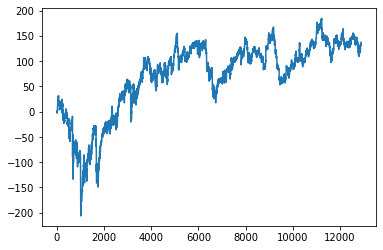

In [91]:
data1 = pd.read_csv('./data/datahistory_1m_lstm.csv')
print(data1.tail())

plt.plot(data1['money'])

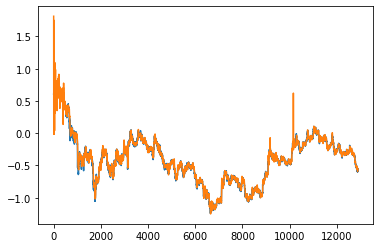

In [92]:
plt.plot(data1['closes'])
plt.plot(data1['predictionBefore'])
plt.show()


## CNN

In [44]:
data2 = pd.read_csv('./data/data_1m.csv')

data2 = data2.iloc[30100:43000]
truth_array = data2.loc[:, "closes"].to_numpy()

data2 = data2.drop(axis = 1, columns=['labels'])

pred_array = np.zeros((12900))
profit_array = np.zeros((12900))

inverted = scaler.inverse_transform(data2)
inverted = inverted[:,3]

print(np.shape(inverted))
data2.head()

(12900,)


,opens,highs,lows,closes,volumes,qavs,numTrades,tbbavs,tbqavs,rsis,obvs
30100,0.587839,0.599284,0.600487,0.611702,-0.469005,-0.464858,-0.315441,-0.383676,-0.367223,-1.498058,-0.416604
30101,0.606161,0.592560,0.609364,0.603650,-0.398820,-0.388658,-0.651650,-0.251226,-0.225623,-1.437990,-0.459337
30102,0.605016,0.614092,0.617669,0.618000,-0.233748,-0.208749,-0.459531,-0.277772,-0.253682,-1.017562,-0.378352
30103,0.618508,0.611302,0.631165,0.624943,-0.503651,-0.502397,-0.867785,-0.443883,-0.431495,-0.983890,-0.321447
30104,0.622229,0.608620,0.625724,0.615066,-0.471134,-0.467053,-0.891800,-0.459453,-0.448258,-1.046734,-0.085341


In [ ]:
total_batches = 0
total_error = 0
optimizer = torch.optim.Adam(cnn_model.parameters(), lr=0.03)
batch_size = 5
profit = 0
moves = 0
positive_trades = 0
negative_trades = 0

for batch_idx, (batch, truth) in enumerate(cnn_test_dataloader):
    optimizer.zero_grad()

    pred = cnn_model.forward(batch)
    pred = torch.squeeze(pred, 1)
    loss = loss_function(pred, truth)
    loss.backward()
    optimizer.step()
    
    for (idx, i) in enumerate(pred.detach().numpy()):
        pred_array[batch_idx * batch_size + idx] = i
        if i > truth_array[batch_idx * batch_size + idx] and truth[idx] < truth_array[batch_idx * batch_size + idx]:
            total_error +=1
        if i > truth_array[batch_idx * batch_size + idx] and batch_idx * batch_size + idx != 12899:
            mid_diff = inverted[batch_idx * batch_size + idx + 1] - inverted[batch_idx * batch_size + idx]
            profit += mid_diff
            print("mid diff ", mid_diff)
            print("index ",batch_idx * batch_size + idx)
            moves +=1
            if mid_diff >= 0:
                positive_trades += 1
            else: 
                negative_trades += 1
            
        profit_array[batch_idx * batch_size + idx] = profit 
   

print(total_error)
print(moves)
print(profit)
print(positive_trades)
print(negative_trades)


In [ ]:
plt.title("CNN Money over Time")
plt.plot(profit_array[:12883])
plt.show()

In [ ]:
plt.title("CNN Predicted Prices vs Actual")
plt.plot(truth_array)
plt.plot(pred_array)

plt.show()

In [ ]:
df_history_past = pd.DataFrame(data={"time": [], "opens": [], "highs": [], "lows": [], "closes": [], "volumes": [], "qavs": [], "numTrades": [], "tbbavs": [], "tbqavs": [], "rsis": [],"obvs": [], "money": [], "trueAfter": [], "predictionBefore": [], "action": [], "correct": [], "diff": []})
invertedData = scaler.inverse_transform(dataLast)


countBuy = 0
countDontBuy = 0
correctBuy = 0
correctDontBuy = 0
boughtPrev = False
closePrev = float(0)
money = float(0)
action = ""

for i in range(len(dataLast)-56):
    curr_df = dataLast.iloc[i:i+56]
    currData = np.array(dataLast.iloc[i:i+56].to_numpy())
    currData = np.swapaxes(currData,0,1)
    
    currData = np.expand_dims(currData, axis=0)
    print(np.shape(currData))
    
    curr_close = currData[i+56][3]
    
    if(countDontBuy + countBuy > 0):
        prevData = np.array(dataLast.iloc[i-1].to_numpy())
        prev_close = prevData[3]
        
        truePred = curr_close
        
        #for(i in range(len()))

        print("\nBack Propogate... \n")
        truePred = torch.tensor(truePred)
        truePred = truePred.to(torch.float)

        single_loss = loss_function(pred, truePred)
        single_loss.backward()
        clip_grad_norm_(trained_lstm_model.parameters(), 5)
        optimizer_lstm.step()
        optimizer_lstm.zero_grad()

        prediction = float(pred.item())
        #print("CORRECT?: ", float(truePred.item()), prediction, closePrev)

        if(truePred > closePrev and prediction > closePrev):
            correctBuy += 1
            curr_df['correct'] = [1]
        elif(truePred < closePrev and prediction < closePrev):
            correctDontBuy += 1
            curr_df['correct'] = [1]
        else:
            curr_df['correct'] = [0]
        print("COUNTBUY: ", countBuy , "CORRECTBUY: ", correctBuy, "COUNTDONTBUY: ", countDontBuy, "CORRECTDONTBUY: ", correctDontBuy)
        
        print(prediction)
        curr_df['action'] = action
        curr_df['diff'] = float(prediction - curr_close)
        curr_df['time'] = time
        curr_df['money'] = float(money)
        curr_df['trueAfter'] = float(curr_close)
        curr_df['predictionBefore'] = float(prediction)
        df_history_past = df_history_past.append(curr_df, ignore_index = True)

    if(boughtPrev):
        print(invertedData[i][3], invertedData[i][3])
        change = invertedData[i][3] - invertedData[i-1][3]
        money += change
        print('NEW PRICE: ', close, 'BOUGHT PRICE: ', closePrev, 'CHANGE: ', change, 'MONEY: ', money)
        boughtPrev = False
    
    
    data = torch.tensor(currData)
    data = data.to(torch.float)
    print(np.shape(data))
    #data = data[None]
    print("HERE")
    
    pred = cnn_model(data)
    pred = torch.squeeze(pred, 1)
    print('PREDICTION', pred)
    
    
    if(prediction > curr_close):
        countBuy += 1
        action = "BUY"
        print("BUY AT: ", curr_close, 'TIME: ', time)
        boughtPrev = True
    else:
        action = "DONT BUY"
        countDontBuy += 1
        print("DONT BUY")
    closePrev = curr_close

    
df_history_past.to_csv("./data/datahistory_1m_cnn.csv", sep=',',index=False)
